# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    print(f"gradient_norm: {gradient_norm.shape}")
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    #penalty = torch.square(torch.sub(gradient_norm, 1)).sum() / gradient_norm.shape[0]
    penalty = (gradient_norm -, 1) ** 2
    penalty = penalty.sum() / gradient_norm.shape[0]
    print(f"penalty: {penalty.shape} {penalty}")
    #### END CODE HERE ####
    return penalty

In [ ]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    E(c(x)) - E(c(g(x)))
    Generator minimizes, Critic maximizes
    '''
    #### START CODE HERE ####
    # Computes the mean of the critic's scores and takes the negative.
    # The generator tries to maximize the scores (or equivalently minimize the negative
    gen_loss = - torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [16]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    # E(c(x)) - E(c(g(x))) + lambda * regularization
    # Adam will minimize the loss. So, by minimizing -(torch.mean(crit_real_pred) - torch.mean(crit_fake_pred)),
    # it effectively maximizes the distance between the real and fake distributions.
    crit_loss = -(torch.mean(crit_real_pred) - torch.mean(crit_fake_pred)) + gp * c_lambda
    print(f"real: {torch.mean(crit_real_pred)}, fake: {torch.mean(crit_fake_pred)}, regularization: {gp * c_lambda}")
    print(f"crit_loss: {crit_loss.shape} {crit_loss}")
    #### END CODE HERE ####
    return crit_loss

In [17]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

real: 2.0, fake: 1.0, regularization: 0.30000001192092896
crit_loss: torch.Size([]) -0.699999988079071
real: -20.0, fake: 20.0, regularization: 20.0
crit_loss: torch.Size([]) 60.0
Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.924767255783081
real: -0.02471446432173252, fake: -0.021580632776021957, regularization: 9.247673034667969
crit_loss: torch.Size([]) 9.25080680847168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9193735122680664
real: -0.023030245676636696, fake: -0.021560844033956528, regularization: 9.193735122680664
crit_loss: torch.Size([]) 9.195204734802246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9063873887062073
real: -0.021329931914806366, fake: -0.021980982273817062, regularization: 9.063874244689941
crit_loss: torch.Size([]) 9.063222885131836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9003376960754395
real: -0.01973908394575119, fake: -0.021274536848068237, regularization: 9.003376960754395
crit_loss: torch.Size([]) 9.00184154510498
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8798348307609558
real: -0.018231481313705444, fake: -0.021869447082281113, regularization: 8.79834

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22486940026283264
real: 0.008318580687046051, fake: 0.21600475907325745, regularization: 2.2486939430236816
crit_loss: torch.Size([]) 2.4563801288604736
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20621410012245178
real: 0.008392148651182652, fake: 0.21134093403816223, regularization: 2.062140941619873
crit_loss: torch.Size([]) 2.265089750289917
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20174305140972137
real: -0.013021114282310009, fake: 0.26532071828842163, regularization: 2.017430543899536
crit_loss: torch.Size([]) 2.2957723140716553
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23632588982582092
real: -0.013437483459711075, fake: 0.2627165913581848, regularization: 2.3632588386535645
crit_loss: torch.Size([]) 2.6394128799438477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21591618657112122
real: -0.012637455947697163, fake: 0.26224783062934875, regularization: 2.159

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22499218583106995
real: -0.0032125436700880527, fake: 0.3779911696910858, regularization: 2.2499217987060547
crit_loss: torch.Size([]) 2.6311254501342773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19249138236045837
real: -0.0035287137143313885, fake: 0.3724666237831116, regularization: 1.9249138832092285
crit_loss: torch.Size([]) 2.3009092807769775
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18423593044281006
real: -0.0032842960208654404, fake: 0.36932173371315, regularization: 1.8423593044281006
crit_loss: torch.Size([]) 2.214965343475342
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2282988280057907
real: -0.0025940798223018646, fake: 0.3700891435146332, regularization: 2.2829883098602295
crit_loss: torch.Size([]) 2.6556715965270996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21526667475700378
real: 0.0049863411113619804, fake: 0.3871994614601135, regularization: 2.15

penalty: torch.Size([]) 0.19535501301288605
real: -0.006512826774269342, fake: 0.2572178244590759, regularization: 1.953550100326538
crit_loss: torch.Size([]) 2.217280864715576
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23927529156208038
real: -0.020269235596060753, fake: 0.26887303590774536, regularization: 2.3927528858184814
crit_loss: torch.Size([]) 2.6818952560424805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23860076069831848
real: -0.019140738993883133, fake: 0.2649122178554535, regularization: 2.38600754737854
crit_loss: torch.Size([]) 2.670060634613037
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19675108790397644
real: -0.020608287304639816, fake: 0.25857651233673096, regularization: 1.9675109386444092
crit_loss: torch.Size([]) 2.2466957569122314
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19851747155189514
real: -0.019822724163532257, fake: 0.252287358045578, regularization: 1.9851746559143066
crit_loss: torch.Size(

crit_loss: torch.Size([]) 0.8258799910545349
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09766573458909988
real: -0.011063268408179283, fake: -0.03419157862663269, regularization: 0.9766573309898376
crit_loss: torch.Size([]) 0.9535290002822876
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07954703271389008
real: -0.010593945160508156, fake: -0.06098798289895058, regularization: 0.7954703569412231
crit_loss: torch.Size([]) 0.7450762987136841
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06353072822093964
real: -0.011349639855325222, fake: 0.03077259659767151, regularization: 0.6353073120117188
crit_loss: torch.Size([]) 0.6774295568466187
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07167115062475204
real: -0.016440456733107567, fake: 0.014023223891854286, regularization: 0.7167115211486816
crit_loss: torch.Size([]) 0.7471752166748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09107866883277893
real: -0.03511068597435

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03166960924863815
real: 0.10172095894813538, fake: -0.11266876757144928, regularization: 0.3166961073875427
crit_loss: torch.Size([]) 0.10230638086795807
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03067035600543022
real: 0.10143747925758362, fake: -0.14238257706165314, regularization: 0.3067035675048828
crit_loss: torch.Size([]) 0.06288351118564606
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.053519174456596375
real: 0.09974382072687149, fake: -0.17842192947864532, regularization: 0.5351917743682861
crit_loss: torch.Size([]) 0.2570260167121887
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040597666054964066
real: 0.08206866681575775, fake: -0.19012942910194397, regularization: 0.40597665309906006
crit_loss: torch.Size([]) 0.13377857208251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03537921607494354
real: 0.07433328777551651, fake: -0.20824787020683289, regularization

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.022877953946590424
real: 0.2710033059120178, fake: -0.3586985468864441, regularization: 0.22877953946590424
crit_loss: torch.Size([]) -0.4009222984313965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.016301963478326797
real: 0.25680553913116455, fake: -0.38214820623397827, regularization: 0.16301962733268738
crit_loss: torch.Size([]) -0.47593411803245544
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.015537909232079983
real: 0.2409866452217102, fake: -0.30529484152793884, regularization: 0.15537908673286438
crit_loss: torch.Size([]) -0.3909023702144623
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02526523731648922
real: 0.23680691421031952, fake: -0.33677321672439575, regularization: 0.2526523768901825
crit_loss: torch.Size([]) -0.32092776894569397
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.010463199578225613
real: 0.26038658618927, fake: -0.3500843644142151, regularization

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.015626385807991028
real: 0.6269564032554626, fake: -0.47799938917160034, regularization: 0.15626385807991028
crit_loss: torch.Size([]) -0.9486919641494751
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.017902519553899765
real: 0.6487181186676025, fake: -0.5005345344543457, regularization: 0.17902520298957825
crit_loss: torch.Size([]) -0.9702274799346924
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.010971006006002426
real: 0.6485648155212402, fake: -0.5560551881790161, regularization: 0.10971006006002426
crit_loss: torch.Size([]) -1.094909906387329
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06062188372015953
real: 0.6389437913894653, fake: -0.6079868078231812, regularization: 0.6062188148498535
crit_loss: torch.Size([]) -0.640711784362793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07264953851699829
real: 0.6298630833625793, fake: -0.39011144638061523, regularization: 0.72

real: 1.0947421789169312, fake: -1.014610767364502, regularization: 0.08194156736135483
crit_loss: torch.Size([]) -2.027411460876465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0033817291259765625
real: 1.1318292617797852, fake: -0.6426481604576111, regularization: 0.033817291259765625
crit_loss: torch.Size([]) -1.7406601905822754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.003942936658859253
real: 1.1490739583969116, fake: -0.7785911560058594, regularization: 0.03942936658859253
crit_loss: torch.Size([]) -1.8882358074188232
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.004095376003533602
real: 1.165042757987976, fake: -0.9017773866653442, regularization: 0.04095375910401344
crit_loss: torch.Size([]) -2.0258662700653076
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.008161041885614395
real: 1.181260585784912, fake: -1.0173856019973755, regularization: 0.08161041885614395
crit_loss: torch.Size([]) -2.1170356273651123
gradient_norm: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.005580722354352474
real: 1.7886908054351807, fake: -0.3954169750213623, regularization: 0.05580722540616989
crit_loss: torch.Size([]) -2.128300666809082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.004293643869459629
real: 1.8007230758666992, fake: -0.6096609830856323, regularization: 0.04293643683195114
crit_loss: torch.Size([]) -2.367447853088379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.01187592837959528
real: 1.8822673559188843, fake: -0.09962267428636551, regularization: 0.11875928193330765
crit_loss: torch.Size([]) -1.863130807876587
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.007964100688695908
real: 1.904310941696167, fake: -0.29416966438293457, regularization: 0.07964100688695908
crit_loss: torch.Size([]) -2.1188395023345947
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.008000655099749565
real: 1.915938377380371, fake: -0.5203267335891724, regularization: 0.080

penalty: torch.Size([]) 0.012308239005506039
real: 3.0894250869750977, fake: -2.200530529022217, regularization: 0.12308239191770554
crit_loss: torch.Size([]) -5.166873455047607
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.011082787066698074
real: 3.120659828186035, fake: -2.431455135345459, regularization: 0.11082787066698074
crit_loss: torch.Size([]) -5.441287040710449
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.009963640943169594
real: 3.1567740440368652, fake: -2.605131149291992, regularization: 0.09963640570640564
crit_loss: torch.Size([]) -5.66226863861084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.007204065099358559
real: 3.1925134658813477, fake: -2.764409065246582, regularization: 0.07204064726829529
crit_loss: torch.Size([]) -5.884881973266602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.009607456624507904
real: 3.1924123764038086, fake: -2.200333595275879, regularization: 0.09607456624507904
crit_loss: torch.Size([])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02770189940929413
real: 4.800346374511719, fake: -4.581335067749023, regularization: 0.2770189940929413
crit_loss: torch.Size([]) -9.104662895202637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.028989288955926895
real: 4.778315544128418, fake: -3.014277458190918, regularization: 0.28989288210868835
crit_loss: torch.Size([]) -7.502700328826904
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.019596658647060394
real: 4.802204132080078, fake: -3.510122776031494, regularization: 0.19596658647060394
crit_loss: torch.Size([]) -8.11635971069336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.018465660512447357
real: 4.826780796051025, fake: -4.089920520782471, regularization: 0.18465660512447357
crit_loss: torch.Size([]) -8.73204517364502
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.014780453406274319
real: 4.858157157897949, fake: -4.539071083068848, regularization: 0.14780452847480774

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06142858415842056
real: 6.676629066467285, fake: -4.34765100479126, regularization: 0.6142858266830444
crit_loss: torch.Size([]) -10.409995079040527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09256572276353836
real: 6.736661911010742, fake: -4.774247646331787, regularization: 0.9256572127342224
crit_loss: torch.Size([]) -10.58525276184082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10874921083450317
real: 6.783837795257568, fake: -4.9022297859191895, regularization: 1.0874921083450317
crit_loss: torch.Size([]) -10.598575592041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.049658551812171936
real: 6.521310806274414, fake: -3.0028536319732666, regularization: 0.49658551812171936
crit_loss: torch.Size([]) -9.027578353881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10429856181144714
real: 6.590235710144043, fake: -3.618783712387085, regularization: 1.0429856777191162


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11028283834457397
real: 8.02597427368164, fake: -3.0165798664093018, regularization: 1.1028283834457397
crit_loss: torch.Size([]) -9.939725875854492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08815714716911316
real: 8.038932800292969, fake: -3.0663628578186035, regularization: 0.8815714716911316
crit_loss: torch.Size([]) -10.223723411560059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04218188300728798
real: 8.070290565490723, fake: -3.306199550628662, regularization: 0.4218188226222992
crit_loss: torch.Size([]) -10.954670906066895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04778261110186577
real: 8.155921936035156, fake: -3.4916162490844727, regularization: 0.4778261184692383
crit_loss: torch.Size([]) -11.16971206665039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06610260903835297
real: 8.212992668151855, fake: -3.705251693725586, regularization: 0.661026120185852
cr

crit_loss: torch.Size([]) -12.868850708007812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07587526738643646
real: 9.879074096679688, fake: -3.6632299423217773, regularization: 0.758752703666687
crit_loss: torch.Size([]) -12.783551216125488
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05967852473258972
real: 10.025259017944336, fake: -3.409902572631836, regularization: 0.5967852473258972
crit_loss: torch.Size([]) -12.83837604522705
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09473655372858047
real: 10.110586166381836, fake: -3.4700350761413574, regularization: 0.9473655223846436
crit_loss: torch.Size([]) -12.633255958557129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.035397883504629135
real: 10.061308860778809, fake: -3.5492491722106934, regularization: 0.35397884249687195
crit_loss: torch.Size([]) -13.25657844543457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05873455852270126
real: 10.21684455871582, fake: -3.76

penalty: torch.Size([]) 0.04471550136804581
real: 12.46965217590332, fake: -3.949458599090576, regularization: 0.4471549987792969
crit_loss: torch.Size([]) -15.971956253051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07730128616094589
real: 12.788402557373047, fake: -4.133734703063965, regularization: 0.7730128765106201
crit_loss: torch.Size([]) -16.149126052856445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10153483599424362
real: 12.953911781311035, fake: -4.0736002922058105, regularization: 1.0153483152389526
crit_loss: torch.Size([]) -16.012163162231445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03572000563144684
real: 12.691120147705078, fake: -4.099430561065674, regularization: 0.3572000563144684
crit_loss: torch.Size([]) -16.433349609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10599851608276367
real: 12.425557136535645, fake: -3.8611536026000977, regularization: 1.0599851608276367
crit_loss: torch.Size([]) -15.2

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.054912470281124115
real: 15.432220458984375, fake: -4.098886489868164, regularization: 0.5491247177124023
crit_loss: torch.Size([]) -18.981983184814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08789636194705963
real: 15.660978317260742, fake: -3.346226453781128, regularization: 0.8789635896682739
crit_loss: torch.Size([]) -18.12824058532715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.060067132115364075
real: 15.63332462310791, fake: -3.5292835235595703, regularization: 0.6006712913513184
crit_loss: torch.Size([]) -18.56193733215332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10538093745708466
real: 15.747817039489746, fake: -3.7761149406433105, regularization: 1.053809404373169
crit_loss: torch.Size([]) -18.470121383666992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.043553587049245834
real: 15.643545150756836, fake: -3.917166233062744, regularization: 0.435535877943

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.043267037719488144
real: 18.787708282470703, fake: -3.887122631072998, regularization: 0.43267038464546204
crit_loss: torch.Size([]) -22.24216079711914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03795365244150162
real: 19.079431533813477, fake: -4.555208206176758, regularization: 0.379536509513855
crit_loss: torch.Size([]) -23.255104064941406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06962741911411285
real: 19.283809661865234, fake: -4.793612957000732, regularization: 0.6962741613388062
crit_loss: torch.Size([]) -23.381149291992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07649583369493484
real: 19.262950897216797, fake: -3.384634494781494, regularization: 0.7649583220481873
crit_loss: torch.Size([]) -21.882627487182617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0873442143201828
real: 19.444690704345703, fake: -4.11519718170166, regularization: 0.873442173004150

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05555819347500801
real: 23.33730125427246, fake: -4.402060508728027, regularization: 0.5555819272994995
crit_loss: torch.Size([]) -27.183778762817383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07635502517223358
real: 23.70200538635254, fake: -4.672853469848633, regularization: 0.7635502815246582
crit_loss: torch.Size([]) -27.611309051513672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05122104287147522
real: 23.679378509521484, fake: -4.771134853363037, regularization: 0.5122104287147522
crit_loss: torch.Size([]) -27.938302993774414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08636157214641571
real: 24.21265411376953, fake: -5.226133823394775, regularization: 0.8636157512664795
crit_loss: torch.Size([]) -28.575172424316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06301170587539673
real: 24.2237548828125, fake: -5.075220108032227, regularization: 0.6301170587539673
c

penalty: torch.Size([]) 0.07222793996334076
real: 28.748937606811523, fake: -4.999705791473389, regularization: 0.72227942943573
crit_loss: torch.Size([]) -33.026363372802734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05170579254627228
real: 28.44856834411621, fake: -4.644916534423828, regularization: 0.5170578956604004
crit_loss: torch.Size([]) -32.57642364501953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08468616008758545
real: 29.740924835205078, fake: -4.2572221755981445, regularization: 0.8468616008758545
crit_loss: torch.Size([]) -33.151283264160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07595612853765488
real: 30.014575958251953, fake: -4.440169334411621, regularization: 0.75956130027771
crit_loss: torch.Size([]) -33.695186614990234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07873786240816116
real: 30.067991256713867, fake: -4.972125053405762, regularization: 0.7873786091804504
crit_loss: torch.Size([]) -34.2527

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2887110710144043
real: 34.484561920166016, fake: -2.777482509613037, regularization: 2.887110710144043
crit_loss: torch.Size([]) -34.37493133544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16061216592788696
real: 34.479644775390625, fake: -3.1565566062927246, regularization: 1.6061216592788696
crit_loss: torch.Size([]) -36.03007888793945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039500534534454346
real: 32.784515380859375, fake: -3.6910653114318848, regularization: 0.39500534534454346
crit_loss: torch.Size([]) -36.0805778503418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.201494038105011
real: 33.03440856933594, fake: -3.8444862365722656, regularization: 2.0149402618408203
crit_loss: torch.Size([]) -34.86395263671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22055086493492126
real: 32.23810577392578, fake: -2.82759952545166, regularization: 2.2055087089538574
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11165034770965576
real: 39.87997817993164, fake: -3.982482433319092, regularization: 1.1165034770965576
crit_loss: torch.Size([]) -42.74595642089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0814785361289978
real: 39.64312744140625, fake: -4.003288269042969, regularization: 0.814785361289978
crit_loss: torch.Size([]) -42.83163070678711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17714479565620422
real: 40.28644561767578, fake: -4.089964389801025, regularization: 1.7714478969573975
crit_loss: torch.Size([]) -42.60496520996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4972429871559143
real: 40.640506744384766, fake: -4.527130603790283, regularization: 4.9724297523498535
crit_loss: torch.Size([]) -40.19520568847656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03181196004152298
real: 39.30718994140625, fake: -4.173313140869141, regularization: 0.3181195855140686
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1374489665031433
real: 47.017066955566406, fake: -4.917111396789551, regularization: 1.374489665031433
crit_loss: torch.Size([]) -50.559688568115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2991378903388977
real: 48.29631042480469, fake: -5.516298770904541, regularization: 2.9913787841796875
crit_loss: torch.Size([]) -50.821231842041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9459922909736633
real: 46.03742980957031, fake: -4.920690536499023, regularization: 9.459922790527344
crit_loss: torch.Size([]) -41.498199462890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.385465145111084
real: 43.441619873046875, fake: -4.014416217803955, regularization: 23.854652404785156
crit_loss: torch.Size([]) -23.601383209228516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11336145550012589
real: 44.04145812988281, fake: -3.5470259189605713, regularization: 1.1336145401000977
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16142484545707703
real: 52.78240966796875, fake: -3.4600484371185303, regularization: 1.614248514175415
crit_loss: torch.Size([]) -54.62820816040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3879537582397461
real: 55.4583740234375, fake: -3.3667497634887695, regularization: 3.879537582397461
crit_loss: torch.Size([]) -54.945587158203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43964430689811707
real: 55.53679275512695, fake: -3.1907272338867188, regularization: 4.396442890167236
crit_loss: torch.Size([]) -54.331077575683594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1127985417842865
real: 54.60050964355469, fake: -3.5487477779388428, regularization: 1.1279854774475098
crit_loss: torch.Size([]) -57.021270751953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17935797572135925
real: 53.4416389465332, fake: -3.293947696685791, regularization: 1.7935798168182373
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47098827362060547
real: 59.371124267578125, fake: -3.6446123123168945, regularization: 4.709882736206055
crit_loss: torch.Size([]) -58.30585479736328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4609687924385071
real: 60.831573486328125, fake: -3.230644941329956, regularization: 4.609687805175781
crit_loss: torch.Size([]) -59.45252990722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5119103193283081
real: 62.09911346435547, fake: -3.362675666809082, regularization: 5.11910343170166
crit_loss: torch.Size([]) -60.342689514160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18593961000442505
real: 63.11146926879883, fake: -3.337822914123535, regularization: 1.8593961000442505
crit_loss: torch.Size([]) -64.58989715576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24198274314403534
real: 63.193172454833984, fake: -3.404268980026245, regularization: 2.419827461242676
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8950737714767456
real: 67.54985046386719, fake: -3.88974666595459, regularization: 8.950737953186035
crit_loss: torch.Size([]) -62.488861083984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9032634496688843
real: 66.02670288085938, fake: -3.925619602203369, regularization: 9.032634735107422
crit_loss: torch.Size([]) -60.9196891784668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5875517129898071
real: 66.91107177734375, fake: -4.102983474731445, regularization: 5.875516891479492
crit_loss: torch.Size([]) -65.13853454589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4167347848415375
real: 64.68043518066406, fake: -3.8074746131896973, regularization: 4.1673479080200195
crit_loss: torch.Size([]) -64.320556640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4541940689086914
real: 65.3564224243164, fake: -3.9618430137634277, regularization: 4.541940689086914
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4470371603965759
real: 74.66329193115234, fake: -4.844238758087158, regularization: 4.470371723175049
crit_loss: torch.Size([]) -75.03715515136719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34008586406707764
real: 74.70579528808594, fake: -5.012263774871826, regularization: 3.4008586406707764
crit_loss: torch.Size([]) -76.31719970703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4151553213596344
real: 75.58427429199219, fake: -4.805872440338135, regularization: 4.151553153991699
crit_loss: torch.Size([]) -76.23859405517578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.701668381690979
real: 75.81334686279297, fake: -4.815553188323975, regularization: 7.016683578491211
crit_loss: torch.Size([]) -73.61221313476562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.558925449848175
real: 74.26392364501953, fake: -5.286252021789551, regularization: 5.589254379272461
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29298079013824463
real: 82.10138702392578, fake: -4.847700119018555, regularization: 2.9298079013824463
crit_loss: torch.Size([]) -84.01927947998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36447229981422424
real: 83.36048126220703, fake: -4.987555980682373, regularization: 3.6447229385375977
crit_loss: torch.Size([]) -84.70331573486328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46494120359420776
real: 83.1528091430664, fake: -5.011475086212158, regularization: 4.649412155151367
crit_loss: torch.Size([]) -83.5148696899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7257891893386841
real: 83.97383117675781, fake: -4.57283353805542, regularization: 7.257891654968262
crit_loss: torch.Size([]) -81.28877258300781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18620234727859497
real: 83.61087036132812, fake: -5.048245429992676, regularization: 1.8620234727859497
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5553063154220581
real: 89.56076049804688, fake: -5.568939208984375, regularization: 5.55306339263916
crit_loss: torch.Size([]) -89.5766372680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36811336874961853
real: 89.10507202148438, fake: -5.493273735046387, regularization: 3.68113374710083
crit_loss: torch.Size([]) -90.91720581054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3289338946342468
real: 89.32698059082031, fake: -5.742936134338379, regularization: 3.289339065551758
crit_loss: torch.Size([]) -91.78057861328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8629275560379028
real: 92.6894302368164, fake: -5.934930324554443, regularization: 8.62927532196045
crit_loss: torch.Size([]) -89.99508666992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49185478687286377
real: 90.99615478515625, fake: -5.6193156242370605, regularization: 4.918547630310059
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8826606869697571
real: 101.18811798095703, fake: -8.324790954589844, regularization: 8.826606750488281
crit_loss: torch.Size([]) -100.6863021850586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0184032917022705
real: 99.88557434082031, fake: -8.071149826049805, regularization: 10.184032440185547
crit_loss: torch.Size([]) -97.77268981933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3139570951461792
real: 99.09051513671875, fake: -8.013059616088867, regularization: 13.139571189880371
crit_loss: torch.Size([]) -93.96400451660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18383502960205078
real: 97.78768920898438, fake: -7.910486221313477, regularization: 1.8383502960205078
crit_loss: torch.Size([]) -103.85982513427734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.130974292755127
real: 101.29670715332031, fake: -9.84412956237793, regularization: 11.30974292755127
crit_loss:

penalty: torch.Size([]) 0.39305853843688965
real: 108.4195556640625, fake: -15.699758529663086, regularization: 3.9305853843688965
crit_loss: torch.Size([]) -120.18872833251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6545126438140869
real: 108.12542724609375, fake: -18.37399673461914, regularization: 6.545126438140869
crit_loss: torch.Size([]) -119.95429229736328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.737959623336792
real: 108.46682739257812, fake: -18.506378173828125, regularization: 7.37959623336792
crit_loss: torch.Size([]) -119.59361267089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.256547749042511
real: 103.26799011230469, fake: -17.12054443359375, regularization: 2.5654773712158203
crit_loss: torch.Size([]) -117.82305908203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8891783356666565
real: 61.51557922363281, fake: -18.755615234375, regularization: 8.891783714294434
crit_loss: torch.Size([]) -71.37940979003

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6646175384521484
real: 113.84954833984375, fake: -7.426535606384277, regularization: 6.646175384521484
crit_loss: torch.Size([]) -114.62991333007812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6389946937561035
real: 120.65116882324219, fake: -10.492968559265137, regularization: 26.38994598388672
crit_loss: torch.Size([]) -104.75418853759766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9176024198532104
real: 121.30642700195312, fake: -9.90367317199707, regularization: 19.176023483276367
crit_loss: torch.Size([]) -112.03407287597656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6421539783477783
real: 121.64193725585938, fake: -8.737772941589355, regularization: 6.421539783477783
crit_loss: torch.Size([]) -123.95817565917969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.979154646396637
real: 122.09574890136719, fake: -8.864059448242188, regularization: 9.791546821594238
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0289435386657715
real: 100.57108306884766, fake: -4.708935737609863, regularization: 10.289435386657715
crit_loss: torch.Size([]) -94.99058532714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.680781364440918
real: 128.25169372558594, fake: -3.1022825241088867, regularization: 46.80781555175781
crit_loss: torch.Size([]) -84.54615783691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.778043270111084
real: 122.57842254638672, fake: -1.6387858390808105, regularization: 27.780433654785156
crit_loss: torch.Size([]) -96.43677520751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4521987438201904
real: 127.4401626586914, fake: -4.427980422973633, regularization: 24.521987915039062
crit_loss: torch.Size([]) -107.34616088867188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3988892436027527
real: 118.9646224975586, fake: -6.600920677185059, regularization: 3.9888925552368164
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3869045972824097
real: 143.14529418945312, fake: -5.904343605041504, regularization: 13.869046211242676
crit_loss: torch.Size([]) -135.1805877685547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6006730794906616
real: 142.081787109375, fake: -5.814347743988037, regularization: 6.006731033325195
crit_loss: torch.Size([]) -141.889404296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3659999370574951
real: 145.09417724609375, fake: -6.410866737365723, regularization: 13.65999984741211
crit_loss: torch.Size([]) -137.8450469970703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5533870458602905
real: 144.96937561035156, fake: -6.383027076721191, regularization: 5.533870697021484
crit_loss: torch.Size([]) -145.8185272216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5721986293792725
real: 140.6454315185547, fake: -6.282630920410156, regularization: 5.721986293792725
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4763678312301636
real: 148.52540588378906, fake: -7.51225471496582, regularization: 4.763678550720215
crit_loss: torch.Size([]) -151.27398681640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7468185424804688
real: 154.16000366210938, fake: -6.062446594238281, regularization: 7.4681854248046875
crit_loss: torch.Size([]) -152.75425720214844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8039785623550415
real: 154.18994140625, fake: -6.542849063873291, regularization: 8.039785385131836
crit_loss: torch.Size([]) -152.69300842285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5526236295700073
real: 154.8218994140625, fake: -6.886033058166504, regularization: 5.526236534118652
crit_loss: torch.Size([]) -156.18170166015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6062512397766113
real: 155.03695678710938, fake: -7.054046630859375, regularization: 6.062512397766113
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.175960659980774
real: 156.67538452148438, fake: -6.5910444259643555, regularization: 11.75960636138916
crit_loss: torch.Size([]) -151.50682067871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6656568050384521
real: 159.3342742919922, fake: -6.753482818603516, regularization: 6.6565680503845215
crit_loss: torch.Size([]) -159.43118286132812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.309580683708191
real: 165.07852172851562, fake: -6.833629608154297, regularization: 13.095807075500488
crit_loss: torch.Size([]) -158.81634521484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.6897389888763428
real: 164.7891387939453, fake: -7.114487648010254, regularization: 36.89738845825195
crit_loss: torch.Size([]) -135.00624084472656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6416463851928711
real: 130.4437713623047, fake: -6.466117858886719, regularization: 6.416463851928711
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0549473762512207
real: 174.4862823486328, fake: -10.907306671142578, regularization: 20.54947280883789
crit_loss: torch.Size([]) -164.8441162109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0683928728103638
real: 159.75685119628906, fake: -8.425630569458008, regularization: 10.683928489685059
crit_loss: torch.Size([]) -157.49855041503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3278741836547852
real: 157.39385986328125, fake: -9.09222412109375, regularization: 13.278741836547852
crit_loss: torch.Size([]) -153.20733642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.083967924118042
real: 166.076904296875, fake: -9.540782928466797, regularization: 10.839679718017578
crit_loss: torch.Size([]) -164.77801513671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1253328323364258
real: 167.35630798339844, fake: -10.064135551452637, regularization: 11.253328323364258
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3883421421051025
real: 177.4951171875, fake: -13.32475471496582, regularization: 13.883420944213867
crit_loss: torch.Size([]) -176.9364471435547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5190744400024414
real: 180.2031707763672, fake: -13.245731353759766, regularization: 15.190744400024414
crit_loss: torch.Size([]) -178.25814819335938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8070449829101562
real: 178.8978271484375, fake: -14.248069763183594, regularization: 8.070449829101562
crit_loss: torch.Size([]) -185.07545471191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8232064247131348
real: 182.27503967285156, fake: -8.664457321166992, regularization: 18.23206329345703
crit_loss: torch.Size([]) -172.70742797851562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0669381618499756
real: 180.0274200439453, fake: -9.314935684204102, regularization: 10.669382095336914
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7547591924667358
real: 186.05917358398438, fake: -8.725419998168945, regularization: 7.5475921630859375
crit_loss: torch.Size([]) -187.23699951171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2150391340255737
real: 193.20068359375, fake: -7.560818672180176, regularization: 12.150391578674316
crit_loss: torch.Size([]) -188.61111450195312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5231435298919678
real: 195.9225616455078, fake: -7.023360729217529, regularization: 15.231435775756836
crit_loss: torch.Size([]) -187.71449279785156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9709203243255615
real: 195.09848022460938, fake: -8.178196907043457, regularization: 9.709203720092773
crit_loss: torch.Size([]) -193.56747436523438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.6086668968200684
real: 195.61744689941406, fake: -8.582537651062012, regularization: 36.086669921875
crit_loss

penalty: torch.Size([]) 1.7523797750473022
real: 208.63340759277344, fake: -11.294800758361816, regularization: 17.5237979888916
crit_loss: torch.Size([]) -202.40440368652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0860769748687744
real: 207.94915771484375, fake: -11.600935935974121, regularization: 10.860769271850586
crit_loss: torch.Size([]) -208.6893310546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6868513822555542
real: 200.20037841796875, fake: -10.893447875976562, regularization: 16.868513107299805
crit_loss: torch.Size([]) -194.22531127929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6399844884872437
real: 202.50732421875, fake: -11.159067153930664, regularization: 16.399845123291016
crit_loss: torch.Size([]) -197.2665557861328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2012569904327393
real: 203.07086181640625, fake: -11.084466934204102, regularization: 12.012569427490234
crit_loss: torch.Size([]) -202.14276

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9322327375411987
real: 214.04470825195312, fake: -10.535883903503418, regularization: 19.32232666015625
crit_loss: torch.Size([]) -205.25827026367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3376121520996094
real: 214.30810546875, fake: -10.475072860717773, regularization: 23.376121520996094
crit_loss: torch.Size([]) -201.40704345703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6176785230636597
real: 211.70950317382812, fake: -11.590851783752441, regularization: 16.17678451538086
crit_loss: torch.Size([]) -207.12356567382812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.688675880432129
real: 214.23455810546875, fake: -11.934751510620117, regularization: 16.88675880432129
crit_loss: torch.Size([]) -209.2825469970703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3554959297180176
real: 214.56304931640625, fake: -10.621525764465332, regularization: 13.554959297180176
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9807537794113159
real: 225.46328735351562, fake: -12.110114097595215, regularization: 9.807538032531738
crit_loss: torch.Size([]) -227.76585388183594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9493601322174072
real: 224.93850708007812, fake: -11.495966911315918, regularization: 19.493600845336914
crit_loss: torch.Size([]) -216.9408721923828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8350100517272949
real: 224.65615844726562, fake: -11.483165740966797, regularization: 8.35010051727295
crit_loss: torch.Size([]) -227.7892303466797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4980202913284302
real: 227.41580200195312, fake: -11.514670372009277, regularization: 14.980202674865723
crit_loss: torch.Size([]) -223.95025634765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0137033462524414
real: 227.94485473632812, fake: -11.57033920288086, regularization: 20.137033462524414
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4308900833129883
real: 233.19308471679688, fake: -11.4949951171875, regularization: 24.308900833129883
crit_loss: torch.Size([]) -220.37918090820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5724453926086426
real: 234.8385009765625, fake: -11.413509368896484, regularization: 15.724453926086426
crit_loss: torch.Size([]) -230.52755737304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.005847930908203
real: 234.24484252929688, fake: -11.357837677001953, regularization: 40.05847930908203
crit_loss: torch.Size([]) -205.544189453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.612268328666687
real: 191.01246643066406, fake: -11.365769386291504, regularization: 16.122682571411133
crit_loss: torch.Size([]) -186.25555419921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.025435447692871
real: 178.57791137695312, fake: -12.870141983032227, regularization: 60.254356384277344
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6253141164779663
real: 234.01271057128906, fake: -10.233007431030273, regularization: 16.253141403198242
crit_loss: torch.Size([]) -227.99256896972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.256866216659546
real: 235.57162475585938, fake: -11.50407600402832, regularization: 22.568662643432617
crit_loss: torch.Size([]) -224.5070343017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2298038005828857
real: 244.2885284423828, fake: -13.164417266845703, regularization: 32.298038482666016
crit_loss: torch.Size([]) -225.1549072265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8013372421264648
real: 244.28506469726562, fake: -12.158625602722168, regularization: 18.01337242126465
crit_loss: torch.Size([]) -238.43032836914062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.887885808944702
real: 246.16012573242188, fake: -12.331985473632812, regularization: 38.87885665893555
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.822814464569092
real: 255.6922607421875, fake: -14.059476852416992, regularization: 28.228145599365234
crit_loss: torch.Size([]) -241.52359008789062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.496549129486084
real: 254.4208984375, fake: -14.577311515808105, regularization: 14.96549129486084
crit_loss: torch.Size([]) -254.03271484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9891083240509033
real: 253.12408447265625, fake: -8.644158363342285, regularization: 19.891082763671875
crit_loss: torch.Size([]) -241.87716674804688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6038565635681152
real: 255.13290405273438, fake: -8.790740013122559, regularization: 16.03856658935547
crit_loss: torch.Size([]) -247.88507080078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.331479787826538
real: 258.2725524902344, fake: -9.082525253295898, regularization: 13.314798355102539
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2674009799957275
real: 264.6235656738281, fake: -11.884283065795898, regularization: 32.67401123046875
crit_loss: torch.Size([]) -243.83383178710938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2713682651519775
real: 263.78179931640625, fake: -13.890043258666992, regularization: 32.71368408203125
crit_loss: torch.Size([]) -244.95816040039062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.103886604309082
real: 261.4013671875, fake: -15.020597457885742, regularization: 21.03886604309082
crit_loss: torch.Size([]) -255.3831024169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8794052600860596
real: 266.61553955078125, fake: -13.662674903869629, regularization: 18.794052124023438
crit_loss: torch.Size([]) -261.48419189453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4301042556762695
real: 263.83746337890625, fake: -11.554027557373047, regularization: 24.301042556762695
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4775645732879639
real: 273.66595458984375, fake: -12.922664642333984, regularization: 14.775646209716797
crit_loss: torch.Size([]) -271.81298828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3958542346954346
real: 284.45159912109375, fake: -11.772785186767578, regularization: 23.958541870117188
crit_loss: torch.Size([]) -272.265869140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6571474075317383
real: 287.84100341796875, fake: -12.971007347106934, regularization: 26.571474075317383
crit_loss: torch.Size([]) -274.24053955078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.499963283538818
real: 289.8952331542969, fake: -14.13422966003418, regularization: 54.9996337890625
crit_loss: torch.Size([]) -249.02981567382812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4682329893112183
real: 281.6993408203125, fake: -10.590307235717773, regularization: 14.682330131530762
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1087217330932617
real: 292.0123291015625, fake: -15.095695495605469, regularization: 31.087217330932617
crit_loss: torch.Size([]) -276.02081298828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4969563484191895
real: 291.099365234375, fake: -15.145767211914062, regularization: 24.969562530517578
crit_loss: torch.Size([]) -281.2755432128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5246094465255737
real: 293.5528564453125, fake: -16.683319091796875, regularization: 15.246094703674316
crit_loss: torch.Size([]) -294.9900817871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5170097351074219
real: 292.0688781738281, fake: -13.949990272521973, regularization: 15.170097351074219
crit_loss: torch.Size([]) -290.8487548828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2202048301696777
real: 297.23681640625, fake: -14.46837043762207, regularization: 22.202049255371094
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.929308891296387
real: 307.834228515625, fake: -13.561929702758789, regularization: 59.2930908203125
crit_loss: torch.Size([]) -262.1030578613281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2618486881256104
real: 299.3599548339844, fake: -8.541104316711426, regularization: 32.61848831176758
crit_loss: torch.Size([]) -275.2825622558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.542391777038574
real: 298.013671875, fake: -12.803585052490234, regularization: 25.423917770385742
crit_loss: torch.Size([]) -285.3933410644531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9055118560791016
real: 292.2951354980469, fake: -14.882433891296387, regularization: 19.055118560791016
crit_loss: torch.Size([]) -288.1224670410156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6879225969314575
real: 297.44879150390625, fake: -16.194223403930664, regularization: 16.879226684570312
crit_loss: torc

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0950546264648438
real: 309.2972106933594, fake: -16.46344566345215, regularization: 30.950546264648438
crit_loss: torch.Size([]) -294.81011962890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5187690258026123
real: 309.1168212890625, fake: -16.319499969482422, regularization: 15.187690734863281
crit_loss: torch.Size([]) -310.2486267089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4081228971481323
real: 311.90374755859375, fake: -17.230867385864258, regularization: 14.081229209899902
crit_loss: torch.Size([]) -315.0533752441406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6964302062988281
real: 313.75225830078125, fake: -18.18149757385254, regularization: 16.96430206298828
crit_loss: torch.Size([]) -314.9694519042969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.039914131164551
real: 314.78009033203125, fake: -18.218936920166016, regularization: 30.399141311645508
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.576238989830017
real: 316.9910888671875, fake: -14.742773056030273, regularization: 15.76239013671875
crit_loss: torch.Size([]) -315.9714660644531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3388288021087646
real: 320.8275451660156, fake: -15.38470458984375, regularization: 23.388288497924805
crit_loss: torch.Size([]) -312.823974609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.23040771484375
real: 326.29302978515625, fake: -13.482172012329102, regularization: 32.3040771484375
crit_loss: torch.Size([]) -307.47113037109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9265750646591187
real: 317.4795227050781, fake: -15.518206596374512, regularization: 19.265750885009766
crit_loss: torch.Size([]) -313.73199462890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3014535903930664
real: 328.556884765625, fake: -15.838991165161133, regularization: 23.014535903930664
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7219293117523193
real: 334.371826171875, fake: -14.04780387878418, regularization: 17.21929359436035
crit_loss: torch.Size([]) -331.2003173828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8243820667266846
real: 335.47454833984375, fake: -14.261419296264648, regularization: 18.243820190429688
crit_loss: torch.Size([]) -331.49212646484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5973243713378906
real: 335.9332275390625, fake: -14.915338516235352, regularization: 15.973243713378906
crit_loss: torch.Size([]) -334.8753356933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5481016635894775
real: 336.7334289550781, fake: -15.761131286621094, regularization: 15.481016159057617
crit_loss: torch.Size([]) -337.0135498046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.899179220199585
real: 334.54998779296875, fake: -13.842090606689453, regularization: 18.991792678833008
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3625597953796387
real: 350.31951904296875, fake: -15.691954612731934, regularization: 13.625597953796387
crit_loss: torch.Size([]) -352.3858642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3751521110534668
real: 335.989013671875, fake: -15.326798439025879, regularization: 13.751521110534668
crit_loss: torch.Size([]) -337.5643005371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1965157985687256
real: 343.013671875, fake: -13.873008728027344, regularization: 31.965158462524414
crit_loss: torch.Size([]) -324.9215393066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.323137283325195
real: 344.45794677734375, fake: -15.315303802490234, regularization: 63.23137283325195
crit_loss: torch.Size([]) -296.5418701171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6020188331604004
real: 321.061279296875, fake: -17.53203582763672, regularization: 16.020187377929688
crit_loss: t

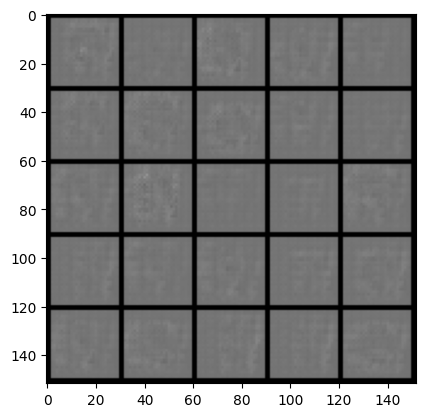

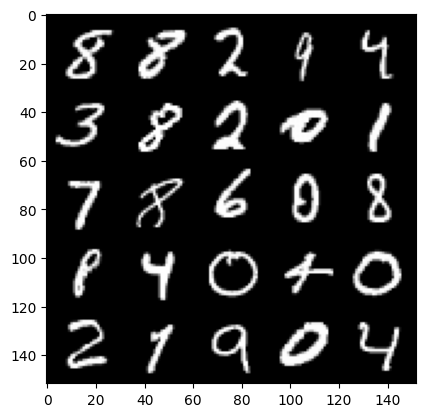

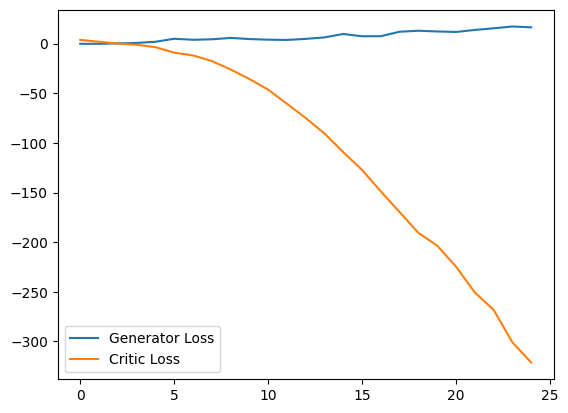

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1327476501464844
real: 354.6511535644531, fake: -12.787565231323242, regularization: 31.327476501464844
crit_loss: torch.Size([]) -336.1112365722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.069575309753418
real: 354.11529541015625, fake: -13.539328575134277, regularization: 30.69575309753418
crit_loss: torch.Size([]) -336.9588928222656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.495050072669983
real: 356.9747009277344, fake: -16.829954147338867, regularization: 14.95050048828125
crit_loss: torch.Size([]) -358.8541564941406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.104540824890137
real: 361.0281982421875, fake: -16.830062866210938, regularization: 41.04541015625
crit_loss: torch.Size([]) -336.8128662109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.56179141998291
real: 359.69036865234375, fake: -18.672712326049805, regularization: 35.61791229248047
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9635369777679443
real: 361.5426025390625, fake: -18.971405029296875, regularization: 19.6353702545166
crit_loss: torch.Size([]) -360.8786315917969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3754143714904785
real: 366.34393310546875, fake: -19.64971923828125, regularization: 23.75414276123047
crit_loss: torch.Size([]) -362.239501953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1397624015808105
real: 366.0729675292969, fake: -18.353900909423828, regularization: 21.397624969482422
crit_loss: torch.Size([]) -363.0292663574219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.285020351409912
real: 369.8480224609375, fake: -19.152894973754883, regularization: 62.85020446777344
crit_loss: torch.Size([]) -326.15069580078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.038756847381592
real: 356.28857421875, fake: -20.229461669921875, regularization: 30.387569427490234
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0235233306884766
real: 379.0694580078125, fake: -16.544710159301758, regularization: 30.235233306884766
crit_loss: torch.Size([]) -365.3789367675781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5747811794281006
real: 382.06890869140625, fake: -18.1691951751709, regularization: 15.747812271118164
crit_loss: torch.Size([]) -384.49029541015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7450608015060425
real: 381.2076721191406, fake: -18.9412841796875, regularization: 17.450607299804688
crit_loss: torch.Size([]) -382.6983642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4055371284484863
real: 385.23394775390625, fake: -18.70885467529297, regularization: 24.055370330810547
crit_loss: torch.Size([]) -379.887451171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.06341552734375
real: 376.98486328125, fake: -17.12080955505371, regularization: 20.6341552734375
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9448628425598145
real: 387.23834228515625, fake: -19.937807083129883, regularization: 19.448627471923828
crit_loss: torch.Size([]) -387.7275085449219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.063655853271484
real: 395.7915344238281, fake: -18.274858474731445, regularization: 50.636558532714844
crit_loss: torch.Size([]) -363.4298400878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1623222827911377
real: 391.09014892578125, fake: -18.348888397216797, regularization: 21.62322235107422
crit_loss: torch.Size([]) -387.8157958984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.38156795501709
real: 394.0732421875, fake: -18.05816650390625, regularization: 23.8156795501709
crit_loss: torch.Size([]) -388.31573486328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3793134689331055
real: 400.8582763671875, fake: -18.553895950317383, regularization: 23.793134689331055
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.394283294677734
real: 403.3266296386719, fake: -16.130441665649414, regularization: 103.94283294677734
crit_loss: torch.Size([]) -315.51422119140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.036149501800537
real: 391.2371520996094, fake: -20.515003204345703, regularization: 30.361495971679688
crit_loss: torch.Size([]) -381.39068603515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4656968116760254
real: 387.9854431152344, fake: -21.74123764038086, regularization: 24.656967163085938
crit_loss: torch.Size([]) -385.0697021484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.441453456878662
real: 403.4610595703125, fake: -17.670211791992188, regularization: 34.41453552246094
crit_loss: torch.Size([]) -386.71673583984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.829545259475708
real: 406.9457092285156, fake: -17.857179641723633, regularization: 18.295452117919922
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9752309322357178
real: 418.1534423828125, fake: -17.164947509765625, regularization: 29.752309799194336
crit_loss: torch.Size([]) -405.5660705566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0964019298553467
real: 418.6291809082031, fake: -18.894821166992188, regularization: 30.964019775390625
crit_loss: torch.Size([]) -406.5599670410156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.142875909805298
real: 427.4404296875, fake: -19.836929321289062, regularization: 31.42875862121582
crit_loss: torch.Size([]) -415.84857177734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5477256774902344
real: 422.2747497558594, fake: -18.380943298339844, regularization: 25.477256774902344
crit_loss: torch.Size([]) -415.1784362792969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.122585773468018
real: 424.529296875, fake: -20.389860153198242, regularization: 61.22585678100586
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.9011404514312744
real: 434.7196960449219, fake: -20.202007293701172, regularization: 39.01140594482422
crit_loss: torch.Size([]) -415.9102783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.460665225982666
real: 435.5436096191406, fake: -20.461151123046875, regularization: 24.606651306152344
crit_loss: torch.Size([]) -431.3981018066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1833434104919434
real: 383.7552490234375, fake: -18.8013916015625, regularization: 21.83343505859375
crit_loss: torch.Size([]) -380.72320556640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.541627883911133
real: 364.161376953125, fake: -19.796628952026367, regularization: 35.41627883911133
crit_loss: torch.Size([]) -348.5417175292969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.420038223266602
real: 431.740478515625, fake: -17.619752883911133, regularization: 114.20037841796875
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5965099334716797
real: 411.93646240234375, fake: -19.002685546875, regularization: 25.965099334716797
crit_loss: torch.Size([]) -404.97406005859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9348721504211426
real: 417.21246337890625, fake: -19.621557235717773, regularization: 29.34872055053711
crit_loss: torch.Size([]) -407.48529052734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2323880195617676
real: 423.10064697265625, fake: -19.544254302978516, regularization: 22.32387924194336
crit_loss: torch.Size([]) -420.3210144042969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.1623382568359375
real: 426.2442626953125, fake: -19.35381507873535, regularization: 51.623382568359375
crit_loss: torch.Size([]) -393.9747009277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.415511131286621
real: 450.3294372558594, fake: -18.02808380126953, regularization: 24.15511131286621
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1884095668792725
real: 458.2335205078125, fake: -19.33349609375, regularization: 31.884096145629883
crit_loss: torch.Size([]) -445.68292236328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7895491123199463
real: 448.8807373046875, fake: -17.60694122314453, regularization: 37.89549255371094
crit_loss: torch.Size([]) -428.5921630859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.813936710357666
real: 442.88818359375, fake: -18.76498031616211, regularization: 28.139366149902344
crit_loss: torch.Size([]) -433.5137939453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.042471408843994
real: 463.2437744140625, fake: -19.112092971801758, regularization: 30.424713134765625
crit_loss: torch.Size([]) -451.93115234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9862401485443115
real: 460.2708740234375, fake: -20.165119171142578, regularization: 19.862401962280273
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.401944875717163
real: 487.71173095703125, fake: -25.762218475341797, regularization: 24.01944923400879
crit_loss: torch.Size([]) -489.4544982910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.503706932067871
real: 488.898681640625, fake: -26.142436981201172, regularization: 25.03706932067871
crit_loss: torch.Size([]) -490.0040588378906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.249303817749023
real: 490.91107177734375, fake: -27.629837036132812, regularization: 42.493038177490234
crit_loss: torch.Size([]) -476.0478515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8711190223693848
real: 462.91729736328125, fake: -17.965316772460938, regularization: 28.71118927001953
crit_loss: torch.Size([]) -452.17144775390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.266861915588379
real: 465.61065673828125, fake: -19.29857635498047, regularization: 32.668617248535156
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.681496620178223
real: 494.0713806152344, fake: -17.45790672302246, regularization: 56.814964294433594
crit_loss: torch.Size([]) -454.7143249511719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3261752128601074
real: 483.2041931152344, fake: -18.61520004272461, regularization: 23.26175308227539
crit_loss: torch.Size([]) -478.5576477050781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.464487075805664
real: 489.677001953125, fake: -19.26924705505371, regularization: 24.64487075805664
crit_loss: torch.Size([]) -484.3013916015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7817111015319824
real: 499.4264831542969, fake: -18.707046508789062, regularization: 37.81711196899414
crit_loss: torch.Size([]) -480.3164367675781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.3053388595581055
real: 497.27587890625, fake: -20.251195907592773, regularization: 33.05339050292969
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.361381530761719
real: 502.2525939941406, fake: -16.525009155273438, regularization: 103.61381530761719
crit_loss: torch.Size([]) -415.16375732421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.010608673095703
real: 486.0422058105469, fake: -16.390548706054688, regularization: 30.10608673095703
crit_loss: torch.Size([]) -472.32666015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.736968517303467
real: 443.5819091796875, fake: -14.024154663085938, regularization: 37.369686126708984
crit_loss: torch.Size([]) -420.23638916015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.6248321533203125
real: 473.06707763671875, fake: -17.56214141845703, regularization: 46.248321533203125
crit_loss: torch.Size([]) -444.3808898925781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.682371139526367
real: 489.830810546875, fake: -16.572975158691406, regularization: 46.82371139526367
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.007072448730469
real: 521.1588745117188, fake: -19.69870948791504, regularization: 50.07072448730469
crit_loss: torch.Size([]) -490.786865234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.04654598236084
real: 523.2437744140625, fake: -19.997798919677734, regularization: 50.46546173095703
crit_loss: torch.Size([]) -492.776123046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.171510696411133
real: 521.2110595703125, fake: -19.744327545166016, regularization: 41.71510696411133
crit_loss: torch.Size([]) -499.2402648925781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8018131256103516
real: 520.0330810546875, fake: -20.45705795288086, regularization: 28.018131256103516
crit_loss: torch.Size([]) -512.4719848632812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0282201766967773
real: 498.5387268066406, fake: -19.53192138671875, regularization: 30.282201766967773
crit_loss: torch.

penalty: torch.Size([]) 2.6932103633880615
real: 518.7633056640625, fake: -21.13970947265625, regularization: 26.932104110717773
crit_loss: torch.Size([]) -512.9708862304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.269226551055908
real: 499.820068359375, fake: -20.76962661743164, regularization: 22.692264556884766
crit_loss: torch.Size([]) -497.8974609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.421857833862305
real: 515.4635620117188, fake: -20.937725067138672, regularization: 44.21857833862305
crit_loss: torch.Size([]) -492.1827392578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.428220272064209
real: 525.982177734375, fake: -20.986202239990234, regularization: 24.282203674316406
crit_loss: torch.Size([]) -522.6861572265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7036495208740234
real: 524.757568359375, fake: -21.707927703857422, regularization: 37.036495208740234
crit_loss: torch.Size([]) -509.42901611328125
grad

penalty: torch.Size([]) 3.3748257160186768
real: 543.8169555664062, fake: -7.816483497619629, regularization: 33.74825668334961
crit_loss: torch.Size([]) -517.8851928710938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.404878616333008
real: 537.2341918945312, fake: -12.459729194641113, regularization: 44.04878616333008
crit_loss: torch.Size([]) -505.6451110839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9181947708129883
real: 532.90185546875, fake: -14.837921142578125, regularization: 29.181947708129883
crit_loss: torch.Size([]) -518.5578002929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.228178024291992
real: 516.9650268554688, fake: -6.612269401550293, regularization: 22.281780242919922
crit_loss: torch.Size([]) -501.2955017089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.547333717346191
real: 526.8516235351562, fake: -5.130496025085449, regularization: 45.47333526611328
crit_loss: torch.Size([]) -486.5087890625
gradien

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.346092700958252
real: 534.860107421875, fake: -16.701473236083984, regularization: 53.4609260559082
crit_loss: torch.Size([]) -498.10064697265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.5206451416015625
real: 461.89654541015625, fake: -15.848175048828125, regularization: 45.206451416015625
crit_loss: torch.Size([]) -432.53826904296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.500112533569336
real: 537.969482421875, fake: -12.875214576721191, regularization: 105.00112915039062
crit_loss: torch.Size([]) -445.8435974121094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.881536960601807
real: 530.58251953125, fake: -7.373807430267334, regularization: 58.81536865234375
crit_loss: torch.Size([]) -479.14093017578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8988661766052246
real: 526.6142578125, fake: -9.063966751098633, regularization: 28.988662719726562
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.712867259979248
real: 543.0230712890625, fake: -10.483587265014648, regularization: 27.128673553466797
crit_loss: torch.Size([]) -526.3779907226562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8649039268493652
real: 547.8275146484375, fake: -13.671314239501953, regularization: 28.64904022216797
crit_loss: torch.Size([]) -532.8497924804688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.465902805328369
real: 539.0081787109375, fake: -10.747031211853027, regularization: 44.659027099609375
crit_loss: torch.Size([]) -505.0961608886719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.151933193206787
real: 536.2247314453125, fake: -14.79130744934082, regularization: 31.519332885742188
crit_loss: torch.Size([]) -519.4967041015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.127662181854248
real: 553.3336181640625, fake: -16.282743453979492, regularization: 31.276622772216797
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.213333129882812
real: 549.32666015625, fake: 79.18649291992188, regularization: 112.13333129882812
crit_loss: torch.Size([]) -358.0068359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0182809829711914
real: 482.8839416503906, fake: 49.18497848510742, regularization: 30.182809829711914
crit_loss: torch.Size([]) -403.51617431640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.148701190948486
real: 513.406494140625, fake: 68.61941528320312, regularization: 51.48701095581055
crit_loss: torch.Size([]) -393.3000793457031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8563098907470703
real: 557.8400268554688, fake: 52.284114837646484, regularization: 28.563098907470703
crit_loss: torch.Size([]) -476.9927978515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9686861038208008
real: 549.885986328125, fake: 72.36074829101562, regularization: 19.686861038208008
crit_loss: torch.Size(

penalty: torch.Size([]) 4.053404808044434
real: 453.99151611328125, fake: -7.349860191345215, regularization: 40.53404998779297
crit_loss: torch.Size([]) -420.80731201171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.394530296325684
real: 564.728271484375, fake: 37.496299743652344, regularization: 63.94530487060547
crit_loss: torch.Size([]) -463.28668212890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.969189167022705
real: 478.4306640625, fake: -1.6969417333602905, regularization: 29.691890716552734
crit_loss: torch.Size([]) -450.4356994628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.85167932510376
real: 535.2645874023438, fake: 65.04518127441406, regularization: 58.51679229736328
crit_loss: torch.Size([]) -411.70263671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.380589485168457
real: 558.2999267578125, fake: 28.305925369262695, regularization: 73.80589294433594
crit_loss: torch.Size([]) -456.1881103515625
gradient_no

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.683384895324707
real: 580.0172119140625, fake: 148.59237670898438, regularization: 116.83384704589844
crit_loss: torch.Size([]) -314.59100341796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.578574180603027
real: 571.325927734375, fake: 111.45393371582031, regularization: 65.7857437133789
crit_loss: torch.Size([]) -394.0862731933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.798669815063477
real: 323.10369873046875, fake: -22.987594604492188, regularization: 157.9866943359375
crit_loss: torch.Size([]) -188.1046142578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.523605346679688
real: 431.3128662109375, fake: 150.94598388671875, regularization: 95.23605346679688
crit_loss: torch.Size([]) -185.13082885742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.622175216674805
real: 540.7783813476562, fake: 76.21998596191406, regularization: 76.22175598144531
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.116542816162109
real: 531.8359985351562, fake: 66.37986755371094, regularization: 41.165428161621094
crit_loss: torch.Size([]) -424.2906799316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.779394626617432
real: 480.302734375, fake: 29.533611297607422, regularization: 47.7939453125
crit_loss: torch.Size([]) -402.9751892089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7623724937438965
real: 538.5770263671875, fake: 142.42642211914062, regularization: 37.62372589111328
crit_loss: torch.Size([]) -358.5268859863281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.103233575820923
real: 552.8318481445312, fake: 73.28461456298828, regularization: 31.03233528137207
crit_loss: torch.Size([]) -448.514892578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.222285747528076
real: 423.369384765625, fake: 4.600521087646484, regularization: 42.22285842895508
crit_loss: torch.Size([]) -376.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.86398458480835
real: 502.33563232421875, fake: -0.5075998902320862, regularization: 58.63984680175781
crit_loss: torch.Size([]) -444.203369140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.366326808929443
real: 531.8026123046875, fake: 35.37810134887695, regularization: 43.66326904296875
crit_loss: torch.Size([]) -452.76123046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.149256467819214
real: 550.7081909179688, fake: 66.61065673828125, regularization: 31.492565155029297
crit_loss: torch.Size([]) -452.60498046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.3503875732421875
real: 474.81292724609375, fake: -0.20233768224716187, regularization: 53.503875732421875
crit_loss: torch.Size([]) -421.5113830566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.554108619689941
real: 555.2135009765625, fake: 135.18368530273438, regularization: 55.54108428955078
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.970641613006592
real: 462.05804443359375, fake: 8.568265914916992, regularization: 59.706417083740234
crit_loss: torch.Size([]) -393.7833557128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.847770690917969
real: 382.0635070800781, fake: -50.9152946472168, regularization: 88.47770690917969
crit_loss: torch.Size([]) -344.5010986328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.787266731262207
real: 529.4278564453125, fake: 181.75701904296875, regularization: 107.87266540527344
crit_loss: torch.Size([]) -239.7981719970703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.234079360961914
real: 484.59576416015625, fake: 69.41368103027344, regularization: 32.34079360961914
crit_loss: torch.Size([]) -382.8412780761719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.634069442749023
real: 205.58343505859375, fake: -47.10787582397461, regularization: 96.3406982421875
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.064620971679688
real: 413.53570556640625, fake: -56.77796936035156, regularization: 90.64620971679688
crit_loss: torch.Size([]) -379.6674499511719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.9698100090026855
real: 517.8416748046875, fake: 127.9024887084961, regularization: 59.69810104370117
crit_loss: torch.Size([]) -330.2410888671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.2415852546691895
real: 445.617919921875, fake: 15.854578971862793, regularization: 52.41585159301758
crit_loss: torch.Size([]) -377.34747314453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.566256999969482
real: 424.77264404296875, fake: -20.816024780273438, regularization: 75.66256713867188
crit_loss: torch.Size([]) -369.9261169433594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.4819655418396
real: 464.0110778808594, fake: 30.16472053527832, regularization: 74.81965637207031
crit_loss: torch.Si

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.145260810852051
real: 526.7515869140625, fake: 89.71603393554688, regularization: 71.45260620117188
crit_loss: torch.Size([]) -365.58294677734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.045811653137207
real: 441.6298828125, fake: -58.317138671875, regularization: 110.45811462402344
crit_loss: torch.Size([]) -389.4888916015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.8660888671875
real: 473.7728271484375, fake: -55.80528259277344, regularization: 98.660888671875
crit_loss: torch.Size([]) -430.917236328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.920277118682861
real: 438.94183349609375, fake: -15.873649597167969, regularization: 69.20277404785156
crit_loss: torch.Size([]) -385.61273193359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.499863624572754
real: 407.2169494628906, fake: -7.3625569343566895, regularization: 64.9986343383789
crit_loss: torch.Size([])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.165822982788086
real: 244.44198608398438, fake: -54.8011589050293, regularization: 81.65823364257812
crit_loss: torch.Size([]) -217.58489990234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.226346969604492
real: 403.3898620605469, fake: -93.82939147949219, regularization: 102.26347351074219
crit_loss: torch.Size([]) -394.95574951171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.99355697631836
real: 461.8138122558594, fake: 22.08517074584961, regularization: 89.9355697631836
crit_loss: torch.Size([]) -349.7930603027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.013534545898438
real: 476.58087158203125, fake: -84.99783325195312, regularization: 80.13534545898438
crit_loss: torch.Size([]) -481.4433898925781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 17.807109832763672
real: 308.9239196777344, fake: -206.156982421875, regularization: 178.07110595703125
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.439851760864258
real: 487.2225646972656, fake: -114.04940795898438, regularization: 84.39851379394531
crit_loss: torch.Size([]) -516.8734741210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.342509746551514
real: 553.2321166992188, fake: -51.412837982177734, regularization: 63.42509841918945
crit_loss: torch.Size([]) -541.2198486328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.063318252563477
real: 474.48358154296875, fake: -95.87512969970703, regularization: 110.6331787109375
crit_loss: torch.Size([]) -459.72552490234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.334399223327637
real: 579.6644897460938, fake: 9.704855918884277, regularization: 113.343994140625
crit_loss: torch.Size([]) -456.61566162109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.535927772521973
real: 558.1362915039062, fake: -25.247901916503906, regularization: 55.359275817871094
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.451171875
real: 604.0101318359375, fake: -32.63688659667969, regularization: 74.51171875
crit_loss: torch.Size([]) -562.1353149414062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.818597793579102
real: 589.127197265625, fake: -48.71422576904297, regularization: 98.18597412109375
crit_loss: torch.Size([]) -539.6554565429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.046602725982666
real: 609.679443359375, fake: -33.438629150390625, regularization: 70.46602630615234
crit_loss: torch.Size([]) -572.6520385742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.124729633331299
real: 599.4249267578125, fake: -50.855587005615234, regularization: 71.24729919433594
crit_loss: torch.Size([]) -579.033203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.372588157653809
real: 582.2869873046875, fake: -52.38994598388672, regularization: 73.72588348388672
crit_loss: torch.Size([]) -560.95104

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.835310935974121
real: 617.23681640625, fake: -34.79474639892578, regularization: 78.35311126708984
crit_loss: torch.Size([]) -573.678466796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.467948913574219
real: 631.8185424804688, fake: -29.919166564941406, regularization: 64.67948913574219
crit_loss: torch.Size([]) -597.0582275390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.251126289367676
real: 626.5391845703125, fake: -40.44367218017578, regularization: 62.511260986328125
crit_loss: torch.Size([]) -604.4715576171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.8978910446167
real: 630.6410522460938, fake: -40.07350158691406, regularization: 88.97891235351562
crit_loss: torch.Size([]) -581.735595703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.933504104614258
real: 629.739990234375, fake: -42.92323303222656, regularization: 79.33503723144531
crit_loss: torch.Size([])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 23.418861389160156
real: 607.0222778320312, fake: -30.320476531982422, regularization: 234.18861389160156
crit_loss: torch.Size([]) -403.1541748046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.797168731689453
real: 570.3831787109375, fake: -30.681182861328125, regularization: 77.97168731689453
crit_loss: torch.Size([]) -523.0926513671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.612420082092285
real: 563.337646484375, fake: -28.07139778137207, regularization: 106.12419891357422
crit_loss: torch.Size([]) -485.28485107421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.005345821380615
real: 602.7095947265625, fake: -24.893123626708984, regularization: 70.05345916748047
crit_loss: torch.Size([]) -557.5492553710938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.259377479553223
real: 635.1668701171875, fake: -29.189559936523438, regularization: 72.5937728881836
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 32.895057678222656
real: 386.4794921875, fake: -40.93857192993164, regularization: 328.9505615234375
crit_loss: torch.Size([]) -98.46749877929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 43.76726531982422
real: 621.0770263671875, fake: 14.25190544128418, regularization: 437.67266845703125
crit_loss: torch.Size([]) -169.1524658203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 28.575477600097656
real: 586.3927612304688, fake: 11.23769760131836, regularization: 285.7547607421875
crit_loss: torch.Size([]) -289.40032958984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.12310791015625
real: 537.448486328125, fake: 1.3378543853759766, regularization: 91.2310791015625
crit_loss: torch.Size([]) -444.87957763671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.910562992095947
real: 604.5481567382812, fake: -8.28645133972168, regularization: 79.10562896728516
crit_loss: torch.Size([]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.278424263000488
real: 597.9498291015625, fake: 30.51055145263672, regularization: 92.78424072265625
crit_loss: torch.Size([]) -474.655029296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.187767028808594
real: 595.6676025390625, fake: 11.626588821411133, regularization: 91.87767028808594
crit_loss: torch.Size([]) -492.163330078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.773257255554199
real: 339.0260314941406, fake: -23.92060089111328, regularization: 77.73257446289062
crit_loss: torch.Size([]) -285.21405029296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.974581718444824
real: 585.2655029296875, fake: 31.048295974731445, regularization: 99.74581909179688
crit_loss: torch.Size([]) -454.4714050292969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.966188430786133
real: 546.808349609375, fake: 12.166669845581055, regularization: 69.66188049316406
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.638931274414062
real: 493.2615966796875, fake: -6.444933891296387, regularization: 86.38931274414062
crit_loss: torch.Size([]) -413.3172302246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.114253997802734
real: 540.0025634765625, fake: -23.61287498474121, regularization: 91.14253997802734
crit_loss: torch.Size([]) -472.4728698730469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.5903425216674805
real: 572.0214233398438, fake: 25.258567810058594, regularization: 65.90342712402344
crit_loss: torch.Size([]) -480.85943603515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.789982795715332
real: 568.0328979492188, fake: -19.369279861450195, regularization: 57.89982604980469
crit_loss: torch.Size([]) -529.5023193359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.002168655395508
real: 479.6676025390625, fake: -44.48407745361328, regularization: 80.02168273925781
crit_loss: torch.

penalty: torch.Size([]) 11.338665008544922
real: 456.26275634765625, fake: -88.34373474121094, regularization: 113.38665008544922
crit_loss: torch.Size([]) -431.2198486328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.399131774902344
real: 544.025390625, fake: 31.743457794189453, regularization: 73.99131774902344
crit_loss: torch.Size([]) -438.29058837890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.693802833557129
real: 436.824951171875, fake: -77.59237670898438, regularization: 86.93802642822266
crit_loss: torch.Size([]) -427.4793395996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.050256729125977
real: 524.7330932617188, fake: -33.47278594970703, regularization: 90.5025634765625
crit_loss: torch.Size([]) -467.70330810546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.092878341674805
real: 572.623291015625, fake: -27.224590301513672, regularization: 60.92878341674805
crit_loss: torch.Size([]) -538.9191284179688
gradient_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.489638328552246
real: 514.8284912109375, fake: 41.376922607421875, regularization: 54.896385192871094
crit_loss: torch.Size([]) -418.55517578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.1435980796813965
real: 507.41558837890625, fake: 3.368922233581543, regularization: 71.43598175048828
crit_loss: torch.Size([]) -432.6106872558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.184823989868164
real: 506.6278381347656, fake: -8.883136749267578, regularization: 71.84823608398438
crit_loss: torch.Size([]) -443.6627502441406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.417438507080078
real: 296.73455810546875, fake: 13.888473510742188, regularization: 94.17438507080078
crit_loss: torch.Size([]) -188.67169189453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.832849502563477
real: 483.2396240234375, fake: 92.39990234375, regularization: 108.3284912109375
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.757328033447266
real: 606.4078369140625, fake: 13.879804611206055, regularization: 67.57328033447266
crit_loss: torch.Size([]) -524.9547119140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.225163459777832
real: 564.4537353515625, fake: -22.11879539489746, regularization: 72.25163269042969
crit_loss: torch.Size([]) -514.3208618164062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.374314308166504
real: 594.854248046875, fake: -20.882858276367188, regularization: 63.743141174316406
crit_loss: torch.Size([]) -551.9939575195312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.393662452697754
real: 606.6033935546875, fake: -8.316932678222656, regularization: 63.936622619628906
crit_loss: torch.Size([]) -550.9837036132812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.082386016845703
real: 602.0191650390625, fake: -28.66895294189453, regularization: 80.82386016845703
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.330191135406494
real: 648.7510375976562, fake: -68.25228881835938, regularization: 73.30191040039062
crit_loss: torch.Size([]) -643.701416015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.993500709533691
real: 614.0682983398438, fake: -105.66046142578125, regularization: 79.93500518798828
crit_loss: torch.Size([]) -639.7937622070312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.163261413574219
real: 671.4422607421875, fake: -0.2912912666797638, regularization: 121.63261413574219
crit_loss: torch.Size([]) -550.1009521484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.904609680175781
real: 584.173583984375, fake: -123.75843811035156, regularization: 129.0460968017578
crit_loss: torch.Size([]) -578.8859252929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.167264938354492
real: 667.9493408203125, fake: 27.513145446777344, regularization: 101.67265319824219
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.823833465576172
real: 627.0218505859375, fake: -11.342120170593262, regularization: 88.23833465576172
crit_loss: torch.Size([]) -550.1256103515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.651311874389648
real: 577.885498046875, fake: -95.67768859863281, regularization: 126.51312255859375
crit_loss: torch.Size([]) -547.050048828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.294961929321289
real: 643.7288208007812, fake: 12.934015274047852, regularization: 112.94961547851562
crit_loss: torch.Size([]) -517.84521484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 17.94239044189453
real: 552.4129638671875, fake: -107.92108917236328, regularization: 179.4239044189453
crit_loss: torch.Size([]) -480.91015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 46.27915573120117
real: 653.0679931640625, fake: 170.63735961914062, regularization: 462.79156494140625
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.0950288772583
real: 609.1873779296875, fake: -76.20280456542969, regularization: 80.95028686523438
crit_loss: torch.Size([]) -604.43994140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.38378620147705
real: 583.14453125, fake: -75.15003967285156, regularization: 83.83786010742188
crit_loss: torch.Size([]) -574.4566650390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.287803649902344
real: 611.0953369140625, fake: -53.29838943481445, regularization: 82.87803649902344
crit_loss: torch.Size([]) -581.5156860351562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.968841552734375
real: 610.2447509765625, fake: -68.00538635253906, regularization: 89.68841552734375
crit_loss: torch.Size([]) -588.5617065429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.167332649230957
real: 590.40234375, fake: -96.14118957519531, regularization: 111.67332458496094
crit_loss: torch.Size([]) -574.87

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.557916164398193
real: 651.2735595703125, fake: -26.965425491333008, regularization: 75.57916259765625
crit_loss: torch.Size([]) -602.6598510742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.5768327713012695
real: 664.2445678710938, fake: -35.04945373535156, regularization: 65.76832580566406
crit_loss: torch.Size([]) -633.5256958007812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.206446647644043
real: 673.464111328125, fake: -27.260845184326172, regularization: 82.06446838378906
crit_loss: torch.Size([]) -618.6605224609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.153676986694336
real: 650.7261962890625, fake: -24.239479064941406, regularization: 81.53677368164062
crit_loss: torch.Size([]) -593.428955078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.725605010986328
real: 659.8460083007812, fake: -32.58198928833008, regularization: 87.25605010986328
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.254428863525391
real: 618.9880981445312, fake: -2.9499595165252686, regularization: 72.5442886352539
crit_loss: torch.Size([]) -549.3937377929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.12116813659668
real: 591.1466064453125, fake: -63.639625549316406, regularization: 111.21168518066406
crit_loss: torch.Size([]) -543.5745849609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.479139804840088
real: 651.2347412109375, fake: 6.505064010620117, regularization: 74.79139709472656
crit_loss: torch.Size([]) -569.9382934570312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.74879264831543
real: 618.5868530273438, fake: -54.60559844970703, regularization: 97.48793029785156
crit_loss: torch.Size([]) -575.7045288085938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.204835891723633
real: 634.687255859375, fake: -41.03826904296875, regularization: 92.04835510253906
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 20.267887115478516
real: 473.5836181640625, fake: -86.34278869628906, regularization: 202.67886352539062
crit_loss: torch.Size([]) -357.2475280761719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 23.710636138916016
real: 642.83056640625, fake: 146.20892333984375, regularization: 237.10635375976562
crit_loss: torch.Size([]) -259.5152893066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.046947479248047
real: 555.4742431640625, fake: 19.144634246826172, regularization: 90.46947479248047
crit_loss: torch.Size([]) -445.860107421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.451823234558105
real: 432.808349609375, fake: -54.03504943847656, regularization: 154.5182342529297
crit_loss: torch.Size([]) -332.32513427734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.130942344665527
real: 592.74609375, fake: 43.59822082519531, regularization: 101.3094253540039
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.488224029541016
real: 414.748046875, fake: 101.64263916015625, regularization: 74.88224029541016
crit_loss: torch.Size([]) -238.22317504882812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.400213241577148
real: 552.9813232421875, fake: 152.0308837890625, regularization: 104.00213623046875
crit_loss: torch.Size([]) -296.94830322265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.753421306610107
real: 557.2888793945312, fake: 150.5767364501953, regularization: 77.53421020507812
crit_loss: torch.Size([]) -329.1779479980469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.158201217651367
real: 556.6399536132812, fake: 124.37246704101562, regularization: 61.58201217651367
crit_loss: torch.Size([]) -370.68548583984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.280467987060547
real: 558.3334350585938, fake: 113.273681640625, regularization: 62.80467987060547
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.32574462890625
real: 538.4564819335938, fake: -7.625646591186523, regularization: 93.2574462890625
crit_loss: torch.Size([]) -452.82470703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.545806884765625
real: 555.05126953125, fake: -37.15213394165039, regularization: 85.45806884765625
crit_loss: torch.Size([]) -506.745361328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.5994291305542
real: 410.2299499511719, fake: -127.47010803222656, regularization: 135.99429321289062
crit_loss: torch.Size([]) -401.7057800292969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 20.375879287719727
real: 629.9530029296875, fake: 123.23573303222656, regularization: 203.7587890625
crit_loss: torch.Size([]) -302.95849609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.390665054321289
real: 387.6139831542969, fake: -4.7522478103637695, regularization: 73.90664672851562
crit_loss: torch.Size([]) -31

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.598506927490234
real: 553.0543212890625, fake: 40.964630126953125, regularization: 85.98506927490234
crit_loss: torch.Size([]) -426.1046447753906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.392917156219482
real: 561.8989868164062, fake: 42.62364196777344, regularization: 73.92916870117188
crit_loss: torch.Size([]) -445.3461608886719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.49181079864502
real: 553.3653564453125, fake: 28.421356201171875, regularization: 94.91810607910156
crit_loss: torch.Size([]) -430.02587890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.719106674194336
real: 569.4129638671875, fake: 39.12788009643555, regularization: 67.19107055664062
crit_loss: torch.Size([]) -463.0940246582031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.605369567871094
real: 543.62255859375, fake: 20.748706817626953, regularization: 86.05369567871094
crit_loss: torch.Size([]) -

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 20.216020584106445
real: 634.1260986328125, fake: 224.62557983398438, regularization: 202.1602020263672
crit_loss: torch.Size([]) -207.34031677246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.79530143737793
real: 512.1072998046875, fake: 155.89761352539062, regularization: 57.9530143737793
crit_loss: torch.Size([]) -298.2566833496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.827842712402344
real: 432.14990234375, fake: -42.566139221191406, regularization: 138.27842712402344
crit_loss: torch.Size([]) -336.4376220703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.693796634674072
real: 554.1580810546875, fake: 40.36772537231445, regularization: 76.9379653930664
crit_loss: torch.Size([]) -436.8523864746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.872066497802734
real: 570.6240234375, fake: 48.26329040527344, regularization: 88.72066497802734
crit_loss: torch.Size([])

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.200074195861816
real: 294.2471008300781, fake: -17.64447021484375, regularization: 92.00074005126953
crit_loss: torch.Size([]) -219.89083862304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.676419258117676
real: 583.6532592773438, fake: -11.814098358154297, regularization: 86.76419067382812
crit_loss: torch.Size([]) -508.7031555175781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.011762619018555
real: 532.3814697265625, fake: -26.938919067382812, regularization: 70.11763000488281
crit_loss: torch.Size([]) -489.2027587890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.289453506469727
real: 640.0845336914062, fake: 13.910898208618164, regularization: 122.89453125
crit_loss: torch.Size([]) -503.27911376953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.978225708007812
real: 575.2882080078125, fake: -49.0753288269043, regularization: 99.78225708007812
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.7977728843688965
real: 575.464111328125, fake: 128.0289764404297, regularization: 47.97772979736328
crit_loss: torch.Size([]) -399.4573974609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.064051151275635
real: 535.119873046875, fake: 65.44270324707031, regularization: 60.64051055908203
crit_loss: torch.Size([]) -409.03668212890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.556309700012207
real: 526.6514892578125, fake: 69.32189178466797, regularization: 55.56309509277344
crit_loss: torch.Size([]) -401.7664794921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.911165237426758
real: 580.8936767578125, fake: 122.31057739257812, regularization: 59.11165237426758
crit_loss: torch.Size([]) -399.471435546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.389740943908691
real: 578.988037109375, fake: 106.59637451171875, regularization: 53.89740753173828
crit_loss: torch.Size([])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.548346519470215
real: 489.4410400390625, fake: 62.58429718017578, regularization: 85.48346710205078
crit_loss: torch.Size([]) -341.373291015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.824406623840332
real: 456.7543029785156, fake: -18.849273681640625, regularization: 118.24406433105469
crit_loss: torch.Size([]) -357.3594970703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.295515060424805
real: 610.0108642578125, fake: 137.0172576904297, regularization: 72.95515441894531
crit_loss: torch.Size([]) -400.0384521484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.543031692504883
real: 588.9061279296875, fake: 78.0313720703125, regularization: 85.43031311035156
crit_loss: torch.Size([]) -425.4444580078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.697839736938477
real: 479.49005126953125, fake: -61.39958572387695, regularization: 106.9783935546875
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.75759506225586
real: 577.9395141601562, fake: 114.1143798828125, regularization: 97.5759506225586
crit_loss: torch.Size([]) -366.2491760253906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.708385467529297
real: 500.7379150390625, fake: 28.082948684692383, regularization: 67.08385467529297
crit_loss: torch.Size([]) -405.57110595703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.357145309448242
real: 495.2373046875, fake: 79.30679321289062, regularization: 83.57145690917969
crit_loss: torch.Size([]) -332.35906982421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.597694396972656
real: 508.6226501464844, fake: 39.63471984863281, regularization: 75.97694396972656
crit_loss: torch.Size([]) -393.010986328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.4715094566345215
real: 566.45458984375, fake: 80.47991180419922, regularization: 74.71509552001953
crit_loss: torch.Size([]) -41

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.927631378173828
real: 633.1622314453125, fake: 56.88685607910156, regularization: 79.27631378173828
crit_loss: torch.Size([]) -496.99908447265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.266071319580078
real: 523.9771728515625, fake: -66.06417846679688, regularization: 102.66071319580078
crit_loss: torch.Size([]) -487.38067626953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.371057510375977
real: 629.274658203125, fake: 13.264202117919922, regularization: 73.7105712890625
crit_loss: torch.Size([]) -542.2998657226562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.321977615356445
real: 519.8656616210938, fake: -137.17640686035156, regularization: 143.2197723388672
crit_loss: torch.Size([]) -513.822265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.032155990600586
real: 639.158203125, fake: 97.68704986572266, regularization: 100.32156372070312
crit_loss: torch.Size([]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.320317268371582
real: 560.5947875976562, fake: 88.26493835449219, regularization: 63.20317077636719
crit_loss: torch.Size([]) -409.12664794921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.891442775726318
real: 512.1036987304688, fake: 41.53580856323242, regularization: 48.9144287109375
crit_loss: torch.Size([]) -421.6534729003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.248865127563477
real: 534.4053344726562, fake: 181.03073120117188, regularization: 52.488651275634766
crit_loss: torch.Size([]) -300.8859558105469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.323175430297852
real: 483.75262451171875, fake: 70.457275390625, regularization: 63.231754302978516
crit_loss: torch.Size([]) -350.0635986328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.511601448059082
real: 509.60540771484375, fake: 94.47694396972656, regularization: 55.11601257324219
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.7781171798706055
real: 499.0160827636719, fake: 33.9854850769043, regularization: 67.78117370605469
crit_loss: torch.Size([]) -397.24945068359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.612163066864014
real: 542.345458984375, fake: 35.239234924316406, regularization: 76.12162780761719
crit_loss: torch.Size([]) -430.984619140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.069355010986328
real: 465.30438232421875, fake: -64.5850830078125, regularization: 110.69355010986328
crit_loss: torch.Size([]) -419.1959228515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.6115875244140625
real: 576.9213256835938, fake: 89.6092529296875, regularization: 76.11587524414062
crit_loss: torch.Size([]) -411.1961975097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.63654899597168
real: 418.87493896484375, fake: -79.53339385986328, regularization: 106.36549377441406
crit_loss: torch.Si

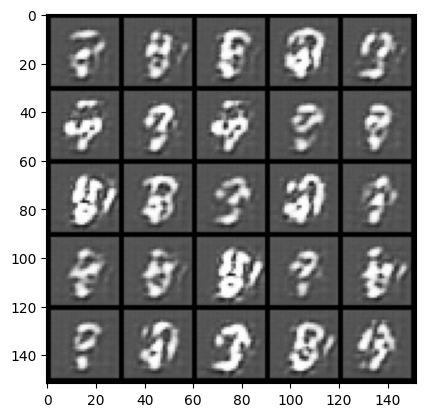

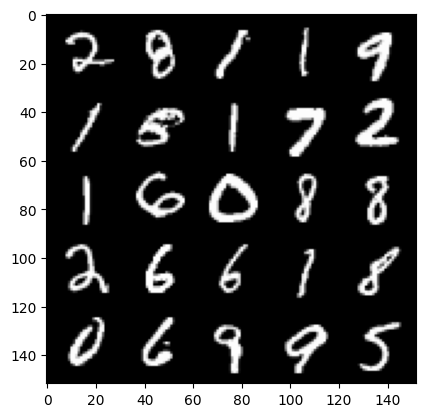

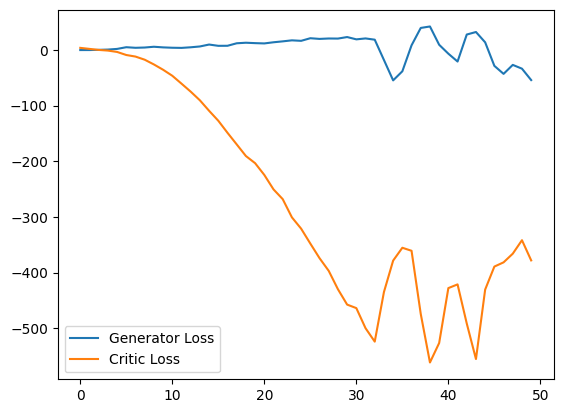

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.31756591796875
real: 561.095458984375, fake: 12.46091079711914, regularization: 113.1756591796875
crit_loss: torch.Size([]) -435.4588623046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.42534065246582
real: 528.7648315429688, fake: 7.067070007324219, regularization: 84.25340270996094
crit_loss: torch.Size([]) -437.4443359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.817461967468262
real: 558.3970336914062, fake: -58.23764419555664, regularization: 118.17462158203125
crit_loss: torch.Size([]) -498.4600830078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.636634826660156
real: 578.5953369140625, fake: -46.30515670776367, regularization: 96.36634826660156
crit_loss: torch.Size([]) -528.5341796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.784313201904297
real: 541.28759765625, fake: -119.83055877685547, regularization: 127.84313201904297
crit_loss: torch.Size([]) -

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.85706901550293
real: 544.1937255859375, fake: -46.10559844970703, regularization: 128.57069396972656
crit_loss: torch.Size([]) -461.7286376953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.129085540771484
real: 545.9511108398438, fake: -60.81249237060547, regularization: 91.29085540771484
crit_loss: torch.Size([]) -515.4727783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.500316619873047
real: 530.2171630859375, fake: -81.47059631347656, regularization: 105.00316619873047
crit_loss: torch.Size([]) -506.6845703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.132186889648438
real: 602.91357421875, fake: 4.912775993347168, regularization: 81.32186889648438
crit_loss: torch.Size([]) -516.678955078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.248835563659668
real: 537.8427734375, fake: -94.04170227050781, regularization: 142.4883575439453
crit_loss: torch.Size([]) 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 31.94534683227539
real: 655.08984375, fake: 291.6585998535156, regularization: 319.4534606933594
crit_loss: torch.Size([]) -43.977783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.188589096069336
real: 561.7689208984375, fake: 145.4112548828125, regularization: 81.88589477539062
crit_loss: torch.Size([]) -334.4717712402344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 19.44378089904785
real: 541.4425659179688, fake: 52.708473205566406, regularization: 194.43780517578125
crit_loss: torch.Size([]) -294.2962951660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.366830825805664
real: 558.8133544921875, fake: 77.92829895019531, regularization: 93.66830444335938
crit_loss: torch.Size([]) -387.2167663574219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.140019416809082
real: 569.1963500976562, fake: 66.03323364257812, regularization: 101.40019226074219
crit_loss: torch.Size([]) -4

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 21.17437744140625
real: 411.1846923828125, fake: -204.34762573242188, regularization: 211.7437744140625
crit_loss: torch.Size([]) -403.78857421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 113.4148178100586
real: 669.645263671875, fake: 373.4154968261719, regularization: 1134.148193359375
crit_loss: torch.Size([]) 837.91845703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 19.423479080200195
real: 126.51968383789062, fake: -61.81121063232422, regularization: 194.2347869873047
crit_loss: torch.Size([]) 5.9038848876953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 39.8296012878418
real: 57.873714447021484, fake: -84.93228149414062, regularization: 398.2960205078125
crit_loss: torch.Size([]) 255.49002075195312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.828800201416016
real: 189.05299377441406, fake: -9.921202659606934, regularization: 138.28799438476562
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 23.263919830322266
real: 451.0745849609375, fake: -111.85519409179688, regularization: 232.63919067382812
crit_loss: torch.Size([]) -330.2906188964844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 74.28620910644531
real: 680.65283203125, fake: 113.48342895507812, regularization: 742.862060546875
crit_loss: torch.Size([]) 175.692626953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 26.075395584106445
real: 355.43768310546875, fake: -94.7032699584961, regularization: 260.75396728515625
crit_loss: torch.Size([]) -189.38699340820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.393547058105469
real: 545.1885375976562, fake: -12.48935604095459, regularization: 123.93547058105469
crit_loss: torch.Size([]) -433.742431640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 16.216758728027344
real: 612.2420654296875, fake: 26.482234954833984, regularization: 162.16758728027344
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.606203079223633
real: 397.7439270019531, fake: 0.36153459548950195, regularization: 96.06202697753906
crit_loss: torch.Size([]) -301.32037353515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.887344360351562
real: 544.10888671875, fake: 42.60441589355469, regularization: 148.87344360351562
crit_loss: torch.Size([]) -352.6310119628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.735465049743652
real: 520.54443359375, fake: 12.695175170898438, regularization: 107.35465240478516
crit_loss: torch.Size([]) -400.4945983886719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.736747741699219
real: 497.99700927734375, fake: -12.747077941894531, regularization: 107.36747741699219
crit_loss: torch.Size([]) -403.3765869140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.095099449157715
real: 578.476318359375, fake: 30.206188201904297, regularization: 120.95099639892578
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 76.77090454101562
real: 707.1634521484375, fake: 315.89483642578125, regularization: 767.7090454101562
crit_loss: torch.Size([]) 376.4404296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.540757179260254
real: 418.2256774902344, fake: 54.15245056152344, regularization: 125.4075698852539
crit_loss: torch.Size([]) -238.66567993164062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 17.443336486816406
real: 289.92987060546875, fake: -73.61772155761719, regularization: 174.43336486816406
crit_loss: torch.Size([]) -189.11424255371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.872464179992676
real: 553.9747314453125, fake: 45.69871520996094, regularization: 88.72463989257812
crit_loss: torch.Size([]) -419.5513610839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.222171783447266
real: 584.34375, fake: 71.47390747070312, regularization: 92.22171783447266
crit_loss: torch.Size([]) -42

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 26.413890838623047
real: 691.1856689453125, fake: 168.2170867919922, regularization: 264.138916015625
crit_loss: torch.Size([]) -258.82965087890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 19.01288414001465
real: 468.13873291015625, fake: -126.43025207519531, regularization: 190.12884521484375
crit_loss: torch.Size([]) -404.44012451171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.470015525817871
real: 621.84814453125, fake: 146.1260528564453, regularization: 114.70015716552734
crit_loss: torch.Size([]) -361.0219421386719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.82237720489502
real: 619.2357177734375, fake: 85.64945983886719, regularization: 88.22377014160156
crit_loss: torch.Size([]) -445.36248779296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 16.092212677001953
real: 569.53125, fake: -27.819231033325195, regularization: 160.922119140625
crit_loss: torch.Size([])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 17.0202579498291
real: 64.67576599121094, fake: -9.913394927978516, regularization: 170.20257568359375
crit_loss: torch.Size([]) 95.61341857910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.857776641845703
real: 124.05488586425781, fake: -6.2186150550842285, regularization: 128.5777587890625
crit_loss: torch.Size([]) -1.69573974609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.681390762329102
real: 143.06900024414062, fake: -9.166271209716797, regularization: 106.81390380859375
crit_loss: torch.Size([]) -45.42137145996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.926813125610352
real: 172.091064453125, fake: -8.280020713806152, regularization: 129.26812744140625
crit_loss: torch.Size([]) -51.10295104980469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.698158264160156
real: 204.880615234375, fake: -9.410991668701172, regularization: 106.98158264160156
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.375330448150635
real: 480.3811950683594, fake: 82.88963317871094, regularization: 63.75330352783203
crit_loss: torch.Size([]) -333.73828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.41765022277832
real: 564.5133056640625, fake: 146.32183837890625, regularization: 64.17649841308594
crit_loss: torch.Size([]) -354.01495361328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.844944477081299
real: 530.513916015625, fake: 75.7414321899414, regularization: 68.44944763183594
crit_loss: torch.Size([]) -386.32305908203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.525365829467773
real: 516.85791015625, fake: 74.69892883300781, regularization: 65.253662109375
crit_loss: torch.Size([]) -376.90533447265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.619944095611572
real: 531.7095947265625, fake: 98.748779296875, regularization: 56.199440002441406
crit_loss: torch.Size([]) -376.761

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.741247177124023
real: 285.07098388671875, fake: 21.402000427246094, regularization: 87.4124755859375
crit_loss: torch.Size([]) -176.25650024414062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.383588790893555
real: 563.4078369140625, fake: 170.62388610839844, regularization: 73.83589172363281
crit_loss: torch.Size([]) -318.94805908203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.139448642730713
real: 408.51934814453125, fake: 45.02875518798828, regularization: 71.39448547363281
crit_loss: torch.Size([]) -292.09613037109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.47841739654541
real: 565.2435302734375, fake: 208.15069580078125, regularization: 84.78417205810547
crit_loss: torch.Size([]) -272.30865478515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.591554641723633
real: 391.9986572265625, fake: -17.090234756469727, regularization: 95.91554260253906
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.300461769104004
real: 580.5030517578125, fake: 121.65059661865234, regularization: 63.004615783691406
crit_loss: torch.Size([]) -395.84783935546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.59300422668457
real: 411.17767333984375, fake: -42.85411834716797, regularization: 95.93003845214844
crit_loss: torch.Size([]) -358.10174560546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.098294258117676
real: 618.823974609375, fake: 257.45440673828125, regularization: 140.98294067382812
crit_loss: torch.Size([]) -220.38662719726562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.647331237792969
real: 556.7575073242188, fake: 97.53197479248047, regularization: 96.47331237792969
crit_loss: torch.Size([]) -362.752197265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.761772155761719
real: 494.8435974121094, fake: 68.43086242675781, regularization: 77.61772155761719
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.890115737915039
real: 622.8662109375, fake: 181.68804931640625, regularization: 108.90115356445312
crit_loss: torch.Size([]) -332.2770080566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.808019638061523
real: 476.6466064453125, fake: -51.46368408203125, regularization: 128.0802001953125
crit_loss: torch.Size([]) -400.03009033203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.208934783935547
real: 521.6757202148438, fake: -2.1565303802490234, regularization: 92.08934783935547
crit_loss: torch.Size([]) -431.742919921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.897031784057617
real: 611.0919189453125, fake: 85.87486267089844, regularization: 88.97032165527344
crit_loss: torch.Size([]) -436.2467041015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.703592300415039
real: 263.005615234375, fake: -162.888671875, regularization: 157.03591918945312
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 34.25497817993164
real: 313.00274658203125, fake: -196.08143615722656, regularization: 342.5497741699219
crit_loss: torch.Size([]) -166.53439331054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 294.0682373046875
real: 669.941162109375, fake: 582.6503295898438, regularization: 2940.682373046875
crit_loss: torch.Size([]) 2853.3916015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 51.867431640625
real: 2.353454113006592, fake: -81.15972900390625, regularization: 518.67431640625
crit_loss: torch.Size([]) 435.1611328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 81.06512451171875
real: -9.320554733276367, fake: -110.61915588378906, regularization: 810.6512451171875
crit_loss: torch.Size([]) 709.3526611328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 34.395263671875
real: 8.604917526245117, fake: -32.593727111816406, regularization: 343.95263671875
crit_loss: torch.Size([]) 302.75

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.99702262878418
real: 24.662946701049805, fake: -22.64564323425293, regularization: 59.9702262878418
crit_loss: torch.Size([]) 12.661636352539062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.786801815032959
real: 28.254871368408203, fake: -21.700986862182617, regularization: 57.868019104003906
crit_loss: torch.Size([]) 7.912162780761719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.989668369293213
real: 31.468503952026367, fake: -21.49880599975586, regularization: 49.89668273925781
crit_loss: torch.Size([]) -3.0706253051757812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.414743423461914
real: 20.63943862915039, fake: -18.644760131835938, regularization: 64.14743041992188
crit_loss: torch.Size([]) 24.863231658935547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.054410934448242
real: 21.686187744140625, fake: -19.52118682861328, regularization: 60.54410934448242
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.856904983520508
real: 317.4549865722656, fake: 47.65077590942383, regularization: 58.56904983520508
crit_loss: torch.Size([]) -211.2351531982422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.276954650878906
real: 402.56182861328125, fake: 70.9554214477539, regularization: 72.76954650878906
crit_loss: torch.Size([]) -258.83685302734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.810600280761719
real: 400.77362060546875, fake: 70.43002319335938, regularization: 88.10600280761719
crit_loss: torch.Size([]) -242.2375946044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.04279899597168
real: 419.0467529296875, fake: 50.80561065673828, regularization: 80.42799377441406
crit_loss: torch.Size([]) -287.81317138671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.448442459106445
real: 424.6061096191406, fake: 46.6515998840332, regularization: 64.48442077636719
crit_loss: torch.Size([]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.883004188537598
real: 458.05560302734375, fake: 18.262813568115234, regularization: 88.83003997802734
crit_loss: torch.Size([]) -350.9627380371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.834678649902344
real: 564.18017578125, fake: 95.34011840820312, regularization: 148.34678649902344
crit_loss: torch.Size([]) -320.4932861328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.827370643615723
real: 477.99359130859375, fake: 37.35441589355469, regularization: 98.2737045288086
crit_loss: torch.Size([]) -342.3654479980469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.888486862182617
real: 457.33642578125, fake: 13.669390678405762, regularization: 78.88487243652344
crit_loss: torch.Size([]) -364.78216552734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.180864334106445
real: 563.103271484375, fake: 73.21849822998047, regularization: 101.80863952636719
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.289557456970215
real: 500.2733154296875, fake: 95.32099914550781, regularization: 102.89557647705078
crit_loss: torch.Size([]) -302.0567626953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.237161636352539
real: 524.729248046875, fake: 117.12311553955078, regularization: 82.37161254882812
crit_loss: torch.Size([]) -325.2345275878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.23519515991211
real: 506.7124328613281, fake: 88.17308807373047, regularization: 102.3519515991211
crit_loss: torch.Size([]) -316.1873779296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.176177978515625
real: 491.08209228515625, fake: 53.16069030761719, regularization: 111.76177978515625
crit_loss: torch.Size([]) -326.15960693359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.421788215637207
real: 531.775390625, fake: 74.55892944335938, regularization: 114.21788024902344
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 22.10887336730957
real: 301.0721435546875, fake: -114.62857818603516, regularization: 221.08872985839844
crit_loss: torch.Size([]) -194.6119842529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.511613845825195
real: 366.34576416015625, fake: -39.629371643066406, regularization: 115.11613464355469
crit_loss: torch.Size([]) -290.8590087890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.776127815246582
real: 587.4256591796875, fake: 75.26478576660156, regularization: 127.76127624511719
crit_loss: torch.Size([]) -384.39959716796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.350537300109863
real: 470.98773193359375, fake: -16.300756454467773, regularization: 73.50537109375
crit_loss: torch.Size([]) -413.7831115722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.186423301696777
real: 511.87213134765625, fake: -22.25012969970703, regularization: 121.8642349243164
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.1138834953308105
real: 5.628590106964111, fake: -11.168970108032227, regularization: 61.13883590698242
crit_loss: torch.Size([]) 44.341278076171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.939273834228516
real: 5.858466625213623, fake: -10.930593490600586, regularization: 79.39273834228516
crit_loss: torch.Size([]) 62.603675842285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.345197677612305
real: 6.082703590393066, fake: -9.954751968383789, regularization: 53.45197677612305
crit_loss: torch.Size([]) 37.414520263671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.961413383483887
real: 5.0477728843688965, fake: -10.087748527526855, regularization: 59.6141357421875
crit_loss: torch.Size([]) 44.478614807128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.163069725036621
real: 4.963804721832275, fake: -10.005655288696289, regularization: 41.630699157714844
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.095722675323486
real: 27.735843658447266, fake: 0.9695190787315369, regularization: 40.95722579956055
crit_loss: torch.Size([]) 14.190900802612305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.9747819900512695
real: 27.88395881652832, fake: -0.1341775506734848, regularization: 49.74781799316406
crit_loss: torch.Size([]) 21.72968101501465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.9895148277282715
real: 27.468212127685547, fake: -0.8120525479316711, regularization: 49.89514923095703
crit_loss: torch.Size([]) 21.614885330200195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.3141021728515625
real: 28.110273361206055, fake: -1.1871919631958008, regularization: 43.141021728515625
crit_loss: torch.Size([]) 13.843555450439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.3491435050964355
real: 29.644704818725586, fake: 0.9428176283836365, regularization: 43.49143600463867
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.58488655090332
real: 88.31437683105469, fake: 3.2190041542053223, regularization: 75.84886169433594
crit_loss: torch.Size([]) -9.246513366699219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.643916130065918
real: 89.67526245117188, fake: -1.6282848119735718, regularization: 76.43916320800781
crit_loss: torch.Size([]) -14.864387512207031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.48830509185791
real: 84.16949462890625, fake: -1.8716528415679932, regularization: 84.88304901123047
crit_loss: torch.Size([]) -1.1580963134765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.428923606872559
real: 90.00172424316406, fake: -1.3219419717788696, regularization: 74.28923797607422
crit_loss: torch.Size([]) -17.03443145751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.165450096130371
real: 102.90946197509766, fake: 8.463644981384277, regularization: 61.654502868652344
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.631505966186523
real: 401.78472900390625, fake: 3.5550923347473145, regularization: 146.3150634765625
crit_loss: torch.Size([]) -251.91458129882812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.281400680541992
real: 502.5791015625, fake: 54.874969482421875, regularization: 132.8140106201172
crit_loss: torch.Size([]) -314.89013671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.196962356567383
real: 444.76544189453125, fake: -11.091022491455078, regularization: 101.96961975097656
crit_loss: torch.Size([]) -353.8868408203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.710885047912598
real: 473.0477600097656, fake: -8.35747241973877, regularization: 87.10884857177734
crit_loss: torch.Size([]) -394.29638671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.217672348022461
real: 541.20556640625, fake: 35.23748779296875, regularization: 102.17672729492188
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 16.643518447875977
real: 51.586036682128906, fake: -76.20722961425781, regularization: 166.4351806640625
crit_loss: torch.Size([]) 38.64191436767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.1061372756958
real: 54.392601013183594, fake: -53.44134521484375, regularization: 91.06137084960938
crit_loss: torch.Size([]) -16.77257537841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.15488052368164
real: 59.22438049316406, fake: -74.07449340820312, regularization: 81.5488052368164
crit_loss: torch.Size([]) -51.75006866455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.551565170288086
real: 63.039058685302734, fake: -93.33026885986328, regularization: 125.51565551757812
crit_loss: torch.Size([]) -30.853668212890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 17.755142211914062
real: 69.97689819335938, fake: -101.39765167236328, regularization: 177.55142211914062
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.603538513183594
real: 225.564208984375, fake: 121.52610778808594, regularization: 96.03538513183594
crit_loss: torch.Size([]) -8.002716064453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.703760147094727
real: 383.21978759765625, fake: 108.16413116455078, regularization: 67.03759765625
crit_loss: torch.Size([]) -208.01806640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.667245864868164
real: 299.54339599609375, fake: 36.026695251464844, regularization: 86.67245483398438
crit_loss: torch.Size([]) -176.84423828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.276670455932617
real: 401.2384033203125, fake: 157.837646484375, regularization: 82.76670837402344
crit_loss: torch.Size([]) -160.63404846191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.225337982177734
real: 417.99200439453125, fake: 101.42413330078125, regularization: 72.25337982177734
crit_loss: torch.Size([]) 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.876598358154297
real: 476.18017578125, fake: 125.24639892578125, regularization: 88.76598358154297
crit_loss: torch.Size([]) -262.16778564453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.697714805603027
real: 488.2791748046875, fake: 60.17338562011719, regularization: 76.9771499633789
crit_loss: torch.Size([]) -351.1286315917969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.915995121002197
real: 460.7832946777344, fake: 47.5317497253418, regularization: 79.15995025634766
crit_loss: torch.Size([]) -334.09161376953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.844324111938477
real: 522.0874633789062, fake: 83.3073959350586, regularization: 68.4432373046875
crit_loss: torch.Size([]) -370.3368225097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.134988784790039
real: 491.3817138671875, fake: 49.50849151611328, regularization: 71.34988403320312
crit_loss: torch.Size([]) -3

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.109979629516602
real: 475.92022705078125, fake: 9.493585586547852, regularization: 91.09979248046875
crit_loss: torch.Size([]) -375.32684326171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.880779266357422
real: 502.7325134277344, fake: 29.834497451782227, regularization: 88.80779266357422
crit_loss: torch.Size([]) -384.0902099609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.270269393920898
real: 443.456298828125, fake: 76.00959014892578, regularization: 72.70269775390625
crit_loss: torch.Size([]) -294.7440185546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.588153839111328
real: 470.1028747558594, fake: 34.626800537109375, regularization: 85.88153839111328
crit_loss: torch.Size([]) -349.59454345703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.052674293518066
real: 452.564453125, fake: 17.317909240722656, regularization: 70.52674102783203
crit_loss: torch.Size([]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.507538795471191
real: 496.0794372558594, fake: 56.67407989501953, regularization: 145.0753936767578
crit_loss: torch.Size([]) -294.3299560546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 17.685958862304688
real: 386.11822509765625, fake: -89.3192138671875, regularization: 176.85958862304688
crit_loss: torch.Size([]) -298.5778503417969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 20.2854061126709
real: 570.311767578125, fake: 261.06158447265625, regularization: 202.85406494140625
crit_loss: torch.Size([]) -106.3961181640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 26.023778915405273
real: 415.8435363769531, fake: -44.437171936035156, regularization: 260.23779296875
crit_loss: torch.Size([]) -200.04290771484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.64647388458252
real: 484.715087890625, fake: 69.14077758789062, regularization: 126.46473693847656
crit_loss: torch.Si

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.986038208007812
real: 479.7799987792969, fake: 55.581787109375, regularization: 89.86038208007812
crit_loss: torch.Size([]) -334.33782958984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.555770874023438
real: 281.0746154785156, fake: 18.54054832458496, regularization: 95.55770874023438
crit_loss: torch.Size([]) -166.97634887695312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.234651565551758
real: 490.9542541503906, fake: 78.56253051757812, regularization: 122.34651184082031
crit_loss: torch.Size([]) -290.04522705078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.004902839660645
real: 361.6903076171875, fake: -20.777511596679688, regularization: 140.0490264892578
crit_loss: torch.Size([]) -242.41880798339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.00268840789795
real: 450.5260925292969, fake: 9.125198364257812, regularization: 110.02688598632812
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.407478332519531
real: 451.448486328125, fake: 42.03610610961914, regularization: 74.07478332519531
crit_loss: torch.Size([]) -335.33758544921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.162693977355957
real: 486.4306335449219, fake: 74.61474609375, regularization: 101.62693786621094
crit_loss: torch.Size([]) -310.18896484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.361457824707031
real: 448.91143798828125, fake: 46.35047912597656, regularization: 93.61457824707031
crit_loss: torch.Size([]) -308.9464111328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.862339973449707
real: 472.19830322265625, fake: 87.98240661621094, regularization: 98.62339782714844
crit_loss: torch.Size([]) -285.59246826171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.043758392333984
real: 450.06390380859375, fake: 32.960968017578125, regularization: 90.43758392333984
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.58444881439209
real: 472.5792236328125, fake: -25.052982330322266, regularization: 115.84449005126953
crit_loss: torch.Size([]) -381.7877197265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 18.016212463378906
real: 423.07177734375, fake: -42.80431365966797, regularization: 180.16212463378906
crit_loss: torch.Size([]) -285.7139892578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.452956199645996
real: 527.9591064453125, fake: 89.37008666992188, regularization: 84.5295639038086
crit_loss: torch.Size([]) -354.0594482421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 18.065982818603516
real: 394.12652587890625, fake: -110.2963638305664, regularization: 180.65982055664062
crit_loss: torch.Size([]) -323.7630615234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 26.11972999572754
real: 562.2875366210938, fake: 143.2412872314453, regularization: 261.1972961425781
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.5605950355529785
real: 9.67315673828125, fake: -18.552082061767578, regularization: 55.60594940185547
crit_loss: torch.Size([]) 27.38071060180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.105140686035156
real: 9.459188461303711, fake: -19.666053771972656, regularization: 61.05140686035156
crit_loss: torch.Size([]) 31.926164627075195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.855785369873047
real: 9.07351016998291, fake: -18.07246971130371, regularization: 48.55785369873047
crit_loss: torch.Size([]) 21.41187286376953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.9761962890625
real: 9.643610954284668, fake: -18.57630157470703, regularization: 39.761962890625
crit_loss: torch.Size([]) 11.542049407958984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.1209540367126465
real: 10.103819847106934, fake: -18.214351654052734, regularization: 51.20954132080078
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.3521928787231445
real: 15.055709838867188, fake: -17.72597885131836, regularization: 63.52192687988281
crit_loss: torch.Size([]) 30.740238189697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.638955116271973
real: 17.000476837158203, fake: -15.96028995513916, regularization: 56.389549255371094
crit_loss: torch.Size([]) 23.428783416748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.321528434753418
real: 18.05028533935547, fake: -16.31387710571289, regularization: 43.21528625488281
crit_loss: torch.Size([]) 8.851123809814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.844225883483887
real: 18.005706787109375, fake: -16.308650970458984, regularization: 58.4422607421875
crit_loss: torch.Size([]) 24.12790298461914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.68331241607666
real: 19.958797454833984, fake: -15.61539077758789, regularization: 56.83312225341797
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.447534561157227
real: 118.88113403320312, fake: -11.071386337280273, regularization: 144.475341796875
crit_loss: torch.Size([]) 14.5228271484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.204996109008789
real: 118.9921875, fake: -3.8370423316955566, regularization: 92.04995727539062
crit_loss: torch.Size([]) -30.779273986816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.159050941467285
real: 171.92160034179688, fake: 19.110565185546875, regularization: 71.59050750732422
crit_loss: torch.Size([]) -81.22052764892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.459306716918945
real: 221.0656280517578, fake: 32.086822509765625, regularization: 94.59306335449219
crit_loss: torch.Size([]) -94.3857421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.433748245239258
real: 218.24771118164062, fake: 12.908411026000977, regularization: 114.33747863769531
crit_loss: torch.Size([]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 32.75027084350586
real: -0.8240529894828796, fake: -19.26323890686035, regularization: 327.5027160644531
crit_loss: torch.Size([]) 309.06353759765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 37.06630325317383
real: -4.739062309265137, fake: -20.788558959960938, regularization: 370.66302490234375
crit_loss: torch.Size([]) 354.613525390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.524520874023438
real: -8.774908065795898, fake: -23.19015884399414, regularization: 145.24520874023438
crit_loss: torch.Size([]) 130.8299560546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.79024600982666
real: -11.283246994018555, fake: -23.39447593688965, regularization: 87.90245819091797
crit_loss: torch.Size([]) 75.79122924804688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.45306396484375
real: -11.426557540893555, fake: -23.032852172851562, regularization: 94.5306396484375
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2410402297973633
real: -4.314005374908447, fake: -21.442840576171875, regularization: 32.410400390625
crit_loss: torch.Size([]) 15.281564712524414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.3855948448181152
real: -4.444141387939453, fake: -21.70065689086914, regularization: 33.85594940185547
crit_loss: torch.Size([]) 16.59943389892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7090377807617188
real: -4.274221897125244, fake: -21.597454071044922, regularization: 37.09037780761719
crit_loss: torch.Size([]) 19.76714515686035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8323616981506348
real: -4.1753926277160645, fake: -21.915264129638672, regularization: 28.32361602783203
crit_loss: torch.Size([]) 10.583744049072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.732004165649414
real: -4.009885311126709, fake: -21.894630432128906, regularization: 37.32004165649414
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9619579315185547
real: -2.0560789108276367, fake: -19.634597778320312, regularization: 29.619579315185547
crit_loss: torch.Size([]) 12.041061401367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4047207832336426
real: -1.9556289911270142, fake: -20.248764038085938, regularization: 34.04720687866211
crit_loss: torch.Size([]) 15.754072189331055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.874574184417725
real: 2.6751933097839355, fake: -19.210437774658203, regularization: 48.74574279785156
crit_loss: torch.Size([]) 26.860111236572266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4811956882476807
real: 2.918017864227295, fake: -19.05321502685547, regularization: 34.81195831298828
crit_loss: torch.Size([]) 12.84072494506836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2564165592193604
real: 3.0498971939086914, fake: -18.841442108154297, regularization: 32.56416702270508
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.402052164077759
real: 4.968110084533691, fake: -17.38440704345703, regularization: 24.02052116394043
crit_loss: torch.Size([]) 1.6680049896240234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2284860610961914
real: 5.2233381271362305, fake: -16.076433181762695, regularization: 32.28485870361328
crit_loss: torch.Size([]) 10.985088348388672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.860276699066162
real: 5.110623359680176, fake: -16.593795776367188, regularization: 28.602767944335938
crit_loss: torch.Size([]) 6.898349761962891
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.204833030700684
real: 5.010496616363525, fake: -16.97434425354004, regularization: 52.04833221435547
crit_loss: torch.Size([]) 30.063491821289062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6662185192108154
real: 5.923443794250488, fake: -17.716062545776367, regularization: 26.662185668945312
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.00941801071167
real: 7.929816246032715, fake: -13.600181579589844, regularization: 30.094181060791016
crit_loss: torch.Size([]) 8.56418228149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1366794109344482
real: 12.81792163848877, fake: -13.287776947021484, regularization: 31.36679458618164
crit_loss: torch.Size([]) 5.261096954345703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.913127899169922
real: 13.032289505004883, fake: -12.992145538330078, regularization: 39.13127899169922
crit_loss: torch.Size([]) 13.106843948364258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.084731101989746
real: 12.902604103088379, fake: -13.867271423339844, regularization: 30.84731101989746
crit_loss: torch.Size([]) 4.077436447143555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2965946197509766
real: 12.837997436523438, fake: -13.449233055114746, regularization: 32.965946197509766
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2919862270355225
real: 22.14674949645996, fake: -8.248554229736328, regularization: 32.91986083984375
crit_loss: torch.Size([]) 2.524557113647461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.868149995803833
real: 22.88034439086914, fake: -8.163631439208984, regularization: 28.681499481201172
crit_loss: torch.Size([]) -2.362476348876953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.92498517036438
real: 23.24509620666504, fake: -7.258640289306641, regularization: 39.24985122680664
crit_loss: torch.Size([]) 8.746114730834961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.702436923980713
real: 16.48352813720703, fake: -7.671017646789551, regularization: 37.02436828613281
crit_loss: torch.Size([]) 12.869823455810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.807067632675171
real: 16.60519027709961, fake: -8.06293773651123, regularization: 28.070676803588867
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.064269065856934
real: 36.18672561645508, fake: 0.24333971738815308, regularization: 40.64269256591797
crit_loss: torch.Size([]) 4.699306488037109
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.210728645324707
real: 36.523521423339844, fake: 0.5339664220809937, regularization: 42.10728454589844
crit_loss: torch.Size([]) 6.117729187011719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2238147258758545
real: 37.416847229003906, fake: -0.17557412385940552, regularization: 32.2381477355957
crit_loss: torch.Size([]) -5.354274749755859
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4898412227630615
real: 37.85042953491211, fake: 1.1028964519500732, regularization: 34.89841079711914
crit_loss: torch.Size([]) -1.84912109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.5138516426086426
real: 38.142276763916016, fake: -0.09405237436294556, regularization: 35.13851547241211
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.992344856262207
real: 48.486724853515625, fake: 13.360319137573242, regularization: 39.92344665527344
crit_loss: torch.Size([]) 4.7970428466796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.39310359954834
real: 48.67969512939453, fake: 14.009161949157715, regularization: 33.93103790283203
crit_loss: torch.Size([]) -0.7394943237304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.961914539337158
real: 57.82512664794922, fake: 18.538118362426758, regularization: 29.619144439697266
crit_loss: torch.Size([]) -9.667865753173828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.059986114501953
real: 58.56120300292969, fake: 16.687517166137695, regularization: 40.59986114501953
crit_loss: torch.Size([]) -1.2738265991210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.2664570808410645
real: 59.40083694458008, fake: 18.474367141723633, regularization: 42.66456985473633
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.991616249084473
real: 50.349300384521484, fake: 14.132429122924805, regularization: 49.916160583496094
crit_loss: torch.Size([]) 13.699287414550781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.699619293212891
real: 52.04082489013672, fake: 11.614034652709961, regularization: 46.996192932128906
crit_loss: torch.Size([]) 6.569404602050781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.315320014953613
real: 51.043678283691406, fake: 6.944524765014648, regularization: 53.1531982421875
crit_loss: torch.Size([]) 9.054046630859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.235348701477051
real: 49.3790283203125, fake: 1.992858648300171, regularization: 62.353485107421875
crit_loss: torch.Size([]) 14.967315673828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.595096588134766
real: 49.15547180175781, fake: 5.155109405517578, regularization: 45.950965881347656
crit_loss: torch.Size

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7399661540985107
real: 52.34605407714844, fake: 1.854614496231079, regularization: 37.399662017822266
crit_loss: torch.Size([]) -13.091777801513672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.403281211853027
real: 51.3438720703125, fake: -1.332491159439087, regularization: 54.032814025878906
crit_loss: torch.Size([]) 1.3564491271972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.8336868286132812
real: 50.981529235839844, fake: -4.1694440841674805, regularization: 38.33686828613281
crit_loss: torch.Size([]) -16.814105987548828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.478997230529785
real: 52.963897705078125, fake: -4.559711933135986, regularization: 44.78997039794922
crit_loss: torch.Size([]) -12.733638763427734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.604808807373047
real: 55.01198196411133, fake: -2.910184383392334, regularization: 36.04808807373047
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.983766555786133
real: 95.49077606201172, fake: -6.066242218017578, regularization: 89.83766174316406
crit_loss: torch.Size([]) -11.7193603515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.14086389541626
real: 91.78495025634766, fake: -11.996772766113281, regularization: 61.40863800048828
crit_loss: torch.Size([]) -42.373085021972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.015164852142334
real: 94.99398803710938, fake: -4.662760257720947, regularization: 70.15164947509766
crit_loss: torch.Size([]) -29.505096435546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.416455268859863
real: 101.07774353027344, fake: -0.6252714991569519, regularization: 44.16455078125
crit_loss: torch.Size([]) -57.53846740722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.315082550048828
real: 109.72898864746094, fake: 5.274435997009277, regularization: 73.15082550048828
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.671072959899902
real: 342.99566650390625, fake: 137.45413208007812, regularization: 156.71072387695312
crit_loss: torch.Size([]) -48.830810546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.225526809692383
real: 255.7778778076172, fake: 23.14210319519043, regularization: 132.25526428222656
crit_loss: torch.Size([]) -100.38050842285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.648942947387695
real: 254.04539489746094, fake: 17.76938247680664, regularization: 116.48942565917969
crit_loss: torch.Size([]) -119.78659057617188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.0399169921875
real: 287.70166015625, fake: 45.526580810546875, regularization: 70.399169921875
crit_loss: torch.Size([]) -171.77590942382812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.2096586227417
real: 143.1333465576172, fake: 62.06816482543945, regularization: 112.09658813476562
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.829182147979736
real: 5.35479211807251, fake: -25.52337646484375, regularization: 58.29182052612305
crit_loss: torch.Size([]) 27.413652420043945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.533858299255371
real: -1.3943259716033936, fake: -22.92938232421875, regularization: 55.338584899902344
crit_loss: torch.Size([]) 33.80352783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1159963607788086
real: -0.8046402335166931, fake: -21.346105575561523, regularization: 31.159963607788086
crit_loss: torch.Size([]) 10.618497848510742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.8919522762298584
real: -0.9130511283874512, fake: -24.097368240356445, regularization: 38.91952133178711
crit_loss: torch.Size([]) 15.735204696655273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.889986038208008
real: -1.6787875890731812, fake: -26.19204330444336, regularization: 68.89985656738281
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.7881364822387695
real: 14.410970687866211, fake: -39.871543884277344, regularization: 67.88136291503906
crit_loss: torch.Size([]) 13.598846435546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.390059471130371
real: 14.863054275512695, fake: -44.850791931152344, regularization: 53.900596618652344
crit_loss: torch.Size([]) -5.8132476806640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.769104957580566
real: 14.87358570098877, fake: -49.84315490722656, regularization: 57.69104766845703
crit_loss: torch.Size([]) -7.02569580078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.257893562316895
real: 4.66660213470459, fake: -44.65155029296875, regularization: 82.57893371582031
crit_loss: torch.Size([]) 33.260780334472656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.408239364624023
real: 10.5906400680542, fake: -45.742347717285156, regularization: 84.0823974609375
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.623281478881836
real: 141.60809326171875, fake: 43.16828155517578, regularization: 96.23281860351562
crit_loss: torch.Size([]) -2.2069931030273438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.99842357635498
real: 166.63482666015625, fake: 37.67445373535156, regularization: 109.98423767089844
crit_loss: torch.Size([]) -18.97613525390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.455631256103516
real: 190.415283203125, fake: 47.858184814453125, regularization: 114.55631256103516
crit_loss: torch.Size([]) -28.00078582763672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.282803535461426
real: 190.32553100585938, fake: 46.23796081542969, regularization: 122.82803344726562
crit_loss: torch.Size([]) -21.259536743164062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.026329040527344
real: 189.60011291503906, fake: 34.74262237548828, regularization: 80.26329040527344
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.221031188964844
real: 267.755615234375, fake: 41.422935485839844, regularization: 52.21031188964844
crit_loss: torch.Size([]) -174.1223602294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.729866981506348
real: 301.75762939453125, fake: 52.228599548339844, regularization: 57.298667907714844
crit_loss: torch.Size([]) -192.2303466796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.951482772827148
real: 205.90240478515625, fake: 108.04061889648438, regularization: 69.51483154296875
crit_loss: torch.Size([]) -28.346954345703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.96060562133789
real: 265.386962890625, fake: 13.941442489624023, regularization: 89.6060562133789
crit_loss: torch.Size([]) -161.8394775390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.196477890014648
real: 229.78366088867188, fake: 4.247725009918213, regularization: 141.96478271484375
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.9633150100708
real: 327.84051513671875, fake: 84.8763427734375, regularization: 129.63314819335938
crit_loss: torch.Size([]) -113.33102416992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.745513916015625
real: 249.885498046875, fake: 22.864795684814453, regularization: 127.45513916015625
crit_loss: torch.Size([]) -99.56556701660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.250898361206055
real: 350.15447998046875, fake: 85.48619079589844, regularization: 82.50898742675781
crit_loss: torch.Size([]) -182.15928649902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.741849899291992
real: 324.66180419921875, fake: 50.415870666503906, regularization: 107.41850280761719
crit_loss: torch.Size([]) -166.8274383544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.90633773803711
real: 264.63824462890625, fake: 54.52987289428711, regularization: 109.0633773803711
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.367051124572754
real: 330.50054931640625, fake: 123.69207000732422, regularization: 73.6705093383789
crit_loss: torch.Size([]) -133.13796997070312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.299001693725586
real: 165.53958129882812, fake: 96.93704986572266, regularization: 102.99002075195312
crit_loss: torch.Size([]) 34.387489318847656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.372739791870117
real: 273.22503662109375, fake: 97.37850952148438, regularization: 63.72739791870117
crit_loss: torch.Size([]) -112.11912536621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.153772354125977
real: 266.28033447265625, fake: 66.78483581542969, regularization: 111.5377197265625
crit_loss: torch.Size([]) -87.95777893066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.619056701660156
real: 246.98178100585938, fake: 52.428932189941406, regularization: 96.19056701660156
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.278042793273926
real: 278.44940185546875, fake: 58.50890350341797, regularization: 102.78042602539062
crit_loss: torch.Size([]) -117.16006469726562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.11787223815918
real: 318.839599609375, fake: 78.7795181274414, regularization: 91.17872619628906
crit_loss: torch.Size([]) -148.88136291503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.636791229248047
real: 306.26971435546875, fake: 80.28636169433594, regularization: 106.36791229248047
crit_loss: torch.Size([]) -119.61544036865234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.37315845489502
real: 247.90615844726562, fake: 105.97959899902344, regularization: 103.73158264160156
crit_loss: torch.Size([]) -38.194976806640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.592270851135254
real: 344.2607421875, fake: 138.107666015625, regularization: 65.9227066040039
crit_loss: torch.Siz

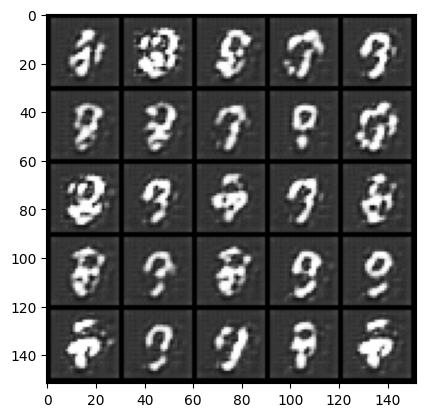

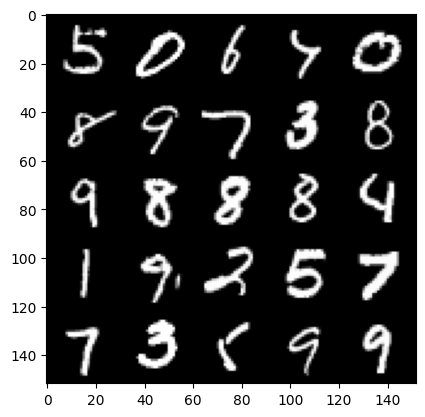

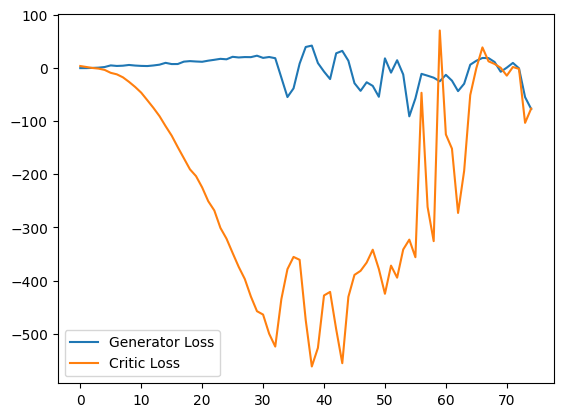

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.1628594398498535
real: 265.96441650390625, fake: 104.44209289550781, regularization: 71.62859344482422
crit_loss: torch.Size([]) -89.89373016357422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.091985702514648
real: 304.8193359375, fake: 60.11104965209961, regularization: 70.91986083984375
crit_loss: torch.Size([]) -173.78842163085938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.267555236816406
real: 273.44390869140625, fake: 26.845523834228516, regularization: 62.67555236816406
crit_loss: torch.Size([]) -183.92283630371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.510320663452148
real: 365.60955810546875, fake: 133.16375732421875, regularization: 135.10321044921875
crit_loss: torch.Size([]) -97.34259033203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 25.094379425048828
real: 167.69900512695312, fake: -57.507503509521484, regularization: 250.94378662109375
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.714385986328125
real: 410.5398864746094, fake: 93.63542938232422, regularization: 157.14385986328125
crit_loss: torch.Size([]) -159.76058959960938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 21.620346069335938
real: 276.2970275878906, fake: -55.706932067871094, regularization: 216.20346069335938
crit_loss: torch.Size([]) -115.80050659179688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 18.391315460205078
real: 414.2449951171875, fake: 211.40797424316406, regularization: 183.91314697265625
crit_loss: torch.Size([]) -18.923873901367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.604622840881348
real: 286.22216796875, fake: 48.007896423339844, regularization: 56.046226501464844
crit_loss: torch.Size([]) -182.16802978515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.47118854522705
real: 328.64727783203125, fake: 71.040283203125, regularization: 84.71188354492188
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.917937278747559
real: 342.91015625, fake: 67.52568054199219, regularization: 79.17937469482422
crit_loss: torch.Size([]) -196.205078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.439371109008789
real: 341.98565673828125, fake: 58.36311340332031, regularization: 104.39370727539062
crit_loss: torch.Size([]) -179.22885131835938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.28792953491211
real: 375.1917724609375, fake: 110.1065902709961, regularization: 82.8792953491211
crit_loss: torch.Size([]) -182.20587158203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.309865951538086
real: 279.4152526855469, fake: -15.02005672454834, regularization: 133.09866333007812
crit_loss: torch.Size([]) -161.33663940429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 25.86974334716797
real: 239.680419921875, fake: 221.5852813720703, regularization: 258.69744873046875
crit_loss: torch.Size([]) 2

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 21.408470153808594
real: 208.82666015625, fake: -73.21985626220703, regularization: 214.08470153808594
crit_loss: torch.Size([]) -67.96180725097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.277420043945312
real: 296.89892578125, fake: 153.82452392578125, regularization: 92.77420043945312
crit_loss: torch.Size([]) -50.300201416015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.880156517028809
real: 306.18133544921875, fake: 34.405635833740234, regularization: 88.80156707763672
crit_loss: torch.Size([]) -182.97412109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 16.56871223449707
real: 202.12765502929688, fake: -55.61859893798828, regularization: 165.68711853027344
crit_loss: torch.Size([]) -92.05912780761719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.175460815429688
real: 375.1083679199219, fake: 133.06607055664062, regularization: 141.75460815429688
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.237956047058105
real: 376.8377685546875, fake: 170.04843139648438, regularization: 102.37956237792969
crit_loss: torch.Size([]) -104.40977478027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.633413314819336
real: 334.4385070800781, fake: 117.72923278808594, regularization: 76.33413696289062
crit_loss: torch.Size([]) -140.37513732910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.190805435180664
real: 339.81201171875, fake: 134.214111328125, regularization: 91.90805053710938
crit_loss: torch.Size([]) -113.68984985351562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.004474639892578
real: 331.3892822265625, fake: 169.99044799804688, regularization: 80.04474639892578
crit_loss: torch.Size([]) -81.35408782958984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.572432041168213
real: 317.3642578125, fake: 157.4904022216797, regularization: 65.72431945800781
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.217076301574707
real: 248.13980102539062, fake: 129.37387084960938, regularization: 72.17076110839844
crit_loss: torch.Size([]) -46.59516906738281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.080155849456787
real: 358.57354736328125, fake: 200.46109008789062, regularization: 70.80155944824219
crit_loss: torch.Size([]) -87.31089782714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.958505630493164
real: 344.29168701171875, fake: 128.43040466308594, regularization: 89.58505249023438
crit_loss: torch.Size([]) -126.27622985839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.378856658935547
real: 314.33477783203125, fake: 114.3910903930664, regularization: 83.78856658935547
crit_loss: torch.Size([]) -116.1551284790039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.99808931350708
real: 370.3060607910156, fake: 151.49893188476562, regularization: 59.980892181396484
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 32.10407638549805
real: 132.7887420654297, fake: -117.68568420410156, regularization: 321.040771484375
crit_loss: torch.Size([]) 70.56634521484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 78.34893798828125
real: 422.2572021484375, fake: 322.6889953613281, regularization: 783.4893798828125
crit_loss: torch.Size([]) 683.921142578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 39.37353515625
real: 223.5003662109375, fake: 20.40363883972168, regularization: 393.7353515625
crit_loss: torch.Size([]) 190.6386260986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 16.083507537841797
real: 320.59259033203125, fake: 116.00615692138672, regularization: 160.8350830078125
crit_loss: torch.Size([]) -43.7513427734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.775483131408691
real: 403.93804931640625, fake: 184.17898559570312, regularization: 157.7548370361328
crit_loss: torch.Size([]) -62

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.902175903320312
real: 300.8791198730469, fake: 76.92430877685547, regularization: 99.02175903320312
crit_loss: torch.Size([]) -124.93304443359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.68285083770752
real: 233.56295776367188, fake: -2.839064836502075, regularization: 86.82850646972656
crit_loss: torch.Size([]) -149.57351684570312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.891644477844238
real: 321.97174072265625, fake: 50.26383590698242, regularization: 128.91644287109375
crit_loss: torch.Size([]) -142.79147338867188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.899261474609375
real: 310.01214599609375, fake: 17.519702911376953, regularization: 108.99261474609375
crit_loss: torch.Size([]) -183.49981689453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.376386642456055
real: 315.100341796875, fake: 72.80957794189453, regularization: 103.76387023925781
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.549625396728516
real: 252.25643920898438, fake: 14.29175090789795, regularization: 65.49625396728516
crit_loss: torch.Size([]) -172.46844482421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.209725379943848
real: 293.8531494140625, fake: 97.58312225341797, regularization: 152.09725952148438
crit_loss: torch.Size([]) -44.172760009765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 22.148059844970703
real: 179.97360229492188, fake: -50.70491409301758, regularization: 221.4805908203125
crit_loss: torch.Size([]) -9.197921752929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 18.19546127319336
real: 331.297119140625, fake: 76.25128173828125, regularization: 181.95462036132812
crit_loss: torch.Size([]) -73.09121704101562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.207269668579102
real: 251.5550079345703, fake: -4.636508941650391, regularization: 72.07269287109375
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 58.424102783203125
real: 405.1529541015625, fake: 300.84771728515625, regularization: 584.2410278320312
crit_loss: torch.Size([]) 479.935791015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 56.76274490356445
real: 160.06936645507812, fake: -92.70426940917969, regularization: 567.62744140625
crit_loss: torch.Size([]) 314.85382080078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.798423767089844
real: 287.084228515625, fake: 24.619775772094727, regularization: 87.98423767089844
crit_loss: torch.Size([]) -174.48020935058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 29.743331909179688
real: 372.8785400390625, fake: 153.97476196289062, regularization: 297.4333190917969
crit_loss: torch.Size([]) 78.529541015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 19.120098114013672
real: 156.98069763183594, fake: -44.090843200683594, regularization: 191.20098876953125
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.328498840332031
real: 388.189453125, fake: 15.373847007751465, regularization: 63.28498840332031
crit_loss: torch.Size([]) -309.5306396484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.294239044189453
real: 387.36480712890625, fake: 36.140628814697266, regularization: 122.94239044189453
crit_loss: torch.Size([]) -228.28179931640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.633265495300293
real: 11.859294891357422, fake: 84.849853515625, regularization: 66.33265686035156
crit_loss: torch.Size([]) 139.32321166992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.068749904632568
real: -2.1724438667297363, fake: 13.928691864013672, regularization: 70.6875
crit_loss: torch.Size([]) 86.78863525390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.595219612121582
real: -9.251073837280273, fake: -12.982131958007812, regularization: 65.95219421386719
crit_loss: torch.Size([]) 62.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.244730949401855
real: 9.596853256225586, fake: -67.73060607910156, regularization: 102.44731140136719
crit_loss: torch.Size([]) 25.119850158691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.209707260131836
real: 11.54654598236084, fake: -65.8515625, regularization: 82.09707641601562
crit_loss: torch.Size([]) 4.698966979980469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.541427612304688
real: 11.091512680053711, fake: -79.20928192138672, regularization: 95.41427612304688
crit_loss: torch.Size([]) 5.1134796142578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.74169921875
real: 12.011384963989258, fake: -85.81100463867188, regularization: 107.4169921875
crit_loss: torch.Size([]) 9.5946044921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.957422256469727
real: 5.726313591003418, fake: -79.44734191894531, regularization: 119.57421875
crit_loss: torch.Size([]) 34.40056610

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.934423446655273
real: 196.79754638671875, fake: 6.632941722869873, regularization: 159.34423828125
crit_loss: torch.Size([]) -30.82037353515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.285897254943848
real: 178.41653442382812, fake: 4.046645164489746, regularization: 112.85897064208984
crit_loss: torch.Size([]) -61.51091766357422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.108201026916504
real: 198.8253173828125, fake: 14.797687530517578, regularization: 81.0820083618164
crit_loss: torch.Size([]) -102.94562530517578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.905213356018066
real: 212.64825439453125, fake: 20.968481063842773, regularization: 119.05213165283203
crit_loss: torch.Size([]) -72.62764739990234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.299544334411621
real: 201.79953002929688, fake: 12.313518524169922, regularization: 92.99544525146484
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.123671531677246
real: 263.40728759765625, fake: 63.07612609863281, regularization: 71.2367172241211
crit_loss: torch.Size([]) -129.09445190429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.739648342132568
real: 263.0937805175781, fake: 56.226173400878906, regularization: 77.396484375
crit_loss: torch.Size([]) -129.47113037109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.965001106262207
real: 276.64312744140625, fake: 57.38037872314453, regularization: 69.65000915527344
crit_loss: torch.Size([]) -149.6127471923828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.887979507446289
real: 99.81285095214844, fake: 86.27590942382812, regularization: 88.87979125976562
crit_loss: torch.Size([]) 75.34284973144531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.649490356445312
real: 271.40313720703125, fake: 14.635875701904297, regularization: 106.49490356445312
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.669552803039551
real: 105.23388671875, fake: 26.307104110717773, regularization: 66.69552612304688
crit_loss: torch.Size([]) -12.231254577636719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.281835556030273
real: 164.61929321289062, fake: -77.94204711914062, regularization: 142.818359375
crit_loss: torch.Size([]) -99.74298095703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 43.48401641845703
real: 381.1085510253906, fake: 41.242210388183594, regularization: 434.84014892578125
crit_loss: torch.Size([]) 94.97381591796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 169.10035705566406
real: -100.36762237548828, fake: -219.0441131591797, regularization: 1691.0035400390625
crit_loss: torch.Size([]) 1572.3270263671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 434.4292297363281
real: 464.0189208984375, fake: 455.3540344238281, regularization: 4344.29248046875
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.1490478515625
real: -30.034168243408203, fake: -47.96710968017578, regularization: 51.490478515625
crit_loss: torch.Size([]) 33.55753707885742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.620983600616455
real: -30.036102294921875, fake: -47.34605026245117, regularization: 36.209835052490234
crit_loss: torch.Size([]) 18.899887084960938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.2884521484375
real: -30.045875549316406, fake: -47.9742431640625, regularization: 42.884521484375
crit_loss: torch.Size([]) 24.956153869628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.82788610458374
real: -30.436552047729492, fake: -47.42909240722656, regularization: 48.27886199951172
crit_loss: torch.Size([]) 31.28632164001465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.986437797546387
real: -30.545682907104492, fake: -47.483787536621094, regularization: 49.8643798828125
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.431260108947754
real: -31.752792358398438, fake: -50.120155334472656, regularization: 44.312599182128906
crit_loss: torch.Size([]) 25.945236206054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.45582389831543
real: -31.301021575927734, fake: -49.12606430053711, regularization: 44.5582389831543
crit_loss: torch.Size([]) 26.733196258544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.086415767669678
real: -31.625242233276367, fake: -52.55498123168945, regularization: 50.864158630371094
crit_loss: torch.Size([]) 29.934419631958008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.120185852050781
real: -31.451126098632812, fake: -51.0807991027832, regularization: 51.20185852050781
crit_loss: torch.Size([]) 31.572185516357422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.1445112228393555
real: -30.926185607910156, fake: -49.976131439208984, regularization: 41.44511413574219
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.011419296264648
real: -30.479209899902344, fake: -51.080440521240234, regularization: 50.114192962646484
crit_loss: torch.Size([]) 29.512962341308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.320300102233887
real: -30.547035217285156, fake: -49.94373321533203, regularization: 53.2030029296875
crit_loss: torch.Size([]) 33.806304931640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.094651222229004
real: -30.252944946289062, fake: -49.47528076171875, regularization: 50.946510314941406
crit_loss: torch.Size([]) 31.72417449951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.647643566131592
real: -29.574535369873047, fake: -49.240028381347656, regularization: 46.476436614990234
crit_loss: torch.Size([]) 26.810943603515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.967230319976807
real: -28.66895294189453, fake: -48.096046447753906, regularization: 49.67230224609375
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.6491899490356445
real: -22.015113830566406, fake: -43.252906799316406, regularization: 46.49189758300781
crit_loss: torch.Size([]) 25.254104614257812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.758379936218262
real: -22.120250701904297, fake: -43.579776763916016, regularization: 47.58380126953125
crit_loss: torch.Size([]) 26.12427520751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.642763137817383
real: -22.051288604736328, fake: -43.76858139038086, regularization: 46.42763137817383
crit_loss: torch.Size([]) 24.710338592529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.136871814727783
real: -22.02927589416504, fake: -43.48759078979492, regularization: 41.368717193603516
crit_loss: torch.Size([]) 19.910402297973633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.883810043334961
real: -21.688499450683594, fake: -42.90510559082031, regularization: 58.83810043334961
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.231678009033203
real: -10.17060661315918, fake: -37.78253173828125, regularization: 52.31678009033203
crit_loss: torch.Size([]) 24.70485496520996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.306684494018555
real: -9.866138458251953, fake: -37.59882354736328, regularization: 53.06684494018555
crit_loss: torch.Size([]) 25.33415985107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.879126071929932
real: -9.384845733642578, fake: -36.242523193359375, regularization: 48.791259765625
crit_loss: torch.Size([]) 21.933582305908203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.6315016746521
real: -9.122434616088867, fake: -36.71928024291992, regularization: 56.31501770019531
crit_loss: torch.Size([]) 28.718172073364258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.776315689086914
real: -9.139124870300293, fake: -37.21991729736328, regularization: 47.76315689086914
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.509767532348633
real: 10.280671119689941, fake: -22.003273010253906, regularization: 45.09767532348633
crit_loss: torch.Size([]) 12.813732147216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.325381278991699
real: 11.370923042297363, fake: -21.391704559326172, regularization: 43.253814697265625
crit_loss: torch.Size([]) 10.491188049316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.8992390632629395
real: 4.03768253326416, fake: -18.743444442749023, regularization: 38.99238967895508
crit_loss: torch.Size([]) 16.211261749267578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.567957878112793
real: 4.636116027832031, fake: -20.072368621826172, regularization: 45.67958068847656
crit_loss: torch.Size([]) 20.97109603881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.5510048866271973
real: 5.4048686027526855, fake: -16.032730102539062, regularization: 35.510047912597656
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.812959671020508
real: 16.6693172454834, fake: -6.153657913208008, regularization: 48.12959671020508
crit_loss: torch.Size([]) 25.306621551513672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7511138916015625
real: 16.2226505279541, fake: -8.201810836791992, regularization: 37.511138916015625
crit_loss: torch.Size([]) 13.086677551269531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.886404037475586
real: 16.76937484741211, fake: -6.718152046203613, regularization: 68.86404418945312
crit_loss: torch.Size([]) 45.37651824951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.63308334350586
real: 17.02631378173828, fake: -7.9812421798706055, regularization: 86.3308334350586
crit_loss: torch.Size([]) 61.32327651977539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.9879889488220215
real: 21.180438995361328, fake: -8.794981956481934, regularization: 49.87989044189453
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.597542762756348
real: 20.662208557128906, fake: -9.205546379089355, regularization: 55.975425720214844
crit_loss: torch.Size([]) 26.107669830322266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.976707935333252
real: 20.265274047851562, fake: -8.941004753112793, regularization: 49.7670783996582
crit_loss: torch.Size([]) 20.56079864501953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.930859565734863
real: 19.920429229736328, fake: -9.59508228302002, regularization: 59.30859375
crit_loss: torch.Size([]) 29.79308319091797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.047074317932129
real: 19.963905334472656, fake: -9.475343704223633, regularization: 40.470741271972656
crit_loss: torch.Size([]) 11.031492233276367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.403522491455078
real: 19.671588897705078, fake: -11.183136940002441, regularization: 54.03522491455078
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.757869720458984
real: 41.68920135498047, fake: -5.373415946960449, regularization: 67.57869720458984
crit_loss: torch.Size([]) 20.51607894897461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.121986389160156
real: 44.12790298461914, fake: -5.790740489959717, regularization: 41.21986389160156
crit_loss: torch.Size([]) -8.698780059814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.136143207550049
real: 47.72051239013672, fake: -3.1446375846862793, regularization: 71.36143493652344
crit_loss: torch.Size([]) 20.49628448486328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.535034656524658
real: 29.3802433013916, fake: 0.749686598777771, regularization: 65.35034942626953
crit_loss: torch.Size([]) 36.71979522705078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.6972455978393555
real: 29.53109359741211, fake: -2.935743808746338, regularization: 46.97245788574219
crit_loss: torch.Size([

crit_loss: torch.Size([]) -13.65472412109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.459678649902344
real: 58.521671295166016, fake: 1.7343169450759888, regularization: 114.59678649902344
crit_loss: torch.Size([]) 57.80943298339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.547802448272705
real: 57.862369537353516, fake: -2.44273042678833, regularization: 65.47802734375
crit_loss: torch.Size([]) 5.1729278564453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.564163208007812
real: 58.1312255859375, fake: -3.237107276916504, regularization: 145.64163208007812
crit_loss: torch.Size([]) 84.27330017089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.675092697143555
real: 55.65837860107422, fake: -13.185159683227539, regularization: 66.75093078613281
crit_loss: torch.Size([]) -2.0926055908203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.614495277404785
real: 59.74737548828125, fake: -7.791370391845703, regulari

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.15463399887085
real: 136.06436157226562, fake: 19.793243408203125, regularization: 71.54634094238281
crit_loss: torch.Size([]) -44.72477722167969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.756327629089355
real: 140.2274169921875, fake: 20.7037353515625, regularization: 127.56327819824219
crit_loss: torch.Size([]) 8.039596557617188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.783631801605225
real: 112.05319213867188, fake: -0.41497665643692017, regularization: 77.83631896972656
crit_loss: torch.Size([]) -34.63185119628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.497623920440674
real: 131.2044677734375, fake: 28.12734603881836, regularization: 74.97624206542969
crit_loss: torch.Size([]) -28.100875854492188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.01245641708374
real: 143.9469451904297, fake: 47.61648941040039, regularization: 60.12456512451172
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.310977935791016
real: 196.43853759765625, fake: 39.232421875, regularization: 93.10977935791016
crit_loss: torch.Size([]) -64.0963363647461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.927855491638184
real: 201.07855224609375, fake: 29.63152503967285, regularization: 59.27855682373047
crit_loss: torch.Size([]) -112.16846466064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.809998989105225
real: 205.53286743164062, fake: 42.02472686767578, regularization: 58.09999084472656
crit_loss: torch.Size([]) -105.40815734863281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.224128723144531
real: 202.37252807617188, fake: 65.17568969726562, regularization: 62.24128723144531
crit_loss: torch.Size([]) -74.95555114746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.075043678283691
real: 198.36471557617188, fake: 26.383541107177734, regularization: 40.75043487548828
crit_loss: torch.Size([

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.411457061767578
real: 217.1476287841797, fake: 16.71877670288086, regularization: 74.11457061767578
crit_loss: torch.Size([]) -126.31427764892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.203742027282715
real: 213.8016357421875, fake: 4.1779351234436035, regularization: 62.03742218017578
crit_loss: torch.Size([]) -147.58627319335938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.803540229797363
real: 227.78964233398438, fake: 48.36988067626953, regularization: 78.035400390625
crit_loss: torch.Size([]) -101.38436889648438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.590456008911133
real: 207.4263916015625, fake: -4.63331413269043, regularization: 65.90455627441406
crit_loss: torch.Size([]) -146.1551513671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.01804780960083
real: 200.7820281982422, fake: -10.464616775512695, regularization: 50.180477142333984
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.75037956237793
real: 224.81512451171875, fake: 98.96356201171875, regularization: 67.50379943847656
crit_loss: torch.Size([]) -58.34776306152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.507586479187012
real: 188.09396362304688, fake: 61.53064727783203, regularization: 55.07586669921875
crit_loss: torch.Size([]) -71.4874496459961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.656980037689209
real: 189.05308532714844, fake: 69.44082641601562, regularization: 46.569801330566406
crit_loss: torch.Size([]) -73.0424575805664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.279484748840332
real: 215.2693328857422, fake: 84.25419616699219, regularization: 42.79484558105469
crit_loss: torch.Size([]) -88.22029113769531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.646952152252197
real: 182.15545654296875, fake: 86.32963562011719, regularization: 56.469520568847656
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 21.900821685791016
real: 89.91266632080078, fake: -76.86042785644531, regularization: 219.00820922851562
crit_loss: torch.Size([]) 52.235107421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 45.75051498413086
real: 312.1259765625, fake: 223.40460205078125, regularization: 457.5051574707031
crit_loss: torch.Size([]) 368.7837829589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 39.43231201171875
real: 156.1411590576172, fake: 13.494718551635742, regularization: 394.3231201171875
crit_loss: torch.Size([]) 251.6766815185547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 19.089099884033203
real: 273.66387939453125, fake: 81.17972564697266, regularization: 190.8909912109375
crit_loss: torch.Size([]) -1.593170166015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.118755340576172
real: 206.702880859375, fake: 21.90655517578125, regularization: 131.18756103515625
crit_loss: torch.Size([])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.298455238342285
real: 186.3402862548828, fake: -31.566116333007812, regularization: 62.98455047607422
crit_loss: torch.Size([]) -154.92184448242188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.54254674911499
real: 153.32797241210938, fake: -37.19203186035156, regularization: 55.42546844482422
crit_loss: torch.Size([]) -135.09454345703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.394245624542236
real: 201.19432067871094, fake: -13.986814498901367, regularization: 63.94245529174805
crit_loss: torch.Size([]) -151.23867797851562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.123654842376709
real: 108.38813781738281, fake: 47.1883544921875, regularization: 61.236549377441406
crit_loss: torch.Size([]) 0.03676605224609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.22344446182251
real: 205.52804565429688, fake: 83.74498748779297, regularization: 52.23444366455078
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.819788455963135
real: 262.56494140625, fake: 50.922523498535156, regularization: 58.19788360595703
crit_loss: torch.Size([]) -153.44454956054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.771340847015381
real: 201.5398712158203, fake: -18.084888458251953, regularization: 37.713409423828125
crit_loss: torch.Size([]) -181.91134643554688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.455574035644531
real: 249.1151580810547, fake: 3.677053213119507, regularization: 54.55574035644531
crit_loss: torch.Size([]) -190.8823699951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.53108024597168
real: 267.9461669921875, fake: 8.058934211730957, regularization: 55.3108024597168
crit_loss: torch.Size([]) -204.57643127441406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.471725940704346
real: 264.0738525390625, fake: -3.3240089416503906, regularization: 54.71725845336914
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.3271074295043945
real: 223.945068359375, fake: 12.761086463928223, regularization: 73.27107238769531
crit_loss: torch.Size([]) -137.91290283203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.807467460632324
real: 229.1082763671875, fake: 4.942177772521973, regularization: 58.074676513671875
crit_loss: torch.Size([]) -166.09141540527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.5859479904174805
real: 67.94871520996094, fake: 24.61344337463379, regularization: 75.85948181152344
crit_loss: torch.Size([]) 32.524208068847656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.863332271575928
real: 179.24684143066406, fake: 5.08209228515625, regularization: 58.633323669433594
crit_loss: torch.Size([]) -115.53142547607422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.595574378967285
real: 204.45016479492188, fake: -18.941795349121094, regularization: 45.95574188232422
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.077353000640869
real: 228.08181762695312, fake: 85.08906555175781, regularization: 60.773529052734375
crit_loss: torch.Size([]) -82.21922302246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.942852020263672
real: 174.46072387695312, fake: 21.57081413269043, regularization: 89.42852020263672
crit_loss: torch.Size([]) -63.461387634277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.081636428833008
real: 255.25804138183594, fake: 117.91364288330078, regularization: 70.81636047363281
crit_loss: torch.Size([]) -66.52803039550781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.785802364349365
real: 209.05819702148438, fake: 57.243507385253906, regularization: 67.85802459716797
crit_loss: torch.Size([]) -83.95667266845703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.241297721862793
real: 141.8719482421875, fake: 23.95679473876953, regularization: 92.41297912597656
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.296982765197754
real: 237.24267578125, fake: 35.36912536621094, regularization: 42.969825744628906
crit_loss: torch.Size([]) -158.90371704101562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.841228485107422
real: 148.68951416015625, fake: 56.37993621826172, regularization: 88.41228485107422
crit_loss: torch.Size([]) -3.8972930908203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.683485984802246
real: 136.7890167236328, fake: -89.05496215820312, regularization: 146.83485412597656
crit_loss: torch.Size([]) -79.00912475585938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 47.41046905517578
real: 329.5971374511719, fake: 98.95263671875, regularization: 474.10467529296875
crit_loss: torch.Size([]) 243.46017456054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 34.0380973815918
real: 131.61273193359375, fake: -69.33444213867188, regularization: 340.3809814453125
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.199891090393066
real: 211.56869506835938, fake: 46.36191940307617, regularization: 51.99890899658203
crit_loss: torch.Size([]) -113.2078628540039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.7158427238464355
real: 263.5645751953125, fake: 85.75972747802734, regularization: 67.1584243774414
crit_loss: torch.Size([]) -110.64641571044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.91819953918457
real: 194.0390625, fake: 10.29600715637207, regularization: 69.18199157714844
crit_loss: torch.Size([]) -114.56106567382812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.158665657043457
real: 293.80419921875, fake: 137.8842010498047, regularization: 91.58665466308594
crit_loss: torch.Size([]) -64.33334350585938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.528160572052002
real: 201.6351318359375, fake: 27.050899505615234, regularization: 75.28160858154297
crit_loss: torch.Size([]) -99.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.266232967376709
real: 168.30673217773438, fake: 44.223777770996094, regularization: 62.662330627441406
crit_loss: torch.Size([]) -61.420623779296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.476559638977051
real: 242.960693359375, fake: 65.4043960571289, regularization: 54.765594482421875
crit_loss: torch.Size([]) -122.79071044921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.602608680725098
real: 179.6243896484375, fake: -13.983747482299805, regularization: 76.02608489990234
crit_loss: torch.Size([]) -117.5820541381836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.728179931640625
real: 241.2061767578125, fake: 63.97726058959961, regularization: 57.28179931640625
crit_loss: torch.Size([]) -119.94711303710938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.999279975891113
real: 199.99705505371094, fake: 7.004448413848877, regularization: 49.9927978515625
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.98532772064209
real: 283.74945068359375, fake: -2.580636739730835, regularization: 69.85327911376953
crit_loss: torch.Size([]) -216.476806640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.135017395019531
real: 307.797119140625, fake: 22.4470272064209, regularization: 71.35017395019531
crit_loss: torch.Size([]) -213.9999237060547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.395769119262695
real: 291.6632385253906, fake: 12.706023216247559, regularization: 63.95769119262695
crit_loss: torch.Size([]) -214.99952697753906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.675386428833008
real: 246.7197265625, fake: -28.18747329711914, regularization: 66.75386047363281
crit_loss: torch.Size([]) -208.15333557128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.732161521911621
real: 299.122802734375, fake: 9.194040298461914, regularization: 87.32161712646484
crit_loss: torch.Size([]) -

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.914463996887207
real: 260.7381591796875, fake: 86.37429809570312, regularization: 49.14463806152344
crit_loss: torch.Size([]) -125.21922302246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.329707622528076
real: 221.31307983398438, fake: 41.906898498535156, regularization: 53.29707717895508
crit_loss: torch.Size([]) -126.10911560058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.021119117736816
real: 245.03265380859375, fake: 63.28273391723633, regularization: 40.21118927001953
crit_loss: torch.Size([]) -141.53872680664062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.056250095367432
real: 280.3084716796875, fake: 93.09847259521484, regularization: 70.5625
crit_loss: torch.Size([]) -116.64749145507812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.360981941223145
real: 229.1937255859375, fake: 69.12992095947266, regularization: 123.60981750488281
crit_loss: torch.Size([]) 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0613667964935303
real: -6.967311859130859, fake: -29.17786407470703, regularization: 30.61366844177246
crit_loss: torch.Size([]) 8.403116226196289
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 3.4309349060058594
real: -10.278315544128418, fake: -29.04039764404297, regularization: 34.309349060058594
crit_loss: torch.Size([]) 15.54726791381836
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 3.055586576461792
real: -10.582149505615234, fake: -30.042964935302734, regularization: 30.555866241455078
crit_loss: torch.Size([]) 11.095050811767578
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 3.448420524597168
real: -10.561391830444336, fake: -29.71285629272461, regularization: 34.48420715332031
crit_loss: torch.Size([]) 15.332742691040039
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 3.7542405128479004
real: -10.247076988220215, fake: -29.83550262451172, regularization: 37.54240417480469
crit_loss: 

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.154439687728882
real: -0.8330329060554504, fake: -30.276920318603516, regularization: 31.544397354125977
crit_loss: torch.Size([]) 2.1005096435546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.867431879043579
real: -0.4693761169910431, fake: -30.330596923828125, regularization: 38.674320220947266
crit_loss: torch.Size([]) 8.813098907470703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.030635356903076
real: 0.47771865129470825, fake: -30.017946243286133, regularization: 30.306354522705078
crit_loss: torch.Size([]) -0.18931007385253906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.3567309379577637
real: 1.3805125951766968, fake: -29.068363189697266, regularization: 33.56731033325195
crit_loss: torch.Size([]) 3.1184349060058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.88645601272583
real: 2.6058688163757324, fake: -28.802400588989258, regularization: 28.864559173583984
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.35107421875
real: 14.478530883789062, fake: -31.31192970275879, regularization: 83.5107421875
crit_loss: torch.Size([]) 37.72028350830078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.409963607788086
real: 16.287561416625977, fake: -31.590721130371094, regularization: 54.09963607788086
crit_loss: torch.Size([]) 6.221355438232422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.309358835220337
real: 19.33565902709961, fake: -31.937530517578125, regularization: 33.093589782714844
crit_loss: torch.Size([]) -18.17959976196289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.537975311279297
real: 20.859302520751953, fake: -32.85749816894531, regularization: 45.37975311279297
crit_loss: torch.Size([]) -8.337047576904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.10749626159668
real: 22.67087745666504, fake: -33.22815704345703, regularization: 51.0749626159668
crit_loss: torch.Size([]) 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.731085300445557
real: 68.24162292480469, fake: 6.475977420806885, regularization: 77.31085205078125
crit_loss: torch.Size([]) 15.545207977294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.825871467590332
real: 159.7137451171875, fake: -12.07462215423584, regularization: 68.25871276855469
crit_loss: torch.Size([]) -103.52964782714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.448623657226562
real: 150.57203674316406, fake: -36.33096694946289, regularization: 114.48623657226562
crit_loss: torch.Size([]) -72.41676330566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.453263282775879
real: 119.5538558959961, fake: -77.8955078125, regularization: 124.53263092041016
crit_loss: torch.Size([]) -72.91674041748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.8841400146484375
real: 198.93045043945312, fake: 74.96218872070312, regularization: 68.84140014648438
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.6497650146484375
real: 250.60719299316406, fake: 22.323251724243164, regularization: 66.49765014648438
crit_loss: torch.Size([]) -161.78628540039062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.463430404663086
real: -15.53140640258789, fake: -2.817018508911133, regularization: 94.63430786132812
crit_loss: torch.Size([]) 107.34869384765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.765361785888672
real: -48.29137420654297, fake: -54.344276428222656, regularization: 107.65361785888672
crit_loss: torch.Size([]) 101.60071563720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.809203147888184
real: -45.703712463378906, fake: -74.83995819091797, regularization: 108.09203338623047
crit_loss: torch.Size([]) 78.9557876586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.10917854309082
real: -54.92681121826172, fake: -95.23410034179688, regularization: 71.09178161621094
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.140368461608887
real: 51.55328369140625, fake: -63.50564193725586, regularization: 111.4036865234375
crit_loss: torch.Size([]) -3.655242919921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.260151386260986
real: 48.53527069091797, fake: -72.98826599121094, regularization: 72.60151672363281
crit_loss: torch.Size([]) -48.922019958496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.00765323638916
real: 53.01645278930664, fake: -70.9518814086914, regularization: 90.07653045654297
crit_loss: torch.Size([]) -33.891807556152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.359041213989258
real: 52.64335632324219, fake: -46.892189025878906, regularization: 73.59040832519531
crit_loss: torch.Size([]) -25.94513702392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.104137420654297
real: 70.14976501464844, fake: -46.82697296142578, regularization: 101.04137420654297
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.887673377990723
real: 217.8637237548828, fake: 83.78408813476562, regularization: 108.8767318725586
crit_loss: torch.Size([]) -25.202903747558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.404045104980469
real: 136.03512573242188, fake: -21.370845794677734, regularization: 154.0404510498047
crit_loss: torch.Size([]) -3.3655242919921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.001736640930176
real: 251.02532958984375, fake: 139.3524169921875, regularization: 140.01736450195312
crit_loss: torch.Size([]) 28.344451904296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.392396926879883
real: 207.2637939453125, fake: 71.67373657226562, regularization: 63.92396926879883
crit_loss: torch.Size([]) -71.66609191894531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.882556915283203
real: 168.80661010742188, fake: 22.87049102783203, regularization: 98.82556915283203
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7886083126068115
real: -17.082605361938477, fake: -27.137760162353516, regularization: 27.886083602905273
crit_loss: torch.Size([]) 17.830928802490234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.551424980163574
real: -16.886804580688477, fake: -27.007217407226562, regularization: 25.514249801635742
crit_loss: torch.Size([]) 15.393836975097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4006474018096924
real: -13.223169326782227, fake: -26.807323455810547, regularization: 34.006473541259766
crit_loss: torch.Size([]) 20.422319412231445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6632843017578125
real: -13.327550888061523, fake: -26.810955047607422, regularization: 26.632843017578125
crit_loss: torch.Size([]) 13.149438858032227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.500774383544922
real: -13.018277168273926, fake: -26.791820526123047, regularization: 25.0077438354492

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3878653049468994
real: -16.560791015625, fake: -25.40615463256836, regularization: 23.878652572631836
crit_loss: torch.Size([]) 15.033288955688477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.823169231414795
real: -16.60494613647461, fake: -25.76519012451172, regularization: 28.231693267822266
crit_loss: torch.Size([]) 19.071449279785156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0409765243530273
real: -16.427154541015625, fake: -25.409414291381836, regularization: 20.409765243530273
crit_loss: torch.Size([]) 11.427505493164062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1017863750457764
real: -16.08390235900879, fake: -24.97455596923828, regularization: 21.017864227294922
crit_loss: torch.Size([]) 12.12721061706543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1207962036132812
real: -16.99266815185547, fake: -24.19579315185547, regularization: 21.207962036132812
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1421992778778076
real: -13.172374725341797, fake: -24.62415885925293, regularization: 21.421993255615234
crit_loss: torch.Size([]) 9.970209121704102
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8166459798812866
real: -13.593063354492188, fake: -24.578163146972656, regularization: 18.166460037231445
crit_loss: torch.Size([]) 7.181360244750977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9685269594192505
real: -13.374933242797852, fake: -24.309886932373047, regularization: 19.685270309448242
crit_loss: torch.Size([]) 8.750316619873047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.062331438064575
real: -13.14678955078125, fake: -24.27667236328125, regularization: 30.623313903808594
crit_loss: torch.Size([]) 19.493431091308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.831416130065918
real: -13.253702163696289, fake: -24.1862850189209, regularization: 18.31416130065918
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3904998302459717
real: -12.113991737365723, fake: -23.75437355041504, regularization: 23.904998779296875
crit_loss: torch.Size([]) 12.264616966247559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9616477489471436
real: -12.395065307617188, fake: -24.515419006347656, regularization: 19.616477966308594
crit_loss: torch.Size([]) 7.496124267578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0095276832580566
real: -12.285329818725586, fake: -24.420333862304688, regularization: 20.09527587890625
crit_loss: torch.Size([]) 7.960271835327148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4818830490112305
real: -15.595015525817871, fake: -24.115877151489258, regularization: 24.818830490112305
crit_loss: torch.Size([]) 16.297969818115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3073296546936035
real: -15.354517936706543, fake: -23.86812400817871, regularization: 23.07329559326172
c

penalty: torch.Size([]) 2.4157650470733643
real: -14.143539428710938, fake: -23.398212432861328, regularization: 24.157649993896484
crit_loss: torch.Size([]) 14.902976989746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.343285083770752
real: -14.249776840209961, fake: -23.520782470703125, regularization: 23.432849884033203
crit_loss: torch.Size([]) 14.161844253540039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.078648567199707
real: -14.200037002563477, fake: -23.297237396240234, regularization: 20.78648567199707
crit_loss: torch.Size([]) 11.689285278320312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1328275203704834
real: -14.541324615478516, fake: -23.96672248840332, regularization: 31.328275680541992
crit_loss: torch.Size([]) 21.902877807617188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2174062728881836
real: -14.337248802185059, fake: -23.62682342529297, regularization: 32.17406463623047
crit_loss: torch.Size([]) 22.88449

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.160747766494751
real: -13.310784339904785, fake: -23.20574188232422, regularization: 21.60747718811035
crit_loss: torch.Size([]) 11.712519645690918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8816754817962646
real: -13.280494689941406, fake: -22.859088897705078, regularization: 18.816755294799805
crit_loss: torch.Size([]) 9.238161087036133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5308120250701904
real: -13.127534866333008, fake: -23.135719299316406, regularization: 15.308120727539062
crit_loss: torch.Size([]) 5.299936294555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8749465942382812
real: -13.861528396606445, fake: -22.88205337524414, regularization: 28.749465942382812
crit_loss: torch.Size([]) 19.728940963745117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.326202154159546
real: -13.331507682800293, fake: -22.29907989501953, regularization: 23.262022018432617
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9947514533996582
real: -10.637693405151367, fake: -21.496788024902344, regularization: 19.947513580322266
crit_loss: torch.Size([]) 9.088418960571289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8252418041229248
real: -10.768869400024414, fake: -21.677160263061523, regularization: 18.252418518066406
crit_loss: torch.Size([]) 7.344127655029297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.737513542175293
real: -11.01391315460205, fake: -22.027076721191406, regularization: 17.37513542175293
crit_loss: torch.Size([]) 6.361971855163574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8853996992111206
real: -11.139944076538086, fake: -22.345117568969727, regularization: 18.85399627685547
crit_loss: torch.Size([]) 7.648822784423828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5957717895507812
real: -10.906078338623047, fake: -22.087169647216797, regularization: 25.957717895507812
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.202780246734619
real: -9.749267578125, fake: -21.134723663330078, regularization: 22.027801513671875
crit_loss: torch.Size([]) 10.642345428466797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.867323875427246
real: -10.046403884887695, fake: -21.372705459594727, regularization: 18.67323875427246
crit_loss: torch.Size([]) 7.34693717956543
Epoch 4, step 2000: Generator loss: -8.251732196986675, critic loss: -32.05620651359563


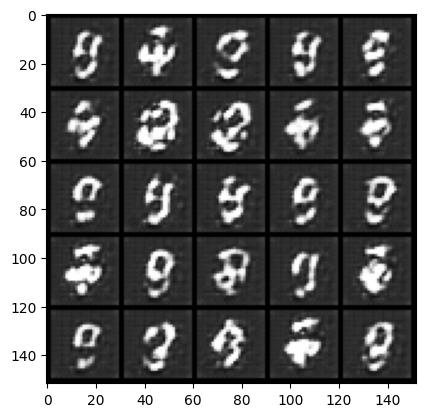

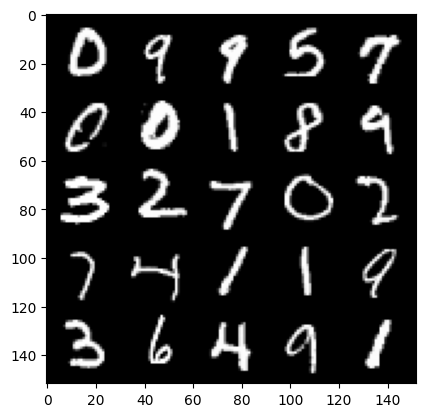

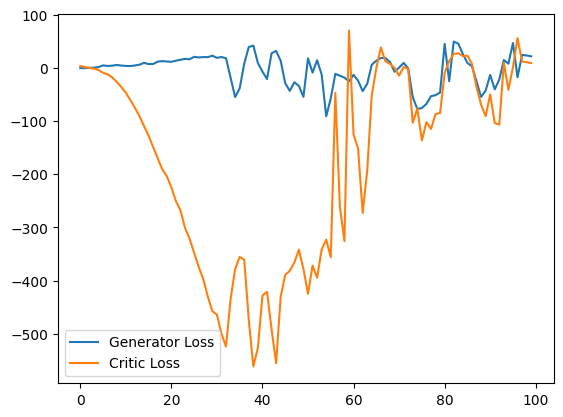

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5627930164337158
real: -11.67113971710205, fake: -21.888538360595703, regularization: 15.6279296875
crit_loss: torch.Size([]) 5.410531044006348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.6299328804016113
real: -11.89108657836914, fake: -21.812877655029297, regularization: 36.2993278503418
crit_loss: torch.Size([]) 26.37753677368164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.110839366912842
real: -11.181626319885254, fake: -21.18283462524414, regularization: 21.108394622802734
crit_loss: torch.Size([]) 11.107186317443848
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3131089210510254
real: -10.709939002990723, fake: -20.609312057495117, regularization: 23.131088256835938
crit_loss: torch.Size([]) 13.231715202331543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6859819889068604
real: -10.793177604675293, fake: -20.793785095214844, regularization: 16.859819412231445
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.347336530685425
real: -12.395840644836426, fake: -20.338314056396484, regularization: 23.473365783691406
crit_loss: torch.Size([]) 15.530892372131348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.909594178199768
real: -12.145633697509766, fake: -20.45846176147461, regularization: 19.0959415435791
crit_loss: torch.Size([]) 10.783113479614258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2226988077163696
real: -13.303154945373535, fake: -19.808622360229492, regularization: 12.226987838745117
crit_loss: torch.Size([]) 5.72152042388916
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.586721658706665
real: -13.556443214416504, fake: -20.470355987548828, regularization: 15.867216110229492
crit_loss: torch.Size([]) 8.953303337097168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.183171272277832
real: -13.798200607299805, fake: -20.902538299560547, regularization: 21.83171272277832
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1608718633651733
real: -10.892727851867676, fake: -19.778919219970703, regularization: 11.608718872070312
crit_loss: torch.Size([]) 2.722527503967285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8603132963180542
real: -10.923385620117188, fake: -19.86549949645996, regularization: 18.603132247924805
crit_loss: torch.Size([]) 9.661018371582031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5749787092208862
real: -11.03294563293457, fake: -20.018144607543945, regularization: 15.749787330627441
crit_loss: torch.Size([]) 6.764588356018066
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7323057651519775
real: -10.905384063720703, fake: -19.656978607177734, regularization: 17.323057174682617
crit_loss: torch.Size([]) 8.571462631225586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.01310658454895
real: -11.13266372680664, fake: -19.76961898803711, regularization: 20.131065368652344
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7252135276794434
real: -10.347442626953125, fake: -19.212100982666016, regularization: 17.25213623046875
crit_loss: torch.Size([]) 8.38747787475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7300128936767578
real: -9.655645370483398, fake: -19.70907974243164, regularization: 17.300128936767578
crit_loss: torch.Size([]) 7.246694564819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9865498542785645
real: -9.677568435668945, fake: -19.80853843688965, regularization: 19.865497589111328
crit_loss: torch.Size([]) 9.734527587890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4688000679016113
real: -9.741399765014648, fake: -20.059078216552734, regularization: 14.688000679016113
crit_loss: torch.Size([]) 4.370322227478027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4499623775482178
real: -9.698258399963379, fake: -19.22625732421875, regularization: 14.499624252319336
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5693010091781616
real: -8.65235710144043, fake: -18.538528442382812, regularization: 15.693010330200195
crit_loss: torch.Size([]) 5.8068389892578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3785266876220703
real: -8.435835838317871, fake: -18.212844848632812, regularization: 13.785266876220703
crit_loss: torch.Size([]) 4.008257865905762
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4884016513824463
real: -8.319326400756836, fake: -18.202770233154297, regularization: 14.884016036987305
crit_loss: torch.Size([]) 5.000572204589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5015357732772827
real: -8.90768814086914, fake: -18.26544189453125, regularization: 15.015357971191406
crit_loss: torch.Size([]) 5.657604217529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3166521787643433
real: -8.882417678833008, fake: -18.52618980407715, regularization: 13.166522026062012
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7586195468902588
real: -8.884429931640625, fake: -17.937602996826172, regularization: 17.58619499206543
crit_loss: torch.Size([]) 8.533021926879883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7459514141082764
real: -8.923913955688477, fake: -17.896364212036133, regularization: 17.459514617919922
crit_loss: torch.Size([]) 8.487064361572266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9825575351715088
real: -8.927462577819824, fake: -17.959392547607422, regularization: 19.82557487487793
crit_loss: torch.Size([]) 10.793644905090332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.68709659576416
real: -9.125123023986816, fake: -18.395164489746094, regularization: 26.8709659576416
crit_loss: torch.Size([]) 17.60092544555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6045842170715332
real: -9.203057289123535, fake: -18.467018127441406, regularization: 16.045841217041016
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.428335189819336
real: -8.097026824951172, fake: -17.770936965942383, regularization: 14.28335189819336
crit_loss: torch.Size([]) 4.609441757202148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8924418687820435
real: -7.957919120788574, fake: -17.652236938476562, regularization: 18.924419403076172
crit_loss: torch.Size([]) 9.230101585388184
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7185039520263672
real: -7.993396759033203, fake: -17.630428314208984, regularization: 17.185039520263672
crit_loss: torch.Size([]) 7.548007965087891
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.780442714691162
real: -8.171629905700684, fake: -17.88050079345703, regularization: 17.804428100585938
crit_loss: torch.Size([]) 8.09555721282959
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1828241348266602
real: -8.225810050964355, fake: -17.827381134033203, regularization: 11.828241348266602
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.484334111213684
real: -6.595293998718262, fake: -16.855243682861328, regularization: 14.843340873718262
crit_loss: torch.Size([]) 4.583391189575195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7285232543945312
real: -6.725456237792969, fake: -17.15919303894043, regularization: 17.285232543945312
crit_loss: torch.Size([]) 6.851495742797852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.516517162322998
real: -6.707226276397705, fake: -17.552324295043945, regularization: 15.16517162322998
crit_loss: torch.Size([]) 4.320073127746582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7806657552719116
real: -6.630411624908447, fake: -17.680694580078125, regularization: 17.806657791137695
crit_loss: torch.Size([]) 6.756374359130859
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1114685535430908
real: -7.398677349090576, fake: -17.308902740478516, regularization: 11.11468505859375
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4290268421173096
real: -8.561461448669434, fake: -17.770305633544922, regularization: 14.290267944335938
crit_loss: torch.Size([]) 5.081423759460449
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6829969882965088
real: -6.77486515045166, fake: -16.90951156616211, regularization: 16.82996940612793
crit_loss: torch.Size([]) 6.6953229904174805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9579033851623535
real: -6.708124160766602, fake: -17.00177001953125, regularization: 19.57903289794922
crit_loss: torch.Size([]) 9.28538703918457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6205220222473145
real: -7.020291328430176, fake: -17.541961669921875, regularization: 16.205219268798828
crit_loss: torch.Size([]) 5.683548927307129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.214390754699707
real: -7.179661750793457, fake: -17.766284942626953, regularization: 22.14390754699707
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7248739004135132
real: -5.205633163452148, fake: -17.15219497680664, regularization: 17.24873924255371
crit_loss: torch.Size([]) 5.302177429199219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.425525188446045
real: -5.465731620788574, fake: -17.34079360961914, regularization: 24.255252838134766
crit_loss: torch.Size([]) 12.3801908493042
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4983630180358887
real: -5.331914901733398, fake: -17.14978790283203, regularization: 14.983630180358887
crit_loss: torch.Size([]) 3.165757179260254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8607147932052612
real: -6.639716148376465, fake: -16.8944091796875, regularization: 18.607147216796875
crit_loss: torch.Size([]) 8.35245418548584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5368173122406006
real: -6.661642074584961, fake: -17.121366500854492, regularization: 15.368173599243164
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.006160259246826
real: -5.404651641845703, fake: -16.883331298828125, regularization: 20.061603546142578
crit_loss: torch.Size([]) 8.582923889160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.368161916732788
real: -5.636893272399902, fake: -17.32596206665039, regularization: 13.681619644165039
crit_loss: torch.Size([]) 1.9925508499145508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8277052640914917
real: -5.451256275177002, fake: -17.09532928466797, regularization: 18.27705192565918
crit_loss: torch.Size([]) 6.632978439331055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7461159229278564
real: -5.063876152038574, fake: -16.189594268798828, regularization: 17.461158752441406
crit_loss: torch.Size([]) 6.335440635681152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1485753059387207
real: -4.832056999206543, fake: -16.009811401367188, regularization: 21.48575210571289
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3747375011444092
real: -5.034296989440918, fake: -16.474138259887695, regularization: 13.74737548828125
crit_loss: torch.Size([]) 2.3075342178344727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.100344181060791
real: -4.794045925140381, fake: -16.182815551757812, regularization: 21.003440856933594
crit_loss: torch.Size([]) 9.61467170715332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8767595291137695
real: -5.229869842529297, fake: -16.638851165771484, regularization: 18.767595291137695
crit_loss: torch.Size([]) 7.358613967895508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5497076511383057
real: -5.404405117034912, fake: -16.750600814819336, regularization: 25.4970760345459
crit_loss: torch.Size([]) 14.150880813598633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4914937019348145
real: -5.804872035980225, fake: -17.53598976135254, regularization: 14.914937019348145
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9772402048110962
real: -6.349583148956299, fake: -17.086124420166016, regularization: 19.772401809692383
crit_loss: torch.Size([]) 9.035860061645508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.818058967590332
real: -6.51837158203125, fake: -17.33301544189453, regularization: 18.18058967590332
crit_loss: torch.Size([]) 7.365945816040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.571920394897461
real: -6.43922233581543, fake: -17.605552673339844, regularization: 15.71920394897461
crit_loss: torch.Size([]) 4.552873611450195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.354794502258301
real: -6.449944496154785, fake: -17.422462463378906, regularization: 23.547945022583008
crit_loss: torch.Size([]) 12.575427055358887
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3538482189178467
real: -6.557504653930664, fake: -17.06741714477539, regularization: 13.538482666015625
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.405897378921509
real: -6.882490158081055, fake: -18.0316162109375, regularization: 24.05897331237793
crit_loss: torch.Size([]) 12.909847259521484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.224897861480713
real: -7.080261707305908, fake: -17.699024200439453, regularization: 22.248977661132812
crit_loss: torch.Size([]) 11.63021469116211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.686267614364624
real: -6.970624923706055, fake: -17.663766860961914, regularization: 16.8626766204834
crit_loss: torch.Size([]) 6.169534683227539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1604514122009277
real: -7.009139060974121, fake: -18.072586059570312, regularization: 21.604515075683594
crit_loss: torch.Size([]) 10.541068077087402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4412908554077148
real: -6.983763694763184, fake: -17.95270538330078, regularization: 14.412908554077148
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4166669845581055
real: -6.601634979248047, fake: -18.240497589111328, regularization: 14.166669845581055
crit_loss: torch.Size([]) 2.5278072357177734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.468674659729004
real: -6.43988037109375, fake: -18.589696884155273, regularization: 14.686746597290039
crit_loss: torch.Size([]) 2.5369300842285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7903954982757568
real: -6.681166648864746, fake: -18.842201232910156, regularization: 17.903955459594727
crit_loss: torch.Size([]) 5.742920875549316
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.758744239807129
real: -5.965733528137207, fake: -18.46192169189453, regularization: 17.58744239807129
crit_loss: torch.Size([]) 5.091254234313965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.855065107345581
real: -5.737777233123779, fake: -18.478073120117188, regularization: 18.55065155029297
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2536334991455078
real: -4.572350978851318, fake: -17.296138763427734, regularization: 12.536334991455078
crit_loss: torch.Size([]) -0.1874523162841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7703564167022705
real: -4.246638298034668, fake: -16.870101928710938, regularization: 17.703563690185547
crit_loss: torch.Size([]) 5.080100059509277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0527775287628174
real: -3.9574105739593506, fake: -17.18421173095703, regularization: 20.527774810791016
crit_loss: torch.Size([]) 7.300973892211914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3150131702423096
real: -3.7356438636779785, fake: -17.07207489013672, regularization: 23.150131225585938
crit_loss: torch.Size([]) 9.813699722290039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3733859062194824
real: -3.566847324371338, fake: -16.823657989501953, regularization: 23.73386001586914
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.10048770904541
real: -5.907663345336914, fake: -18.68315315246582, regularization: 21.0048770904541
crit_loss: torch.Size([]) 8.229387283325195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6833345890045166
real: -6.0732421875, fake: -18.104711532592773, regularization: 16.833345413208008
crit_loss: torch.Size([]) 4.801876068115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4177277088165283
real: -4.210570335388184, fake: -17.687070846557617, regularization: 14.177276611328125
crit_loss: torch.Size([]) 0.7007761001586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5170801877975464
real: -3.875690221786499, fake: -17.525724411010742, regularization: 15.170802116394043
crit_loss: torch.Size([]) 1.520768165588379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6413239240646362
real: -3.7400219440460205, fake: -17.452064514160156, regularization: 16.413238525390625
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5982351303100586
real: -4.907426834106445, fake: -18.324974060058594, regularization: 15.982351303100586
crit_loss: torch.Size([]) 2.5648040771484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5402545928955078
real: -4.710486888885498, fake: -18.035022735595703, regularization: 15.402545928955078
crit_loss: torch.Size([]) 2.0780105590820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3197453022003174
real: -4.382780075073242, fake: -17.2447509765625, regularization: 23.197452545166016
crit_loss: torch.Size([]) 10.335481643676758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6471567153930664
real: -4.1513214111328125, fake: -17.478532791137695, regularization: 16.471567153930664
crit_loss: torch.Size([]) 3.1443557739257812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8248755931854248
real: -5.183645248413086, fake: -17.081680297851562, regularization: 18.248756408691406
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5761196613311768
real: -5.2452712059021, fake: -17.074779510498047, regularization: 15.76119613647461
crit_loss: torch.Size([]) 3.9316883087158203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.931627035140991
real: -4.035815238952637, fake: -17.32618522644043, regularization: 29.31627082824707
crit_loss: torch.Size([]) 16.025901794433594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.357203722000122
real: -4.012729644775391, fake: -16.905193328857422, regularization: 13.572036743164062
crit_loss: torch.Size([]) 0.6795730590820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0683305263519287
real: -4.042256832122803, fake: -16.777523040771484, regularization: 20.683305740356445
crit_loss: torch.Size([]) 7.948040008544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.885388731956482
real: -4.356149673461914, fake: -17.751237869262695, regularization: 18.8538875579834
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.309400796890259
real: -5.649674415588379, fake: -17.71841049194336, regularization: 23.09400749206543
crit_loss: torch.Size([]) 11.02527141571045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.639984130859375
real: -6.046121597290039, fake: -18.021705627441406, regularization: 16.39984130859375
crit_loss: torch.Size([]) 4.424257278442383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5992405414581299
real: -6.233140468597412, fake: -18.538955688476562, regularization: 15.99240493774414
crit_loss: torch.Size([]) 3.6865901947021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.60296368598938
real: -4.937395095825195, fake: -17.910417556762695, regularization: 26.02963638305664
crit_loss: torch.Size([]) 13.05661392211914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.773884892463684
real: -4.669699192047119, fake: -16.99346923828125, regularization: 17.738849639892578
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5003490447998047
real: -7.028636932373047, fake: -16.936471939086914, regularization: 15.003490447998047
crit_loss: torch.Size([]) 5.09565544128418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5134556293487549
real: -6.997220039367676, fake: -16.884092330932617, regularization: 15.13455581665039
crit_loss: torch.Size([]) 5.247683525085449
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.891165018081665
real: -6.7774248123168945, fake: -16.754528045654297, regularization: 18.911649703979492
crit_loss: torch.Size([]) 8.93454647064209
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.462132215499878
real: -6.652752876281738, fake: -16.777183532714844, regularization: 14.621322631835938
crit_loss: torch.Size([]) 4.496891975402832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7642216682434082
real: -6.621494293212891, fake: -16.758485794067383, regularization: 17.642215728759766
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4493566751480103
real: -5.221696853637695, fake: -16.758235931396484, regularization: 14.493566513061523
crit_loss: torch.Size([]) 2.9570274353027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6396124362945557
real: -5.106263637542725, fake: -16.287647247314453, regularization: 16.3961238861084
crit_loss: torch.Size([]) 5.214740753173828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.241939067840576
real: -4.329113960266113, fake: -15.983526229858398, regularization: 22.419391632080078
crit_loss: torch.Size([]) 10.764979362487793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.961279273033142
real: -4.217657089233398, fake: -15.572101593017578, regularization: 19.61279296875
crit_loss: torch.Size([]) 8.25834846496582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.832653522491455
real: -3.983086109161377, fake: -15.251981735229492, regularization: 18.326534271240234
crit_loss: t

penalty: torch.Size([]) 1.8390014171600342
real: -5.836433410644531, fake: -14.990114212036133, regularization: 18.3900146484375
crit_loss: torch.Size([]) 9.236333847045898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9848133325576782
real: -6.0094451904296875, fake: -14.746338844299316, regularization: 19.848133087158203
crit_loss: torch.Size([]) 11.111239433288574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7810485363006592
real: -6.534111976623535, fake: -15.604085922241211, regularization: 17.81048583984375
crit_loss: torch.Size([]) 8.740511894226074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5913572311401367
real: -7.099393844604492, fake: -17.348581314086914, regularization: 15.913572311401367
crit_loss: torch.Size([]) 5.664384841918945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.44708251953125
real: -7.092831134796143, fake: -16.374385833740234, regularization: 24.4708251953125
crit_loss: torch.Size([]) 15.1892700195312

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8438332080841064
real: -6.316718578338623, fake: -15.245074272155762, regularization: 18.438331604003906
crit_loss: torch.Size([]) 9.50997543334961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4564757347106934
real: -6.5957536697387695, fake: -15.455761909484863, regularization: 24.56475830078125
crit_loss: torch.Size([]) 15.704750061035156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.470294237136841
real: -6.086761474609375, fake: -14.377862930297852, regularization: 24.70294189453125
crit_loss: torch.Size([]) 16.411840438842773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0969414710998535
real: -6.045633792877197, fake: -14.939217567443848, regularization: 20.96941375732422
crit_loss: torch.Size([]) 12.075830459594727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6548731327056885
real: -6.0171356201171875, fake: -14.328968048095703, regularization: 16.548730850219727
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5511879920959473
real: -5.050200462341309, fake: -13.983592987060547, regularization: 25.511878967285156
crit_loss: torch.Size([]) 16.578487396240234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8827037811279297
real: -4.657033920288086, fake: -13.60547161102295, regularization: 18.827037811279297
crit_loss: torch.Size([]) 9.878600120544434
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3626868724823
real: -4.3792877197265625, fake: -13.01924991607666, regularization: 23.626869201660156
crit_loss: torch.Size([]) 14.986907005310059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.694772720336914
real: -4.4902663230896, fake: -13.50273609161377, regularization: 16.94772720336914
crit_loss: torch.Size([]) 7.9352569580078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8785154819488525
real: -4.362428665161133, fake: -12.696146011352539, regularization: 18.785154342651367
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3609538078308105
real: -4.185864448547363, fake: -12.173730850219727, regularization: 23.609539031982422
crit_loss: torch.Size([]) 15.621672630310059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0084218978881836
real: -4.337732315063477, fake: -12.766963958740234, regularization: 20.084218978881836
crit_loss: torch.Size([]) 11.654987335205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.559688687324524
real: -4.0474934577941895, fake: -12.407947540283203, regularization: 15.59688663482666
crit_loss: torch.Size([]) 7.236432075500488
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9433503150939941
real: -3.671382427215576, fake: -12.265644073486328, regularization: 19.433502197265625
crit_loss: torch.Size([]) 10.839241027832031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.301945686340332
real: -3.6059858798980713, fake: -11.862302780151367, regularization: 23.01945686340332
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.208052635192871
real: -4.029358863830566, fake: -11.88952350616455, regularization: 12.080526351928711
crit_loss: torch.Size([]) 4.220361709594727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0515224933624268
real: -3.9180943965911865, fake: -12.273649215698242, regularization: 20.51522445678711
crit_loss: torch.Size([]) 12.159669876098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6173161268234253
real: -3.6143670082092285, fake: -11.728568077087402, regularization: 16.173160552978516
crit_loss: torch.Size([]) 8.0589599609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0179443359375
real: -3.551393508911133, fake: -11.75152587890625, regularization: 20.179443359375
crit_loss: torch.Size([]) 11.979310989379883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4571666717529297
real: -3.355250835418701, fake: -12.041000366210938, regularization: 14.571666717529297
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5574501752853394
real: -2.098039388656616, fake: -10.818258285522461, regularization: 15.574501991271973
crit_loss: torch.Size([]) 6.854283332824707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.32688570022583
real: -2.2701849937438965, fake: -11.194013595581055, regularization: 23.268856048583984
crit_loss: torch.Size([]) 14.345027923583984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5633699893951416
real: -2.164557456970215, fake: -10.958454132080078, regularization: 15.633699417114258
crit_loss: torch.Size([]) 6.8398027420043945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7295266389846802
real: -1.8561071157455444, fake: -10.640832901000977, regularization: 17.29526710510254
crit_loss: torch.Size([]) 8.510540962219238
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2359862327575684
real: -2.3665480613708496, fake: -11.087088584899902, regularization: 22.35986328125
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5978584289550781
real: -4.288295745849609, fake: -11.548434257507324, regularization: 15.978584289550781
crit_loss: torch.Size([]) 8.718445777893066
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.026695728302002
real: -4.426772117614746, fake: -11.18106460571289, regularization: 20.266956329345703
crit_loss: torch.Size([]) 13.512663841247559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.922486662864685
real: -4.694211959838867, fake: -11.661410331726074, regularization: 19.22486686706543
crit_loss: torch.Size([]) 12.257668495178223
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9230108261108398
real: -4.369240760803223, fake: -11.547117233276367, regularization: 19.2301082611084
crit_loss: torch.Size([]) 12.052231788635254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7646665573120117
real: -3.7036147117614746, fake: -10.519851684570312, regularization: 17.646665573120117
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7785639762878418
real: -3.436460018157959, fake: -11.249551773071289, regularization: 17.785640716552734
crit_loss: torch.Size([]) 9.972549438476562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8583346605300903
real: -3.3076882362365723, fake: -10.96903133392334, regularization: 18.58334732055664
crit_loss: torch.Size([]) 10.922004699707031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6068202257156372
real: -3.236952304840088, fake: -10.815328598022461, regularization: 16.06820297241211
crit_loss: torch.Size([]) 8.489826202392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7664806842803955
real: -3.437525749206543, fake: -11.052821159362793, regularization: 17.664806365966797
crit_loss: torch.Size([]) 10.049510955810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8534362316131592
real: -4.275407791137695, fake: -12.088089942932129, regularization: 18.53436279296875
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7632962465286255
real: -4.655918121337891, fake: -12.406163215637207, regularization: 17.632963180541992
crit_loss: torch.Size([]) 9.882718086242676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.698359489440918
real: -4.242038726806641, fake: -12.031558990478516, regularization: 16.98359489440918
crit_loss: torch.Size([]) 9.194074630737305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3196766376495361
real: -3.6169681549072266, fake: -11.1382417678833, regularization: 13.196765899658203
crit_loss: torch.Size([]) 5.675492286682129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5696320533752441
real: -3.496206283569336, fake: -11.180122375488281, regularization: 15.696320533752441
crit_loss: torch.Size([]) 8.012404441833496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.359969139099121
real: -3.714077949523926, fake: -11.26572322845459, regularization: 13.599691390991211
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9471801519393921
real: -5.481343746185303, fake: -12.262825012207031, regularization: 9.4718017578125
crit_loss: torch.Size([]) 2.6903204917907715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3383883237838745
real: -5.516458511352539, fake: -12.967306137084961, regularization: 13.383883476257324
crit_loss: torch.Size([]) 5.933035850524902
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.62998366355896
real: -5.217497825622559, fake: -12.067341804504395, regularization: 16.299837112426758
crit_loss: torch.Size([]) 9.449993133544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.249427080154419
real: -5.04514217376709, fake: -11.697699546813965, regularization: 12.494270324707031
crit_loss: torch.Size([]) 5.841712951660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.691415548324585
real: -5.155884742736816, fake: -12.456384658813477, regularization: 16.914155960083008
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1507760286331177
real: -5.840693473815918, fake: -12.997326850891113, regularization: 11.507760047912598
crit_loss: torch.Size([]) 4.351126670837402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3003586530685425
real: -5.804429531097412, fake: -12.73730754852295, regularization: 13.003586769104004
crit_loss: torch.Size([]) 6.070708751678467
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5310440063476562
real: -5.897718906402588, fake: -13.525374412536621, regularization: 15.310440063476562
crit_loss: torch.Size([]) 7.682784557342529
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7211343050003052
real: -5.690253257751465, fake: -13.090983390808105, regularization: 17.21134376525879
crit_loss: torch.Size([]) 9.810613632202148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5529241561889648
real: -4.927353382110596, fake: -12.903703689575195, regularization: 15.529241561889648
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9051793217658997
real: -4.285346984863281, fake: -13.181953430175781, regularization: 9.051793098449707
crit_loss: torch.Size([]) 0.15518665313720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9333688020706177
real: -5.485163688659668, fake: -13.520821571350098, regularization: 9.333687782287598
crit_loss: torch.Size([]) 1.298029899597168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9899251461029053
real: -5.557858467102051, fake: -13.458013534545898, regularization: 19.89925193786621
crit_loss: torch.Size([]) 11.999096870422363
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.393211007118225
real: -5.029186248779297, fake: -13.515625, regularization: 13.932109832763672
crit_loss: torch.Size([]) 5.445671081542969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2699263095855713
real: -4.213710784912109, fake: -12.01950454711914, regularization: 12.699262619018555
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4353092908859253
real: -4.7159576416015625, fake: -12.892746925354004, regularization: 14.353093147277832
crit_loss: torch.Size([]) 6.176303863525391
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2137126922607422
real: -5.541164875030518, fake: -14.101305961608887, regularization: 12.137126922607422
crit_loss: torch.Size([]) 3.576986312866211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.468461275100708
real: -5.2363386154174805, fake: -13.85861873626709, regularization: 14.684612274169922
crit_loss: torch.Size([]) 6.0623321533203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2861852645874023
real: -3.072568416595459, fake: -12.84671401977539, regularization: 12.861852645874023
crit_loss: torch.Size([]) 3.08770751953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.695330023765564
real: -2.7878870964050293, fake: -12.05280590057373, regularization: 16.95330047607422
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1754971742630005
real: -2.9168338775634766, fake: -12.18535327911377, regularization: 11.754971504211426
crit_loss: torch.Size([]) 2.486452102661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4882030487060547
real: -3.6427226066589355, fake: -13.35633659362793, regularization: 14.882030487060547
crit_loss: torch.Size([]) 5.168416976928711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1604359149932861
real: -3.8353097438812256, fake: -13.161116600036621, regularization: 11.604358673095703
crit_loss: torch.Size([]) 2.2785520553588867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0560534000396729
real: -3.4914636611938477, fake: -12.912752151489258, regularization: 10.56053352355957
crit_loss: torch.Size([]) 1.1392450332641602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2682578563690186
real: -3.002336025238037, fake: -12.553382873535156, regularization: 12.682579040527344
c

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3390402793884277
real: -2.877326011657715, fake: -12.532937049865723, regularization: 13.390402793884277
crit_loss: torch.Size([]) 3.7347917556762695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1905019283294678
real: -2.7381224632263184, fake: -12.105257034301758, regularization: 11.905019760131836
crit_loss: torch.Size([]) 2.5378856658935547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.919955849647522
real: -2.9906158447265625, fake: -12.877124786376953, regularization: 9.19955825805664
crit_loss: torch.Size([]) -0.68695068359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3959779739379883
real: -2.8284075260162354, fake: -12.49984359741211, regularization: 13.959779739379883
crit_loss: torch.Size([]) 4.28834342956543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3787376880645752
real: -3.2537124156951904, fake: -13.10927963256836, regularization: 13.787376403808594
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1862157583236694
real: -3.0171420574188232, fake: -12.683334350585938, regularization: 11.862157821655273
crit_loss: torch.Size([]) 2.1959657669067383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0597004890441895
real: -3.1821534633636475, fake: -13.181303977966309, regularization: 10.597004890441895
crit_loss: torch.Size([]) 0.5978546142578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3037564754486084
real: -3.075075626373291, fake: -13.516342163085938, regularization: 13.037565231323242
crit_loss: torch.Size([]) 2.5962982177734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3561522960662842
real: -2.058407783508301, fake: -12.710599899291992, regularization: 13.5615234375
crit_loss: torch.Size([]) 2.9093313217163086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5611014366149902
real: -2.1099863052368164, fake: -12.679652214050293, regularization: 15.611014366149902
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.673997402191162
real: -3.090773105621338, fake: -12.827279090881348, regularization: 16.739974975585938
crit_loss: torch.Size([]) 7.003469467163086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3127137422561646
real: -3.980353355407715, fake: -13.495426177978516, regularization: 13.127137184143066
crit_loss: torch.Size([]) 3.6120643615722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6573458909988403
real: -2.7352001667022705, fake: -12.548319816589355, regularization: 16.57345962524414
crit_loss: torch.Size([]) 6.760339736938477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9522352814674377
real: -2.3010592460632324, fake: -12.454937934875488, regularization: 9.522353172302246
crit_loss: torch.Size([]) -0.631525993347168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1594191789627075
real: -2.338102340698242, fake: -11.858489990234375, regularization: 11.594191551208496
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4405906200408936
real: -1.9504982233047485, fake: -13.415764808654785, regularization: 14.405906677246094
crit_loss: torch.Size([]) 2.940640449523926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5938191413879395
real: -0.20199960470199585, fake: -12.806585311889648, regularization: 15.938191413879395
crit_loss: torch.Size([]) 3.3336057662963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5745823383331299
real: -0.14417174458503723, fake: -12.455425262451172, regularization: 15.74582290649414
crit_loss: torch.Size([]) 3.4345693588256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4751355648040771
real: -0.20273171365261078, fake: -13.070703506469727, regularization: 14.75135612487793
crit_loss: torch.Size([]) 1.8833847045898438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0865362882614136
real: -0.36505717039108276, fake: -12.99172306060791, regularization: 10.86536312103

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9075191020965576
real: -1.3511755466461182, fake: -13.022144317626953, regularization: 9.075191497802734
crit_loss: torch.Size([]) -2.5957775115966797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1190292835235596
real: -1.6235452890396118, fake: -13.013161659240723, regularization: 11.190292358398438
crit_loss: torch.Size([]) -0.1993236541748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1996463537216187
real: -1.8830534219741821, fake: -14.113595008850098, regularization: 11.996463775634766
crit_loss: torch.Size([]) -0.23407745361328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6580960750579834
real: 0.6283073425292969, fake: -12.456840515136719, regularization: 16.580961227416992
crit_loss: torch.Size([]) 3.4958133697509766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3968403339385986
real: 1.1149057149887085, fake: -11.35406494140625, regularization: 13.96840286254

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8027775287628174
real: 3.819061040878296, fake: -11.81906509399414, regularization: 18.027774810791016
crit_loss: torch.Size([]) 2.3896484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7032132148742676
real: 5.1481828689575195, fake: -11.022167205810547, regularization: 27.03213119506836
crit_loss: torch.Size([]) 10.86178207397461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7957401275634766
real: 3.0819854736328125, fake: -12.541410446166992, regularization: 27.957401275634766
crit_loss: torch.Size([]) 12.334005355834961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6346166133880615
real: 3.885362148284912, fake: -12.7568359375, regularization: 16.346166610717773
crit_loss: torch.Size([]) -0.2960319519042969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7911629676818848
real: 6.099425315856934, fake: -9.997533798217773, regularization: 17.91162872314453
crit_loss: torch.S

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8477333784103394
real: 6.894146919250488, fake: -10.008556365966797, regularization: 18.477333068847656
crit_loss: torch.Size([]) 1.5746307373046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7704222202301025
real: 5.709560394287109, fake: -11.742877960205078, regularization: 17.704221725463867
crit_loss: torch.Size([]) 0.2517833709716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.446504831314087
real: 2.2578840255737305, fake: -10.697935104370117, regularization: 14.465047836303711
crit_loss: torch.Size([]) 1.5092287063598633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5444388389587402
real: 3.12099289894104, fake: -10.64702033996582, regularization: 15.444388389587402
crit_loss: torch.Size([]) 1.676375389099121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8077901601791382
real: 3.2111496925354004, fake: -11.303281784057617, regularization: 18.07790184020996
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8178142309188843
real: 6.899541854858398, fake: -9.335173606872559, regularization: 18.178142547607422
crit_loss: torch.Size([]) 1.9434280395507812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8390777111053467
real: 7.972843647003174, fake: -8.738909721374512, regularization: 18.390777587890625
crit_loss: torch.Size([]) 1.6790237426757812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1658997535705566
real: 5.503389835357666, fake: -11.963203430175781, regularization: 11.658997535705566
crit_loss: torch.Size([]) -5.807595252990723
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.838530421257019
real: 5.178372383117676, fake: -12.402207374572754, regularization: 18.385303497314453
crit_loss: torch.Size([]) 0.8047237396240234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4426798820495605
real: 6.283608913421631, fake: -10.810384750366211, regularization: 14.426798820495605
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9664260149002075
real: 9.189798355102539, fake: -7.402945518493652, regularization: 19.664260864257812
crit_loss: torch.Size([]) 3.0715179443359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.08996844291687
real: 6.899188995361328, fake: -9.829466819763184, regularization: 20.89968490600586
crit_loss: torch.Size([]) 4.171028137207031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8018944263458252
real: 7.188864707946777, fake: -9.156647682189941, regularization: 18.018943786621094
crit_loss: torch.Size([]) 1.673431396484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2413833141326904
real: 6.34043025970459, fake: -11.00994873046875, regularization: 22.413833618164062
crit_loss: torch.Size([]) 5.063453674316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8432810306549072
real: 8.098594665527344, fake: -9.222684860229492, regularization: 18.432809829711914
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5265064239501953
real: 10.39815616607666, fake: -8.903348922729492, regularization: 25.265064239501953
crit_loss: torch.Size([]) 5.963558197021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7975815534591675
real: 11.480822563171387, fake: -9.195945739746094, regularization: 17.975814819335938
crit_loss: torch.Size([]) -2.7009544372558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6560091972351074
real: 10.930461883544922, fake: -9.159311294555664, regularization: 16.56009292602539
crit_loss: torch.Size([]) -3.5296802520751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9619266986846924
real: 8.835151672363281, fake: -9.76294231414795, regularization: 19.619266510009766
crit_loss: torch.Size([]) 1.0211715698242188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7820682525634766
real: 9.782707214355469, fake: -9.946353912353516, regularization: 17.820682525634766
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3839101791381836
real: 10.221264839172363, fake: -6.9072370529174805, regularization: 23.839101791381836
crit_loss: torch.Size([]) 6.710599899291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.238633155822754
real: 10.22374153137207, fake: -7.684875965118408, regularization: 22.38633155822754
crit_loss: torch.Size([]) 4.477714538574219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8847191333770752
real: 7.265216827392578, fake: -11.540494918823242, regularization: 18.847190856933594
crit_loss: torch.Size([]) 0.04147911071777344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6728835105895996
real: 9.307644844055176, fake: -9.98250961303711, regularization: 16.728836059570312
crit_loss: torch.Size([]) -2.5613174438476562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4666218757629395
real: 9.449317932128906, fake: -9.938909530639648, regularization: 24.666217803955078
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4355099201202393
real: 12.642572402954102, fake: -6.343888282775879, regularization: 14.355098724365234
crit_loss: torch.Size([]) -4.6313629150390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7521312236785889
real: 12.610738754272461, fake: -8.392094612121582, regularization: 17.521312713623047
crit_loss: torch.Size([]) -3.4815216064453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9869141578674316
real: 10.625378608703613, fake: -9.104011535644531, regularization: 29.869140625
crit_loss: torch.Size([]) 10.139751434326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.296597719192505
real: 11.657939910888672, fake: -8.194474220275879, regularization: 22.96597671508789
crit_loss: torch.Size([]) 3.1135635375976562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.175184965133667
real: 12.581624031066895, fake: -7.438660621643066, regularization: 21.751850128173828
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7488551139831543
real: 14.695459365844727, fake: -7.234187126159668, regularization: 27.48855209350586
crit_loss: torch.Size([]) 5.558906555175781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9653284549713135
real: 10.24106216430664, fake: -11.663762092590332, regularization: 29.653284072875977
crit_loss: torch.Size([]) 7.74846076965332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.639420986175537
real: 18.099483489990234, fake: -3.68888521194458, regularization: 26.394210815429688
crit_loss: torch.Size([]) 4.605842590332031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0724635124206543
real: 15.339788436889648, fake: -7.276060104370117, regularization: 30.72463607788086
crit_loss: torch.Size([]) 8.108787536621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2125630378723145
real: 14.667726516723633, fake: -8.566715240478516, regularization: 22.125629425048828
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1043338775634766
real: 16.078636169433594, fake: -8.293014526367188, regularization: 21.043338775634766
crit_loss: torch.Size([]) -3.3283119201660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2559633255004883
real: 11.395837783813477, fake: -11.902952194213867, regularization: 22.559633255004883
crit_loss: torch.Size([]) -0.7391567230224609
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.227989673614502
real: 19.73456382751465, fake: -3.3571743965148926, regularization: 22.279895782470703
crit_loss: torch.Size([]) -0.8118419647216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.752260208129883
real: 15.889667510986328, fake: -8.3251953125, regularization: 27.522602081298828
crit_loss: torch.Size([]) 3.3077392578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0050899982452393
real: 11.65101432800293, fake: -12.302499771118164, regularization: 20.050899505615234
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8245160579681396
real: 18.093475341796875, fake: -6.6402506828308105, regularization: 18.245161056518555
crit_loss: torch.Size([]) -6.488565444946289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.166567325592041
real: 18.07805061340332, fake: -6.178628921508789, regularization: 21.665672302246094
crit_loss: torch.Size([]) -2.5910072326660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.428861141204834
real: 18.36351776123047, fake: -6.900599956512451, regularization: 24.288612365722656
crit_loss: torch.Size([]) -0.9755058288574219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.495878219604492
real: 4.160209655761719, fake: -6.92172384262085, regularization: 24.958782196044922
crit_loss: torch.Size([]) 13.876848220825195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.583578586578369
real: 8.033918380737305, fake: -9.959903717041016, regularization: 25.835784912109375
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9051148891448975
real: 14.468050003051758, fake: -7.101705551147461, regularization: 19.051149368286133
crit_loss: torch.Size([]) -2.518606185913086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8534560203552246
real: 17.71739959716797, fake: -7.654186248779297, regularization: 28.534561157226562
crit_loss: torch.Size([]) 3.162975311279297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.993539333343506
real: 16.780479431152344, fake: -10.248096466064453, regularization: 29.935394287109375
crit_loss: torch.Size([]) 2.906818389892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6646790504455566
real: 18.525569915771484, fake: -8.649118423461914, regularization: 26.64678955078125
crit_loss: torch.Size([]) -0.5278987884521484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.539947509765625
real: 22.085969924926758, fake: -5.01384973526001, regularization: 25.39947509765625
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1521265506744385
real: 25.312034606933594, fake: -2.043551445007324, regularization: 21.521265029907227
crit_loss: torch.Size([]) -5.834321975708008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6104564666748047
real: 22.431245803833008, fake: -6.832787990570068, regularization: 26.104564666748047
crit_loss: torch.Size([]) -3.1594696044921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0215396881103516
real: 15.77958869934082, fake: -13.781137466430664, regularization: 30.215396881103516
crit_loss: torch.Size([]) 0.6546707153320312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.048487663269043
real: 28.631759643554688, fake: 2.555786609649658, regularization: 30.48487663269043
crit_loss: torch.Size([]) 4.408903121948242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3846869468688965
real: 20.046207427978516, fake: -8.738973617553711, regularization: 23.84687042236328
crit_loss

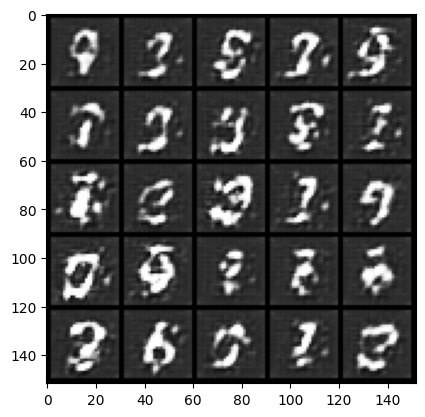

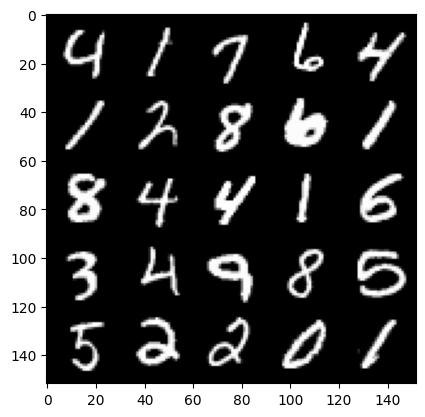

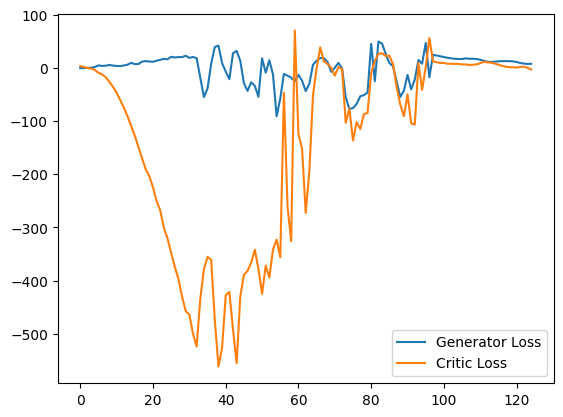

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.212819814682007
real: 17.49733543395996, fake: -5.674407958984375, regularization: 22.128198623657227
crit_loss: torch.Size([]) -1.0435447692871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.305030345916748
real: 27.272493362426758, fake: -1.6736950874328613, regularization: 23.050304412841797
crit_loss: torch.Size([]) -5.895883560180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5447943210601807
real: 18.39032745361328, fake: -10.409814834594727, regularization: 25.44794273376465
crit_loss: torch.Size([]) -3.3521995544433594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.21260929107666
real: 20.02220916748047, fake: -11.219646453857422, regularization: 22.1260929107666
crit_loss: torch.Size([]) -9.115762710571289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9423831701278687
real: 29.078842163085938, fake: -1.5049490928649902, regularization: 19.423831939697266
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.483376979827881
real: 16.2061767578125, fake: -15.942924499511719, regularization: 24.833770751953125
crit_loss: torch.Size([]) -7.315330505371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2798140048980713
real: 22.361730575561523, fake: -9.877824783325195, regularization: 22.798139572143555
crit_loss: torch.Size([]) -9.441415786743164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1944732666015625
real: 9.229092597961426, fake: -10.091341018676758, regularization: 21.944732666015625
crit_loss: torch.Size([]) 2.624298095703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8076220750808716
real: 21.285749435424805, fake: -7.452136516571045, regularization: 18.076221466064453
crit_loss: torch.Size([]) -10.661664962768555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.310468912124634
real: 21.419897079467773, fake: -10.253889083862305, regularization: 23.10468864440918
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5787765979766846
real: 28.419776916503906, fake: 1.6175780296325684, regularization: 25.787765502929688
crit_loss: torch.Size([]) -1.0144329071044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8225860595703125
real: 22.08985137939453, fake: -6.349332809448242, regularization: 18.225860595703125
crit_loss: torch.Size([]) -10.213323593139648
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.818216323852539
real: 15.93856430053711, fake: -12.630131721496582, regularization: 18.18216323852539
crit_loss: torch.Size([]) -10.386531829833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.16688871383667
real: 22.89930534362793, fake: -5.704746246337891, regularization: 21.668888092041016
crit_loss: torch.Size([]) -6.935163497924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.448326826095581
real: 24.765607833862305, fake: -3.2196598052978516, regularization: 24.48326873779297
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3146448135375977
real: 18.068523406982422, fake: -14.867148399353027, regularization: 23.146448135375977
crit_loss: torch.Size([]) -9.789224624633789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2643938064575195
real: 28.247573852539062, fake: -2.0530900955200195, regularization: 22.643938064575195
crit_loss: torch.Size([]) -7.65672492980957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9561634063720703
real: 27.61138153076172, fake: -6.072925567626953, regularization: 19.561634063720703
crit_loss: torch.Size([]) -14.122673034667969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8124256134033203
real: 23.469446182250977, fake: -10.467449188232422, regularization: 28.124256134033203
crit_loss: torch.Size([]) -5.812641143798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5217971801757812
real: 22.987262725830078, fake: -12.942495346069336, regularization: 25.217971801757812
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3643298149108887
real: 20.630733489990234, fake: -12.778396606445312, regularization: 23.643299102783203
crit_loss: torch.Size([]) -9.765830993652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8668022155761719
real: 24.721437454223633, fake: -9.548288345336914, regularization: 18.66802215576172
crit_loss: torch.Size([]) -15.601703643798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.750950813293457
real: 28.547264099121094, fake: -5.696566581726074, regularization: 27.50950813293457
crit_loss: torch.Size([]) -6.734323501586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1446731090545654
real: 18.063575744628906, fake: -7.275745391845703, regularization: 21.446731567382812
crit_loss: torch.Size([]) -3.892589569091797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7372093200683594
real: 28.644227981567383, fake: -0.3941141664981842, regularization: 27.372093200683594
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3402819633483887
real: 24.211957931518555, fake: -3.410086154937744, regularization: 23.402820587158203
crit_loss: torch.Size([]) -4.2192230224609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.374455451965332
real: 30.45967674255371, fake: -8.871301651000977, regularization: 23.74455451965332
crit_loss: torch.Size([]) -15.586423873901367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9494149684906006
real: 22.398334503173828, fake: -13.319295883178711, regularization: 19.494150161743164
crit_loss: torch.Size([]) -16.223478317260742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.603323459625244
real: 32.02158737182617, fake: -8.43052864074707, regularization: 26.033233642578125
crit_loss: torch.Size([]) -14.41888427734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.064286470413208
real: 33.224082946777344, fake: -8.13290786743164, regularization: 20.642864227294922
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.141740083694458
real: 22.226009368896484, fake: -9.442018508911133, regularization: 21.417400360107422
crit_loss: torch.Size([]) -10.250627517700195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9921960830688477
real: 21.174638748168945, fake: -10.994671821594238, regularization: 19.921960830688477
crit_loss: torch.Size([]) -12.247350692749023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2932310104370117
real: 14.194234848022461, fake: -12.485307693481445, regularization: 22.932310104370117
crit_loss: torch.Size([]) -3.747232437133789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4516963958740234
real: 21.285940170288086, fake: -15.763015747070312, regularization: 24.516963958740234
crit_loss: torch.Size([]) -12.531993865966797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1296119689941406
real: 24.294334411621094, fake: -12.504329681396484, regularization: 21.296119689941406

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1491904258728027
real: 25.963970184326172, fake: -3.188415765762329, regularization: 21.491905212402344
crit_loss: torch.Size([]) -7.660480499267578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7149174213409424
real: 23.42264747619629, fake: -11.219945907592773, regularization: 17.149173736572266
crit_loss: torch.Size([]) -17.493419647216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7246170043945312
real: 27.074609756469727, fake: -7.8633527755737305, regularization: 27.246170043945312
crit_loss: torch.Size([]) -7.691791534423828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.675248622894287
real: 29.651649475097656, fake: -4.232327461242676, regularization: 26.752487182617188
crit_loss: torch.Size([]) -7.131488800048828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.5028347969055176
real: 9.490549087524414, fake: -21.741785049438477, regularization: 35.02834701538086
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2583532333374023
real: 34.399715423583984, fake: 1.2954885959625244, regularization: 22.583532333374023
crit_loss: torch.Size([]) -10.520692825317383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2623915672302246
real: 26.543954849243164, fake: -6.861905097961426, regularization: 22.623916625976562
crit_loss: torch.Size([]) -10.781944274902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.493804454803467
real: 19.52155303955078, fake: -17.406810760498047, regularization: 24.938045501708984
crit_loss: torch.Size([]) -11.990318298339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7538859844207764
real: 37.80381774902344, fake: 2.105112314224243, regularization: 27.538860321044922
crit_loss: torch.Size([]) -8.159843444824219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0958847999572754
real: 29.70008087158203, fake: -7.260953903198242, regularization: 20.958847045898438
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2573609352111816
real: 27.95489501953125, fake: -8.509020805358887, regularization: 22.5736083984375
crit_loss: torch.Size([]) -13.890308380126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.14756441116333
real: 26.672544479370117, fake: -10.854934692382812, regularization: 21.475643157958984
crit_loss: torch.Size([]) -16.051837921142578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.594092845916748
real: 33.82921600341797, fake: -0.5334981083869934, regularization: 25.940929412841797
crit_loss: torch.Size([]) -8.421783447265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4030234813690186
real: 21.604997634887695, fake: -15.061517715454102, regularization: 24.030235290527344
crit_loss: torch.Size([]) -12.636280059814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.346247673034668
real: 36.600830078125, fake: -0.7092125415802002, regularization: 23.46247673034668
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8649070262908936
real: 1.4907886981964111, fake: -28.68608283996582, regularization: 28.649070739746094
crit_loss: torch.Size([]) -1.527801513671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2810423374176025
real: 21.676265716552734, fake: -11.983442306518555, regularization: 22.810422897338867
crit_loss: torch.Size([]) -10.849283218383789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6130189895629883
real: 27.70760726928711, fake: -5.527247905731201, regularization: 26.130189895629883
crit_loss: torch.Size([]) -7.104665756225586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.042445659637451
real: 19.652851104736328, fake: -14.325264930725098, regularization: 20.424457550048828
crit_loss: torch.Size([]) -13.553657531738281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1399896144866943
real: 28.161434173583984, fake: -8.229588508605957, regularization: 21.3998966217041
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.406999111175537
real: 21.760120391845703, fake: -18.102567672729492, regularization: 24.069992065429688
crit_loss: torch.Size([]) -15.792694091796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.889969825744629
real: 35.65263748168945, fake: -3.0929226875305176, regularization: 28.89969825744629
crit_loss: torch.Size([]) -9.845861434936523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.52952241897583
real: 2.6516575813293457, fake: -32.251007080078125, regularization: 35.295223236083984
crit_loss: torch.Size([]) 0.3925590515136719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.9385361671447754
real: 38.577430725097656, fake: 5.7839155197143555, regularization: 39.38536071777344
crit_loss: torch.Size([]) 6.591846466064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.253486156463623
real: 29.48729705810547, fake: -8.37809944152832, regularization: 22.534862518310547
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.991788864135742
real: 20.36371421813965, fake: -17.8227481842041, regularization: 29.917888641357422
crit_loss: torch.Size([]) -8.268573760986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.687702178955078
real: 32.48942184448242, fake: -4.584896564483643, regularization: 26.87702178955078
crit_loss: torch.Size([]) -10.197296142578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6980957984924316
real: 20.45266342163086, fake: -18.23603057861328, regularization: 26.98095703125
crit_loss: torch.Size([]) -11.70773696899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1992616653442383
real: 36.29584503173828, fake: 2.756016254425049, regularization: 31.992616653442383
crit_loss: torch.Size([]) -1.5472126007080078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8176321983337402
real: 16.186710357666016, fake: -22.970195770263672, regularization: 28.17632293701172
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.17167067527771
real: 28.285669326782227, fake: -11.48255443572998, regularization: 21.716707229614258
crit_loss: torch.Size([]) -18.051515579223633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3855507373809814
real: 4.5563459396362305, fake: -12.687968254089355, regularization: 23.855506896972656
crit_loss: torch.Size([]) 6.61119270324707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4360947608947754
real: 12.392105102539062, fake: -9.63071346282959, regularization: 24.360946655273438
crit_loss: torch.Size([]) 2.3381271362304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4302821159362793
real: 21.421722412109375, fake: -8.530499458312988, regularization: 24.30282211303711
crit_loss: torch.Size([]) -5.6493988037109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7470855712890625
real: 25.124374389648438, fake: -8.964130401611328, regularization: 27.470855712890625
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7956833839416504
real: 38.165733337402344, fake: 3.806990146636963, regularization: 37.95683288574219
crit_loss: torch.Size([]) 3.5980911254882812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.6599206924438477
real: 6.297909736633301, fake: -27.32276153564453, regularization: 36.599205017089844
crit_loss: torch.Size([]) 2.978534698486328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1279284954071045
real: 35.359336853027344, fake: 0.6349948644638062, regularization: 31.279285430908203
crit_loss: torch.Size([]) -3.445056915283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1744537353515625
real: 24.55259132385254, fake: -11.947446823120117, regularization: 21.744537353515625
crit_loss: torch.Size([]) -14.755500793457031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.767409563064575
real: 27.698047637939453, fake: -10.16904354095459, regularization: 27.674095153808594
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.541860580444336
real: 10.253774642944336, fake: -16.776962280273438, regularization: 25.41860580444336
crit_loss: torch.Size([]) -1.612131118774414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.105703830718994
real: 14.394813537597656, fake: -22.110321044921875, regularization: 21.057037353515625
crit_loss: torch.Size([]) -15.448097229003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8578945398330688
real: 28.034814834594727, fake: -13.855440139770508, regularization: 18.57894515991211
crit_loss: torch.Size([]) -23.311309814453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5546083450317383
real: 29.715015411376953, fake: -12.603558540344238, regularization: 25.546083450317383
crit_loss: torch.Size([]) -16.772489547729492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3956351280212402
real: 22.142518997192383, fake: -21.230640411376953, regularization: 23.95635223388672
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1761417388916016
real: 18.21371841430664, fake: -21.828731536865234, regularization: 31.761417388916016
crit_loss: torch.Size([]) -8.28103256225586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2635068893432617
real: 37.46872329711914, fake: -0.7301743626594543, regularization: 22.635068893432617
crit_loss: torch.Size([]) -15.56382942199707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.792145252227783
real: 31.147079467773438, fake: -8.476984977722168, regularization: 27.921451568603516
crit_loss: torch.Size([]) -11.702613830566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4521524906158447
real: 9.554926872253418, fake: -27.01348114013672, regularization: 34.52152633666992
crit_loss: torch.Size([]) -2.0468826293945312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5512657165527344
real: 41.90171813964844, fake: 6.257080078125, regularization: 25.512657165527344
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1656875610351562
real: 15.229669570922852, fake: -24.363094329833984, regularization: 31.656875610351562
crit_loss: torch.Size([]) -7.935890197753906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.8254075050354004
real: 36.10432434082031, fake: 0.054959774017333984, regularization: 38.25407409667969
crit_loss: torch.Size([]) 2.2047080993652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.493605613708496
real: 1.813073992729187, fake: -38.22890853881836, regularization: 44.936058044433594
crit_loss: torch.Size([]) 4.894077301025391
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.013467311859131
real: 39.08415222167969, fake: 9.27099323272705, regularization: 40.134674072265625
crit_loss: torch.Size([]) 10.321514129638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5605556964874268
real: 28.57862091064453, fake: 0.9934653639793396, regularization: 25.60555648803711
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1806910037994385
real: 20.0972900390625, fake: -21.02217674255371, regularization: 31.806909561157227
crit_loss: torch.Size([]) -9.312559127807617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.720271110534668
real: 29.810819625854492, fake: -7.189159870147705, regularization: 27.20271110534668
crit_loss: torch.Size([]) -9.797269821166992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.551236152648926
real: 17.186767578125, fake: -22.241971969604492, regularization: 25.512361526489258
crit_loss: torch.Size([]) -13.916379928588867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1683061122894287
real: 31.078128814697266, fake: -10.175551414489746, regularization: 21.683061599731445
crit_loss: torch.Size([]) -19.570619583129883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9093139171600342
real: 26.835397720336914, fake: -15.823013305664062, regularization: 19.0931396484375
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7431325912475586
real: 25.091079711914062, fake: -15.002979278564453, regularization: 17.431325912475586
crit_loss: torch.Size([]) -22.66273307800293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.9447736740112305
real: 31.430408477783203, fake: -10.136045455932617, regularization: 29.447736740112305
crit_loss: torch.Size([]) -12.118715286254883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2800402641296387
real: 23.335094451904297, fake: -17.970396041870117, regularization: 22.800403594970703
crit_loss: torch.Size([]) -18.505084991455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.687798500061035
real: 34.569854736328125, fake: -5.175607681274414, regularization: 26.87798500061035
crit_loss: torch.Size([]) -12.867475509643555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1717331409454346
real: 12.034769058227539, fake: -28.177242279052734, regularization: 31.717330932617188


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9058533906936646
real: 27.906414031982422, fake: -9.72188949584961, regularization: 19.058534622192383
crit_loss: torch.Size([]) -18.56976890563965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.150301933288574
real: 29.585052490234375, fake: -10.463336944580078, regularization: 21.503019332885742
crit_loss: torch.Size([]) -18.54537010192871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.799666404724121
real: 28.913917541503906, fake: -13.268040657043457, regularization: 27.99666404724121
crit_loss: torch.Size([]) -14.185293197631836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.774594783782959
real: 17.376880645751953, fake: -25.303741455078125, regularization: 27.745948791503906
crit_loss: torch.Size([]) -14.934673309326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.159667730331421
real: 33.17123031616211, fake: -6.915360450744629, regularization: 31.596677780151367
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2553625106811523
real: 28.112503051757812, fake: -14.139188766479492, regularization: 22.553625106811523
crit_loss: torch.Size([]) -19.698068618774414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.194134473800659
real: 34.29326629638672, fake: -5.867894649505615, regularization: 31.94134521484375
crit_loss: torch.Size([]) -8.21981430053711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8737947940826416
real: 15.859500885009766, fake: -25.014598846435547, regularization: 28.737947463989258
crit_loss: torch.Size([]) -12.136152267456055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4642105102539062
real: 30.206016540527344, fake: -11.850814819335938, regularization: 24.642105102539062
crit_loss: torch.Size([]) -17.41472625732422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8949954509735107
real: 31.45368003845215, fake: -10.715188980102539, regularization: 28.949954986572266
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0372395515441895
real: 15.990381240844727, fake: -26.042278289794922, regularization: 30.372394561767578
crit_loss: torch.Size([]) -11.660266876220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0431694984436035
real: 27.808685302734375, fake: -13.323795318603516, regularization: 20.43169403076172
crit_loss: torch.Size([]) -20.700786590576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.247102737426758
real: 25.849117279052734, fake: -17.330965042114258, regularization: 22.471027374267578
crit_loss: torch.Size([]) -20.709056854248047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.638429641723633
real: 22.685041427612305, fake: -20.717174530029297, regularization: 26.384296417236328
crit_loss: torch.Size([]) -17.01791763305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.768723964691162
real: 6.475482940673828, fake: -22.63404655456543, regularization: 27.687240600585938
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.327746629714966
real: 32.63018798828125, fake: -9.73712158203125, regularization: 33.2774658203125
crit_loss: torch.Size([]) -9.08984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.602665424346924
real: 19.99534797668457, fake: -20.617937088012695, regularization: 26.026653289794922
crit_loss: torch.Size([]) -14.586631774902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.442103385925293
real: 20.89718246459961, fake: -18.06535530090332, regularization: 24.42103385925293
crit_loss: torch.Size([]) -14.541505813598633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3919262886047363
real: 27.7876033782959, fake: -12.87497329711914, regularization: 23.919261932373047
crit_loss: torch.Size([]) -16.74331283569336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3079614639282227
real: 24.274168014526367, fake: -16.982450485229492, regularization: 23.079614639282227
crit_loss: torch.Siz

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.890732765197754
real: 27.724903106689453, fake: -18.824954986572266, regularization: 28.90732765197754
crit_loss: torch.Size([]) -17.64253044128418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.050243377685547
real: 16.52285385131836, fake: -28.658857345581055, regularization: 30.50243377685547
crit_loss: torch.Size([]) -14.679275512695312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.926466941833496
real: 41.735652923583984, fake: 2.289548635482788, regularization: 39.264671325683594
crit_loss: torch.Size([]) -0.18143463134765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.446535587310791
real: 25.33751678466797, fake: -22.39362335205078, regularization: 24.465354919433594
crit_loss: torch.Size([]) -23.265785217285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5526175498962402
real: 21.826526641845703, fake: -20.60077667236328, regularization: 25.52617645263672
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.874660015106201
real: 34.231788635253906, fake: -8.2069091796875, regularization: 28.746601104736328
crit_loss: torch.Size([]) -13.692096710205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.623414993286133
real: 14.205544471740723, fake: -25.638164520263672, regularization: 26.234149932861328
crit_loss: torch.Size([]) -13.60955810546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4193637371063232
real: 25.000642776489258, fake: -19.762950897216797, regularization: 24.19363784790039
crit_loss: torch.Size([]) -20.569957733154297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2931768894195557
real: 32.0517463684082, fake: -12.580440521240234, regularization: 22.9317684173584
crit_loss: torch.Size([]) -21.70041847229004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4130773544311523
real: 27.849016189575195, fake: -19.98025894165039, regularization: 24.130773544311523
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.029850721359253
real: 31.03742790222168, fake: -9.191454887390137, regularization: 20.298507690429688
crit_loss: torch.Size([]) -19.930374145507812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.309879779815674
real: 29.01224136352539, fake: -12.40749740600586, regularization: 23.098796844482422
crit_loss: torch.Size([]) -18.320941925048828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3819260597229004
real: 27.275388717651367, fake: -15.76707649230957, regularization: 23.819259643554688
crit_loss: torch.Size([]) -19.22320556640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2613792419433594
real: 25.628522872924805, fake: -14.174701690673828, regularization: 22.613792419433594
crit_loss: torch.Size([]) -17.189430236816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1350350379943848
real: 26.558181762695312, fake: -18.075420379638672, regularization: 21.35034942626953
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5086617469787598
real: 31.625816345214844, fake: -12.604856491088867, regularization: 25.08661651611328
crit_loss: torch.Size([]) -19.144058227539062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.298933982849121
real: 31.81191635131836, fake: -13.284707069396973, regularization: 22.98933982849121
crit_loss: torch.Size([]) -22.107282638549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.079746723175049
real: 14.507623672485352, fake: -28.13262939453125, regularization: 30.797466278076172
crit_loss: torch.Size([]) -11.842784881591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.7541584968566895
real: 43.14387512207031, fake: 5.085585117340088, regularization: 47.54158401489258
crit_loss: torch.Size([]) 9.483295440673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.064054489135742
real: 0.5761400461196899, fake: -38.977176666259766, regularization: 50.64054489135742
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3890647888183594
real: 17.14757537841797, fake: -23.624286651611328, regularization: 23.890647888183594
crit_loss: torch.Size([]) -16.881214141845703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.109375476837158
real: 29.598787307739258, fake: -14.391717910766602, regularization: 21.093753814697266
crit_loss: torch.Size([]) -22.896751403808594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2957963943481445
real: 21.915523529052734, fake: -22.33586883544922, regularization: 22.957963943481445
crit_loss: torch.Size([]) -21.293428421020508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.136375904083252
real: 12.995250701904297, fake: -32.6622428894043, regularization: 31.363758087158203
crit_loss: torch.Size([]) -14.29373550415039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.939265251159668
real: 36.66991424560547, fake: -2.8924331665039062, regularization: 29.39265251159668
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.91579532623291
real: 13.245128631591797, fake: -28.667236328125, regularization: 29.1579532623291
crit_loss: torch.Size([]) -12.754411697387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3692708015441895
real: 32.099708557128906, fake: -14.401383399963379, regularization: 23.692707061767578
crit_loss: torch.Size([]) -22.80838394165039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2181105613708496
real: 27.803081512451172, fake: -17.543487548828125, regularization: 22.181106567382812
crit_loss: torch.Size([]) -23.165462493896484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8342714309692383
real: 30.32424545288086, fake: -17.208293914794922, regularization: 28.342714309692383
crit_loss: torch.Size([]) -19.1898250579834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.329939842224121
real: 29.8769588470459, fake: -17.43993377685547, regularization: 23.29939842224121
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3484907150268555
real: 21.357450485229492, fake: -12.399585723876953, regularization: 23.484907150268555
crit_loss: torch.Size([]) -10.272127151489258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.40857195854187
real: 19.740955352783203, fake: -15.305766105651855, regularization: 24.08572006225586
crit_loss: torch.Size([]) -10.961002349853516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.597625732421875
real: 22.389400482177734, fake: -13.298810958862305, regularization: 25.97625732421875
crit_loss: torch.Size([]) -9.711952209472656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4609551429748535
real: 23.219287872314453, fake: -11.534699440002441, regularization: 24.60955047607422
crit_loss: torch.Size([]) -10.14443588256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0976805686950684
real: 24.10662841796875, fake: -12.338136672973633, regularization: 30.976806640625
crit_los

crit_loss: torch.Size([]) -17.560558319091797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8669013977050781
real: 27.586463928222656, fake: -13.483758926391602, regularization: 18.66901397705078
crit_loss: torch.Size([]) -22.401206970214844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.360677480697632
real: 31.82430648803711, fake: -14.488018035888672, regularization: 23.606775283813477
crit_loss: torch.Size([]) -22.705549240112305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.942007064819336
real: 22.84703826904297, fake: -25.04031753540039, regularization: 29.42007064819336
crit_loss: torch.Size([]) -18.46728515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6411077976226807
real: 33.63219451904297, fake: -14.750081062316895, regularization: 26.41107749938965
crit_loss: torch.Size([]) -21.9711971282959
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.452488660812378
real: 20.52077865600586, fake: -28.14849281311035, reg

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1162772178649902
real: 32.82662582397461, fake: -16.476425170898438, regularization: 21.16277313232422
crit_loss: torch.Size([]) -28.140277862548828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9827730655670166
real: 30.15179443359375, fake: -18.999683380126953, regularization: 19.827730178833008
crit_loss: torch.Size([]) -29.323747634887695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.091740608215332
real: 23.53708267211914, fake: -20.581382751464844, regularization: 20.91740608215332
crit_loss: torch.Size([]) -23.201059341430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0875043869018555
real: 33.32843017578125, fake: -14.214609146118164, regularization: 30.875043869018555
crit_loss: torch.Size([]) -16.667993545532227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.144571304321289
real: 19.635234832763672, fake: -28.488506317138672, regularization: 31.44571304321289
crit_

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.002815246582031
real: -14.51213264465332, fake: -33.06977462768555, regularization: 50.02815246582031
crit_loss: torch.Size([]) 31.470510482788086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1768832206726074
real: 5.228849411010742, fake: -16.03583335876465, regularization: 31.76883316040039
crit_loss: torch.Size([]) 10.504150390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.170874834060669
real: 21.71068572998047, fake: -20.27585220336914, regularization: 21.70874786376953
crit_loss: torch.Size([]) -20.277790069580078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.418524742126465
real: 21.105846405029297, fake: -18.979515075683594, regularization: 24.18524742126465
crit_loss: torch.Size([]) -15.900114059448242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6235618591308594
real: 28.556915283203125, fake: -17.231807708740234, regularization: 26.235618591308594
crit_loss: to

penalty: torch.Size([]) 2.448129653930664
real: 29.862091064453125, fake: -18.01296043395996, regularization: 24.48129653930664
crit_loss: torch.Size([]) -23.393756866455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.010146379470825
real: 33.31732177734375, fake: -12.862014770507812, regularization: 20.101463317871094
crit_loss: torch.Size([]) -26.07787322998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.613234043121338
real: 11.50444221496582, fake: -30.136417388916016, regularization: 26.132339477539062
crit_loss: torch.Size([]) -15.508522033691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6448330879211426
real: 36.686466217041016, fake: -8.812576293945312, regularization: 26.44832992553711
crit_loss: torch.Size([]) -19.05071258544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.1282293796539307
real: 13.135549545288086, fake: -33.02971649169922, regularization: 31.28229331970215
crit_loss: torch.Size([]) -14.882974624633

penalty: torch.Size([]) 2.6095943450927734
real: 20.310749053955078, fake: -20.700702667236328, regularization: 26.095943450927734
crit_loss: torch.Size([]) -14.915508270263672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.391988754272461
real: 30.917423248291016, fake: -15.109100341796875, regularization: 23.91988754272461
crit_loss: torch.Size([]) -22.10663604736328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5618362426757812
real: 26.03331756591797, fake: -20.282257080078125, regularization: 25.618362426757812
crit_loss: torch.Size([]) -20.69721221923828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7829813957214355
real: 22.008132934570312, fake: -23.368370056152344, regularization: 27.829814910888672
crit_loss: torch.Size([]) -17.546688079833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.774017810821533
real: 38.653564453125, fake: -3.173321485519409, regularization: 27.740177154541016
crit_loss: torch.Size([]) -14.086708068

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0036873817443848
real: 15.924097061157227, fake: -16.175838470458984, regularization: 30.03687286376953
crit_loss: torch.Size([]) -2.0630645751953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3373684883117676
real: 29.871139526367188, fake: -15.422773361206055, regularization: 23.37368392944336
crit_loss: torch.Size([]) -21.920230865478516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2469725608825684
real: 25.517818450927734, fake: -17.273605346679688, regularization: 22.4697265625
crit_loss: torch.Size([]) -20.321697235107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3390653133392334
real: 33.28840637207031, fake: -12.100141525268555, regularization: 23.390653610229492
crit_loss: torch.Size([]) -21.997896194458008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4749770164489746
real: 22.379188537597656, fake: -24.873153686523438, regularization: 34.74977111816406
crit_

real: 18.598400115966797, fake: -29.887022018432617, regularization: 35.268680572509766
crit_loss: torch.Size([]) -13.216739654541016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.417872428894043
real: 37.842926025390625, fake: -2.617633581161499, regularization: 34.17872619628906
crit_loss: torch.Size([]) -6.281833648681641
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6079866886138916
real: 20.334156036376953, fake: -23.38180923461914, regularization: 26.079866409301758
crit_loss: torch.Size([]) -17.636098861694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.54848575592041
real: 21.932519912719727, fake: -26.358884811401367, regularization: 25.4848575592041
crit_loss: torch.Size([]) -22.806547164916992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3070859909057617
real: 30.520618438720703, fake: -15.982008934020996, regularization: 23.070859909057617
crit_loss: torch.Size([]) -23.4317684173584
gradient_norm: torch.Size([128])
pena

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2597250938415527
real: 31.928789138793945, fake: -12.252273559570312, regularization: 22.597251892089844
crit_loss: torch.Size([]) -21.58380889892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7152581214904785
real: 22.337961196899414, fake: -22.069271087646484, regularization: 27.15258026123047
crit_loss: torch.Size([]) -17.254653930664062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.589050769805908
real: 19.802417755126953, fake: -26.135709762573242, regularization: 25.890506744384766
crit_loss: torch.Size([]) -20.047618865966797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2219529151916504
real: 37.24028778076172, fake: -8.898382186889648, regularization: 22.219528198242188
crit_loss: torch.Size([]) -23.919143676757812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6128430366516113
real: 27.651966094970703, fake: -21.970623016357422, regularization: 26.128429412841797
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.121774196624756
real: 29.263408660888672, fake: -17.800199508666992, regularization: 21.217742919921875
crit_loss: torch.Size([]) -25.845863342285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.364091396331787
real: 24.843292236328125, fake: -23.689441680908203, regularization: 23.640914916992188
crit_loss: torch.Size([]) -24.89181900024414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2318992614746094
real: 28.01350975036621, fake: -21.66844940185547, regularization: 22.318992614746094
crit_loss: torch.Size([]) -27.36296844482422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3453288078308105
real: 24.875408172607422, fake: -24.292266845703125, regularization: 23.453289031982422
crit_loss: torch.Size([]) -25.714385986328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3998594284057617
real: 25.00481414794922, fake: -25.25910186767578, regularization: 23.998594284057617
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.972348928451538
real: 25.447288513183594, fake: -19.288034439086914, regularization: 19.72348976135254
crit_loss: torch.Size([]) -25.011831283569336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.412860631942749
real: 22.936620712280273, fake: -26.042184829711914, regularization: 24.12860679626465
crit_loss: torch.Size([]) -24.85019874572754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2143516540527344
real: 27.052217483520508, fake: -22.717763900756836, regularization: 22.143516540527344
crit_loss: torch.Size([]) -27.62646484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.202990770339966
real: 28.741649627685547, fake: -21.941608428955078, regularization: 22.0299072265625
crit_loss: torch.Size([]) -28.653350830078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7110135555267334
real: 15.560965538024902, fake: -35.87981414794922, regularization: 27.110136032104492
crit_loss

real: 39.727378845214844, fake: -4.9493889808654785, regularization: 24.580196380615234
crit_loss: torch.Size([]) -20.096572875976562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.702634811401367
real: 4.231954574584961, fake: -39.349021911621094, regularization: 37.02634811401367
crit_loss: torch.Size([]) -6.554630279541016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 6.110474586486816
real: 45.60749816894531, fake: 12.978641510009766, regularization: 61.10474395751953
crit_loss: torch.Size([]) 28.475887298583984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7420129776000977
real: 9.97164535522461, fake: -33.43065643310547, regularization: 37.420127868652344
crit_loss: torch.Size([]) -5.982173919677734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4182329177856445
real: 23.633800506591797, fake: -18.751352310180664, regularization: 24.182329177856445
crit_loss: torch.Size([]) -18.20282554626465
gradient_norm: torch.Size([128])
penalty

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1674857139587402
real: 22.839759826660156, fake: -27.449623107910156, regularization: 21.67485809326172
crit_loss: torch.Size([]) -28.614524841308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8811571598052979
real: 30.368793487548828, fake: -19.150644302368164, regularization: 18.81157112121582
crit_loss: torch.Size([]) -30.707868576049805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8421051502227783
real: 29.444631576538086, fake: -20.33197021484375, regularization: 18.421051025390625
crit_loss: torch.Size([]) -31.355552673339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1487555503845215
real: 24.243043899536133, fake: -26.745498657226562, regularization: 21.48755645751953
crit_loss: torch.Size([]) -29.50098419189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8388910293579102
real: 31.92227554321289, fake: -17.688735961914062, regularization: 18.3889102935791
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.0713605880737305
real: 38.460853576660156, fake: 7.084222316741943, regularization: 40.71360778808594
crit_loss: torch.Size([]) 9.336977005004883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.551793336868286
real: -0.8177332878112793, fake: -47.29596710205078, regularization: 35.5179328918457
crit_loss: torch.Size([]) -10.96030044555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2261393070220947
real: 30.289737701416016, fake: -19.610904693603516, regularization: 22.26139259338379
crit_loss: torch.Size([]) -27.639249801635742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1035008430480957
real: 26.79063606262207, fake: -22.87566375732422, regularization: 21.03500747680664
crit_loss: torch.Size([]) -28.631290435791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0392754077911377
real: 29.584196090698242, fake: -22.110797882080078, regularization: 20.39275360107422
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8984144926071167
real: 22.65884780883789, fake: -21.94615936279297, regularization: 18.98414421081543
crit_loss: torch.Size([]) -25.62086296081543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.203862428665161
real: 27.435056686401367, fake: -22.136432647705078, regularization: 22.038623809814453
crit_loss: torch.Size([]) -27.53286361694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9802614450454712
real: 19.801252365112305, fake: -31.348831176757812, regularization: 19.802614212036133
crit_loss: torch.Size([]) -31.347471237182617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0869698524475098
real: 35.24763488769531, fake: -13.331210136413574, regularization: 20.86969757080078
crit_loss: torch.Size([]) -27.709148406982422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4995267391204834
real: 14.314868927001953, fake: -35.653175354003906, regularization: 24.995267868041992
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.277224540710449
real: 38.73725128173828, fake: -5.0413665771484375, regularization: 22.772245407104492
crit_loss: torch.Size([]) -21.006372451782227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7004151344299316
real: 26.939247131347656, fake: -21.04918098449707, regularization: 17.004150390625
crit_loss: torch.Size([]) -30.984275817871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6052680015563965
real: 14.449968338012695, fake: -33.292266845703125, regularization: 26.05268096923828
crit_loss: torch.Size([]) -21.689552307128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.871910572052002
real: 37.95344924926758, fake: -7.297298908233643, regularization: 18.719104766845703
crit_loss: torch.Size([]) -26.53164291381836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1357367038726807
real: 26.830753326416016, fake: -22.890727996826172, regularization: 21.35736656188965
crit_los

penalty: torch.Size([]) 2.017631769180298
real: 32.516563415527344, fake: -16.438331604003906, regularization: 20.17631721496582
crit_loss: torch.Size([]) -28.77857780456543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3821678161621094
real: -8.567827224731445, fake: -35.354103088378906, regularization: 23.821678161621094
crit_loss: torch.Size([]) -2.964597702026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.8320536613464355
real: -7.567451477050781, fake: -38.884185791015625, regularization: 28.320537567138672
crit_loss: torch.Size([]) -2.996196746826172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7940900325775146
real: 39.46117401123047, fake: 1.9861564636230469, regularization: 37.94089889526367
crit_loss: torch.Size([]) 0.46588134765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3764989376068115
real: 8.416340827941895, fake: -28.378637313842773, regularization: 23.764989852905273
crit_loss: torch.Size([]) -13.02998924255

real: 29.314929962158203, fake: -20.383670806884766, regularization: 21.272785186767578
crit_loss: torch.Size([]) -28.42581558227539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7772526741027832
real: 33.966087341308594, fake: -16.334693908691406, regularization: 17.772525787353516
crit_loss: torch.Size([]) -32.528255462646484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.7080140113830566
real: 9.270644187927246, fake: -37.39097595214844, regularization: 27.08013916015625
crit_loss: torch.Size([]) -19.58148193359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.003240585327148
real: 48.75046157836914, fake: 18.544490814208984, regularization: 90.03240966796875
crit_loss: torch.Size([]) 59.826438903808594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.926765441894531
real: -16.672698974609375, fake: -56.57087326049805, regularization: 89.26765441894531
crit_loss: torch.Size([]) 49.36948013305664
gradient_norm: torch.Size([128])
penalty

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5414249897003174
real: 27.242626190185547, fake: -20.096960067749023, regularization: 15.414249420166016
crit_loss: torch.Size([]) -31.925334930419922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8199596405029297
real: 30.743715286254883, fake: -19.52734375, regularization: 18.199596405029297
crit_loss: torch.Size([]) -32.07146072387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9638866186141968
real: 31.473337173461914, fake: -21.02958869934082, regularization: 19.638866424560547
crit_loss: torch.Size([]) -32.86405944824219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7748486995697021
real: 14.972225189208984, fake: -21.366016387939453, regularization: 17.74848747253418
crit_loss: torch.Size([]) -18.589754104614258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9567129611968994
real: 34.60654830932617, fake: -10.055185317993164, regularization: 19.567129135131836
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4411206245422363
real: 18.529380798339844, fake: -26.000240325927734, regularization: 24.411205291748047
crit_loss: torch.Size([]) -20.11841583251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9619362354278564
real: 21.602638244628906, fake: -24.449016571044922, regularization: 19.619361877441406
crit_loss: torch.Size([]) -26.432292938232422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8228436708450317
real: 30.78863525390625, fake: -13.565534591674805, regularization: 18.228437423706055
crit_loss: torch.Size([]) -26.125734329223633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7838988304138184
real: 9.61773681640625, fake: -22.917261123657227, regularization: 17.8389892578125
crit_loss: torch.Size([]) -14.696006774902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.912172555923462
real: 23.025169372558594, fake: -24.008689880371094, regularization: 19.12172508239746
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8087170124053955
real: 31.258419036865234, fake: -10.566783905029297, regularization: 18.087169647216797
crit_loss: torch.Size([]) -23.738033294677734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7648327350616455
real: 26.140724182128906, fake: -15.777511596679688, regularization: 17.648326873779297
crit_loss: torch.Size([]) -24.269908905029297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9202332496643066
real: 27.420989990234375, fake: -16.026870727539062, regularization: 19.20233154296875
crit_loss: torch.Size([]) -24.245529174804688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4365975856781006
real: 25.034311294555664, fake: -14.338948249816895, regularization: 14.365976333618164
crit_loss: torch.Size([]) -25.00728416442871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3759220838546753
real: 26.350786209106445, fake: -14.311271667480469, regularization: 13.75922107696533

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9600634574890137
real: 18.399646759033203, fake: -31.002883911132812, regularization: 19.600635528564453
crit_loss: torch.Size([]) -29.801895141601562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6089342832565308
real: 33.13469696044922, fake: -13.336519241333008, regularization: 16.08934211730957
crit_loss: torch.Size([]) -30.381872177124023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3545535802841187
real: 20.608726501464844, fake: -27.57406234741211, regularization: 13.545536041259766
crit_loss: torch.Size([]) -34.63725280761719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5492428541183472
real: 6.462552547454834, fake: -20.247135162353516, regularization: 15.49242877960205
crit_loss: torch.Size([]) -11.217259407043457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6594762802124023
real: 25.79879379272461, fake: -23.564563751220703, regularization: 16.594762802124023
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.880314588546753
real: 36.39441680908203, fake: -10.91905403137207, regularization: 18.803146362304688
crit_loss: torch.Size([]) -28.51032257080078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9235923290252686
real: 22.064197540283203, fake: -24.978862762451172, regularization: 19.235923767089844
crit_loss: torch.Size([]) -27.80713653564453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.61857271194458
real: 36.57257843017578, fake: -12.764471054077148, regularization: 16.185726165771484
crit_loss: torch.Size([]) -33.15132522583008
Epoch 6, step 3000: Generator loss: 16.217702937185763, critic loss: -13.58716603698731


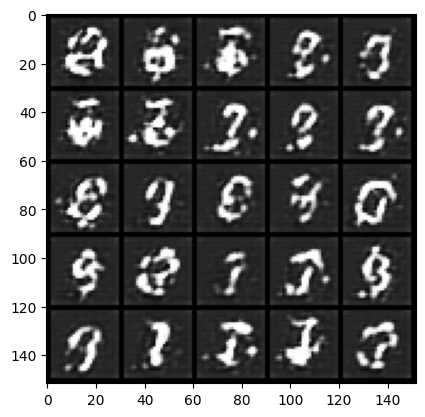

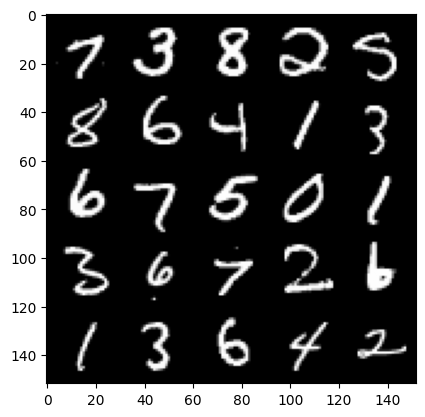

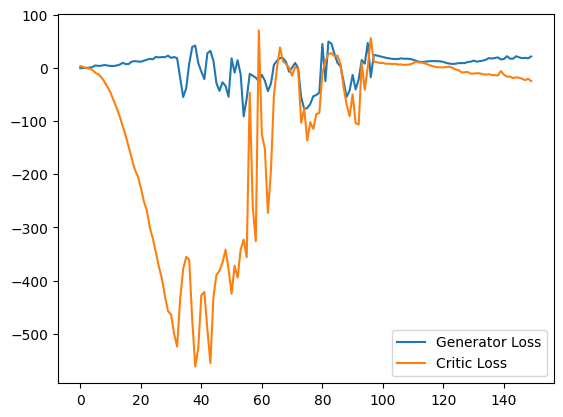

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.72981858253479
real: 9.656925201416016, fake: -28.520618438720703, regularization: 17.298185348510742
crit_loss: torch.Size([]) -20.879358291625977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4267990589141846
real: 30.91838836669922, fake: -16.65158462524414, regularization: 14.267990112304688
crit_loss: torch.Size([]) -33.30198287963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7795605659484863
real: 23.40629768371582, fake: -24.512786865234375, regularization: 17.795604705810547
crit_loss: torch.Size([]) -30.123477935791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6975113153457642
real: 28.043386459350586, fake: -22.89883041381836, regularization: 16.975112915039062
crit_loss: torch.Size([]) -33.96710205078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.729095697402954
real: 25.229076385498047, fake: -27.668720245361328, regularization: 17.290956497192383
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6261496543884277
real: 20.271587371826172, fake: -23.30952262878418, regularization: 16.261497497558594
crit_loss: torch.Size([]) -27.319610595703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5440709590911865
real: 25.48500633239746, fake: -17.500102996826172, regularization: 15.440710067749023
crit_loss: torch.Size([]) -27.544397354125977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7160890102386475
real: 23.84351348876953, fake: -19.59820556640625, regularization: 17.160890579223633
crit_loss: torch.Size([]) -26.28082847595215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3705346584320068
real: 20.160282135009766, fake: -21.896289825439453, regularization: 13.705347061157227
crit_loss: torch.Size([]) -28.351224899291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7060232162475586
real: 21.018451690673828, fake: -25.01462173461914, regularization: 17.060232162475586
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.2123465538024902
real: 41.02556228637695, fake: 6.819655418395996, regularization: 32.12346649169922
crit_loss: torch.Size([]) -2.082439422607422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.4164485931396484
real: -2.1469173431396484, fake: -42.29741668701172, regularization: 34.164485931396484
crit_loss: torch.Size([]) -5.986011505126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.932178020477295
real: 42.131980895996094, fake: 4.358928680419922, regularization: 29.321781158447266
crit_loss: torch.Size([]) -8.451271057128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6763904094696045
real: 27.793323516845703, fake: -16.47994613647461, regularization: 16.763904571533203
crit_loss: torch.Size([]) -27.50936508178711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0128700733184814
real: 19.861122131347656, fake: -24.771772384643555, regularization: 20.128700256347656
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2721095085144043
real: 38.32418441772461, fake: -8.56208610534668, regularization: 22.72109603881836
crit_loss: torch.Size([]) -24.165172576904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.139504432678223
real: 3.188215732574463, fake: -46.106910705566406, regularization: 41.395042419433594
crit_loss: torch.Size([]) -7.90008544921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.859273910522461
real: 46.93144226074219, fake: 22.158824920654297, regularization: 108.59274291992188
crit_loss: torch.Size([]) 83.82012939453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.7662765979766846
real: 6.737093448638916, fake: -35.67913055419922, regularization: 37.66276550292969
crit_loss: torch.Size([]) -4.753459930419922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6345877647399902
real: 5.452591419219971, fake: -34.34425354003906, regularization: 26.34587860107422
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8613455295562744
real: 19.927078247070312, fake: -28.71361541748047, regularization: 18.613454818725586
crit_loss: torch.Size([]) -30.027238845825195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.443638801574707
real: 39.77176284790039, fake: -11.14287281036377, regularization: 14.43638801574707
crit_loss: torch.Size([]) -36.478248596191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4129389524459839
real: 25.222970962524414, fake: -25.86241912841797, regularization: 14.129389762878418
crit_loss: torch.Size([]) -36.955997467041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2496733665466309
real: 30.408248901367188, fake: -22.998287200927734, regularization: 12.496733665466309
crit_loss: torch.Size([]) -40.9098014831543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5168887376785278
real: 31.298362731933594, fake: -22.071985244750977, regularization: 15.1688871383667
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.733931303024292
real: 21.921140670776367, fake: -19.86265754699707, regularization: 17.339313507080078
crit_loss: torch.Size([]) -24.44448471069336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.08258318901062
real: 8.962368965148926, fake: -24.292943954467773, regularization: 20.82583236694336
crit_loss: torch.Size([]) -12.429481506347656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0456695556640625
real: 17.39364242553711, fake: -20.107357025146484, regularization: 20.456695556640625
crit_loss: torch.Size([]) -17.04430389404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9293749332427979
real: 17.184505462646484, fake: -20.77145767211914, regularization: 19.29374885559082
crit_loss: torch.Size([]) -18.662214279174805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9556041955947876
real: 20.447824478149414, fake: -18.19214630126953, regularization: 19.556041717529297
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4118602275848389
real: 26.518999099731445, fake: -22.448570251464844, regularization: 14.118602752685547
crit_loss: torch.Size([]) -34.84896469116211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.596331238746643
real: 26.168392181396484, fake: -23.429866790771484, regularization: 15.963312149047852
crit_loss: torch.Size([]) -33.63494873046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7443993091583252
real: 30.690200805664062, fake: -18.916372299194336, regularization: 17.443992614746094
crit_loss: torch.Size([]) -32.16258239746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5092599391937256
real: 26.335861206054688, fake: -21.254711151123047, regularization: 15.092599868774414
crit_loss: torch.Size([]) -32.49797058105469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7048465013504028
real: 23.58977508544922, fake: -24.85873031616211, regularization: 17.048465728759766
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.271932601928711
real: 24.977569580078125, fake: -22.684877395629883, regularization: 12.71932601928711
crit_loss: torch.Size([]) -34.943119049072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.441797137260437
real: 27.200349807739258, fake: -21.2243595123291, regularization: 14.41797161102295
crit_loss: torch.Size([]) -34.006736755371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7663137912750244
real: 24.526065826416016, fake: -25.158546447753906, regularization: 17.663137435913086
crit_loss: torch.Size([]) -32.02147674560547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4636452198028564
real: 27.685504913330078, fake: -22.006074905395508, regularization: 14.636451721191406
crit_loss: torch.Size([]) -35.05513000488281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9407985210418701
real: 24.581087112426758, fake: -25.52666473388672, regularization: 19.40798568725586
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.385710597038269
real: 39.780338287353516, fake: -18.172683715820312, regularization: 13.85710620880127
crit_loss: torch.Size([]) -44.095916748046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.359062671661377
real: 35.286399841308594, fake: -23.512187957763672, regularization: 13.59062671661377
crit_loss: torch.Size([]) -45.20796203613281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3382697105407715
real: 7.135583877563477, fake: -23.551408767700195, regularization: 13.382697105407715
crit_loss: torch.Size([]) -17.30429458618164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7189048528671265
real: 32.28791809082031, fake: -8.712995529174805, regularization: 17.189048767089844
crit_loss: torch.Size([]) -23.811866760253906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.769464373588562
real: 21.934677124023438, fake: -26.058504104614258, regularization: 17.694643020629883
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.250716209411621
real: 47.08864212036133, fake: 0.9459612369537354, regularization: 32.507164001464844
crit_loss: torch.Size([]) -13.635517120361328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3099656105041504
real: -11.376754760742188, fake: -34.638633728027344, regularization: 23.099655151367188
crit_loss: torch.Size([]) -0.16222381591796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4237089157104492
real: 6.469611644744873, fake: -27.08441162109375, regularization: 14.237089157104492
crit_loss: torch.Size([]) -19.31693458557129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3137025833129883
real: 39.72681427001953, fake: -7.072944164276123, regularization: 23.137025833129883
crit_loss: torch.Size([]) -23.66273307800293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2065131664276123
real: 1.8177409172058105, fake: -18.394596099853516, regularization: 12.065132141113281
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6604468822479248
real: 21.239505767822266, fake: -26.82156753540039, regularization: 16.604469299316406
crit_loss: torch.Size([]) -31.45660400390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3501341342926025
real: 28.175601959228516, fake: -6.801599502563477, regularization: 13.501340866088867
crit_loss: torch.Size([]) -21.475862503051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4457111358642578
real: 28.550809860229492, fake: -16.6772403717041, regularization: 14.457111358642578
crit_loss: torch.Size([]) -30.770938873291016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.644526481628418
real: 21.572498321533203, fake: -27.202329635620117, regularization: 16.44526481628418
crit_loss: torch.Size([]) -32.329559326171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6843191385269165
real: 27.602062225341797, fake: -21.745670318603516, regularization: 16.843191146850586
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.410818099975586
real: 49.08818817138672, fake: 18.809070587158203, regularization: 104.10818481445312
crit_loss: torch.Size([]) 73.82907104492188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.368528366088867
real: -10.374628067016602, fake: -37.67725372314453, regularization: 53.68528366088867
crit_loss: torch.Size([]) 26.382658004760742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8605906963348389
real: -7.299886703491211, fake: -29.787662506103516, regularization: 18.605907440185547
crit_loss: torch.Size([]) -3.881868362426758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.540215015411377
real: -1.2835862636566162, fake: -19.987064361572266, regularization: 15.40215015411377
crit_loss: torch.Size([]) -3.301327705383301
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4971270561218262
real: 6.144077777862549, fake: -15.747797012329102, regularization: 14.971270561218262
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2902718782424927
real: 26.566303253173828, fake: -13.983016967773438, regularization: 12.902718544006348
crit_loss: torch.Size([]) -27.646602630615234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3455169200897217
real: 31.348669052124023, fake: -16.737655639648438, regularization: 13.455169677734375
crit_loss: torch.Size([]) -34.63115692138672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.349473476409912
real: 16.21310043334961, fake: -34.00395202636719, regularization: 23.494735717773438
crit_loss: torch.Size([]) -26.72231674194336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.803989291191101
real: 39.146583557128906, fake: -7.002052307128906, regularization: 18.039892196655273
crit_loss: torch.Size([]) -28.10874366760254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.81087064743042
real: 16.186981201171875, fake: -33.793701171875, regularization: 18.108707427978516
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.484571933746338
real: -11.602234840393066, fake: -24.584964752197266, regularization: 14.845719337463379
crit_loss: torch.Size([]) 1.8629894256591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3959629535675049
real: -12.017754554748535, fake: -24.79521942138672, regularization: 13.95962905883789
crit_loss: torch.Size([]) 1.182164192199707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2715606689453125
real: -11.062512397766113, fake: -24.00933837890625, regularization: 12.715606689453125
crit_loss: torch.Size([]) -0.23121929168701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9862455129623413
real: -9.576326370239258, fake: -22.485321044921875, regularization: 9.862455368041992
crit_loss: torch.Size([]) -3.046539306640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1513100862503052
real: -8.167573928833008, fake: -21.849334716796875, regularization: 11.513100624084473
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1511836051940918
real: 22.045330047607422, fake: -25.757755279541016, regularization: 11.511836051940918
crit_loss: torch.Size([]) -36.2912483215332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1764519214630127
real: 25.81060791015625, fake: -22.38397216796875, regularization: 11.764518737792969
crit_loss: torch.Size([]) -36.43006134033203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0629751682281494
real: 28.66033172607422, fake: -21.589706420898438, regularization: 10.629751205444336
crit_loss: torch.Size([]) -39.62028503417969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4319746494293213
real: 23.703712463378906, fake: -27.077369689941406, regularization: 14.319746017456055
crit_loss: torch.Size([]) -36.461334228515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7157368659973145
real: 22.59392547607422, fake: -24.101531982421875, regularization: 17.157367706298828
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.228501558303833
real: 31.902673721313477, fake: -21.35470962524414, regularization: 12.285015106201172
crit_loss: torch.Size([]) -40.97237014770508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1071107387542725
real: 15.964584350585938, fake: -35.193389892578125, regularization: 21.071107864379883
crit_loss: torch.Size([]) -30.08686637878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.048581123352051
real: 38.61565399169922, fake: -7.9446258544921875, regularization: 20.485811233520508
crit_loss: torch.Size([]) -26.0744686126709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.972482442855835
real: -2.6221811771392822, fake: -46.272377014160156, regularization: 19.724824905395508
crit_loss: torch.Size([]) -23.925371170043945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5342999696731567
real: 34.54383087158203, fake: -10.980098724365234, regularization: 15.342999458312988
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8900008201599121
real: -20.07207489013672, fake: -27.05956268310547, regularization: 8.900008201599121
crit_loss: torch.Size([]) 1.912520408630371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0776511430740356
real: -20.230693817138672, fake: -27.532197952270508, regularization: 10.776511192321777
crit_loss: torch.Size([]) 3.4750070571899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8750787377357483
real: -20.22308921813965, fake: -27.56744956970215, regularization: 8.750787734985352
crit_loss: torch.Size([]) 1.4064273834228516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8826743364334106
real: -21.02649688720703, fake: -27.7388973236084, regularization: 8.826743125915527
crit_loss: torch.Size([]) 2.11434268951416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8157193064689636
real: -20.92658233642578, fake: -27.719696044921875, regularization: 8.157193183898926
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8765684366226196
real: -14.114431381225586, fake: -22.86034393310547, regularization: 8.765684127807617
crit_loss: torch.Size([]) 0.019771575927734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7297102212905884
real: -13.634516716003418, fake: -22.57281494140625, regularization: 7.297101974487305
crit_loss: torch.Size([]) -1.6411962509155273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8489028811454773
real: -13.609670639038086, fake: -23.503936767578125, regularization: 8.489028930664062
crit_loss: torch.Size([]) -1.4052371978759766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.081742286682129
real: -13.084498405456543, fake: -23.275123596191406, regularization: 10.817422866821289
crit_loss: torch.Size([]) 0.6267976760864258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0056442022323608
real: -12.07557487487793, fake: -22.545557022094727, regularization: 10.05644226074218

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1327611207962036
real: 20.78558349609375, fake: -13.287681579589844, regularization: 11.327610969543457
crit_loss: torch.Size([]) -22.745655059814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0881894826889038
real: 20.215003967285156, fake: -13.589012145996094, regularization: 10.881895065307617
crit_loss: torch.Size([]) -22.922121047973633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0809149742126465
real: 19.672298431396484, fake: -14.421812057495117, regularization: 10.809149742126465
crit_loss: torch.Size([]) -23.284957885742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3850321769714355
real: 23.081871032714844, fake: -12.656994819641113, regularization: 13.850321769714355
crit_loss: torch.Size([]) -21.88854217529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2075049877166748
real: 20.521480560302734, fake: -15.61436939239502, regularization: 12.075050354003906

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1272661685943604
real: 14.038656234741211, fake: -5.008368492126465, regularization: 11.272661209106445
crit_loss: torch.Size([]) -7.774362564086914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0532246828079224
real: 27.70254135131836, fake: -15.027044296264648, regularization: 10.532246589660645
crit_loss: torch.Size([]) -32.19733810424805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9892939329147339
real: 17.342971801757812, fake: -18.023906707763672, regularization: 9.892939567565918
crit_loss: torch.Size([]) -25.47393798828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.017747402191162
real: 25.156875610351562, fake: -16.205150604248047, regularization: 10.177474021911621
crit_loss: torch.Size([]) -31.184551239013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8372098803520203
real: 19.266643524169922, fake: -9.526082992553711, regularization: 8.372098922729492
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.31752347946167
real: 32.99565124511719, fake: -14.347079277038574, regularization: 13.1752347946167
crit_loss: torch.Size([]) -34.16749572753906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6937692165374756
real: -22.328323364257812, fake: -26.611705780029297, regularization: 16.937692642211914
crit_loss: torch.Size([]) 12.65431022644043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.476585865020752
real: -22.226661682128906, fake: -26.990596771240234, regularization: 14.76585865020752
crit_loss: torch.Size([]) 10.001923561096191
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.394366979598999
real: -17.3800048828125, fake: -24.033607482910156, regularization: 13.943670272827148
crit_loss: torch.Size([]) 7.290067672729492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5983431339263916
real: -16.15121078491211, fake: -24.986373901367188, regularization: 15.983430862426758
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.083479881286621
real: 15.00446891784668, fake: -19.6796932220459, regularization: 10.834798812866211
crit_loss: torch.Size([]) -23.849363327026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0315265655517578
real: 23.90190315246582, fake: -14.425061225891113, regularization: 10.315265655517578
crit_loss: torch.Size([]) -28.011699676513672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0316685438156128
real: 30.043027877807617, fake: -11.432807922363281, regularization: 10.316685676574707
crit_loss: torch.Size([]) -31.15915298461914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2544392347335815
real: 25.27381706237793, fake: -14.53080940246582, regularization: 12.544392585754395
crit_loss: torch.Size([]) -27.260234832763672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.030293583869934
real: 28.932086944580078, fake: -8.980611801147461, regularization: 10.302935600280762
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.985979676246643
real: 32.278446197509766, fake: 3.907510757446289, regularization: 19.85979652404785
crit_loss: torch.Size([]) -8.511138916015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.721362590789795
real: 24.813491821289062, fake: -14.460779190063477, regularization: 17.213626861572266
crit_loss: torch.Size([]) -22.06064224243164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8379508256912231
real: 26.550464630126953, fake: -8.759897232055664, regularization: 8.379508018493652
crit_loss: torch.Size([]) -26.93085479736328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9324127435684204
real: 30.961763381958008, fake: -3.98872971534729, regularization: 9.324127197265625
crit_loss: torch.Size([]) -25.626365661621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9657544493675232
real: 29.37033462524414, fake: -10.052990913391113, regularization: 9.657544136047363
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3072391748428345
real: 22.772777557373047, fake: -13.992558479309082, regularization: 13.072391510009766
crit_loss: torch.Size([]) -23.692943572998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8711977601051331
real: 35.08275604248047, fake: -0.25802290439605713, regularization: 8.7119779586792
crit_loss: torch.Size([]) -26.628799438476562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.126962423324585
real: 23.366802215576172, fake: -12.822673797607422, regularization: 11.269624710083008
crit_loss: torch.Size([]) -24.919851303100586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1780922412872314
real: 21.44906997680664, fake: -15.355392456054688, regularization: 11.780921936035156
crit_loss: torch.Size([]) -25.023540496826172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9294338822364807
real: 30.18299674987793, fake: -7.265107154846191, regularization: 9.294339179992676
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0828781127929688
real: 5.036379814147949, fake: -35.49247360229492, regularization: 20.828781127929688
crit_loss: torch.Size([]) -19.7000732421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.070411443710327
real: 33.6353759765625, fake: -10.010601043701172, regularization: 20.70411491394043
crit_loss: torch.Size([]) -22.941862106323242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5591826438903809
real: 9.067554473876953, fake: -34.87038040161133, regularization: 15.591826438903809
crit_loss: torch.Size([]) -28.346107482910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.490185260772705
real: 27.800373077392578, fake: -16.387723922729492, regularization: 14.90185260772705
crit_loss: torch.Size([]) -29.286243438720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.5856409072875977
real: -23.53572654724121, fake: -32.249759674072266, regularization: 25.856409072875977
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9401799440383911
real: 24.170015335083008, fake: -17.25640869140625, regularization: 9.401799201965332
crit_loss: torch.Size([]) -32.02462387084961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1002984046936035
real: 25.139019012451172, fake: -12.177978515625, regularization: 11.002984046936035
crit_loss: torch.Size([]) -26.314014434814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1226985454559326
real: 26.89170265197754, fake: -19.054672241210938, regularization: 11.226985931396484
crit_loss: torch.Size([]) -34.71938705444336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0312654972076416
real: 33.99576950073242, fake: -16.268571853637695, regularization: 10.312654495239258
crit_loss: torch.Size([]) -39.951690673828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8686882257461548
real: 38.15790557861328, fake: -14.00760269165039, regularization: 8.686882019042969
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.593346357345581
real: 34.67230224609375, fake: -5.3845720291137695, regularization: 15.933464050292969
crit_loss: torch.Size([]) -24.123409271240234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.023321509361267
real: 23.36855125427246, fake: -17.809206008911133, regularization: 10.23321533203125
crit_loss: torch.Size([]) -30.944541931152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4719599485397339
real: 20.064146041870117, fake: -24.000797271728516, regularization: 14.719599723815918
crit_loss: torch.Size([]) -29.345340728759766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5280791521072388
real: 25.737991333007812, fake: -2.395784378051758, regularization: 15.280791282653809
crit_loss: torch.Size([]) -12.852984428405762
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.054738998413086
real: 24.843923568725586, fake: -12.881708145141602, regularization: 10.54738998413086
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6708178520202637
real: 42.83652114868164, fake: 8.609763145446777, regularization: 26.708179473876953
crit_loss: torch.Size([]) -7.518577575683594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5597212314605713
real: 20.19959259033203, fake: -23.662818908691406, regularization: 15.597211837768555
crit_loss: torch.Size([]) -28.265199661254883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0386130809783936
real: 24.19745635986328, fake: -19.309886932373047, regularization: 10.386131286621094
crit_loss: torch.Size([]) -33.121212005615234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1830106973648071
real: 30.146286010742188, fake: -12.463885307312012, regularization: 11.830106735229492
crit_loss: torch.Size([]) -30.780065536499023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9807213544845581
real: 28.498397827148438, fake: -16.216323852539062, regularization: 9.80721378326416
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2599961757659912
real: 24.289899826049805, fake: -11.153972625732422, regularization: 12.59996223449707
crit_loss: torch.Size([]) -22.843908309936523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.116759181022644
real: 28.7667236328125, fake: -5.6129021644592285, regularization: 11.16759204864502
crit_loss: torch.Size([]) -23.2120361328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8641397953033447
real: 30.40746307373047, fake: -7.656614303588867, regularization: 8.641397476196289
crit_loss: torch.Size([]) -29.42268180847168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8926525712013245
real: 26.40077781677246, fake: -12.399711608886719, regularization: 8.926526069641113
crit_loss: torch.Size([]) -29.873966217041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8165498375892639
real: 25.26538848876953, fake: -14.20684814453125, regularization: 8.165498733520508
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.003159523010254
real: 22.587491989135742, fake: -21.06475830078125, regularization: 10.031595230102539
crit_loss: torch.Size([]) -33.62065887451172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2136664390563965
real: 26.279666900634766, fake: -16.83106803894043, regularization: 12.136664390563965
crit_loss: torch.Size([]) -30.97406768798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0635733604431152
real: 29.157670974731445, fake: -16.05355453491211, regularization: 10.635733604431152
crit_loss: torch.Size([]) -34.57549285888672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3026881217956543
real: 24.165014266967773, fake: -22.751962661743164, regularization: 13.026881217956543
crit_loss: torch.Size([]) -33.89009475708008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0519734621047974
real: 20.926189422607422, fake: -12.102039337158203, regularization: 10.519734382629395
crit

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8500945568084717
real: 15.063553810119629, fake: -16.928760528564453, regularization: 8.500946044921875
crit_loss: torch.Size([]) -23.49136734008789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9341117739677429
real: 35.3161506652832, fake: -6.492700576782227, regularization: 9.341117858886719
crit_loss: torch.Size([]) -32.467735290527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1513787508010864
real: 31.55919647216797, fake: -11.80137825012207, regularization: 11.513787269592285
crit_loss: torch.Size([]) -31.846786499023438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5002150535583496
real: 24.120037078857422, fake: -21.03462028503418, regularization: 15.002150535583496
crit_loss: torch.Size([]) -30.152503967285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.240928292274475
real: 38.067169189453125, fake: -5.673771858215332, regularization: 12.409282684326172
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.08950936794281
real: 25.37997055053711, fake: -17.072372436523438, regularization: 10.89509391784668
crit_loss: torch.Size([]) -31.557249069213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9113775491714478
real: 29.820560455322266, fake: -17.555198669433594, regularization: 9.113775253295898
crit_loss: torch.Size([]) -38.261985778808594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8216572999954224
real: 35.654815673828125, fake: -10.522896766662598, regularization: 8.216572761535645
crit_loss: torch.Size([]) -37.96113967895508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9733748435974121
real: 27.283105850219727, fake: -20.187145233154297, regularization: 9.733748435974121
crit_loss: torch.Size([]) -37.73650360107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8683815002441406
real: 37.477195739746094, fake: -9.723316192626953, regularization: 8.683815002441406
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2438900470733643
real: -18.94873046875, fake: -17.650226593017578, regularization: 12.438899993896484
crit_loss: torch.Size([]) 13.737403869628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3002209663391113
real: -19.903846740722656, fake: -25.785648345947266, regularization: 13.002209663391113
crit_loss: torch.Size([]) 7.120408058166504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1403415203094482
real: -19.919361114501953, fake: -31.950115203857422, regularization: 21.40341567993164
crit_loss: torch.Size([]) 9.372661590576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9051581621170044
real: -16.181034088134766, fake: -28.99563217163086, regularization: 19.05158233642578
crit_loss: torch.Size([]) 6.2369842529296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.464271903038025
real: -12.928936004638672, fake: -23.629613876342773, regularization: 14.642719268798828
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.370558500289917
real: 20.262653350830078, fake: -21.158206939697266, regularization: 13.705585479736328
crit_loss: torch.Size([]) -27.715274810791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4659039974212646
real: 29.55109405517578, fake: -10.406993865966797, regularization: 14.659040451049805
crit_loss: torch.Size([]) -25.299047470092773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2157208919525146
real: 20.635007858276367, fake: -20.72856903076172, regularization: 12.157209396362305
crit_loss: torch.Size([]) -29.206369400024414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4736950397491455
real: 19.424354553222656, fake: -24.859615325927734, regularization: 14.736949920654297
crit_loss: torch.Size([]) -29.547019958496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5556858777999878
real: 30.068862915039062, fake: -10.99726390838623, regularization: 15.556859016418457


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6644246578216553
real: -15.05307388305664, fake: -23.141937255859375, regularization: 6.644246578216553
crit_loss: torch.Size([]) -1.4446167945861816
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49726584553718567
real: -14.461860656738281, fake: -22.706830978393555, regularization: 4.972658634185791
crit_loss: torch.Size([]) -3.2723116874694824
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.670903742313385
real: -14.225497245788574, fake: -22.363204956054688, regularization: 6.7090373039245605
crit_loss: torch.Size([]) -1.4286704063415527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6072635650634766
real: -14.003978729248047, fake: -22.205074310302734, regularization: 6.072635650634766
crit_loss: torch.Size([]) -2.128459930419922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7998517155647278
real: -13.15385627746582, fake: -22.434307098388672, regularization: 7.99851703643798

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7735717296600342
real: 29.560436248779297, fake: -8.510672569274902, regularization: 7.735717296600342
crit_loss: torch.Size([]) -30.335391998291016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8508521318435669
real: 19.484811782836914, fake: -7.676810264587402, regularization: 8.50852108001709
crit_loss: torch.Size([]) -18.653099060058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9042345285415649
real: 26.651079177856445, fake: -5.901599884033203, regularization: 9.04234504699707
crit_loss: torch.Size([]) -23.51033592224121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7137866616249084
real: 26.847904205322266, fake: -5.927443981170654, regularization: 7.137866497039795
crit_loss: torch.Size([]) -25.637481689453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.050998568534851
real: 26.054309844970703, fake: -6.9260783195495605, regularization: 10.50998592376709
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8708059787750244
real: 31.73357391357422, fake: -14.633480072021484, regularization: 8.708059310913086
crit_loss: torch.Size([]) -37.65899658203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9411985874176025
real: 32.47660827636719, fake: -14.006980895996094, regularization: 9.411985397338867
crit_loss: torch.Size([]) -37.07160186767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9685642123222351
real: 35.80741882324219, fake: -10.026039123535156, regularization: 9.68564224243164
crit_loss: torch.Size([]) -36.1478157043457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9760931730270386
real: -0.49829959869384766, fake: -12.85273551940918, regularization: 9.760931968688965
crit_loss: torch.Size([]) -2.593503952026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8587279915809631
real: 0.5177037715911865, fake: -15.428903579711914, regularization: 8.5872802734375
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2866239547729492
real: 22.378559112548828, fake: -11.419181823730469, regularization: 12.866239547729492
crit_loss: torch.Size([]) -20.931501388549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8573328852653503
real: 38.15098571777344, fake: -4.895594596862793, regularization: 8.573328971862793
crit_loss: torch.Size([]) -34.47325134277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9571782350540161
real: 30.774555206298828, fake: -11.782999038696289, regularization: 9.571782112121582
crit_loss: torch.Size([]) -32.985774993896484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9186564683914185
real: 31.356281280517578, fake: -12.860519409179688, regularization: 9.186564445495605
crit_loss: torch.Size([]) -35.030235290527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9307333827018738
real: 33.02689743041992, fake: -13.05549144744873, regularization: 9.307333946228027
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9930744767189026
real: 28.523033142089844, fake: -18.151592254638672, regularization: 9.930745124816895
crit_loss: torch.Size([]) -36.74388122558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0556596517562866
real: 30.748170852661133, fake: -18.58618927001953, regularization: 10.556596755981445
crit_loss: torch.Size([]) -38.77776336669922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8950825333595276
real: 34.70751953125, fake: -3.318344831466675, regularization: 8.950825691223145
crit_loss: torch.Size([]) -29.07503890991211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7843629121780396
real: 28.176023483276367, fake: -16.34354591369629, regularization: 7.843628883361816
crit_loss: torch.Size([]) -36.675941467285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9247154593467712
real: 29.143571853637695, fake: -16.806652069091797, regularization: 9.247154235839844
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9524580836296082
real: 22.10625457763672, fake: -18.015918731689453, regularization: 9.524580955505371
crit_loss: torch.Size([]) -30.597591400146484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8190898895263672
real: 33.54239273071289, fake: -13.064064025878906, regularization: 8.190898895263672
crit_loss: torch.Size([]) -38.415557861328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0532547235488892
real: 22.23212432861328, fake: -25.955738067626953, regularization: 10.532546997070312
crit_loss: torch.Size([]) -37.65531539916992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.013734221458435
real: 38.33136749267578, fake: -6.02176570892334, regularization: 10.13734245300293
crit_loss: torch.Size([]) -34.215789794921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.924267292022705
real: 5.87272834777832, fake: -30.953445434570312, regularization: 19.242671966552734
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0785008668899536
real: 28.016799926757812, fake: -18.970319747924805, regularization: 10.785008430480957
crit_loss: torch.Size([]) -36.20211410522461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9370231628417969
real: 29.196744918823242, fake: -15.659408569335938, regularization: 9.370231628417969
crit_loss: torch.Size([]) -35.485923767089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0927233695983887
real: 17.454837799072266, fake: -24.429691314697266, regularization: 10.927233695983887
crit_loss: torch.Size([]) -30.957294464111328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.2090678215026855
real: 45.81739044189453, fake: 4.634335994720459, regularization: 22.090679168701172
crit_loss: torch.Size([]) -19.092376708984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.0588769912719727
real: -7.9350738525390625, fake: -37.75288391113281, regularization: 30.588769912719727
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9381437301635742
real: -12.955303192138672, fake: -24.083084106445312, regularization: 9.381437301635742
crit_loss: torch.Size([]) -1.7463436126708984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9653688669204712
real: -12.659675598144531, fake: -23.880393981933594, regularization: 9.653688430786133
crit_loss: torch.Size([]) -1.5670299530029297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5474168658256531
real: -12.608972549438477, fake: -24.93886947631836, regularization: 5.47416877746582
crit_loss: torch.Size([]) -6.8557281494140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9301819205284119
real: -11.46308708190918, fake: -24.304317474365234, regularization: 9.30181884765625
crit_loss: torch.Size([]) -3.5394115447998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8199914693832397
real: -9.807945251464844, fake: -23.305477142333984, regularization: 8.199914932250977
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6612155437469482
real: 8.536676406860352, fake: -19.551807403564453, regularization: 16.61215591430664
crit_loss: torch.Size([]) -11.476327896118164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2150599956512451
real: 35.188934326171875, fake: -5.588959693908691, regularization: 12.15060043334961
crit_loss: torch.Size([]) -28.62729263305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2559819221496582
real: 16.80796241760254, fake: -19.173866271972656, regularization: 12.559819221496582
crit_loss: torch.Size([]) -23.422008514404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9522122144699097
real: 31.722347259521484, fake: -12.235057830810547, regularization: 9.522122383117676
crit_loss: torch.Size([]) -34.43528366088867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9149460792541504
real: 35.64579772949219, fake: -9.023168563842773, regularization: 9.149460792541504
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.030220627784729
real: 26.718799591064453, fake: -22.608428955078125, regularization: 10.302206039428711
crit_loss: torch.Size([]) -39.0250244140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3501408100128174
real: 33.49472427368164, fake: -16.28696632385254, regularization: 13.501407623291016
crit_loss: torch.Size([]) -36.2802848815918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7996103763580322
real: 33.66716766357422, fake: -11.768693923950195, regularization: 7.996103763580322
crit_loss: torch.Size([]) -37.439754486083984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0166511535644531
real: 6.950309753417969, fake: -27.604726791381836, regularization: 10.166511535644531
crit_loss: torch.Size([]) -24.388526916503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3373408317565918
real: 39.247596740722656, fake: -8.82896614074707, regularization: 13.373408317565918
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5743730068206787
real: 22.17331314086914, fake: -27.146873474121094, regularization: 15.743730545043945
crit_loss: torch.Size([]) -33.576454162597656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.112359881401062
real: 38.112003326416016, fake: -7.151684284210205, regularization: 11.1235990524292
crit_loss: torch.Size([]) -34.14008712768555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5275764465332031
real: 13.765047073364258, fake: -35.018829345703125, regularization: 15.275764465332031
crit_loss: torch.Size([]) -33.50811004638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5508819818496704
real: 44.64405822753906, fake: -1.2044731378555298, regularization: 15.508819580078125
crit_loss: torch.Size([]) -30.339710235595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.6124672889709473
real: -8.639836311340332, fake: -43.68552780151367, regularization: 26.124671936035156
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0901806354522705
real: 48.498016357421875, fake: 6.341032028198242, regularization: 20.901805877685547
crit_loss: torch.Size([]) -21.255176544189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.5680487155914307
real: -7.818687438964844, fake: -45.22711181640625, regularization: 35.68048858642578
crit_loss: torch.Size([]) -1.727935791015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.259328365325928
real: 49.331417083740234, fake: 20.172283172607422, regularization: 72.5932846069336
crit_loss: torch.Size([]) 43.43415069580078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.623101234436035
real: -3.070896863937378, fake: -36.387290954589844, regularization: 36.23101043701172
crit_loss: torch.Size([]) 2.9146156311035156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5133028030395508
real: 9.015625953674316, fake: -26.571128845214844, regularization: 15.133028030395508
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8015859723091125
real: -15.98335075378418, fake: -23.385196685791016, regularization: 8.015859603881836
crit_loss: torch.Size([]) 0.614013671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.69240403175354
real: -16.22843360900879, fake: -24.607261657714844, regularization: 6.9240403175354
crit_loss: torch.Size([]) -1.4547877311706543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8341074585914612
real: -16.729736328125, fake: -25.68451499938965, regularization: 8.34107494354248
crit_loss: torch.Size([]) -0.613703727722168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9119120836257935
real: -10.03155517578125, fake: -24.310728073120117, regularization: 9.119120597839355
crit_loss: torch.Size([]) -5.160052299499512
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8899356722831726
real: -7.340313911437988, fake: -22.998504638671875, regularization: 8.899356842041016
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.089634895324707
real: 18.15686798095703, fake: -19.122783660888672, regularization: 10.89634895324707
crit_loss: torch.Size([]) -26.383302688598633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9020655751228333
real: 31.482196807861328, fake: -8.123854637145996, regularization: 9.020655632019043
crit_loss: torch.Size([]) -30.58539581298828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8193686008453369
real: 30.29733657836914, fake: -12.910643577575684, regularization: 8.193685531616211
crit_loss: torch.Size([]) -35.01429748535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0610435009002686
real: 22.884267807006836, fake: -22.129573822021484, regularization: 10.610435485839844
crit_loss: torch.Size([]) -34.403404235839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0026261806488037
real: 31.73138999938965, fake: -13.34880542755127, regularization: 10.026262283325195
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.687061071395874
real: 20.967098236083984, fake: -27.443973541259766, regularization: 16.8706111907959
crit_loss: torch.Size([]) -31.54046058654785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8729251623153687
real: 43.685699462890625, fake: 3.002195358276367, regularization: 18.729251861572266
crit_loss: torch.Size([]) -21.95425033569336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.111131191253662
real: 6.132600784301758, fake: -38.81948471069336, regularization: 21.111312866210938
crit_loss: torch.Size([]) -23.840774536132812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3094751834869385
real: 33.10599899291992, fake: -22.348072052001953, regularization: 13.094751358032227
crit_loss: torch.Size([]) -42.35932159423828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2952057123184204
real: 38.05361557006836, fake: -14.89780044555664, regularization: 12.952056884765625
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5683268904685974
real: -18.561458587646484, fake: -25.485393524169922, regularization: 5.683269023895264
crit_loss: torch.Size([]) -1.2406659126281738
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5354956984519958
real: -18.411434173583984, fake: -25.335933685302734, regularization: 5.354957103729248
crit_loss: torch.Size([]) -1.569542407989502
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5758622288703918
real: -18.24321746826172, fake: -25.07937240600586, regularization: 5.758622169494629
crit_loss: torch.Size([]) -1.0775327682495117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6059988737106323
real: -18.051326751708984, fake: -24.959138870239258, regularization: 6.059988975524902
crit_loss: torch.Size([]) -0.8478231430053711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48142266273498535
real: -19.059200286865234, fake: -24.991056442260742, regularization: 4.81422662734985

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6594268083572388
real: -5.337729454040527, fake: -20.19477081298828, regularization: 6.594267845153809
crit_loss: torch.Size([]) -8.262773513793945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8084944486618042
real: -6.374326705932617, fake: -19.520038604736328, regularization: 8.084944725036621
crit_loss: torch.Size([]) -5.06076717376709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5771726369857788
real: -4.647359848022461, fake: -19.23117446899414, regularization: 5.771726608276367
crit_loss: torch.Size([]) -8.812088012695312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7969757318496704
real: -2.7680411338806152, fake: -17.343185424804688, regularization: 7.969757080078125
crit_loss: torch.Size([]) -6.605386734008789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8683335781097412
real: -1.8158502578735352, fake: -18.2681827545166, regularization: 8.68333625793457
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9204431772232056
real: 19.598743438720703, fake: -17.618206024169922, regularization: 9.204431533813477
crit_loss: torch.Size([]) -28.01251792907715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9143725037574768
real: 25.704158782958984, fake: -15.432327270507812, regularization: 9.143725395202637
crit_loss: torch.Size([]) -31.992759704589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3547370433807373
real: 39.63322830200195, fake: -7.525088310241699, regularization: 13.547370910644531
crit_loss: torch.Size([]) -33.61094665527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8894233703613281
real: 24.107341766357422, fake: -15.37880802154541, regularization: 8.894233703613281
crit_loss: torch.Size([]) -30.591915130615234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9617266654968262
real: 39.13277816772461, fake: -6.552761077880859, regularization: 9.617266654968262
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9920539855957031
real: 39.595375061035156, fake: -9.144431114196777, regularization: 9.920539855957031
crit_loss: torch.Size([]) -38.81926727294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.776870846748352
real: 31.48150634765625, fake: -18.16868019104004, regularization: 7.768708229064941
crit_loss: torch.Size([]) -41.88147735595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0192201137542725
real: 34.68257522583008, fake: -16.184425354003906, regularization: 10.192201614379883
crit_loss: torch.Size([]) -40.67479705810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8564704656600952
real: 40.349281311035156, fake: -11.748401641845703, regularization: 8.564704895019531
crit_loss: torch.Size([]) -43.53297805786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.084667682647705
real: 34.2901611328125, fake: -17.775251388549805, regularization: 10.84667682647705
crit_loss: t

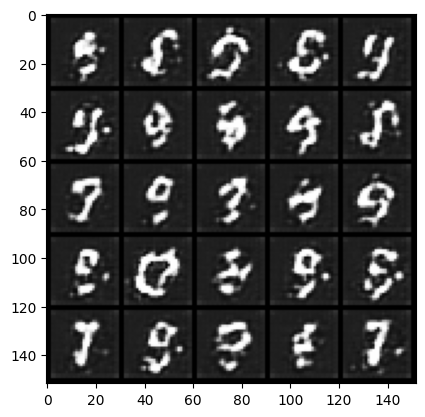

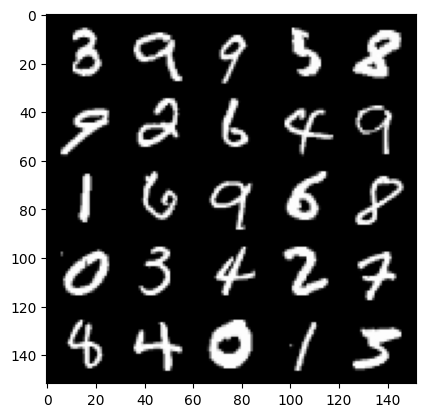

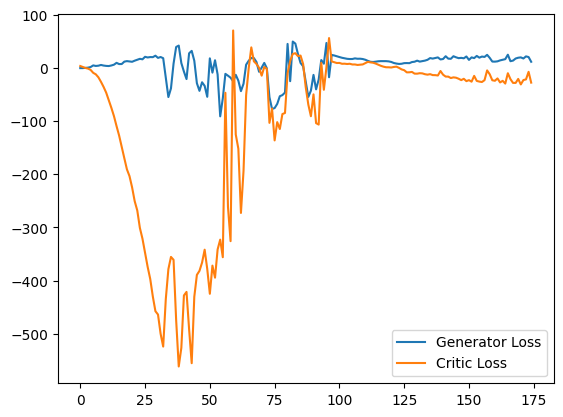

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9408103227615356
real: 25.40302085876465, fake: -22.363338470458984, regularization: 9.408102989196777
crit_loss: torch.Size([]) -38.358253479003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3331788778305054
real: 28.078628540039062, fake: -22.234695434570312, regularization: 13.331789016723633
crit_loss: torch.Size([]) -36.981536865234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1419317722320557
real: 36.35572052001953, fake: -11.683059692382812, regularization: 11.419317245483398
crit_loss: torch.Size([]) -36.61946105957031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.8894120454788208
real: 14.882837295532227, fake: -35.50366973876953, regularization: 18.894121170043945
crit_loss: torch.Size([]) -31.49238395690918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.397033214569092
real: 48.55955505371094, fake: 12.393285751342773, regularization: 33.970333099365234
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.384329229593277
real: -17.46031951904297, fake: -25.43511199951172, regularization: 3.843292236328125
crit_loss: torch.Size([]) -4.131500244140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5037531852722168
real: -17.21077537536621, fake: -25.27490234375, regularization: 5.037531852722168
crit_loss: torch.Size([]) -3.026595115661621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5808837413787842
real: -18.008451461791992, fake: -24.986392974853516, regularization: 5.808837413787842
crit_loss: torch.Size([]) -1.1691040992736816
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43795084953308105
real: -17.87706756591797, fake: -25.108558654785156, regularization: 4.3795084953308105
crit_loss: torch.Size([]) -2.851982593536377
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5080163478851318
real: -17.873218536376953, fake: -25.30890464782715, regularization: 5.080163478851318
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0375571250915527
real: 27.591753005981445, fake: -5.064766883850098, regularization: 10.375571250915527
crit_loss: torch.Size([]) -22.280948638916016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9711430668830872
real: 27.87554931640625, fake: -6.3092041015625, regularization: 9.711430549621582
crit_loss: torch.Size([]) -24.473323822021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0461459159851074
real: 27.493349075317383, fake: -8.038152694702148, regularization: 10.461459159851074
crit_loss: torch.Size([]) -25.07004165649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8616052865982056
real: 29.43197250366211, fake: -6.227119445800781, regularization: 8.616052627563477
crit_loss: torch.Size([]) -27.043039321899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7750091552734375
real: 17.655548095703125, fake: -6.441427707672119, regularization: 7.750091552734375
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2628309726715088
real: 14.16030502319336, fake: -21.998933792114258, regularization: 12.62830924987793
crit_loss: torch.Size([]) -23.53093147277832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6211588382720947
real: 0.9635666608810425, fake: -25.722318649291992, regularization: 16.21158790588379
crit_loss: torch.Size([]) -10.474296569824219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7006179094314575
real: 20.74833106994629, fake: -19.200145721435547, regularization: 17.006179809570312
crit_loss: torch.Size([]) -22.942298889160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2126693725585938
real: 30.692909240722656, fake: -6.95242977142334, regularization: 12.126693725585938
crit_loss: torch.Size([]) -25.518646240234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1354763507843018
real: 29.077768325805664, fake: -16.18083953857422, regularization: 11.35476303100586
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.07487154006958
real: 25.761877059936523, fake: -6.523713111877441, regularization: 10.7487154006958
crit_loss: torch.Size([]) -21.536876678466797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0082030296325684
real: 29.236160278320312, fake: -8.221964836120605, regularization: 10.082030296325684
crit_loss: torch.Size([]) -27.376094818115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0681558847427368
real: 27.89789390563965, fake: -8.17202377319336, regularization: 10.681558609008789
crit_loss: torch.Size([]) -25.388357162475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1920280456542969
real: 27.427776336669922, fake: -5.017460346221924, regularization: 11.920280456542969
crit_loss: torch.Size([]) -20.52495574951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7848341464996338
real: 27.745296478271484, fake: -11.559233665466309, regularization: 7.848341464996338
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8379126191139221
real: 29.543792724609375, fake: -7.06067419052124, regularization: 8.37912654876709
crit_loss: torch.Size([]) -28.225337982177734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7184398174285889
real: 31.24656105041504, fake: -7.38889217376709, regularization: 7.184398174285889
crit_loss: torch.Size([]) -31.451053619384766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9301182627677917
real: 30.80296516418457, fake: -10.035148620605469, regularization: 9.301182746887207
crit_loss: torch.Size([]) -31.536930084228516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9042737483978271
real: 34.18510437011719, fake: -4.790431022644043, regularization: 9.04273796081543
crit_loss: torch.Size([]) -29.932798385620117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3985713720321655
real: 20.234542846679688, fake: -19.548124313354492, regularization: 13.985713958740234
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6620427370071411
real: 14.961480140686035, fake: -33.06078338623047, regularization: 16.62042808532715
crit_loss: torch.Size([]) -31.40183448791504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6171202659606934
real: 44.61034393310547, fake: 3.361133575439453, regularization: 16.17120361328125
crit_loss: torch.Size([]) -25.078006744384766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.0098748207092285
real: -15.254110336303711, fake: -26.112850189208984, regularization: 20.09874725341797
crit_loss: torch.Size([]) 9.240007400512695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.194084644317627
real: -18.433883666992188, fake: -49.035274505615234, regularization: 51.94084548950195
crit_loss: torch.Size([]) 21.339454650878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 15.300508499145508
real: 32.50029373168945, fake: 29.8038387298584, regularization: 153.0050811767578
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.017358422279358
real: 24.293880462646484, fake: -13.783343315124512, regularization: 10.173583984375
crit_loss: torch.Size([]) -27.903640747070312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7992980480194092
real: 25.192943572998047, fake: -14.92381477355957, regularization: 7.992980480194092
crit_loss: torch.Size([]) -32.123779296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7553512454032898
real: 25.5272216796875, fake: -13.514528274536133, regularization: 7.5535125732421875
crit_loss: torch.Size([]) -31.488235473632812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1101937294006348
real: 27.058685302734375, fake: -13.902827262878418, regularization: 11.101937294006348
crit_loss: torch.Size([]) -29.859577178955078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8329561352729797
real: 25.713573455810547, fake: -15.456159591674805, regularization: 8.329561233520508
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4405412673950195
real: 0.8369261026382446, fake: -18.646591186523438, regularization: 14.405412673950195
crit_loss: torch.Size([]) -5.078104019165039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.117100477218628
real: 6.779472827911377, fake: -15.407205581665039, regularization: 11.171005249023438
crit_loss: torch.Size([]) -11.01567268371582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.516685962677002
real: 7.736932277679443, fake: -19.536611557006836, regularization: 15.16685962677002
crit_loss: torch.Size([]) -12.106684684753418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1976807117462158
real: 10.257194519042969, fake: -21.051109313964844, regularization: 11.976806640625
crit_loss: torch.Size([]) -19.331497192382812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.23765230178833
real: 14.476231575012207, fake: -20.961240768432617, regularization: 12.3765230178833
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5240178108215332
real: 28.372573852539062, fake: -19.962568283081055, regularization: 15.240178108215332
crit_loss: torch.Size([]) -33.094966888427734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3892958164215088
real: 33.76820373535156, fake: -13.370138168334961, regularization: 13.89295768737793
crit_loss: torch.Size([]) -33.245384216308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.127742052078247
real: 25.45332908630371, fake: -25.493165969848633, regularization: 11.277420043945312
crit_loss: torch.Size([]) -39.66907501220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.049053430557251
real: 13.831226348876953, fake: -11.168375015258789, regularization: 10.490533828735352
crit_loss: torch.Size([]) -14.50906753540039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8690752983093262
real: 27.469867706298828, fake: -20.469308853149414, regularization: 8.690752983093262
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8755627870559692
real: 38.323280334472656, fake: -10.570943832397461, regularization: 8.755627632141113
crit_loss: torch.Size([]) -40.13859939575195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6275689601898193
real: 7.208524703979492, fake: -32.92844772338867, regularization: 16.27569007873535
crit_loss: torch.Size([]) -23.86128044128418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 8.420361518859863
real: 53.61975860595703, fake: 25.969675064086914, regularization: 84.20361328125
crit_loss: torch.Size([]) 56.55352783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 73.28475952148438
real: -64.2461929321289, fake: -85.37301635742188, regularization: 732.8475952148438
crit_loss: torch.Size([]) 711.7207641601562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 107.65402221679688
real: 1.2603023052215576, fake: -6.185447692871094, regularization: 1076.540283203125
crit_loss: torch.Si

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48860877752304077
real: -23.926721572875977, fake: -27.29352569580078, regularization: 4.886087894439697
crit_loss: torch.Size([]) 1.5192837715148926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40970808267593384
real: -23.866199493408203, fake: -27.160554885864258, regularization: 4.097080707550049
crit_loss: torch.Size([]) 0.8027253150939941
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5544841289520264
real: -23.365150451660156, fake: -27.212440490722656, regularization: 5.544841289520264
crit_loss: torch.Size([]) 1.6975512504577637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5286747813224792
real: -23.389659881591797, fake: -27.230865478515625, regularization: 5.286747932434082
crit_loss: torch.Size([]) 1.445542335510254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41518688201904297
real: -23.455202102661133, fake: -27.224163055419922, regularization: 4.15186882019043


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3146601617336273
real: -23.460140228271484, fake: -26.981117248535156, regularization: 3.146601676940918
crit_loss: torch.Size([]) -0.3743753433227539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3661772608757019
real: -23.5566463470459, fake: -26.99343490600586, regularization: 3.6617727279663086
crit_loss: torch.Size([]) 0.22498416900634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39145147800445557
real: -23.572498321533203, fake: -27.100418090820312, regularization: 3.9145147800445557
crit_loss: torch.Size([]) 0.3865950107574463
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3610897958278656
real: -23.67495346069336, fake: -27.27358627319336, regularization: 3.610898017883301
crit_loss: torch.Size([]) 0.012265205383300781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4469435214996338
real: -24.00673484802246, fake: -27.41932487487793, regularization: 4.469435214996338


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3376450836658478
real: -23.448604583740234, fake: -26.713857650756836, regularization: 3.376450777053833
crit_loss: torch.Size([]) 0.11119771003723145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3175617754459381
real: -23.342803955078125, fake: -26.914722442626953, regularization: 3.1756176948547363
crit_loss: torch.Size([]) -0.3963007926940918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4016421437263489
real: -23.379047393798828, fake: -26.635480880737305, regularization: 4.016421318054199
crit_loss: torch.Size([]) 0.7599878311157227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34672242403030396
real: -23.41153335571289, fake: -26.74951934814453, regularization: 3.46722412109375
crit_loss: torch.Size([]) 0.12923812866210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37538942694664
real: -23.42938232421875, fake: -26.7497615814209, regularization: 3.753894329071045
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3397102952003479
real: -22.822216033935547, fake: -26.302011489868164, regularization: 3.3971028327941895
crit_loss: torch.Size([]) -0.08269262313842773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3349193036556244
real: -22.847623825073242, fake: -26.125614166259766, regularization: 3.3491930961608887
crit_loss: torch.Size([]) 0.07120275497436523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3006575405597687
real: -22.879104614257812, fake: -26.3471622467041, regularization: 3.006575345993042
crit_loss: torch.Size([]) -0.46148228645324707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38131359219551086
real: -22.73291015625, fake: -26.31936264038086, regularization: 3.813135862350464
crit_loss: torch.Size([]) 0.2266833782196045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4382774531841278
real: -22.749666213989258, fake: -26.4078311920166, regularization: 4.382774353027344
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4107609689235687
real: -22.272817611694336, fake: -25.404586791992188, regularization: 4.107609748840332
crit_loss: torch.Size([]) 0.9758405685424805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3433477282524109
real: -22.222196578979492, fake: -25.610464096069336, regularization: 3.4334774017333984
crit_loss: torch.Size([]) 0.04520988464355469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3818041682243347
real: -22.26163101196289, fake: -25.64376449584961, regularization: 3.8180418014526367
crit_loss: torch.Size([]) 0.43590831756591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31734341382980347
real: -22.254419326782227, fake: -25.657230377197266, regularization: 3.173434257507324
crit_loss: torch.Size([]) -0.22937679290771484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39800888299942017
real: -22.30921173095703, fake: -25.580360412597656, regularization: 3.98008871078

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2911264896392822
real: -22.140972137451172, fake: -25.378040313720703, regularization: 2.9112648963928223
crit_loss: torch.Size([]) -0.325803279876709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2799164056777954
real: -22.111061096191406, fake: -25.487937927246094, regularization: 2.799164056777954
crit_loss: torch.Size([]) -0.5777127742767334
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3524808883666992
real: -21.986286163330078, fake: -25.34328842163086, regularization: 3.524808883666992
crit_loss: torch.Size([]) 0.16780662536621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3701903820037842
real: -21.976951599121094, fake: -25.399917602539062, regularization: 3.701903820037842
crit_loss: torch.Size([]) 0.27893781661987305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41267791390419006
real: -22.059791564941406, fake: -25.391441345214844, regularization: 4.126779079437

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3258613348007202
real: -21.188533782958984, fake: -24.62797737121582, regularization: 3.258613348007202
crit_loss: torch.Size([]) -0.1808302402496338
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29393091797828674
real: -21.331005096435547, fake: -24.88515281677246, regularization: 2.9393091201782227
crit_loss: torch.Size([]) -0.6148386001586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26422619819641113
real: -21.37242317199707, fake: -24.864810943603516, regularization: 2.6422619819641113
crit_loss: torch.Size([]) -0.850125789642334
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37530505657196045
real: -21.366146087646484, fake: -24.805965423583984, regularization: 3.7530505657196045
crit_loss: torch.Size([]) 0.3132312297821045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3854682445526123
real: -21.514368057250977, fake: -24.967296600341797, regularization: 3.85468244552

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2906639277935028
real: -21.203338623046875, fake: -24.53899383544922, regularization: 2.906639337539673
crit_loss: torch.Size([]) -0.4290158748626709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30927136540412903
real: -21.430200576782227, fake: -24.392616271972656, regularization: 3.0927135944366455
crit_loss: torch.Size([]) 0.13029789924621582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2586319148540497
real: -21.465240478515625, fake: -24.55550765991211, regularization: 2.5863192081451416
crit_loss: torch.Size([]) -0.5039479732513428
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2933194637298584
real: -21.47353744506836, fake: -24.517913818359375, regularization: 2.933194637298584
crit_loss: torch.Size([]) -0.11118173599243164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31566494703292847
real: -21.490352630615234, fake: -24.68520736694336, regularization: 3.15664958953

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28034156560897827
real: -21.020370483398438, fake: -23.978090286254883, regularization: 2.8034157752990723
crit_loss: torch.Size([]) -0.15430402755737305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25765448808670044
real: -21.027706146240234, fake: -23.954214096069336, regularization: 2.576544761657715
crit_loss: torch.Size([]) -0.3499631881713867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3079865276813507
real: -21.033184051513672, fake: -23.919315338134766, regularization: 3.0798652172088623
crit_loss: torch.Size([]) 0.19373393058776855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41269445419311523
real: -20.52643585205078, fake: -23.911083221435547, regularization: 4.126944541931152
crit_loss: torch.Size([]) 0.7422971725463867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5031973123550415
real: -20.61307144165039, fake: -24.01350975036621, regularization: 5.0319728851

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33423078060150146
real: -20.199172973632812, fake: -23.412935256958008, regularization: 3.3423078060150146
crit_loss: torch.Size([]) 0.12854552268981934
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3697828948497772
real: -20.29645538330078, fake: -23.654308319091797, regularization: 3.697829008102417
crit_loss: torch.Size([]) 0.33997607231140137
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.310373455286026
real: -20.305633544921875, fake: -23.50686264038086, regularization: 3.1037344932556152
crit_loss: torch.Size([]) -0.09749460220336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2813732624053955
real: -20.279056549072266, fake: -23.676776885986328, regularization: 2.813732624053955
crit_loss: torch.Size([]) -0.5839877128601074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32163572311401367
real: -20.23740005493164, fake: -23.5218448638916, regularization: 3.2163572311401

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3639681339263916
real: -19.347875595092773, fake: -22.48113250732422, regularization: 3.639681339263916
crit_loss: torch.Size([]) 0.5064244270324707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3263683021068573
real: -19.339923858642578, fake: -22.276687622070312, regularization: 3.2636830806732178
crit_loss: torch.Size([]) 0.3269193172454834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2634306252002716
real: -19.324787139892578, fake: -22.34248924255371, regularization: 2.6343061923980713
crit_loss: torch.Size([]) -0.3833959102630615
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2324119359254837
real: -19.277202606201172, fake: -22.12419891357422, regularization: 2.3241193294525146
crit_loss: torch.Size([]) -0.5228769779205322
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.256308376789093
real: -19.215938568115234, fake: -22.257877349853516, regularization: 2.563083648681640

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25617289543151855
real: -19.197492599487305, fake: -22.2210693359375, regularization: 2.5617289543151855
crit_loss: torch.Size([]) -0.46184778213500977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2018580138683319
real: -19.186790466308594, fake: -22.19239044189453, regularization: 2.018580198287964
crit_loss: torch.Size([]) -0.9870197772979736
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29091352224349976
real: -19.178726196289062, fake: -22.264461517333984, regularization: 2.909135341644287
crit_loss: torch.Size([]) -0.17659997940063477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19510193169116974
real: -19.127206802368164, fake: -22.24800682067871, regularization: 1.951019287109375
crit_loss: torch.Size([]) -1.1697807312011719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24977172911167145
real: -19.168441772460938, fake: -22.349939346313477, regularization: 2.497717380

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2231893539428711
real: -18.706789016723633, fake: -21.750328063964844, regularization: 2.231893539428711
crit_loss: torch.Size([]) -0.8116455078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21211755275726318
real: -18.537342071533203, fake: -21.563953399658203, regularization: 2.121175527572632
crit_loss: torch.Size([]) -0.9054358005523682
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3028605580329895
real: -18.56155014038086, fake: -21.71835708618164, regularization: 3.0286054611206055
crit_loss: torch.Size([]) -0.12820148468017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27284085750579834
real: -18.55745506286621, fake: -21.773292541503906, regularization: 2.7284085750579834
crit_loss: torch.Size([]) -0.4874289035797119
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2433449923992157
real: -18.560504913330078, fake: -21.758480072021484, regularization: 2.4334499835968

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42666101455688477
real: -17.824682235717773, fake: -21.105913162231445, regularization: 4.266610145568848
crit_loss: torch.Size([]) 0.9853792190551758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36621683835983276
real: -17.797088623046875, fake: -21.20993423461914, regularization: 3.662168502807617
crit_loss: torch.Size([]) 0.24932289123535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30666714906692505
real: -17.761451721191406, fake: -21.030170440673828, regularization: 3.066671371459961
crit_loss: torch.Size([]) -0.20204734802246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25434887409210205
real: -18.05608367919922, fake: -20.896501541137695, regularization: 2.5434887409210205
crit_loss: torch.Size([]) -0.29692912101745605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2657212018966675
real: -18.045108795166016, fake: -20.97818374633789, regularization: 2.657212018

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25483399629592896
real: -17.318214416503906, fake: -20.431665420532227, regularization: 2.54833984375
crit_loss: torch.Size([]) -0.5651111602783203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19746895134449005
real: -17.296348571777344, fake: -20.37441635131836, regularization: 1.9746894836425781
crit_loss: torch.Size([]) -1.1033782958984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20867474377155304
real: -17.27764892578125, fake: -20.270893096923828, regularization: 2.086747407913208
crit_loss: torch.Size([]) -0.9064967632293701
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22000107169151306
real: -17.241397857666016, fake: -20.502262115478516, regularization: 2.2000107765197754
crit_loss: torch.Size([]) -1.0608534812927246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2555850148200989
real: -17.144001007080078, fake: -20.295372009277344, regularization: 2.555850028991

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28643515706062317
real: -16.75102996826172, fake: -19.86785125732422, regularization: 2.864351511001587
crit_loss: torch.Size([]) -0.2524697780609131
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24170632660388947
real: -16.789047241210938, fake: -20.04006004333496, regularization: 2.4170632362365723
crit_loss: torch.Size([]) -0.8339495658874512
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.21759438514709473
real: -16.719614028930664, fake: -19.970287322998047, regularization: 2.1759438514709473
crit_loss: torch.Size([]) -1.0747294425964355
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.3441479802131653
real: -16.66202163696289, fake: -20.026046752929688, regularization: 3.4414796829223633
crit_loss: torch.Size([]) 0.0774545669555664
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.35872218012809753
real: -16.56958770751953, fake: -20.098064422607422, regularization: 3.58722186088562

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25339049100875854
real: -16.861310958862305, fake: -20.017818450927734, regularization: 2.533905029296875
crit_loss: torch.Size([]) -0.6226024627685547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3532211482524872
real: -16.779617309570312, fake: -19.8604736328125, regularization: 3.5322115421295166
crit_loss: torch.Size([]) 0.4513552188873291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28811293840408325
real: -16.690521240234375, fake: -19.681381225585938, regularization: 2.881129264831543
crit_loss: torch.Size([]) -0.10973072052001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2639963626861572
real: -16.555927276611328, fake: -19.602611541748047, regularization: 2.6399636268615723
crit_loss: torch.Size([]) -0.4067206382751465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2663738429546356
real: -16.400402069091797, fake: -19.347633361816406, regularization: 2.6637384891

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24251575767993927
real: -16.452716827392578, fake: -19.418418884277344, regularization: 2.4251575469970703
crit_loss: torch.Size([]) -0.5405445098876953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25952860713005066
real: -16.48324203491211, fake: -19.455615997314453, regularization: 2.5952861309051514
crit_loss: torch.Size([]) -0.3770878314971924
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30940765142440796
real: -16.525123596191406, fake: -19.516172409057617, regularization: 3.094076633453369
crit_loss: torch.Size([]) 0.1030278205871582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2609115242958069
real: -16.45011329650879, fake: -19.68242835998535, regularization: 2.6091151237487793
crit_loss: torch.Size([]) -0.6231999397277832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2992430329322815
real: -16.441650390625, fake: -19.445581436157227, regularization: 2.9924302101135

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2894561290740967
real: -15.497257232666016, fake: -18.447357177734375, regularization: 2.894561290740967
crit_loss: torch.Size([]) -0.05553865432739258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1984633207321167
real: -15.445805549621582, fake: -18.65113067626953, regularization: 1.984633207321167
crit_loss: torch.Size([]) -1.2206919193267822
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2082451581954956
real: -15.452276229858398, fake: -18.696189880371094, regularization: 2.082451581954956
crit_loss: torch.Size([]) -1.1614620685577393
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19803038239479065
real: -15.383708000183105, fake: -18.62049102783203, regularization: 1.9803037643432617
crit_loss: torch.Size([]) -1.256479263305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27107131481170654
real: -15.460712432861328, fake: -18.600627899169922, regularization: 2.71071314811

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18485571444034576
real: -15.32968521118164, fake: -18.370094299316406, regularization: 1.8485571146011353
crit_loss: torch.Size([]) -1.1918519735336304
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2378755658864975
real: -15.412691116333008, fake: -18.1068058013916, regularization: 2.378755569458008
crit_loss: torch.Size([]) -0.31535911560058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2531677484512329
real: -15.519559860229492, fake: -18.29444694519043, regularization: 2.531677484512329
crit_loss: torch.Size([]) -0.2432096004486084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27072328329086304
real: -15.5774564743042, fake: -18.59029769897461, regularization: 2.70723295211792
crit_loss: torch.Size([]) -0.30560827255249023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21164928376674652
real: -15.590818405151367, fake: -18.515724182128906, regularization: 2.11649274826049

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2273302674293518
real: -15.06173324584961, fake: -18.197444915771484, regularization: 2.2733025550842285
crit_loss: torch.Size([]) -0.8624091148376465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1494910717010498
real: -15.045079231262207, fake: -18.4544677734375, regularization: 1.494910717010498
crit_loss: torch.Size([]) -1.914477825164795
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20145194232463837
real: -15.017133712768555, fake: -18.154624938964844, regularization: 2.014519453048706
crit_loss: torch.Size([]) -1.122971773147583
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17884889245033264
real: -15.077019691467285, fake: -18.354629516601562, regularization: 1.7884888648986816
crit_loss: torch.Size([]) -1.4891209602355957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20614439249038696
real: -15.14030647277832, fake: -18.394865036010742, regularization: 2.0614438056945

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17790906131267548
real: -15.00224781036377, fake: -18.492124557495117, regularization: 1.7790906429290771
crit_loss: torch.Size([]) -1.7107861042022705
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22097380459308624
real: -15.090412139892578, fake: -18.646377563476562, regularization: 2.20973801612854
crit_loss: torch.Size([]) -1.3462274074554443
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20620712637901306
real: -15.068778991699219, fake: -18.721107482910156, regularization: 2.0620713233947754
crit_loss: torch.Size([]) -1.590257167816162
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2118641585111618
real: -15.044036865234375, fake: -18.535823822021484, regularization: 2.1186416149139404
crit_loss: torch.Size([]) -1.373145341873169
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1619693487882614
real: -15.08366870880127, fake: -18.534759521484375, regularization: 1.61969351768

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21689480543136597
real: -14.307860374450684, fake: -17.703401565551758, regularization: 2.168948173522949
crit_loss: torch.Size([]) -1.226593017578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15335935354232788
real: -14.246809959411621, fake: -17.55719757080078, regularization: 1.5335935354232788
crit_loss: torch.Size([]) -1.7767940759658813
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19176828861236572
real: -14.22104263305664, fake: -17.407991409301758, regularization: 1.9176828861236572
crit_loss: torch.Size([]) -1.26926589012146
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2190379500389099
real: -14.179591178894043, fake: -17.392070770263672, regularization: 2.1903796195983887
crit_loss: torch.Size([]) -1.0220999717712402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2194669544696808
real: -14.219589233398438, fake: -17.45914649963379, regularization: 2.194669485092

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25496822595596313
real: -14.368097305297852, fake: -17.716779708862305, regularization: 2.549682140350342
crit_loss: torch.Size([]) -0.7990002632141113
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24391882121562958
real: -14.447629928588867, fake: -17.987464904785156, regularization: 2.439188241958618
crit_loss: torch.Size([]) -1.100646734237671
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20668137073516846
real: -14.614423751831055, fake: -18.161678314208984, regularization: 2.0668137073516846
crit_loss: torch.Size([]) -1.4804408550262451
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2691359519958496
real: -14.726524353027344, fake: -18.326522827148438, regularization: 2.691359519958496
crit_loss: torch.Size([]) -0.9086389541625977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2184162139892578
real: -14.886752128601074, fake: -18.184541702270508, regularization: 2.184162139

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16919121146202087
real: -14.245850563049316, fake: -17.91134262084961, regularization: 1.6919121742248535
crit_loss: torch.Size([]) -1.9735798835754395
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23186016082763672
real: -14.20102310180664, fake: -17.871240615844727, regularization: 2.318601608276367
crit_loss: torch.Size([]) -1.3516159057617188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20085011422634125
real: -14.404830932617188, fake: -17.817752838134766, regularization: 2.0085010528564453
crit_loss: torch.Size([]) -1.4044208526611328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15433743596076965
real: -14.395851135253906, fake: -17.53759765625, regularization: 1.5433743000030518
crit_loss: torch.Size([]) -1.598372220993042
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2048722803592682
real: -14.395779609680176, fake: -17.82672119140625, regularization: 2.0487227439880

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20595866441726685
real: -13.922475814819336, fake: -17.920488357543945, regularization: 2.059586524963379
crit_loss: torch.Size([]) -1.9384260177612305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20449727773666382
real: -13.922548294067383, fake: -18.070587158203125, regularization: 2.0449728965759277
crit_loss: torch.Size([]) -2.1030659675598145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16442640125751495
real: -13.887077331542969, fake: -17.743457794189453, regularization: 1.6442639827728271
crit_loss: torch.Size([]) -2.2121164798736572
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19324259459972382
real: -13.800289154052734, fake: -17.80337142944336, regularization: 1.9324259757995605
crit_loss: torch.Size([]) -2.0706562995910645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29450881481170654
real: -13.814485549926758, fake: -17.846298217773438, regularization: 2.94508

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23683366179466248
real: -14.27188491821289, fake: -17.855459213256836, regularization: 2.3683366775512695
crit_loss: torch.Size([]) -1.2152376174926758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2244463860988617
real: -14.217283248901367, fake: -17.609004974365234, regularization: 2.2444639205932617
crit_loss: torch.Size([]) -1.1472578048706055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16620030999183655
real: -14.085081100463867, fake: -17.643131256103516, regularization: 1.6620030403137207
crit_loss: torch.Size([]) -1.8960471153259277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2118179202079773
real: -14.162153244018555, fake: -17.899986267089844, regularization: 2.1181793212890625
crit_loss: torch.Size([]) -1.6196537017822266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2045060247182846
real: -14.15759563446045, fake: -17.923858642578125, regularization: 2.04506015

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15580306947231293
real: -14.44962215423584, fake: -17.600696563720703, regularization: 1.5580307245254517
crit_loss: torch.Size([]) -1.5930436849594116
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1436266154050827
real: -14.52621078491211, fake: -17.589889526367188, regularization: 1.4362661838531494
crit_loss: torch.Size([]) -1.6274125576019287
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1795785129070282
real: -14.690495491027832, fake: -17.739667892456055, regularization: 1.7957851886749268
crit_loss: torch.Size([]) -1.253387212753296
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15877379477024078
real: -14.867973327636719, fake: -18.055063247680664, regularization: 1.5877379179000854
crit_loss: torch.Size([]) -1.5993520021438599
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16050104796886444
real: -14.94538402557373, fake: -18.046546936035156, regularization: 1.605010509

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16015523672103882
real: -14.728496551513672, fake: -17.897319793701172, regularization: 1.6015523672103882
crit_loss: torch.Size([]) -1.5672708749771118
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23312285542488098
real: -14.728605270385742, fake: -17.921222686767578, regularization: 2.331228494644165
crit_loss: torch.Size([]) -0.8613889217376709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3242988586425781
real: -14.39826488494873, fake: -18.22272491455078, regularization: 3.2429885864257812
crit_loss: torch.Size([]) -0.5814714431762695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14878350496292114
real: -14.56904411315918, fake: -18.231294631958008, regularization: 1.4878350496292114
crit_loss: torch.Size([]) -2.1744155883789062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20200875401496887
real: -14.548394203186035, fake: -18.412031173706055, regularization: 2.02008748

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16706150770187378
real: -14.332351684570312, fake: -18.0054874420166, regularization: 1.6706150770187378
crit_loss: torch.Size([]) -2.0025205612182617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20612022280693054
real: -14.41303539276123, fake: -18.128353118896484, regularization: 2.06120228767395
crit_loss: torch.Size([]) -1.6541154384613037
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17696361243724823
real: -14.577287673950195, fake: -18.524463653564453, regularization: 1.7696361541748047
crit_loss: torch.Size([]) -2.177539825439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17091454565525055
real: -14.59922981262207, fake: -18.33827018737793, regularization: 1.709145426750183
crit_loss: torch.Size([]) -2.0298948287963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19238746166229248
real: -14.67032527923584, fake: -18.412092208862305, regularization: 1.9238746166229

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2466520071029663
real: -13.729574203491211, fake: -17.707538604736328, regularization: 2.466520071029663
crit_loss: torch.Size([]) -1.511444330215454
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23368100821971893
real: -13.699860572814941, fake: -17.937515258789062, regularization: 2.3368101119995117
crit_loss: torch.Size([]) -1.9008445739746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18921612203121185
real: -13.62491512298584, fake: -17.68985939025879, regularization: 1.892161250114441
crit_loss: torch.Size([]) -2.1727828979492188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22259405255317688
real: -13.467212677001953, fake: -17.572811126708984, regularization: 2.225940465927124
crit_loss: torch.Size([]) -1.8796579837799072
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1685713529586792
real: -13.319772720336914, fake: -17.471630096435547, regularization: 1.68571352958

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2207527905702591
real: -13.690489768981934, fake: -17.906389236450195, regularization: 2.2075278759002686
crit_loss: torch.Size([]) -2.008371591567993
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17978036403656006
real: -13.68252944946289, fake: -17.75049591064453, regularization: 1.7978036403656006
crit_loss: torch.Size([]) -2.27016282081604
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22974205017089844
real: -13.830821990966797, fake: -18.07936668395996, regularization: 2.2974205017089844
crit_loss: torch.Size([]) -1.9511241912841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2421676218509674
real: -13.893112182617188, fake: -18.024757385253906, regularization: 2.4216761589050293
crit_loss: torch.Size([]) -1.7099690437316895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14429041743278503
real: -13.826066017150879, fake: -17.923660278320312, regularization: 1.44290423393

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16963301599025726
real: -14.060516357421875, fake: -18.095355987548828, regularization: 1.696330189704895
crit_loss: torch.Size([]) -2.3385095596313477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1793796420097351
real: -13.892083168029785, fake: -18.01476287841797, regularization: 1.793796420097351
crit_loss: torch.Size([]) -2.328883171081543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2381666600704193
real: -13.735365867614746, fake: -17.91365623474121, regularization: 2.381666660308838
crit_loss: torch.Size([]) -1.796623706817627
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1892567276954651
real: -13.590335845947266, fake: -17.72792625427246, regularization: 1.8925672769546509
crit_loss: torch.Size([]) -2.245023250579834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24250340461730957
real: -13.390617370605469, fake: -17.56597137451172, regularization: 2.4250340461730957

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24719294905662537
real: -13.22970962524414, fake: -17.822879791259766, regularization: 2.4719295501708984
crit_loss: torch.Size([]) -2.1212406158447266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2129153460264206
real: -13.21675968170166, fake: -17.79216194152832, regularization: 2.1291534900665283
crit_loss: torch.Size([]) -2.446248769760132
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2233370840549469
real: -13.141736030578613, fake: -17.54479217529297, regularization: 2.233370780944824
crit_loss: torch.Size([]) -2.1696853637695312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20557327568531036
real: -13.014312744140625, fake: -17.518875122070312, regularization: 2.0557327270507812
crit_loss: torch.Size([]) -2.4488296508789062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37375253438949585
real: -13.00857925415039, fake: -17.46710968017578, regularization: 3.7375254631042

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23435653746128082
real: -12.85709285736084, fake: -17.676916122436523, regularization: 2.3435654640197754
crit_loss: torch.Size([]) -2.476257801055908
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21427497267723083
real: -12.885085105895996, fake: -17.537067413330078, regularization: 2.142749786376953
crit_loss: torch.Size([]) -2.509232521057129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27297621965408325
real: -12.859196662902832, fake: -17.701961517333984, regularization: 2.729762077331543
crit_loss: torch.Size([]) -2.1130027770996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2616301476955414
real: -12.689949989318848, fake: -17.244718551635742, regularization: 2.6163015365600586
crit_loss: torch.Size([]) -1.938467025756836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22082200646400452
real: -12.822103500366211, fake: -17.536331176757812, regularization: 2.2082200050

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25400441884994507
real: -12.40003776550293, fake: -16.589839935302734, regularization: 2.5400443077087402
crit_loss: torch.Size([]) -1.6497578620910645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1658972203731537
real: -12.600765228271484, fake: -16.983203887939453, regularization: 1.6589722633361816
crit_loss: torch.Size([]) -2.723466396331787
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19567447900772095
real: -12.67721176147461, fake: -17.02193832397461, regularization: 1.9567447900772095
crit_loss: torch.Size([]) -2.38798189163208
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29083651304244995
real: -12.693815231323242, fake: -17.104576110839844, regularization: 2.908365249633789
crit_loss: torch.Size([]) -1.5023956298828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20157474279403687
real: -12.722596168518066, fake: -17.19445037841797, regularization: 2.015747547149

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17887885868549347
real: -11.343303680419922, fake: -16.36529541015625, regularization: 1.7887885570526123
crit_loss: torch.Size([]) -3.233203172683716
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22294065356254578
real: -11.132116317749023, fake: -16.302947998046875, regularization: 2.2294065952301025
crit_loss: torch.Size([]) -2.941425085067749
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20570600032806396
real: -11.031230926513672, fake: -16.44971466064453, regularization: 2.0570600032806396
crit_loss: torch.Size([]) -3.3614237308502197
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23164016008377075
real: -11.659505844116211, fake: -16.208396911621094, regularization: 2.316401481628418
crit_loss: torch.Size([]) -2.232489585876465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21795865893363953
real: -11.755239486694336, fake: -16.48468017578125, regularization: 2.1795866489

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2750151753425598
real: -11.180425643920898, fake: -16.502742767333984, regularization: 2.7501516342163086
crit_loss: torch.Size([]) -2.5721654891967773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21277737617492676
real: -10.961729049682617, fake: -16.328781127929688, regularization: 2.1277737617492676
crit_loss: torch.Size([]) -3.2392783164978027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20907816290855408
real: -10.732263565063477, fake: -16.091732025146484, regularization: 2.0907816886901855
crit_loss: torch.Size([]) -3.2686867713928223
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22069916129112244
real: -10.568429946899414, fake: -16.059879302978516, regularization: 2.206991672515869
crit_loss: torch.Size([]) -3.2844576835632324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20962902903556824
real: -10.439034461975098, fake: -15.726789474487305, regularization: 2.09629

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.184942364692688
real: -10.862512588500977, fake: -16.278871536254883, regularization: 1.8494236469268799
crit_loss: torch.Size([]) -3.5669353008270264
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33066654205322266
real: -10.731765747070312, fake: -16.17845344543457, regularization: 3.3066654205322266
crit_loss: torch.Size([]) -2.1400222778320312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2153647541999817
real: -11.284648895263672, fake: -16.14804458618164, regularization: 2.1536474227905273
crit_loss: torch.Size([]) -2.7097482681274414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25520873069763184
real: -11.232900619506836, fake: -16.254322052001953, regularization: 2.5520873069763184
crit_loss: torch.Size([]) -2.469334125518799
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17999938130378723
real: -11.297221183776855, fake: -16.315811157226562, regularization: 1.799993753

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18522539734840393
real: -11.111913681030273, fake: -16.296722412109375, regularization: 1.8522539138793945
crit_loss: torch.Size([]) -3.332554817199707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19092515110969543
real: -10.894256591796875, fake: -16.140850067138672, regularization: 1.9092514514923096
crit_loss: torch.Size([]) -3.3373420238494873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2154902219772339
real: -10.661831855773926, fake: -15.701343536376953, regularization: 2.154902219772339
crit_loss: torch.Size([]) -2.8846094608306885
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18279245495796204
real: -10.547615051269531, fake: -15.594162940979004, regularization: 1.8279244899749756
crit_loss: torch.Size([]) -3.218623399734497
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27612441778182983
real: -10.006546020507812, fake: -15.811548233032227, regularization: 2.7612442

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18075400590896606
real: -9.132081985473633, fake: -15.302231788635254, regularization: 1.8075400590896606
crit_loss: torch.Size([]) -4.36260986328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17908617854118347
real: -10.00600814819336, fake: -15.237464904785156, regularization: 1.7908618450164795
crit_loss: torch.Size([]) -3.4405949115753174
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1916125863790512
real: -9.962518692016602, fake: -15.375088691711426, regularization: 1.9161258935928345
crit_loss: torch.Size([]) -3.4964442253112793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20438095927238464
real: -9.955780982971191, fake: -15.400163650512695, regularization: 2.043809652328491
crit_loss: torch.Size([]) -3.4005730152130127
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.198738232254982
real: -10.021738052368164, fake: -15.406440734863281, regularization: 1.9873822927474

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21236181259155273
real: -9.248043060302734, fake: -16.106201171875, regularization: 2.1236181259155273
crit_loss: torch.Size([]) -4.734539985656738
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2614656090736389
real: -8.922069549560547, fake: -15.634841918945312, regularization: 2.6146559715270996
crit_loss: torch.Size([]) -4.098116397857666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18817199766635895
real: -8.838921546936035, fake: -15.651579856872559, regularization: 1.881719946861267
crit_loss: torch.Size([]) -4.930938243865967
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2280171513557434
real: -9.390707015991211, fake: -15.795188903808594, regularization: 2.2801713943481445
crit_loss: torch.Size([]) -4.124310493469238
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21555975079536438
real: -9.208539962768555, fake: -15.536762237548828, regularization: 2.155597448348999
cr

Epoch 8, step 4000: Generator loss: 19.39223431712389, critic loss: -3.7253829936027514


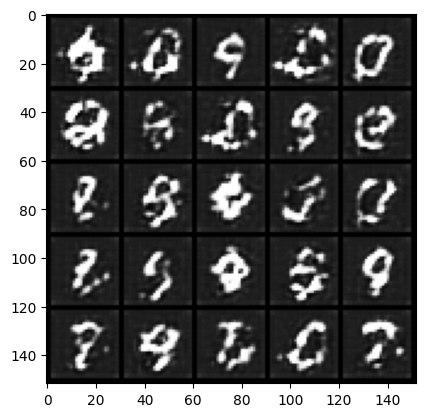

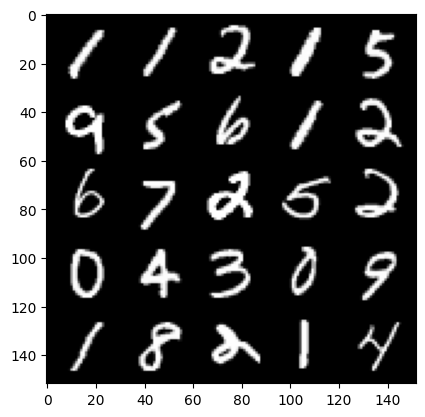

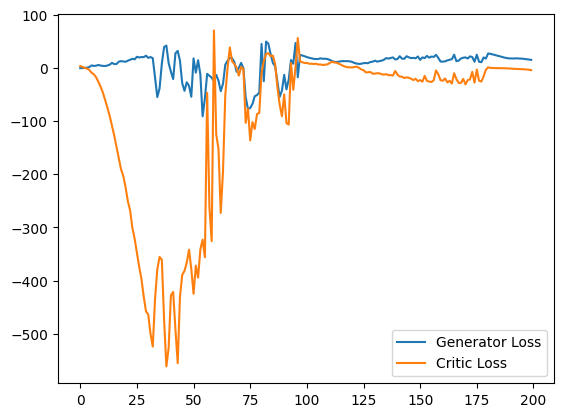

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3117896020412445
real: -6.987248420715332, fake: -14.69245719909668, regularization: 3.11789608001709
crit_loss: torch.Size([]) -4.587312698364258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24449802935123444
real: -7.009809970855713, fake: -14.505640029907227, regularization: 2.4449803829193115
crit_loss: torch.Size([]) -5.050849914550781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24949705600738525
real: -6.959895133972168, fake: -14.616199493408203, regularization: 2.4949705600738525
crit_loss: torch.Size([]) -5.161334037780762
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.180910125374794
real: -6.892704486846924, fake: -14.496362686157227, regularization: 1.8091012239456177
crit_loss: torch.Size([]) -5.794557094573975
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31017303466796875
real: -6.914702892303467, fake: -14.6873197555542, regularization: 3.1017303466796875
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3279110789299011
real: -8.162435531616211, fake: -16.147123336791992, regularization: 3.279110908508301
crit_loss: torch.Size([]) -4.7055768966674805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24046450853347778
real: -8.393331527709961, fake: -16.468551635742188, regularization: 2.4046449661254883
crit_loss: torch.Size([]) -5.670575141906738
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23868733644485474
real: -9.169673919677734, fake: -16.42439079284668, regularization: 2.386873245239258
crit_loss: torch.Size([]) -4.8678436279296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24752092361450195
real: -8.317648887634277, fake: -16.1269474029541, regularization: 2.4752092361450195
crit_loss: torch.Size([]) -5.334089279174805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16553792357444763
real: -7.234787464141846, fake: -14.721534729003906, regularization: 1.655379295349121


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5286803245544434
real: -6.359684944152832, fake: -15.557881355285645, regularization: 5.286803245544434
crit_loss: torch.Size([]) -3.911393165588379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33324116468429565
real: -6.098258972167969, fake: -15.167460441589355, regularization: 3.332411766052246
crit_loss: torch.Size([]) -5.736789703369141
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26768743991851807
real: -5.9103217124938965, fake: -15.563159942626953, regularization: 2.6768743991851807
crit_loss: torch.Size([]) -6.975963592529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29542943835258484
real: -6.086194038391113, fake: -16.08618927001953, regularization: 2.954294443130493
crit_loss: torch.Size([]) -7.045701026916504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31337082386016846
real: -6.755866050720215, fake: -16.410663604736328, regularization: 3.1337082386016846

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3424270451068878
real: -3.29327654838562, fake: -14.85306453704834, regularization: 3.4242703914642334
crit_loss: torch.Size([]) -8.135517120361328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43521565198898315
real: -7.418047904968262, fake: -14.435247421264648, regularization: 4.352156639099121
crit_loss: torch.Size([]) -2.6650428771972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.552192747592926
real: -5.327879428863525, fake: -13.773042678833008, regularization: 5.521927356719971
crit_loss: torch.Size([]) -2.92323637008667
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5162169933319092
real: -3.9407238960266113, fake: -14.130390167236328, regularization: 5.162169933319092
crit_loss: torch.Size([]) -5.027496814727783
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4541008174419403
real: -2.0991954803466797, fake: -13.815191268920898, regularization: 4.541007995605469
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48968082666397095
real: -0.3672841191291809, fake: -13.555885314941406, regularization: 4.89680814743042
crit_loss: torch.Size([]) -8.291793823242188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4536703824996948
real: -0.4509630799293518, fake: -14.100019454956055, regularization: 4.536704063415527
crit_loss: torch.Size([]) -9.11235237121582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47879117727279663
real: -0.20983684062957764, fake: -14.386956214904785, regularization: 4.787911891937256
crit_loss: torch.Size([]) -9.38920783996582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4383699893951416
real: -2.273918867111206, fake: -14.134212493896484, regularization: 4.383699893951416
crit_loss: torch.Size([]) -7.476593494415283
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.369891881942749
real: -0.0975460410118103, fake: -13.087124824523926, regularization: 3.6989188194274902
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8394746780395508
real: 1.7315404415130615, fake: -16.792526245117188, regularization: 8.394746780395508
crit_loss: torch.Size([]) -10.12932014465332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5665513277053833
real: 7.2831926345825195, fake: -11.683534622192383, regularization: 5.665513038635254
crit_loss: torch.Size([]) -13.301215171813965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6331366300582886
real: 8.697256088256836, fake: -11.007061958312988, regularization: 6.331366539001465
crit_loss: torch.Size([]) -13.372952461242676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7218748927116394
real: 6.004541873931885, fake: -14.837471008300781, regularization: 7.218749046325684
crit_loss: torch.Size([]) -13.623263359069824
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.50404953956604
real: 8.48447036743164, fake: -11.766040802001953, regularization: 5.0404953956604
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34961557388305664
real: 11.333767890930176, fake: -8.962334632873535, regularization: 3.4961557388305664
crit_loss: torch.Size([]) -16.799945831298828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6425943970680237
real: 13.584782600402832, fake: -9.009502410888672, regularization: 6.425943851470947
crit_loss: torch.Size([]) -16.1683406829834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5489239692687988
real: 8.482205390930176, fake: -11.57937240600586, regularization: 5.489239692687988
crit_loss: torch.Size([]) -14.57233715057373
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6955544948577881
real: 13.57819938659668, fake: -7.691927433013916, regularization: 6.955544948577881
crit_loss: torch.Size([]) -14.314580917358398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7447288632392883
real: 15.392696380615234, fake: -5.985172271728516, regularization: 7.447288513183594
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7075552940368652
real: -13.20252799987793, fake: -15.522871971130371, regularization: 17.07555389404297
crit_loss: torch.Size([]) 14.755209922790527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 4.5757622718811035
real: -18.35966682434082, fake: -23.196964263916016, regularization: 45.75762176513672
crit_loss: torch.Size([]) 40.920326232910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1943649053573608
real: -17.3244686126709, fake: -22.253097534179688, regularization: 11.943649291992188
crit_loss: torch.Size([]) 7.015020370483398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6297417879104614
real: -17.08141326904297, fake: -21.332502365112305, regularization: 6.297417640686035
crit_loss: torch.Size([]) 2.046328544616699
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.631801962852478
real: -17.743436813354492, fake: -21.26176643371582, regularization: 6.318019866943359
crit_los

real: -16.627090454101562, fake: -21.46541976928711, regularization: 1.8023722171783447
crit_loss: torch.Size([]) -3.035957098007202
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13162073493003845
real: -16.733325958251953, fake: -21.764862060546875, regularization: 1.3162074089050293
crit_loss: torch.Size([]) -3.7153286933898926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18421730399131775
real: -16.889148712158203, fake: -21.79736328125, regularization: 1.8421730995178223
crit_loss: torch.Size([]) -3.0660414695739746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13872772455215454
real: -16.660480499267578, fake: -21.28162956237793, regularization: 1.3872772455215454
crit_loss: torch.Size([]) -3.2338719367980957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16679781675338745
real: -16.401918411254883, fake: -21.200429916381836, regularization: 1.6679781675338745
crit_loss: torch.Size([]) -3.130533218383789
gradient_norm: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13875505328178406
real: -16.639808654785156, fake: -21.48871612548828, regularization: 1.3875505924224854
crit_loss: torch.Size([]) -3.4613568782806396
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19741760194301605
real: -16.297969818115234, fake: -21.118080139160156, regularization: 1.974176049232483
crit_loss: torch.Size([]) -2.8459343910217285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18060491979122162
real: -15.940147399902344, fake: -20.76191520690918, regularization: 1.8060492277145386
crit_loss: torch.Size([]) -3.015718460083008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14096373319625854
real: -15.770072937011719, fake: -20.63331413269043, regularization: 1.4096373319625854
crit_loss: torch.Size([]) -3.453603744506836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1465783715248108
real: -15.832489013671875, fake: -20.53219985961914, regularization: 1.46578371524

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17057986557483673
real: -14.073320388793945, fake: -19.49568748474121, regularization: 1.705798625946045
crit_loss: torch.Size([]) -3.7165684700012207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14211004972457886
real: -14.465099334716797, fake: -19.33411407470703, regularization: 1.4211004972457886
crit_loss: torch.Size([]) -3.4479141235351562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21503955125808716
real: -14.457500457763672, fake: -19.214370727539062, regularization: 2.150395393371582
crit_loss: torch.Size([]) -2.6064748764038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14008885622024536
real: -14.594532012939453, fake: -19.455211639404297, regularization: 1.4008885622024536
crit_loss: torch.Size([]) -3.4597911834716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1507922112941742
real: -14.710771560668945, fake: -19.554588317871094, regularization: 1.50792217

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1374569833278656
real: -14.34681510925293, fake: -19.698368072509766, regularization: 1.3745698928833008
crit_loss: torch.Size([]) -3.976983070373535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14852438867092133
real: -14.416691780090332, fake: -19.800554275512695, regularization: 1.4852439165115356
crit_loss: torch.Size([]) -3.898618698120117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19385680556297302
real: -14.5214262008667, fake: -20.260019302368164, regularization: 1.938568115234375
crit_loss: torch.Size([]) -3.80002498626709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1564810872077942
real: -14.994466781616211, fake: -20.4228572845459, regularization: 1.564810872077942
crit_loss: torch.Size([]) -3.863579750061035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17393562197685242
real: -14.674722671508789, fake: -19.970645904541016, regularization: 1.739356279373169
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23439544439315796
real: -12.697372436523438, fake: -19.08800506591797, regularization: 2.343954563140869
crit_loss: torch.Size([]) -4.046678066253662
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2784125804901123
real: -12.684085845947266, fake: -19.139726638793945, regularization: 2.784125804901123
crit_loss: torch.Size([]) -3.6715149879455566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2677062153816223
real: -12.58465576171875, fake: -19.269132614135742, regularization: 2.6770620346069336
crit_loss: torch.Size([]) -4.007414817810059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24451130628585815
real: -12.5033597946167, fake: -19.119346618652344, regularization: 2.445113182067871
crit_loss: torch.Size([]) -4.170873641967773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2574414312839508
real: -12.338445663452148, fake: -19.02703094482422, regularization: 2.5744142532348633


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.580985426902771
real: -4.938030242919922, fake: -15.698915481567383, regularization: 5.809854507446289
crit_loss: torch.Size([]) -4.951030731201172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3728972375392914
real: -4.443974018096924, fake: -15.146072387695312, regularization: 3.7289724349975586
crit_loss: torch.Size([]) -6.973126411437988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36735737323760986
real: -4.473197937011719, fake: -15.322479248046875, regularization: 3.6735737323760986
crit_loss: torch.Size([]) -7.175707817077637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3903197944164276
real: -3.4593775272369385, fake: -14.27294921875, regularization: 3.903198003768921
crit_loss: torch.Size([]) -6.910373687744141
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43526768684387207
real: -2.6552507877349854, fake: -13.912921905517578, regularization: 4.352676868438721
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32363995909690857
real: 10.021549224853516, fake: -14.019388198852539, regularization: 3.2363996505737305
crit_loss: torch.Size([]) -20.80453872680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5844377279281616
real: 12.404762268066406, fake: -11.486270904541016, regularization: 5.844377517700195
crit_loss: torch.Size([]) -18.046655654907227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5452414751052856
real: 15.839988708496094, fake: -9.723185539245605, regularization: 5.452414512634277
crit_loss: torch.Size([]) -20.110759735107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45700588822364807
real: 11.233665466308594, fake: -14.603757858276367, regularization: 4.570058822631836
crit_loss: torch.Size([]) -21.267364501953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5484976768493652
real: 10.459203720092773, fake: -10.720805168151855, regularization: 5.484976768493652


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.728378176689148
real: 16.1042423248291, fake: -7.5737833976745605, regularization: 7.283782005310059
crit_loss: torch.Size([]) -16.394245147705078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7111520767211914
real: 9.965738296508789, fake: -9.100561141967773, regularization: 7.111520767211914
crit_loss: torch.Size([]) -11.954778671264648
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6083698272705078
real: 8.675939559936523, fake: -15.99162483215332, regularization: 6.083698272705078
crit_loss: torch.Size([]) -18.583866119384766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4558877646923065
real: 15.051077842712402, fake: -10.336759567260742, regularization: 4.558877468109131
crit_loss: torch.Size([]) -20.82895851135254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6348621845245361
real: 18.57984161376953, fake: -8.586383819580078, regularization: 6.348621845245361
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4630894958972931
real: 19.497665405273438, fake: -5.516512393951416, regularization: 4.630895137786865
crit_loss: torch.Size([]) -20.383281707763672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6184259653091431
real: 15.568716049194336, fake: -7.773272514343262, regularization: 6.184259414672852
crit_loss: torch.Size([]) -17.15772819519043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.611503541469574
real: 13.259451866149902, fake: -10.577811241149902, regularization: 6.115035533905029
crit_loss: torch.Size([]) -17.722227096557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6058701276779175
real: 5.954312324523926, fake: -5.689149856567383, regularization: 6.058701515197754
crit_loss: torch.Size([]) -5.584760665893555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6225401759147644
real: 12.615607261657715, fake: -14.435327529907227, regularization: 6.225401878356934
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5823315382003784
real: -1.5122883319854736, fake: -8.79831314086914, regularization: 5.823315620422363
crit_loss: torch.Size([]) -1.4627094268798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7267769575119019
real: 15.749059677124023, fake: -10.574264526367188, regularization: 7.267769813537598
crit_loss: torch.Size([]) -19.055553436279297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42316150665283203
real: 4.1424946784973145, fake: -15.99126148223877, regularization: 4.23161506652832
crit_loss: torch.Size([]) -15.902141571044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5061667561531067
real: 11.122465133666992, fake: -13.80280876159668, regularization: 5.061667442321777
crit_loss: torch.Size([]) -19.863605499267578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5268945693969727
real: 18.91084861755371, fake: -4.644416809082031, regularization: 5.268945693969727
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6434632539749146
real: 12.867605209350586, fake: -14.678333282470703, regularization: 6.434632301330566
crit_loss: torch.Size([]) -21.111305236816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6333091855049133
real: 8.669839859008789, fake: -23.20561981201172, regularization: 6.333091735839844
crit_loss: torch.Size([]) -25.542367935180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6833232045173645
real: -20.989999771118164, fake: -12.788952827453613, regularization: 6.8332319259643555
crit_loss: torch.Size([]) 15.034278869628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8112959861755371
real: -6.968727111816406, fake: -7.198502540588379, regularization: 8.112959861755371
crit_loss: torch.Size([]) 7.883184432983398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5018693208694458
real: 7.4965715408325195, fake: -19.305335998535156, regularization: 5.018692970275879
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4604639410972595
real: -1.394101858139038, fake: -22.415145874023438, regularization: 4.604639530181885
crit_loss: torch.Size([]) -16.416404724121094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7940961122512817
real: -1.2617573738098145, fake: -20.31791877746582, regularization: 7.940960884094238
crit_loss: torch.Size([]) -11.115200996398926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.621558666229248
real: 2.446974277496338, fake: -19.950605392456055, regularization: 6.2155866622924805
crit_loss: torch.Size([]) -16.181991577148438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.587295413017273
real: 15.052803039550781, fake: -17.175899505615234, regularization: 5.872954368591309
crit_loss: torch.Size([]) -26.35574722290039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7468975782394409
real: 7.53104305267334, fake: -3.3620543479919434, regularization: 7.468976020812988
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5667400360107422
real: 14.241754531860352, fake: -14.01276969909668, regularization: 5.667400360107422
crit_loss: torch.Size([]) -22.58712387084961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0676791667938232
real: 19.10651969909668, fake: -5.822221279144287, regularization: 10.67679214477539
crit_loss: torch.Size([]) -14.251949310302734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7031393051147461
real: 2.983038902282715, fake: -21.430444717407227, regularization: 7.031393051147461
crit_loss: torch.Size([]) -17.382089614868164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9690146446228027
real: 19.51902198791504, fake: -7.919907093048096, regularization: 9.690146446228027
crit_loss: torch.Size([]) -17.748783111572266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45001569390296936
real: 13.116620063781738, fake: -15.84662914276123, regularization: 4.500156879425049
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4756373465061188
real: 15.86303997039795, fake: -11.087554931640625, regularization: 4.756373405456543
crit_loss: torch.Size([]) -22.19422149658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36820298433303833
real: 15.338424682617188, fake: -11.205711364746094, regularization: 3.6820297241210938
crit_loss: torch.Size([]) -22.862106323242188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6729432344436646
real: 17.38713836669922, fake: -9.909614562988281, regularization: 6.729432106018066
crit_loss: torch.Size([]) -20.56732177734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34763750433921814
real: 7.506965637207031, fake: -9.545280456542969, regularization: 3.476375102996826
crit_loss: torch.Size([]) -13.575870513916016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38609883189201355
real: 14.783143043518066, fake: -7.602634429931641, regularization: 3.8609883785247803
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5582577586174011
real: 15.253652572631836, fake: -16.778736114501953, regularization: 5.582577705383301
crit_loss: torch.Size([]) -26.449810028076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3071126341819763
real: 10.620153427124023, fake: -20.338356018066406, regularization: 3.0711264610290527
crit_loss: torch.Size([]) -27.88738250732422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8506110310554504
real: 19.021400451660156, fake: -14.805788040161133, regularization: 8.506110191345215
crit_loss: torch.Size([]) -25.321075439453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7569363117218018
real: 13.152195930480957, fake: -19.454586029052734, regularization: 7.569363117218018
crit_loss: torch.Size([]) -25.037418365478516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9680081605911255
real: 16.738248825073242, fake: -15.837491989135742, regularization: 9.680081367492676
c

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8444678783416748
real: 0.2679145336151123, fake: -15.087400436401367, regularization: 8.444679260253906
crit_loss: torch.Size([]) -6.910635948181152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6815646886825562
real: 9.969672203063965, fake: -9.882219314575195, regularization: 6.815647125244141
crit_loss: torch.Size([]) -13.036243438720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.63765949010849
real: 23.600505828857422, fake: 2.3368401527404785, regularization: 6.3765950202941895
crit_loss: torch.Size([]) -14.88707160949707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5379459261894226
real: 20.405746459960938, fake: -4.035595893859863, regularization: 5.379459381103516
crit_loss: torch.Size([]) -19.06188201904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5697659254074097
real: 15.123757362365723, fake: -10.428766250610352, regularization: 5.697659492492676
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5244022607803345
real: 14.420494079589844, fake: -6.736135005950928, regularization: 5.244022369384766
crit_loss: torch.Size([]) -15.912607192993164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5692083835601807
real: 17.8548583984375, fake: -5.106698036193848, regularization: 5.692083835601807
crit_loss: torch.Size([]) -17.269472122192383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4864880442619324
real: -1.3957761526107788, fake: -4.9134297370910645, regularization: 4.864880561828613
crit_loss: torch.Size([]) 1.3472270965576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6400420665740967
real: 13.21757698059082, fake: -9.434412002563477, regularization: 6.400420665740967
crit_loss: torch.Size([]) -16.251567840576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8737244606018066
real: -5.72501802444458, fake: -34.45668411254883, regularization: 8.737244606018066
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39206019043922424
real: -12.823671340942383, fake: -23.1295223236084, regularization: 3.9206018447875977
crit_loss: torch.Size([]) -6.385249137878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.721349835395813
real: -13.197444915771484, fake: -25.342823028564453, regularization: 7.213498115539551
crit_loss: torch.Size([]) -4.931879997253418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5876955986022949
real: -11.654109954833984, fake: -24.22808074951172, regularization: 5.876955986022949
crit_loss: torch.Size([]) -6.697014808654785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6609084606170654
real: -10.881172180175781, fake: -27.601608276367188, regularization: 6.609084606170654
crit_loss: torch.Size([]) -10.111351013183594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8548643589019775
real: -10.03018569946289, fake: -29.637521743774414, regularization: 8.548643112182617
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3963415026664734
real: 1.6094520092010498, fake: -15.856544494628906, regularization: 3.9634151458740234
crit_loss: torch.Size([]) -13.502580642700195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.513288140296936
real: 0.6641705632209778, fake: -16.179290771484375, regularization: 5.132881164550781
crit_loss: torch.Size([]) -11.710580825805664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5939714908599854
real: 1.6715466976165771, fake: -15.785896301269531, regularization: 5.9397149085998535
crit_loss: torch.Size([]) -11.517728805541992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4160546362400055
real: 2.884169101715088, fake: -13.929535865783691, regularization: 4.16054630279541
crit_loss: torch.Size([]) -12.653159141540527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29860976338386536
real: 2.8498892784118652, fake: -14.55965805053711, regularization: 2.986097574234009
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0161685943603516
real: 18.258052825927734, fake: -17.162086486816406, regularization: 10.161685943603516
crit_loss: torch.Size([]) -25.258453369140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5441607236862183
real: 21.95575714111328, fake: -12.475897789001465, regularization: 5.441607475280762
crit_loss: torch.Size([]) -28.990047454833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5202934145927429
real: 19.625370025634766, fake: -16.57268714904785, regularization: 5.202934265136719
crit_loss: torch.Size([]) -30.99512481689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7969910502433777
real: 5.427606105804443, fake: -10.952598571777344, regularization: 7.969910621643066
crit_loss: torch.Size([]) -8.410294532775879
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5772825479507446
real: 12.020744323730469, fake: -7.139490127563477, regularization: 5.772825241088867
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1473584175109863
real: 7.414669036865234, fake: -18.460670471191406, regularization: 21.473583221435547
crit_loss: torch.Size([]) -4.401756286621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8275798559188843
real: 22.442707061767578, fake: -1.9338274002075195, regularization: 8.275798797607422
crit_loss: torch.Size([]) -16.10073471069336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5535210371017456
real: 18.343353271484375, fake: -6.61678409576416, regularization: 5.535210609436035
crit_loss: torch.Size([]) -19.4249267578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7807483077049255
real: 20.471826553344727, fake: -7.156862258911133, regularization: 7.807483196258545
crit_loss: torch.Size([]) -19.821205139160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5101759433746338
real: 24.43035888671875, fake: -3.1246068477630615, regularization: 5.101759433746338
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5256121158599854
real: 21.635364532470703, fake: -6.341176986694336, regularization: 5.2561211585998535
crit_loss: torch.Size([]) -22.720420837402344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7608628273010254
real: 20.362560272216797, fake: -5.607330322265625, regularization: 7.608628273010254
crit_loss: torch.Size([]) -18.361263275146484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9242838621139526
real: 14.136621475219727, fake: -9.816854476928711, regularization: 9.242838859558105
crit_loss: torch.Size([]) -14.710637092590332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4800758957862854
real: 19.936206817626953, fake: -5.021910667419434, regularization: 4.8007588386535645
crit_loss: torch.Size([]) -20.157360076904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4603375792503357
real: 21.356910705566406, fake: -4.621281623840332, regularization: 4.6033759117126465
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43100738525390625
real: 17.912538528442383, fake: -9.87204647064209, regularization: 4.3100738525390625
crit_loss: torch.Size([]) -23.474510192871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46094810962677
real: 15.53687858581543, fake: -11.892593383789062, regularization: 4.609480857849121
crit_loss: torch.Size([]) -22.819992065429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42806392908096313
real: 18.162311553955078, fake: -8.52548599243164, regularization: 4.280639171600342
crit_loss: torch.Size([]) -22.40715789794922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4264647960662842
real: 18.6236572265625, fake: -11.518142700195312, regularization: 4.264647960662842
crit_loss: torch.Size([]) -25.877151489257812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6955583095550537
real: 3.08036208152771, fake: -8.822454452514648, regularization: 6.955583095550537
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.870311975479126
real: 9.310504913330078, fake: -15.660293579101562, regularization: 8.703119277954102
crit_loss: torch.Size([]) -16.26767921447754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8873789310455322
real: 29.29288101196289, fake: 2.6924614906311035, regularization: 8.873788833618164
crit_loss: torch.Size([]) -17.72663116455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5161559581756592
real: 18.995555877685547, fake: -11.91047477722168, regularization: 5.161559581756592
crit_loss: torch.Size([]) -25.744470596313477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7668478488922119
real: 12.660393714904785, fake: -14.242300987243652, regularization: 7.668478488922119
crit_loss: torch.Size([]) -19.234216690063477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2275458574295044
real: 22.325580596923828, fake: -7.082204818725586, regularization: 12.275458335876465
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6435471773147583
real: 16.611862182617188, fake: -3.813546895980835, regularization: 6.435471534729004
crit_loss: torch.Size([]) -13.989937782287598
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5046826601028442
real: 8.873132705688477, fake: -17.000865936279297, regularization: 5.046826362609863
crit_loss: torch.Size([]) -20.827171325683594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38702893257141113
real: 13.16102123260498, fake: -14.21441650390625, regularization: 3.8702893257141113
crit_loss: torch.Size([]) -23.505149841308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7297084927558899
real: 22.041099548339844, fake: -5.3835248947143555, regularization: 7.297084808349609
crit_loss: torch.Size([]) -20.127540588378906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6778509616851807
real: 0.4740109443664551, fake: -12.184964179992676, regularization: 6.778509616851807
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6693364977836609
real: 28.41675567626953, fake: 0.04676412045955658, regularization: 6.693365097045898
crit_loss: torch.Size([]) -21.676626205444336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6971744894981384
real: 11.299150466918945, fake: -8.726122856140137, regularization: 6.971745014190674
crit_loss: torch.Size([]) -13.05352783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6323418617248535
real: 9.038980484008789, fake: -17.274946212768555, regularization: 6.323418617248535
crit_loss: torch.Size([]) -19.990509033203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8121342658996582
real: 20.17384147644043, fake: -9.949711799621582, regularization: 8.121342658996582
crit_loss: torch.Size([]) -22.002212524414062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5225398540496826
real: 23.18064308166504, fake: -7.205774784088135, regularization: 5.225398540496826
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23852421343326569
real: -18.921348571777344, fake: -24.55103302001953, regularization: 2.385242223739624
crit_loss: torch.Size([]) -3.2444422245025635
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2505822479724884
real: -19.05385398864746, fake: -24.711849212646484, regularization: 2.5058224201202393
crit_loss: torch.Size([]) -3.152172803878784
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2783479392528534
real: -19.238880157470703, fake: -25.115150451660156, regularization: 2.7834794521331787
crit_loss: torch.Size([]) -3.0927908420562744
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2687775492668152
real: -19.627277374267578, fake: -24.882266998291016, regularization: 2.6877756118774414
crit_loss: torch.Size([]) -2.567214012145996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24952593445777893
real: -19.800628662109375, fake: -25.079612731933594, regularization: 2.49525928497

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2628732919692993
real: -18.510955810546875, fake: -24.48050880432129, regularization: 2.628732919692993
crit_loss: torch.Size([]) -3.340820074081421
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2729567289352417
real: -18.232027053833008, fake: -24.39319610595703, regularization: 2.729567289352417
crit_loss: torch.Size([]) -3.4316017627716064
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24571970105171204
real: -17.997264862060547, fake: -23.715999603271484, regularization: 2.4571969509124756
crit_loss: torch.Size([]) -3.261537790298462
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2294626533985138
real: -17.800514221191406, fake: -23.774898529052734, regularization: 2.294626474380493
crit_loss: torch.Size([]) -3.679757833480835
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2790541648864746
real: -17.65892791748047, fake: -23.63469123840332, regularization: 2.790541648864746
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25185492634773254
real: -16.63336181640625, fake: -23.837055206298828, regularization: 2.5185492038726807
crit_loss: torch.Size([]) -4.685144424438477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33655521273612976
real: -16.357975006103516, fake: -23.915634155273438, regularization: 3.3655521869659424
crit_loss: torch.Size([]) -4.192107200622559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29832595586776733
real: -16.694150924682617, fake: -23.391326904296875, regularization: 2.983259677886963
crit_loss: torch.Size([]) -3.713916301727295
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37113916873931885
real: -16.696264266967773, fake: -23.277973175048828, regularization: 3.7113916873931885
crit_loss: torch.Size([]) -2.870317220687866
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3035792112350464
real: -17.04401206970215, fake: -23.69761085510254, regularization: 3.035792112350

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48402634263038635
real: -10.020745277404785, fake: -22.359718322753906, regularization: 4.840263366699219
crit_loss: torch.Size([]) -7.498709678649902
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3055703043937683
real: -8.586065292358398, fake: -21.92865753173828, regularization: 3.0557031631469727
crit_loss: torch.Size([]) -10.28688907623291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48165610432624817
real: -7.623185634613037, fake: -22.18933868408203, regularization: 4.816561222076416
crit_loss: torch.Size([]) -9.749591827392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3094993829727173
real: -7.328281402587891, fake: -22.6036376953125, regularization: 3.094993829727173
crit_loss: torch.Size([]) -12.180362701416016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24984857439994812
real: -8.457599639892578, fake: -22.261123657226562, regularization: 2.498485803604126
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7221021056175232
real: 17.750267028808594, fake: -13.780381202697754, regularization: 7.2210211753845215
crit_loss: torch.Size([]) -24.30962562561035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6962385773658752
real: -3.4883577823638916, fake: -7.06248664855957, regularization: 6.962385654449463
crit_loss: torch.Size([]) 3.388256788253784
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45788103342056274
real: -3.0779244899749756, fake: -11.643476486206055, regularization: 4.578810214996338
crit_loss: torch.Size([]) -3.986741542816162
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7045060396194458
real: -1.8459620475769043, fake: -13.448583602905273, regularization: 7.045060157775879
crit_loss: torch.Size([]) -4.557560920715332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5795081853866577
real: 8.620524406433105, fake: -11.853010177612305, regularization: 5.795082092285156
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8476134538650513
real: 17.08272933959961, fake: -6.900084018707275, regularization: 8.476134300231934
crit_loss: torch.Size([]) -15.506678581237793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5180169343948364
real: 14.910992622375488, fake: -11.388093948364258, regularization: 5.180169105529785
crit_loss: torch.Size([]) -21.118919372558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36497950553894043
real: 21.139467239379883, fake: -4.250484466552734, regularization: 3.6497950553894043
crit_loss: torch.Size([]) -21.740156173706055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5890864729881287
real: 13.184045791625977, fake: -5.915589332580566, regularization: 5.890864849090576
crit_loss: torch.Size([]) -13.208770751953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5895709991455078
real: 21.857454299926758, fake: -4.298519134521484, regularization: 5.895709991455078
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3172180652618408
real: -3.9060301780700684, fake: -19.3699951171875, regularization: 3.172180652618408
crit_loss: torch.Size([]) -12.291784286499023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36206966638565063
real: 0.5738779306411743, fake: -16.370609283447266, regularization: 3.620696544647217
crit_loss: torch.Size([]) -13.323789596557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9108418822288513
real: 15.492223739624023, fake: -4.5258097648620605, regularization: 9.108418464660645
crit_loss: torch.Size([]) -10.909615516662598
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6445051431655884
real: 20.812068939208984, fake: -2.9366350173950195, regularization: 6.445051193237305
crit_loss: torch.Size([]) -17.303651809692383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5011014938354492
real: 21.653303146362305, fake: -2.1846859455108643, regularization: 5.011014938354492
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6427409648895264
real: 23.832866668701172, fake: -14.760912895202637, regularization: 6.427409648895264
crit_loss: torch.Size([]) -32.1663703918457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6050436496734619
real: 20.774036407470703, fake: -16.533313751220703, regularization: 6.050436496734619
crit_loss: torch.Size([]) -31.256914138793945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4168854057788849
real: -10.25493335723877, fake: -16.594465255737305, regularization: 4.168854236602783
crit_loss: torch.Size([]) -2.170677661895752
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6610512137413025
real: -13.306159973144531, fake: -20.227807998657227, regularization: 6.6105122566223145
crit_loss: torch.Size([]) -0.31113576889038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7017276287078857
real: -13.772422790527344, fake: -22.60207748413086, regularization: 7.017276287078857
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5129287242889404
real: 4.285407066345215, fake: -14.628772735595703, regularization: 5.129287242889404
crit_loss: torch.Size([]) -13.784893035888672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6320099234580994
real: 13.91418170928955, fake: -7.782114028930664, regularization: 6.320099353790283
crit_loss: torch.Size([]) -15.376197814941406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3858731687068939
real: 11.265764236450195, fake: -12.018583297729492, regularization: 3.858731746673584
crit_loss: torch.Size([]) -19.425615310668945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5999534726142883
real: 8.091039657592773, fake: -16.15582275390625, regularization: 5.999534606933594
crit_loss: torch.Size([]) -18.24732780456543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48830127716064453
real: 10.998615264892578, fake: -10.550543785095215, regularization: 4.883012771606445
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4780130982398987
real: 26.15614128112793, fake: -7.508116245269775, regularization: 4.780130863189697
crit_loss: torch.Size([]) -28.884126663208008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.516623854637146
real: 17.87483024597168, fake: -14.782550811767578, regularization: 5.166238784790039
crit_loss: torch.Size([]) -27.491140365600586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5834788084030151
real: 25.786548614501953, fake: -10.899823188781738, regularization: 5.8347883224487305
crit_loss: torch.Size([]) -30.851581573486328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3500833809375763
real: 27.307214736938477, fake: -8.829521179199219, regularization: 3.500833749771118
crit_loss: torch.Size([]) -32.63589859008789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3144887685775757
real: 25.18251609802246, fake: -10.384322166442871, regularization: 3.144887685775757
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.631507158279419
real: 23.961402893066406, fake: -7.35381555557251, regularization: 6.3150715827941895
crit_loss: torch.Size([]) -25.000146865844727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4912485182285309
real: 18.519393920898438, fake: -12.981087684631348, regularization: 4.912485122680664
crit_loss: torch.Size([]) -26.587995529174805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6275898218154907
real: 24.906513214111328, fake: -10.145149230957031, regularization: 6.275897979736328
crit_loss: torch.Size([]) -28.77576446533203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41150838136672974
real: 20.685379028320312, fake: -12.985498428344727, regularization: 4.115083694458008
crit_loss: torch.Size([]) -29.5557918548584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.613390326499939
real: 23.6488037109375, fake: -1.4755945205688477, regularization: 6.133903503417969
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6461524367332458
real: 20.73248863220215, fake: -9.01910400390625, regularization: 6.461524486541748
crit_loss: torch.Size([]) -23.290067672729492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5689603090286255
real: 7.555732250213623, fake: -9.81893539428711, regularization: 5.689602851867676
crit_loss: torch.Size([]) -11.685065269470215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.841781497001648
real: 16.00747299194336, fake: -7.190779209136963, regularization: 8.417815208435059
crit_loss: torch.Size([]) -14.780436515808105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6332647204399109
real: 17.451866149902344, fake: -9.46062183380127, regularization: 6.332647323608398
crit_loss: torch.Size([]) -20.5798397064209
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4905327558517456
real: 15.33574104309082, fake: -10.896613121032715, regularization: 4.905327796936035
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6203724145889282
real: 16.210187911987305, fake: -11.119901657104492, regularization: 6.203723907470703
crit_loss: torch.Size([]) -21.126365661621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7026265859603882
real: 17.108089447021484, fake: -9.953659057617188, regularization: 7.026266098022461
crit_loss: torch.Size([]) -20.03548240661621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6156208515167236
real: 18.724807739257812, fake: -10.496095657348633, regularization: 6.156208515167236
crit_loss: torch.Size([]) -23.064695358276367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35651397705078125
real: -4.962276458740234, fake: -8.02561092376709, regularization: 3.5651397705078125
crit_loss: torch.Size([]) 0.501805305480957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8067981004714966
real: -7.612340450286865, fake: -21.41033935546875, regularization: 8.067980766296387
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5414457321166992
real: 3.021432876586914, fake: -3.216909408569336, regularization: 5.414457321166992
crit_loss: torch.Size([]) -0.8238849639892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3659675717353821
real: 18.094881057739258, fake: -12.389433860778809, regularization: 3.6596755981445312
crit_loss: torch.Size([]) -26.82463836669922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3960171937942505
real: 9.158870697021484, fake: -18.058876037597656, regularization: 3.960171937942505
crit_loss: torch.Size([]) -23.2575740814209
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49313756823539734
real: 19.80611228942871, fake: -11.911355972290039, regularization: 4.931375503540039
crit_loss: torch.Size([]) -26.78609275817871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8320375084877014
real: 23.79574966430664, fake: -8.205204963684082, regularization: 8.320375442504883
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.599290132522583
real: 17.48047637939453, fake: -9.6913480758667, regularization: 5.99290132522583
crit_loss: torch.Size([]) -21.178924560546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39606860280036926
real: 23.426536560058594, fake: -5.238254070281982, regularization: 3.960685968399048
crit_loss: torch.Size([]) -24.704105377197266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47852712869644165
real: 20.754575729370117, fake: -7.732844829559326, regularization: 4.785271167755127
crit_loss: torch.Size([]) -23.702150344848633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5199065208435059
real: 20.09514617919922, fake: -8.781754493713379, regularization: 5.199065208435059
crit_loss: torch.Size([]) -23.677833557128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49437493085861206
real: -4.197897911071777, fake: -8.170004844665527, regularization: 4.94374942779541
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34270936250686646
real: 22.521770477294922, fake: -5.054981231689453, regularization: 3.427093505859375
crit_loss: torch.Size([]) -24.149658203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5752691030502319
real: 20.319355010986328, fake: -3.893366813659668, regularization: 5.752691268920898
crit_loss: torch.Size([]) -18.460031509399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.504949152469635
real: 16.41286277770996, fake: -10.914054870605469, regularization: 5.0494914054870605
crit_loss: torch.Size([]) -22.27742576599121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4020101726055145
real: 17.624561309814453, fake: -9.046490669250488, regularization: 4.020101547241211
crit_loss: torch.Size([]) -22.650949478149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5495639443397522
real: 18.329334259033203, fake: -8.940555572509766, regularization: 5.495639324188232
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4662414789199829
real: 15.414350509643555, fake: -14.005355834960938, regularization: 4.66241455078125
crit_loss: torch.Size([]) -24.757291793823242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5814387798309326
real: 26.140161514282227, fake: -4.531744956970215, regularization: 5.814387798309326
crit_loss: torch.Size([]) -24.85751724243164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6253209114074707
real: 19.536334991455078, fake: -13.356005668640137, regularization: 6.253209114074707
crit_loss: torch.Size([]) -26.63913345336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4512145519256592
real: 22.65240478515625, fake: -8.2465181350708, regularization: 4.512145519256592
crit_loss: torch.Size([]) -26.386775970458984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36269766092300415
real: 15.233989715576172, fake: -17.873720169067383, regularization: 3.626976490020752
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4204148054122925
real: 7.726759433746338, fake: -5.007715225219727, regularization: 4.204148292541504
crit_loss: torch.Size([]) -8.530325889587402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44847315549850464
real: 22.118560791015625, fake: -13.120681762695312, regularization: 4.484731674194336
crit_loss: torch.Size([]) -30.7545108795166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9841554164886475
real: 18.501209259033203, fake: -15.851512908935547, regularization: 9.841554641723633
crit_loss: torch.Size([]) -24.511167526245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3962196111679077
real: 27.99128532409668, fake: -8.79934310913086, regularization: 3.962196111679077
crit_loss: torch.Size([]) -32.82843017578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6229174137115479
real: 24.718948364257812, fake: -11.741537094116211, regularization: 6.2291741371154785
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7322732210159302
real: 26.18681526184082, fake: -8.623701095581055, regularization: 7.322731971740723
crit_loss: torch.Size([]) -27.48778533935547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.695180058479309
real: 16.48341941833496, fake: -20.537498474121094, regularization: 16.951801300048828
crit_loss: torch.Size([]) -20.06911849975586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7184714674949646
real: 27.832111358642578, fake: 1.0851081609725952, regularization: 7.1847147941589355
crit_loss: torch.Size([]) -19.562288284301758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5729997158050537
real: 21.664884567260742, fake: -9.524222373962402, regularization: 5.729997158050537
crit_loss: torch.Size([]) -25.459108352661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5430158376693726
real: 20.711746215820312, fake: -10.544536590576172, regularization: 5.430158615112305
crit_lo

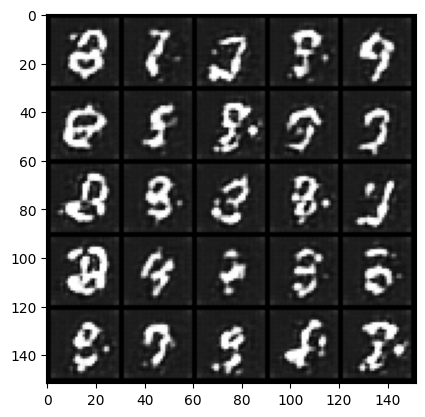

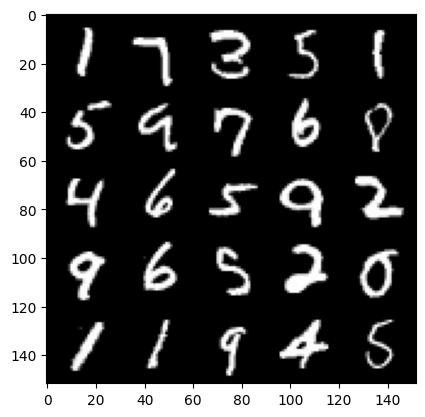

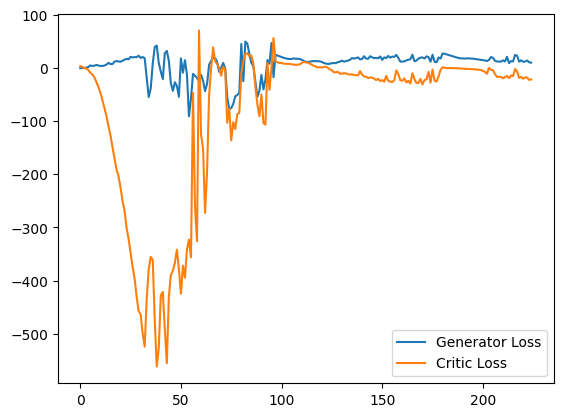

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9237194061279297
real: 18.79967498779297, fake: -7.452671051025391, regularization: 9.237194061279297
crit_loss: torch.Size([]) -17.015151977539062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4024088382720947
real: 20.678050994873047, fake: -7.737049102783203, regularization: 4.024088382720947
crit_loss: torch.Size([]) -24.39101219177246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4484848380088806
real: 18.775388717651367, fake: -7.902085304260254, regularization: 4.484848499298096
crit_loss: torch.Size([]) -22.192626953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5274968147277832
real: 23.67006492614746, fake: -4.715898513793945, regularization: 5.274968147277832
crit_loss: torch.Size([]) -23.11099624633789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4957846701145172
real: 21.994735717773438, fake: -8.41873550415039, regularization: 4.957846641540527
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4516698122024536
real: 20.832111358642578, fake: -3.033761501312256, regularization: 4.516697883605957
crit_loss: torch.Size([]) -19.34917449951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0334588289260864
real: 20.846939086914062, fake: -4.091707229614258, regularization: 10.334588050842285
crit_loss: torch.Size([]) -14.604058265686035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7269981503486633
real: 14.625728607177734, fake: -12.559089660644531, regularization: 7.269981384277344
crit_loss: torch.Size([]) -19.914836883544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8397972583770752
real: 23.75580596923828, fake: -1.9248275756835938, regularization: 8.397972106933594
crit_loss: torch.Size([]) -17.28266143798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4451867341995239
real: 20.56839370727539, fake: -6.794351100921631, regularization: 4.45186710357666
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4494000971317291
real: 22.622434616088867, fake: -8.029036521911621, regularization: 4.4940009117126465
crit_loss: torch.Size([]) -26.157468795776367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46722412109375
real: 27.373035430908203, fake: -0.8751909732818604, regularization: 4.6722412109375
crit_loss: torch.Size([]) -23.575984954833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5935839414596558
real: 18.82644271850586, fake: -12.390572547912598, regularization: 5.935839653015137
crit_loss: torch.Size([]) -25.281173706054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3637033700942993
real: 22.30400276184082, fake: -9.616602897644043, regularization: 3.637033700942993
crit_loss: torch.Size([]) -28.283571243286133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9926972389221191
real: 16.78691864013672, fake: -5.159484386444092, regularization: 9.926972389221191
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9980361461639404
real: 18.117765426635742, fake: -14.229318618774414, regularization: 9.980361938476562
crit_loss: torch.Size([]) -22.366722106933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31381696462631226
real: 9.577465057373047, fake: -5.847413539886475, regularization: 3.138169765472412
crit_loss: torch.Size([]) -12.28670883178711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3861508071422577
real: 21.944355010986328, fake: -1.683931827545166, regularization: 3.8615081310272217
crit_loss: torch.Size([]) -19.76677894592285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2890174388885498
real: 18.800640106201172, fake: -12.430529594421387, regularization: 12.890174865722656
crit_loss: torch.Size([]) -18.34099578857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6017075777053833
real: 14.459798812866211, fake: -21.75420379638672, regularization: 6.017075538635254
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7301574945449829
real: 27.50156021118164, fake: -3.9744529724121094, regularization: 7.30157470703125
crit_loss: torch.Size([]) -24.1744384765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7416589260101318
real: 10.209224700927734, fake: -17.828567504882812, regularization: 7.416589260101318
crit_loss: torch.Size([]) -20.62120246887207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7169578075408936
real: 20.681039810180664, fake: -14.367132186889648, regularization: 7.1695780754089355
crit_loss: torch.Size([]) -27.87859344482422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5386661291122437
real: 27.0216064453125, fake: -8.694631576538086, regularization: 5.386661529541016
crit_loss: torch.Size([]) -30.329578399658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7678935527801514
real: 11.530256271362305, fake: -9.471822738647461, regularization: 7.678935527801514
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36434611678123474
real: 9.527019500732422, fake: -6.016051769256592, regularization: 3.643461227416992
crit_loss: torch.Size([]) -11.89961051940918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37103337049484253
real: 16.888153076171875, fake: -3.269740104675293, regularization: 3.710333824157715
crit_loss: torch.Size([]) -16.447559356689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5970218181610107
real: 19.234771728515625, fake: -2.567622661590576, regularization: 5.970218181610107
crit_loss: torch.Size([]) -15.832176208496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5080239176750183
real: 19.35360336303711, fake: -4.763591766357422, regularization: 5.080239295959473
crit_loss: torch.Size([]) -19.036956787109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40979069471359253
real: 21.22829818725586, fake: -2.625295639038086, regularization: 4.097907066345215
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5649979114532471
real: 27.944311141967773, fake: -13.516664505004883, regularization: 5.649979114532471
crit_loss: torch.Size([]) -35.810997009277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4556232690811157
real: 31.320096969604492, fake: -10.017107009887695, regularization: 4.556232452392578
crit_loss: torch.Size([]) -36.78097152709961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6012265682220459
real: 24.613449096679688, fake: -16.21694564819336, regularization: 6.012265682220459
crit_loss: torch.Size([]) -34.81813049316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5132670402526855
real: 1.824062466621399, fake: -10.119508743286133, regularization: 5.1326704025268555
crit_loss: torch.Size([]) -6.810900688171387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4933505654335022
real: 7.441973686218262, fake: -5.711369514465332, regularization: 4.933505535125732
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37040650844573975
real: 20.101398468017578, fake: -4.748994827270508, regularization: 3.7040650844573975
crit_loss: torch.Size([]) -21.14632797241211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22272609174251556
real: 21.03546142578125, fake: -6.747591972351074, regularization: 2.2272608280181885
crit_loss: torch.Size([]) -25.55579376220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.551598072052002
real: 17.413076400756836, fake: -11.282487869262695, regularization: 5.5159807205200195
crit_loss: torch.Size([]) -23.179584503173828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40138185024261475
real: 24.438674926757812, fake: -6.58420991897583, regularization: 4.013818740844727
crit_loss: torch.Size([]) -27.009065628051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3191888928413391
real: 21.742263793945312, fake: -8.655708312988281, regularization: 3.1918888092041016
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38582542538642883
real: 18.303850173950195, fake: -12.586400032043457, regularization: 3.8582541942596436
crit_loss: torch.Size([]) -27.031997680664062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33305078744888306
real: 20.08014678955078, fake: -11.97585391998291, regularization: 3.330507755279541
crit_loss: torch.Size([]) -28.725492477416992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34829312562942505
real: 6.469724655151367, fake: -6.301309585571289, regularization: 3.482931137084961
crit_loss: torch.Size([]) -9.288103103637695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7063713073730469
real: 9.132444381713867, fake: -12.298002243041992, regularization: 7.063713073730469
crit_loss: torch.Size([]) -14.36673355102539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8122023940086365
real: 24.028440475463867, fake: -9.76988697052002, regularization: 8.122023582458496
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3517029583454132
real: 23.093433380126953, fake: -6.3851728439331055, regularization: 3.5170295238494873
crit_loss: torch.Size([]) -25.961578369140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3132413625717163
real: 22.39796257019043, fake: -9.248628616333008, regularization: 3.132413625717163
crit_loss: torch.Size([]) -28.514177322387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8614733219146729
real: 21.990692138671875, fake: -9.247380256652832, regularization: 8.61473274230957
crit_loss: torch.Size([]) -22.62333869934082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5502638816833496
real: 22.163978576660156, fake: -9.218436241149902, regularization: 5.502638816833496
crit_loss: torch.Size([]) -25.879776000976562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48340216279029846
real: 18.277599334716797, fake: -0.14989501237869263, regularization: 4.83402156829834
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.355431467294693
real: -8.102428436279297, fake: -18.57064437866211, regularization: 3.554314613342285
crit_loss: torch.Size([]) -6.913901329040527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31518563628196716
real: -6.588800430297852, fake: -17.998201370239258, regularization: 3.1518564224243164
crit_loss: torch.Size([]) -8.25754451751709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47599557042121887
real: -5.701671600341797, fake: -17.774139404296875, regularization: 4.759955883026123
crit_loss: torch.Size([]) -7.312511920928955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18537336587905884
real: -5.090659141540527, fake: -18.10152816772461, regularization: 1.8537336587905884
crit_loss: torch.Size([]) -11.157135009765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49088528752326965
real: -4.307753562927246, fake: -18.372987747192383, regularization: 4.908853054046631
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4250051975250244
real: 22.998310089111328, fake: -6.787439346313477, regularization: 4.250051975250244
crit_loss: torch.Size([]) -25.53569793701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49499648809432983
real: 21.716657638549805, fake: -13.487398147583008, regularization: 4.949965000152588
crit_loss: torch.Size([]) -30.254091262817383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.425922155380249
real: 21.819168090820312, fake: -12.215686798095703, regularization: 4.25922155380249
crit_loss: torch.Size([]) -29.775632858276367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.435188353061676
real: 6.787686824798584, fake: -5.668900489807129, regularization: 4.351883411407471
crit_loss: torch.Size([]) -8.104703903198242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4642893671989441
real: 22.24156379699707, fake: -6.532567977905273, regularization: 4.6428937911987305
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2975451350212097
real: 8.531105041503906, fake: -2.009054660797119, regularization: 2.9754514694213867
crit_loss: torch.Size([]) -7.5647077560424805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4489195644855499
real: 20.10920524597168, fake: -5.297752380371094, regularization: 4.489195823669434
crit_loss: torch.Size([]) -20.917762756347656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6626456379890442
real: 13.233146667480469, fake: -18.895986557006836, regularization: 6.626456260681152
crit_loss: torch.Size([]) -25.50267791748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6260061264038086
real: 13.457189559936523, fake: -21.8353214263916, regularization: 6.260061264038086
crit_loss: torch.Size([]) -29.03244972229004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4511631727218628
real: 25.041688919067383, fake: -10.09532642364502, regularization: 4.511631965637207
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45952969789505005
real: 19.063478469848633, fake: -12.840156555175781, regularization: 4.595296859741211
crit_loss: torch.Size([]) -27.308338165283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5990670323371887
real: 25.989248275756836, fake: -7.088722229003906, regularization: 5.990670204162598
crit_loss: torch.Size([]) -27.087303161621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4431365132331848
real: 26.268394470214844, fake: -6.067905426025391, regularization: 4.431365013122559
crit_loss: torch.Size([]) -27.90493392944336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.378937304019928
real: 6.824035167694092, fake: -7.4570231437683105, regularization: 3.7893729209899902
crit_loss: torch.Size([]) -10.49168586730957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34110227227211
real: 23.887210845947266, fake: -5.371955394744873, regularization: 3.411022663116455
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7999794483184814
real: -4.57266092300415, fake: -25.446914672851562, regularization: 7.9997944831848145
crit_loss: torch.Size([]) -12.874460220336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6786417961120605
real: 15.299298286437988, fake: -7.929934501647949, regularization: 16.786418914794922
crit_loss: torch.Size([]) -6.442813873291016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7711026072502136
real: 11.597539901733398, fake: -12.78410816192627, regularization: 7.711026191711426
crit_loss: torch.Size([]) -16.670623779296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4835186302661896
real: 19.682575225830078, fake: -8.959566116333008, regularization: 4.83518648147583
crit_loss: torch.Size([]) -23.806955337524414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5716131925582886
real: 26.457698822021484, fake: -5.466073036193848, regularization: 5.716132164001465
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.430614173412323
real: 21.79182243347168, fake: -10.681766510009766, regularization: 4.3061418533325195
crit_loss: torch.Size([]) -28.16744613647461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4881836175918579
real: 21.385051727294922, fake: -9.031657218933105, regularization: 4.8818359375
crit_loss: torch.Size([]) -25.534873962402344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44899147748947144
real: 0.759845495223999, fake: -6.4392266273498535, regularization: 4.489914894104004
crit_loss: torch.Size([]) -2.7091569900512695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3624195456504822
real: 22.512710571289062, fake: -9.559154510498047, regularization: 3.6241955757141113
crit_loss: torch.Size([]) -28.447669982910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32565996050834656
real: 11.876506805419922, fake: -16.0076904296875, regularization: 3.2565996646881104
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4647853374481201
real: 20.104402542114258, fake: -7.799439430236816, regularization: 4.647853374481201
crit_loss: torch.Size([]) -23.25598907470703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5652382969856262
real: 14.375839233398438, fake: -12.276239395141602, regularization: 5.652382850646973
crit_loss: torch.Size([]) -20.99969482421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2992774248123169
real: 16.550365447998047, fake: -12.987052917480469, regularization: 2.992774248123169
crit_loss: torch.Size([]) -26.54464340209961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42414969205856323
real: 26.229732513427734, fake: -4.550413131713867, regularization: 4.241497039794922
crit_loss: torch.Size([]) -26.53864860534668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7358802556991577
real: 0.628339409828186, fake: -6.895295143127441, regularization: 7.358802795410156
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5132572054862976
real: 17.615440368652344, fake: -12.55264663696289, regularization: 5.132572174072266
crit_loss: torch.Size([]) -25.03551483154297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.456820011138916
real: 19.706430435180664, fake: -8.87578010559082, regularization: 4.56820011138916
crit_loss: torch.Size([]) -24.01401138305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5443655252456665
real: 27.88046646118164, fake: -1.3517515659332275, regularization: 5.443655014038086
crit_loss: torch.Size([]) -23.788562774658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5669268369674683
real: 22.135900497436523, fake: -11.799800872802734, regularization: 5.669268608093262
crit_loss: torch.Size([]) -28.266429901123047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7154684066772461
real: 18.830249786376953, fake: -12.241266250610352, regularization: 7.154684066772461
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4539613723754883
real: 29.027603149414062, fake: 1.7749574184417725, regularization: 4.539613723754883
crit_loss: torch.Size([]) -22.713031768798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5593181848526001
real: 25.937938690185547, fake: -3.417424201965332, regularization: 5.593181610107422
crit_loss: torch.Size([]) -23.76218032836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5102390050888062
real: 31.084461212158203, fake: 2.337043046951294, regularization: 5.102390289306641
crit_loss: torch.Size([]) -23.64502716064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4281100332736969
real: 13.730856895446777, fake: -1.0812935829162598, regularization: 4.281100273132324
crit_loss: torch.Size([]) -10.531050682067871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5401318073272705
real: 22.503704071044922, fake: -8.132524490356445, regularization: 5.401318073272705
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3224638104438782
real: 22.269960403442383, fake: -3.086300849914551, regularization: 3.224637985229492
crit_loss: torch.Size([]) -22.131624221801758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5622525811195374
real: 22.99215316772461, fake: -6.524483680725098, regularization: 5.622525691986084
crit_loss: torch.Size([]) -23.89410972595215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2932336926460266
real: 21.117935180664062, fake: -9.557596206665039, regularization: 2.9323368072509766
crit_loss: torch.Size([]) -27.743194580078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35669219493865967
real: 18.57574462890625, fake: -13.698902130126953, regularization: 3.5669219493865967
crit_loss: torch.Size([]) -28.707725524902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29832345247268677
real: 22.83648681640625, fake: -8.818625450134277, regularization: 2.983234405517578
crit_

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5986431837081909
real: 26.106124877929688, fake: -1.9838335514068604, regularization: 5.986432075500488
crit_loss: torch.Size([]) -22.103527069091797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7484564781188965
real: 25.522079467773438, fake: -7.20351505279541, regularization: 7.484564781188965
crit_loss: torch.Size([]) -25.24102783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6108264327049255
real: 19.409177780151367, fake: -11.064298629760742, regularization: 6.108264446258545
crit_loss: torch.Size([]) -24.365211486816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.355522632598877
real: 27.158348083496094, fake: -7.70399284362793, regularization: 13.55522632598877
crit_loss: torch.Size([]) -21.307117462158203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6886131763458252
real: 22.676132202148438, fake: -11.20411205291748, regularization: 6.886131763458252
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40930354595184326
real: 29.947927474975586, fake: -1.2198008298873901, regularization: 4.093035697937012
crit_loss: torch.Size([]) -27.074691772460938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3344684839248657
real: 30.53449249267578, fake: -1.755721926689148, regularization: 3.3446848392486572
crit_loss: torch.Size([]) -28.94552993774414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28934672474861145
real: 24.7016658782959, fake: -0.3113107681274414, regularization: 2.8934671878814697
crit_loss: torch.Size([]) -22.119510650634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36516374349594116
real: 24.82028579711914, fake: -1.9815632104873657, regularization: 3.651637554168701
crit_loss: torch.Size([]) -23.150211334228516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2444031536579132
real: 24.574283599853516, fake: -3.077784538269043, regularization: 2.4440314769744873
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31786811351776123
real: 17.82521629333496, fake: -15.35062313079834, regularization: 3.1786811351776123
crit_loss: torch.Size([]) -29.99715805053711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3361170291900635
real: 19.916847229003906, fake: -16.206607818603516, regularization: 3.3611702919006348
crit_loss: torch.Size([]) -32.76228332519531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6856390237808228
real: 29.828147888183594, fake: -5.199544429779053, regularization: 6.856389999389648
crit_loss: torch.Size([]) -28.171300888061523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2791230082511902
real: 23.649887084960938, fake: -12.232816696166992, regularization: 2.7912302017211914
crit_loss: torch.Size([]) -33.09147644042969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2959522008895874
real: 5.753649711608887, fake: -15.108922958374023, regularization: 2.959522008895874
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29466062784194946
real: 26.010967254638672, fake: -5.249795913696289, regularization: 2.946606159210205
crit_loss: torch.Size([]) -28.314157485961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4732592701911926
real: 20.686687469482422, fake: -6.8690032958984375, regularization: 4.732592582702637
crit_loss: torch.Size([]) -22.823097229003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3268272280693054
real: 26.16265106201172, fake: -3.800477981567383, regularization: 3.2682723999023438
crit_loss: torch.Size([]) -26.694856643676758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4072490334510803
real: 22.038715362548828, fake: -6.978816986083984, regularization: 4.072490215301514
crit_loss: torch.Size([]) -24.94504165649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37463468313217163
real: 23.28104591369629, fake: -7.541069030761719, regularization: 3.746346950531006
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23716720938682556
real: 15.059242248535156, fake: -10.66101360321045, regularization: 2.3716721534729004
crit_loss: torch.Size([]) -23.34858512878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5049680471420288
real: 22.545166015625, fake: -5.314990043640137, regularization: 5.049680709838867
crit_loss: torch.Size([]) -22.810476303100586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26628950238227844
real: 24.912282943725586, fake: -6.380280017852783, regularization: 2.6628949642181396
crit_loss: torch.Size([]) -28.629667282104492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2946566343307495
real: 13.085469245910645, fake: -3.6293184757232666, regularization: 2.946566343307495
crit_loss: torch.Size([]) -13.768221855163574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32386940717697144
real: 21.777812957763672, fake: -2.8867926597595215, regularization: 3.238694190979004
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39240193367004395
real: 28.253684997558594, fake: -6.743269920349121, regularization: 3.9240193367004395
crit_loss: torch.Size([]) -31.07293701171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2432807981967926
real: 22.082462310791016, fake: -19.076509475708008, regularization: 2.4328079223632812
crit_loss: torch.Size([]) -38.726165771484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3000185191631317
real: 27.73076629638672, fake: -16.69345474243164, regularization: 3.000185251235962
crit_loss: torch.Size([]) -41.424034118652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5330361127853394
real: 32.46894836425781, fake: -14.291664123535156, regularization: 5.330361366271973
crit_loss: torch.Size([]) -41.43025207519531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.307431161403656
real: 27.828039169311523, fake: -19.70701789855957, regularization: 3.0743117332458496
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5385504961013794
real: 25.472984313964844, fake: -5.574481964111328, regularization: 5.385504722595215
crit_loss: torch.Size([]) -25.66196060180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3159175217151642
real: 27.36273193359375, fake: -3.7886300086975098, regularization: 3.159175157546997
crit_loss: torch.Size([]) -27.992185592651367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5217280983924866
real: 9.175862312316895, fake: -6.166774749755859, regularization: 5.217280864715576
crit_loss: torch.Size([]) -10.125356674194336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5886756777763367
real: 16.392047882080078, fake: -25.39240264892578, regularization: 5.886756896972656
crit_loss: torch.Size([]) -35.8976936340332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.317407488822937
real: 21.935457229614258, fake: -23.262588500976562, regularization: 13.17407512664795
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5545387268066406
real: -11.037209510803223, fake: -18.710588455200195, regularization: 5.545387268066406
crit_loss: torch.Size([]) -2.1279916763305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6549113988876343
real: -3.264307975769043, fake: -17.534183502197266, regularization: 6.549114227294922
crit_loss: torch.Size([]) -7.720761299133301
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3347892165184021
real: 8.048130989074707, fake: -10.582847595214844, regularization: 3.3478922843933105
crit_loss: torch.Size([]) -15.283084869384766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35125166177749634
real: 18.783039093017578, fake: -7.895541191101074, regularization: 3.512516498565674
crit_loss: torch.Size([]) -23.166065216064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2519569993019104
real: 1.2095272541046143, fake: -8.140493392944336, regularization: 2.5195698738098145
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31990137696266174
real: 27.4176082611084, fake: -7.582390785217285, regularization: 3.1990137100219727
crit_loss: torch.Size([]) -31.800987243652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5811794400215149
real: 12.590208053588867, fake: -15.437421798706055, regularization: 5.811794281005859
crit_loss: torch.Size([]) -22.215835571289062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44068682193756104
real: 27.19707489013672, fake: -2.7676198482513428, regularization: 4.406867980957031
crit_loss: torch.Size([]) -25.55782699584961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31340181827545166
real: 29.620243072509766, fake: -0.5540635585784912, regularization: 3.1340181827545166
crit_loss: torch.Size([]) -27.0402889251709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4225143790245056
real: 24.958683013916016, fake: -7.25861930847168, regularization: 4.225143909454346
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32640528678894043
real: 27.720462799072266, fake: -3.9961116313934326, regularization: 3.2640528678894043
crit_loss: torch.Size([]) -28.4525203704834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39879676699638367
real: 25.91672706604004, fake: -6.876629829406738, regularization: 3.9879677295684814
crit_loss: torch.Size([]) -28.805389404296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37432461977005005
real: 25.231639862060547, fake: -7.94282865524292, regularization: 3.743246078491211
crit_loss: torch.Size([]) -29.431222915649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46722230315208435
real: 16.654199600219727, fake: -5.781164169311523, regularization: 4.672223091125488
crit_loss: torch.Size([]) -17.763141632080078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32787832617759705
real: 24.501983642578125, fake: -6.282309532165527, regularization: 3.2787833213806152
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.872841477394104
real: 12.004961013793945, fake: -6.104794502258301, regularization: 18.72841453552246
crit_loss: torch.Size([]) 0.6186580657958984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.654373288154602
real: 12.408147811889648, fake: -17.85416030883789, regularization: 6.543732643127441
crit_loss: torch.Size([]) -23.71857452392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0380442142486572
real: 32.16497039794922, fake: -3.031477689743042, regularization: 10.380441665649414
crit_loss: torch.Size([]) -24.816007614135742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.89081871509552
real: 15.84803295135498, fake: -13.989358901977539, regularization: 8.908186912536621
crit_loss: torch.Size([]) -20.929203033447266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29041290283203125
real: 18.968875885009766, fake: -15.220072746276855, regularization: 2.9041290283203125
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3443320393562317
real: 25.33281135559082, fake: -11.987832069396973, regularization: 3.4433202743530273
crit_loss: torch.Size([]) -33.877323150634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5988654494285583
real: 21.86875343322754, fake: -18.76144027709961, regularization: 5.988654613494873
crit_loss: torch.Size([]) -34.64154052734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30601978302001953
real: 21.590091705322266, fake: -9.179720878601074, regularization: 3.0601978302001953
crit_loss: torch.Size([]) -27.70961570739746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8114826083183289
real: 15.117311477661133, fake: -26.933631896972656, regularization: 8.114826202392578
crit_loss: torch.Size([]) -33.93611526489258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.703848659992218
real: 27.466754913330078, fake: -13.648969650268555, regularization: 7.038486480712891
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3902090787887573
real: 22.981212615966797, fake: -4.8482666015625, regularization: 3.9020907878875732
crit_loss: torch.Size([]) -23.92738914489746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6230759620666504
real: 20.18262481689453, fake: -8.167388916015625, regularization: 6.230759620666504
crit_loss: torch.Size([]) -22.11925506591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8142565488815308
real: 20.166851043701172, fake: -8.663249969482422, regularization: 8.142565727233887
crit_loss: torch.Size([]) -20.68753433227539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3042200803756714
real: 24.750856399536133, fake: -5.183526039123535, regularization: 3.042200803756714
crit_loss: torch.Size([]) -26.892183303833008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4344162940979004
real: 15.143793106079102, fake: -7.499015808105469, regularization: 4.344162940979004
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7775558233261108
real: 33.4177360534668, fake: -0.7084912657737732, regularization: 7.7755584716796875
crit_loss: torch.Size([]) -26.350669860839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3095916509628296
real: 30.509265899658203, fake: -2.947638988494873, regularization: 3.095916509628296
crit_loss: torch.Size([]) -30.36098861694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6999199986457825
real: 21.905046463012695, fake: -12.862995147705078, regularization: 6.999199867248535
crit_loss: torch.Size([]) -27.768844604492188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33008211851119995
real: 31.600040435791016, fake: -5.4693284034729, regularization: 3.300821304321289
crit_loss: torch.Size([]) -33.76854705810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45228785276412964
real: 30.409772872924805, fake: -3.8680713176727295, regularization: 4.522878646850586
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40470898151397705
real: 30.19322967529297, fake: -5.082231044769287, regularization: 4.047089576721191
crit_loss: torch.Size([]) -31.228370666503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3403070867061615
real: 30.339332580566406, fake: -4.921088218688965, regularization: 3.4030709266662598
crit_loss: torch.Size([]) -31.857351303100586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3712161183357239
real: 31.13457489013672, fake: -2.900662422180176, regularization: 3.712161064147949
crit_loss: torch.Size([]) -30.323074340820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4633753001689911
real: 27.020553588867188, fake: -0.847902774810791, regularization: 4.633752822875977
crit_loss: torch.Size([]) -23.234703063964844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3645980954170227
real: 22.526432037353516, fake: -5.32694149017334, regularization: 3.6459808349609375
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09042997658252716
real: -13.914151191711426, fake: -18.486255645751953, regularization: 0.9042997360229492
crit_loss: torch.Size([]) -3.667804718017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14596521854400635
real: -13.973262786865234, fake: -18.591554641723633, regularization: 1.4596521854400635
crit_loss: torch.Size([]) -3.158639669418335
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19358712434768677
real: -14.020692825317383, fake: -18.778701782226562, regularization: 1.9358712434768677
crit_loss: torch.Size([]) -2.8221378326416016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11358600109815598
real: -13.986675262451172, fake: -18.79428482055664, regularization: 1.1358599662780762
crit_loss: torch.Size([]) -3.6717495918273926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23730584979057312
real: -14.010255813598633, fake: -18.78693389892578, regularization: 2.3730585

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18238916993141174
real: -13.953083038330078, fake: -18.981918334960938, regularization: 1.8238916397094727
crit_loss: torch.Size([]) -3.2049436569213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10869656503200531
real: -13.896581649780273, fake: -19.098587036132812, regularization: 1.0869656801223755
crit_loss: torch.Size([]) -4.115039825439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37643659114837646
real: -13.87756633758545, fake: -18.77285385131836, regularization: 3.7643659114837646
crit_loss: torch.Size([]) -1.1309216022491455
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1380806863307953
real: -13.92947769165039, fake: -19.054595947265625, regularization: 1.3808069229125977
crit_loss: torch.Size([]) -3.7443113327026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23097190260887146
real: -13.809986114501953, fake: -18.93206787109375, regularization: 2.309719085

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17016719281673431
real: -12.89497184753418, fake: -18.56918716430664, regularization: 1.7016719579696655
crit_loss: torch.Size([]) -3.972543239593506
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5846529006958008
real: -12.804319381713867, fake: -18.689197540283203, regularization: 5.846529006958008
crit_loss: torch.Size([]) -0.038349151611328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12338898330926895
real: -13.032859802246094, fake: -18.72007179260254, regularization: 1.2338898181915283
crit_loss: torch.Size([]) -4.453322410583496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1342422366142273
real: -13.028834342956543, fake: -18.867698669433594, regularization: 1.342422366142273
crit_loss: torch.Size([]) -4.496441841125488
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10383569449186325
real: -13.07011890411377, fake: -18.621871948242188, regularization: 1.038356900215

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1010291799902916
real: -11.59985065460205, fake: -17.308122634887695, regularization: 1.0102918148040771
crit_loss: torch.Size([]) -4.697979927062988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2711387872695923
real: -11.784045219421387, fake: -17.15491485595703, regularization: 2.711387872695923
crit_loss: torch.Size([]) -2.6594817638397217
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10679809749126434
real: -11.7958402633667, fake: -17.079540252685547, regularization: 1.0679810047149658
crit_loss: torch.Size([]) -4.215719223022461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09447237849235535
real: -11.836517333984375, fake: -17.418134689331055, regularization: 0.9447237849235535
crit_loss: torch.Size([]) -4.6368937492370605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10681965947151184
real: -11.939855575561523, fake: -17.595924377441406, regularization: 1.068196535110

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12559835612773895
real: -8.506378173828125, fake: -16.49748992919922, regularization: 1.255983591079712
crit_loss: torch.Size([]) -6.735128402709961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12979358434677124
real: -8.437079429626465, fake: -16.453548431396484, regularization: 1.2979358434677124
crit_loss: torch.Size([]) -6.718533039093018
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12758255004882812
real: -8.347127914428711, fake: -16.698318481445312, regularization: 1.2758255004882812
crit_loss: torch.Size([]) -7.07536506652832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1513262242078781
real: -9.288215637207031, fake: -16.60036849975586, regularization: 1.5132622718811035
crit_loss: torch.Size([]) -5.798890590667725
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3367944359779358
real: -9.082298278808594, fake: -16.381793975830078, regularization: 3.3679442405700684
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4417259693145752
real: -4.303055763244629, fake: -14.299261093139648, regularization: 4.417259693145752
crit_loss: torch.Size([]) -5.578945636749268
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2403876781463623
real: -4.077278137207031, fake: -14.466156959533691, regularization: 2.403876781463623
crit_loss: torch.Size([]) -7.985002040863037
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22074714303016663
real: -3.4901883602142334, fake: -14.155519485473633, regularization: 2.2074713706970215
crit_loss: torch.Size([]) -8.45785903930664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25359296798706055
real: -2.8376286029815674, fake: -13.694674491882324, regularization: 2.5359296798706055
crit_loss: torch.Size([]) -8.32111644744873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46241986751556396
real: -2.3638064861297607, fake: -13.35360336303711, regularization: 4.624198913574219


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39940160512924194
real: 31.38442039489746, fake: -9.18945598602295, regularization: 3.994016170501709
crit_loss: torch.Size([]) -36.57986068725586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46691223978996277
real: 28.815492630004883, fake: -14.945618629455566, regularization: 4.669122219085693
crit_loss: torch.Size([]) -39.09199142456055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6477336287498474
real: 7.250662326812744, fake: -6.455704689025879, regularization: 6.477336406707764
crit_loss: torch.Size([]) -7.229031085968018
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3290643095970154
real: 33.183502197265625, fake: 5.470110893249512, regularization: 3.2906432151794434
crit_loss: torch.Size([]) -24.422746658325195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2551591992378235
real: 22.779949188232422, fake: -5.025959014892578, regularization: 2.5515918731689453
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27732378244400024
real: 26.493499755859375, fake: -10.041430473327637, regularization: 2.773237705230713
crit_loss: torch.Size([]) -33.76169204711914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5380550622940063
real: 25.685443878173828, fake: -10.396116256713867, regularization: 5.380550384521484
crit_loss: torch.Size([]) -30.701007843017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3267762660980225
real: 34.36547088623047, fake: -6.543961524963379, regularization: 13.267763137817383
crit_loss: torch.Size([]) -27.64166831970215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7358167171478271
real: 30.336387634277344, fake: -10.607879638671875, regularization: 7.3581671714782715
crit_loss: torch.Size([]) -33.58610153198242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46225985884666443
real: 36.84569549560547, fake: -0.7776689529418945, regularization: 4.622598648071289
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.516372799873352
real: 30.50470542907715, fake: -7.451935768127441, regularization: 5.163727760314941
crit_loss: torch.Size([]) -32.79291534423828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4834969639778137
real: 21.761497497558594, fake: -2.934018135070801, regularization: 4.834969520568848
crit_loss: torch.Size([]) -19.860546112060547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42845553159713745
real: 26.62405776977539, fake: -0.9520106315612793, regularization: 4.284555435180664
crit_loss: torch.Size([]) -23.291513442993164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4557230770587921
real: 26.911785125732422, fake: -1.2014691829681396, regularization: 4.5572309494018555
crit_loss: torch.Size([]) -23.55602264404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33627188205718994
real: 23.901290893554688, fake: -4.473652362823486, regularization: 3.3627188205718994
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4739089906215668
real: 31.08513832092285, fake: -2.8166604042053223, regularization: 4.7390899658203125
crit_loss: torch.Size([]) -29.162708282470703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.617542028427124
real: 27.873111724853516, fake: -3.842819929122925, regularization: 6.17542028427124
crit_loss: torch.Size([]) -25.540510177612305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5964199900627136
real: 24.044742584228516, fake: -9.728973388671875, regularization: 5.964200019836426
crit_loss: torch.Size([]) -27.80951690673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5149165391921997
real: 29.900127410888672, fake: 0.21474424004554749, regularization: 5.149165153503418
crit_loss: torch.Size([]) -24.536216735839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2597033381462097
real: 29.243614196777344, fake: -0.9999276995658875, regularization: 2.5970335006713867
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26767289638519287
real: 25.67697525024414, fake: -3.683864116668701, regularization: 2.6767289638519287
crit_loss: torch.Size([]) -26.684110641479492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3865543305873871
real: 30.42437744140625, fake: -2.09421443939209, regularization: 3.8655433654785156
crit_loss: torch.Size([]) -28.65304946899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37078437209129333
real: 26.577505111694336, fake: -4.720715522766113, regularization: 3.707843780517578
crit_loss: torch.Size([]) -27.590377807617188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34566932916641235
real: 25.45523452758789, fake: -5.800504207611084, regularization: 3.456693172454834
crit_loss: torch.Size([]) -27.79904556274414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3141588270664215
real: 27.72942352294922, fake: -5.6056809425354, regularization: 3.1415882110595703
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0891799926757812
real: 30.14573097229004, fake: -12.569461822509766, regularization: 10.891799926757812
crit_loss: torch.Size([]) -31.823394775390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1996238231658936
real: 20.471405029296875, fake: -19.564498901367188, regularization: 11.996238708496094
crit_loss: torch.Size([]) -28.03966522216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5151137113571167
real: -0.3937721252441406, fake: 6.673684597015381, regularization: 15.151137351989746
crit_loss: torch.Size([]) 22.21859359741211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0698575973510742
real: -6.790591239929199, fake: -12.659967422485352, regularization: 10.698575973510742
crit_loss: torch.Size([]) 4.82919979095459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5145371556282043
real: 17.829334259033203, fake: -9.603322982788086, regularization: 5.145371437072754
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38286179304122925
real: 32.295066833496094, fake: -2.4907376766204834, regularization: 3.828618049621582
crit_loss: torch.Size([]) -30.95718765258789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3794543147087097
real: 17.49828338623047, fake: -11.720438957214355, regularization: 3.7945432662963867
crit_loss: torch.Size([]) -25.424179077148438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.9820778369903564
real: 43.0444450378418, fake: 14.683755874633789, regularization: 19.820777893066406
crit_loss: torch.Size([]) -8.539911270141602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.256977081298828
real: -4.95866584777832, fake: -28.32154083251953, regularization: 52.56977081298828
crit_loss: torch.Size([]) 29.20689582824707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 9.171075820922852
real: 24.927621841430664, fake: 22.233993530273438, regularization: 91.71075439453125
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3467212915420532
real: 28.683521270751953, fake: -6.362765312194824, regularization: 3.4672129154205322
crit_loss: torch.Size([]) -31.57907485961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39963552355766296
real: 2.045238494873047, fake: -13.992362976074219, regularization: 3.9963552951812744
crit_loss: torch.Size([]) -12.04124641418457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 7.324642181396484
real: -14.376686096191406, fake: -47.26815414428711, regularization: 73.24642181396484
crit_loss: torch.Size([]) 40.35495376586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 46.78929901123047
real: 46.86244201660156, fake: 46.81123352050781, regularization: 467.89300537109375
crit_loss: torch.Size([]) 467.841796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 47.774925231933594
real: -17.885549545288086, fake: -32.62080383300781, regularization: 477.749267578125
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14842721819877625
real: -13.357500076293945, fake: -18.426742553710938, regularization: 1.4842722415924072
crit_loss: torch.Size([]) -3.584970235824585
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14858171343803406
real: -13.413023948669434, fake: -18.631607055664062, regularization: 1.4858171939849854
crit_loss: torch.Size([]) -3.7327659130096436
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11328944563865662
real: -13.438102722167969, fake: -18.594501495361328, regularization: 1.132894515991211
crit_loss: torch.Size([]) -4.023504257202148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10615191608667374
real: -13.436410903930664, fake: -18.586402893066406, regularization: 1.0615191459655762
crit_loss: torch.Size([]) -4.088472843170166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11464259028434753
real: -13.744665145874023, fake: -18.623931884765625, regularization: 1.1464259

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12208456546068192
real: -14.181312561035156, fake: -19.29197883605957, regularization: 1.2208456993103027
crit_loss: torch.Size([]) -3.8898205757141113
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09280301630496979
real: -14.090546607971191, fake: -18.93769073486328, regularization: 0.9280301332473755
crit_loss: torch.Size([]) -3.919114112854004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1343121975660324
real: -14.055688858032227, fake: -19.17495346069336, regularization: 1.3431220054626465
crit_loss: torch.Size([]) -3.7761425971984863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1824866086244583
real: -13.952764511108398, fake: -19.059715270996094, regularization: 1.8248660564422607
crit_loss: torch.Size([]) -3.2820847034454346
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2759580612182617
real: -13.897647857666016, fake: -19.00178337097168, regularization: 2.75958061218

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0672672763466835
real: -14.93106460571289, fake: -19.47922706604004, regularization: 0.6726727485656738
crit_loss: torch.Size([]) -3.8754897117614746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15461434423923492
real: -14.966669082641602, fake: -19.734554290771484, regularization: 1.5461434125900269
crit_loss: torch.Size([]) -3.2217416763305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06837792694568634
real: -14.940196990966797, fake: -19.464195251464844, regularization: 0.683779239654541
crit_loss: torch.Size([]) -3.840219020843506
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14871785044670105
real: -14.214431762695312, fake: -19.764251708984375, regularization: 1.4871785640716553
crit_loss: torch.Size([]) -4.062641143798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10653817653656006
real: -14.088340759277344, fake: -19.5500545501709, regularization: 1.06538176536

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14469502866268158
real: -13.289785385131836, fake: -19.34308624267578, regularization: 1.4469503164291382
crit_loss: torch.Size([]) -4.606350421905518
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13020113110542297
real: -13.22170639038086, fake: -19.221477508544922, regularization: 1.302011251449585
crit_loss: torch.Size([]) -4.697759628295898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12908296287059784
real: -13.029770851135254, fake: -19.21657371520996, regularization: 1.2908296585083008
crit_loss: torch.Size([]) -4.895973205566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14031967520713806
real: -12.836857795715332, fake: -18.81875991821289, regularization: 1.4031968116760254
crit_loss: torch.Size([]) -4.578705310821533
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11463531106710434
real: -12.66897964477539, fake: -18.67966079711914, regularization: 1.14635312557220

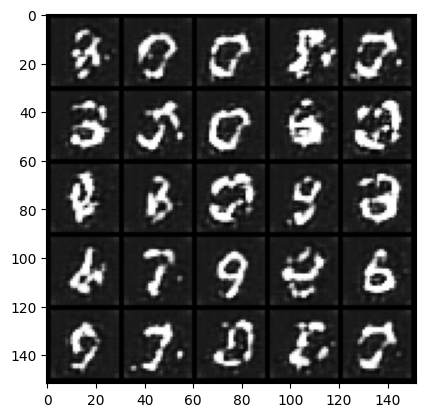

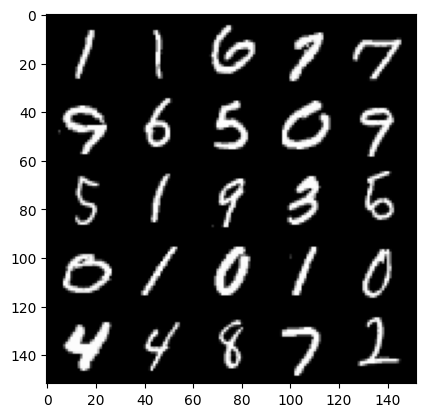

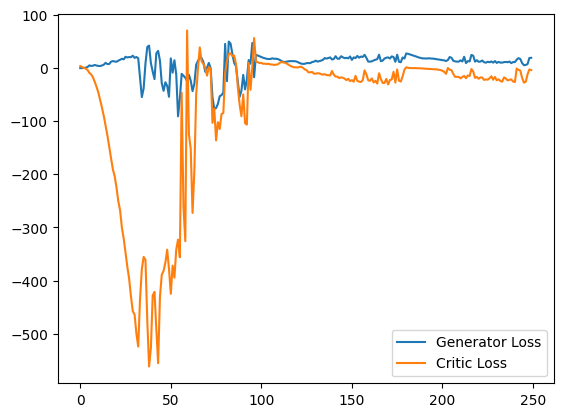

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13695552945137024
real: -13.00665283203125, fake: -18.77181625366211, regularization: 1.3695552349090576
crit_loss: torch.Size([]) -4.395607948303223
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13671916723251343
real: -12.890491485595703, fake: -18.754684448242188, regularization: 1.3671916723251343
crit_loss: torch.Size([]) -4.4970011711120605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10489719361066818
real: -12.745840072631836, fake: -18.642915725708008, regularization: 1.0489718914031982
crit_loss: torch.Size([]) -4.8481035232543945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24990728497505188
real: -12.56514835357666, fake: -18.263120651245117, regularization: 2.499072790145874
crit_loss: torch.Size([]) -3.198899507522583
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14613604545593262
real: -12.395965576171875, fake: -18.140953063964844, regularization: 1.461360454

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1236005574464798
real: -11.4788236618042, fake: -18.073564529418945, regularization: 1.2360055446624756
crit_loss: torch.Size([]) -5.358735084533691
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14639437198638916
real: -11.435988426208496, fake: -18.016687393188477, regularization: 1.4639437198638916
crit_loss: torch.Size([]) -5.116755485534668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15991023182868958
real: -11.266386032104492, fake: -18.2740478515625, regularization: 1.599102258682251
crit_loss: torch.Size([]) -5.408559799194336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1150723397731781
real: -11.267594337463379, fake: -18.277524948120117, regularization: 1.1507234573364258
crit_loss: torch.Size([]) -5.8592071533203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3342658281326294
real: -11.14496898651123, fake: -18.41846466064453, regularization: 3.342658281326294


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26610586047172546
real: -6.327812194824219, fake: -16.97789764404297, regularization: 2.6610586643218994
crit_loss: torch.Size([]) -7.98902702331543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2700091004371643
real: -5.48328161239624, fake: -16.546958923339844, regularization: 2.7000908851623535
crit_loss: torch.Size([]) -8.36358642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20905695855617523
real: -4.429463863372803, fake: -15.862152099609375, regularization: 2.090569496154785
crit_loss: torch.Size([]) -9.342118263244629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6700400114059448
real: -3.560938835144043, fake: -15.00990104675293, regularization: 6.700400352478027
crit_loss: torch.Size([]) -4.748561859130859
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16348539292812347
real: -6.630013465881348, fake: -15.363349914550781, regularization: 1.6348539590835571
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9995430111885071
real: 13.979158401489258, fake: -11.172070503234863, regularization: 9.995429992675781
crit_loss: torch.Size([]) -15.155799865722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6120162010192871
real: 16.867229461669922, fake: -10.228498458862305, regularization: 6.120162010192871
crit_loss: torch.Size([]) -20.975566864013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9234716892242432
real: 20.53644561767578, fake: -6.318120956420898, regularization: 9.234716415405273
crit_loss: torch.Size([]) -17.619850158691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7235190868377686
real: 19.89938735961914, fake: -6.2202229499816895, regularization: 7.2351908683776855
crit_loss: torch.Size([]) -18.884418487548828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45561233162879944
real: 19.605403900146484, fake: -7.94032096862793, regularization: 4.55612325668335
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1383754014968872
real: -9.73155403137207, fake: -22.26053237915039, regularization: 11.383753776550293
crit_loss: torch.Size([]) -1.1452245712280273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1518703699111938
real: -8.94969654083252, fake: -20.74262046813965, regularization: 11.51870346069336
crit_loss: torch.Size([]) -0.27422046661376953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.165907621383667
real: -7.090182304382324, fake: -18.23542022705078, regularization: 11.659076690673828
crit_loss: torch.Size([]) 0.5138387680053711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.596524715423584
real: -13.899290084838867, fake: -25.932716369628906, regularization: 15.96524715423584
crit_loss: torch.Size([]) 3.931820869445801
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8879600763320923
real: -5.907850742340088, fake: -16.219993591308594, regularization: 8.879600524902344
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6466391682624817
real: 19.576669692993164, fake: -13.986992835998535, regularization: 6.466391563415527
crit_loss: torch.Size([]) -27.097270965576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7843579053878784
real: 22.719135284423828, fake: -11.791803359985352, regularization: 7.843579292297363
crit_loss: torch.Size([]) -26.667362213134766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.848366379737854
real: 24.256534576416016, fake: -16.119407653808594, regularization: 8.483663558959961
crit_loss: torch.Size([]) -31.89227867126465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8218563795089722
real: 26.912660598754883, fake: -19.028759002685547, regularization: 8.2185640335083
crit_loss: torch.Size([]) -37.72285842895508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0005087852478027
real: 29.90030288696289, fake: -19.807537078857422, regularization: 10.005087852478027
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3681612014770508
real: 33.02790832519531, fake: 2.129271984100342, regularization: 3.681612014770508
crit_loss: torch.Size([]) -27.217023849487305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33836913108825684
real: 30.403743743896484, fake: -0.7304041385650635, regularization: 3.3836913108825684
crit_loss: torch.Size([]) -27.750455856323242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3968096077442169
real: 22.166658401489258, fake: -0.3102068305015564, regularization: 3.9680960178375244
crit_loss: torch.Size([]) -18.508769989013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4821503460407257
real: 26.92171859741211, fake: -5.007575511932373, regularization: 4.821503639221191
crit_loss: torch.Size([]) -27.107791900634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4445675015449524
real: 20.668502807617188, fake: -8.373519897460938, regularization: 4.445674896240234
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.61573326587677
real: 28.87655258178711, fake: 8.598389625549316, regularization: 6.157332420349121
crit_loss: torch.Size([]) -14.120831489562988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4281376600265503
real: 33.16669464111328, fake: 8.248079299926758, regularization: 4.281376838684082
crit_loss: torch.Size([]) -20.637237548828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6927896738052368
real: 22.526920318603516, fake: -5.765275955200195, regularization: 6.927896499633789
crit_loss: torch.Size([]) -21.364299774169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4262517988681793
real: 27.030223846435547, fake: 0.5498599410057068, regularization: 4.262517929077148
crit_loss: torch.Size([]) -22.217845916748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5967800617218018
real: 31.574195861816406, fake: 2.8590049743652344, regularization: 5.967800617218018
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41939032077789307
real: 33.68751525878906, fake: -4.38062858581543, regularization: 4.193902969360352
crit_loss: torch.Size([]) -33.874244689941406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27331849932670593
real: 29.32432746887207, fake: -8.371971130371094, regularization: 2.733185052871704
crit_loss: torch.Size([]) -34.963111877441406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28379470109939575
real: 25.851316452026367, fake: -5.337764739990234, regularization: 2.837946891784668
crit_loss: torch.Size([]) -28.35113525390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4268155097961426
real: 30.035953521728516, fake: -1.787567138671875, regularization: 4.268155097961426
crit_loss: torch.Size([]) -27.55536651611328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5494105219841003
real: 28.576202392578125, fake: -1.4196414947509766, regularization: 5.494105339050293
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5382835865020752
real: 37.42871856689453, fake: -7.775534629821777, regularization: 5.382835865020752
crit_loss: torch.Size([]) -39.82141876220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5844834446907043
real: 34.808345794677734, fake: -8.563604354858398, regularization: 5.844834327697754
crit_loss: torch.Size([]) -37.52711486816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34095653891563416
real: 32.961883544921875, fake: -14.250551223754883, regularization: 3.4095654487609863
crit_loss: torch.Size([]) -43.8028678894043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45143449306488037
real: 35.241844177246094, fake: -14.061479568481445, regularization: 4.514345169067383
crit_loss: torch.Size([]) -44.788978576660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4426002502441406
real: 32.84521484375, fake: -13.830214500427246, regularization: 4.426002502441406
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6519982814788818
real: 26.75044822692871, fake: -6.865889072418213, regularization: 6.519982814788818
crit_loss: torch.Size([]) -27.09635353088379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40525001287460327
real: 17.135826110839844, fake: 2.346151828765869, regularization: 4.052500247955322
crit_loss: torch.Size([]) -10.737174987792969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2809542715549469
real: 29.927467346191406, fake: 7.890668869018555, regularization: 2.809542655944824
crit_loss: torch.Size([]) -19.227256774902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40307819843292236
real: 26.455442428588867, fake: -2.2931952476501465, regularization: 4.0307817459106445
crit_loss: torch.Size([]) -24.717857360839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9353423714637756
real: 16.42965316772461, fake: -13.732376098632812, regularization: 9.353424072265625
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6526590585708618
real: 26.618324279785156, fake: -6.597156524658203, regularization: 6.526590347290039
crit_loss: torch.Size([]) -26.68889045715332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0726110935211182
real: 26.002368927001953, fake: -14.385763168334961, regularization: 10.726110458374023
crit_loss: torch.Size([]) -29.662019729614258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.609393835067749
real: 23.16474151611328, fake: -16.853221893310547, regularization: 6.09393835067749
crit_loss: torch.Size([]) -33.92402648925781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4861147403717041
real: 25.825775146484375, fake: 0.9569423198699951, regularization: 4.861147403717041
crit_loss: torch.Size([]) -20.007686614990234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3560994863510132
real: 30.607582092285156, fake: 3.674980401992798, regularization: 3.560994863510132
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5841898322105408
real: 32.203948974609375, fake: 3.0291781425476074, regularization: 5.841898441314697
crit_loss: torch.Size([]) -23.33287239074707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4700530171394348
real: 29.01986312866211, fake: -0.8782399892807007, regularization: 4.700530052185059
crit_loss: torch.Size([]) -25.197574615478516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7925765514373779
real: 24.613380432128906, fake: -5.8559160232543945, regularization: 7.925765514373779
crit_loss: torch.Size([]) -22.543529510498047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24420936405658722
real: 28.780256271362305, fake: -2.3004279136657715, regularization: 2.44209361076355
crit_loss: torch.Size([]) -28.638591766357422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36483150720596313
real: 30.509605407714844, fake: -0.8400163650512695, regularization: 3.648314952850342
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4578410387039185
real: 34.42192077636719, fake: 0.1090371310710907, regularization: 14.578410148620605
crit_loss: torch.Size([]) -19.734474182128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7571020126342773
real: 35.33854675292969, fake: -2.255009174346924, regularization: 7.571020126342773
crit_loss: torch.Size([]) -30.02253532409668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3261553645133972
real: 27.163232803344727, fake: 4.905861854553223, regularization: 3.2615537643432617
crit_loss: torch.Size([]) -18.99581527709961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3186984658241272
real: 36.929534912109375, fake: 9.106260299682617, regularization: 3.1869845390319824
crit_loss: torch.Size([]) -24.636289596557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47197961807250977
real: 29.718944549560547, fake: -1.5700865983963013, regularization: 4.719796180725098
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41563889384269714
real: 27.033857345581055, fake: -7.650360584259033, regularization: 4.156388759613037
crit_loss: torch.Size([]) -30.527830123901367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.678579568862915
real: 39.55169677734375, fake: 1.3693143129348755, regularization: 6.78579568862915
crit_loss: torch.Size([]) -31.39658546447754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3949095904827118
real: 31.562589645385742, fake: -5.770987510681152, regularization: 3.9490959644317627
crit_loss: torch.Size([]) -33.38447952270508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.447579026222229
real: 35.1690673828125, fake: -2.477771282196045, regularization: 4.475790023803711
crit_loss: torch.Size([]) -33.171051025390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45336467027664185
real: 32.02048873901367, fake: 7.091951370239258, regularization: 4.533646583557129
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3891444206237793
real: 35.788848876953125, fake: 4.771668910980225, regularization: 3.891444206237793
crit_loss: torch.Size([]) -27.125736236572266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5204732418060303
real: 23.64121437072754, fake: 0.14407433569431305, regularization: 5.204732418060303
crit_loss: torch.Size([]) -18.292407989501953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5505033731460571
real: 24.613544464111328, fake: -7.059870719909668, regularization: 5.505033493041992
crit_loss: torch.Size([]) -26.16838264465332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2942591905593872
real: 28.15152359008789, fake: -4.853647232055664, regularization: 2.942591905593872
crit_loss: torch.Size([]) -30.062580108642578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5122480392456055
real: 36.42827606201172, fake: 2.2545406818389893, regularization: 5.122480392456055
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6897674202919006
real: 28.578495025634766, fake: -4.435097694396973, regularization: 6.897674083709717
crit_loss: torch.Size([]) -26.115917205810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48138272762298584
real: 36.79534912109375, fake: 8.120216369628906, regularization: 4.8138275146484375
crit_loss: torch.Size([]) -23.861305236816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37223172187805176
real: 33.143585205078125, fake: 0.8836885094642639, regularization: 3.7223172187805176
crit_loss: torch.Size([]) -28.537578582763672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3681519329547882
real: 21.909147262573242, fake: -1.1946851015090942, regularization: 3.6815192699432373
crit_loss: torch.Size([]) -19.422313690185547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5102221965789795
real: 25.233625411987305, fake: -2.5290913581848145, regularization: 5.102221965789795
c

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7282920479774475
real: 25.00467300415039, fake: -15.252708435058594, regularization: 7.2829203605651855
crit_loss: torch.Size([]) -32.97446060180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6161322593688965
real: 29.845806121826172, fake: -9.66141128540039, regularization: 6.161322593688965
crit_loss: torch.Size([]) -33.34589385986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6404933929443359
real: 29.349613189697266, fake: -16.931243896484375, regularization: 6.404933929443359
crit_loss: torch.Size([]) -39.87592315673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5899732112884521
real: 23.17253875732422, fake: -20.147172927856445, regularization: 5.8997321128845215
crit_loss: torch.Size([]) -37.419979095458984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6610334515571594
real: 31.251510620117188, fake: -13.029422760009766, regularization: 6.610334396362305
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4978676736354828
real: 25.219358444213867, fake: -12.21402645111084, regularization: 4.978676795959473
crit_loss: torch.Size([]) -32.454708099365234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5892481803894043
real: 34.72567367553711, fake: -10.540130615234375, regularization: 5.892481803894043
crit_loss: torch.Size([]) -39.373321533203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6704644560813904
real: 19.423587799072266, fake: -7.853440284729004, regularization: 6.704644680023193
crit_loss: torch.Size([]) -20.5723819732666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0192943811416626
real: 32.1779899597168, fake: 6.701200485229492, regularization: 10.192943572998047
crit_loss: torch.Size([]) -15.283845901489258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5381999015808105
real: 27.972658157348633, fake: 1.7128549814224243, regularization: 5.3819990158081055
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4641337990760803
real: 27.881206512451172, fake: -15.079200744628906, regularization: 4.641337871551514
crit_loss: torch.Size([]) -38.319068908691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5725520849227905
real: 27.402050018310547, fake: -16.961071014404297, regularization: 5.725521087646484
crit_loss: torch.Size([]) -38.63759994506836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5220438241958618
real: 28.07802963256836, fake: -19.14866065979004, regularization: 5.220438003540039
crit_loss: torch.Size([]) -42.006256103515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5443963408470154
real: 28.089550018310547, fake: -13.535030364990234, regularization: 5.443963527679443
crit_loss: torch.Size([]) -36.18061828613281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2888965606689453
real: 26.135250091552734, fake: -0.2149309515953064, regularization: 2.888965606689453
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7055896520614624
real: 29.299962997436523, fake: -14.1626615524292, regularization: 7.055896759033203
crit_loss: torch.Size([]) -36.4067268371582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6215007305145264
real: 13.849101066589355, fake: -5.822072982788086, regularization: 6.215007305145264
crit_loss: torch.Size([]) -13.456165313720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3654401898384094
real: 35.518951416015625, fake: 6.619694232940674, regularization: 3.6544017791748047
crit_loss: torch.Size([]) -25.244855880737305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.388019859790802
real: 30.994964599609375, fake: 1.2004133462905884, regularization: 3.8801984786987305
crit_loss: torch.Size([]) -25.914352416992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1188116073608398
real: 32.17448043823242, fake: -1.7494019269943237, regularization: 11.188116073608398
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37564313411712646
real: 32.720191955566406, fake: -4.412362098693848, regularization: 3.7564313411712646
crit_loss: torch.Size([]) -33.376121520996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2791154682636261
real: 36.37197494506836, fake: -1.3476064205169678, regularization: 2.791154623031616
crit_loss: torch.Size([]) -34.928428649902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34470248222351074
real: 35.5965690612793, fake: -1.750119924545288, regularization: 3.4470248222351074
crit_loss: torch.Size([]) -33.899662017822266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28077825903892517
real: 31.105070114135742, fake: 3.0409343242645264, regularization: 2.8077826499938965
crit_loss: torch.Size([]) -25.2563533782959
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3572019934654236
real: 37.19003677368164, fake: 8.915721893310547, regularization: 3.5720200538635254
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13840004801750183
real: -14.247233390808105, fake: -18.09564971923828, regularization: 1.384000539779663
crit_loss: torch.Size([]) -2.4644157886505127
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18738409876823425
real: -14.279866218566895, fake: -17.999408721923828, regularization: 1.8738410472869873
crit_loss: torch.Size([]) -1.8457014560699463
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12819980084896088
real: -14.117533683776855, fake: -18.083511352539062, regularization: 1.2819980382919312
crit_loss: torch.Size([]) -2.6839795112609863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12089872360229492
real: -14.060420989990234, fake: -18.06414031982422, regularization: 1.2089872360229492
crit_loss: torch.Size([]) -2.794732093811035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18490314483642578
real: -14.041444778442383, fake: -18.070892333984375, regularization: 1.8490314

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09927812218666077
real: -14.459375381469727, fake: -18.775089263916016, regularization: 0.9927812218666077
crit_loss: torch.Size([]) -3.322932720184326
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07424986362457275
real: -14.44587516784668, fake: -18.919628143310547, regularization: 0.7424986362457275
crit_loss: torch.Size([]) -3.7312543392181396
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09911863505840302
real: -14.462024688720703, fake: -18.901762008666992, regularization: 0.9911863803863525
crit_loss: torch.Size([]) -3.4485509395599365
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08833104372024536
real: -14.494464874267578, fake: -18.83572769165039, regularization: 0.8833104372024536
crit_loss: torch.Size([]) -3.4579524993896484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13623549044132233
real: -14.740234375, fake: -19.036151885986328, regularization: 1.362354874610

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06604649126529694
real: -15.093036651611328, fake: -19.536300659179688, regularization: 0.660464882850647
crit_loss: torch.Size([]) -3.782799243927002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09389173984527588
real: -15.92922592163086, fake: -20.032560348510742, regularization: 0.9389173984527588
crit_loss: torch.Size([]) -3.164417028427124
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08304235339164734
real: -15.988546371459961, fake: -20.199602127075195, regularization: 0.8304235339164734
crit_loss: torch.Size([]) -3.380632162094116
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08262085169553757
real: -15.987586975097656, fake: -20.086936950683594, regularization: 0.8262085318565369
crit_loss: torch.Size([]) -3.273141384124756
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08184978365898132
real: -15.95988655090332, fake: -19.996776580810547, regularization: 0.8184978365

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09160245954990387
real: -16.160402297973633, fake: -20.15317726135254, regularization: 0.9160245656967163
crit_loss: torch.Size([]) -3.0767502784729004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.270224004983902
real: -16.052589416503906, fake: -19.9858455657959, regularization: 2.702239990234375
crit_loss: torch.Size([]) -1.2310161590576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10767816007137299
real: -16.005748748779297, fake: -20.117706298828125, regularization: 1.0767816305160522
crit_loss: torch.Size([]) -3.0351758003234863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1617555171251297
real: -15.581040382385254, fake: -20.010196685791016, regularization: 1.6175551414489746
crit_loss: torch.Size([]) -2.811601161956787
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09405212104320526
real: -15.579038619995117, fake: -20.143810272216797, regularization: 0.94052124023

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07008691132068634
real: -16.034040451049805, fake: -20.106983184814453, regularization: 0.700869083404541
crit_loss: torch.Size([]) -3.3720736503601074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10392159968614578
real: -16.093215942382812, fake: -20.320253372192383, regularization: 1.0392160415649414
crit_loss: torch.Size([]) -3.187821388244629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05748691409826279
real: -16.10886001586914, fake: -20.472484588623047, regularization: 0.5748691558837891
crit_loss: torch.Size([]) -3.788755416870117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06771152466535568
real: -16.147634506225586, fake: -20.47893524169922, regularization: 0.677115261554718
crit_loss: torch.Size([]) -3.6541855335235596
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05628238618373871
real: -16.221086502075195, fake: -20.51956558227539, regularization: 0.5628238916

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11019942909479141
real: -15.984119415283203, fake: -20.46864128112793, regularization: 1.101994276046753
crit_loss: torch.Size([]) -3.3825275897979736
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10417136549949646
real: -16.06460952758789, fake: -20.496231079101562, regularization: 1.0417137145996094
crit_loss: torch.Size([]) -3.3899078369140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1140546128153801
real: -16.175521850585938, fake: -20.594974517822266, regularization: 1.1405460834503174
crit_loss: torch.Size([]) -3.2789065837860107
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12250523269176483
real: -16.25792121887207, fake: -20.622024536132812, regularization: 1.2250523567199707
crit_loss: torch.Size([]) -3.1390509605407715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0734233483672142
real: -16.347381591796875, fake: -20.733524322509766, regularization: 0.734233498

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07147559523582458
real: -16.86098289489746, fake: -21.2513427734375, regularization: 0.7147559523582458
crit_loss: torch.Size([]) -3.6756038665771484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07811427861452103
real: -16.77859878540039, fake: -21.109676361083984, regularization: 0.7811427712440491
crit_loss: torch.Size([]) -3.5499348640441895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06441284716129303
real: -16.72706413269043, fake: -20.900249481201172, regularization: 0.6441284418106079
crit_loss: torch.Size([]) -3.529057025909424
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07213141769170761
real: -16.704139709472656, fake: -21.224655151367188, regularization: 0.7213141918182373
crit_loss: torch.Size([]) -3.799201250076294
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06775227934122086
real: -16.52977752685547, fake: -20.899959564208984, regularization: 0.67752277851

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08337794244289398
real: -16.174434661865234, fake: -20.32421875, regularization: 0.8337794542312622
crit_loss: torch.Size([]) -3.316004753112793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07193127274513245
real: -16.28670310974121, fake: -20.279769897460938, regularization: 0.7193127274513245
crit_loss: torch.Size([]) -3.273754119873047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06959858536720276
real: -16.254150390625, fake: -20.182405471801758, regularization: 0.6959858536720276
crit_loss: torch.Size([]) -3.232269287109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06929665803909302
real: -16.145681381225586, fake: -20.195934295654297, regularization: 0.6929665803909302
crit_loss: torch.Size([]) -3.3572864532470703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06473097205162048
real: -16.050067901611328, fake: -19.893308639526367, regularization: 0.6473097205162048


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07463524490594864
real: -15.408616065979004, fake: -19.557872772216797, regularization: 0.7463524341583252
crit_loss: torch.Size([]) -3.4029042720794678
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06029684469103813
real: -15.383852005004883, fake: -19.244510650634766, regularization: 0.6029684543609619
crit_loss: torch.Size([]) -3.257690191268921
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09148316830396652
real: -15.303610801696777, fake: -19.465238571166992, regularization: 0.9148316979408264
crit_loss: torch.Size([]) -3.246796131134033
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06803054362535477
real: -15.561767578125, fake: -19.20659828186035, regularization: 0.6803054213523865
crit_loss: torch.Size([]) -2.9645252227783203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08218473196029663
real: -15.411754608154297, fake: -19.01288604736328, regularization: 0.8218473196

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11115504056215286
real: -15.567362785339355, fake: -19.637632369995117, regularization: 1.1115504503250122
crit_loss: torch.Size([]) -2.958719253540039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12526820600032806
real: -15.429658889770508, fake: -19.564788818359375, regularization: 1.252682089805603
crit_loss: torch.Size([]) -2.8824477195739746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08983904123306274
real: -15.30929946899414, fake: -19.28070068359375, regularization: 0.8983904123306274
crit_loss: torch.Size([]) -3.0730109214782715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07950963079929352
real: -15.154315948486328, fake: -19.255672454833984, regularization: 0.7950962781906128
crit_loss: torch.Size([]) -3.306260108947754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07171200215816498
real: -14.990886688232422, fake: -19.09956169128418, regularization: 0.717120051

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05997410789132118
real: -14.243918418884277, fake: -18.601001739501953, regularization: 0.5997411012649536
crit_loss: torch.Size([]) -3.7573423385620117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08480358123779297
real: -14.102666854858398, fake: -18.417821884155273, regularization: 0.8480358123779297
crit_loss: torch.Size([]) -3.4671192169189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06795556098222733
real: -14.154071807861328, fake: -18.052892684936523, regularization: 0.6795555949211121
crit_loss: torch.Size([]) -3.2192652225494385
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07632732391357422
real: -14.060474395751953, fake: -18.238067626953125, regularization: 0.7632732391357422
crit_loss: torch.Size([]) -3.4143199920654297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09218916296958923
real: -14.035293579101562, fake: -18.232303619384766, regularization: 0.921

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11309304088354111
real: -13.605043411254883, fake: -18.122398376464844, regularization: 1.1309304237365723
crit_loss: torch.Size([]) -3.3864245414733887
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07200692594051361
real: -13.487608909606934, fake: -17.993696212768555, regularization: 0.7200692892074585
crit_loss: torch.Size([]) -3.786017894744873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10025091469287872
real: -13.449302673339844, fake: -17.936389923095703, regularization: 1.0025091171264648
crit_loss: torch.Size([]) -3.4845781326293945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09155934303998947
real: -13.351644515991211, fake: -17.93089485168457, regularization: 0.9155934453010559
crit_loss: torch.Size([]) -3.6636569499969482
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10868334770202637
real: -13.180974960327148, fake: -17.68978500366211, regularization: 1.086833

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1069122701883316
real: -12.68722915649414, fake: -17.259525299072266, regularization: 1.0691226720809937
crit_loss: torch.Size([]) -3.503173351287842
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09549912810325623
real: -13.051759719848633, fake: -17.452899932861328, regularization: 0.9549912810325623
crit_loss: torch.Size([]) -3.4461488723754883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07844603061676025
real: -12.993816375732422, fake: -17.340885162353516, regularization: 0.7844603061676025
crit_loss: torch.Size([]) -3.562608480453491
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06962436437606812
real: -13.011868476867676, fake: -17.295940399169922, regularization: 0.6962436437606812
crit_loss: torch.Size([]) -3.5878281593322754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13495394587516785
real: -13.048365592956543, fake: -17.46573257446289, regularization: 1.34953951

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13271228969097137
real: -9.194652557373047, fake: -15.762857437133789, regularization: 1.3271229267120361
crit_loss: torch.Size([]) -5.241082191467285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7472994327545166
real: -8.973963737487793, fake: -15.768012046813965, regularization: 7.472994327545166
crit_loss: torch.Size([]) 0.6789460182189941
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11329258233308792
real: -8.884664535522461, fake: -15.830042839050293, regularization: 1.1329258680343628
crit_loss: torch.Size([]) -5.81245231628418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19359581172466278
real: -9.738492965698242, fake: -15.676444053649902, regularization: 1.9359581470489502
crit_loss: torch.Size([]) -4.001993179321289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14417332410812378
real: -9.64962387084961, fake: -15.390542984008789, regularization: 1.4417332410812378

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3292972445487976
real: -7.184420108795166, fake: -15.157150268554688, regularization: 3.2929725646972656
crit_loss: torch.Size([]) -4.679757595062256
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16968658566474915
real: -6.901623725891113, fake: -14.65619945526123, regularization: 1.6968657970428467
crit_loss: torch.Size([]) -6.057709693908691
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12465827912092209
real: -6.526900291442871, fake: -14.503374099731445, regularization: 1.2465827465057373
crit_loss: torch.Size([]) -6.729890823364258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26019108295440674
real: -6.192076683044434, fake: -14.445051193237305, regularization: 2.6019108295440674
crit_loss: torch.Size([]) -5.651063919067383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19785469770431519
real: -5.945305824279785, fake: -14.199333190917969, regularization: 1.97854697704315

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37576019763946533
real: -0.9361587762832642, fake: -11.99439525604248, regularization: 3.7576019763946533
crit_loss: torch.Size([]) -7.300634384155273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2894652485847473
real: -0.19636759161949158, fake: -11.102229118347168, regularization: 2.8946523666381836
crit_loss: torch.Size([]) -8.011209487915039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3044338822364807
real: 0.8442883491516113, fake: -10.732023239135742, regularization: 3.0443387031555176
crit_loss: torch.Size([]) -8.531972885131836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3794299364089966
real: 2.073474168777466, fake: -10.230679512023926, regularization: 3.794299364089966
crit_loss: torch.Size([]) -8.509854316711426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28782910108566284
real: 3.048654317855835, fake: -10.050956726074219, regularization: 2.878291130065918


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4420247972011566
real: 29.857799530029297, fake: 0.2879641652107239, regularization: 4.420248031616211
crit_loss: torch.Size([]) -25.149587631225586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7304989099502563
real: 31.438907623291016, fake: 1.8361897468566895, regularization: 7.304988861083984
crit_loss: torch.Size([]) -22.2977294921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5362533330917358
real: 31.163406372070312, fake: 0.8382778167724609, regularization: 5.3625335693359375
crit_loss: torch.Size([]) -24.962594985961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5612894892692566
real: 31.804224014282227, fake: 1.0704339742660522, regularization: 5.6128950119018555
crit_loss: torch.Size([]) -25.120895385742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.51366126537323
real: 22.93754005432129, fake: 3.6510658264160156, regularization: 5.136612892150879
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.338869571685791
real: 28.31014060974121, fake: -19.831375122070312, regularization: 13.38869571685791
crit_loss: torch.Size([]) -34.75282287597656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7642083168029785
real: -8.646842956542969, fake: -14.723932266235352, regularization: 7.642083168029785
crit_loss: torch.Size([]) 1.5649938583374023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8207361698150635
real: 2.4611282348632812, fake: -11.262960433959961, regularization: 8.207361221313477
crit_loss: torch.Size([]) -5.516727447509766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8772611618041992
real: 28.784297943115234, fake: 5.492889404296875, regularization: 8.772611618041992
crit_loss: torch.Size([]) -14.518796920776367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7807988524436951
real: 27.154855728149414, fake: 1.6126288175582886, regularization: 7.80798864364624
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6059752702713013
real: 19.352783203125, fake: -10.114036560058594, regularization: 6.059752464294434
crit_loss: torch.Size([]) -23.407066345214844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31203997135162354
real: 19.674745559692383, fake: -10.081817626953125, regularization: 3.1203997135162354
crit_loss: torch.Size([]) -26.63616371154785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.319739431142807
real: 20.636009216308594, fake: -9.777478218078613, regularization: 3.197394371032715
crit_loss: torch.Size([]) -27.21609115600586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3289913237094879
real: 9.039352416992188, fake: -2.1861109733581543, regularization: 3.2899131774902344
crit_loss: torch.Size([]) -7.935550689697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28593528270721436
real: 14.405327796936035, fake: -2.353402614593506, regularization: 2.8593528270721436
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29959672689437866
real: 28.070798873901367, fake: 7.503381252288818, regularization: 2.995967388153076
crit_loss: torch.Size([]) -17.571449279785156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24617700278759003
real: 29.993125915527344, fake: 11.833457946777344, regularization: 2.4617700576782227
crit_loss: torch.Size([]) -15.697897911071777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23327362537384033
real: 31.374252319335938, fake: 11.929832458496094, regularization: 2.3327362537384033
crit_loss: torch.Size([]) -17.111682891845703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2667683959007263
real: 31.18760871887207, fake: 12.402970314025879, regularization: 2.6676840782165527
crit_loss: torch.Size([]) -16.116952896118164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33737990260124207
real: 30.98122215270996, fake: 11.484806060791016, regularization: 3.3737990856170654
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3663696050643921
real: 29.295303344726562, fake: 5.3197736740112305, regularization: 3.663696050643921
crit_loss: torch.Size([]) -20.311832427978516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.388960599899292
real: 28.542978286743164, fake: 6.2704596519470215, regularization: 3.88960599899292
crit_loss: torch.Size([]) -18.382911682128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46961265802383423
real: 3.151214122772217, fake: 5.4175519943237305, regularization: 4.696126461029053
crit_loss: torch.Size([]) 6.962464332580566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42573121190071106
real: 26.3392333984375, fake: -11.158796310424805, regularization: 4.257312297821045
crit_loss: torch.Size([]) -33.240718841552734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28765279054641724
real: 19.774555206298828, fake: -13.031508445739746, regularization: 2.876527786254883
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2350127398967743
real: 27.214340209960938, fake: -9.680929183959961, regularization: 2.3501274585723877
crit_loss: torch.Size([]) -34.545143127441406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2884420156478882
real: 31.59180450439453, fake: -5.93898868560791, regularization: 2.884420156478882
crit_loss: torch.Size([]) -34.6463737487793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25677424669265747
real: 37.52044677734375, fake: -0.5662620067596436, regularization: 2.567742347717285
crit_loss: torch.Size([]) -35.51896667480469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.188674658536911
real: 34.51564025878906, fake: -5.1988935470581055, regularization: 1.8867466449737549
crit_loss: torch.Size([]) -37.827789306640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2159702181816101
real: 25.330686569213867, fake: -0.21321925520896912, regularization: 2.1597023010253906
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5571165680885315
real: 31.247814178466797, fake: -1.3526360988616943, regularization: 5.571165561676025
crit_loss: torch.Size([]) -27.02928352355957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41655346751213074
real: 27.214771270751953, fake: -0.1825627088546753, regularization: 4.165534496307373
crit_loss: torch.Size([]) -23.23179817199707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2722853720188141
real: 27.916616439819336, fake: -1.4056453704833984, regularization: 2.722853660583496
crit_loss: torch.Size([]) -26.599407196044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2844434976577759
real: 28.981197357177734, fake: -0.6569323539733887, regularization: 2.844434976577759
crit_loss: torch.Size([]) -26.7936954498291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4053228199481964
real: 28.58615493774414, fake: -4.527134895324707, regularization: 4.053228378295898
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5366550087928772
real: 27.570262908935547, fake: -9.35979175567627, regularization: 5.366549968719482
crit_loss: torch.Size([]) -31.56350326538086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6716705560684204
real: 8.193770408630371, fake: -25.053701400756836, regularization: 6.716705322265625
crit_loss: torch.Size([]) -26.530765533447266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5725573301315308
real: 22.049121856689453, fake: -19.470369338989258, regularization: 5.725573539733887
crit_loss: torch.Size([]) -35.79391860961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4969603717327118
real: 11.281478881835938, fake: -3.6876542568206787, regularization: 4.969603538513184
crit_loss: torch.Size([]) -9.999529838562012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46197232604026794
real: 26.780696868896484, fake: 3.1071319580078125, regularization: 4.619723320007324
crit_lo

penalty: torch.Size([]) 0.7323449850082397
real: 11.188997268676758, fake: -12.484966278076172, regularization: 7.323450088500977
crit_loss: torch.Size([]) -16.350513458251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7911117076873779
real: 16.67224884033203, fake: -29.060701370239258, regularization: 7.911117076873779
crit_loss: torch.Size([]) -37.82183074951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7857140898704529
real: -6.2672810554504395, fake: -24.34071159362793, regularization: 7.857141017913818
crit_loss: torch.Size([]) -10.216289520263672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.853270947933197
real: 1.3789571523666382, fake: -21.26417350769043, regularization: 8.532709121704102
crit_loss: torch.Size([]) -14.110422134399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6167506575584412
real: 18.88934326171875, fake: -11.068241119384766, regularization: 6.167506694793701
crit_loss: torch.Size([]) -23.790077209

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3917730450630188
real: 31.09478187561035, fake: -1.1477031707763672, regularization: 3.9177303314208984
crit_loss: torch.Size([]) -28.32475471496582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3722359538078308
real: 17.676843643188477, fake: -15.848275184631348, regularization: 3.7223596572875977
crit_loss: torch.Size([]) -29.80276107788086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24411427974700928
real: 29.12047004699707, fake: -12.293638229370117, regularization: 2.4411427974700928
crit_loss: torch.Size([]) -38.972965240478516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34969285130500793
real: 37.95691680908203, fake: -0.6732476949691772, regularization: 3.4969284534454346
crit_loss: torch.Size([]) -35.133235931396484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19714507460594177
real: 32.45280075073242, fake: -11.944524765014648, regularization: 1.9714508056640625

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4351452589035034
real: 23.5650691986084, fake: -2.709700107574463, regularization: 4.351452827453613
crit_loss: torch.Size([]) -21.923316955566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4696781039237976
real: 20.75131607055664, fake: -4.292444229125977, regularization: 4.696781158447266
crit_loss: torch.Size([]) -20.34697914123535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3767826557159424
real: 27.77997589111328, fake: -1.2639658451080322, regularization: 3.767826557159424
crit_loss: torch.Size([]) -25.27611541748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4388856887817383
real: 24.143749237060547, fake: -7.335777282714844, regularization: 4.388856887817383
crit_loss: torch.Size([]) -27.090669631958008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2893068790435791
real: 23.457927703857422, fake: -6.874868869781494, regularization: 2.893068790435791
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.449026882648468
real: 18.333406448364258, fake: -3.191681385040283, regularization: 4.490268707275391
crit_loss: torch.Size([]) -17.034818649291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37237808108329773
real: 20.613771438598633, fake: -6.849337577819824, regularization: 3.723780870437622
crit_loss: torch.Size([]) -23.73932647705078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39455413818359375
real: 14.78886604309082, fake: -11.801897048950195, regularization: 3.9455413818359375
crit_loss: torch.Size([]) -22.645221710205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4852665066719055
real: 19.171123504638672, fake: -10.645843505859375, regularization: 4.852664947509766
crit_loss: torch.Size([]) -24.96430206298828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5546544790267944
real: 10.064204216003418, fake: -3.496706485748291, regularization: 5.546545028686523
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6652968525886536
real: 29.187686920166016, fake: -2.677534580230713, regularization: 6.652968406677246
crit_loss: torch.Size([]) -25.21225357055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4336802363395691
real: 33.37676239013672, fake: 3.4900741577148438, regularization: 4.3368024826049805
crit_loss: torch.Size([]) -25.549884796142578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4324009120464325
real: 32.04120635986328, fake: -1.8435752391815186, regularization: 4.324008941650391
crit_loss: torch.Size([]) -29.560771942138672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4109533727169037
real: 29.36585235595703, fake: -2.422220230102539, regularization: 4.109533786773682
crit_loss: torch.Size([]) -27.678539276123047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5028637647628784
real: 31.08509063720703, fake: 1.5348155498504639, regularization: 5.028637886047363
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3541509509086609
real: 34.56367492675781, fake: -8.009513854980469, regularization: 3.5415096282958984
crit_loss: torch.Size([]) -39.03167724609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6333577632904053
real: 39.218196868896484, fake: 0.18700632452964783, regularization: 6.333577632904053
crit_loss: torch.Size([]) -32.69761276245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48237311840057373
real: 26.382896423339844, fake: -14.139161109924316, regularization: 4.823731422424316
crit_loss: torch.Size([]) -35.698326110839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3193202614784241
real: 12.373720169067383, fake: -1.695090413093567, regularization: 3.193202495574951
crit_loss: torch.Size([]) -10.875608444213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33128464221954346
real: 21.96274185180664, fake: 1.264885425567627, regularization: 3.3128464221954346
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3716091513633728
real: 22.26148223876953, fake: -4.5363945960998535, regularization: 3.7160916328430176
crit_loss: torch.Size([]) -23.081785202026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.500128448009491
real: 32.50967788696289, fake: 4.192413330078125, regularization: 5.001284599304199
crit_loss: torch.Size([]) -23.31597900390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4582764804363251
real: 32.452430725097656, fake: 1.208177089691162, regularization: 4.582764625549316
crit_loss: torch.Size([]) -26.661487579345703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4418224096298218
real: 30.933738708496094, fake: 0.6639584302902222, regularization: 4.418224334716797
crit_loss: torch.Size([]) -25.8515567779541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37557899951934814
real: 31.349498748779297, fake: -2.674363136291504, regularization: 3.7557899951934814
crit_loss:

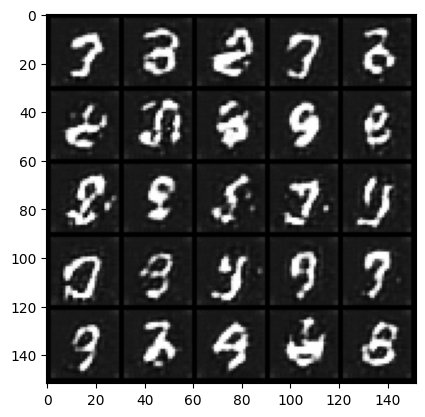

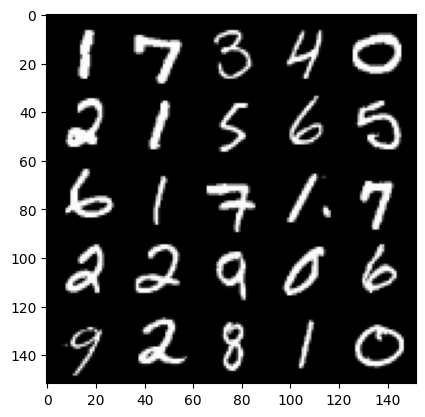

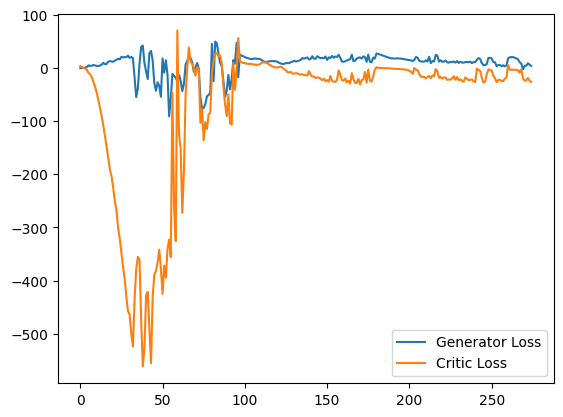

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3588073253631592
real: 22.28246307373047, fake: -4.319779396057129, regularization: 3.588073253631592
crit_loss: torch.Size([]) -23.01416778564453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3974664807319641
real: 26.34820556640625, fake: -3.590663433074951, regularization: 3.9746646881103516
crit_loss: torch.Size([]) -25.964204788208008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5605678558349609
real: 33.360843658447266, fake: 5.230714797973633, regularization: 5.605678558349609
crit_loss: torch.Size([]) -22.524450302124023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3401240110397339
real: 32.01625442504883, fake: 1.2200286388397217, regularization: 3.401240110397339
crit_loss: torch.Size([]) -27.394987106323242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47354185581207275
real: 26.023662567138672, fake: -7.566399574279785, regularization: 4.735418319702148
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32229307293891907
real: 32.91326141357422, fake: -2.147888422012329, regularization: 3.222930669784546
crit_loss: torch.Size([]) -31.838218688964844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2748451232910156
real: 34.323394775390625, fake: 2.3528928756713867, regularization: 2.7484512329101562
crit_loss: torch.Size([]) -29.222049713134766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24892903864383698
real: 18.973188400268555, fake: 3.5589663982391357, regularization: 2.489290475845337
crit_loss: torch.Size([]) -12.924931526184082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3468400835990906
real: 29.6638240814209, fake: 2.7246901988983154, regularization: 3.4684009552001953
crit_loss: torch.Size([]) -23.470733642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5234138369560242
real: 18.11813735961914, fake: -11.656671524047852, regularization: 5.234138488769531
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47079721093177795
real: -17.928409576416016, fake: -1.227304220199585, regularization: 4.707972049713135
crit_loss: torch.Size([]) 21.409076690673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5343976020812988
real: -17.85800552368164, fake: -12.370401382446289, regularization: 15.343976020812988
crit_loss: torch.Size([]) 20.831581115722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5926331281661987
real: -10.683294296264648, fake: -1.2509311437606812, regularization: 5.926331520080566
crit_loss: torch.Size([]) 15.358695030212402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6889809370040894
real: -12.234603881835938, fake: -17.345779418945312, regularization: 6.889809608459473
crit_loss: torch.Size([]) 1.7786340713500977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1317123174667358
real: -8.35890007019043, fake: -20.096940994262695, regularization: 11.317123413085938
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3578113317489624
real: 16.259662628173828, fake: -9.155355453491211, regularization: 3.578113317489624
crit_loss: torch.Size([]) -21.836904525756836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7532591223716736
real: 0.75962233543396, fake: -18.109783172607422, regularization: 7.532591342926025
crit_loss: torch.Size([]) -11.336814880371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.058887243270874
real: 18.435100555419922, fake: -5.044650554656982, regularization: 10.588872909545898
crit_loss: torch.Size([]) -12.890878677368164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4556342661380768
real: 16.685155868530273, fake: -7.961174011230469, regularization: 4.556342601776123
crit_loss: torch.Size([]) -20.08998680114746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40674957633018494
real: 20.20816421508789, fake: -4.7725629806518555, regularization: 4.067495822906494
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3058992624282837
real: 29.302032470703125, fake: 6.1858625411987305, regularization: 3.058992624282837
crit_loss: torch.Size([]) -20.05717658996582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3410419225692749
real: 23.314891815185547, fake: 0.993802547454834, regularization: 3.410419225692749
crit_loss: torch.Size([]) -18.910669326782227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38385212421417236
real: 18.84391975402832, fake: -7.556117057800293, regularization: 3.8385212421417236
crit_loss: torch.Size([]) -22.561513900756836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5698752403259277
real: 26.537424087524414, fake: -3.0313994884490967, regularization: 5.698752403259277
crit_loss: torch.Size([]) -23.870071411132812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3830779790878296
real: 26.70008087158203, fake: -1.8279069662094116, regularization: 3.830779790878296
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5520974397659302
real: 32.135902404785156, fake: 2.0599820613861084, regularization: 5.520974159240723
crit_loss: torch.Size([]) -24.554946899414062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5184303522109985
real: 27.583194732666016, fake: -3.536102771759033, regularization: 5.184303283691406
crit_loss: torch.Size([]) -25.934993743896484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.388740599155426
real: 28.432361602783203, fake: -2.013226270675659, regularization: 3.8874058723449707
crit_loss: torch.Size([]) -26.558181762695312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27195197343826294
real: 29.54218292236328, fake: -4.211527347564697, regularization: 2.71951961517334
crit_loss: torch.Size([]) -31.034191131591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2579023540019989
real: 27.97026824951172, fake: -4.773853302001953, regularization: 2.579023599624634
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3577960729598999
real: 31.73910140991211, fake: 4.216436386108398, regularization: 3.577960729598999
crit_loss: torch.Size([]) -23.944704055786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4774360656738281
real: 32.50554275512695, fake: 1.3251575231552124, regularization: 4.774360656738281
crit_loss: torch.Size([]) -26.406024932861328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32825613021850586
real: 31.155147552490234, fake: 2.4716062545776367, regularization: 3.2825613021850586
crit_loss: torch.Size([]) -25.400978088378906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30695676803588867
real: 33.538963317871094, fake: 2.9999918937683105, regularization: 3.0695676803588867
crit_loss: torch.Size([]) -27.469402313232422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4101558327674866
real: 31.790069580078125, fake: 0.8101283311843872, regularization: 4.101558208465576
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9712984561920166
real: 27.427371978759766, fake: -4.385344505310059, regularization: 9.712984085083008
crit_loss: torch.Size([]) -22.099733352661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6465537548065186
real: 31.054767608642578, fake: -1.7133688926696777, regularization: 6.4655375480651855
crit_loss: torch.Size([]) -26.302597045898438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37897154688835144
real: 32.06769561767578, fake: -3.5594096183776855, regularization: 3.789715528488159
crit_loss: torch.Size([]) -31.837390899658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5084149241447449
real: 27.590843200683594, fake: -10.333102226257324, regularization: 5.084149360656738
crit_loss: torch.Size([]) -32.83979797363281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48256635665893555
real: 33.83110046386719, fake: -5.195154666900635, regularization: 4.8256635665893555
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44670504331588745
real: 35.99805450439453, fake: 6.705077171325684, regularization: 4.467050552368164
crit_loss: torch.Size([]) -24.825925827026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.504653811454773
real: 24.862552642822266, fake: 5.35543155670166, regularization: 5.046538352966309
crit_loss: torch.Size([]) -14.460583686828613
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5149304270744324
real: 33.84229278564453, fake: 8.651747703552246, regularization: 5.149304389953613
crit_loss: torch.Size([]) -20.041240692138672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3691362738609314
real: 38.357566833496094, fake: 10.017340660095215, regularization: 3.6913628578186035
crit_loss: torch.Size([]) -24.648862838745117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5076724886894226
real: 33.664642333984375, fake: 6.015599250793457, regularization: 5.076725006103516
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6522722244262695
real: 23.664426803588867, fake: -8.487547874450684, regularization: 6.522722244262695
crit_loss: torch.Size([]) -25.62925148010254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38800182938575745
real: 24.065937042236328, fake: -8.971236228942871, regularization: 3.8800182342529297
crit_loss: torch.Size([]) -29.157155990600586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40887343883514404
real: 32.72248840332031, fake: -2.5860323905944824, regularization: 4.0887346267700195
crit_loss: torch.Size([]) -31.21978759765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3739321827888489
real: 10.946216583251953, fake: -0.28289327025413513, regularization: 3.739321708679199
crit_loss: torch.Size([]) -7.489788055419922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4902825355529785
real: 27.454383850097656, fake: -0.23852843046188354, regularization: 4.902825355529785
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7082564830780029
real: -7.660621643066406, fake: -15.900074005126953, regularization: 7.082564830780029
crit_loss: torch.Size([]) -1.1568875312805176
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.702366590499878
real: -6.801388740539551, fake: -14.206439971923828, regularization: 27.023666381835938
crit_loss: torch.Size([]) 19.618614196777344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7766934633255005
real: -6.779712677001953, fake: -13.259530067443848, regularization: 7.766934394836426
crit_loss: torch.Size([]) 1.2871170043945312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2675756514072418
real: -6.663178443908691, fake: -12.864331245422363, regularization: 2.6757564544677734
crit_loss: torch.Size([]) -3.5253963470458984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5853309035301208
real: -6.711342811584473, fake: -12.985271453857422, regularization: 5.853309154510498
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11657284945249557
real: -6.086308002471924, fake: -13.686368942260742, regularization: 1.1657284498214722
crit_loss: torch.Size([]) -6.434332370758057
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1395098716020584
real: -5.987150192260742, fake: -13.424416542053223, regularization: 1.3950986862182617
crit_loss: torch.Size([]) -6.042167663574219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1009397953748703
real: -6.845421314239502, fake: -13.318132400512695, regularization: 1.0093979835510254
crit_loss: torch.Size([]) -5.463313102722168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.504291296005249
real: -6.932284355163574, fake: -13.573579788208008, regularization: 5.04291296005249
crit_loss: torch.Size([]) -1.5983824729919434
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16759279370307922
real: -7.142026901245117, fake: -14.069771766662598, regularization: 1.6759278774261475


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.298040509223938
real: 22.587745666503906, fake: -1.7960259914398193, regularization: 2.98040509223938
crit_loss: torch.Size([]) -21.403366088867188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41476720571517944
real: 23.78450584411621, fake: 1.4766876697540283, regularization: 4.147672176361084
crit_loss: torch.Size([]) -18.160144805908203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.335395872592926
real: 26.838119506835938, fake: 1.6279157400131226, regularization: 3.3539586067199707
crit_loss: torch.Size([]) -21.856245040893555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.264773964881897
real: 24.105030059814453, fake: -0.45517057180404663, regularization: 2.6477396488189697
crit_loss: torch.Size([]) -21.912460327148438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5990079641342163
real: 24.326251983642578, fake: -10.863752365112305, regularization: 5.990079879760742
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44200992584228516
real: 12.4607572555542, fake: -16.57306671142578, regularization: 4.420099258422852
crit_loss: torch.Size([]) -24.613725662231445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6447782516479492
real: 23.335826873779297, fake: -11.584111213684082, regularization: 6.447782516479492
crit_loss: torch.Size([]) -28.47215461730957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6123780608177185
real: 21.3039608001709, fake: -12.815305709838867, regularization: 6.123780727386475
crit_loss: torch.Size([]) -27.995485305786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49508902430534363
real: 21.49104881286621, fake: -17.05364990234375, regularization: 4.950890064239502
crit_loss: torch.Size([]) -33.59381103515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4094685912132263
real: 27.607969284057617, fake: -12.786459922790527, regularization: 4.094686031341553
crit_los

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2221431732177734
real: 17.246002197265625, fake: -1.7944146394729614, regularization: 12.221431732177734
crit_loss: torch.Size([]) -6.8189849853515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6153664588928223
real: 18.808935165405273, fake: -5.252918243408203, regularization: 6.153664588928223
crit_loss: torch.Size([]) -17.908187866210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5060281157493591
real: 23.935800552368164, fake: -6.3580780029296875, regularization: 5.060281276702881
crit_loss: torch.Size([]) -25.233596801757812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.747384786605835
real: 35.2294807434082, fake: -4.9857072830200195, regularization: 7.47384786605835
crit_loss: torch.Size([]) -32.74134063720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5325483083724976
real: 34.86009216308594, fake: -7.64508581161499, regularization: 5.325483322143555
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3659525215625763
real: 14.973536491394043, fake: 8.514873504638672, regularization: 3.659525156021118
crit_loss: torch.Size([]) -2.799137830734253
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.435611367225647
real: 35.394779205322266, fake: 2.687321662902832, regularization: 4.356113433837891
crit_loss: torch.Size([]) -28.35134506225586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28249886631965637
real: 15.613080978393555, fake: -10.799406051635742, regularization: 2.824988603591919
crit_loss: torch.Size([]) -23.58749771118164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1349356174468994
real: 37.17108917236328, fake: 3.4458212852478027, regularization: 11.349355697631836
crit_loss: torch.Size([]) -22.375913619995117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24864082038402557
real: 35.1194953918457, fake: 1.6743112802505493, regularization: 2.486408233642578
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3089374005794525
real: 36.668846130371094, fake: 8.455492973327637, regularization: 3.08937406539917
crit_loss: torch.Size([]) -25.123977661132812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19811607897281647
real: 37.51226806640625, fake: 8.453874588012695, regularization: 1.9811607599258423
crit_loss: torch.Size([]) -27.077232360839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2657434344291687
real: 35.03105926513672, fake: 5.631016731262207, regularization: 2.6574344635009766
crit_loss: torch.Size([]) -26.74260902404785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26695308089256287
real: 33.55162811279297, fake: 2.530306816101074, regularization: 2.6695308685302734
crit_loss: torch.Size([]) -28.351789474487305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3938177824020386
real: 36.602508544921875, fake: 5.083969593048096, regularization: 3.9381778240203857
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4455984830856323
real: 27.761924743652344, fake: -3.5539700984954834, regularization: 4.455985069274902
crit_loss: torch.Size([]) -26.859909057617188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4374850392341614
real: 30.172088623046875, fake: -4.432985782623291, regularization: 4.374850273132324
crit_loss: torch.Size([]) -30.230224609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3479616045951843
real: 30.424949645996094, fake: -5.533231735229492, regularization: 3.479616165161133
crit_loss: torch.Size([]) -32.47856903076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5928987264633179
real: 20.97846031188965, fake: -2.461805820465088, regularization: 5.928987503051758
crit_loss: torch.Size([]) -17.51127815246582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5109786987304688
real: 24.248353958129883, fake: -17.093406677246094, regularization: 5.1097869873046875
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3128643333911896
real: 23.44466781616211, fake: -6.771564960479736, regularization: 3.128643274307251
crit_loss: torch.Size([]) -27.087589263916016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27287477254867554
real: 29.88895034790039, fake: -2.338679790496826, regularization: 2.728747844696045
crit_loss: torch.Size([]) -29.498882293701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30243027210235596
real: 35.073062896728516, fake: 0.786355197429657, regularization: 3.0243027210235596
crit_loss: torch.Size([]) -31.262405395507812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20891541242599487
real: 32.557640075683594, fake: -1.645573377609253, regularization: 2.0891542434692383
crit_loss: torch.Size([]) -32.11405944824219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4268212914466858
real: 31.491466522216797, fake: -3.0851168632507324, regularization: 4.268212795257568
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37041807174682617
real: 34.66295623779297, fake: -5.780187606811523, regularization: 3.7041807174682617
crit_loss: torch.Size([]) -36.73896408081055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5241047143936157
real: 39.083438873291016, fake: -2.014772653579712, regularization: 5.241046905517578
crit_loss: torch.Size([]) -35.8571662902832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19077721238136292
real: 16.896007537841797, fake: 11.215993881225586, regularization: 1.9077720642089844
crit_loss: torch.Size([]) -3.7722415924072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22891955077648163
real: 23.904651641845703, fake: 6.896467685699463, regularization: 2.2891955375671387
crit_loss: torch.Size([]) -14.718988418579102
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2637290060520172
real: 38.91960906982422, fake: 15.073230743408203, regularization: 2.6372900009155273
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33732813596725464
real: 27.81180191040039, fake: -10.595632553100586, regularization: 3.373281478881836
crit_loss: torch.Size([]) -35.034149169921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5014296770095825
real: 40.36883544921875, fake: -2.647005558013916, regularization: 5.014296531677246
crit_loss: torch.Size([]) -38.00154495239258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32329341769218445
real: 43.120704650878906, fake: -3.146599769592285, regularization: 3.2329342365264893
crit_loss: torch.Size([]) -43.03437042236328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3409941494464874
real: 39.37853240966797, fake: -5.784273147583008, regularization: 3.4099414348602295
crit_loss: torch.Size([]) -41.75286102294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2944086194038391
real: 23.720983505249023, fake: -0.2648969292640686, regularization: 2.9440860748291016
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5531085729598999
real: 32.236480712890625, fake: 2.208280563354492, regularization: 5.531085968017578
crit_loss: torch.Size([]) -24.497114181518555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8842706680297852
real: 19.910690307617188, fake: -1.6113208532333374, regularization: 8.842706680297852
crit_loss: torch.Size([]) -12.679304122924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39446842670440674
real: 26.221967697143555, fake: -1.8051252365112305, regularization: 3.9446842670440674
crit_loss: torch.Size([]) -24.082406997680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22619637846946716
real: 27.44428825378418, fake: -0.7793786525726318, regularization: 2.2619638442993164
crit_loss: torch.Size([]) -25.96170425415039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36273136734962463
real: 32.11643981933594, fake: 2.579440116882324, regularization: 3.6273136138916016
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32986152172088623
real: 33.229339599609375, fake: 0.4472903609275818, regularization: 3.2986152172088623
crit_loss: torch.Size([]) -29.483436584472656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38394832611083984
real: 33.69305419921875, fake: -3.409327507019043, regularization: 3.8394832611083984
crit_loss: torch.Size([]) -33.262901306152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5202722549438477
real: 27.183170318603516, fake: -14.831604957580566, regularization: 5.202722549438477
crit_loss: torch.Size([]) -36.812049865722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43005019426345825
real: 29.460540771484375, fake: 2.98463773727417, regularization: 4.300501823425293
crit_loss: torch.Size([]) -22.175399780273438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5376284718513489
real: 34.35898208618164, fake: 6.319277763366699, regularization: 5.376284599304199
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3542355000972748
real: 32.85945129394531, fake: 6.539608955383301, regularization: 3.5423550605773926
crit_loss: torch.Size([]) -22.777488708496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40467777848243713
real: 41.725616455078125, fake: 10.092935562133789, regularization: 4.046777725219727
crit_loss: torch.Size([]) -27.58590316772461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3988284170627594
real: 33.77324295043945, fake: 3.6469035148620605, regularization: 3.988284111022949
crit_loss: torch.Size([]) -26.13805389404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25761669874191284
real: 38.27250671386719, fake: 6.061833381652832, regularization: 2.576167106628418
crit_loss: torch.Size([]) -29.634506225585938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4274507462978363
real: 38.335418701171875, fake: 4.663311958312988, regularization: 4.274507522583008
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25986534357070923
real: 21.52555274963379, fake: -1.0353357791900635, regularization: 2.5986533164978027
crit_loss: torch.Size([]) -19.962234497070312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8626705408096313
real: 21.467079162597656, fake: -3.0056815147399902, regularization: 8.626705169677734
crit_loss: torch.Size([]) -15.84605598449707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38546615839004517
real: 24.761207580566406, fake: -3.966787338256836, regularization: 3.854661464691162
crit_loss: torch.Size([]) -24.873332977294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3800094425678253
real: 31.035537719726562, fake: -0.1890004277229309, regularization: 3.8000943660736084
crit_loss: torch.Size([]) -27.4244441986084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9660995006561279
real: 30.965770721435547, fake: -1.173999547958374, regularization: 9.660995483398438
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28413599729537964
real: 32.710662841796875, fake: -0.9806458353996277, regularization: 2.841360092163086
crit_loss: torch.Size([]) -30.849946975708008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39397209882736206
real: 28.67161750793457, fake: -4.628420829772949, regularization: 3.93972110748291
crit_loss: torch.Size([]) -29.36031723022461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5152778625488281
real: 36.42743682861328, fake: 3.4402620792388916, regularization: 5.152778625488281
crit_loss: torch.Size([]) -27.834396362304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5639234781265259
real: 28.89512825012207, fake: -6.7796525955200195, regularization: 5.63923454284668
crit_loss: torch.Size([]) -30.035547256469727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.365104615688324
real: 35.28373718261719, fake: 9.468512535095215, regularization: 3.6510462760925293
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14347630739212036
real: -5.280245780944824, fake: -11.79237174987793, regularization: 1.4347630739212036
crit_loss: torch.Size([]) -5.077363014221191
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19427543878555298
real: -4.720088005065918, fake: -11.595906257629395, regularization: 1.9427543878555298
crit_loss: torch.Size([]) -4.933063983917236
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17718490958213806
real: -4.4516119956970215, fake: -11.504570007324219, regularization: 1.7718491554260254
crit_loss: torch.Size([]) -5.281108856201172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09112010896205902
real: -4.314488410949707, fake: -11.445446014404297, regularization: 0.9112011194229126
crit_loss: torch.Size([]) -6.219756603240967
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08642775565385818
real: -4.291255950927734, fake: -11.526046752929688, regularization: 0.864277541637

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28652429580688477
real: -3.4516143798828125, fake: -11.831975936889648, regularization: 2.8652429580688477
crit_loss: torch.Size([]) -5.515118598937988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16654318571090698
real: -3.1980791091918945, fake: -11.884084701538086, regularization: 1.6654318571090698
crit_loss: torch.Size([]) -7.020573616027832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5120766758918762
real: -3.0660440921783447, fake: -11.62615966796875, regularization: 5.120766639709473
crit_loss: torch.Size([]) -3.4393491744995117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29788079857826233
real: -4.0128374099731445, fake: -11.713003158569336, regularization: 2.9788079261779785
crit_loss: torch.Size([]) -4.721357822418213
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1202072948217392
real: -4.004786491394043, fake: -11.799007415771484, regularization: 1.20207297801

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39770641922950745
real: 28.739627838134766, fake: -2.746943950653076, regularization: 3.9770641326904297
crit_loss: torch.Size([]) -27.50950813293457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47706884145736694
real: 26.494430541992188, fake: -10.071090698242188, regularization: 4.770688533782959
crit_loss: torch.Size([]) -31.794832229614258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.531774640083313
real: 31.350505828857422, fake: -11.578756332397461, regularization: 5.317746162414551
crit_loss: torch.Size([]) -37.611515045166016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3778626322746277
real: 34.38618469238281, fake: -13.046631813049316, regularization: 3.7786264419555664
crit_loss: torch.Size([]) -43.65419006347656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5826663970947266
real: 32.54632568359375, fake: -10.097537994384766, regularization: 5.826663970947266
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6536870002746582
real: 24.55449104309082, fake: -17.03217315673828, regularization: 6.536870002746582
crit_loss: torch.Size([]) -35.0497932434082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.55716872215271
real: 37.98637390136719, fake: -8.852161407470703, regularization: 5.5716872215271
crit_loss: torch.Size([]) -41.266849517822266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5401697158813477
real: 5.7787275314331055, fake: -6.504714012145996, regularization: 5.401697158813477
crit_loss: torch.Size([]) -6.881744384765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5093702077865601
real: 14.270135879516602, fake: 1.8460676670074463, regularization: 5.09370231628418
crit_loss: torch.Size([]) -7.330366134643555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29068636894226074
real: 29.058612823486328, fake: 12.97921085357666, regularization: 2.9068636894226074
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36152422428131104
real: -0.11508989334106445, fake: -4.866510391235352, regularization: 3.6152422428131104
crit_loss: torch.Size([]) -1.1361782550811768
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4092905521392822
real: -1.8013157844543457, fake: -10.954143524169922, regularization: 4.092905521392822
crit_loss: torch.Size([]) -5.059922695159912
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2501612603664398
real: -2.0707712173461914, fake: -11.607698440551758, regularization: 2.501612663269043
crit_loss: torch.Size([]) -7.035314559936523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26518428325653076
real: -1.9947959184646606, fake: -12.04648494720459, regularization: 2.6518428325653076
crit_loss: torch.Size([]) -7.399846076965332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22327879071235657
real: 0.3180105686187744, fake: -11.260660171508789, regularization: 2.232787847518

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2659149765968323
real: 33.20103454589844, fake: 6.651941299438477, regularization: 2.659149646759033
crit_loss: torch.Size([]) -23.889944076538086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43418702483177185
real: 20.493040084838867, fake: 4.844662189483643, regularization: 4.341870307922363
crit_loss: torch.Size([]) -11.30650806427002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26760542392730713
real: 31.098217010498047, fake: 4.203365802764893, regularization: 2.6760542392730713
crit_loss: torch.Size([]) -24.21879768371582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.406879723072052
real: 29.201417922973633, fake: -8.492331504821777, regularization: 4.0687971115112305
crit_loss: torch.Size([]) -33.62495040893555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36269378662109375
real: 32.69847869873047, fake: -5.183431148529053, regularization: 3.6269378662109375
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.291090726852417
real: 37.25444412231445, fake: 1.3894660472869873, regularization: 2.91090726852417
crit_loss: torch.Size([]) -32.954071044921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3486170172691345
real: 44.79438781738281, fake: 1.9857932329177856, regularization: 3.4861702919006348
crit_loss: torch.Size([]) -39.32242202758789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33544859290122986
real: 44.662559509277344, fake: 1.2760857343673706, regularization: 3.3544859886169434
crit_loss: torch.Size([]) -40.03199005126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41064971685409546
real: 45.72834014892578, fake: 13.319068908691406, regularization: 4.106497287750244
crit_loss: torch.Size([]) -28.30277442932129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3051539957523346
real: 35.06549835205078, fake: 0.5350014567375183, regularization: 3.051539897918701
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36745572090148926
real: 9.672407150268555, fake: -1.5054023265838623, regularization: 3.6745572090148926
crit_loss: torch.Size([]) -7.5032525062561035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7213640213012695
real: 9.995758056640625, fake: -3.4622459411621094, regularization: 7.213640213012695
crit_loss: torch.Size([]) -6.244363784790039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30915898084640503
real: 12.293930053710938, fake: -2.845126152038574, regularization: 3.09158992767334
crit_loss: torch.Size([]) -12.047466278076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26117902994155884
real: 14.989716529846191, fake: -2.246649742126465, regularization: 2.611790180206299
crit_loss: torch.Size([]) -14.624576568603516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4312993586063385
real: 14.168293952941895, fake: -6.731999397277832, regularization: 4.31299352645874
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2797464430332184
real: 28.74864387512207, fake: -2.4824352264404297, regularization: 2.797464370727539
crit_loss: torch.Size([]) -28.43361473083496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4602004587650299
real: 43.512332916259766, fake: 4.395532608032227, regularization: 4.602004528045654
crit_loss: torch.Size([]) -34.514793395996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28889065980911255
real: 17.62255096435547, fake: 6.630921840667725, regularization: 2.888906478881836
crit_loss: torch.Size([]) -8.10272216796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.363212525844574
real: 16.546899795532227, fake: 0.9195533394813538, regularization: 3.6321253776550293
crit_loss: torch.Size([]) -11.995220184326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28216734528541565
real: 24.514171600341797, fake: 6.306624412536621, regularization: 2.8216733932495117
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24125243723392487
real: 42.497032165527344, fake: 10.49339771270752, regularization: 2.412524461746216
crit_loss: torch.Size([]) -29.591110229492188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5299668908119202
real: 40.23816680908203, fake: 10.270050048828125, regularization: 5.299668788909912
crit_loss: torch.Size([]) -24.668447494506836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23754438757896423
real: 40.37102127075195, fake: 9.60822582244873, regularization: 2.375443935394287
crit_loss: torch.Size([]) -28.38735008239746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21714437007904053
real: 41.5465087890625, fake: 10.0768461227417, regularization: 2.1714437007904053
crit_loss: torch.Size([]) -29.2982177734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2960728108882904
real: 31.741947174072266, fake: 9.473950386047363, regularization: 2.960728168487549
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7272565364837646
real: 30.174707412719727, fake: -7.4626359939575195, regularization: 7.2725653648376465
crit_loss: torch.Size([]) -30.364778518676758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2706729471683502
real: 44.28538513183594, fake: 8.724771499633789, regularization: 2.7067294120788574
crit_loss: torch.Size([]) -32.853885650634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2588677406311035
real: 42.3502082824707, fake: 8.922159194946289, regularization: 2.588677406311035
crit_loss: torch.Size([]) -30.839370727539062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5791321992874146
real: 34.051246643066406, fake: -1.82452392578125, regularization: 5.791321754455566
crit_loss: torch.Size([]) -30.084449768066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2060282826423645
real: 44.239505767822266, fake: 6.063063621520996, regularization: 2.0602827072143555
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1963592767715454
real: 35.9877815246582, fake: 1.0655864477157593, regularization: 1.963592767715454
crit_loss: torch.Size([]) -32.95860290527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3700561225414276
real: 40.1439323425293, fake: 3.2352848052978516, regularization: 3.700561285018921
crit_loss: torch.Size([]) -33.20808410644531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25455379486083984
real: 40.37516784667969, fake: 2.403992176055908, regularization: 2.5455379486083984
crit_loss: torch.Size([]) -35.425636291503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4655722975730896
real: 21.862743377685547, fake: 10.062812805175781, regularization: 4.6557230949401855
crit_loss: torch.Size([]) -7.14420747756958
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40043550729751587
real: 30.828659057617188, fake: 9.830303192138672, regularization: 4.004354953765869
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.05780029296875
real: 0.5425485372543335, fake: -7.866471767425537, regularization: 10.5780029296875
crit_loss: torch.Size([]) 2.16898250579834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3952118158340454
real: -2.7045249938964844, fake: -10.806316375732422, regularization: 3.952118158340454
crit_loss: torch.Size([]) -4.1496734619140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4948636293411255
real: -2.944429636001587, fake: -10.845874786376953, regularization: 4.948636054992676
crit_loss: torch.Size([]) -2.9528093338012695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4967966675758362
real: -1.7640109062194824, fake: -9.687199592590332, regularization: 4.967966556549072
crit_loss: torch.Size([]) -2.9552221298217773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2828335464000702
real: -0.49219727516174316, fake: -8.563812255859375, regularization: 2.8283355236053467
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38839003443717957
real: 18.66702651977539, fake: -4.389742851257324, regularization: 3.8839004039764404
crit_loss: torch.Size([]) -19.172870635986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38712796568870544
real: 19.953556060791016, fake: -4.407107353210449, regularization: 3.871279716491699
crit_loss: torch.Size([]) -20.489383697509766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7169992923736572
real: 20.397457122802734, fake: -1.7740975618362427, regularization: 7.169992923736572
crit_loss: torch.Size([]) -15.001562118530273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5044268369674683
real: 25.580232620239258, fake: 1.2888548374176025, regularization: 5.044268608093262
crit_loss: torch.Size([]) -19.247108459472656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48119595646858215
real: 21.27324676513672, fake: -5.647346496582031, regularization: 4.811959743499756
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6323458552360535
real: 8.395527839660645, fake: -2.5252199172973633, regularization: 6.323458671569824
crit_loss: torch.Size([]) -4.597289085388184
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5691835880279541
real: 9.889458656311035, fake: -6.193262100219727, regularization: 5.691835880279541
crit_loss: torch.Size([]) -10.390886306762695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7372258305549622
real: 13.146500587463379, fake: -8.613943099975586, regularization: 7.372258186340332
crit_loss: torch.Size([]) -14.38818645477295
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6386245489120483
real: 18.88282012939453, fake: -10.317395210266113, regularization: 6.3862457275390625
crit_loss: torch.Size([]) -22.813968658447266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9306889772415161
real: 25.53680992126465, fake: -4.608339309692383, regularization: 9.306889533996582
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6062895059585571
real: 23.05109405517578, fake: -2.5611181259155273, regularization: 6.062894821166992
crit_loss: torch.Size([]) -19.549318313598633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2572360932826996
real: 20.989288330078125, fake: -0.5629454851150513, regularization: 2.5723609924316406
crit_loss: torch.Size([]) -18.979873657226562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36570799350738525
real: 25.409292221069336, fake: 0.7327484488487244, regularization: 3.6570799350738525
crit_loss: torch.Size([]) -21.01946449279785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3470761179924011
real: 27.149085998535156, fake: 0.8368035554885864, regularization: 3.470761299133301
crit_loss: torch.Size([]) -22.841522216796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27006274461746216
real: 28.407684326171875, fake: 1.526071310043335, regularization: 2.700627326965332
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2713196575641632
real: 32.49372482299805, fake: 3.4758949279785156, regularization: 2.7131965160369873
crit_loss: torch.Size([]) -26.30463409423828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2717103958129883
real: 27.154422760009766, fake: -0.016272440552711487, regularization: 2.717103958129883
crit_loss: torch.Size([]) -24.453590393066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3197067975997925
real: 35.7603874206543, fake: 6.069913387298584, regularization: 3.197067975997925
crit_loss: torch.Size([]) -26.493406295776367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3067958354949951
real: 33.17207717895508, fake: 10.067483901977539, regularization: 3.067958354949951
crit_loss: torch.Size([]) -20.03663444519043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6750167608261108
real: 25.299015045166016, fake: -8.08254623413086, regularization: 6.7501678466796875
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3568667769432068
real: 28.8365478515625, fake: 9.10602855682373, regularization: 3.5686678886413574
crit_loss: torch.Size([]) -16.161849975585938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2791486978530884
real: 31.550888061523438, fake: -3.6657345294952393, regularization: 2.791486978530884
crit_loss: torch.Size([]) -32.425132751464844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32425177097320557
real: 33.93400192260742, fake: -0.24874922633171082, regularization: 3.2425177097320557
crit_loss: torch.Size([]) -30.94023323059082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2977929711341858
real: 38.105140686035156, fake: 3.117140054702759, regularization: 2.9779295921325684
crit_loss: torch.Size([]) -32.01007080078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7021896839141846
real: 35.2464599609375, fake: 1.345393180847168, regularization: 7.021896839141846
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47496140003204346
real: 41.97951126098633, fake: 5.709031105041504, regularization: 4.7496137619018555
crit_loss: torch.Size([]) -31.52086639404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6306460499763489
real: 33.34790802001953, fake: -4.420802116394043, regularization: 6.306460380554199
crit_loss: torch.Size([]) -31.462249755859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2735731601715088
real: 41.486724853515625, fake: 16.820640563964844, regularization: 2.735731601715088
crit_loss: torch.Size([]) -21.93035316467285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3362986445426941
real: 47.336856842041016, fake: 19.507850646972656, regularization: 3.3629865646362305
crit_loss: torch.Size([]) -24.466018676757812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4656628966331482
real: 41.894989013671875, fake: 13.020007133483887, regularization: 4.6566290855407715
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5449303984642029
real: -5.141483306884766, fake: -14.731781005859375, regularization: 5.449304103851318
crit_loss: torch.Size([]) -4.140993595123291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3263137638568878
real: -4.611728191375732, fake: -14.07075023651123, regularization: 3.2631375789642334
crit_loss: torch.Size([]) -6.195884704589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22288501262664795
real: -3.9945015907287598, fake: -13.659261703491211, regularization: 2.2288501262664795
crit_loss: torch.Size([]) -7.435910224914551
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7393835186958313
real: -3.8874077796936035, fake: -13.757417678833008, regularization: 7.393835067749023
crit_loss: torch.Size([]) -2.476175308227539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2245628833770752
real: -2.473207950592041, fake: -14.37945556640625, regularization: 2.245628833770752
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5470483303070068
real: 17.702625274658203, fake: -2.32281494140625, regularization: 5.470483303070068
crit_loss: torch.Size([]) -14.554956436157227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4861810803413391
real: 11.673589706420898, fake: -4.601049900054932, regularization: 4.861810684204102
crit_loss: torch.Size([]) -11.41282844543457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3702167570590973
real: 11.468536376953125, fake: -4.084743499755859, regularization: 3.702167510986328
crit_loss: torch.Size([]) -11.851112365722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3100980520248413
real: 14.90644645690918, fake: -4.337773323059082, regularization: 3.100980520248413
crit_loss: torch.Size([]) -16.143239974975586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42451176047325134
real: 15.628128051757812, fake: -4.378782272338867, regularization: 4.245117664337158
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3740564286708832
real: 24.32187271118164, fake: -1.3045752048492432, regularization: 3.7405643463134766
crit_loss: torch.Size([]) -21.885883331298828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23474860191345215
real: 24.410097122192383, fake: -1.5271457433700562, regularization: 2.3474860191345215
crit_loss: torch.Size([]) -23.58975601196289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3850375711917877
real: 33.41126251220703, fake: 4.781354904174805, regularization: 3.8503756523132324
crit_loss: torch.Size([]) -24.779531478881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6477037668228149
real: 29.75585174560547, fake: 8.24167537689209, regularization: 6.47703742980957
crit_loss: torch.Size([]) -15.037137985229492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37386325001716614
real: 35.895904541015625, fake: 10.472808837890625, regularization: 3.7386324405670166
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4330044686794281
real: 34.726280212402344, fake: 6.117440223693848, regularization: 4.330044746398926
crit_loss: torch.Size([]) -24.278797149658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6788186430931091
real: 37.51323699951172, fake: 11.737787246704102, regularization: 6.788186550140381
crit_loss: torch.Size([]) -18.987262725830078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2795249819755554
real: 40.968746185302734, fake: 13.171792984008789, regularization: 2.7952499389648438
crit_loss: torch.Size([]) -25.0017032623291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30095863342285156
real: 37.819454193115234, fake: 9.175542831420898, regularization: 3.0095863342285156
crit_loss: torch.Size([]) -25.63432502746582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4814401865005493
real: 33.05979919433594, fake: 4.008892059326172, regularization: 4.814401626586914
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.817493736743927
real: 32.35924530029297, fake: -4.391709327697754, regularization: 8.17493724822998
crit_loss: torch.Size([]) -28.57601547241211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3120569884777069
real: 37.4598503112793, fake: -3.7549326419830322, regularization: 3.120569944381714
crit_loss: torch.Size([]) -38.09421157836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3599884808063507
real: 33.10725402832031, fake: 11.183183670043945, regularization: 3.5998847484588623
crit_loss: torch.Size([]) -18.324186325073242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3780194818973541
real: 35.760284423828125, fake: 10.141554832458496, regularization: 3.7801947593688965
crit_loss: torch.Size([]) -21.838533401489258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.548340380191803
real: 30.811603546142578, fake: 8.582524299621582, regularization: 5.48340368270874
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3124791383743286
real: 23.2685604095459, fake: -8.883195877075195, regularization: 3.124791383743286
crit_loss: torch.Size([]) -29.02696418762207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3916952908039093
real: 32.75999450683594, fake: -6.2671122550964355, regularization: 3.9169528484344482
crit_loss: torch.Size([]) -35.11015319824219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49156254529953003
real: 45.83241271972656, fake: 4.550296306610107, regularization: 4.91562557220459
crit_loss: torch.Size([]) -36.36648941040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3023550510406494
real: 34.32740783691406, fake: -5.092751502990723, regularization: 3.023550510406494
crit_loss: torch.Size([]) -36.3966064453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38255608081817627
real: 37.91808319091797, fake: 6.537906646728516, regularization: 3.8255608081817627
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17521056532859802
real: 38.53125, fake: 10.513702392578125, regularization: 1.752105712890625
crit_loss: torch.Size([]) -26.26544189453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2849271297454834
real: 29.494646072387695, fake: 10.69273567199707, regularization: 2.849271297454834
crit_loss: torch.Size([]) -15.952638626098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28824737668037415
real: 28.229421615600586, fake: -3.4757821559906006, regularization: 2.8824737071990967
crit_loss: torch.Size([]) -28.822731018066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.460369348526001
real: 27.107471466064453, fake: -5.567882061004639, regularization: 4.60369348526001
crit_loss: torch.Size([]) -28.0716609954834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3096800446510315
real: 36.152915954589844, fake: -2.035641670227051, regularization: 3.0968003273010254
crit_loss: torch.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19851025938987732
real: 13.128866195678711, fake: -2.3292624950408936, regularization: 1.985102653503418
crit_loss: torch.Size([]) -13.473026275634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2915564477443695
real: 18.003170013427734, fake: -3.838904857635498, regularization: 2.91556453704834
crit_loss: torch.Size([]) -18.926509857177734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33213698863983154
real: 22.122642517089844, fake: -6.974482536315918, regularization: 3.3213698863983154
crit_loss: torch.Size([]) -25.7757568359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4813103675842285
real: 22.46535873413086, fake: -7.002638339996338, regularization: 4.813103675842285
crit_loss: torch.Size([]) -24.654891967773438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4388197660446167
real: 20.280242919921875, fake: -10.585525512695312, regularization: 4.388197898864746
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3257746398448944
real: 24.743764877319336, fake: 0.9907676577568054, regularization: 3.257746458053589
crit_loss: torch.Size([]) -20.495250701904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24592740833759308
real: 30.11075210571289, fake: 0.3134417235851288, regularization: 2.4592740535736084
crit_loss: torch.Size([]) -27.338035583496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2569439113140106
real: 29.903564453125, fake: 1.5330042839050293, regularization: 2.569439172744751
crit_loss: torch.Size([]) -25.80112075805664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31119465827941895
real: 32.25035858154297, fake: -3.636173725128174, regularization: 3.1119465827941895
crit_loss: torch.Size([]) -32.77458572387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4215889871120453
real: 32.1866340637207, fake: -4.187681198120117, regularization: 4.215889930725098
crit_loss: 

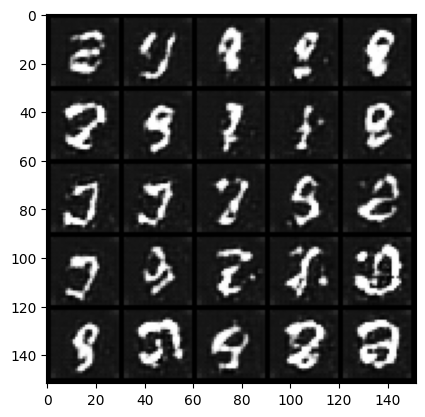

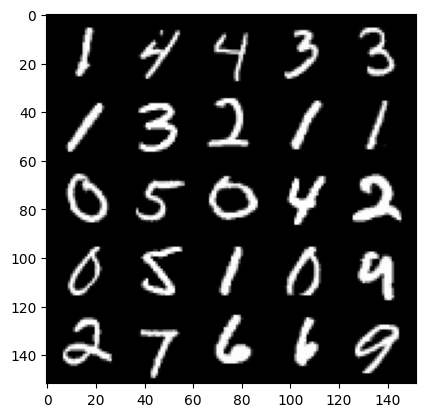

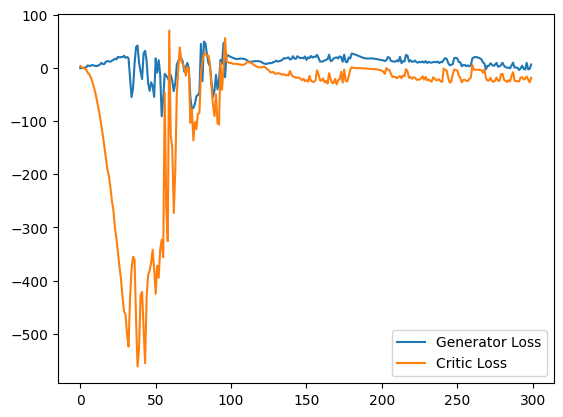

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3707772195339203
real: 15.990554809570312, fake: 7.139578819274902, regularization: 3.7077722549438477
crit_loss: torch.Size([]) -5.1432037353515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.560746967792511
real: 26.903650283813477, fake: 2.365428924560547, regularization: 5.60746955871582
crit_loss: torch.Size([]) -18.93075180053711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38189786672592163
real: 21.966148376464844, fake: -6.22461462020874, regularization: 3.818978786468506
crit_loss: torch.Size([]) -24.371784210205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.403237521648407
real: 30.612472534179688, fake: -1.134869933128357, regularization: 4.032375335693359
crit_loss: torch.Size([]) -27.714967727661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3864206075668335
real: 36.947792053222656, fake: 3.796830654144287, regularization: 3.864206075668335
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24004948139190674
real: 34.85673522949219, fake: 7.51129150390625, regularization: 2.4004948139190674
crit_loss: torch.Size([]) -24.944948196411133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28519684076309204
real: 36.38838195800781, fake: 8.929828643798828, regularization: 2.851968288421631
crit_loss: torch.Size([]) -24.606584548950195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2820453941822052
real: 38.559932708740234, fake: 9.928592681884766, regularization: 2.8204538822174072
crit_loss: torch.Size([]) -25.81088638305664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0120604038238525
real: 34.8751220703125, fake: 1.4776723384857178, regularization: 10.120603561401367
crit_loss: torch.Size([]) -23.276845932006836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1872410923242569
real: 38.383277893066406, fake: 4.74547815322876, regularization: 1.8724108934402466
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27068495750427246
real: 30.735109329223633, fake: 10.7669038772583, regularization: 2.7068495750427246
crit_loss: torch.Size([]) -17.261354446411133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6083194017410278
real: 44.40766906738281, fake: 15.798016548156738, regularization: 6.083193778991699
crit_loss: torch.Size([]) -22.526458740234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6357523798942566
real: 39.71419143676758, fake: 11.421709060668945, regularization: 6.3575239181518555
crit_loss: torch.Size([]) -21.934959411621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.285944402217865
real: 44.04181671142578, fake: 14.015707015991211, regularization: 2.8594441413879395
crit_loss: torch.Size([]) -27.16666603088379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5100292563438416
real: 40.66758728027344, fake: 14.440549850463867, regularization: 5.100292682647705
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27068907022476196
real: 34.028770446777344, fake: 4.554704189300537, regularization: 2.70689058303833
crit_loss: torch.Size([]) -26.767175674438477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32208147644996643
real: 32.580101013183594, fake: 4.591124534606934, regularization: 3.2208147048950195
crit_loss: torch.Size([]) -24.76816177368164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22336195409297943
real: 38.73006057739258, fake: 10.519644737243652, regularization: 2.233619451522827
crit_loss: torch.Size([]) -25.976795196533203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3240465521812439
real: 34.4337158203125, fake: 4.578306198120117, regularization: 3.2404656410217285
crit_loss: torch.Size([]) -26.614944458007812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39300256967544556
real: 32.196346282958984, fake: -0.006975024938583374, regularization: 3.930025577545166
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34281253814697266
real: 8.752737998962402, fake: 1.8574198484420776, regularization: 3.4281253814697266
crit_loss: torch.Size([]) -3.4671926498413086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2362799346446991
real: 12.545888900756836, fake: 3.807770252227783, regularization: 2.3627994060516357
crit_loss: torch.Size([]) -6.375319480895996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35379528999328613
real: 20.934242248535156, fake: -1.0932817459106445, regularization: 3.5379528999328613
crit_loss: torch.Size([]) -18.48957061767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25996851921081543
real: 20.943260192871094, fake: -4.291810035705566, regularization: 2.5996851921081543
crit_loss: torch.Size([]) -22.63538360595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2409355789422989
real: 22.491567611694336, fake: -2.397331476211548, regularization: 2.409355878829956
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5080717206001282
real: 25.932363510131836, fake: -2.8435401916503906, regularization: 5.080717086791992
crit_loss: torch.Size([]) -23.695186614990234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5813236832618713
real: 33.861324310302734, fake: 7.386224746704102, regularization: 5.813236713409424
crit_loss: torch.Size([]) -20.661863327026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41552460193634033
real: 31.248146057128906, fake: 5.1193037033081055, regularization: 4.155245780944824
crit_loss: torch.Size([]) -21.973594665527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18614885210990906
real: 37.79801940917969, fake: 10.922914505004883, regularization: 1.8614885807037354
crit_loss: torch.Size([]) -25.01361656188965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4519316554069519
real: 35.51948547363281, fake: 7.590746879577637, regularization: 4.519316673278809
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1414688527584076
real: -4.114490509033203, fake: -8.86719799041748, regularization: 1.4146885871887207
crit_loss: torch.Size([]) -3.3380188941955566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07255470752716064
real: -4.045705318450928, fake: -8.795053482055664, regularization: 0.7255470752716064
crit_loss: torch.Size([]) -4.023800849914551
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10855555534362793
real: -3.723389148712158, fake: -8.773534774780273, regularization: 1.0855555534362793
crit_loss: torch.Size([]) -3.964590072631836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08108063042163849
real: -3.6582224369049072, fake: -8.864727020263672, regularization: 0.8108062744140625
crit_loss: torch.Size([]) -4.395698547363281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09451054036617279
real: -3.5986859798431396, fake: -8.782670974731445, regularization: 0.9451054334640503

penalty: torch.Size([]) 0.21794462203979492
real: 0.023059166967868805, fake: -7.492830276489258, regularization: 2.179446220397949
crit_loss: torch.Size([]) -5.3364434242248535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07092751562595367
real: -0.04098615050315857, fake: -7.862475395202637, regularization: 0.7092751264572144
crit_loss: torch.Size([]) -7.112214088439941
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07963970303535461
real: 0.1327119916677475, fake: -7.746646881103516, regularization: 0.7963970303535461
crit_loss: torch.Size([]) -7.082961559295654
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07205352932214737
real: 0.3689084053039551, fake: -7.935688495635986, regularization: 0.7205352783203125
crit_loss: torch.Size([]) -7.584061622619629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08299520611763
real: -0.190383642911911, fake: -7.546738624572754, regularization: 0.8299520611763
crit_loss: torch.Size([]) -6.526402

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2170467972755432
real: 42.7224235534668, fake: 9.424579620361328, regularization: 2.1704678535461426
crit_loss: torch.Size([]) -31.127376556396484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22931455075740814
real: 34.447120666503906, fake: 18.076908111572266, regularization: 2.2931454181671143
crit_loss: torch.Size([]) -14.077067375183105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28426599502563477
real: 44.854637145996094, fake: 20.965301513671875, regularization: 2.8426599502563477
crit_loss: torch.Size([]) -21.046676635742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5212458372116089
real: 44.255653381347656, fake: 17.919448852539062, regularization: 5.212458610534668
crit_loss: torch.Size([]) -21.12374496459961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4936997592449188
real: 39.417274475097656, fake: 9.591617584228516, regularization: 4.936997413635254
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2740752100944519
real: 44.420692443847656, fake: 22.07973861694336, regularization: 2.7407522201538086
crit_loss: torch.Size([]) -19.600200653076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34474384784698486
real: 42.54179382324219, fake: 16.36711883544922, regularization: 3.4474384784698486
crit_loss: torch.Size([]) -22.727235794067383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28498128056526184
real: 40.74779510498047, fake: 16.185815811157227, regularization: 2.8498127460479736
crit_loss: torch.Size([]) -21.71216583251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2556411027908325
real: 45.067222595214844, fake: 17.095157623291016, regularization: 2.556411027908325
crit_loss: torch.Size([]) -25.415653228759766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2229200303554535
real: 43.47433853149414, fake: 13.268318176269531, regularization: 2.2292003631591797
crit_l

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3875080943107605
real: 37.36240005493164, fake: 11.107832908630371, regularization: 3.8750810623168945
crit_loss: torch.Size([]) -22.379486083984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19155973196029663
real: 42.41154479980469, fake: 14.354120254516602, regularization: 1.9155973196029663
crit_loss: torch.Size([]) -26.141826629638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22407925128936768
real: 42.08388137817383, fake: 13.486421585083008, regularization: 2.2407925128936768
crit_loss: torch.Size([]) -26.356666564941406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4256349503993988
real: 41.55118942260742, fake: 12.97309684753418, regularization: 4.256349563598633
crit_loss: torch.Size([]) -24.32174301147461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.283759206533432
real: 42.21729278564453, fake: 11.90223503112793, regularization: 2.837592124938965
crit_loss:

real: 42.24995803833008, fake: -4.135316848754883, regularization: 3.048360824584961
crit_loss: torch.Size([]) -43.3369140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45250076055526733
real: 47.975433349609375, fake: 7.438873291015625, regularization: 4.525007724761963
crit_loss: torch.Size([]) -36.01155090332031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31823790073394775
real: 36.32071304321289, fake: -5.497504234313965, regularization: 3.1823790073394775
crit_loss: torch.Size([]) -38.63583755493164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19354689121246338
real: 31.06814956665039, fake: 2.841592311859131, regularization: 1.9354689121246338
crit_loss: torch.Size([]) -26.291088104248047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33374011516571045
real: 45.076751708984375, fake: 18.144071578979492, regularization: 3.3374011516571045
crit_loss: torch.Size([]) -23.595279693603516
gradient_norm: torch.Size([128])
penalty:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40581536293029785
real: 9.190048217773438, fake: -7.071010112762451, regularization: 4.0581536293029785
crit_loss: torch.Size([]) -12.202905654907227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3869175314903259
real: 13.847610473632812, fake: -7.519771099090576, regularization: 3.869175434112549
crit_loss: torch.Size([]) -17.498207092285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4045838713645935
real: 13.973288536071777, fake: -6.80283260345459, regularization: 4.045838832855225
crit_loss: torch.Size([]) -16.730281829833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2861965298652649
real: 15.976426124572754, fake: -5.81362771987915, regularization: 2.8619651794433594
crit_loss: torch.Size([]) -18.928089141845703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2700977027416229
real: 15.282646179199219, fake: -6.533304214477539, regularization: 2.700977087020874
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38762375712394714
real: 39.764564514160156, fake: 0.27052587270736694, regularization: 3.876237630844116
crit_loss: torch.Size([]) -35.617801666259766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3189305067062378
real: 37.25015640258789, fake: 6.121314525604248, regularization: 3.189305067062378
crit_loss: torch.Size([]) -27.939537048339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26994889974594116
real: 22.80715560913086, fake: 7.36279296875, regularization: 2.699489116668701
crit_loss: torch.Size([]) -12.744873046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31336709856987
real: 45.63816833496094, fake: 20.662153244018555, regularization: 3.1336710453033447
crit_loss: torch.Size([]) -21.842344284057617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4117398262023926
real: 33.319923400878906, fake: 1.9826219081878662, regularization: 4.117398262023926
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22294537723064423
real: 37.41291427612305, fake: 2.098633289337158, regularization: 2.2294538021087646
crit_loss: torch.Size([]) -33.0848274230957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5394736528396606
real: 32.78205108642578, fake: 0.31881454586982727, regularization: 5.394736289978027
crit_loss: torch.Size([]) -27.068500518798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16458037495613098
real: 40.555503845214844, fake: 3.6363489627838135, regularization: 1.645803689956665
crit_loss: torch.Size([]) -35.27334976196289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28969836235046387
real: 46.822120666503906, fake: 12.960450172424316, regularization: 2.8969836235046387
crit_loss: torch.Size([]) -30.96468734741211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3399190902709961
real: 39.412208557128906, fake: 9.417671203613281, regularization: 3.399190902709961
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2152789831161499
real: 40.57265853881836, fake: -2.581240653991699, regularization: 2.152789831161499
crit_loss: torch.Size([]) -41.0011100769043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22843505442142487
real: 40.04554748535156, fake: 5.3143768310546875, regularization: 2.284350633621216
crit_loss: torch.Size([]) -32.44681930541992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3389248847961426
real: 45.691246032714844, fake: 7.245894432067871, regularization: 3.389248847961426
crit_loss: torch.Size([]) -35.05610275268555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3064263164997101
real: 38.96714782714844, fake: 0.5350134372711182, regularization: 3.064263105392456
crit_loss: torch.Size([]) -35.36787033081055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4330304265022278
real: 42.66313171386719, fake: 1.8200771808624268, regularization: 4.330304145812988
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5730825662612915
real: 0.35137173533439636, fake: -6.555693626403809, regularization: 5.730825424194336
crit_loss: torch.Size([]) -1.1762399673461914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36385074257850647
real: 0.19477783143520355, fake: -6.937017917633057, regularization: 3.63850736618042
crit_loss: torch.Size([]) -3.493288516998291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10737503319978714
real: 0.21807383000850677, fake: -7.444104194641113, regularization: 1.073750376701355
crit_loss: torch.Size([]) -6.588427543640137
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10989142954349518
real: -1.2398993968963623, fake: -7.679143905639648, regularization: 1.0989142656326294
crit_loss: torch.Size([]) -5.340330123901367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10294950753450394
real: -1.5697236061096191, fake: -8.211652755737305, regularization: 1.029495120048523


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2762514352798462
real: 22.811412811279297, fake: 19.447956085205078, regularization: 2.762514352798462
crit_loss: torch.Size([]) -0.6009423732757568
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3233068883419037
real: 33.61592483520508, fake: 13.43789291381836, regularization: 3.2330689430236816
crit_loss: torch.Size([]) -16.944963455200195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7587726712226868
real: 36.61188507080078, fake: -6.249375343322754, regularization: 7.587726593017578
crit_loss: torch.Size([]) -35.27353286743164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6082046031951904
real: 24.70175552368164, fake: -11.953176498413086, regularization: 6.082046031951904
crit_loss: torch.Size([]) -30.57288360595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49287575483322144
real: 34.52391052246094, fake: -8.222814559936523, regularization: 4.928757667541504
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30784305930137634
real: 3.525339126586914, fake: -6.771015167236328, regularization: 3.078430652618408
crit_loss: torch.Size([]) -7.217923641204834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1162135899066925
real: 3.9048352241516113, fake: -6.242056369781494, regularization: 1.1621358394622803
crit_loss: torch.Size([]) -8.984755516052246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5439046621322632
real: 9.741259574890137, fake: -5.627945899963379, regularization: 5.439046859741211
crit_loss: torch.Size([]) -9.930158615112305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39253970980644226
real: 11.502711296081543, fake: -4.781930923461914, regularization: 3.9253971576690674
crit_loss: torch.Size([]) -12.359244346618652
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41547849774360657
real: 13.78183650970459, fake: -4.12940788269043, regularization: 4.15478515625
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1863708794116974
real: 12.85092544555664, fake: 0.8725991249084473, regularization: 1.863708734512329
crit_loss: torch.Size([]) -10.114618301391602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.295049786567688
real: 13.612405776977539, fake: -0.5691828727722168, regularization: 2.95049786567688
crit_loss: torch.Size([]) -11.231091499328613
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25118228793144226
real: 16.088130950927734, fake: 0.024360284209251404, regularization: 2.5118229389190674
crit_loss: torch.Size([]) -13.551947593688965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3139883577823639
real: 18.621049880981445, fake: -2.793557643890381, regularization: 3.139883518218994
crit_loss: torch.Size([]) -18.27472496032715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.611457884311676
real: -1.6188331842422485, fake: -3.6708507537841797, regularization: 6.114578723907471
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4556608200073242
real: 37.02440643310547, fake: 1.9892003536224365, regularization: 4.556608200073242
crit_loss: torch.Size([]) -30.47859764099121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3182486891746521
real: 27.63912582397461, fake: 17.291725158691406, regularization: 3.1824870109558105
crit_loss: torch.Size([]) -7.164913654327393
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3494003415107727
real: 46.32810592651367, fake: 14.741706848144531, regularization: 3.4940032958984375
crit_loss: torch.Size([]) -28.092395782470703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30435848236083984
real: 32.64459991455078, fake: 0.0625315010547638, regularization: 3.0435848236083984
crit_loss: torch.Size([]) -29.538484573364258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21553733944892883
real: 43.78818893432617, fake: 9.92902660369873, regularization: 2.1553733348846436
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23553124070167542
real: 44.23286437988281, fake: 11.751791000366211, regularization: 2.3553123474121094
crit_loss: torch.Size([]) -30.12575912475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23839494585990906
real: 43.75366973876953, fake: 10.887395858764648, regularization: 2.3839495182037354
crit_loss: torch.Size([]) -30.482322692871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2809794843196869
real: 41.568695068359375, fake: 8.411203384399414, regularization: 2.8097949028015137
crit_loss: torch.Size([]) -30.347698211669922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23981884121894836
real: 45.29151153564453, fake: 14.498058319091797, regularization: 2.398188352584839
crit_loss: torch.Size([]) -28.395265579223633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25016623735427856
real: 44.99858093261719, fake: 15.502328872680664, regularization: 2.501662254333496
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0960107296705246
real: -4.068697929382324, fake: -7.952813625335693, regularization: 0.9601073265075684
crit_loss: torch.Size([]) -2.924008369445801
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08267590403556824
real: -4.18076229095459, fake: -8.159117698669434, regularization: 0.8267590403556824
crit_loss: torch.Size([]) -3.1515963077545166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11242276430130005
real: -4.270978927612305, fake: -8.201346397399902, regularization: 1.1242276430130005
crit_loss: torch.Size([]) -2.8061399459838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08231420814990997
real: -4.271578311920166, fake: -8.34333610534668, regularization: 0.8231420516967773
crit_loss: torch.Size([]) -3.2486157417297363
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10125130414962769
real: -4.295281410217285, fake: -8.38023567199707, regularization: 1.0125130414962769
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08394181728363037
real: -5.546772003173828, fake: -9.673300743103027, regularization: 0.8394181728363037
crit_loss: torch.Size([]) -3.2871105670928955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06544266641139984
real: -5.480523109436035, fake: -9.371334075927734, regularization: 0.6544266939163208
crit_loss: torch.Size([]) -3.236384391784668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07972418516874313
real: -4.944891929626465, fake: -9.539838790893555, regularization: 0.7972418665885925
crit_loss: torch.Size([]) -3.7977049350738525
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05736112967133522
real: -4.929431438446045, fake: -9.348243713378906, regularization: 0.573611319065094
crit_loss: torch.Size([]) -3.845201015472412
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07522393018007278
real: -4.926651954650879, fake: -9.276575088500977, regularization: 0.7522392868995667

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0732569545507431
real: -4.372882843017578, fake: -9.318046569824219, regularization: 0.7325695753097534
crit_loss: torch.Size([]) -4.212594032287598
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06066048517823219
real: -4.407374382019043, fake: -9.294496536254883, regularization: 0.6066048741340637
crit_loss: torch.Size([]) -4.280517101287842
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.060865744948387146
real: -4.439992427825928, fake: -9.421210289001465, regularization: 0.6086574792861938
crit_loss: torch.Size([]) -4.372560501098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07168328762054443
real: -4.436083793640137, fake: -9.475337982177734, regularization: 0.7168328762054443
crit_loss: torch.Size([]) -4.322421073913574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06264162063598633
real: -4.911129951477051, fake: -9.501565933227539, regularization: 0.6264162063598633


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09367778897285461
real: -4.6432390213012695, fake: -9.919514656066895, regularization: 0.9367778897285461
crit_loss: torch.Size([]) -4.3394975662231445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0606803260743618
real: -5.192030906677246, fake: -9.987902641296387, regularization: 0.6068032383918762
crit_loss: torch.Size([]) -4.18906831741333
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0819893628358841
real: -5.160927772521973, fake: -9.865680694580078, regularization: 0.8198935985565186
crit_loss: torch.Size([]) -3.884859323501587
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06016715615987778
real: -5.107256889343262, fake: -9.869617462158203, regularization: 0.601671576499939
crit_loss: torch.Size([]) -4.160688877105713
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04825455695390701
real: -5.0453410148620605, fake: -9.852666854858398, regularization: 0.48254555463790894


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08256153017282486
real: -3.6930904388427734, fake: -8.517277717590332, regularization: 0.8256152868270874
crit_loss: torch.Size([]) -3.9985718727111816
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05410808324813843
real: -3.6300997734069824, fake: -8.690086364746094, regularization: 0.5410808324813843
crit_loss: torch.Size([]) -4.5189056396484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05966697260737419
real: -3.601663112640381, fake: -8.467977523803711, regularization: 0.5966697335243225
crit_loss: torch.Size([]) -4.269644737243652
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05377252399921417
real: -4.052152633666992, fake: -8.626962661743164, regularization: 0.5377252101898193
crit_loss: torch.Size([]) -4.037084579467773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07408259809017181
real: -4.086004257202148, fake: -8.498041152954102, regularization: 0.7408260107040

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07158096879720688
real: -3.9928371906280518, fake: -8.585546493530273, regularization: 0.71580970287323
crit_loss: torch.Size([]) -3.8768997192382812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.056827861815690994
real: -3.8268613815307617, fake: -8.336319923400879, regularization: 0.5682786107063293
crit_loss: torch.Size([]) -3.9411799907684326
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05331890657544136
real: -3.6577067375183105, fake: -8.280513763427734, regularization: 0.533189058303833
crit_loss: torch.Size([]) -4.089617729187012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06800276041030884
real: -3.5146234035491943, fake: -8.153100967407227, regularization: 0.6800276041030884
crit_loss: torch.Size([]) -3.9584498405456543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08413907885551453
real: -3.3669068813323975, fake: -7.922059535980225, regularization: 0.84139078855

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07948879897594452
real: -3.236203908920288, fake: -8.212594985961914, regularization: 0.7948880195617676
crit_loss: torch.Size([]) -4.181502819061279
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0656379833817482
real: -3.2699575424194336, fake: -8.448362350463867, regularization: 0.6563798189163208
crit_loss: torch.Size([]) -4.522025108337402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09869343042373657
real: -3.499115228652954, fake: -8.42755126953125, regularization: 0.9869343042373657
crit_loss: torch.Size([]) -3.941502094268799
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09234504401683807
real: -3.470205783843994, fake: -8.317998886108398, regularization: 0.9234504699707031
crit_loss: torch.Size([]) -3.924342632293701
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13607382774353027
real: -3.395066738128662, fake: -8.303291320800781, regularization: 1.3607382774353027
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07372977584600449
real: -3.3412859439849854, fake: -7.881418228149414, regularization: 0.737297773361206
crit_loss: torch.Size([]) -3.8028347492218018
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05634254217147827
real: -3.2607336044311523, fake: -7.769599914550781, regularization: 0.5634254217147827
crit_loss: torch.Size([]) -3.9454407691955566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20788608491420746
real: -3.2025146484375, fake: -7.777233123779297, regularization: 2.0788607597351074
crit_loss: torch.Size([]) -2.4958577156066895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05784689635038376
real: -3.2109766006469727, fake: -7.720337390899658, regularization: 0.5784689784049988
crit_loss: torch.Size([]) -3.930891752243042
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06712926924228668
real: -3.0145368576049805, fake: -7.801962852478027, regularization: 0.6712926626205

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06798385828733444
real: -1.5615084171295166, fake: -7.491577625274658, regularization: 0.6798385977745056
crit_loss: torch.Size([]) -5.250230312347412
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046079427003860474
real: -2.2812294960021973, fake: -7.153636932373047, regularization: 0.46079427003860474
crit_loss: torch.Size([]) -4.4116129875183105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04636683315038681
real: -2.246177911758423, fake: -7.112461090087891, regularization: 0.4636683464050293
crit_loss: torch.Size([]) -4.402615070343018
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33483099937438965
real: -2.2095699310302734, fake: -7.21516227722168, regularization: 3.3483099937438965
crit_loss: torch.Size([]) -1.6572823524475098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.053440600633621216
real: -2.2796645164489746, fake: -7.177816390991211, regularization: 0.534406006

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08892612159252167
real: -0.2526399493217468, fake: -5.910091400146484, regularization: 0.8892612457275391
crit_loss: torch.Size([]) -4.768190383911133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25746840238571167
real: -0.2611406743526459, fake: -5.982762336730957, regularization: 2.5746841430664062
crit_loss: torch.Size([]) -3.146937370300293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10939475148916245
real: -0.4649786651134491, fake: -6.041749477386475, regularization: 1.0939475297927856
crit_loss: torch.Size([]) -4.482823371887207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07906265556812286
real: -0.8681061863899231, fake: -6.190633773803711, regularization: 0.7906265258789062
crit_loss: torch.Size([]) -4.531900882720947
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23758462071418762
real: -0.8806931376457214, fake: -6.397605895996094, regularization: 2.375846147537

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09387031197547913
real: 1.1230871677398682, fake: -5.288267135620117, regularization: 0.9387031197547913
crit_loss: torch.Size([]) -5.47265100479126
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09234820306301117
real: 1.1922719478607178, fake: -4.961575984954834, regularization: 0.9234820604324341
crit_loss: torch.Size([]) -5.230365753173828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0766231045126915
real: 1.2852282524108887, fake: -5.171921730041504, regularization: 0.7662310600280762
crit_loss: torch.Size([]) -5.690918922424316
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08035315573215485
real: 1.3841222524642944, fake: -5.094741344451904, regularization: 0.8035315275192261
crit_loss: torch.Size([]) -5.675332069396973
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07901857793331146
real: 1.4986779689788818, fake: -5.205617904663086, regularization: 0.790185809135437
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1537945568561554
real: 5.600887298583984, fake: -3.279421806335449, regularization: 1.5379455089569092
crit_loss: torch.Size([]) -7.342363357543945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1640983521938324
real: 5.827988147735596, fake: -3.3632726669311523, regularization: 1.6409835815429688
crit_loss: torch.Size([]) -7.5502777099609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1305708885192871
real: 5.107485771179199, fake: -2.892467498779297, regularization: 1.305708885192871
crit_loss: torch.Size([]) -6.694244384765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16948387026786804
real: 5.4742631912231445, fake: -2.1483447551727295, regularization: 1.6948387622833252
crit_loss: torch.Size([]) -5.927769660949707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24008417129516602
real: 5.640804290771484, fake: -2.5972766876220703, regularization: 2.40084171295166
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4969705045223236
real: 33.952911376953125, fake: 9.906538963317871, regularization: 4.969705104827881
crit_loss: torch.Size([]) -19.0766658782959
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4164503812789917
real: 34.173187255859375, fake: 8.868141174316406, regularization: 4.164504051208496
crit_loss: torch.Size([]) -21.140541076660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3841891884803772
real: 35.038509368896484, fake: 8.729644775390625, regularization: 3.8418917655944824
crit_loss: torch.Size([]) -22.46697235107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40373969078063965
real: 38.35261154174805, fake: 10.937307357788086, regularization: 4.0373969078063965
crit_loss: torch.Size([]) -23.377906799316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43285587430000305
real: 39.06760787963867, fake: 13.79681396484375, regularization: 4.328558921813965
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32400232553482056
real: 46.673851013183594, fake: 15.494860649108887, regularization: 3.240023136138916
crit_loss: torch.Size([]) -27.938966751098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.208048477768898
real: 34.028778076171875, fake: 21.926998138427734, regularization: 2.0804848670959473
crit_loss: torch.Size([]) -10.021295547485352
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.368161678314209
real: 42.50267028808594, fake: 24.41835594177246, regularization: 3.68161678314209
crit_loss: torch.Size([]) -14.402697563171387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41730237007141113
real: 47.130775451660156, fake: 20.64630889892578, regularization: 4.173023700714111
crit_loss: torch.Size([]) -22.311443328857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6507874131202698
real: 44.23491668701172, fake: 14.668547630310059, regularization: 6.507874011993408
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26888546347618103
real: 30.21622085571289, fake: 8.800752639770508, regularization: 2.688854694366455
crit_loss: torch.Size([]) -18.726613998413086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27119237184524536
real: 40.29389953613281, fake: 16.9986572265625, regularization: 2.711923599243164
crit_loss: torch.Size([]) -20.58331871032715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32071343064308167
real: 41.090431213378906, fake: 18.52638816833496, regularization: 3.207134246826172
crit_loss: torch.Size([]) -19.356908798217773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3237687945365906
real: 41.79866027832031, fake: 17.852230072021484, regularization: 3.2376880645751953
crit_loss: torch.Size([]) -20.708742141723633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3495689630508423
real: 41.70665740966797, fake: 18.335485458374023, regularization: 3.495689630508423
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2801871299743652
real: 9.827107429504395, fake: -6.748934745788574, regularization: 12.801871299743652
crit_loss: torch.Size([]) -3.7741708755493164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.301102876663208
real: 12.674604415893555, fake: -3.672870635986328, regularization: 13.011028289794922
crit_loss: torch.Size([]) -3.336446762084961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4729945957660675
real: 22.18135643005371, fake: 5.509022235870361, regularization: 4.729946136474609
crit_loss: torch.Size([]) -11.942388534545898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5540560483932495
real: 25.17085075378418, fake: 6.85191535949707, regularization: 5.540560722351074
crit_loss: torch.Size([]) -12.778374671936035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2418513149023056
real: 22.216751098632812, fake: 2.843123435974121, regularization: 2.418513059616089
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41589993238449097
real: 45.783329010009766, fake: 4.659645080566406, regularization: 4.158999443054199
crit_loss: torch.Size([]) -36.964683532714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26561424136161804
real: 43.807334899902344, fake: 5.593337059020996, regularization: 2.656142473220825
crit_loss: torch.Size([]) -35.55785369873047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2950006425380707
real: 36.51069259643555, fake: 10.205547332763672, regularization: 2.9500064849853516
crit_loss: torch.Size([]) -23.355138778686523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2460450530052185
real: 43.69902038574219, fake: 14.076255798339844, regularization: 2.4604506492614746
crit_loss: torch.Size([]) -27.16231346130371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.234798401594162
real: 45.69001770019531, fake: 19.39826202392578, regularization: 2.3479840755462646
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2763274312019348
real: 12.700618743896484, fake: 7.602327823638916, regularization: 2.7632741928100586
crit_loss: torch.Size([]) -2.3350167274475098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33155617117881775
real: 13.805032730102539, fake: 5.183873176574707, regularization: 3.3155617713928223
crit_loss: torch.Size([]) -5.30559778213501
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42264407873153687
real: 15.607385635375977, fake: 6.233808517456055, regularization: 4.226440906524658
crit_loss: torch.Size([]) -5.147136211395264
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3629305958747864
real: 19.352046966552734, fake: 4.893198013305664, regularization: 3.629305839538574
crit_loss: torch.Size([]) -10.829543113708496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6014634370803833
real: 22.53586769104004, fake: 0.7417420148849487, regularization: 6.014634132385254
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20016981661319733
real: -0.08587124943733215, fake: -5.734003067016602, regularization: 2.0016982555389404
crit_loss: torch.Size([]) -3.6464335918426514
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11695439368486404
real: -0.6018062829971313, fake: -4.022854804992676, regularization: 1.169543981552124
crit_loss: torch.Size([]) -2.25150465965271
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38836222887039185
real: -1.5609196424484253, fake: -5.241693019866943, regularization: 3.883622169494629
crit_loss: torch.Size([]) 0.2028489112854004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4479188919067383
real: -2.0610032081604004, fake: -7.289699554443359, regularization: 4.479188919067383
crit_loss: torch.Size([]) -0.7495074272155762
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15804380178451538
real: -2.2598679065704346, fake: -7.957194805145264, regularization: 1.58043801784515

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6203438639640808
real: -1.4782735109329224, fake: -10.373775482177734, regularization: 6.203438758850098
crit_loss: torch.Size([]) -2.692063331604004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6718025803565979
real: -0.44620370864868164, fake: -9.381378173828125, regularization: 6.7180256843566895
crit_loss: torch.Size([]) -2.217149257659912
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.218251034617424
real: -0.2115458995103836, fake: -9.574565887451172, regularization: 2.1825103759765625
crit_loss: torch.Size([]) -7.180509567260742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15044569969177246
real: -0.6391189694404602, fake: -9.258186340332031, regularization: 1.5044569969177246
crit_loss: torch.Size([]) -7.114610195159912
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10822221636772156
real: -0.46181121468544006, fake: -9.258235931396484, regularization: 1.08222222328186

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28709304332733154
real: 3.4907281398773193, fake: -12.840372085571289, regularization: 2.8709304332733154
crit_loss: torch.Size([]) -13.460169792175293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3994675278663635
real: 9.810646057128906, fake: -8.02961540222168, regularization: 3.9946751594543457
crit_loss: torch.Size([]) -13.845586776733398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38335758447647095
real: 15.36546802520752, fake: -3.8148550987243652, regularization: 3.83357572555542
crit_loss: torch.Size([]) -15.346746444702148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3160051703453064
real: 15.461811065673828, fake: -3.9335391521453857, regularization: 3.1600518226623535
crit_loss: torch.Size([]) -16.23529815673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34226900339126587
real: 14.302888870239258, fake: -4.700634956359863, regularization: 3.422689914703369
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35906100273132324
real: 38.07392501831055, fake: 6.1865997314453125, regularization: 3.5906100273132324
crit_loss: torch.Size([]) -28.296714782714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2500295341014862
real: 42.10675811767578, fake: 5.394482135772705, regularization: 2.500295400619507
crit_loss: torch.Size([]) -34.21198272705078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42533352971076965
real: 14.679523468017578, fake: 7.390182018280029, regularization: 4.253335475921631
crit_loss: torch.Size([]) -3.036005973815918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24581411480903625
real: 37.043128967285156, fake: 5.201154708862305, regularization: 2.4581410884857178
crit_loss: torch.Size([]) -29.383832931518555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23217470943927765
real: 23.224044799804688, fake: -2.8912696838378906, regularization: 2.321747064590454
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25348031520843506
real: 39.113624572753906, fake: 18.060882568359375, regularization: 2.5348031520843506
crit_loss: torch.Size([]) -18.5179386138916
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35195520520210266
real: 39.95869445800781, fake: 8.378077507019043, regularization: 3.519551992416382
crit_loss: torch.Size([]) -28.061063766479492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38874900341033936
real: 27.662553787231445, fake: 0.15851816534996033, regularization: 3.8874900341033936
crit_loss: torch.Size([]) -23.616546630859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3943468928337097
real: 35.22343444824219, fake: 3.3492655754089355, regularization: 3.9434690475463867
crit_loss: torch.Size([]) -27.93069839477539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2358277589082718
real: 41.73259735107422, fake: 14.598617553710938, regularization: 2.3582775592803955
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28562113642692566
real: 36.81868362426758, fake: -3.922475814819336, regularization: 2.8562114238739014
crit_loss: torch.Size([]) -37.884944915771484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3716440200805664
real: -15.0989351272583, fake: 6.692785739898682, regularization: 3.716440200805664
crit_loss: torch.Size([]) 25.508161544799805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3547701835632324
real: -17.191396713256836, fake: 1.3506104946136475, regularization: 3.547701835632324
crit_loss: torch.Size([]) 22.089710235595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.094594120979309
real: -17.88507843017578, fake: -16.558387756347656, regularization: 10.945940971374512
crit_loss: torch.Size([]) 12.272631645202637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8543216586112976
real: -12.118180274963379, fake: -16.514545440673828, regularization: 8.543216705322266
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.532189130783081
real: -4.7225341796875, fake: -12.327020645141602, regularization: 5.3218913078308105
crit_loss: torch.Size([]) -2.282595157623291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6816772222518921
real: -4.461816310882568, fake: -12.402166366577148, regularization: 6.8167724609375
crit_loss: torch.Size([]) -1.12357759475708
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8540650606155396
real: -3.330331325531006, fake: -11.70179557800293, regularization: 8.540650367736816
crit_loss: torch.Size([]) 0.16918659210205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8150889873504639
real: -2.065680980682373, fake: -9.895248413085938, regularization: 8.150890350341797
crit_loss: torch.Size([]) 0.3213229179382324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2359213829040527
real: -2.374415397644043, fake: -9.512985229492188, regularization: 12.359213829040527
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5187639594078064
real: 26.19455909729004, fake: 2.5962157249450684, regularization: 5.1876397132873535
crit_loss: torch.Size([]) -18.410703659057617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4517902731895447
real: 26.978124618530273, fake: -1.3506348133087158, regularization: 4.517902851104736
crit_loss: torch.Size([]) -23.81085777282715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5345888733863831
real: 26.325252532958984, fake: -3.5986733436584473, regularization: 5.345888614654541
crit_loss: torch.Size([]) -24.57803726196289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8107118010520935
real: 28.81788444519043, fake: -1.7547175884246826, regularization: 8.107117652893066
crit_loss: torch.Size([]) -22.465484619140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7727117538452148
real: 30.123634338378906, fake: -1.3770859241485596, regularization: 7.727117538452148
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3687434792518616
real: 36.09681701660156, fake: 11.363069534301758, regularization: 3.687434673309326
crit_loss: torch.Size([]) -21.04631233215332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2434823215007782
real: 37.498130798339844, fake: 11.396069526672363, regularization: 2.4348232746124268
crit_loss: torch.Size([]) -23.667238235473633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21333777904510498
real: 31.105148315429688, fake: 12.876087188720703, regularization: 2.13337779045105
crit_loss: torch.Size([]) -16.095684051513672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2904028296470642
real: 36.991573333740234, fake: 10.964120864868164, regularization: 2.9040284156799316
crit_loss: torch.Size([]) -23.123424530029297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5865585207939148
real: 30.49856948852539, fake: 5.297595500946045, regularization: 5.8655853271484375
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19480125606060028
real: 16.89327621459961, fake: 8.536002159118652, regularization: 1.9480125904083252
crit_loss: torch.Size([]) -6.409261703491211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2279234230518341
real: 20.5147762298584, fake: 11.68143081665039, regularization: 2.2792341709136963
crit_loss: torch.Size([]) -6.554111480712891
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22820892930030823
real: 28.042144775390625, fake: 13.725933074951172, regularization: 2.2820892333984375
crit_loss: torch.Size([]) -12.034122467041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2337869256734848
real: 36.880435943603516, fake: 15.218921661376953, regularization: 2.337869167327881
crit_loss: torch.Size([]) -19.323644638061523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5594342947006226
real: -0.011541485786437988, fake: 4.715841770172119, regularization: 5.594343185424805
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2602376937866211
real: 39.93247604370117, fake: 11.43751335144043, regularization: 2.602376937866211
crit_loss: torch.Size([]) -25.89258575439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1794019490480423
real: 14.123733520507812, fake: 10.650956153869629, regularization: 1.7940194606781006
crit_loss: torch.Size([]) -1.678757905960083
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.531428873538971
real: 23.661754608154297, fake: 1.9084417819976807, regularization: 5.31428861618042
crit_loss: torch.Size([]) -16.439023971557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23599742352962494
real: 26.579368591308594, fake: -9.192110061645508, regularization: 2.3599741458892822
crit_loss: torch.Size([]) -33.411502838134766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7906309962272644
real: 29.881513595581055, fake: -8.908199310302734, regularization: 7.906310081481934
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30819082260131836
real: -10.838616371154785, fake: -16.313678741455078, regularization: 3.0819082260131836
crit_loss: torch.Size([]) -2.3931541442871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5997000336647034
real: -10.54600715637207, fake: -17.565998077392578, regularization: 5.997000217437744
crit_loss: torch.Size([]) -1.0229907035827637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.526481032371521
real: -8.186131477355957, fake: -14.284797668457031, regularization: 5.264810562133789
crit_loss: torch.Size([]) -0.8338556289672852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5397054553031921
real: -10.516894340515137, fake: -15.228706359863281, regularization: 5.397054672241211
crit_loss: torch.Size([]) 0.6852426528930664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7364170551300049
real: -9.266636848449707, fake: -13.73058795928955, regularization: 7.364170551300049


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17347463965415955
real: 24.833736419677734, fake: 15.738951683044434, regularization: 1.7347464561462402
crit_loss: torch.Size([]) -7.3600382804870605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23425734043121338
real: 29.98599624633789, fake: 3.1183862686157227, regularization: 2.342573404312134
crit_loss: torch.Size([]) -24.52503776550293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20334148406982422
real: 24.35378646850586, fake: -0.17558515071868896, regularization: 2.033414840698242
crit_loss: torch.Size([]) -22.495956420898438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3801339268684387
real: 31.55797004699707, fake: 3.7872769832611084, regularization: 3.8013391494750977
crit_loss: torch.Size([]) -23.96935272216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24273425340652466
real: 35.223934173583984, fake: 4.710142135620117, regularization: 2.427342414855957
crit

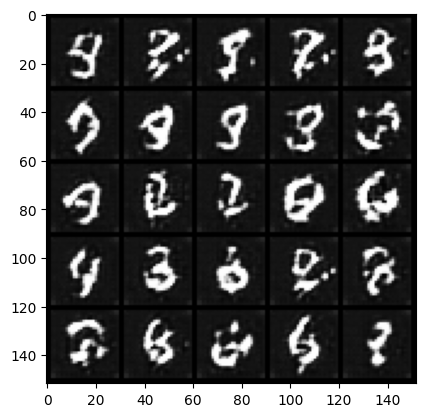

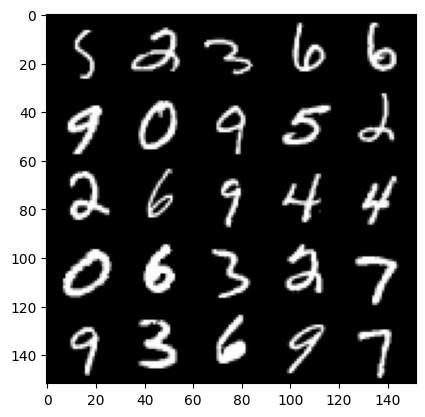

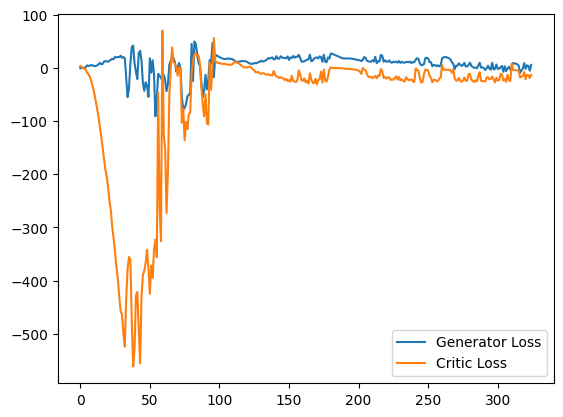

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15152768790721893
real: 33.913978576660156, fake: 8.325345039367676, regularization: 1.5152769088745117
crit_loss: torch.Size([]) -24.07335662841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11601206660270691
real: 41.11944580078125, fake: 12.173913955688477, regularization: 1.1601207256317139
crit_loss: torch.Size([]) -27.785411834716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18186941742897034
real: 39.34676742553711, fake: 12.940073013305664, regularization: 1.8186941146850586
crit_loss: torch.Size([]) -24.588001251220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15148751437664032
real: 37.59877014160156, fake: 9.746206283569336, regularization: 1.5148751735687256
crit_loss: torch.Size([]) -26.337688446044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2104649841785431
real: 37.88787841796875, fake: 9.582767486572266, regularization: 2.104649782180786
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2519136965274811
real: 33.193267822265625, fake: 0.986030638217926, regularization: 2.519136905670166
crit_loss: torch.Size([]) -29.688100814819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3121749460697174
real: 42.178096771240234, fake: 11.717604637145996, regularization: 3.1217494010925293
crit_loss: torch.Size([]) -27.338741302490234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23743918538093567
real: 37.4150505065918, fake: 3.6580963134765625, regularization: 2.374391794204712
crit_loss: torch.Size([]) -31.3825626373291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15280207991600037
real: 17.700458526611328, fake: 8.817633628845215, regularization: 1.5280208587646484
crit_loss: torch.Size([]) -7.354804039001465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1740822046995163
real: 25.283702850341797, fake: 13.15937614440918, regularization: 1.7408220767974854
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18327254056930542
real: 35.59260559082031, fake: 9.078788757324219, regularization: 1.8327254056930542
crit_loss: torch.Size([]) -24.68109130859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21319086849689484
real: 28.804698944091797, fake: -2.624128818511963, regularization: 2.131908655166626
crit_loss: torch.Size([]) -29.296918869018555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2828153073787689
real: 34.50460433959961, fake: 4.519484519958496, regularization: 2.828153133392334
crit_loss: torch.Size([]) -27.156965255737305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4144669771194458
real: 37.39201354980469, fake: 3.7346549034118652, regularization: 4.144669532775879
crit_loss: torch.Size([]) -29.512691497802734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2961030602455139
real: 35.572139739990234, fake: 3.4217920303344727, regularization: 2.9610304832458496
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23728246986865997
real: 24.826433181762695, fake: 14.741076469421387, regularization: 2.3728246688842773
crit_loss: torch.Size([]) -7.712532043457031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39548689126968384
real: 36.49390411376953, fake: 3.084155321121216, regularization: 3.954868793487549
crit_loss: torch.Size([]) -29.454879760742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3659098446369171
real: 13.92402458190918, fake: -4.19129753112793, regularization: 3.6590983867645264
crit_loss: torch.Size([]) -14.456223487854004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17327278852462769
real: 16.204545974731445, fake: -2.6709489822387695, regularization: 1.7327278852462769
crit_loss: torch.Size([]) -17.14276885986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3380082845687866
real: 26.195968627929688, fake: 1.8694543838500977, regularization: 3.380082845687866
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35063642263412476
real: 33.427738189697266, fake: 9.52808952331543, regularization: 3.506364345550537
crit_loss: torch.Size([]) -20.39328384399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20244160294532776
real: 39.62410354614258, fake: 13.104202270507812, regularization: 2.024415969848633
crit_loss: torch.Size([]) -24.495485305786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16986629366874695
real: 39.542083740234375, fake: 14.623197555541992, regularization: 1.6986629962921143
crit_loss: torch.Size([]) -23.22022247314453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2962891459465027
real: 36.916717529296875, fake: 8.259632110595703, regularization: 2.9628915786743164
crit_loss: torch.Size([]) -25.694194793701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21326860785484314
real: 23.907489776611328, fake: 12.013822555541992, regularization: 2.132686138153076
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2847214341163635
real: 40.81713104248047, fake: -3.396847724914551, regularization: 2.8472142219543457
crit_loss: torch.Size([]) -41.366764068603516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4032494127750397
real: 18.64157485961914, fake: 6.316627502441406, regularization: 4.032494068145752
crit_loss: torch.Size([]) -8.29245376586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20970889925956726
real: 34.739341735839844, fake: 13.69511604309082, regularization: 2.0970890522003174
crit_loss: torch.Size([]) -18.94713592529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.350739449262619
real: 46.70863723754883, fake: 22.989038467407227, regularization: 3.507394552230835
crit_loss: torch.Size([]) -20.212203979492188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3386482000350952
real: 43.02613067626953, fake: 16.378705978393555, regularization: 3.386482000350952
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17912796139717102
real: -4.266181468963623, fake: -7.302229881286621, regularization: 1.7912795543670654
crit_loss: torch.Size([]) -1.2447688579559326
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15441922843456268
real: -4.250805377960205, fake: -7.387682914733887, regularization: 1.5441923141479492
crit_loss: torch.Size([]) -1.5926852226257324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18902122974395752
real: -4.2525177001953125, fake: -7.490362167358398, regularization: 1.8902122974395752
crit_loss: torch.Size([]) -1.3476321697235107
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15865884721279144
real: -3.7358624935150146, fake: -7.417546272277832, regularization: 1.5865885019302368
crit_loss: torch.Size([]) -2.095095157623291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19786067306995392
real: -3.801504611968994, fake: -7.437441349029541, regularization: 1.978606700897

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09248076379299164
real: -3.306532621383667, fake: -7.168761253356934, regularization: 0.9248076677322388
crit_loss: torch.Size([]) -2.9374208450317383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1682356894016266
real: -3.3523306846618652, fake: -7.02821683883667, regularization: 1.682356834411621
crit_loss: torch.Size([]) -1.9935293197631836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11413727700710297
real: -3.4369089603424072, fake: -7.517118453979492, regularization: 1.141372799873352
crit_loss: torch.Size([]) -2.9388370513916016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11229939013719559
real: -3.4960381984710693, fake: -7.338633060455322, regularization: 1.1229939460754395
crit_loss: torch.Size([]) -2.7196009159088135
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09977439045906067
real: -3.6053152084350586, fake: -7.522499084472656, regularization: 0.9977439045906

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1422220766544342
real: -3.290457248687744, fake: -7.237215042114258, regularization: 1.4222207069396973
crit_loss: torch.Size([]) -2.5245370864868164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07276085764169693
real: -3.3257012367248535, fake: -7.3675947189331055, regularization: 0.7276085615158081
crit_loss: torch.Size([]) -3.3142848014831543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1953950673341751
real: -3.61281156539917, fake: -7.432663917541504, regularization: 1.9539506435394287
crit_loss: torch.Size([]) -1.8659017086029053
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20456907153129578
real: -3.6124699115753174, fake: -7.426951885223389, regularization: 2.0456907749176025
crit_loss: torch.Size([]) -1.7687911987304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.054245587438344955
real: -3.584541082382202, fake: -7.406909942626953, regularization: 0.542455852031

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1257236897945404
real: -2.7311253547668457, fake: -7.405004024505615, regularization: 1.2572369575500488
crit_loss: torch.Size([]) -3.4166417121887207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07939949631690979
real: -2.7581946849823, fake: -7.289554595947266, regularization: 0.7939949631690979
crit_loss: torch.Size([]) -3.7373647689819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07421968877315521
real: -2.737577438354492, fake: -7.376680374145508, regularization: 0.7421969175338745
crit_loss: torch.Size([]) -3.8969058990478516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08804716169834137
real: -2.660783052444458, fake: -7.359158039093018, regularization: 0.8804715871810913
crit_loss: torch.Size([]) -3.8179030418395996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06361224502325058
real: -2.7295446395874023, fake: -6.956599235534668, regularization: 0.63612246513366

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05210219323635101
real: -2.3671698570251465, fake: -6.952709197998047, regularization: 0.5210219621658325
crit_loss: torch.Size([]) -4.064517498016357
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10600756853818893
real: -2.445955753326416, fake: -6.841675758361816, regularization: 1.0600756406784058
crit_loss: torch.Size([]) -3.335644245147705
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09143605083227158
real: -2.4532454013824463, fake: -6.995375633239746, regularization: 0.914360523223877
crit_loss: torch.Size([]) -3.627769947052002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.058154650032520294
real: -2.4214816093444824, fake: -6.945810794830322, regularization: 0.5815464854240417
crit_loss: torch.Size([]) -3.9427826404571533
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05914778262376785
real: -2.4083175659179688, fake: -6.808074951171875, regularization: 0.591477811336

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.055399589240550995
real: -1.7370163202285767, fake: -6.116904258728027, regularization: 0.5539959073066711
crit_loss: torch.Size([]) -3.825892210006714
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.048801571130752563
real: -1.600473403930664, fake: -5.965645790100098, regularization: 0.48801571130752563
crit_loss: torch.Size([]) -3.8771567344665527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09971927106380463
real: -1.4839285612106323, fake: -5.910876750946045, regularization: 0.9971927404403687
crit_loss: torch.Size([]) -3.429755210876465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06668136268854141
real: -1.7508337497711182, fake: -5.668298721313477, regularization: 0.6668136119842529
crit_loss: torch.Size([]) -3.2506513595581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12478479743003845
real: -1.7279391288757324, fake: -5.800342559814453, regularization: 1.24784803

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09646312892436981
real: -0.7425591945648193, fake: -5.332773208618164, regularization: 0.9646313190460205
crit_loss: torch.Size([]) -3.625582456588745
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05753568187355995
real: -0.6493936777114868, fake: -5.08712100982666, regularization: 0.5753568410873413
crit_loss: torch.Size([]) -3.862370491027832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06681276112794876
real: -0.6051892638206482, fake: -5.226223945617676, regularization: 0.6681275963783264
crit_loss: torch.Size([]) -3.952907085418701
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.041759341955184937
real: -0.5684987306594849, fake: -5.024744033813477, regularization: 0.41759341955184937
crit_loss: torch.Size([]) -4.038651943206787
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06943759322166443
real: -0.5594094395637512, fake: -5.092757225036621, regularization: 0.69437593221

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08222778141498566
real: 0.8415051698684692, fake: -3.742541790008545, regularization: 0.8222777843475342
crit_loss: torch.Size([]) -3.7617690563201904
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12084853649139404
real: 0.8858606815338135, fake: -3.8573431968688965, regularization: 1.2084853649139404
crit_loss: torch.Size([]) -3.5347187519073486
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04781373590230942
real: 0.8866507411003113, fake: -3.9904825687408447, regularization: 0.47813737392425537
crit_loss: torch.Size([]) -4.398995876312256
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05286288633942604
real: 0.8478354215621948, fake: -4.015233516693115, regularization: 0.5286288857460022
crit_loss: torch.Size([]) -4.334440231323242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.042309172451496124
real: 0.8481224179267883, fake: -3.963430166244507, regularization: 0.42309170961

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19501104950904846
real: 0.7983839511871338, fake: -3.929504871368408, regularization: 1.9501104354858398
crit_loss: torch.Size([]) -2.7777786254882812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11781006306409836
real: 0.8182045817375183, fake: -3.8645174503326416, regularization: 1.1781005859375
crit_loss: torch.Size([]) -3.5046215057373047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06240662932395935
real: 1.0039969682693481, fake: -3.673712730407715, regularization: 0.6240662932395935
crit_loss: torch.Size([]) -4.053643226623535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05323436111211777
real: 1.1225693225860596, fake: -3.775313138961792, regularization: 0.5323436260223389
crit_loss: torch.Size([]) -4.365538597106934
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05795900151133537
real: 1.1267814636230469, fake: -3.464350461959839, regularization: 0.5795900225639343


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.058575477451086044
real: 2.662832736968994, fake: -1.8466049432754517, regularization: 0.5857547521591187
crit_loss: torch.Size([]) -3.923682689666748
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07004342973232269
real: 2.209404706954956, fake: -2.202455520629883, regularization: 0.7004343271255493
crit_loss: torch.Size([]) -3.711426258087158
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2400444895029068
real: 2.2196788787841797, fake: -2.161862373352051, regularization: 2.400444984436035
crit_loss: torch.Size([]) -1.9810962677001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11365525424480438
real: 2.245001792907715, fake: -2.081305503845215, regularization: 1.1365525722503662
crit_loss: torch.Size([]) -3.1897547245025635
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08598431944847107
real: 2.308030605316162, fake: -1.720381259918213, regularization: 0.8598431944847107
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11744140088558197
real: 5.018238544464111, fake: -1.195151925086975, regularization: 1.174414038658142
crit_loss: torch.Size([]) -5.038976192474365
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09723678231239319
real: 4.970854759216309, fake: -1.3580436706542969, regularization: 0.9723678231239319
crit_loss: torch.Size([]) -5.356530666351318
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08012444525957108
real: 5.005575180053711, fake: -1.176511526107788, regularization: 0.8012444376945496
crit_loss: torch.Size([]) -5.380842685699463
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10065021365880966
real: 3.4391379356384277, fake: -1.2031127214431763, regularization: 1.0065021514892578
crit_loss: torch.Size([]) -3.6357483863830566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07194766402244568
real: 3.394256353378296, fake: -1.287632703781128, regularization: 0.7194766402244568
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18632057309150696
real: 4.591170310974121, fake: -1.743851900100708, regularization: 1.8632056713104248
crit_loss: torch.Size([]) -4.471816062927246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26137933135032654
real: 4.730039119720459, fake: -1.4381067752838135, regularization: 2.61379337310791
crit_loss: torch.Size([]) -3.5543527603149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0898369774222374
real: 4.814981460571289, fake: -1.7398059368133545, regularization: 0.8983697891235352
crit_loss: torch.Size([]) -5.6564178466796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09479537606239319
real: 5.024147987365723, fake: -1.2999893426895142, regularization: 0.9479537606239319
crit_loss: torch.Size([]) -5.37618350982666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08964015543460846
real: 5.2233452796936035, fake: -0.9576503038406372, regularization: 0.8964015245437622
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11630501598119736
real: 4.667200088500977, fake: -0.22722162306308746, regularization: 1.1630501747131348
crit_loss: torch.Size([]) -3.7313714027404785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09218522161245346
real: 4.691522598266602, fake: -0.603162407875061, regularization: 0.9218522310256958
crit_loss: torch.Size([]) -4.372832775115967
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06606834381818771
real: 4.938927173614502, fake: -0.1920003741979599, regularization: 0.6606834530830383
crit_loss: torch.Size([]) -4.47024393081665
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17981396615505219
real: 4.900942802429199, fake: -0.3932316303253174, regularization: 1.7981396913528442
crit_loss: torch.Size([]) -3.496034622192383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10061202943325043
real: 4.734871864318848, fake: -0.6096402406692505, regularization: 1.0061203241348267


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.057208117097616196
real: 5.325531005859375, fake: 0.14130839705467224, regularization: 0.5720811486244202
crit_loss: torch.Size([]) -4.6121416091918945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08194774389266968
real: 5.291149139404297, fake: 0.0669834166765213, regularization: 0.8194774389266968
crit_loss: torch.Size([]) -4.404688358306885
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11021814495325089
real: 5.21856689453125, fake: -0.170101135969162, regularization: 1.1021814346313477
crit_loss: torch.Size([]) -4.286486625671387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09496769309043884
real: 5.051669597625732, fake: -0.06831597536802292, regularization: 0.9496769309043884
crit_loss: torch.Size([]) -4.170308589935303
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15802644193172455
real: 5.410709857940674, fake: -0.18721604347229004, regularization: 1.5802644491195679

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16834312677383423
real: 5.614456653594971, fake: -0.6734905242919922, regularization: 1.6834312677383423
crit_loss: torch.Size([]) -4.60451602935791
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1123255044221878
real: 5.294820785522461, fake: -0.6510859131813049, regularization: 1.1232550144195557
crit_loss: torch.Size([]) -4.8226518630981445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1241912916302681
real: 5.419014930725098, fake: -0.19317753612995148, regularization: 1.2419129610061646
crit_loss: torch.Size([]) -4.370279788970947
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11726687848567963
real: 5.715205669403076, fake: 0.09684611856937408, regularization: 1.1726688146591187
crit_loss: torch.Size([]) -4.445690631866455
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17616252601146698
real: 6.091407299041748, fake: 0.03452375531196594, regularization: 1.7616252899169922
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11749264597892761
real: 5.106493949890137, fake: -1.0177698135375977, regularization: 1.174926519393921
crit_loss: torch.Size([]) -4.949337005615234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08891753107309341
real: 5.2695417404174805, fake: -0.9134042859077454, regularization: 0.889175295829773
crit_loss: torch.Size([]) -5.293770790100098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17547938227653503
real: 5.335268974304199, fake: -0.8712638020515442, regularization: 1.7547938823699951
crit_loss: torch.Size([]) -4.451739311218262
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12319277971982956
real: 4.89943265914917, fake: -0.7351632118225098, regularization: 1.231927752494812
crit_loss: torch.Size([]) -4.402667999267578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09756241738796234
real: 5.225533485412598, fake: -0.5305275321006775, regularization: 0.9756242036819458
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15601378679275513
real: 6.645551681518555, fake: 0.5529882311820984, regularization: 1.5601378679275513
crit_loss: torch.Size([]) -4.532425880432129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10672062635421753
real: 6.756246566772461, fake: 0.7568740844726562, regularization: 1.0672062635421753
crit_loss: torch.Size([]) -4.93216609954834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10134460031986237
real: 6.945253372192383, fake: 0.7046636343002319, regularization: 1.0134459733963013
crit_loss: torch.Size([]) -5.22714376449585
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07076746970415115
real: 7.165766716003418, fake: 0.9765263199806213, regularization: 0.7076746821403503
crit_loss: torch.Size([]) -5.481565952301025
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18183407187461853
real: 7.41859769821167, fake: 1.2333006858825684, regularization: 1.81834077835083
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11089862883090973
real: 8.380508422851562, fake: 0.732397198677063, regularization: 1.108986258506775
crit_loss: torch.Size([]) -6.539124965667725
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11924764513969421
real: 8.370361328125, fake: 0.5898954272270203, regularization: 1.192476511001587
crit_loss: torch.Size([]) -6.587989807128906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16276362538337708
real: 7.8884453773498535, fake: 0.5656318068504333, regularization: 1.627636194229126
crit_loss: torch.Size([]) -5.69517707824707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.161109060049057
real: 7.981245994567871, fake: 1.0659247636795044, regularization: 1.6110906600952148
crit_loss: torch.Size([]) -5.304230690002441
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13383622467517853
real: 8.112195014953613, fake: 0.9687061905860901, regularization: 1.338362216949463
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2081778645515442
real: 11.479421615600586, fake: 0.3091603219509125, regularization: 2.0817785263061523
crit_loss: torch.Size([]) -9.088482856750488
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1442967653274536
real: 11.430349349975586, fake: 0.6048729419708252, regularization: 1.4429676532745361
crit_loss: torch.Size([]) -9.382509231567383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19900132715702057
real: 11.716302871704102, fake: 0.603137195110321, regularization: 1.9900132417678833
crit_loss: torch.Size([]) -9.123152732849121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17201191186904907
real: 12.101032257080078, fake: 0.5009296536445618, regularization: 1.7201191186904907
crit_loss: torch.Size([]) -9.879982948303223
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12448152899742126
real: 12.57502269744873, fake: 1.4254987239837646, regularization: 1.2448153495788574
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2222345620393753
real: 23.438663482666016, fake: 9.534339904785156, regularization: 2.2223455905914307
crit_loss: torch.Size([]) -11.681978225708008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32194316387176514
real: 26.083362579345703, fake: 8.916790008544922, regularization: 3.2194316387176514
crit_loss: torch.Size([]) -13.94714069366455
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2594658136367798
real: 28.475933074951172, fake: 10.351566314697266, regularization: 2.594658136367798
crit_loss: torch.Size([]) -15.529708862304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21237820386886597
real: 29.76209259033203, fake: 10.772207260131836, regularization: 2.123782157897949
crit_loss: torch.Size([]) -16.866104125976562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22226065397262573
real: 30.448078155517578, fake: 11.385665893554688, regularization: 2.222606658935547
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26111096143722534
real: 40.143585205078125, fake: 16.780948638916016, regularization: 2.611109733581543
crit_loss: torch.Size([]) -20.75152587890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31691673398017883
real: 39.640987396240234, fake: 14.387489318847656, regularization: 3.1691672801971436
crit_loss: torch.Size([]) -22.084331512451172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21126285195350647
real: 28.741024017333984, fake: 16.38401222229004, regularization: 2.11262845993042
crit_loss: torch.Size([]) -10.244382858276367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35022425651550293
real: 43.452301025390625, fake: 16.30978775024414, regularization: 3.5022425651550293
crit_loss: torch.Size([]) -23.640270233154297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5679696202278137
real: 32.8836669921875, fake: -2.4504780769348145, regularization: 5.679696083068848
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28954946994781494
real: 11.551456451416016, fake: 16.124296188354492, regularization: 2.8954946994781494
crit_loss: torch.Size([]) 7.468334197998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3016837239265442
real: 36.88047409057617, fake: 9.042442321777344, regularization: 3.0168371200561523
crit_loss: torch.Size([]) -24.82119369506836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1395169198513031
real: 21.528398513793945, fake: -3.7882304191589355, regularization: 1.3951692581176758
crit_loss: torch.Size([]) -23.921459197998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3897002935409546
real: 22.951141357421875, fake: -2.307445526123047, regularization: 3.897002935409546
crit_loss: torch.Size([]) -21.361583709716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1596575677394867
real: 3.8075759410858154, fake: 3.7292184829711914, regularization: 1.5965757369995117
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17706891894340515
real: 39.53794479370117, fake: 2.899179458618164, regularization: 1.7706892490386963
crit_loss: torch.Size([]) -34.868072509765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20917265117168427
real: 31.55759048461914, fake: 3.756309986114502, regularization: 2.091726541519165
crit_loss: torch.Size([]) -25.70955467224121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1892942488193512
real: 41.44971466064453, fake: 7.514438152313232, regularization: 1.8929424285888672
crit_loss: torch.Size([]) -32.042335510253906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22904753684997559
real: 43.10397720336914, fake: 13.487335205078125, regularization: 2.290475368499756
crit_loss: torch.Size([]) -27.3261661529541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24551591277122498
real: 33.62518310546875, fake: 4.8179473876953125, regularization: 2.4551591873168945
crit_loss:

crit_loss: torch.Size([]) 1.7725043296813965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3550488352775574
real: 27.929065704345703, fake: 5.600118160247803, regularization: 3.5504884719848633
crit_loss: torch.Size([]) -18.778457641601562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4210003614425659
real: 25.767520904541016, fake: -0.024471044540405273, regularization: 4.210003852844238
crit_loss: torch.Size([]) -21.581989288330078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24064810574054718
real: 27.068880081176758, fake: -0.11351624876260757, regularization: 2.4064810276031494
crit_loss: torch.Size([]) -24.775915145874023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23763009905815125
real: 17.503110885620117, fake: 6.719305992126465, regularization: 2.3763010501861572
crit_loss: torch.Size([]) -8.407504081726074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2016269564628601
real: 19.49923324584961, fake: 7.9960594

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3323247730731964
real: -5.852402687072754, fake: -17.713956832885742, regularization: 3.3232476711273193
crit_loss: torch.Size([]) -8.53830623626709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32424187660217285
real: 3.7601778507232666, fake: -14.71744441986084, regularization: 3.2424187660217285
crit_loss: torch.Size([]) -15.235204696655273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35154959559440613
real: 17.479473114013672, fake: -6.128152847290039, regularization: 3.515496015548706
crit_loss: torch.Size([]) -20.092130661010742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.157459557056427
real: -3.395420789718628, fake: 14.796988487243652, regularization: 1.57459557056427
crit_loss: torch.Size([]) 19.767005920410156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27065321803092957
real: 5.180047988891602, fake: 8.711577415466309, regularization: 2.7065322399139404
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32682889699935913
real: 38.75748825073242, fake: 18.024995803833008, regularization: 3.268289089202881
crit_loss: torch.Size([]) -17.464202880859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27637237310409546
real: 38.925418853759766, fake: 10.452865600585938, regularization: 2.763723850250244
crit_loss: torch.Size([]) -25.708829879760742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.117392398416996
real: 34.56243896484375, fake: 7.138159275054932, regularization: 1.1739239692687988
crit_loss: torch.Size([]) -26.250356674194336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2829535901546478
real: 43.609893798828125, fake: 12.336187362670898, regularization: 2.829535961151123
crit_loss: torch.Size([]) -28.444169998168945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2611001133918762
real: 41.92003631591797, fake: 9.9896821975708, regularization: 2.6110010147094727
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19931265711784363
real: 27.679210662841797, fake: 4.8335113525390625, regularization: 1.993126630783081
crit_loss: torch.Size([]) -20.85257339477539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2080928236246109
real: 31.24395751953125, fake: 5.962886333465576, regularization: 2.080928325653076
crit_loss: torch.Size([]) -23.20014190673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22154377400875092
real: 25.86952781677246, fake: 8.861218452453613, regularization: 2.215437650680542
crit_loss: torch.Size([]) -14.79287052154541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13773906230926514
real: 27.294464111328125, fake: 0.8607461452484131, regularization: 1.3773906230926514
crit_loss: torch.Size([]) -25.05632781982422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33814573287963867
real: 30.409950256347656, fake: 2.321941614151001, regularization: 3.3814573287963867
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24095508456230164
real: 35.35073471069336, fake: 6.620231628417969, regularization: 2.409550905227661
crit_loss: torch.Size([]) -26.320951461791992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3247048854827881
real: 35.06734848022461, fake: 4.5598978996276855, regularization: 3.247048854827881
crit_loss: torch.Size([]) -27.260400772094727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8191385269165039
real: 39.53753662109375, fake: 12.59026050567627, regularization: 8.191385269165039
crit_loss: torch.Size([]) -18.755891799926758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37405654788017273
real: 34.09531784057617, fake: 8.119592666625977, regularization: 3.740565538406372
crit_loss: torch.Size([]) -22.235158920288086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21520006656646729
real: 42.164886474609375, fake: 20.004791259765625, regularization: 2.152000665664673
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15407803654670715
real: 19.430988311767578, fake: 1.245924711227417, regularization: 1.5407803058624268
crit_loss: torch.Size([]) -16.644283294677734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3007243275642395
real: 18.693391799926758, fake: -0.10124022513628006, regularization: 3.0072431564331055
crit_loss: torch.Size([]) -15.787388801574707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23556768894195557
real: 22.028175354003906, fake: -0.826222836971283, regularization: 2.3556768894195557
crit_loss: torch.Size([]) -20.498722076416016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2504478693008423
real: 25.06549644470215, fake: -1.0370090007781982, regularization: 2.504478693008423
crit_loss: torch.Size([]) -23.598026275634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4129285514354706
real: 28.450271606445312, fake: 0.3420226275920868, regularization: 4.1292853355407715

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32873737812042236
real: 19.04046058654785, fake: 9.16433334350586, regularization: 3.2873737812042236
crit_loss: torch.Size([]) -6.588753700256348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2375171035528183
real: 31.12836456298828, fake: 10.504692077636719, regularization: 2.375170946121216
crit_loss: torch.Size([]) -18.24850082397461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34385767579078674
real: 24.239551544189453, fake: -7.857008934020996, regularization: 3.4385766983032227
crit_loss: torch.Size([]) -28.65798568725586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5473719835281372
real: 38.53150177001953, fake: -2.3260045051574707, regularization: 5.473719596862793
crit_loss: torch.Size([]) -35.383785247802734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5178086161613464
real: 26.46759033203125, fake: -15.645389556884766, regularization: 5.178086280822754
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10052452981472015
real: 4.84105920791626, fake: -5.511146545410156, regularization: 1.005245327949524
crit_loss: torch.Size([]) -9.346960067749023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12858104705810547
real: 5.164876937866211, fake: -4.935879707336426, regularization: 1.2858104705810547
crit_loss: torch.Size([]) -8.814946174621582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09338812530040741
real: 5.521602153778076, fake: -4.807026386260986, regularization: 0.9338812828063965
crit_loss: torch.Size([]) -9.394746780395508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1164775937795639
real: 6.004600524902344, fake: -3.198239326477051, regularization: 1.1647759675979614
crit_loss: torch.Size([]) -8.038064002990723
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09761984646320343
real: 6.305228233337402, fake: -3.8032004833221436, regularization: 0.9761984348297119
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21606610715389252
real: 13.2094144821167, fake: 8.994248390197754, regularization: 2.160660982131958
crit_loss: torch.Size([]) -2.0545051097869873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19127708673477173
real: 14.273947715759277, fake: 8.830402374267578, regularization: 1.9127708673477173
crit_loss: torch.Size([]) -3.5307745933532715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26091814041137695
real: 7.606688499450684, fake: 9.891035079956055, regularization: 2.6091814041137695
crit_loss: torch.Size([]) 4.893527984619141
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2740894556045532
real: 10.320138931274414, fake: 9.361953735351562, regularization: 2.7408945560455322
crit_loss: torch.Size([]) 1.7827093601226807
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17890989780426025
real: 12.267528533935547, fake: 8.137954711914062, regularization: 1.7890989780426025
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10190407931804657
real: 10.77815055847168, fake: 9.423601150512695, regularization: 1.019040822982788
crit_loss: torch.Size([]) -0.3355085849761963
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43360039591789246
real: 11.6941556930542, fake: 8.796106338500977, regularization: 4.33600378036499
crit_loss: torch.Size([]) 1.4379544258117676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16519731283187866
real: 11.901077270507812, fake: 7.746072292327881, regularization: 1.6519731283187866
crit_loss: torch.Size([]) -2.5030317306518555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1502070128917694
real: 12.432153701782227, fake: 6.0718183517456055, regularization: 1.5020701885223389
crit_loss: torch.Size([]) -4.858264923095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24520111083984375
real: 15.620081901550293, fake: 5.7179718017578125, regularization: 2.4520111083984375
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21093878149986267
real: 16.4060001373291, fake: 5.352023124694824, regularization: 2.1093878746032715
crit_loss: torch.Size([]) -8.944589614868164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10662606358528137
real: 13.487743377685547, fake: 4.744848251342773, regularization: 1.066260576248169
crit_loss: torch.Size([]) -7.676634788513184
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19804491102695465
real: 14.2218017578125, fake: 5.55807638168335, regularization: 1.9804490804672241
crit_loss: torch.Size([]) -6.6832756996154785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11208584904670715
real: 16.746883392333984, fake: 6.768400192260742, regularization: 1.1208584308624268
crit_loss: torch.Size([]) -8.857625007629395
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08581730723381042
real: 18.66427993774414, fake: 7.069565296173096, regularization: 0.8581730723381042
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13347387313842773
real: 26.134117126464844, fake: 7.298243045806885, regularization: 1.3347387313842773
crit_loss: torch.Size([]) -17.501136779785156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5839483737945557
real: 23.998092651367188, fake: 1.4186842441558838, regularization: 5.839483737945557
crit_loss: torch.Size([]) -16.739925384521484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2537924647331238
real: 21.336875915527344, fake: 0.6486755013465881, regularization: 2.5379247665405273
crit_loss: torch.Size([]) -18.15027618408203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23791716992855072
real: 22.04082489013672, fake: 3.9236462116241455, regularization: 2.37917160987854
crit_loss: torch.Size([]) -15.738006591796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21943482756614685
real: 22.65732192993164, fake: 3.570967197418213, regularization: 2.1943483352661133
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2016039490699768
real: 10.528532028198242, fake: 11.686074256896973, regularization: 2.0160393714904785
crit_loss: torch.Size([]) 3.173581600189209
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2111465036869049
real: 15.762939453125, fake: 8.550422668457031, regularization: 2.1114649772644043
crit_loss: torch.Size([]) -5.1010518074035645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12854863703250885
real: 26.513408660888672, fake: 13.47474479675293, regularization: 1.2854863405227661
crit_loss: torch.Size([]) -11.753177642822266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15296271443367004
real: 34.58368682861328, fake: 10.685888290405273, regularization: 1.5296270847320557
crit_loss: torch.Size([]) -22.36817169189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27145975828170776
real: 23.634902954101562, fake: -0.13903364539146423, regularization: 2.714597702026367
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1875258982181549
real: 31.458370208740234, fake: 0.41642189025878906, regularization: 1.8752589225769043
crit_loss: torch.Size([]) -29.166688919067383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3947325050830841
real: 31.456623077392578, fake: 2.6938724517822266, regularization: 3.9473249912261963
crit_loss: torch.Size([]) -24.815425872802734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16283325850963593
real: 21.697277069091797, fake: 11.930366516113281, regularization: 1.6283326148986816
crit_loss: torch.Size([]) -8.138578414916992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1703585982322693
real: 31.419387817382812, fake: 15.50828742980957, regularization: 1.7035859823226929
crit_loss: torch.Size([]) -14.207514762878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16715441644191742
real: 36.87860870361328, fake: 12.799646377563477, regularization: 1.6715441942214966
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12035024911165237
real: 21.500892639160156, fake: 15.322072982788086, regularization: 1.2035025358200073
crit_loss: torch.Size([]) -4.975317001342773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18233796954154968
real: 36.58298110961914, fake: 16.626789093017578, regularization: 1.8233797550201416
crit_loss: torch.Size([]) -18.1328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2897142171859741
real: 34.6912727355957, fake: 0.492757648229599, regularization: 2.897142171859741
crit_loss: torch.Size([]) -31.301374435424805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45570722222328186
real: 22.90863037109375, fake: -8.112586975097656, regularization: 4.557072162628174
crit_loss: torch.Size([]) -26.46414566040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16799025237560272
real: 11.094372749328613, fake: 1.03798246383667, regularization: 1.6799025535583496
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2794345021247864
real: 31.798931121826172, fake: 9.939288139343262, regularization: 2.794344902038574
crit_loss: torch.Size([]) -19.065296173095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19624345004558563
real: 32.108306884765625, fake: 9.37321949005127, regularization: 1.9624345302581787
crit_loss: torch.Size([]) -20.772653579711914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1625087559223175
real: 30.796688079833984, fake: 4.987794876098633, regularization: 1.6250874996185303
crit_loss: torch.Size([]) -24.183805465698242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17011317610740662
real: 28.204540252685547, fake: 2.4621920585632324, regularization: 1.701131820678711
crit_loss: torch.Size([]) -24.041215896606445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16269829869270325
real: 33.46815490722656, fake: 6.903958797454834, regularization: 1.6269829273223877
crit_l

penalty: torch.Size([]) 0.4893249273300171
real: -9.368651390075684, fake: -20.080833435058594, regularization: 4.89324951171875
crit_loss: torch.Size([]) -5.81893253326416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42528036236763
real: -7.2097907066345215, fake: -18.111045837402344, regularization: 4.252803802490234
crit_loss: torch.Size([]) -6.64845085144043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.325713187456131
real: -7.632513046264648, fake: -19.392305374145508, regularization: 3.257131814956665
crit_loss: torch.Size([]) -8.502660751342773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31768277287483215
real: -11.12241268157959, fake: -19.231285095214844, regularization: 3.1768276691436768
crit_loss: torch.Size([]) -4.932044982910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43719011545181274
real: -10.516633033752441, fake: -18.990306854248047, regularization: 4.371901035308838
crit_loss: torch.Size([]) -4.1017727851

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3039911985397339
real: -3.4694161415100098, fake: -12.442840576171875, regularization: 13.039912223815918
crit_loss: torch.Size([]) 4.0664873123168945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39044713973999023
real: -3.0217161178588867, fake: -10.556082725524902, regularization: 3.9044713973999023
crit_loss: torch.Size([]) -3.6298952102661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3172485828399658
real: -3.290496826171875, fake: -11.623061180114746, regularization: 3.172485828399658
crit_loss: torch.Size([]) -5.160078525543213
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5193191170692444
real: -3.3967642784118652, fake: -12.58100700378418, regularization: 5.193191051483154
crit_loss: torch.Size([]) -3.991051197052002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9638985991477966
real: -3.3654303550720215, fake: -12.548015594482422, regularization: 9.63898563385009

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15415877103805542
real: 32.966732025146484, fake: 4.780617713928223, regularization: 1.5415877103805542
crit_loss: torch.Size([]) -26.644527435302734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11756697297096252
real: 33.30536651611328, fake: 4.187077045440674, regularization: 1.1756696701049805
crit_loss: torch.Size([]) -27.94261932373047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2369287759065628
real: 32.44464111328125, fake: 10.825807571411133, regularization: 2.3692877292633057
crit_loss: torch.Size([]) -19.24954605102539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1366761028766632
real: 34.145389556884766, fake: 3.937103748321533, regularization: 1.3667609691619873
crit_loss: torch.Size([]) -28.84152603149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15407246351242065
real: 32.07514953613281, fake: 4.431117057800293, regularization: 1.5407246351242065
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24183878302574158
real: 20.548385620117188, fake: 9.639734268188477, regularization: 2.4183878898620605
crit_loss: torch.Size([]) -8.490262985229492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08929398655891418
real: 34.303951263427734, fake: 13.693700790405273, regularization: 0.8929398655891418
crit_loss: torch.Size([]) -19.717309951782227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11677191406488419
real: 28.728595733642578, fake: 4.137288570404053, regularization: 1.1677191257476807
crit_loss: torch.Size([]) -23.423587799072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17830374836921692
real: 28.441499710083008, fake: 3.7791104316711426, regularization: 1.7830374240875244
crit_loss: torch.Size([]) -22.879352569580078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1668565720319748
real: 39.52508544921875, fake: 6.528103351593018, regularization: 1.6685657501220703
cr

penalty: torch.Size([]) 0.2064841389656067
real: 38.04591369628906, fake: 15.980314254760742, regularization: 2.0648412704467773
crit_loss: torch.Size([]) -20.00075912475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15716254711151123
real: 37.863037109375, fake: 18.32166290283203, regularization: 1.5716254711151123
crit_loss: torch.Size([]) -17.969749450683594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20289497077465057
real: 34.067325592041016, fake: 12.601226806640625, regularization: 2.028949737548828
crit_loss: torch.Size([]) -19.437149047851562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14191977679729462
real: 37.35963439941406, fake: 14.833980560302734, regularization: 1.4191977977752686
crit_loss: torch.Size([]) -21.106456756591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22374433279037476
real: 39.2110595703125, fake: 18.083175659179688, regularization: 2.237443447113037
crit_loss: torch.Size([]) -18.89043998718

real: 28.254608154296875, fake: 11.62234878540039, regularization: 1.2815265655517578
crit_loss: torch.Size([]) -15.350732803344727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42060065269470215
real: 37.209171295166016, fake: 16.295299530029297, regularization: 4.2060065269470215
crit_loss: torch.Size([]) -16.70786476135254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2252955287694931
real: 34.37858581542969, fake: 12.074411392211914, regularization: 2.252955198287964
crit_loss: torch.Size([]) -20.051219940185547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11263818293809891
real: 22.50348663330078, fake: 13.36543083190918, regularization: 1.1263818740844727
crit_loss: torch.Size([]) -8.011673927307129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14582568407058716
real: 29.697341918945312, fake: 16.018686294555664, regularization: 1.4582568407058716
crit_loss: torch.Size([]) -12.220398902893066
gradient_norm: torch.Size([128])
pe

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15081125497817993
real: 10.842914581298828, fake: -6.849791049957275, regularization: 1.5081125497817993
crit_loss: torch.Size([]) -16.184593200683594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3380317687988281
real: 9.077651977539062, fake: -8.570022583007812, regularization: 3.3803176879882812
crit_loss: torch.Size([]) -14.267356872558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4697043299674988
real: 8.174266815185547, fake: -11.641242980957031, regularization: 4.697043418884277
crit_loss: torch.Size([]) -15.1184663772583
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.167802095413208
real: 9.661598205566406, fake: -9.60064697265625, regularization: 1.67802095413208
crit_loss: torch.Size([]) -17.584224700927734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2763632535934448
real: 9.141609191894531, fake: -8.80307388305664, regularization: 2.7636325359344482
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19685518741607666
real: 1.3904404640197754, fake: -4.508674144744873, regularization: 1.9685518741607666
crit_loss: torch.Size([]) -3.930562734603882
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09952041506767273
real: 1.0609817504882812, fake: -5.356127738952637, regularization: 0.9952041506767273
crit_loss: torch.Size([]) -5.421905517578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18088263273239136
real: 2.1549816131591797, fake: -6.060009956359863, regularization: 1.8088263273239136
crit_loss: torch.Size([]) -6.40616512298584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17608433961868286
real: 2.177414655685425, fake: -6.691957950592041, regularization: 1.7608433961868286
crit_loss: torch.Size([]) -7.108529090881348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16260084509849548
real: 2.4311304092407227, fake: -7.241452217102051, regularization: 1.6260085105895996
cr

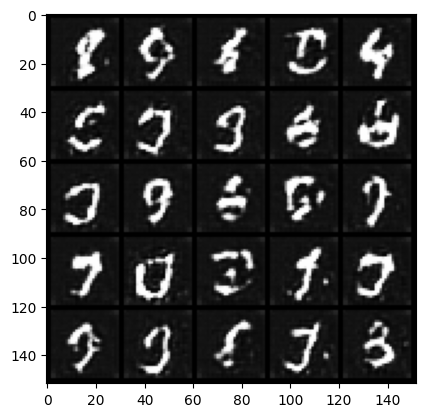

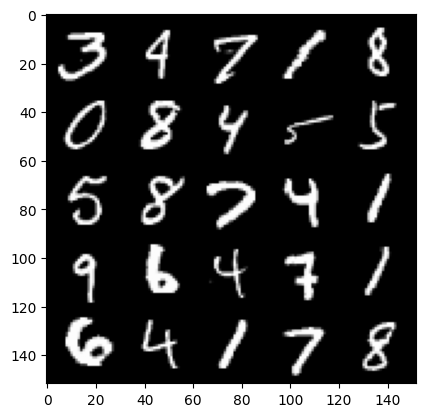

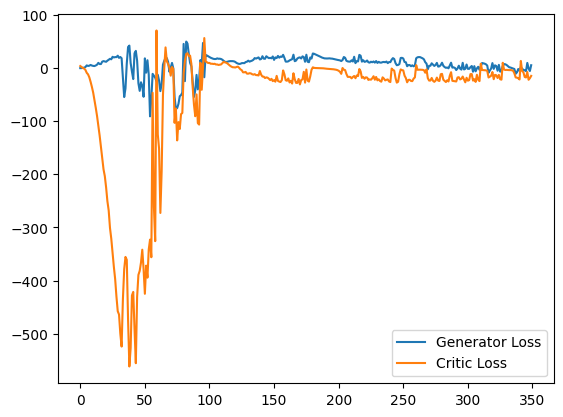

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18791639804840088
real: 30.456573486328125, fake: 7.734781265258789, regularization: 1.8791639804840088
crit_loss: torch.Size([]) -20.842628479003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2255716621875763
real: 31.666027069091797, fake: 3.340013027191162, regularization: 2.255716562271118
crit_loss: torch.Size([]) -26.070297241210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2778666019439697
real: 30.60752296447754, fake: 4.371337890625, regularization: 2.7786660194396973
crit_loss: torch.Size([]) -23.45751953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22845929861068726
real: 33.55267333984375, fake: 4.873671531677246, regularization: 2.284593105316162
crit_loss: torch.Size([]) -26.394407272338867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2662172317504883
real: 34.947731018066406, fake: 8.004935264587402, regularization: 2.662172317504883
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7949384450912476
real: -6.024656295776367, fake: -13.22248649597168, regularization: 7.949384689331055
crit_loss: torch.Size([]) 0.7515544891357422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.473655104637146
real: -5.553174018859863, fake: -13.437108993530273, regularization: 4.736551284790039
crit_loss: torch.Size([]) -3.147383689880371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9772261381149292
real: -5.5284423828125, fake: -14.236942291259766, regularization: 9.772261619567871
crit_loss: torch.Size([]) 1.0637617111206055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34686219692230225
real: -4.634964466094971, fake: -13.361064910888672, regularization: 3.4686219692230225
crit_loss: torch.Size([]) -5.257478713989258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46408915519714355
real: -4.2354230880737305, fake: -12.317020416259766, regularization: 4.6408915519714355
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16784612834453583
real: 19.295757293701172, fake: 5.416401386260986, regularization: 1.6784613132476807
crit_loss: torch.Size([]) -12.200895309448242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2511104643344879
real: 26.00391960144043, fake: 5.944416522979736, regularization: 2.5111045837402344
crit_loss: torch.Size([]) -17.548398971557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21809355914592743
real: 32.227848052978516, fake: 8.228206634521484, regularization: 2.1809356212615967
crit_loss: torch.Size([]) -21.818706512451172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17197713255882263
real: 29.765506744384766, fake: 5.15605354309082, regularization: 1.719771385192871
crit_loss: torch.Size([]) -22.88968276977539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2087097465991974
real: 36.973297119140625, fake: 9.69546127319336, regularization: 2.087097406387329
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17596369981765747
real: 44.96171569824219, fake: 15.024072647094727, regularization: 1.7596369981765747
crit_loss: torch.Size([]) -28.17800521850586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11213018000125885
real: 39.76428985595703, fake: 14.548003196716309, regularization: 1.1213017702102661
crit_loss: torch.Size([]) -24.09498405456543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13259157538414001
real: 38.961875915527344, fake: 13.111493110656738, regularization: 1.325915813446045
crit_loss: torch.Size([]) -24.52446746826172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16429248452186584
real: 40.662628173828125, fake: 16.151756286621094, regularization: 1.6429247856140137
crit_loss: torch.Size([]) -22.86794662475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18546155095100403
real: 40.86217498779297, fake: 14.73299789428711, regularization: 1.8546154499053955
crit_

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8972048759460449
real: -4.9114990234375, fake: -15.739367485046387, regularization: 8.97204875946045
crit_loss: torch.Size([]) -1.8558197021484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8419317007064819
real: -3.5090155601501465, fake: -15.116556167602539, regularization: 8.419317245483398
crit_loss: torch.Size([]) -3.188222885131836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7218664288520813
real: -1.8461326360702515, fake: -14.01374626159668, regularization: 7.218664169311523
crit_loss: torch.Size([]) -4.948949813842773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1295135021209717
real: -4.331326484680176, fake: -18.6224365234375, regularization: 11.295135498046875
crit_loss: torch.Size([]) -2.995974540710449
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39251211285591125
real: -3.901179790496826, fake: -17.725143432617188, regularization: 3.9251210689544678
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20871423184871674
real: 24.867748260498047, fake: -0.40720754861831665, regularization: 2.0871422290802
crit_loss: torch.Size([]) -23.18781280517578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22582826018333435
real: 29.974529266357422, fake: 1.2434806823730469, regularization: 2.2582826614379883
crit_loss: torch.Size([]) -26.472766876220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1549663543701172
real: 35.6525993347168, fake: 16.656593322753906, regularization: 1.5496635437011719
crit_loss: torch.Size([]) -17.44634246826172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17177215218544006
real: 37.42953872680664, fake: 0.5402559041976929, regularization: 1.7177214622497559
crit_loss: torch.Size([]) -35.17156219482422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18514932692050934
real: 27.909286499023438, fake: -2.1367483139038086, regularization: 1.851493239402771
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26052790880203247
real: -5.826515197753906, fake: -14.69855785369873, regularization: 2.605278968811035
crit_loss: torch.Size([]) -6.266763687133789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1256188005208969
real: 3.279926061630249, fake: -15.56317138671875, regularization: 1.2561880350112915
crit_loss: torch.Size([]) -17.586910247802734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22075709700584412
real: 27.094205856323242, fake: -11.338850975036621, regularization: 2.207571029663086
crit_loss: torch.Size([]) -36.225486755371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44885388016700745
real: 33.12152862548828, fake: -1.3030190467834473, regularization: 4.48853874206543
crit_loss: torch.Size([]) -29.936010360717773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2873680591583252
real: 21.439525604248047, fake: -4.254054546356201, regularization: 2.873680591583252
crit

penalty: torch.Size([]) 0.08130772411823273
real: 38.39773941040039, fake: 5.969503402709961, regularization: 0.8130772113800049
crit_loss: torch.Size([]) -31.61515998840332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20453491806983948
real: 40.37449645996094, fake: 14.655324935913086, regularization: 2.04534912109375
crit_loss: torch.Size([]) -23.6738224029541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15887530148029327
real: 33.79798889160156, fake: -1.0654445886611938, regularization: 1.5887529850006104
crit_loss: torch.Size([]) -33.274681091308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1351376473903656
real: 38.82875061035156, fake: 5.8779425621032715, regularization: 1.3513765335083008
crit_loss: torch.Size([]) -31.59943389892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15316540002822876
real: 42.236656188964844, fake: 5.963761329650879, regularization: 1.5316540002822876
crit_loss: torch.Size([]) -34.74124145507

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4621522128582001
real: 7.490200996398926, fake: 2.5645880699157715, regularization: 4.621521949768066
crit_loss: torch.Size([]) -0.3040909767150879
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42309656739234924
real: 10.007262229919434, fake: -4.648083686828613, regularization: 4.230965614318848
crit_loss: torch.Size([]) -10.4243803024292
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46145084500312805
real: 12.031505584716797, fake: -12.121023178100586, regularization: 4.614508628845215
crit_loss: torch.Size([]) -19.538021087646484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3197050094604492
real: 9.73765754699707, fake: -10.368532180786133, regularization: 3.197050094604492
crit_loss: torch.Size([]) -16.90913963317871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31712353229522705
real: 17.16262435913086, fake: -7.766011714935303, regularization: 3.1712353229522705
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23507913947105408
real: 42.06108856201172, fake: 8.440805435180664, regularization: 2.3507914543151855
crit_loss: torch.Size([]) -31.269493103027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32668793201446533
real: 35.648529052734375, fake: -4.883772850036621, regularization: 3.2668793201446533
crit_loss: torch.Size([]) -37.26542282104492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14319685101509094
real: 29.533823013305664, fake: -7.865320205688477, regularization: 1.4319684505462646
crit_loss: torch.Size([]) -35.9671745300293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24770522117614746
real: 37.23902893066406, fake: -4.380716323852539, regularization: 2.4770522117614746
crit_loss: torch.Size([]) -39.14269256591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14172346889972687
real: 37.312889099121094, fake: -4.9274115562438965, regularization: 1.4172346591949463
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7489475607872009
real: 1.7011158466339111, fake: -16.289236068725586, regularization: 7.489475727081299
crit_loss: torch.Size([]) -10.500877380371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7314974665641785
real: 2.949349880218506, fake: -15.584638595581055, regularization: 7.314974784851074
crit_loss: torch.Size([]) -11.219014167785645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5669339299201965
real: -9.156593322753906, fake: -6.14251708984375, regularization: 5.669339179992676
crit_loss: torch.Size([]) 8.683415412902832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3478083312511444
real: -10.616307258605957, fake: -9.324995040893555, regularization: 3.478083372116089
crit_loss: torch.Size([]) 4.76939582824707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3183296322822571
real: -10.3819580078125, fake: -11.580107688903809, regularization: 3.1832962036132812
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40278640389442444
real: 35.320640563964844, fake: 2.17264723777771, regularization: 4.0278639793396
crit_loss: torch.Size([]) -29.12013053894043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.365030974149704
real: 35.67783737182617, fake: 1.0989656448364258, regularization: 3.6503098011016846
crit_loss: torch.Size([]) -30.92856216430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2273150384426117
real: 41.908233642578125, fake: 6.040323734283447, regularization: 2.2731504440307617
crit_loss: torch.Size([]) -33.594757080078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3370622992515564
real: 43.16146469116211, fake: 5.965492248535156, regularization: 3.3706231117248535
crit_loss: torch.Size([]) -33.825347900390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20946142077445984
real: 29.196170806884766, fake: 10.66189956665039, regularization: 2.094614267349243
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31749990582466125
real: 9.076349258422852, fake: -3.264188528060913, regularization: 3.1749989986419678
crit_loss: torch.Size([]) -9.165538787841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19775299727916718
real: 8.022368431091309, fake: -2.8527541160583496, regularization: 1.9775300025939941
crit_loss: torch.Size([]) -8.897592544555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1892593801021576
real: 8.100530624389648, fake: -3.2311675548553467, regularization: 1.8925938606262207
crit_loss: torch.Size([]) -9.439104080200195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19757495820522308
real: 8.285871505737305, fake: -3.4968197345733643, regularization: 1.9757496118545532
crit_loss: torch.Size([]) -9.806941032409668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14119479060173035
real: 8.411334991455078, fake: -3.831913471221924, regularization: 1.4119479656219482
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17163166403770447
real: 18.770414352416992, fake: 2.673656702041626, regularization: 1.7163166999816895
crit_loss: torch.Size([]) -14.380441665649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20716097950935364
real: 19.76513671875, fake: 3.291698932647705, regularization: 2.0716097354888916
crit_loss: torch.Size([]) -14.40182876586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20860356092453003
real: 21.33600616455078, fake: 2.9459943771362305, regularization: 2.08603572845459
crit_loss: torch.Size([]) -16.303974151611328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10314491391181946
real: 19.257877349853516, fake: 3.648192882537842, regularization: 1.0314490795135498
crit_loss: torch.Size([]) -14.578234672546387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1941058337688446
real: 22.667808532714844, fake: 5.208670616149902, regularization: 1.9410583972930908
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7761431336402893
real: 48.44094467163086, fake: 14.905346870422363, regularization: 7.7614312171936035
crit_loss: torch.Size([]) -25.774168014526367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35526958107948303
real: 43.77970504760742, fake: 7.637515544891357, regularization: 3.5526957511901855
crit_loss: torch.Size([]) -32.58949279785156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1254027783870697
real: 48.361412048339844, fake: 17.291728973388672, regularization: 1.2540278434753418
crit_loss: torch.Size([]) -29.815654754638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16660749912261963
real: 43.30394744873047, fake: 7.295602798461914, regularization: 1.6660749912261963
crit_loss: torch.Size([]) -34.34226989746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4776458442211151
real: 48.64845275878906, fake: 11.206812858581543, regularization: 4.776458263397217
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1252271682024002
real: 33.3680305480957, fake: 15.582111358642578, regularization: 1.2522716522216797
crit_loss: torch.Size([]) -16.533647537231445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22965526580810547
real: 37.549072265625, fake: 12.911014556884766, regularization: 2.2965526580810547
crit_loss: torch.Size([]) -22.34150505065918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.088345468044281
real: 34.20307159423828, fake: 10.125665664672852, regularization: 0.8834546804428101
crit_loss: torch.Size([]) -23.193950653076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2106151133775711
real: 39.07987976074219, fake: 16.314929962158203, regularization: 2.1061511039733887
crit_loss: torch.Size([]) -20.658798217773438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07905322313308716
real: 41.120880126953125, fake: 15.408417701721191, regularization: 0.7905322313308716
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19202245771884918
real: 40.385841369628906, fake: 16.365428924560547, regularization: 1.9202245473861694
crit_loss: torch.Size([]) -22.100187301635742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27263253927230835
real: 43.413597106933594, fake: 16.3238468170166, regularization: 2.726325511932373
crit_loss: torch.Size([]) -24.36342430114746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22724519670009613
real: 18.16082000732422, fake: 12.30952262878418, regularization: 2.272451877593994
crit_loss: torch.Size([]) -3.578845500946045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37472444772720337
real: 28.5108642578125, fake: 6.367621421813965, regularization: 3.747244358062744
crit_loss: torch.Size([]) -18.395998001098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5192286372184753
real: 23.24614906311035, fake: -8.115381240844727, regularization: 5.192286491394043
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.290698766708374
real: 38.97433090209961, fake: 5.784951210021973, regularization: 2.9069876670837402
crit_loss: torch.Size([]) -30.282392501831055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26466044783592224
real: 38.66584014892578, fake: 5.6063032150268555, regularization: 2.646604537963867
crit_loss: torch.Size([]) -30.412931442260742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25485193729400635
real: 40.39894485473633, fake: 5.827420234680176, regularization: 2.5485193729400635
crit_loss: torch.Size([]) -32.023006439208984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25440990924835205
real: 38.778900146484375, fake: 2.7628798484802246, regularization: 2.5440990924835205
crit_loss: torch.Size([]) -33.471923828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3759753108024597
real: 33.960121154785156, fake: 13.115260124206543, regularization: 3.7597532272338867
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20522929728031158
real: 13.104524612426758, fake: 5.604856014251709, regularization: 2.052293062210083
crit_loss: torch.Size([]) -5.447375297546387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2779526114463806
real: 25.382495880126953, fake: 15.143570899963379, regularization: 2.7795262336730957
crit_loss: torch.Size([]) -7.4593987464904785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25140494108200073
real: 38.683677673339844, fake: 17.986984252929688, regularization: 2.514049530029297
crit_loss: torch.Size([]) -18.18264389038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3550271987915039
real: 38.982017517089844, fake: 12.917381286621094, regularization: 3.550271987915039
crit_loss: torch.Size([]) -22.51436424255371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2268112152814865
real: 17.50963592529297, fake: 11.991825103759766, regularization: 2.2681121826171875
crit_lo

real: 38.60868835449219, fake: 11.840927124023438, regularization: 1.820024013519287
crit_loss: torch.Size([]) -24.947736740112305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2004452496767044
real: 38.549251556396484, fake: 9.851491928100586, regularization: 2.0044524669647217
crit_loss: torch.Size([]) -26.693307876586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23733219504356384
real: 39.302249908447266, fake: 12.708395004272461, regularization: 2.373322010040283
crit_loss: torch.Size([]) -24.22053337097168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15935102105140686
real: 32.46086883544922, fake: 19.320999145507812, regularization: 1.5935101509094238
crit_loss: torch.Size([]) -11.54636001586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2041846215724945
real: 46.40446472167969, fake: 14.054499626159668, regularization: 2.04184627532959
crit_loss: torch.Size([]) -30.308116912841797
gradient_norm: torch.Size([128])
penalt

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20659352838993073
real: 32.550357818603516, fake: -3.5869483947753906, regularization: 2.0659353733062744
crit_loss: torch.Size([]) -34.07136917114258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3344825804233551
real: 36.837833404541016, fake: 1.9831966161727905, regularization: 3.3448257446289062
crit_loss: torch.Size([]) -31.509811401367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3177817165851593
real: 31.281808853149414, fake: -3.3706512451171875, regularization: 3.1778171062469482
crit_loss: torch.Size([]) -31.474641799926758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19498297572135925
real: 30.089420318603516, fake: 13.379413604736328, regularization: 1.9498298168182373
crit_loss: torch.Size([]) -14.760176658630371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21926379203796387
real: 38.439186096191406, fake: 13.38007926940918, regularization: 2.192637920379638

penalty: torch.Size([]) 0.2854103446006775
real: 37.18971252441406, fake: 11.502203941345215, regularization: 2.8541035652160645
crit_loss: torch.Size([]) -22.833404541015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1614622324705124
real: 39.490814208984375, fake: 13.274480819702148, regularization: 1.6146223545074463
crit_loss: torch.Size([]) -24.60171127319336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10288134217262268
real: 42.56867218017578, fake: 16.572917938232422, regularization: 1.028813362121582
crit_loss: torch.Size([]) -24.966941833496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08997617661952972
real: 28.184520721435547, fake: 14.114773750305176, regularization: 0.8997617959976196
crit_loss: torch.Size([]) -13.169984817504883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14012449979782104
real: 37.32490539550781, fake: 15.9257173538208, regularization: 1.4012449979782104
crit_loss: torch.Size([]) -19.99794387

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4640570282936096
real: 48.70852279663086, fake: 2.9962892532348633, regularization: 4.640570163726807
crit_loss: torch.Size([]) -41.07166290283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05932266265153885
real: 47.56516647338867, fake: -1.5779073238372803, regularization: 0.5932266116142273
crit_loss: torch.Size([]) -48.54984664916992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14693167805671692
real: 48.67439270019531, fake: 0.6245205998420715, regularization: 1.4693167209625244
crit_loss: torch.Size([]) -46.5805549621582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34633830189704895
real: 45.1106071472168, fake: -0.4684819281101227, regularization: 3.4633829593658447
crit_loss: torch.Size([]) -42.11570739746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22373393177986145
real: 33.78358459472656, fake: -10.170512199401855, regularization: 2.2373392581939697
crit_l

penalty: torch.Size([]) 0.19410015642642975
real: 19.54557991027832, fake: -1.5373919010162354, regularization: 1.941001534461975
crit_loss: torch.Size([]) -19.141969680786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.562360405921936
real: 21.055862426757812, fake: -8.1817626953125, regularization: 5.623603820800781
crit_loss: torch.Size([]) -23.61402130126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1612836718559265
real: 36.94702911376953, fake: 6.5461015701293945, regularization: 1.6128367185592651
crit_loss: torch.Size([]) -28.7880916595459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29767000675201416
real: 10.355045318603516, fake: 21.91477394104004, regularization: 2.9767000675201416
crit_loss: torch.Size([]) 14.536428451538086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.325148344039917
real: 23.661540985107422, fake: 10.796820640563965, regularization: 3.25148344039917
crit_loss: torch.Size([]) -9.613237380981445
g

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24596890807151794
real: 40.467185974121094, fake: 21.775484085083008, regularization: 2.459689140319824
crit_loss: torch.Size([]) -16.232013702392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20149213075637817
real: 42.83309555053711, fake: 23.77452850341797, regularization: 2.014921188354492
crit_loss: torch.Size([]) -17.04364585876465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28296253085136414
real: 42.24554443359375, fake: 19.12497329711914, regularization: 2.829625368118286
crit_loss: torch.Size([]) -20.290945053100586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17010962963104248
real: 40.54345703125, fake: 20.659273147583008, regularization: 1.7010962963104248
crit_loss: torch.Size([]) -18.183088302612305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17722725868225098
real: 39.741172790527344, fake: 14.254216194152832, regularization: 1.7722725868225098
crit_los

penalty: torch.Size([]) 0.7967300415039062
real: 46.204017639160156, fake: 1.4115455150604248, regularization: 7.9673004150390625
crit_loss: torch.Size([]) -36.825172424316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16470454633235931
real: 48.191932678222656, fake: 6.130858898162842, regularization: 1.6470454931259155
crit_loss: torch.Size([]) -40.41402816772461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24636708199977875
real: 46.54146957397461, fake: 3.085660696029663, regularization: 2.4636707305908203
crit_loss: torch.Size([]) -40.99214172363281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19240836799144745
real: 31.482769012451172, fake: 10.354214668273926, regularization: 1.9240837097167969
crit_loss: torch.Size([]) -19.204471588134766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3481646776199341
real: 40.47039031982422, fake: 14.128446578979492, regularization: 3.481646776199341
crit_loss: torch.Size([]) -22.86029624

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2766023278236389
real: 39.99009323120117, fake: 11.332399368286133, regularization: 2.7660231590270996
crit_loss: torch.Size([]) -25.89167022705078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17568670213222504
real: 39.16847229003906, fake: 8.944364547729492, regularization: 1.7568670511245728
crit_loss: torch.Size([]) -28.467241287231445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11847361922264099
real: 36.827884674072266, fake: 5.704394340515137, regularization: 1.1847362518310547
crit_loss: torch.Size([]) -29.938753128051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1764133721590042
real: 42.364051818847656, fake: 15.130107879638672, regularization: 1.7641336917877197
crit_loss: torch.Size([]) -25.469810485839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2310982495546341
real: 42.105899810791016, fake: 14.850123405456543, regularization: 2.3109824657440186
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3534053564071655
real: -6.871137619018555, fake: -11.744573593139648, regularization: 13.534053802490234
crit_loss: torch.Size([]) 8.66061782836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8763664364814758
real: -7.135947227478027, fake: -11.79986572265625, regularization: 8.763664245605469
crit_loss: torch.Size([]) 4.099745750427246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5771230459213257
real: -7.2609453201293945, fake: -11.0557222366333, regularization: 5.771230697631836
crit_loss: torch.Size([]) 1.9764537811279297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5163276195526123
real: -6.572514533996582, fake: -10.433055877685547, regularization: 5.163276195526123
crit_loss: torch.Size([]) 1.3027348518371582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3149562180042267
real: -5.868122100830078, fake: -9.634988784790039, regularization: 3.149562120437622
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040399450808763504
real: -4.140903949737549, fake: -7.577755928039551, regularization: 0.40399450063705444
crit_loss: torch.Size([]) -3.0328574180603027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04249320179224014
real: -4.139084815979004, fake: -7.561979293823242, regularization: 0.42493200302124023
crit_loss: torch.Size([]) -2.997962474822998
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08858326077461243
real: -4.1250762939453125, fake: -7.492640495300293, regularization: 0.8858326077461243
crit_loss: torch.Size([]) -2.481731653213501
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0811140313744545
real: -4.080864429473877, fake: -7.586686611175537, regularization: 0.8111402988433838
crit_loss: torch.Size([]) -2.6946818828582764
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05271776765584946
real: -4.292299270629883, fake: -7.435210227966309, regularization: 0.527177691459

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06663867086172104
real: -4.673834323883057, fake: -8.34014892578125, regularization: 0.6663867235183716
crit_loss: torch.Size([]) -2.9999279975891113
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06451227515935898
real: -4.852348327636719, fake: -8.305303573608398, regularization: 0.645122766494751
crit_loss: torch.Size([]) -2.8078324794769287
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06526830792427063
real: -4.890311241149902, fake: -8.540925979614258, regularization: 0.6526830792427063
crit_loss: torch.Size([]) -2.997931718826294
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07354974746704102
real: -4.905186653137207, fake: -8.526185035705566, regularization: 0.7354974746704102
crit_loss: torch.Size([]) -2.885500907897949
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1499219536781311
real: -4.864439964294434, fake: -8.503069877624512, regularization: 1.499219536781311
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03716385364532471
real: -4.168190002441406, fake: -8.069787979125977, regularization: 0.37163853645324707
crit_loss: torch.Size([]) -3.5299594402313232
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039039891213178635
real: -4.207639694213867, fake: -8.274014472961426, regularization: 0.39039891958236694
crit_loss: torch.Size([]) -3.675975799560547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.042821623384952545
real: -4.232605934143066, fake: -8.24595832824707, regularization: 0.42821621894836426
crit_loss: torch.Size([]) -3.5851361751556396
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08084610104560852
real: -4.5767974853515625, fake: -8.096187591552734, regularization: 0.8084610104560852
crit_loss: torch.Size([]) -2.7109291553497314
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08673901855945587
real: -4.56025505065918, fake: -8.315279006958008, regularization: 0.8673901557

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06153854355216026
real: -4.989035606384277, fake: -8.690513610839844, regularization: 0.6153854131698608
crit_loss: torch.Size([]) -3.086092472076416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04565902426838875
real: -4.962306976318359, fake: -8.687163352966309, regularization: 0.4565902352333069
crit_loss: torch.Size([]) -3.268266201019287
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05157488211989403
real: -4.908706188201904, fake: -8.695727348327637, regularization: 0.5157487988471985
crit_loss: torch.Size([]) -3.2712724208831787
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05158400535583496
real: -4.82780647277832, fake: -8.52376937866211, regularization: 0.5158400535583496
crit_loss: torch.Size([]) -3.1801228523254395
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04435121268033981
real: -4.762052536010742, fake: -8.466960906982422, regularization: 0.4435121417045593


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11057481169700623
real: -4.477365970611572, fake: -8.103412628173828, regularization: 1.105748176574707
crit_loss: torch.Size([]) -2.520298480987549
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08818069100379944
real: -4.540352821350098, fake: -8.25172233581543, regularization: 0.8818069100379944
crit_loss: torch.Size([]) -2.8295626640319824
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08977388590574265
real: -4.254222869873047, fake: -8.230804443359375, regularization: 0.8977388739585876
crit_loss: torch.Size([]) -3.0788426399230957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13043402135372162
real: -4.3240861892700195, fake: -8.293097496032715, regularization: 1.3043402433395386
crit_loss: torch.Size([]) -2.664670944213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06899444013834
real: -4.4347825050354, fake: -8.458528518676758, regularization: 0.6899443864822388
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1166878268122673
real: -5.248622894287109, fake: -8.918756484985352, regularization: 1.1668782234191895
crit_loss: torch.Size([]) -2.5032553672790527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05388200283050537
real: -5.219395637512207, fake: -9.11927318572998, regularization: 0.5388200283050537
crit_loss: torch.Size([]) -3.3610575199127197
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10099393129348755
real: -5.202981472015381, fake: -9.105186462402344, regularization: 1.0099393129348755
crit_loss: torch.Size([]) -2.892265796661377
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.061047203838825226
real: -5.18026876449585, fake: -9.012918472290039, regularization: 0.6104720234870911
crit_loss: torch.Size([]) -3.222177743911743
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05465322732925415
real: -5.481212615966797, fake: -8.985580444335938, regularization: 0.5465322732925415


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06211165711283684
real: -4.770570755004883, fake: -8.499879837036133, regularization: 0.621116578578949
crit_loss: torch.Size([]) -3.1081924438476562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0719057023525238
real: -4.623926162719727, fake: -8.617192268371582, regularization: 0.719057023525238
crit_loss: torch.Size([]) -3.2742090225219727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06849026679992676
real: -4.577919960021973, fake: -8.4202299118042, regularization: 0.6849026679992676
crit_loss: torch.Size([]) -3.157407283782959
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06449568271636963
real: -4.555150985717773, fake: -8.643867492675781, regularization: 0.6449568271636963
crit_loss: torch.Size([]) -3.4437596797943115
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06385594606399536
real: -4.551018714904785, fake: -8.464601516723633, regularization: 0.6385594606399536
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08292251825332642
real: -4.406384468078613, fake: -8.329488754272461, regularization: 0.8292251825332642
crit_loss: torch.Size([]) -3.093879222869873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.048431575298309326
real: -4.4767842292785645, fake: -8.321784973144531, regularization: 0.48431575298309326
crit_loss: torch.Size([]) -3.360684871673584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.047666557133197784
real: -4.504627227783203, fake: -8.322093963623047, regularization: 0.47666555643081665
crit_loss: torch.Size([]) -3.340801239013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05532045662403107
real: -4.689489364624023, fake: -8.606218338012695, regularization: 0.5532045364379883
crit_loss: torch.Size([]) -3.3635244369506836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03970760852098465
real: -4.703534126281738, fake: -8.304484367370605, regularization: 0.39707607030

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040818534791469574
real: -4.956751823425293, fake: -8.769428253173828, regularization: 0.40818536281585693
crit_loss: torch.Size([]) -3.4044909477233887
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04939194768667221
real: -4.942843437194824, fake: -8.469732284545898, regularization: 0.4939194917678833
crit_loss: torch.Size([]) -3.0329694747924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03759636729955673
real: -4.818638801574707, fake: -8.421783447265625, regularization: 0.3759636878967285
crit_loss: torch.Size([]) -3.2271809577941895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08469413965940475
real: -4.683255672454834, fake: -8.277254104614258, regularization: 0.8469414114952087
crit_loss: torch.Size([]) -2.7470569610595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04121066629886627
real: -4.611415386199951, fake: -8.248930931091309, regularization: 0.41210666298

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04618057608604431
real: -4.0327324867248535, fake: -8.02762222290039, regularization: 0.4618057608604431
crit_loss: torch.Size([]) -3.533083915710449
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0677686408162117
real: -4.028155326843262, fake: -8.052562713623047, regularization: 0.6776863932609558
crit_loss: torch.Size([]) -3.3467209339141846
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.035433802753686905
real: -4.269057273864746, fake: -8.04899787902832, regularization: 0.35433802008628845
crit_loss: torch.Size([]) -3.425602674484253
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.028764303773641586
real: -4.238960266113281, fake: -8.038788795471191, regularization: 0.28764304518699646
crit_loss: torch.Size([]) -3.512185573577881
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046602293848991394
real: -4.190560340881348, fake: -7.977931499481201, regularization: 0.4660229384899

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.033486559987068176
real: -4.154233455657959, fake: -7.788127899169922, regularization: 0.33486559987068176
crit_loss: torch.Size([]) -3.2990288734436035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03370080888271332
real: -4.112820625305176, fake: -7.7890448570251465, regularization: 0.3370080888271332
crit_loss: torch.Size([]) -3.3392162322998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03915312513709068
real: -4.0919599533081055, fake: -8.082401275634766, regularization: 0.3915312588214874
crit_loss: torch.Size([]) -3.598910093307495
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05360374599695206
real: -4.072688102722168, fake: -7.949286460876465, regularization: 0.5360374450683594
crit_loss: torch.Size([]) -3.3405609130859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05638433247804642
real: -4.24177360534668, fake: -7.920560359954834, regularization: 0.56384330987

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.062406688928604126
real: -3.41167950630188, fake: -7.501317977905273, regularization: 0.6240668892860413
crit_loss: torch.Size([]) -3.465571880340576
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03999153897166252
real: -3.699205160140991, fake: -7.321406364440918, regularization: 0.3999153971672058
crit_loss: torch.Size([]) -3.222285747528076
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04674519971013069
real: -3.706575870513916, fake: -7.463290214538574, regularization: 0.4674519896507263
crit_loss: torch.Size([]) -3.289262294769287
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04090627282857895
real: -3.6199231147766113, fake: -7.331559181213379, regularization: 0.4090627431869507
crit_loss: torch.Size([]) -3.3025732040405273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06077876314520836
real: -3.5257887840270996, fake: -7.189491271972656, regularization: 0.60778760910034

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10455410182476044
real: -2.676396608352661, fake: -6.438745021820068, regularization: 1.0455410480499268
crit_loss: torch.Size([]) -2.7168073654174805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07810046523809433
real: -2.7358951568603516, fake: -6.608907699584961, regularization: 0.7810046672821045
crit_loss: torch.Size([]) -3.092007875442505
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046835482120513916
real: -2.8163042068481445, fake: -6.599944114685059, regularization: 0.46835482120513916
crit_loss: torch.Size([]) -3.3152852058410645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05565785616636276
real: -2.9069437980651855, fake: -6.915374755859375, regularization: 0.5565785765647888
crit_loss: torch.Size([]) -3.451852321624756
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04651734605431557
real: -3.0102601051330566, fake: -6.881974697113037, regularization: 0.465173453

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.059967316687107086
real: -3.3557167053222656, fake: -7.453651428222656, regularization: 0.5996731519699097
crit_loss: torch.Size([]) -3.4982614517211914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046190567314624786
real: -3.3237552642822266, fake: -7.344723701477051, regularization: 0.46190565824508667
crit_loss: torch.Size([]) -3.5590627193450928
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04177570343017578
real: -3.2347567081451416, fake: -7.448420524597168, regularization: 0.4177570343017578
crit_loss: torch.Size([]) -3.7959070205688477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.055334724485874176
real: -3.09920597076416, fake: -6.98514986038208, regularization: 0.5533472299575806
crit_loss: torch.Size([]) -3.332596778869629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0517459362745285
real: -3.0039024353027344, fake: -6.806622505187988, regularization: 0.517459392

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06748569011688232
real: -1.8053017854690552, fake: -6.03987979888916, regularization: 0.6748569011688232
crit_loss: torch.Size([]) -3.5597212314605713
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.041594281792640686
real: -1.795290470123291, fake: -6.012053489685059, regularization: 0.41594281792640686
crit_loss: torch.Size([]) -3.8008201122283936
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05559547245502472
real: -2.1543385982513428, fake: -6.025823593139648, regularization: 0.5559546947479248
crit_loss: torch.Size([]) -3.315530300140381
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06974350661039352
real: -2.0818562507629395, fake: -6.130060195922852, regularization: 0.6974350810050964
crit_loss: torch.Size([]) -3.350768804550171
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05760515481233597
real: -1.985489010810852, fake: -5.707702159881592, regularization: 0.57605153322

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06155310571193695
real: -1.9311854839324951, fake: -5.939370155334473, regularization: 0.6155310869216919
crit_loss: torch.Size([]) -3.392653465270996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06874550879001617
real: -1.9652670621871948, fake: -6.1512451171875, regularization: 0.6874550580978394
crit_loss: torch.Size([]) -3.4985227584838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.051076751202344894
real: -1.9203150272369385, fake: -6.188425064086914, regularization: 0.5107675194740295
crit_loss: torch.Size([]) -3.75734281539917
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0837278962135315
real: -1.770556926727295, fake: -6.028090953826904, regularization: 0.8372789621353149
crit_loss: torch.Size([]) -3.420255184173584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12913215160369873
real: -1.3546996116638184, fake: -5.852374076843262, regularization: 1.291321516036987

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06131155788898468
real: -0.8607286214828491, fake: -5.540579795837402, regularization: 0.6131155490875244
crit_loss: torch.Size([]) -4.06673526763916
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08121711015701294
real: -0.9473414421081543, fake: -5.423404693603516, regularization: 0.8121711015701294
crit_loss: torch.Size([]) -3.6638922691345215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07512357831001282
real: -0.9129378795623779, fake: -5.544921875, regularization: 0.7512357831001282
crit_loss: torch.Size([]) -3.8807480335235596
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08378921449184418
real: -0.8524622917175293, fake: -5.549471378326416, regularization: 0.8378921747207642
crit_loss: torch.Size([]) -3.859117031097412
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.060084179043769836
real: -0.7913680076599121, fake: -5.4367828369140625, regularization: 0.600841760635376

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0851982831954956
real: 0.14959575235843658, fake: -4.5363264083862305, regularization: 0.851982831954956
crit_loss: torch.Size([]) -3.83393931388855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07551044225692749
real: 0.12320196628570557, fake: -4.624823570251465, regularization: 0.7551044225692749
crit_loss: torch.Size([]) -3.9929208755493164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06327398866415024
real: 0.1526031792163849, fake: -4.695331573486328, regularization: 0.6327399015426636
crit_loss: torch.Size([]) -4.2151947021484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06512787938117981
real: 0.316615492105484, fake: -4.467293739318848, regularization: 0.6512787938117981
crit_loss: torch.Size([]) -4.132630348205566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07860106229782104
real: 0.3635721206665039, fake: -4.428899765014648, regularization: 0.7860106229782104

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08308504521846771
real: 2.318027973175049, fake: -3.9513182640075684, regularization: 0.8308504819869995
crit_loss: torch.Size([]) -5.438495635986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08371476829051971
real: 2.521942377090454, fake: -3.960530996322632, regularization: 0.8371477127075195
crit_loss: torch.Size([]) -5.645325660705566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07201060652732849
real: 2.722348928451538, fake: -3.7025504112243652, regularization: 0.7201060652732849
crit_loss: torch.Size([]) -5.7047929763793945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11243433505296707
real: 2.9043900966644287, fake: -3.7728593349456787, regularization: 1.1243433952331543
crit_loss: torch.Size([]) -5.552906036376953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09838719666004181
real: 3.1078264713287354, fake: -3.6357593536376953, regularization: 0.983871936798095

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.124159075319767
real: 3.647599220275879, fake: -2.312877893447876, regularization: 1.2415907382965088
crit_loss: torch.Size([]) -4.718886375427246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0784388855099678
real: 3.738736152648926, fake: -2.4895153045654297, regularization: 0.7843888401985168
crit_loss: torch.Size([]) -5.443862438201904
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13545331358909607
real: 2.9018564224243164, fake: -2.40694260597229, regularization: 1.3545331954956055
crit_loss: torch.Size([]) -3.954265594482422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08392851054668427
real: 3.016610622406006, fake: -2.413083791732788, regularization: 0.839285135269165
crit_loss: torch.Size([]) -4.590409278869629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11326959729194641
real: 3.1148061752319336, fake: -2.472231864929199, regularization: 1.1326959133148193
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16535727679729462
real: 9.36398983001709, fake: 2.711017608642578, regularization: 1.6535727977752686
crit_loss: torch.Size([]) -4.999399185180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18628636002540588
real: 9.89179801940918, fake: 3.1940762996673584, regularization: 1.862863540649414
crit_loss: torch.Size([]) -4.834857940673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18812090158462524
real: 10.285983085632324, fake: 2.627523422241211, regularization: 1.8812090158462524
crit_loss: torch.Size([]) -5.77725076675415
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20941734313964844
real: 10.815489768981934, fake: 2.035811424255371, regularization: 2.0941734313964844
crit_loss: torch.Size([]) -6.685504913330078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19199171662330627
real: 11.211502075195312, fake: 0.8284060955047607, regularization: 1.919917106628418
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36073240637779236
real: 26.344818115234375, fake: 8.570773124694824, regularization: 3.6073241233825684
crit_loss: torch.Size([]) -14.166719436645508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24449566006660461
real: 27.309383392333984, fake: 6.731146335601807, regularization: 2.4449565410614014
crit_loss: torch.Size([]) -18.133281707763672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2951841354370117
real: 17.81502914428711, fake: 8.578344345092773, regularization: 2.951841354370117
crit_loss: torch.Size([]) -6.284843444824219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27801668643951416
real: 21.394533157348633, fake: 8.549358367919922, regularization: 2.7801668643951416
crit_loss: torch.Size([]) -10.065008163452148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25182753801345825
real: 25.654834747314453, fake: 8.397417068481445, regularization: 2.518275260925293
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5901653170585632
real: 35.50658416748047, fake: 9.78645133972168, regularization: 5.901653289794922
crit_loss: torch.Size([]) -19.818479537963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3897959887981415
real: 36.67524337768555, fake: 16.619726181030273, regularization: 3.8979599475860596
crit_loss: torch.Size([]) -16.157556533813477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23452934622764587
real: 45.85885238647461, fake: 19.548213958740234, regularization: 2.3452935218811035
crit_loss: torch.Size([]) -23.96534538269043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14540350437164307
real: 46.372474670410156, fake: 23.69705581665039, regularization: 1.4540350437164307
crit_loss: torch.Size([]) -21.221384048461914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41310638189315796
real: 45.09937286376953, fake: 21.811189651489258, regularization: 4.131063938140869
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23114235699176788
real: 42.80448913574219, fake: 17.714744567871094, regularization: 2.3114235401153564
crit_loss: torch.Size([]) -22.7783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21504580974578857
real: 43.81700134277344, fake: 17.090837478637695, regularization: 2.1504580974578857
crit_loss: torch.Size([]) -24.575706481933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28161197900772095
real: 32.430458068847656, fake: 18.56581687927246, regularization: 2.81611967086792
crit_loss: torch.Size([]) -11.048521041870117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16387128829956055
real: 36.392154693603516, fake: 20.25429344177246, regularization: 1.6387128829956055
crit_loss: torch.Size([]) -14.49914836883545
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36804041266441345
real: 32.77573013305664, fake: 16.192066192626953, regularization: 3.6804041862487793
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3689455986022949
real: 40.270286560058594, fake: -3.490274429321289, regularization: 3.689455986022949
crit_loss: torch.Size([]) -40.071102142333984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4627307057380676
real: 31.02175521850586, fake: -8.47692584991455, regularization: 4.627306938171387
crit_loss: torch.Size([]) -34.87137222290039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.27290940284729
real: 49.9141845703125, fake: 3.2049591541290283, regularization: 12.729093551635742
crit_loss: torch.Size([]) -33.980133056640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1127305030822754
real: 35.61722946166992, fake: -6.182033061981201, regularization: 11.127305030822754
crit_loss: torch.Size([]) -30.671958923339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19484049081802368
real: 46.215911865234375, fake: 7.75043249130249, regularization: 1.9484049081802368
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27880436182022095
real: 38.757286071777344, fake: 13.82558536529541, regularization: 2.78804349899292
crit_loss: torch.Size([]) -22.143657684326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19271236658096313
real: 35.027374267578125, fake: 15.926214218139648, regularization: 1.9271236658096313
crit_loss: torch.Size([]) -17.174036026000977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17808783054351807
real: 33.512393951416016, fake: 10.709853172302246, regularization: 1.7808783054351807
crit_loss: torch.Size([]) -21.02166175842285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4471338987350464
real: 28.319133758544922, fake: 1.8726742267608643, regularization: 4.471339225769043
crit_loss: torch.Size([]) -21.975120544433594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2539341151714325
real: 39.222415924072266, fake: 12.001799583435059, regularization: 2.5393412113189697
cri

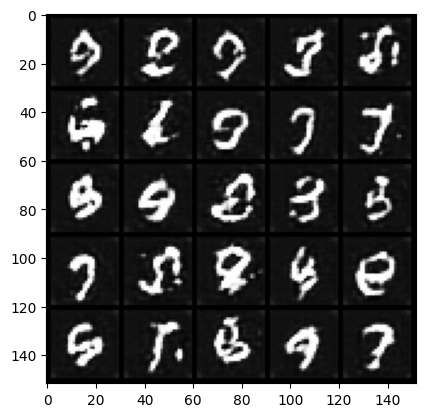

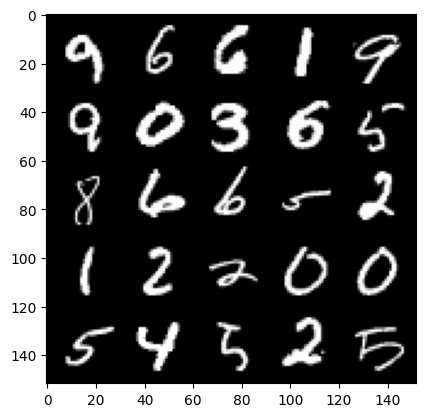

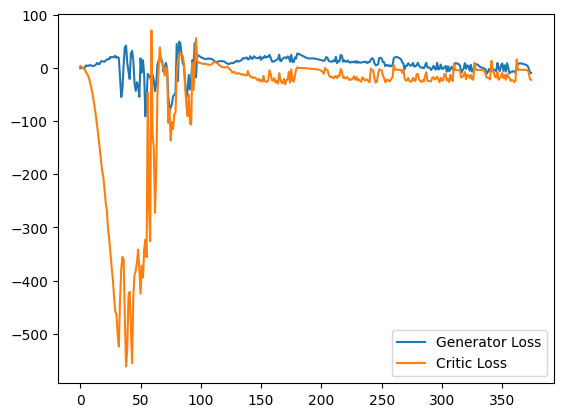

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22880052030086517
real: 13.202449798583984, fake: 11.089340209960938, regularization: 2.2880051136016846
crit_loss: torch.Size([]) 0.1748955249786377
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3361718952655792
real: 28.40570068359375, fake: 8.48792839050293, regularization: 3.3617188930511475
crit_loss: torch.Size([]) -16.556053161621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.217340886592865
real: 21.09235382080078, fake: -4.8421783447265625, regularization: 2.1734089851379395
crit_loss: torch.Size([]) -23.761123657226562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29199641942977905
real: 25.620044708251953, fake: -4.026052951812744, regularization: 2.91996431350708
crit_loss: torch.Size([]) -26.726133346557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36582672595977783
real: 40.590274810791016, fake: 9.208429336547852, regularization: 3.6582672595977783
crit_l

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.247993603348732
real: 31.803861618041992, fake: 4.4177021980285645, regularization: 2.479936122894287
crit_loss: torch.Size([]) -24.90622329711914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3858354091644287
real: 30.61844253540039, fake: 0.5216624736785889, regularization: 3.858354091644287
crit_loss: torch.Size([]) -26.238426208496094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22714939713478088
real: 32.30144500732422, fake: -1.7175440788269043, regularization: 2.271493911743164
crit_loss: torch.Size([]) -31.747495651245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4690309762954712
real: 40.98390197753906, fake: 4.24808406829834, regularization: 4.690309524536133
crit_loss: torch.Size([]) -32.045509338378906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19197872281074524
real: 34.354591369628906, fake: -0.622960090637207, regularization: 1.9197871685028076
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2558187246322632
real: 41.9638786315918, fake: 17.09545135498047, regularization: 2.558187246322632
crit_loss: torch.Size([]) -22.310239791870117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2586703300476074
real: 37.15375518798828, fake: 11.092201232910156, regularization: 2.586703300476074
crit_loss: torch.Size([]) -23.474849700927734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2817789912223816
real: 24.3306827545166, fake: 10.862081527709961, regularization: 2.8177900314331055
crit_loss: torch.Size([]) -10.650811195373535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21297138929367065
real: 24.670167922973633, fake: -1.5156829357147217, regularization: 2.129714012145996
crit_loss: torch.Size([]) -24.056137084960938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19895866513252258
real: 17.786243438720703, fake: -6.757123947143555, regularization: 1.989586591720581
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23107127845287323
real: 18.152423858642578, fake: -1.8805142641067505, regularization: 2.3107128143310547
crit_loss: torch.Size([]) -17.722225189208984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26928749680519104
real: 23.023353576660156, fake: 1.170615315437317, regularization: 2.6928749084472656
crit_loss: torch.Size([]) -19.159862518310547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23115333914756775
real: 23.32756805419922, fake: -1.4154038429260254, regularization: 2.3115334510803223
crit_loss: torch.Size([]) -22.431438446044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1878487467765808
real: 26.548776626586914, fake: -0.3891563415527344, regularization: 1.878487467765808
crit_loss: torch.Size([]) -25.059446334838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32171258330345154
real: 22.53631591796875, fake: 4.4754462242126465, regularization: 3.21712589263916


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04470406845211983
real: -5.612317085266113, fake: -12.316282272338867, regularization: 0.4470406770706177
crit_loss: torch.Size([]) -6.256924629211426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0700373575091362
real: -6.140806674957275, fake: -12.500386238098145, regularization: 0.7003735899925232
crit_loss: torch.Size([]) -5.659205913543701
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0622466504573822
real: -6.181951522827148, fake: -12.895525932312012, regularization: 0.622466504573822
crit_loss: torch.Size([]) -6.0911078453063965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05218614637851715
real: -6.294835090637207, fake: -12.749752044677734, regularization: 0.5218614339828491
crit_loss: torch.Size([]) -5.933055400848389
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04134136438369751
real: -6.345020294189453, fake: -13.163886070251465, regularization: 0.41341364383697

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23861154913902283
real: 25.100830078125, fake: 10.34581470489502, regularization: 2.386115550994873
crit_loss: torch.Size([]) -12.368900299072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2845463156700134
real: 38.425750732421875, fake: 14.980572700500488, regularization: 2.845463275909424
crit_loss: torch.Size([]) -20.599716186523438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15472538769245148
real: 35.83660125732422, fake: 11.384249687194824, regularization: 1.5472538471221924
crit_loss: torch.Size([]) -22.90509605407715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4351831078529358
real: 31.44429588317871, fake: 14.573719024658203, regularization: 4.351830959320068
crit_loss: torch.Size([]) -12.518745422363281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18584558367729187
real: 37.268463134765625, fake: 19.777381896972656, regularization: 1.8584558963775635
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15290822088718414
real: 25.933738708496094, fake: 12.461849212646484, regularization: 1.529082179069519
crit_loss: torch.Size([]) -11.9428071975708
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30811965465545654
real: 35.46916198730469, fake: 13.580190658569336, regularization: 3.0811965465545654
crit_loss: torch.Size([]) -18.807775497436523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13113492727279663
real: 22.51097869873047, fake: -1.6624420881271362, regularization: 1.3113492727279663
crit_loss: torch.Size([]) -22.862070083618164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1248655617237091
real: 21.543136596679688, fake: -0.7959427833557129, regularization: 1.2486555576324463
crit_loss: torch.Size([]) -21.090423583984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09196856617927551
real: 33.12099075317383, fake: 9.54615592956543, regularization: 0.9196856617927551
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09304207563400269
real: 26.460227966308594, fake: -3.9608001708984375, regularization: 0.9304207563400269
crit_loss: torch.Size([]) -29.49060821533203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18837614357471466
real: 43.34980010986328, fake: 9.839712142944336, regularization: 1.8837614059448242
crit_loss: torch.Size([]) -31.626323699951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16106724739074707
real: 18.16644287109375, fake: 5.5302019119262695, regularization: 1.6106724739074707
crit_loss: torch.Size([]) -11.025568008422852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12023092806339264
real: 21.3456974029541, fake: 9.670075416564941, regularization: 1.202309250831604
crit_loss: torch.Size([]) -10.473312377929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11983668804168701
real: 27.266277313232422, fake: 14.523305892944336, regularization: 1.1983668804168701
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14797508716583252
real: 32.48230743408203, fake: 3.229368209838867, regularization: 1.4797508716583252
crit_loss: torch.Size([]) -27.7731876373291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34064310789108276
real: 21.37029457092285, fake: -4.8234710693359375, regularization: 3.406431198120117
crit_loss: torch.Size([]) -22.787334442138672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2761569619178772
real: 29.31926727294922, fake: 2.1763763427734375, regularization: 2.7615694999694824
crit_loss: torch.Size([]) -24.38132095336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15360060334205627
real: 39.49076843261719, fake: 8.324947357177734, regularization: 1.536005973815918
crit_loss: torch.Size([]) -29.62981414794922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1830306053161621
real: 19.859588623046875, fake: 12.446460723876953, regularization: 1.830306053161621
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1583556979894638
real: -0.2775384783744812, fake: -10.034576416015625, regularization: 1.5835570096969604
crit_loss: torch.Size([]) -8.173480987548828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09914292395114899
real: -2.0767784118652344, fake: -9.977415084838867, regularization: 0.9914292097091675
crit_loss: torch.Size([]) -6.909207344055176
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12991471588611603
real: -2.63466215133667, fake: -10.996929168701172, regularization: 1.299147129058838
crit_loss: torch.Size([]) -7.063119411468506
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11160935461521149
real: -3.249805212020874, fake: -11.932765007019043, regularization: 1.1160935163497925
crit_loss: torch.Size([]) -7.566865921020508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16304011642932892
real: -3.517711639404297, fake: -12.129437446594238, regularization: 1.63040113449096

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1558087319135666
real: 38.35935974121094, fake: 12.265225410461426, regularization: 1.5580873489379883
crit_loss: torch.Size([]) -24.536048889160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35378438234329224
real: 30.63026237487793, fake: 2.0669431686401367, regularization: 3.537843704223633
crit_loss: torch.Size([]) -25.025476455688477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2200370728969574
real: 28.838655471801758, fake: 4.167549133300781, regularization: 2.2003707885742188
crit_loss: torch.Size([]) -22.470735549926758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22316160798072815
real: 24.323801040649414, fake: 11.778367042541504, regularization: 2.2316160202026367
crit_loss: torch.Size([]) -10.313817977905273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23196355998516083
real: 36.248023986816406, fake: 16.432125091552734, regularization: 2.3196356296539307
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27308908104896545
real: 22.1126651763916, fake: 2.544969320297241, regularization: 2.7308907508850098
crit_loss: torch.Size([]) -16.83680534362793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21035951375961304
real: 27.64849853515625, fake: -11.89227294921875, regularization: 2.10359525680542
crit_loss: torch.Size([]) -37.43717575073242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33051466941833496
real: 29.917335510253906, fake: -12.386160850524902, regularization: 3.3051466941833496
crit_loss: torch.Size([]) -38.99835205078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4819541871547699
real: 44.69092559814453, fake: -6.307855606079102, regularization: 4.819541931152344
crit_loss: torch.Size([]) -46.179237365722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28622472286224365
real: 41.88819122314453, fake: -9.218902587890625, regularization: 2.8622472286224365
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22574391961097717
real: -0.8262113332748413, fake: -6.181119918823242, regularization: 2.257439136505127
crit_loss: torch.Size([]) -3.0974693298339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14945179224014282
real: -2.0370001792907715, fake: -9.88278865814209, regularization: 1.4945179224014282
crit_loss: torch.Size([]) -6.35127067565918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2673608660697937
real: -2.1190881729125977, fake: -11.032565116882324, regularization: 2.6736087799072266
crit_loss: torch.Size([]) -6.2398681640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23087865114212036
real: -2.2117016315460205, fake: -10.974715232849121, regularization: 2.308786392211914
crit_loss: torch.Size([]) -6.454227447509766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15018576383590698
real: -2.069525718688965, fake: -12.306819915771484, regularization: 1.5018576383590698

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15953119099140167
real: 8.801182746887207, fake: -7.336350440979004, regularization: 1.5953118801116943
crit_loss: torch.Size([]) -14.542221069335938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15275578200817108
real: 9.358613014221191, fake: -7.067593097686768, regularization: 1.5275578498840332
crit_loss: torch.Size([]) -14.898649215698242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18505609035491943
real: 9.32650375366211, fake: -8.35211181640625, regularization: 1.8505609035491943
crit_loss: torch.Size([]) -15.828054428100586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2155904322862625
real: 9.353119850158691, fake: -8.459844589233398, regularization: 2.1559042930603027
crit_loss: torch.Size([]) -15.657060623168945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2305954098701477
real: -12.567926406860352, fake: -6.588662147521973, regularization: 2.3059539794921875
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20044639706611633
real: 27.540668487548828, fake: 1.9618598222732544, regularization: 2.0044639110565186
crit_loss: torch.Size([]) -23.574344635009766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24618420004844666
real: 28.338531494140625, fake: 3.3661251068115234, regularization: 2.4618420600891113
crit_loss: torch.Size([]) -22.51056480407715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44763249158859253
real: 27.75782012939453, fake: 0.04752388596534729, regularization: 4.476325035095215
crit_loss: torch.Size([]) -23.233970642089844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2638969421386719
real: 27.111835479736328, fake: -1.817242980003357, regularization: 2.6389694213867188
crit_loss: torch.Size([]) -26.290109634399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23406100273132324
real: 26.741640090942383, fake: -0.8627496361732483, regularization: 2.340610027313232

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2214106023311615
real: -3.5572757720947266, fake: -10.81497573852539, regularization: 2.2141060829162598
crit_loss: torch.Size([]) -5.043593883514404
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1282481849193573
real: -2.069383382797241, fake: -14.382901191711426, regularization: 1.2824819087982178
crit_loss: torch.Size([]) -11.031035423278809
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3453984260559082
real: -1.5525805950164795, fake: -16.388166427612305, regularization: 3.453984260559082
crit_loss: torch.Size([]) -11.381601333618164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14187407493591309
real: -2.47933292388916, fake: -17.721471786499023, regularization: 1.4187407493591309
crit_loss: torch.Size([]) -13.82339859008789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21784448623657227
real: -2.5068259239196777, fake: -16.30728530883789, regularization: 2.17844486236572

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15650033950805664
real: 12.129074096679688, fake: -5.348384380340576, regularization: 1.5650033950805664
crit_loss: torch.Size([]) -15.912455558776855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19479835033416748
real: 12.58777141571045, fake: -3.976038694381714, regularization: 1.9479835033416748
crit_loss: torch.Size([]) -14.615826606750488
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18243055045604706
real: 12.531548500061035, fake: -6.458334922790527, regularization: 1.824305534362793
crit_loss: torch.Size([]) -17.165576934814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21608966588974
real: 12.567922592163086, fake: -6.3489990234375, regularization: 2.1608967781066895
crit_loss: torch.Size([]) -16.756025314331055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.159638449549675
real: 14.532732009887695, fake: -4.6774702072143555, regularization: 1.5963845252990723
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2520363926887512
real: 30.00369644165039, fake: 6.253781318664551, regularization: 2.5203638076782227
crit_loss: torch.Size([]) -21.22955322265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2329927682876587
real: 27.48629379272461, fake: -0.07647040486335754, regularization: 2.329927682876587
crit_loss: torch.Size([]) -25.232837677001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19736483693122864
real: 39.93362808227539, fake: 14.364166259765625, regularization: 1.9736483097076416
crit_loss: torch.Size([]) -23.595813751220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.152394637465477
real: 41.566383361816406, fake: 11.567949295043945, regularization: 1.5239464044570923
crit_loss: torch.Size([]) -28.4744873046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29531776905059814
real: 31.201519012451172, fake: -5.235038757324219, regularization: 2.9531776905059814
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25652015209198
real: 8.449357032775879, fake: 12.021059036254883, regularization: 2.5652015209198
crit_loss: torch.Size([]) 6.136903762817383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8526118993759155
real: 18.336265563964844, fake: -0.2781745195388794, regularization: 8.526119232177734
crit_loss: torch.Size([]) -10.088321685791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7542698979377747
real: 32.85089111328125, fake: -11.77979850769043, regularization: 7.542698860168457
crit_loss: torch.Size([]) -37.08799362182617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32241690158843994
real: 22.040870666503906, fake: -18.822784423828125, regularization: 3.2241690158843994
crit_loss: torch.Size([]) -37.63948440551758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27241581678390503
real: 32.752098083496094, fake: -8.44512939453125, regularization: 2.72415828704834
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22302761673927307
real: 40.32444763183594, fake: -7.75411319732666, regularization: 2.230276107788086
crit_loss: torch.Size([]) -45.84828186035156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1790837049484253
real: 11.377397537231445, fake: 3.873431921005249, regularization: 1.790837049484253
crit_loss: torch.Size([]) -5.713128089904785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23360411822795868
real: 14.939657211303711, fake: 6.810389518737793, regularization: 2.336041212081909
crit_loss: torch.Size([]) -5.79322624206543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2299143224954605
real: 29.702985763549805, fake: 15.155941009521484, regularization: 2.2991433143615723
crit_loss: torch.Size([]) -12.247901916503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17894716560840607
real: 33.51324462890625, fake: 9.750039100646973, regularization: 1.7894716262817383
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16898684203624725
real: -2.8395979404449463, fake: -14.51038932800293, regularization: 1.689868450164795
crit_loss: torch.Size([]) -9.98092269897461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.209336519241333
real: -2.709712028503418, fake: -14.65452766418457, regularization: 2.09336519241333
crit_loss: torch.Size([]) -9.851449966430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22970253229141235
real: -2.307692527770996, fake: -15.255826950073242, regularization: 2.297025203704834
crit_loss: torch.Size([]) -10.65110969543457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3071534335613251
real: -2.074699878692627, fake: -15.809117317199707, regularization: 3.0715343952178955
crit_loss: torch.Size([]) -10.662882804870605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2896156907081604
real: -1.0225427150726318, fake: -14.478002548217773, regularization: 2.8961567878723145
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21552446484565735
real: 35.042884826660156, fake: 3.4524950981140137, regularization: 2.1552445888519287
crit_loss: torch.Size([]) -29.435144424438477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27250102162361145
real: 35.48713684082031, fake: 13.781742095947266, regularization: 2.7250101566314697
crit_loss: torch.Size([]) -18.980384826660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1291567087173462
real: 29.82559585571289, fake: 3.6906635761260986, regularization: 1.291567087173462
crit_loss: torch.Size([]) -24.843364715576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18549637496471405
real: 27.639949798583984, fake: -0.9574234485626221, regularization: 1.854963779449463
crit_loss: torch.Size([]) -26.74241065979004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21015489101409912
real: 35.951820373535156, fake: 9.109825134277344, regularization: 2.101548910140991
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29066216945648193
real: 33.64024353027344, fake: -7.453890323638916, regularization: 2.9066216945648193
crit_loss: torch.Size([]) -38.18751525878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2729687988758087
real: 43.21421813964844, fake: 5.160825729370117, regularization: 2.7296879291534424
crit_loss: torch.Size([]) -35.32370376586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28970563411712646
real: 33.57114791870117, fake: -8.45471477508545, regularization: 2.8970563411712646
crit_loss: torch.Size([]) -39.128807067871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2511906623840332
real: 21.27902603149414, fake: 7.8918280601501465, regularization: 2.511906623840332
crit_loss: torch.Size([]) -10.875290870666504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1660325676202774
real: 36.758453369140625, fake: 20.853687286376953, regularization: 1.6603256464004517
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2081054449081421
real: -2.5266757011413574, fake: -12.525928497314453, regularization: 2.081054449081421
crit_loss: torch.Size([]) -7.9181976318359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1607952117919922
real: -1.2893297672271729, fake: -11.169418334960938, regularization: 1.6079521179199219
crit_loss: torch.Size([]) -8.272136688232422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17791399359703064
real: -0.17191816866397858, fake: -10.747737884521484, regularization: 1.7791399955749512
crit_loss: torch.Size([]) -8.796680450439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11693178117275238
real: 0.6171749830245972, fake: -9.04594612121582, regularization: 1.1693178415298462
crit_loss: torch.Size([]) -8.493803024291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2585401237010956
real: 0.9047682285308838, fake: -9.790785789489746, regularization: 2.58540129661560

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1096104085445404
real: -5.936949253082275, fake: -10.730045318603516, regularization: 1.0961041450500488
crit_loss: torch.Size([]) -3.6969919204711914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11024724692106247
real: -5.882983684539795, fake: -10.793492317199707, regularization: 1.1024724245071411
crit_loss: torch.Size([]) -3.8080363273620605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08621277660131454
real: -5.971177101135254, fake: -10.793420791625977, regularization: 0.8621277809143066
crit_loss: torch.Size([]) -3.960115909576416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07815015316009521
real: -5.8591413497924805, fake: -10.526994705200195, regularization: 0.7815015316009521
crit_loss: torch.Size([]) -3.8863518238067627
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05323086678981781
real: -5.757613658905029, fake: -10.511008262634277, regularization: 0.532308697

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1781466007232666
real: -4.2248735427856445, fake: -9.57198715209961, regularization: 1.781466007232666
crit_loss: torch.Size([]) -3.565647602081299
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08818088471889496
real: -4.418338775634766, fake: -9.727621078491211, regularization: 0.881808876991272
crit_loss: torch.Size([]) -4.427473545074463
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04377826303243637
real: -4.506098747253418, fake: -9.892927169799805, regularization: 0.4377826452255249
crit_loss: torch.Size([]) -4.949045658111572
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05223516747355461
real: -4.556731224060059, fake: -10.116747856140137, regularization: 0.5223516821861267
crit_loss: torch.Size([]) -5.037664890289307
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04217272996902466
real: -5.330285549163818, fake: -10.031255722045898, regularization: 0.4217272996902466
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05787419155240059
real: -5.007450103759766, fake: -10.977581977844238, regularization: 0.5787419080734253
crit_loss: torch.Size([]) -5.391389846801758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19609299302101135
real: -5.686013221740723, fake: -10.958285331726074, regularization: 1.9609298706054688
crit_loss: torch.Size([]) -3.311342239379883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05409480631351471
real: -5.6623125076293945, fake: -10.891756057739258, regularization: 0.5409480333328247
crit_loss: torch.Size([]) -4.688495635986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06934255361557007
real: -5.606215476989746, fake: -11.120807647705078, regularization: 0.6934255361557007
crit_loss: torch.Size([]) -4.821166515350342
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040301550179719925
real: -5.503060340881348, fake: -10.811742782592773, regularization: 0.4030154943

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07061932235956192
real: -3.27339768409729, fake: -9.487519264221191, regularization: 0.706193208694458
crit_loss: torch.Size([]) -5.507928848266602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11915943026542664
real: -3.1983652114868164, fake: -9.256851196289062, regularization: 1.1915943622589111
crit_loss: torch.Size([]) -4.866891860961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13042128086090088
real: -3.2327427864074707, fake: -9.434137344360352, regularization: 1.3042128086090088
crit_loss: torch.Size([]) -4.897181510925293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06402082741260529
real: -3.5084784030914307, fake: -9.404386520385742, regularization: 0.6402082443237305
crit_loss: torch.Size([]) -5.25570011138916
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12284118682146072
real: -3.404346466064453, fake: -9.66476821899414, regularization: 1.2284119129180908
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13949312269687653
real: -2.014317274093628, fake: -8.7626953125, regularization: 1.3949311971664429
crit_loss: torch.Size([]) -5.3534464836120605
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06950011849403381
real: -1.751113772392273, fake: -8.858102798461914, regularization: 0.6950011849403381
crit_loss: torch.Size([]) -6.411987781524658
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16513454914093018
real: -1.4840600490570068, fake: -9.007146835327148, regularization: 1.6513454914093018
crit_loss: torch.Size([]) -5.87174129486084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0895855575799942
real: -1.2464993000030518, fake: -8.536635398864746, regularization: 0.8958555459976196
crit_loss: torch.Size([]) -6.394280910491943
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21605758368968964
real: -1.0366928577423096, fake: -8.306632995605469, regularization: 2.1605758666992188
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24077357351779938
real: 10.681161880493164, fake: -4.044062614440918, regularization: 2.407735824584961
crit_loss: torch.Size([]) -12.317488670349121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17448988556861877
real: 10.233564376831055, fake: -4.963592529296875, regularization: 1.744898796081543
crit_loss: torch.Size([]) -13.452258110046387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11723272502422333
real: 9.425186157226562, fake: -3.92055344581604, regularization: 1.1723272800445557
crit_loss: torch.Size([]) -12.173412322998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20676016807556152
real: 9.135906219482422, fake: -5.188831329345703, regularization: 2.0676016807556152
crit_loss: torch.Size([]) -12.257135391235352
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1999814808368683
real: 9.648829460144043, fake: -5.07893180847168, regularization: 1.999814748764038
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17369453608989716
real: 18.927562713623047, fake: 0.0464508980512619, regularization: 1.736945390701294
crit_loss: torch.Size([]) -17.1441650390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2937372922897339
real: 30.731952667236328, fake: 6.2984938621521, regularization: 2.937372922897339
crit_loss: torch.Size([]) -21.49608612060547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48621630668640137
real: 41.94580841064453, fake: 10.362082481384277, regularization: 4.862163066864014
crit_loss: torch.Size([]) -26.721561431884766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18554608523845673
real: 37.733543395996094, fake: 5.613014221191406, regularization: 1.8554608821868896
crit_loss: torch.Size([]) -30.26506805419922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22167176008224487
real: 36.959720611572266, fake: 4.701294422149658, regularization: 2.2167177200317383
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22655372321605682
real: 12.138020515441895, fake: 0.8106499910354614, regularization: 2.2655372619628906
crit_loss: torch.Size([]) -9.061833381652832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2995630204677582
real: 22.656272888183594, fake: 9.719930648803711, regularization: 2.9956302642822266
crit_loss: torch.Size([]) -9.940711975097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1448008120059967
real: 27.639949798583984, fake: 9.176786422729492, regularization: 1.4480080604553223
crit_loss: torch.Size([]) -17.015155792236328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2409803867340088
real: 28.440162658691406, fake: 8.561715126037598, regularization: 2.409803867340088
crit_loss: torch.Size([]) -17.468645095825195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1982215940952301
real: 32.51161193847656, fake: 9.910600662231445, regularization: 1.9822158813476562
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26272040605545044
real: 25.548446655273438, fake: -8.503795623779297, regularization: 2.627203941345215
crit_loss: torch.Size([]) -31.425037384033203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2174498438835144
real: 31.805288314819336, fake: -6.072107315063477, regularization: 2.1744985580444336
crit_loss: torch.Size([]) -35.70289611816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.632203996181488
real: 43.21619415283203, fake: 1.8294826745986938, regularization: 6.32204008102417
crit_loss: torch.Size([]) -35.06467056274414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5400511622428894
real: 28.678443908691406, fake: -9.478387832641602, regularization: 5.400511741638184
crit_loss: torch.Size([]) -32.756317138671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32755693793296814
real: 39.42840576171875, fake: 6.134514808654785, regularization: 3.275569438934326
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22680829465389252
real: 33.62730407714844, fake: -4.996559143066406, regularization: 2.268082857131958
crit_loss: torch.Size([]) -36.35578155517578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22175922989845276
real: 13.082273483276367, fake: -3.4378621578216553, regularization: 2.217592239379883
crit_loss: torch.Size([]) -14.302543640136719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23328721523284912
real: 20.4702205657959, fake: -0.2975527048110962, regularization: 2.332872152328491
crit_loss: torch.Size([]) -18.434900283813477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18014320731163025
real: 28.259098052978516, fake: 9.112634658813477, regularization: 1.8014321327209473
crit_loss: torch.Size([]) -17.34503173828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10918286442756653
real: 29.272729873657227, fake: 6.810159206390381, regularization: 1.0918285846710205
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3275051414966583
real: 36.04203414916992, fake: -8.055334091186523, regularization: 3.2750513553619385
crit_loss: torch.Size([]) -40.82231521606445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31613340973854065
real: 45.937278747558594, fake: -1.493331789970398, regularization: 3.1613340377807617
crit_loss: torch.Size([]) -44.2692756652832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1696491241455078
real: 40.79528045654297, fake: -6.515952110290527, regularization: 1.6964912414550781
crit_loss: torch.Size([]) -45.614742279052734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.248231440782547
real: 1.4532209634780884, fake: 0.5125948190689087, regularization: 2.482314348220825
crit_loss: torch.Size([]) 1.5416882038116455
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.233211487531662
real: -0.9103740453720093, fake: -6.394830226898193, regularization: 2.3321149349212646
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35243889689445496
real: 6.420856475830078, fake: -3.52158260345459, regularization: 3.5243890285491943
crit_loss: torch.Size([]) -6.4180498123168945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3598877787590027
real: 6.0598464012146, fake: -7.188348770141602, regularization: 3.5988779067993164
crit_loss: torch.Size([]) -9.649317741394043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2498272806406021
real: 6.675716400146484, fake: -11.12157154083252, regularization: 2.4982728958129883
crit_loss: torch.Size([]) -15.2990140914917
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36819666624069214
real: 6.75685977935791, fake: -15.889204025268555, regularization: 3.681966781616211
crit_loss: torch.Size([]) -18.96409797668457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1840265393257141
real: 8.673746109008789, fake: -13.158304214477539, regularization: 1.8402653932571411
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10445660352706909
real: 11.076900482177734, fake: -3.6480443477630615, regularization: 1.044566035270691
crit_loss: torch.Size([]) -13.680378913879395
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14885880053043365
real: 12.140661239624023, fake: -3.2659144401550293, regularization: 1.4885879755020142
crit_loss: torch.Size([]) -13.917987823486328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1867426633834839
real: 11.530122756958008, fake: -2.877249240875244, regularization: 1.8674266338348389
crit_loss: torch.Size([]) -12.539944648742676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13784003257751465
real: 11.650964736938477, fake: -3.8862133026123047, regularization: 1.3784003257751465
crit_loss: torch.Size([]) -14.158777236938477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12324929237365723
real: 12.144158363342285, fake: -2.8070132732391357, regularization: 1.23249292373

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16422173380851746
real: 21.108352661132812, fake: 2.3093786239624023, regularization: 1.6422173976898193
crit_loss: torch.Size([]) -17.156755447387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1780593991279602
real: 20.723310470581055, fake: 2.4867491722106934, regularization: 1.780593991279602
crit_loss: torch.Size([]) -16.45596694946289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12018710374832153
real: 20.736745834350586, fake: 1.5376726388931274, regularization: 1.2018710374832153
crit_loss: torch.Size([]) -17.997201919555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22094212472438812
real: 20.93488311767578, fake: 1.0234265327453613, regularization: 2.209421157836914
crit_loss: torch.Size([]) -17.702035903930664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12701156735420227
real: 22.853622436523438, fake: 1.9447877407073975, regularization: 1.270115613937378
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2672187089920044
real: 44.562156677246094, fake: 1.1486600637435913, regularization: 2.672187089920044
crit_loss: torch.Size([]) -40.741310119628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.147742360830307
real: 17.05192756652832, fake: 1.463631510734558, regularization: 1.4774236679077148
crit_loss: torch.Size([]) -14.110872268676758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20582033693790436
real: 21.9150390625, fake: 4.159992218017578, regularization: 2.0582034587860107
crit_loss: torch.Size([]) -15.696843147277832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18237319588661194
real: 30.97618293762207, fake: 11.494668006896973, regularization: 1.8237318992614746
crit_loss: torch.Size([]) -17.65778160095215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33807337284088135
real: 35.579708099365234, fake: 15.796613693237305, regularization: 3.3807337284088135
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1485617607831955
real: 32.14242172241211, fake: 5.173789978027344, regularization: 1.4856176376342773
crit_loss: torch.Size([]) -25.483013153076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19801992177963257
real: 37.96540832519531, fake: 9.171876907348633, regularization: 1.9801992177963257
crit_loss: torch.Size([]) -26.813331604003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1545638144016266
real: 40.74048614501953, fake: 15.435432434082031, regularization: 1.545638084411621
crit_loss: torch.Size([]) -23.759414672851562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17927908897399902
real: 26.581186294555664, fake: 9.79033088684082, regularization: 1.7927908897399902
crit_loss: torch.Size([]) -14.998064041137695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08436475694179535
real: 23.191219329833984, fake: -6.530390739440918, regularization: 0.8436475992202759
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10842255502939224
real: 4.615143775939941, fake: -8.609029769897461, regularization: 1.0842255353927612
crit_loss: torch.Size([]) -12.139947891235352
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16493284702301025
real: 7.889065742492676, fake: -6.024213790893555, regularization: 1.6493284702301025
crit_loss: torch.Size([]) -12.263951301574707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13610273599624634
real: 14.439929962158203, fake: -4.412509918212891, regularization: 1.3610273599624634
crit_loss: torch.Size([]) -17.491413116455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19434061646461487
real: 28.27005386352539, fake: -0.26481640338897705, regularization: 1.943406105041504
crit_loss: torch.Size([]) -26.59146499633789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25929248332977295
real: 40.321800231933594, fake: 8.447162628173828, regularization: 2.5929248332977295


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9766513109207153
real: 22.48708724975586, fake: -12.515634536743164, regularization: 9.766512870788574
crit_loss: torch.Size([]) -25.236209869384766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8549203276634216
real: 30.493837356567383, fake: -6.7011003494262695, regularization: 8.549202919006348
crit_loss: torch.Size([]) -28.645736694335938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6174401640892029
real: 35.433502197265625, fake: 12.907066345214844, regularization: 6.174401760101318
crit_loss: torch.Size([]) -16.352033615112305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6716924905776978
real: 21.643009185791016, fake: -4.6530561447143555, regularization: 6.716924667358398
crit_loss: torch.Size([]) -19.57914161682129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1572648286819458
real: 29.676647186279297, fake: 5.223985195159912, regularization: 1.572648286819458
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19559940695762634
real: 7.309490203857422, fake: 9.446342468261719, regularization: 1.9559941291809082
crit_loss: torch.Size([]) 4.092846393585205
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33887773752212524
real: 10.816228866577148, fake: 12.572066307067871, regularization: 3.388777256011963
crit_loss: torch.Size([]) 5.1446146965026855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27907466888427734
real: 21.104671478271484, fake: 12.589823722839355, regularization: 2.7907466888427734
crit_loss: torch.Size([]) -5.7241010665893555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6765785217285156
real: 30.157657623291016, fake: -8.062053680419922, regularization: 6.765785217285156
crit_loss: torch.Size([]) -31.45392608642578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6436142921447754
real: 2.1330556869506836, fake: -21.18838882446289, regularization: 6.436142921447754
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06076769158244133
real: -7.863102912902832, fake: -12.340543746948242, regularization: 0.6076769232749939
crit_loss: torch.Size([]) -3.8697638511657715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.057650625705718994
real: -8.5369234085083, fake: -12.340544700622559, regularization: 0.5765062570571899
crit_loss: torch.Size([]) -3.2271151542663574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.031253986060619354
real: -8.582807540893555, fake: -12.385171890258789, regularization: 0.31253987550735474
crit_loss: torch.Size([]) -3.4898245334625244
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02297275885939598
real: -8.627717971801758, fake: -12.691255569458008, regularization: 0.2297275960445404
crit_loss: torch.Size([]) -3.8338100910186768
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.033882927149534225
real: -8.70639419555664, fake: -12.904853820800781, regularization: 0.3388292

penalty: torch.Size([]) 0.05762612074613571
real: -8.6177978515625, fake: -13.523313522338867, regularization: 0.5762612223625183
crit_loss: torch.Size([]) -4.329254627227783
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.044177036732435226
real: -8.538430213928223, fake: -13.404897689819336, regularization: 0.44177037477493286
crit_loss: torch.Size([]) -4.424696922302246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05825591832399368
real: -8.487239837646484, fake: -13.512102127075195, regularization: 0.5825591683387756
crit_loss: torch.Size([]) -4.44230318069458
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04781176522374153
real: -8.396703720092773, fake: -13.300060272216797, regularization: 0.4781176447868347
crit_loss: torch.Size([]) -4.425239086151123
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.049234092235565186
real: -8.693822860717773, fake: -13.310103416442871, regularization: 0.49234092235565186
crit_loss: torch.Size([]) -

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06673827767372131
real: -7.050526142120361, fake: -12.819503784179688, regularization: 0.6673827767372131
crit_loss: torch.Size([]) -5.101594924926758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04631224647164345
real: -7.980330944061279, fake: -12.500533103942871, regularization: 0.4631224572658539
crit_loss: torch.Size([]) -4.057079792022705
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04027869552373886
real: -7.934346675872803, fake: -12.304946899414062, regularization: 0.4027869701385498
crit_loss: torch.Size([]) -3.96781325340271
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03358820080757141
real: -7.934635162353516, fake: -12.625944137573242, regularization: 0.3358820080757141
crit_loss: torch.Size([]) -4.355426788330078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0516572929918766
real: -7.915018558502197, fake: -12.349024772644043, regularization: 0.51657295227050

real: -7.973459243774414, fake: -12.621673583984375, regularization: 0.4609481990337372
crit_loss: torch.Size([]) -4.1872663497924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039803534746170044
real: -7.985649108886719, fake: -12.416254997253418, regularization: 0.39803534746170044
crit_loss: torch.Size([]) -4.0325703620910645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.049028802663087845
real: -8.074125289916992, fake: -12.52042293548584, regularization: 0.49028801918029785
crit_loss: torch.Size([]) -3.95600962638855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04625195637345314
real: -8.123067855834961, fake: -12.782464027404785, regularization: 0.4625195562839508
crit_loss: torch.Size([]) -4.196876525878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06857223808765411
real: -7.293916702270508, fake: -12.36839485168457, regularization: 0.6857223510742188
crit_loss: torch.Size([]) -4.388755798339844
gradient_norm: torch.Siz

penalty: torch.Size([]) 0.07690312713384628
real: -3.5331525802612305, fake: -9.870339393615723, regularization: 0.769031286239624
crit_loss: torch.Size([]) -5.568155288696289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06329572200775146
real: -3.2825093269348145, fake: -9.81772232055664, regularization: 0.6329572200775146
crit_loss: torch.Size([]) -5.902256011962891
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.061835017055273056
real: -3.9324166774749756, fake: -9.679408073425293, regularization: 0.6183501482009888
crit_loss: torch.Size([]) -5.128641128540039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.057940270751714706
real: -3.7789905071258545, fake: -9.474201202392578, regularization: 0.5794026851654053
crit_loss: torch.Size([]) -5.11580753326416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04685542732477188
real: -3.626603603363037, fake: -9.139192581176758, regularization: 0.4685542583465576
crit_loss: torch.Size([]) -5.0

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05240532383322716
real: -4.780637741088867, fake: -8.967706680297852, regularization: 0.5240532159805298
crit_loss: torch.Size([]) -3.663015842437744
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.051703356206417084
real: -4.884477615356445, fake: -9.550887107849121, regularization: 0.517033576965332
crit_loss: torch.Size([]) -4.149375915527344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06831832230091095
real: -4.944039821624756, fake: -9.233099937438965, regularization: 0.6831831932067871
crit_loss: torch.Size([]) -3.605876922607422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08173730969429016
real: -4.903281211853027, fake: -9.539592742919922, regularization: 0.8173730969429016
crit_loss: torch.Size([]) -3.8189384937286377
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08085504174232483
real: -4.512419700622559, fake: -9.189092636108398, regularization: 0.8085504174232483

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07066643238067627
real: -3.3078203201293945, fake: -7.537021160125732, regularization: 0.7066643238067627
crit_loss: torch.Size([]) -3.522536516189575
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07018610090017319
real: -3.5260443687438965, fake: -8.194687843322754, regularization: 0.7018610239028931
crit_loss: torch.Size([]) -3.966782569885254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07771764695644379
real: -3.760082721710205, fake: -8.5228271484375, regularization: 0.7771764993667603
crit_loss: torch.Size([]) -3.985568046569824
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0775829553604126
real: -3.6188671588897705, fake: -7.80230712890625, regularization: 0.775829553604126
crit_loss: torch.Size([]) -3.4076106548309326
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.061059530824422836
real: -3.322751045227051, fake: -8.11600399017334, regularization: 0.6105952858924866
c

gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.0707625299692154
real: -3.7503974437713623, fake: -8.347272872924805, regularization: 0.7076252698898315
crit_loss: torch.Size([]) -3.889249801635742
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.16049334406852722
real: -3.8599114418029785, fake: -8.407217979431152, regularization: 1.604933500289917
crit_loss: torch.Size([]) -2.942373037338257
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.14320068061351776
real: -3.8540101051330566, fake: -8.550081253051758, regularization: 1.4320068359375
crit_loss: torch.Size([]) -3.264064311981201
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.07752010226249695
real: -3.758063793182373, fake: -8.641674041748047, regularization: 0.7752010226249695
crit_loss: torch.Size([]) -4.108409404754639
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.09765994548797607
real: -3.688567638397217, fake: -8.691137313842773, regularization: 0.9765994548797607
crit_lo

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13479962944984436
real: -3.6721673011779785, fake: -8.488303184509277, regularization: 1.3479962348937988
crit_loss: torch.Size([]) -3.4681396484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13149918615818024
real: -3.426666259765625, fake: -8.08293628692627, regularization: 1.31499183177948
crit_loss: torch.Size([]) -3.341278076171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12606844305992126
real: -3.1045103073120117, fake: -7.971783638000488, regularization: 1.2606844902038574
crit_loss: torch.Size([]) -3.606588840484619
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11792533099651337
real: -2.836696147918701, fake: -7.72705078125, regularization: 1.179253339767456
crit_loss: torch.Size([]) -3.7111012935638428
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09471513330936432
real: -2.6621780395507812, fake: -7.876135349273682, regularization: 0.9471513032913208
crit_l

penalty: torch.Size([]) 0.12212410569190979
real: -4.093934059143066, fake: -9.999849319458008, regularization: 1.2212409973144531
crit_loss: torch.Size([]) -4.684674263000488
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07767022401094437
real: -3.882546901702881, fake: -10.056032180786133, regularization: 0.7767022252082825
crit_loss: torch.Size([]) -5.396782875061035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0890824943780899
real: -3.8007421493530273, fake: -9.863576889038086, regularization: 0.8908249139785767
crit_loss: torch.Size([]) -5.1720099449157715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11156317591667175
real: -3.9326345920562744, fake: -9.573677062988281, regularization: 1.1156318187713623
crit_loss: torch.Size([]) -4.5254106521606445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.060883454978466034
real: -3.9665184020996094, fake: -9.423601150512695, regularization: 0.6088345646858215
crit_loss: torch.Size([]) -

crit_loss: torch.Size([]) -5.006170272827148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10868614912033081
real: -4.438143730163574, fake: -10.730525970458984, regularization: 1.086861491203308
crit_loss: torch.Size([]) -5.2055206298828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07655048370361328
real: -4.48565149307251, fake: -11.239574432373047, regularization: 0.7655048370361328
crit_loss: torch.Size([]) -5.988418102264404
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09716637432575226
real: -4.689976692199707, fake: -11.515647888183594, regularization: 0.9716637134552002
crit_loss: torch.Size([]) -5.854007720947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0711895078420639
real: -5.81077241897583, fake: -11.682525634765625, regularization: 0.7118951082229614
crit_loss: torch.Size([]) -5.159858226776123
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0860266387462616
real: -5.874650955200195, fake: -11.910552

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07426485419273376
real: -4.600915908813477, fake: -10.263219833374023, regularization: 0.7426485419273376
crit_loss: torch.Size([]) -4.9196553230285645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0932299867272377
real: -4.640201568603516, fake: -10.35783576965332, regularization: 0.9322998523712158
crit_loss: torch.Size([]) -4.785334587097168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1187911257147789
real: -4.7151594161987305, fake: -10.163102149963379, regularization: 1.1879112720489502
crit_loss: torch.Size([]) -4.260031700134277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08290013670921326
real: -5.008701324462891, fake: -10.835341453552246, regularization: 0.8290013670921326
crit_loss: torch.Size([]) -4.997638702392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.062311314046382904
real: -4.9835524559021, fake: -10.607295989990234, regularization: 0.62311315536499

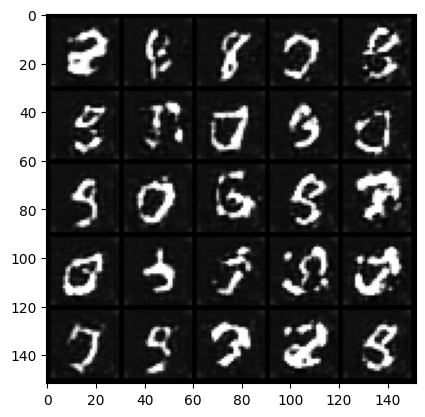

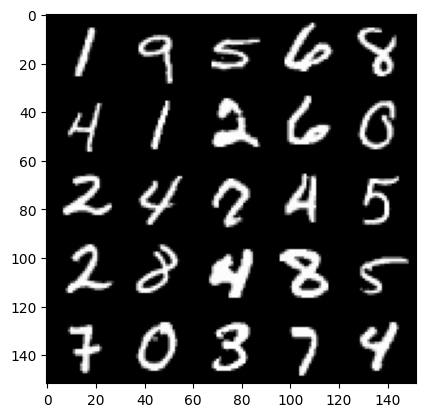

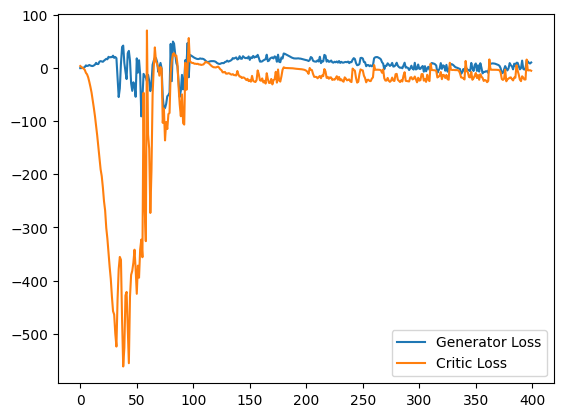

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10508289933204651
real: -5.096024513244629, fake: -11.034950256347656, regularization: 1.0508289337158203
crit_loss: torch.Size([]) -4.888096809387207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07619483768939972
real: -5.272586822509766, fake: -11.453857421875, regularization: 0.7619483470916748
crit_loss: torch.Size([]) -5.4193220138549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08378557860851288
real: -5.427653789520264, fake: -11.441059112548828, regularization: 0.8378558158874512
crit_loss: torch.Size([]) -5.175549507141113
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08744105696678162
real: -5.542291164398193, fake: -11.603331565856934, regularization: 0.8744105696678162
crit_loss: torch.Size([]) -5.186629772186279
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13453084230422974
real: -5.578608512878418, fake: -11.689987182617188, regularization: 1.34530842304229

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06230951100587845
real: -3.5588483810424805, fake: -9.679658889770508, regularization: 0.6230950951576233
crit_loss: torch.Size([]) -5.497715473175049
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07755547761917114
real: -3.5162012577056885, fake: -9.397934913635254, regularization: 0.7755547761917114
crit_loss: torch.Size([]) -5.106179237365723
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07096618413925171
real: -3.5365889072418213, fake: -9.398796081542969, regularization: 0.7096618413925171
crit_loss: torch.Size([]) -5.15254545211792
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06713199615478516
real: -3.585878610610962, fake: -9.521967887878418, regularization: 0.6713199615478516
crit_loss: torch.Size([]) -5.264769554138184
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06922654062509537
real: -3.216825485229492, fake: -9.987738609313965, regularization: 0.692265391349792

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1469489336013794
real: 27.370519638061523, fake: 3.0527191162109375, regularization: 1.469489336013794
crit_loss: torch.Size([]) -22.848310470581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24811728298664093
real: 31.2018985748291, fake: 8.376502990722656, regularization: 2.481172800064087
crit_loss: torch.Size([]) -20.344223022460938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16520676016807556
real: 10.933988571166992, fake: 9.108692169189453, regularization: 1.6520676612854004
crit_loss: torch.Size([]) -0.17322874069213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2619175910949707
real: 25.08572006225586, fake: 8.26648235321045, regularization: 2.619175910949707
crit_loss: torch.Size([]) -14.200060844421387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5372036099433899
real: 34.863670349121094, fake: -11.988821983337402, regularization: 5.372035980224609
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18086811900138855
real: 37.008148193359375, fake: 8.855376243591309, regularization: 1.8086812496185303
crit_loss: torch.Size([]) -26.34408950805664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09730072319507599
real: 29.96215057373047, fake: -1.5764919519424438, regularization: 0.9730072021484375
crit_loss: torch.Size([]) -30.565635681152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1463630497455597
real: 35.26980972290039, fake: 9.328242301940918, regularization: 1.4636304378509521
crit_loss: torch.Size([]) -24.477935791015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2942344546318054
real: 36.89790725708008, fake: 8.117364883422852, regularization: 2.9423446655273438
crit_loss: torch.Size([]) -25.838197708129883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13818401098251343
real: 31.139915466308594, fake: 1.8207981586456299, regularization: 1.3818401098251343
crit

penalty: torch.Size([]) 0.1396162211894989
real: 25.657381057739258, fake: -8.49135971069336, regularization: 1.3961622714996338
crit_loss: torch.Size([]) -32.75257873535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36382192373275757
real: 37.902679443359375, fake: -0.2164744734764099, regularization: 3.6382193565368652
crit_loss: torch.Size([]) -34.480934143066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3313451409339905
real: 39.66405487060547, fake: -0.05627603828907013, regularization: 3.3134512901306152
crit_loss: torch.Size([]) -36.40687942504883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14531734585762024
real: 36.61012268066406, fake: -1.7281436920166016, regularization: 1.4531733989715576
crit_loss: torch.Size([]) -36.88508987426758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09382119029760361
real: -0.3042449951171875, fake: 4.682291030883789, regularization: 0.9382119178771973
crit_loss: torch.Size([]) 5.92474

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2631816864013672
real: -2.2765984535217285, fake: -20.76852035522461, regularization: 2.631816864013672
crit_loss: torch.Size([]) -15.860105514526367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3903030753135681
real: -0.44462111592292786, fake: -21.45270538330078, regularization: 3.9030308723449707
crit_loss: torch.Size([]) -17.105052947998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19461172819137573
real: 2.8124544620513916, fake: -15.47714900970459, regularization: 1.9461172819137573
crit_loss: torch.Size([]) -16.343486785888672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47501039505004883
real: 2.374662399291992, fake: -16.80535125732422, regularization: 4.750103950500488
crit_loss: torch.Size([]) -14.429909706115723
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21221959590911865
real: 2.253455877304077, fake: -17.844345092773438, regularization: 2.122195959091186

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2142670452594757
real: 27.0174503326416, fake: -3.2846624851226807, regularization: 2.1426703929901123
crit_loss: torch.Size([]) -28.159442901611328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27494576573371887
real: 26.063541412353516, fake: 0.17357996106147766, regularization: 2.749457597732544
crit_loss: torch.Size([]) -23.1405029296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23547467589378357
real: 8.157021522521973, fake: 1.157393455505371, regularization: 2.3547468185424805
crit_loss: torch.Size([]) -4.644881248474121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17152896523475647
real: 22.007272720336914, fake: 3.981043815612793, regularization: 1.71528959274292
crit_loss: torch.Size([]) -16.31093978881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3588780164718628
real: 24.821044921875, fake: -3.5242602825164795, regularization: 3.588780164718628
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23699437081813812
real: 29.686534881591797, fake: -7.813206672668457, regularization: 2.369943618774414
crit_loss: torch.Size([]) -35.129798889160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09707657992839813
real: 29.12487030029297, fake: -9.791698455810547, regularization: 0.9707658290863037
crit_loss: torch.Size([]) -37.945804595947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13527452945709229
real: 30.894697189331055, fake: -4.742229461669922, regularization: 1.3527452945709229
crit_loss: torch.Size([]) -34.2841796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34914782643318176
real: 19.886566162109375, fake: -16.184877395629883, regularization: 3.491478204727173
crit_loss: torch.Size([]) -32.57996368408203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19609519839286804
real: 33.621971130371094, fake: -5.971502780914307, regularization: 1.9609520435333252
crit

real: -7.857717990875244, fake: -22.75796890258789, regularization: 1.1882179975509644
crit_loss: torch.Size([]) -13.71203327178955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14996501803398132
real: -8.10129451751709, fake: -24.027645111083984, regularization: 1.499650239944458
crit_loss: torch.Size([]) -14.426700592041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4584188759326935
real: -11.31631851196289, fake: -24.40131378173828, regularization: 4.584188938140869
crit_loss: torch.Size([]) -8.50080680847168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13882578909397125
real: -7.453309535980225, fake: -19.36699676513672, regularization: 1.3882578611373901
crit_loss: torch.Size([]) -10.525428771972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14765408635139465
real: -5.674795150756836, fake: -18.075775146484375, regularization: 1.4765408039093018
crit_loss: torch.Size([]) -10.924439430236816
gradient_norm: torch.Size([128])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3825893998146057
real: 12.293008804321289, fake: 1.5375927686691284, regularization: 3.8258938789367676
crit_loss: torch.Size([]) -6.9295220375061035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30671632289886475
real: 32.92818069458008, fake: 2.2938241958618164, regularization: 3.0671632289886475
crit_loss: torch.Size([]) -27.56719398498535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2860891819000244
real: 16.513216018676758, fake: -8.395299911499023, regularization: 2.860891819000244
crit_loss: torch.Size([]) -22.047624588012695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24049653112888336
real: 13.482823371887207, fake: -12.183914184570312, regularization: 2.404965400695801
crit_loss: torch.Size([]) -23.26177215576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21205812692642212
real: 26.71040916442871, fake: -6.4178361892700195, regularization: 2.1205811500549316
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33196818828582764
real: 29.368183135986328, fake: 5.991069793701172, regularization: 3.3196818828582764
crit_loss: torch.Size([]) -20.057432174682617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1488325297832489
real: 30.06908416748047, fake: 10.401421546936035, regularization: 1.4883253574371338
crit_loss: torch.Size([]) -18.179338455200195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3671291470527649
real: 29.25580596923828, fake: 7.384912490844727, regularization: 3.6712913513183594
crit_loss: torch.Size([]) -18.199602127075195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15780264139175415
real: 15.129380226135254, fake: 8.045886993408203, regularization: 1.5780264139175415
crit_loss: torch.Size([]) -5.505466938018799
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27512091398239136
real: 30.907197952270508, fake: 3.2285218238830566, regularization: 2.751209259033203
crit_

real: 0.7243868112564087, fake: -4.614529609680176, regularization: 3.3341360092163086
crit_loss: torch.Size([]) -2.0047802925109863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25766897201538086
real: 5.633552551269531, fake: -3.980952262878418, regularization: 2.5766897201538086
crit_loss: torch.Size([]) -7.037815093994141
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25452089309692383
real: 17.972572326660156, fake: 6.1198506355285645, regularization: 2.5452089309692383
crit_loss: torch.Size([]) -9.307513236999512
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1632007360458374
real: 25.99310302734375, fake: 0.6331052780151367, regularization: 1.632007360458374
crit_loss: torch.Size([]) -23.727989196777344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09942346066236496
real: 10.25595474243164, fake: -12.07188606262207, regularization: 0.9942346215248108
crit_loss: torch.Size([]) -21.333606719970703
gradient_norm: torch.Size([128])
p

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2071620523929596
real: 5.0038347244262695, fake: 3.456367015838623, regularization: 2.071620464324951
crit_loss: torch.Size([]) 0.5241527557373047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0872114971280098
real: 16.123674392700195, fake: 10.91414737701416, regularization: 0.8721149563789368
crit_loss: torch.Size([]) -4.337411880493164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.261483371257782
real: 34.03315353393555, fake: 2.7289938926696777, regularization: 2.6148338317871094
crit_loss: torch.Size([]) -28.6893253326416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20450744032859802
real: 13.234579086303711, fake: -18.065093994140625, regularization: 2.045074462890625
crit_loss: torch.Size([]) -29.25459861755371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3526192307472229
real: 17.446996688842773, fake: -15.849334716796875, regularization: 3.5261921882629395
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3111579120159149
real: -4.972681999206543, fake: -19.66686248779297, regularization: 3.111579179763794
crit_loss: torch.Size([]) -11.582601547241211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1634484976530075
real: -4.376367092132568, fake: -20.62371826171875, regularization: 1.6344850063323975
crit_loss: torch.Size([]) -14.612865447998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2523788511753082
real: -5.369052410125732, fake: -18.060195922851562, regularization: 2.5237884521484375
crit_loss: torch.Size([]) -10.167354583740234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16182918846607208
real: -4.104923248291016, fake: -18.544086456298828, regularization: 1.6182918548583984
crit_loss: torch.Size([]) -12.820871353149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14121775329113007
real: -3.8376548290252686, fake: -17.054737091064453, regularization: 1.4121775627136

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2761761546134949
real: 22.884017944335938, fake: -2.832170009613037, regularization: 2.7617616653442383
crit_loss: torch.Size([]) -22.954425811767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19356268644332886
real: 7.9282379150390625, fake: -4.250926971435547, regularization: 1.9356268644332886
crit_loss: torch.Size([]) -10.243537902832031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14170566201210022
real: 8.851974487304688, fake: -3.009850025177002, regularization: 1.4170565605163574
crit_loss: torch.Size([]) -10.444766998291016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4622590243816376
real: 13.075733184814453, fake: -2.849558115005493, regularization: 4.622590065002441
crit_loss: torch.Size([]) -11.302700996398926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2517578601837158
real: 22.682458877563477, fake: 2.999324321746826, regularization: 2.517578601837158
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11401581764221191
real: -2.9116413593292236, fake: -14.67725658416748, regularization: 1.1401581764221191
crit_loss: torch.Size([]) -10.625457763671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15855461359024048
real: -2.7519662380218506, fake: -14.97960090637207, regularization: 1.5855461359024048
crit_loss: torch.Size([]) -10.642087936401367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1422891616821289
real: -2.1902077198028564, fake: -16.34156036376953, regularization: 1.422891616821289
crit_loss: torch.Size([]) -12.728461265563965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2007080614566803
real: -1.8645349740982056, fake: -17.206298828125, regularization: 2.007080554962158
crit_loss: torch.Size([]) -13.33468246459961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2242293804883957
real: -0.8569852113723755, fake: -17.758258819580078, regularization: 2.242293834686279

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23347598314285278
real: -1.722823143005371, fake: -23.80328941345215, regularization: 2.3347597122192383
crit_loss: torch.Size([]) -19.745708465576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24482117593288422
real: 4.272717475891113, fake: -12.823184967041016, regularization: 2.448211669921875
crit_loss: torch.Size([]) -14.647689819335938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11967243999242783
real: 3.1722912788391113, fake: -11.627433776855469, regularization: 1.1967244148254395
crit_loss: torch.Size([]) -13.60300064086914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1389368176460266
real: 3.5062336921691895, fake: -15.27328109741211, regularization: 1.3893681764602661
crit_loss: torch.Size([]) -17.390146255493164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17905330657958984
real: 3.8760881423950195, fake: -16.306821823120117, regularization: 1.79053306579589

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17849847674369812
real: 31.226207733154297, fake: 3.2974681854248047, regularization: 1.784984827041626
crit_loss: torch.Size([]) -26.143754959106445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3372092843055725
real: 33.2137565612793, fake: 2.554093837738037, regularization: 3.3720927238464355
crit_loss: torch.Size([]) -27.287569046020508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.198903426527977
real: 30.514530181884766, fake: -0.8634706735610962, regularization: 1.9890342950820923
crit_loss: torch.Size([]) -29.388965606689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30860498547554016
real: 30.852466583251953, fake: 5.962852478027344, regularization: 3.086049795150757
crit_loss: torch.Size([]) -21.803564071655273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2460245043039322
real: 31.659687042236328, fake: 4.651036262512207, regularization: 2.460245132446289
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.047301553189754486
real: -9.683338165283203, fake: -13.67560863494873, regularization: 0.47301554679870605
crit_loss: torch.Size([]) -3.5192549228668213
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040546756237745285
real: -9.715313911437988, fake: -13.682917594909668, regularization: 0.40546756982803345
crit_loss: torch.Size([]) -3.562136173248291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03380589932203293
real: -9.796270370483398, fake: -13.748537063598633, regularization: 0.3380590081214905
crit_loss: torch.Size([]) -3.6142077445983887
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04017350822687149
real: -9.907096862792969, fake: -13.910799026489258, regularization: 0.4017350673675537
crit_loss: torch.Size([]) -3.6019670963287354
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04058058559894562
real: -10.016963958740234, fake: -14.094747543334961, regularization: 0.40580

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04202070087194443
real: -12.208122253417969, fake: -16.622276306152344, regularization: 0.42020702362060547
crit_loss: torch.Size([]) -3.9939470291137695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03576667979359627
real: -12.172866821289062, fake: -16.35675811767578, regularization: 0.3576667904853821
crit_loss: torch.Size([]) -3.8262245655059814
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.036509349942207336
real: -11.6427583694458, fake: -16.53592872619629, regularization: 0.36509349942207336
crit_loss: torch.Size([]) -4.528076648712158
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12379267066717148
real: -11.719621658325195, fake: -16.555423736572266, regularization: 1.237926721572876
crit_loss: torch.Size([]) -3.5978753566741943
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.034157246351242065
real: -11.801002502441406, fake: -16.42998504638672, regularization: 0.341572

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06330326199531555
real: -13.017678260803223, fake: -17.97576141357422, regularization: 0.6330326199531555
crit_loss: torch.Size([]) -4.325050354003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05625418573617935
real: -12.952765464782715, fake: -17.715557098388672, regularization: 0.5625418424606323
crit_loss: torch.Size([]) -4.200249671936035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06530390679836273
real: -12.829383850097656, fake: -17.21938705444336, regularization: 0.6530390977859497
crit_loss: torch.Size([]) -3.736964225769043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04494372755289078
real: -12.6470308303833, fake: -17.390148162841797, regularization: 0.4494372606277466
crit_loss: torch.Size([]) -4.293680191040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04589690640568733
real: -12.566349029541016, fake: -17.374147415161133, regularization: 0.45896905660

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.043594323098659515
real: -12.713976860046387, fake: -17.25518798828125, regularization: 0.43594324588775635
crit_loss: torch.Size([]) -4.1052680015563965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05610473453998566
real: -12.68276309967041, fake: -17.32778549194336, regularization: 0.5610473155975342
crit_loss: torch.Size([]) -4.083974838256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04951644688844681
real: -13.014556884765625, fake: -17.532649993896484, regularization: 0.4951644539833069
crit_loss: torch.Size([]) -4.022928714752197
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05777021870017052
real: -12.826725006103516, fake: -16.993709564208984, regularization: 0.5777021646499634
crit_loss: torch.Size([]) -3.589282512664795
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.044334568083286285
real: -12.617425918579102, fake: -17.08224868774414, regularization: 0.4433456

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.035335175693035126
real: -12.507763862609863, fake: -16.996572494506836, regularization: 0.35335177183151245
crit_loss: torch.Size([]) -4.1354570388793945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04757925122976303
real: -12.383925437927246, fake: -16.658306121826172, regularization: 0.4757925271987915
crit_loss: torch.Size([]) -3.798588275909424
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.042326271533966064
real: -12.2264404296875, fake: -16.753101348876953, regularization: 0.42326271533966064
crit_loss: torch.Size([]) -4.103398323059082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03888950124382973
real: -12.098102569580078, fake: -16.758201599121094, regularization: 0.3888950049877167
crit_loss: torch.Size([]) -4.271203994750977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0318361334502697
real: -11.683895111083984, fake: -16.2959041595459, regularization: 0.3183613

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05872846767306328
real: -11.537641525268555, fake: -16.58492088317871, regularization: 0.5872846841812134
crit_loss: torch.Size([]) -4.459994792938232
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.055790990591049194
real: -10.634584426879883, fake: -16.54877471923828, regularization: 0.5579099059104919
crit_loss: torch.Size([]) -5.356280326843262
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1677633821964264
real: -10.614073753356934, fake: -16.642454147338867, regularization: 1.6776337623596191
crit_loss: torch.Size([]) -4.3507466316223145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05809246003627777
real: -10.691713333129883, fake: -16.773746490478516, regularization: 0.5809246301651001
crit_loss: torch.Size([]) -5.501108646392822
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09117096662521362
real: -10.672752380371094, fake: -16.737701416015625, regularization: 0.91170966

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.070680171251297
real: -9.164963722229004, fake: -15.432085037231445, regularization: 0.70680171251297
crit_loss: torch.Size([]) -5.560319423675537
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046874940395355225
real: -8.85619068145752, fake: -15.215421676635742, regularization: 0.46874940395355225
crit_loss: torch.Size([]) -5.890481472015381
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06585536152124405
real: -8.66172981262207, fake: -15.112329483032227, regularization: 0.6585536003112793
crit_loss: torch.Size([]) -5.792046070098877
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05538308620452881
real: -9.339559555053711, fake: -15.162260055541992, regularization: 0.5538308620452881
crit_loss: torch.Size([]) -5.268869400024414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05934033915400505
real: -9.121118545532227, fake: -14.775020599365234, regularization: 0.5934033989906311

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10968069732189178
real: -5.723587989807129, fake: -10.998083114624023, regularization: 1.0968070030212402
crit_loss: torch.Size([]) -4.177688121795654
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14349916577339172
real: -5.679258346557617, fake: -11.133028984069824, regularization: 1.4349915981292725
crit_loss: torch.Size([]) -4.0187788009643555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11959564685821533
real: -5.883059978485107, fake: -12.040078163146973, regularization: 1.1959564685821533
crit_loss: torch.Size([]) -4.961061477661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09680339694023132
real: -5.841150283813477, fake: -12.072406768798828, regularization: 0.9680339694023132
crit_loss: torch.Size([]) -5.263222694396973
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06717843562364578
real: -5.808475494384766, fake: -12.307716369628906, regularization: 0.67178434133

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22194892168045044
real: 34.02228546142578, fake: 6.806122779846191, regularization: 2.219489097595215
crit_loss: torch.Size([]) -24.996673583984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2589862644672394
real: 33.478981018066406, fake: 6.345422744750977, regularization: 2.589862585067749
crit_loss: torch.Size([]) -24.5436954498291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24278467893600464
real: 25.252086639404297, fake: 8.724446296691895, regularization: 2.427846908569336
crit_loss: torch.Size([]) -14.099794387817383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21320663392543793
real: 32.32588195800781, fake: 4.976245880126953, regularization: 2.132066249847412
crit_loss: torch.Size([]) -25.21756935119629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33956587314605713
real: 19.000812530517578, fake: -5.212306022644043, regularization: 3.3956587314605713
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4489157199859619
real: -19.453170776367188, fake: 4.145428657531738, regularization: 4.489157199859619
crit_loss: torch.Size([]) 28.08775520324707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4608458876609802
real: -14.81798267364502, fake: 1.4203412532806396, regularization: 4.608458995819092
crit_loss: torch.Size([]) 20.846782684326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6131176948547363
real: -3.792827606201172, fake: -7.7622971534729, regularization: 6.131176948547363
crit_loss: torch.Size([]) 2.1617074012756348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3788466453552246
real: 12.180493354797363, fake: -10.141229629516602, regularization: 3.788466453552246
crit_loss: torch.Size([]) -18.53325653076172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5599704384803772
real: 15.519987106323242, fake: -10.401259422302246, regularization: 5.599704265594482
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7287108302116394
real: 38.25260925292969, fake: -6.963849067687988, regularization: 7.287108421325684
crit_loss: torch.Size([]) -37.92934799194336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44558924436569214
real: 29.95224952697754, fake: -21.87580680847168, regularization: 4.455892562866211
crit_loss: torch.Size([]) -47.372161865234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30666637420654297
real: 38.187896728515625, fake: -14.023918151855469, regularization: 3.0666637420654297
crit_loss: torch.Size([]) -49.14514923095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22259357571601868
real: 39.930599212646484, fake: -9.1055326461792, regularization: 2.225935697555542
crit_loss: torch.Size([]) -46.81019592285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5244755744934082
real: 34.326942443847656, fake: -19.686965942382812, regularization: 5.244755744934082
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3563757538795471
real: 39.814395904541016, fake: 4.397954940795898, regularization: 3.5637574195861816
crit_loss: torch.Size([]) -31.852685928344727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6942925453186035
real: 10.990670204162598, fake: -21.151636123657227, regularization: 6.942925453186035
crit_loss: torch.Size([]) -25.199382781982422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4093018174171448
real: 25.939138412475586, fake: -13.670944213867188, regularization: 4.093018054962158
crit_loss: torch.Size([]) -35.517066955566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3533962368965149
real: 29.559797286987305, fake: 0.385525643825531, regularization: 3.5339622497558594
crit_loss: torch.Size([]) -25.640310287475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2585780918598175
real: 25.45535659790039, fake: 1.7640678882598877, regularization: 2.5857808589935303
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3229847252368927
real: 28.162891387939453, fake: 14.138665199279785, regularization: 3.2298471927642822
crit_loss: torch.Size([]) -10.794379234313965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24186071753501892
real: 39.73149108886719, fake: 10.09646987915039, regularization: 2.418607234954834
crit_loss: torch.Size([]) -27.216413497924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7714632749557495
real: 23.801225662231445, fake: -8.265043258666992, regularization: 7.714632987976074
crit_loss: torch.Size([]) -24.351634979248047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4367760717868805
real: 20.84174156188965, fake: -9.796100616455078, regularization: 4.36776065826416
crit_loss: torch.Size([]) -26.27008056640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33546242117881775
real: 33.900360107421875, fake: -1.3622891902923584, regularization: 3.3546242713928223
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3240301311016083
real: -18.405323028564453, fake: -12.215773582458496, regularization: 3.2403013706207275
crit_loss: torch.Size([]) 9.429850578308105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34131938219070435
real: -19.267566680908203, fake: -19.645198822021484, regularization: 3.413193702697754
crit_loss: torch.Size([]) 3.0355615615844727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6345549821853638
real: -20.393104553222656, fake: -25.40319061279297, regularization: 6.345549583435059
crit_loss: torch.Size([]) 1.335463523864746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5551916360855103
real: -19.30309295654297, fake: -26.36968231201172, regularization: 5.551916122436523
crit_loss: torch.Size([]) -1.5146732330322266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.563370943069458
real: -18.15114974975586, fake: -24.451282501220703, regularization: 5.63370943069458
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24406348168849945
real: -13.734111785888672, fake: -21.99227523803711, regularization: 2.4406347274780273
crit_loss: torch.Size([]) -5.81752872467041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1731821596622467
real: -11.568276405334473, fake: -20.841232299804688, regularization: 1.7318215370178223
crit_loss: torch.Size([]) -7.541134357452393
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21152104437351227
real: -8.547395706176758, fake: -20.439184188842773, regularization: 2.11521053314209
crit_loss: torch.Size([]) -9.776577949523926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39306557178497314
real: -5.725144863128662, fake: -21.280607223510742, regularization: 3.9306557178497314
crit_loss: torch.Size([]) -11.62480640411377
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2074906826019287
real: -0.812713623046875, fake: -16.464736938476562, regularization: 2.074906826019287


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13600951433181763
real: 19.375732421875, fake: 0.8693050146102905, regularization: 1.3600951433181763
crit_loss: torch.Size([]) -17.146331787109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13553659617900848
real: 14.101583480834961, fake: -0.8093222379684448, regularization: 1.3553659915924072
crit_loss: torch.Size([]) -13.555540084838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4178045392036438
real: 24.09993553161621, fake: -3.670640230178833, regularization: 4.178045272827148
crit_loss: torch.Size([]) -23.592531204223633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23955732583999634
real: 15.796638488769531, fake: -8.866703987121582, regularization: 2.395573139190674
crit_loss: torch.Size([]) -22.26776885986328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20320935547351837
real: 17.06110382080078, fake: -11.055033683776855, regularization: 2.0320935249328613
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20460952818393707
real: 29.65222930908203, fake: -3.5614986419677734, regularization: 2.046095371246338
crit_loss: torch.Size([]) -31.167634963989258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15317220985889435
real: 26.841506958007812, fake: -9.134597778320312, regularization: 1.531722068786621
crit_loss: torch.Size([]) -34.44438171386719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17197741568088531
real: 30.402738571166992, fake: -3.302553176879883, regularization: 1.7197741270065308
crit_loss: torch.Size([]) -31.985517501831055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12446139752864838
real: 27.668209075927734, fake: 0.5568097233772278, regularization: 1.2446140050888062
crit_loss: torch.Size([]) -25.866785049438477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11204059422016144
real: 24.55004119873047, fake: -4.409521102905273, regularization: 1.120405912399292
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28533634543418884
real: -6.82375955581665, fake: -20.692501068115234, regularization: 2.853363513946533
crit_loss: torch.Size([]) -11.015378952026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5100612044334412
real: -6.315016746520996, fake: -21.714279174804688, regularization: 5.100612163543701
crit_loss: torch.Size([]) -10.298650741577148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14626841247081757
real: -4.013373374938965, fake: -20.49984359741211, regularization: 1.462684154510498
crit_loss: torch.Size([]) -15.023784637451172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2705267071723938
real: -3.7308573722839355, fake: -21.5417537689209, regularization: 2.7052669525146484
crit_loss: torch.Size([]) -15.105628967285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4002426862716675
real: -3.8418288230895996, fake: -24.868894577026367, regularization: 4.002427101135254


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13413827121257782
real: 19.18096923828125, fake: -7.252933502197266, regularization: 1.3413827419281006
crit_loss: torch.Size([]) -25.092519760131836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.163239523768425
real: 24.887374877929688, fake: -3.0053529739379883, regularization: 1.6323952674865723
crit_loss: torch.Size([]) -26.260332107543945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18600207567214966
real: 27.50908660888672, fake: 0.45338690280914307, regularization: 1.8600207567214966
crit_loss: torch.Size([]) -25.1956787109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19205352663993835
real: 25.298259735107422, fake: -4.630553245544434, regularization: 1.9205353260040283
crit_loss: torch.Size([]) -28.008277893066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15422755479812622
real: 25.153560638427734, fake: -4.329137802124023, regularization: 1.5422755479812622


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7861202955245972
real: 9.99618148803711, fake: -3.165645122528076, regularization: 7.861203193664551
crit_loss: torch.Size([]) -5.300623893737793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2946804463863373
real: 16.273279190063477, fake: -7.079195976257324, regularization: 2.9468045234680176
crit_loss: torch.Size([]) -20.405670166015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26447877287864685
real: 13.947957992553711, fake: -8.392377853393555, regularization: 2.6447877883911133
crit_loss: torch.Size([]) -19.69554901123047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1774372011423111
real: 14.857389450073242, fake: -8.538372039794922, regularization: 1.7743719816207886
crit_loss: torch.Size([]) -21.621389389038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.195746511220932
real: 6.6685075759887695, fake: -6.8058061599731445, regularization: 1.9574651718139648
crit_

penalty: torch.Size([]) 0.13337451219558716
real: 31.61459732055664, fake: 1.8583223819732666, regularization: 1.3337451219558716
crit_loss: torch.Size([]) -28.422529220581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18385997414588928
real: 30.870162963867188, fake: -2.0061893463134766, regularization: 1.838599681854248
crit_loss: torch.Size([]) -31.037750244140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08350270986557007
real: 28.066539764404297, fake: 7.153876781463623, regularization: 0.8350270986557007
crit_loss: torch.Size([]) -20.077634811401367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10574008524417877
real: 29.440080642700195, fake: 7.576315879821777, regularization: 1.0574008226394653
crit_loss: torch.Size([]) -20.806364059448242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13547804951667786
real: 26.940473556518555, fake: 4.580914497375488, regularization: 1.3547804355621338
crit_loss: torch.Size([]) -21.004

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 59.44355773925781
real: 2.513314723968506, fake: 36.70964813232422, regularization: 594.435546875
crit_loss: torch.Size([]) 628.6318969726562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 101.524169921875
real: -52.673828125, fake: -68.80113220214844, regularization: 1015.24169921875
crit_loss: torch.Size([]) 999.1143798828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 22.378803253173828
real: 9.000863075256348, fake: -12.777284622192383, regularization: 223.78802490234375
crit_loss: torch.Size([]) 202.00987243652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.779972076416016
real: -2.1819117069244385, fake: -11.710243225097656, regularization: 117.79972076416016
crit_loss: torch.Size([]) 108.27139282226562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.146809458732605
real: -6.205703258514404, fake: -10.478028297424316, regularization: 11.468094825744629
crit_loss: torch.Size(

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.036812976002693176
real: -12.793100357055664, fake: -16.46283531188965, regularization: 0.36812976002693176
crit_loss: torch.Size([]) -3.301605224609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.037110693752765656
real: -12.74300765991211, fake: -16.614519119262695, regularization: 0.37110692262649536
crit_loss: torch.Size([]) -3.5004045963287354
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04599641263484955
real: -12.878302574157715, fake: -16.396217346191406, regularization: 0.4599641263484955
crit_loss: torch.Size([]) -3.057950735092163
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03557909280061722
real: -12.844369888305664, fake: -16.453720092773438, regularization: 0.355790913105011
crit_loss: torch.Size([]) -3.2535593509674072
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04118093475699425
real: -12.8037691116333, fake: -16.33905029296875, regularization: 0.4118093

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03658337891101837
real: -9.834604263305664, fake: -16.5784912109375, regularization: 0.3658337891101837
crit_loss: torch.Size([]) -6.378053188323975
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07557766139507294
real: -9.630680084228516, fake: -16.525882720947266, regularization: 0.7557766437530518
crit_loss: torch.Size([]) -6.139426231384277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.048416078090667725
real: -9.377030372619629, fake: -15.964042663574219, regularization: 0.48416078090667725
crit_loss: torch.Size([]) -6.102851390838623
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04741040617227554
real: -9.115413665771484, fake: -16.231250762939453, regularization: 0.47410404682159424
crit_loss: torch.Size([]) -6.641733169555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06053439527750015
real: -10.584329605102539, fake: -15.799928665161133, regularization: 0.6053439378

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07026699930429459
real: -4.259998321533203, fake: -10.483722686767578, regularization: 0.7026699781417847
crit_loss: torch.Size([]) -5.521054267883301
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07112768292427063
real: -0.3582455515861511, fake: -11.653190612792969, regularization: 0.7112768292427063
crit_loss: torch.Size([]) -10.583667755126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07640032470226288
real: -0.10903774201869965, fake: -11.894379615783691, regularization: 0.7640032768249512
crit_loss: torch.Size([]) -11.021339416503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09952165186405182
real: 0.6802536845207214, fake: -11.156648635864258, regularization: 0.9952164888381958
crit_loss: torch.Size([]) -10.841686248779297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1097259670495987
real: 1.5989296436309814, fake: -10.519041061401367, regularization: 1.0972596

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08425820618867874
real: -9.022153854370117, fake: -12.665684700012207, regularization: 0.8425820469856262
crit_loss: torch.Size([]) -2.8009488582611084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12005000561475754
real: -9.19247055053711, fake: -13.129560470581055, regularization: 1.2005000114440918
crit_loss: torch.Size([]) -2.7365899085998535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15907832980155945
real: -9.257858276367188, fake: -13.578742980957031, regularization: 1.5907833576202393
crit_loss: torch.Size([]) -2.7301013469696045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06968525052070618
real: -7.588393211364746, fake: -13.269460678100586, regularization: 0.6968525052070618
crit_loss: torch.Size([]) -4.984214782714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.095065176486969
real: -7.709892749786377, fake: -13.069618225097656, regularization: 0.950651764869

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11248543858528137
real: -10.73208236694336, fake: -16.831985473632812, regularization: 1.124854326248169
crit_loss: torch.Size([]) -4.975049018859863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05333803966641426
real: -10.532125473022461, fake: -16.487268447875977, regularization: 0.533380389213562
crit_loss: torch.Size([]) -5.421762466430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08738135546445847
real: -10.42214298248291, fake: -16.587854385375977, regularization: 0.8738135695457458
crit_loss: torch.Size([]) -5.291897773742676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10341271013021469
real: -10.304116249084473, fake: -16.236846923828125, regularization: 1.034127116203308
crit_loss: torch.Size([]) -4.898603439331055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07576418668031693
real: -10.087198257446289, fake: -16.237077713012695, regularization: 0.757641851902

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08214068412780762
real: -9.058845520019531, fake: -18.15941047668457, regularization: 0.8214068412780762
crit_loss: torch.Size([]) -8.279157638549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07221575081348419
real: -9.058525085449219, fake: -18.48548126220703, regularization: 0.7221574783325195
crit_loss: torch.Size([]) -8.704798698425293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34062767028808594
real: -9.031570434570312, fake: -17.33188819885254, regularization: 3.4062767028808594
crit_loss: torch.Size([]) -4.894041061401367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1068633571267128
real: -8.638288497924805, fake: -16.936111450195312, regularization: 1.0686335563659668
crit_loss: torch.Size([]) -7.229189395904541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0853949561715126
real: -8.27798843383789, fake: -16.763402938842773, regularization: 0.8539495468139648
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12093239277601242
real: -4.292430877685547, fake: -14.347496032714844, regularization: 1.2093238830566406
crit_loss: torch.Size([]) -8.845741271972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10259567201137543
real: -4.141528606414795, fake: -13.997783660888672, regularization: 1.0259567499160767
crit_loss: torch.Size([]) -8.830297470092773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1968401074409485
real: -3.8745951652526855, fake: -14.467071533203125, regularization: 1.9684010744094849
crit_loss: torch.Size([]) -8.624074935913086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20236040651798248
real: -3.671679973602295, fake: -15.075724601745605, regularization: 2.023604154586792
crit_loss: torch.Size([]) -9.380440711975098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10769703984260559
real: -3.9010188579559326, fake: -13.67813491821289, regularization: 1.0769703388214

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4198971390724182
real: 28.565296173095703, fake: 4.6915788650512695, regularization: 4.198971271514893
crit_loss: torch.Size([]) -19.674747467041016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22981271147727966
real: 26.8652400970459, fake: 1.137692928314209, regularization: 2.2981271743774414
crit_loss: torch.Size([]) -23.429420471191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2501257359981537
real: 24.000999450683594, fake: -7.160668849945068, regularization: 2.5012574195861816
crit_loss: torch.Size([]) -28.660411834716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29941558837890625
real: 25.208587646484375, fake: -10.261568069458008, regularization: 2.9941558837890625
crit_loss: torch.Size([]) -32.47599792480469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26830777525901794
real: 30.410057067871094, fake: 3.989492654800415, regularization: 2.683077812194824
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2801426649093628
real: 30.876018524169922, fake: 10.296562194824219, regularization: 2.801426649093628
crit_loss: torch.Size([]) -17.778030395507812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15321646630764008
real: 27.411436080932617, fake: 5.4287190437316895, regularization: 1.5321646928787231
crit_loss: torch.Size([]) -20.450551986694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.194271519780159
real: 32.481056213378906, fake: 12.165838241577148, regularization: 1.9427151679992676
crit_loss: torch.Size([]) -18.37250328063965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12330006062984467
real: 30.147045135498047, fake: 4.638775825500488, regularization: 1.233000636100769
crit_loss: torch.Size([]) -24.275270462036133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11881516873836517
real: 27.55899429321289, fake: 1.3847270011901855, regularization: 1.1881517171859741
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13698440790176392
real: 28.54314422607422, fake: 2.3252501487731934, regularization: 1.3698440790176392
crit_loss: torch.Size([]) -24.84804916381836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10887600481510162
real: 9.660367965698242, fake: -13.488727569580078, regularization: 1.0887600183486938
crit_loss: torch.Size([]) -22.060335159301758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1865406334400177
real: 8.228721618652344, fake: -13.421808242797852, regularization: 1.8654062747955322
crit_loss: torch.Size([]) -19.785123825073242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10909391939640045
real: 20.198015213012695, fake: -10.799424171447754, regularization: 1.0909391641616821
crit_loss: torch.Size([]) -29.90650177001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20619836449623108
real: 6.174793720245361, fake: 7.759476661682129, regularization: 2.061983585357666
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09633971005678177
real: 37.726470947265625, fake: -5.517391204833984, regularization: 0.9633970856666565
crit_loss: torch.Size([]) -42.28046417236328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15833070874214172
real: 31.971508026123047, fake: -1.9339240789413452, regularization: 1.5833070278167725
crit_loss: torch.Size([]) -32.32212829589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18029923737049103
real: 27.827924728393555, fake: -8.891261100769043, regularization: 1.802992343902588
crit_loss: torch.Size([]) -34.91619110107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1680348515510559
real: 33.198612213134766, fake: -7.067194938659668, regularization: 1.680348515510559
crit_loss: torch.Size([]) -38.5854606628418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33898526430130005
real: 36.48099899291992, fake: -2.784447431564331, regularization: 3.389852523803711
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19934353232383728
real: 32.072349548339844, fake: -7.599587440490723, regularization: 1.9934353828430176
crit_loss: torch.Size([]) -37.67850112915039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.271075963973999
real: 13.846037864685059, fake: -12.468208312988281, regularization: 2.7107596397399902
crit_loss: torch.Size([]) -23.603487014770508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2570858299732208
real: 15.555033683776855, fake: -14.161035537719727, regularization: 2.5708582401275635
crit_loss: torch.Size([]) -27.14521026611328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2061455100774765
real: 27.90462303161621, fake: 0.5763348340988159, regularization: 2.061455011367798
crit_loss: torch.Size([]) -25.266834259033203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33746761083602905
real: 30.11603546142578, fake: 5.744613170623779, regularization: 3.37467622756958
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13067421317100525
real: -9.99075698852539, fake: -19.94489288330078, regularization: 1.3067421913146973
crit_loss: torch.Size([]) -8.647394180297852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12732301652431488
real: -9.928268432617188, fake: -19.9971923828125, regularization: 1.2732301950454712
crit_loss: torch.Size([]) -8.795693397521973
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11929194629192352
real: -9.819269180297852, fake: -20.349830627441406, regularization: 1.1929194927215576
crit_loss: torch.Size([]) -9.337641716003418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12157994508743286
real: -9.776885032653809, fake: -20.218414306640625, regularization: 1.2157994508743286
crit_loss: torch.Size([]) -9.225729942321777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13482502102851868
real: -9.849852561950684, fake: -20.639236450195312, regularization: 1.348250150680542


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16363103687763214
real: 1.1058835983276367, fake: -12.51757526397705, regularization: 1.636310338973999
crit_loss: torch.Size([]) -11.98714828491211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14651963114738464
real: 2.2586774826049805, fake: -12.428037643432617, regularization: 1.4651963710784912
crit_loss: torch.Size([]) -13.221518516540527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18576127290725708
real: 1.8173143863677979, fake: -11.418880462646484, regularization: 1.8576127290725708
crit_loss: torch.Size([]) -11.378582000732422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13382580876350403
real: 2.940469741821289, fake: -11.016936302185059, regularization: 1.3382580280303955
crit_loss: torch.Size([]) -12.619148254394531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1639809012413025
real: 5.979917526245117, fake: -10.442922592163086, regularization: 1.63980901241302

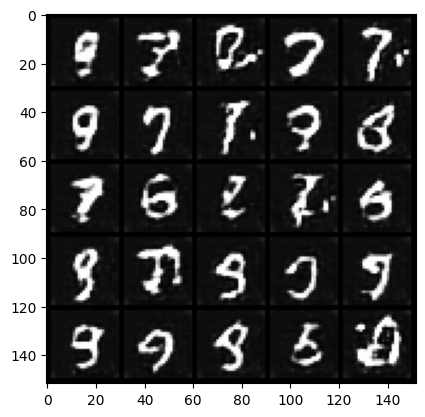

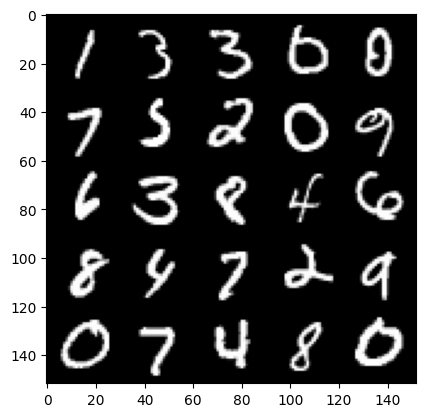

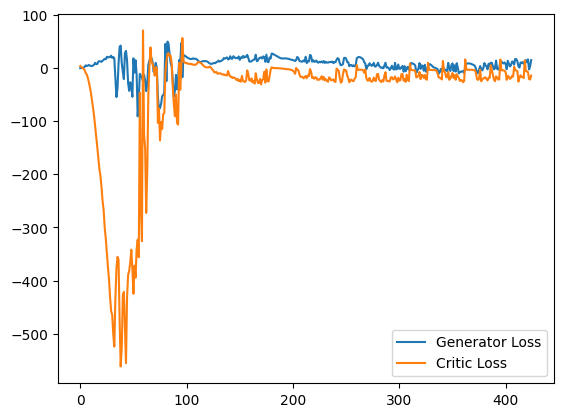

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24201515316963196
real: 12.252033233642578, fake: -6.545015335083008, regularization: 2.420151472091675
crit_loss: torch.Size([]) -16.37689781188965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22795122861862183
real: 16.31452751159668, fake: -10.34194564819336, regularization: 2.279512405395508
crit_loss: torch.Size([]) -24.37696075439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25951915979385376
real: 18.43684959411621, fake: -10.441967964172363, regularization: 2.595191478729248
crit_loss: torch.Size([]) -26.283626556396484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2519238293170929
real: 26.356842041015625, fake: -7.2077317237854, regularization: 2.519238233566284
crit_loss: torch.Size([]) -31.045337677001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26728230714797974
real: 29.259300231933594, fake: -6.427341938018799, regularization: 2.672822952270508
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12721356749534607
real: 34.328460693359375, fake: 0.8805481195449829, regularization: 1.2721357345581055
crit_loss: torch.Size([]) -32.175777435302734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3683490753173828
real: 40.911766052246094, fake: 11.994625091552734, regularization: 3.683490753173828
crit_loss: torch.Size([]) -25.23365020751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10729275643825531
real: -6.1105170249938965, fake: -3.5914182662963867, regularization: 1.0729275941848755
crit_loss: torch.Size([]) 3.5920262336730957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6612367630004883
real: -8.893385887145996, fake: -12.928470611572266, regularization: 6.612367630004883
crit_loss: torch.Size([]) 2.5772829055786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10038678348064423
real: -9.071148872375488, fake: -14.478839874267578, regularization: 1.0038678646087646

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12168972194194794
real: 23.78980827331543, fake: -3.719803810119629, regularization: 1.2168972492218018
crit_loss: torch.Size([]) -26.292715072631836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2759447991847992
real: 15.851469039916992, fake: -13.437423706054688, regularization: 2.7594480514526367
crit_loss: torch.Size([]) -26.52944564819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21384742856025696
real: 22.425922393798828, fake: -7.154142379760742, regularization: 2.138474225997925
crit_loss: torch.Size([]) -27.441591262817383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19148755073547363
real: 26.616653442382812, fake: -3.8427011966705322, regularization: 1.9148755073547363
crit_loss: torch.Size([]) -28.544479370117188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1488407850265503
real: 18.626733779907227, fake: 3.305023670196533, regularization: 1.488407850265503
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15178616344928741
real: 31.859994888305664, fake: 5.278453350067139, regularization: 1.5178616046905518
crit_loss: torch.Size([]) -25.063678741455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26974013447761536
real: 31.490734100341797, fake: 8.4874267578125, regularization: 2.697401285171509
crit_loss: torch.Size([]) -20.305906295776367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12881389260292053
real: 27.910070419311523, fake: 3.8042547702789307, regularization: 1.2881388664245605
crit_loss: torch.Size([]) -22.817676544189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1645742505788803
real: 24.904041290283203, fake: -1.4552624225616455, regularization: 1.6457425355911255
crit_loss: torch.Size([]) -24.71356201171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24643242359161377
real: 25.64992904663086, fake: -2.9588916301727295, regularization: 2.4643242359161377
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1520257294178009
real: -1.8402888774871826, fake: -14.488557815551758, regularization: 1.5202572345733643
crit_loss: torch.Size([]) -11.128011703491211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22224581241607666
real: -0.5957791209220886, fake: -14.254636764526367, regularization: 2.2224581241607666
crit_loss: torch.Size([]) -11.436399459838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15845376253128052
real: 1.4612056016921997, fake: -11.655548095703125, regularization: 1.5845376253128052
crit_loss: torch.Size([]) -11.53221607208252
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11376956105232239
real: -2.289992094039917, fake: -12.771184921264648, regularization: 1.137695550918579
crit_loss: torch.Size([]) -9.343497276306152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29391735792160034
real: -2.816845178604126, fake: -15.801386833190918, regularization: 2.9391736984

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1425274759531021
real: 2.8772735595703125, fake: -9.35964298248291, regularization: 1.4252747297286987
crit_loss: torch.Size([]) -10.811641693115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2308974266052246
real: 6.09159517288208, fake: -10.435907363891602, regularization: 2.308974266052246
crit_loss: torch.Size([]) -14.218527793884277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23441724479198456
real: 6.879129409790039, fake: -9.429065704345703, regularization: 2.344172477722168
crit_loss: torch.Size([]) -13.964022636413574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.155481219291687
real: 6.9192376136779785, fake: -9.863977432250977, regularization: 1.5548121929168701
crit_loss: torch.Size([]) -15.228402137756348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11041665822267532
real: 7.310585975646973, fake: -9.35104751586914, regularization: 1.1041666269302368
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18627716600894928
real: 34.21043014526367, fake: 5.620411396026611, regularization: 1.8627716302871704
crit_loss: torch.Size([]) -26.72724723815918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.280145525932312
real: 35.1881103515625, fake: 6.560845375061035, regularization: 2.80145525932312
crit_loss: torch.Size([]) -25.8258113861084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2182808518409729
real: 20.423725128173828, fake: 7.767444610595703, regularization: 2.1828083992004395
crit_loss: torch.Size([]) -10.473472595214844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2279224395751953
real: 30.22016143798828, fake: 6.780730724334717, regularization: 2.279224395751953
crit_loss: torch.Size([]) -21.160205841064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5412238836288452
real: 26.017282485961914, fake: -2.7297003269195557, regularization: 5.412239074707031
crit_loss: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15589646995067596
real: 34.10658264160156, fake: 12.591205596923828, regularization: 1.558964729309082
crit_loss: torch.Size([]) -19.95641326904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18986836075782776
real: 29.44168472290039, fake: 10.46017074584961, regularization: 1.8986835479736328
crit_loss: torch.Size([]) -17.08283042907715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18558275699615479
real: 30.551395416259766, fake: 4.705588340759277, regularization: 1.8558275699615479
crit_loss: torch.Size([]) -23.989978790283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1523505300283432
real: 30.79755401611328, fake: 4.892395496368408, regularization: 1.5235053300857544
crit_loss: torch.Size([]) -24.38165283203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2033391296863556
real: 35.141357421875, fake: 11.569421768188477, regularization: 2.033391237258911
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27331945300102234
real: 32.33331298828125, fake: -18.04126739501953, regularization: 2.733194589614868
crit_loss: torch.Size([]) -47.64138412475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4471321702003479
real: 33.86273193359375, fake: -18.437278747558594, regularization: 4.4713215827941895
crit_loss: torch.Size([]) -47.82868957519531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2669536769390106
real: 34.061702728271484, fake: -18.92169952392578, regularization: 2.669536828994751
crit_loss: torch.Size([]) -50.313865661621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2419738620519638
real: -4.045961856842041, fake: -19.792835235595703, regularization: 2.419738531112671
crit_loss: torch.Size([]) -13.32713508605957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30350208282470703
real: 7.774991035461426, fake: -9.770544052124023, regularization: 3.0350208282470703
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37129294872283936
real: 23.2136287689209, fake: 1.9656379222869873, regularization: 3.7129294872283936
crit_loss: torch.Size([]) -17.535062789916992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24978850781917572
real: 26.360485076904297, fake: 5.029053688049316, regularization: 2.49788498878479
crit_loss: torch.Size([]) -18.833547592163086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22037476301193237
real: 28.09191131591797, fake: 3.269996404647827, regularization: 2.2037477493286133
crit_loss: torch.Size([]) -22.618167877197266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2917047142982483
real: 28.430875778198242, fake: 4.068373680114746, regularization: 2.9170470237731934
crit_loss: torch.Size([]) -21.44545555114746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15198278427124023
real: 28.505165100097656, fake: 4.526679992675781, regularization: 1.5198278427124023
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2628972828388214
real: 22.679014205932617, fake: -13.164651870727539, regularization: 2.6289727687835693
crit_loss: torch.Size([]) -33.21469497680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39736688137054443
real: 35.653751373291016, fake: -7.355740547180176, regularization: 3.9736688137054443
crit_loss: torch.Size([]) -39.035823822021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18360485136508942
real: 33.998809814453125, fake: -10.765009880065918, regularization: 1.8360484838485718
crit_loss: torch.Size([]) -42.927772521972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12042774260044098
real: 35.954856872558594, fake: 4.687507629394531, regularization: 1.2042773962020874
crit_loss: torch.Size([]) -30.063072204589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1987742781639099
real: 41.748252868652344, fake: 9.226788520812988, regularization: 1.9877427816390991

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4554559588432312
real: 46.33928298950195, fake: 17.577831268310547, regularization: 4.554559707641602
crit_loss: torch.Size([]) -24.206892013549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6158699989318848
real: 30.892929077148438, fake: -3.419649600982666, regularization: 6.158699989318848
crit_loss: torch.Size([]) -28.153881072998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18408574163913727
real: 40.49390411376953, fake: 8.07846450805664, regularization: 1.8408573865890503
crit_loss: torch.Size([]) -30.574583053588867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2216041088104248
real: 42.90001678466797, fake: 8.976031303405762, regularization: 2.216041088104248
crit_loss: torch.Size([]) -31.707942962646484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16097736358642578
real: 38.83644485473633, fake: -2.2308359146118164, regularization: 1.6097736358642578
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.153925359249115
real: -9.822208404541016, fake: -24.102441787719727, regularization: 1.53925359249115
crit_loss: torch.Size([]) -12.74098014831543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2565491795539856
real: -10.166357040405273, fake: -27.418930053710938, regularization: 2.5654916763305664
crit_loss: torch.Size([]) -14.687081336975098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33890196681022644
real: -11.575886726379395, fake: -28.76504135131836, regularization: 3.389019727706909
crit_loss: torch.Size([]) -13.800135612487793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26745569705963135
real: -10.852811813354492, fake: -26.946657180786133, regularization: 2.6745569705963135
crit_loss: torch.Size([]) -13.419288635253906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33322620391845703
real: -10.046880722045898, fake: -27.269855499267578, regularization: 3.332262039184

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15223300457000732
real: 17.610382080078125, fake: -3.0007987022399902, regularization: 1.5223300457000732
crit_loss: torch.Size([]) -19.088851928710938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10809066146612167
real: 20.819908142089844, fake: -1.0852136611938477, regularization: 1.080906629562378
crit_loss: torch.Size([]) -20.824214935302734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21329498291015625
real: 21.875274658203125, fake: -2.670560836791992, regularization: 2.1329498291015625
crit_loss: torch.Size([]) -22.412885665893555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1448660045862198
real: 22.694713592529297, fake: -0.5726375579833984, regularization: 1.4486600160598755
crit_loss: torch.Size([]) -21.81869125366211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20232701301574707
real: 18.796894073486328, fake: 3.37774658203125, regularization: 2.023270130157470

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11004218459129333
real: 22.11288070678711, fake: 0.5575016736984253, regularization: 1.1004219055175781
crit_loss: torch.Size([]) -20.454957962036133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11608041822910309
real: 22.526573181152344, fake: 3.928049325942993, regularization: 1.1608041524887085
crit_loss: torch.Size([]) -17.437719345092773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15587644279003143
real: 28.49527359008789, fake: 5.191681861877441, regularization: 1.5587644577026367
crit_loss: torch.Size([]) -21.744827270507812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13370850682258606
real: 29.14142608642578, fake: 6.4372124671936035, regularization: 1.3370850086212158
crit_loss: torch.Size([]) -21.367128372192383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11014620214700699
real: 28.964374542236328, fake: 4.35011625289917, regularization: 1.1014620065689087
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19646990299224854
real: 21.8508243560791, fake: -8.237546920776367, regularization: 1.9646990299224854
crit_loss: torch.Size([]) -28.123672485351562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.203840970993042
real: 23.694419860839844, fake: -4.25598669052124, regularization: 2.03840970993042
crit_loss: torch.Size([]) -25.911996841430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2532825767993927
real: 29.407554626464844, fake: 1.0799986124038696, regularization: 2.5328257083892822
crit_loss: torch.Size([]) -25.79473114013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13646993041038513
real: 23.061317443847656, fake: 14.301460266113281, regularization: 1.364699363708496
crit_loss: torch.Size([]) -7.395157814025879
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2116020917892456
real: 33.431053161621094, fake: 10.024026870727539, regularization: 2.116020917892456
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.090748131275177
real: 26.25621795654297, fake: -5.7694854736328125, regularization: 0.90748131275177
crit_loss: torch.Size([]) -31.118221282958984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1096331849694252
real: 32.24755859375, fake: -1.3143506050109863, regularization: 1.0963318347930908
crit_loss: torch.Size([]) -32.465576171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09721936285495758
real: 31.273113250732422, fake: 2.665952444076538, regularization: 0.9721935987472534
crit_loss: torch.Size([]) -27.634967803955078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14598849415779114
real: 25.53665542602539, fake: -7.964951038360596, regularization: 1.4598848819732666
crit_loss: torch.Size([]) -32.04172134399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15127629041671753
real: 33.661376953125, fake: 2.7050271034240723, regularization: 1.5127629041671753
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0980573296546936
real: 26.95490837097168, fake: 8.210371017456055, regularization: 0.980573296546936
crit_loss: torch.Size([]) -17.76396369934082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1795302778482437
real: 26.16057586669922, fake: 6.904970169067383, regularization: 1.7953027486801147
crit_loss: torch.Size([]) -17.460302352905273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10484178364276886
real: 22.24796485900879, fake: 2.5954818725585938, regularization: 1.0484178066253662
crit_loss: torch.Size([]) -18.60406494140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1500316709280014
real: 26.145294189453125, fake: 2.9535441398620605, regularization: 1.5003167390823364
crit_loss: torch.Size([]) -21.69143295288086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19811752438545227
real: 27.452037811279297, fake: 1.4773831367492676, regularization: 1.981175184249878
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04228787124156952
real: -12.837356567382812, fake: -18.01130485534668, regularization: 0.4228787124156952
crit_loss: torch.Size([]) -4.75106954574585
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04144033417105675
real: -12.95660400390625, fake: -17.951885223388672, regularization: 0.41440334916114807
crit_loss: torch.Size([]) -4.580877780914307
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.038782428950071335
real: -13.093679428100586, fake: -18.32916259765625, regularization: 0.38782429695129395
crit_loss: torch.Size([]) -4.847659111022949
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04172219708561897
real: -13.247638702392578, fake: -18.786846160888672, regularization: 0.41722196340560913
crit_loss: torch.Size([]) -5.12198543548584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0433817058801651
real: -13.620000839233398, fake: -18.9191951751709, regularization: 0.43381705880

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06363231688737869
real: -11.19083023071289, fake: -18.72238540649414, regularization: 0.6363231539726257
crit_loss: torch.Size([]) -6.895232200622559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04070889577269554
real: -11.12567138671875, fake: -18.46839141845703, regularization: 0.407088965177536
crit_loss: torch.Size([]) -6.935631275177002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039615385234355927
real: -10.869707107543945, fake: -18.48208999633789, regularization: 0.39615386724472046
crit_loss: torch.Size([]) -7.21622896194458
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09907298535108566
real: -10.55515193939209, fake: -18.293100357055664, regularization: 0.9907298684120178
crit_loss: torch.Size([]) -6.747218608856201
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04687400907278061
real: -10.162946701049805, fake: -18.007205963134766, regularization: 0.4687401056289

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10841883718967438
real: 4.086248874664307, fake: -8.491132736206055, regularization: 1.0841883420944214
crit_loss: torch.Size([]) -11.493192672729492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12493669986724854
real: 6.006941318511963, fake: -7.068707466125488, regularization: 1.2493669986724854
crit_loss: torch.Size([]) -11.826282501220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1757063865661621
real: 7.537636756896973, fake: -8.004878997802734, regularization: 1.757063865661621
crit_loss: torch.Size([]) -13.785451889038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1853257715702057
real: 12.380838394165039, fake: -5.941673278808594, regularization: 1.853257656097412
crit_loss: torch.Size([]) -16.469253540039062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15168893337249756
real: 15.2473726272583, fake: -5.874543190002441, regularization: 1.5168893337249756
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19087956845760345
real: 18.99821662902832, fake: 4.583690166473389, regularization: 1.908795714378357
crit_loss: torch.Size([]) -12.505730628967285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13586942851543427
real: 26.656402587890625, fake: 1.8401412963867188, regularization: 1.358694314956665
crit_loss: torch.Size([]) -23.45756721496582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2416253685951233
real: 16.38194465637207, fake: -5.573624134063721, regularization: 2.4162535667419434
crit_loss: torch.Size([]) -19.53931427001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10637832432985306
real: 19.135517120361328, fake: -0.5982428789138794, regularization: 1.0637832880020142
crit_loss: torch.Size([]) -18.66997718811035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13199828565120697
real: 27.050891876220703, fake: 4.8266801834106445, regularization: 1.319982886314392
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1287289559841156
real: -9.183866500854492, fake: -21.188251495361328, regularization: 1.2872896194458008
crit_loss: torch.Size([]) -10.717095375061035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22942712903022766
real: -8.614112854003906, fake: -20.69188690185547, regularization: 2.294271230697632
crit_loss: torch.Size([]) -9.783502578735352
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10725019872188568
real: -9.449461936950684, fake: -19.537431716918945, regularization: 1.0725020170211792
crit_loss: torch.Size([]) -9.015467643737793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09045760333538055
real: -9.222755432128906, fake: -21.376811981201172, regularization: 0.9045760631561279
crit_loss: torch.Size([]) -11.249480247497559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2175936996936798
real: -9.756965637207031, fake: -22.83068084716797, regularization: 2.175936937332153

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48846232891082764
real: 23.72795867919922, fake: -13.020146369934082, regularization: 4.8846235275268555
crit_loss: torch.Size([]) -31.863479614257812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4635833501815796
real: 28.743619918823242, fake: -9.107626914978027, regularization: 4.635833740234375
crit_loss: torch.Size([]) -33.21541213989258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11757205426692963
real: 23.5628662109375, fake: -14.444247245788574, regularization: 1.1757205724716187
crit_loss: torch.Size([]) -36.83139419555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1665014922618866
real: 28.263532638549805, fake: -12.637418746948242, regularization: 1.6650149822235107
crit_loss: torch.Size([]) -39.23593521118164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27724117040634155
real: 18.082096099853516, fake: -3.875873565673828, regularization: 2.772411823272705
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15069296956062317
real: 33.40483093261719, fake: -2.348680019378662, regularization: 1.506929636001587
crit_loss: torch.Size([]) -34.246578216552734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1300976574420929
real: 34.09619140625, fake: 0.8675575256347656, regularization: 1.3009765148162842
crit_loss: torch.Size([]) -31.927658081054688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12269728630781174
real: 25.92902183532715, fake: -9.349114418029785, regularization: 1.2269728183746338
crit_loss: torch.Size([]) -34.05116271972656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18041546642780304
real: 32.72591018676758, fake: -2.8073530197143555, regularization: 1.804154634475708
crit_loss: torch.Size([]) -33.72911071777344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1614760160446167
real: 35.79766082763672, fake: 0.035513103008270264, regularization: 1.614760160446167
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09749414771795273
real: 27.45563507080078, fake: 9.191911697387695, regularization: 0.9749414920806885
crit_loss: torch.Size([]) -17.288782119750977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0856332778930664
real: 29.39202117919922, fake: 6.129693984985352, regularization: 0.8563327789306641
crit_loss: torch.Size([]) -22.405994415283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11283855885267258
real: 25.698055267333984, fake: 4.504188060760498, regularization: 1.1283855438232422
crit_loss: torch.Size([]) -20.065481185913086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11159494519233704
real: 36.61152648925781, fake: 10.256612777709961, regularization: 1.1159493923187256
crit_loss: torch.Size([]) -25.238964080810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15297597646713257
real: 32.265804290771484, fake: -1.3242099285125732, regularization: 1.5297597646713257
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09018908441066742
real: -11.931394577026367, fake: -21.55373764038086, regularization: 0.9018908739089966
crit_loss: torch.Size([]) -8.720452308654785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1188686266541481
real: -12.099876403808594, fake: -22.18638038635254, regularization: 1.1886862516403198
crit_loss: torch.Size([]) -8.897817611694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14842469990253448
real: -12.204788208007812, fake: -23.31494140625, regularization: 1.4842469692230225
crit_loss: torch.Size([]) -9.625905990600586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13225603103637695
real: -12.213408470153809, fake: -22.785991668701172, regularization: 1.3225603103637695
crit_loss: torch.Size([]) -9.250022888183594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1024174690246582
real: -12.205883979797363, fake: -23.43328857421875, regularization: 1.024174690246582


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3691098392009735
real: 21.032190322875977, fake: -12.187623977661133, regularization: 3.69109845161438
crit_loss: torch.Size([]) -29.528715133666992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14304599165916443
real: 29.82610511779785, fake: -4.6526594161987305, regularization: 1.430459976196289
crit_loss: torch.Size([]) -33.048301696777344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17586472630500793
real: 25.516963958740234, fake: -4.495274543762207, regularization: 1.7586472034454346
crit_loss: torch.Size([]) -28.253589630126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1530781090259552
real: 32.866756439208984, fake: 4.119037628173828, regularization: 1.5307810306549072
crit_loss: torch.Size([]) -27.216938018798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07578203827142715
real: 32.71409606933594, fake: 4.151022911071777, regularization: 0.7578203678131104
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.097025066614151
real: 19.697803497314453, fake: 1.8170254230499268, regularization: 0.97025066614151
crit_loss: torch.Size([]) -16.910526275634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1670348048210144
real: 31.8330135345459, fake: 10.802289962768555, regularization: 1.670348048210144
crit_loss: torch.Size([]) -19.360376358032227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17001931369304657
real: 32.44243621826172, fake: 7.64309549331665, regularization: 1.700193166732788
crit_loss: torch.Size([]) -23.09914779663086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22893284261226654
real: 27.77096176147461, fake: 2.4998390674591064, regularization: 2.2893283367156982
crit_loss: torch.Size([]) -22.981794357299805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14676809310913086
real: 20.76751708984375, fake: 4.69482421875, regularization: 1.4676809310913086
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15455740690231323
real: 16.582956314086914, fake: 2.4354281425476074, regularization: 1.5455740690231323
crit_loss: torch.Size([]) -12.601953506469727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2901115119457245
real: 19.178518295288086, fake: 6.387126922607422, regularization: 2.9011151790618896
crit_loss: torch.Size([]) -9.890275955200195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22252820432186127
real: 28.23036003112793, fake: 4.9565229415893555, regularization: 2.2252819538116455
crit_loss: torch.Size([]) -21.048555374145508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14687559008598328
real: 15.539505004882812, fake: -10.823938369750977, regularization: 1.4687559604644775
crit_loss: torch.Size([]) -24.89468765258789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19337859749794006
real: 16.49773406982422, fake: -10.282068252563477, regularization: 1.9337859153747559


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1351012885570526
real: 34.765968322753906, fake: -5.674055099487305, regularization: 1.351012945175171
crit_loss: torch.Size([]) -39.089012145996094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1030062809586525
real: 31.262325286865234, fake: -8.257003784179688, regularization: 1.0300627946853638
crit_loss: torch.Size([]) -38.48926544189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20373669266700745
real: 36.616092681884766, fake: -3.216893196105957, regularization: 2.0373668670654297
crit_loss: torch.Size([]) -37.795616149902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17014983296394348
real: 24.714061737060547, fake: -3.4897851943969727, regularization: 1.70149827003479
crit_loss: torch.Size([]) -26.502347946166992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09138644486665726
real: 32.536865234375, fake: 3.151149272918701, regularization: 0.9138644337654114
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.304332435131073
real: -9.785319328308105, fake: 1.3023312091827393, regularization: 3.0433244705200195
crit_loss: torch.Size([]) 14.130974769592285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2528899610042572
real: -8.202557563781738, fake: 3.4229016304016113, regularization: 2.528899669647217
crit_loss: torch.Size([]) 14.154359817504883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2990339994430542
real: 5.968100070953369, fake: -5.873422622680664, regularization: 2.990339994430542
crit_loss: torch.Size([]) -8.851181983947754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23606103658676147
real: 9.54902172088623, fake: -18.27637481689453, regularization: 2.3606104850769043
crit_loss: torch.Size([]) -25.464786529541016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.460396409034729
real: 13.290329933166504, fake: -17.155029296875, regularization: 4.603963851928711
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21536582708358765
real: 34.188087463378906, fake: -0.16728642582893372, regularization: 2.153658390045166
crit_loss: torch.Size([]) -32.20171356201172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14298035204410553
real: 32.877716064453125, fake: 0.7021211385726929, regularization: 1.429803490638733
crit_loss: torch.Size([]) -30.745790481567383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15199683606624603
real: 18.457820892333984, fake: 1.166759967803955, regularization: 1.5199683904647827
crit_loss: torch.Size([]) -15.771093368530273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7079572677612305
real: 14.773001670837402, fake: -28.037429809570312, regularization: 7.079572677612305
crit_loss: torch.Size([]) -35.730857849121094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23574477434158325
real: 19.251815795898438, fake: -25.310516357421875, regularization: 2.357447624206543

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06002674624323845
real: -14.159226417541504, fake: -18.302879333496094, regularization: 0.6002674698829651
crit_loss: torch.Size([]) -3.5433855056762695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08056508004665375
real: -14.191034317016602, fake: -18.47219467163086, regularization: 0.8056508302688599
crit_loss: torch.Size([]) -3.4755096435546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05997816473245621
real: -14.214881896972656, fake: -18.461151123046875, regularization: 0.5997816324234009
crit_loss: torch.Size([]) -3.6464877128601074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0665353536605835
real: -14.208818435668945, fake: -18.519229888916016, regularization: 0.665353536605835
crit_loss: torch.Size([]) -3.6450579166412354
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0866088941693306
real: -14.173175811767578, fake: -18.516372680664062, regularization: 0.8660889

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05333731323480606
real: -15.109739303588867, fake: -19.257299423217773, regularization: 0.5333731174468994
crit_loss: torch.Size([]) -3.614187002182007
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.041544876992702484
real: -15.031431198120117, fake: -19.313663482666016, regularization: 0.41544878482818604
crit_loss: torch.Size([]) -3.866783618927002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02749432995915413
real: -15.361047744750977, fake: -19.229835510253906, regularization: 0.2749432921409607
crit_loss: torch.Size([]) -3.593844413757324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.027379166334867477
real: -15.362638473510742, fake: -19.18649673461914, regularization: 0.27379167079925537
crit_loss: torch.Size([]) -3.5500664710998535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.029954729601740837
real: -15.379172325134277, fake: -19.040088653564453, regularization: 0.29

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03674118220806122
real: -14.994885444641113, fake: -19.172025680541992, regularization: 0.3674118220806122
crit_loss: torch.Size([]) -3.8097283840179443
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.035803258419036865
real: -14.991979598999023, fake: -19.080595016479492, regularization: 0.35803258419036865
crit_loss: torch.Size([]) -3.7305827140808105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04075419157743454
real: -14.97797679901123, fake: -19.200788497924805, regularization: 0.4075419306755066
crit_loss: torch.Size([]) -3.815269708633423
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0319887176156044
real: -15.019176483154297, fake: -19.273868560791016, regularization: 0.3198871612548828
crit_loss: torch.Size([]) -3.934804916381836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03354679420590401
real: -14.917909622192383, fake: -19.245332717895508, regularization: 0.33546

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.049445223063230515
real: -13.567082405090332, fake: -18.753660202026367, regularization: 0.49445223808288574
crit_loss: torch.Size([]) -4.69212532043457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.051099151372909546
real: -13.79345989227295, fake: -18.353515625, regularization: 0.5109915137290955
crit_loss: torch.Size([]) -4.0490641593933105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03993051499128342
real: -13.700464248657227, fake: -18.487218856811523, regularization: 0.39930516481399536
crit_loss: torch.Size([]) -4.387449264526367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04328937456011772
real: -13.614483833312988, fake: -18.307859420776367, regularization: 0.4328937530517578
crit_loss: torch.Size([]) -4.260481834411621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03434522822499275
real: -13.512983322143555, fake: -18.17487144470215, regularization: 0.34345227479

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05309055745601654
real: -12.108396530151367, fake: -17.439273834228516, regularization: 0.5309056043624878
crit_loss: torch.Size([]) -4.799971580505371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.043461285531520844
real: -11.83249282836914, fake: -17.105607986450195, regularization: 0.43461287021636963
crit_loss: torch.Size([]) -4.838502407073975
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.055284127593040466
real: -11.614526748657227, fake: -16.877605438232422, regularization: 0.552841305732727
crit_loss: torch.Size([]) -4.710237503051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0488247349858284
real: -10.152170181274414, fake: -16.80785369873047, regularization: 0.4882473349571228
crit_loss: torch.Size([]) -6.167436122894287
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03677899390459061
real: -9.911805152893066, fake: -16.501331329345703, regularization: 0.367789924

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.042726509273052216
real: -11.035959243774414, fake: -15.113908767700195, regularization: 0.42726510763168335
crit_loss: torch.Size([]) -3.650684356689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06645926833152771
real: -10.960587501525879, fake: -14.723791122436523, regularization: 0.6645926833152771
crit_loss: torch.Size([]) -3.0986108779907227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05398086458444595
real: -10.8958740234375, fake: -14.40976333618164, regularization: 0.5398086309432983
crit_loss: torch.Size([]) -2.9740805625915527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05244291573762894
real: -10.886489868164062, fake: -14.868022918701172, regularization: 0.5244291424751282
crit_loss: torch.Size([]) -3.457103967666626
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.052554793655872345
real: -10.945232391357422, fake: -14.688807487487793, regularization: 0.52554

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05675766244530678
real: -9.020393371582031, fake: -13.751781463623047, regularization: 0.5675766468048096
crit_loss: torch.Size([]) -4.163811683654785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11081529408693314
real: -9.04917049407959, fake: -14.24920654296875, regularization: 1.108152985572815
crit_loss: torch.Size([]) -4.091883182525635
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05483728647232056
real: -9.467069625854492, fake: -13.84105110168457, regularization: 0.5483728647232056
crit_loss: torch.Size([]) -3.825608730316162
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08000054210424423
real: -9.425966262817383, fake: -14.036018371582031, regularization: 0.8000054359436035
crit_loss: torch.Size([]) -3.810046672821045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05769805610179901
real: -9.266870498657227, fake: -13.799959182739258, regularization: 0.5769805908203125

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08707781881093979
real: -8.804596900939941, fake: -14.645933151245117, regularization: 0.8707782030105591
crit_loss: torch.Size([]) -4.970558166503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08672180026769638
real: -8.667740821838379, fake: -14.426299095153809, regularization: 0.867218017578125
crit_loss: torch.Size([]) -4.891340255737305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07681252062320709
real: -8.598152160644531, fake: -14.39586353302002, regularization: 0.7681251764297485
crit_loss: torch.Size([]) -5.029586315155029
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07015693187713623
real: -8.607141494750977, fake: -14.28189468383789, regularization: 0.7015693187713623
crit_loss: torch.Size([]) -4.973183631896973
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07036158442497253
real: -8.960748672485352, fake: -14.49393081665039, regularization: 0.7036158442497253

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04936063289642334
real: -8.382257461547852, fake: -13.85487174987793, regularization: 0.4936063289642334
crit_loss: torch.Size([]) -4.979007720947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0462440624833107
real: -9.087862014770508, fake: -14.001209259033203, regularization: 0.4624406099319458
crit_loss: torch.Size([]) -4.450906753540039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06687744706869125
real: -9.057899475097656, fake: -14.0300874710083, regularization: 0.6687744855880737
crit_loss: torch.Size([]) -4.303413391113281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06439273059368134
real: -8.919271469116211, fake: -13.96250057220459, regularization: 0.6439273357391357
crit_loss: torch.Size([]) -4.399301528930664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.043260037899017334
real: -8.801251411437988, fake: -13.663609504699707, regularization: 0.4326003789901733

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06321109086275101
real: -7.277148246765137, fake: -12.426668167114258, regularization: 0.6321108937263489
crit_loss: torch.Size([]) -4.517408847808838
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12873126566410065
real: -6.902883529663086, fake: -12.368669509887695, regularization: 1.287312626838684
crit_loss: torch.Size([]) -4.178473472595215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06626249104738235
real: -6.40557336807251, fake: -11.657278060913086, regularization: 0.6626248955726624
crit_loss: torch.Size([]) -4.589079856872559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05727766454219818
real: -6.2486066818237305, fake: -11.764142036437988, regularization: 0.5727766752243042
crit_loss: torch.Size([]) -4.942758560180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09048479795455933
real: -6.282949447631836, fake: -11.659006118774414, regularization: 0.9048479795455

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1013883501291275
real: -7.1688232421875, fake: -12.660581588745117, regularization: 1.0138834714889526
crit_loss: torch.Size([]) -4.477874755859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08916790038347244
real: -7.225489616394043, fake: -12.667232513427734, regularization: 0.8916789889335632
crit_loss: torch.Size([]) -4.5500640869140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06312313675880432
real: -7.172598838806152, fake: -12.586492538452148, regularization: 0.6312313675880432
crit_loss: torch.Size([]) -4.782662391662598
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06136779114603996
real: -7.036266803741455, fake: -12.788346290588379, regularization: 0.6136779189109802
crit_loss: torch.Size([]) -5.138401508331299
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0771603137254715
real: -6.9091796875, fake: -12.581039428710938, regularization: 0.7716031074523926
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09478287398815155
real: -4.105388641357422, fake: -11.179186820983887, regularization: 0.9478287696838379
crit_loss: torch.Size([]) -6.125969409942627
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.079857237637043
real: -3.637840747833252, fake: -11.074653625488281, regularization: 0.7985723614692688
crit_loss: torch.Size([]) -6.638240337371826
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08622738718986511
real: -4.681417465209961, fake: -10.720582962036133, regularization: 0.8622738718986511
crit_loss: torch.Size([]) -5.176891803741455
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08130459487438202
real: -4.790699005126953, fake: -11.039230346679688, regularization: 0.8130459785461426
crit_loss: torch.Size([]) -5.435485363006592
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06313370913267136
real: -4.889944553375244, fake: -11.038835525512695, regularization: 0.63133710622787

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10944678634405136
real: -0.2718692421913147, fake: -10.890400886535645, regularization: 1.0944678783416748
crit_loss: torch.Size([]) -9.524063110351562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11886776238679886
real: 0.19941672682762146, fake: -11.14850902557373, regularization: 1.1886776685714722
crit_loss: torch.Size([]) -10.159248352050781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1311005800962448
real: 0.7537683248519897, fake: -10.100201606750488, regularization: 1.3110058307647705
crit_loss: torch.Size([]) -9.542963981628418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12856899201869965
real: 1.0345834493637085, fake: -10.404289245605469, regularization: 1.2856899499893188
crit_loss: torch.Size([]) -10.153182029724121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11380824446678162
real: -0.5468422174453735, fake: -10.741795539855957, regularization: 1.138082504

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27398139238357544
real: 22.82388687133789, fake: -4.375604629516602, regularization: 2.739813804626465
crit_loss: torch.Size([]) -24.459678649902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14799316227436066
real: 26.02315902709961, fake: 3.3383545875549316, regularization: 1.4799315929412842
crit_loss: torch.Size([]) -21.20487403869629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20115868747234344
real: 26.512653350830078, fake: 0.7183793783187866, regularization: 2.011586904525757
crit_loss: torch.Size([]) -23.782686233520508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22655051946640015
real: 24.537128448486328, fake: -0.8316243290901184, regularization: 2.265505313873291
crit_loss: torch.Size([]) -23.103248596191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25507652759552
real: 22.96142578125, fake: 0.8441029787063599, regularization: 2.5507652759552
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4754164218902588
real: 20.20680809020996, fake: -10.938680648803711, regularization: 4.754164218902588
crit_loss: torch.Size([]) -26.391324996948242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1643294095993042
real: 27.836620330810547, fake: -2.2926273345947266, regularization: 1.643294095993042
crit_loss: torch.Size([]) -28.48595428466797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6212172508239746
real: 41.15882110595703, fake: 8.525553703308105, regularization: 6.212172508239746
crit_loss: torch.Size([]) -26.421092987060547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.139343723654747
real: 9.753826141357422, fake: 3.718691825866699, regularization: 1.3934372663497925
crit_loss: torch.Size([]) -4.641696929931641
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2972255051136017
real: 10.076654434204102, fake: -0.24628692865371704, regularization: 2.972254991531372
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27699366211891174
real: 26.11054229736328, fake: 14.222169876098633, regularization: 2.7699365615844727
crit_loss: torch.Size([]) -9.118435859680176
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21057075262069702
real: 29.364547729492188, fake: 2.97174072265625, regularization: 2.1057076454162598
crit_loss: torch.Size([]) -24.287099838256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17807890474796295
real: 18.451061248779297, fake: -5.048089027404785, regularization: 1.7807890176773071
crit_loss: torch.Size([]) -21.718360900878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13641232252120972
real: 22.466350555419922, fake: -2.0082154273986816, regularization: 1.3641232252120972
crit_loss: torch.Size([]) -23.110443115234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20705121755599976
real: 31.429676055908203, fake: 0.4940902590751648, regularization: 2.070512294769287


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20814350247383118
real: 27.839515686035156, fake: 5.875039100646973, regularization: 2.081434965133667
crit_loss: torch.Size([]) -19.88304328918457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14352953433990479
real: 27.23094940185547, fake: 5.078904151916504, regularization: 1.4352953433990479
crit_loss: torch.Size([]) -20.716751098632812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17503036558628082
real: 28.13821029663086, fake: 6.699577331542969, regularization: 1.7503036260604858
crit_loss: torch.Size([]) -19.688329696655273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20041364431381226
real: 30.491567611694336, fake: 7.864897727966309, regularization: 2.004136562347412
crit_loss: torch.Size([]) -20.622533798217773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1982508897781372
real: 30.329242706298828, fake: 8.91617202758789, regularization: 1.982508897781372
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19308561086654663
real: 23.195293426513672, fake: -0.5579838752746582, regularization: 1.9308561086654663
crit_loss: torch.Size([]) -21.822420120239258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2656611502170563
real: 19.57663345336914, fake: -2.120736598968506, regularization: 2.656611442565918
crit_loss: torch.Size([]) -19.040760040283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1866403967142105
real: 19.746654510498047, fake: -7.483118057250977, regularization: 1.8664039373397827
crit_loss: torch.Size([]) -25.36336898803711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2018526792526245
real: 21.61760711669922, fake: -5.882084369659424, regularization: 2.018526792526245
crit_loss: torch.Size([]) -25.481164932250977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18615621328353882
real: 29.83389663696289, fake: 3.9173333644866943, regularization: 1.8615621328353882
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3142426609992981
real: 26.784286499023438, fake: -3.3660569190979004, regularization: 3.1424264907836914
crit_loss: torch.Size([]) -27.007915496826172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19244793057441711
real: 24.19413948059082, fake: 13.516448020935059, regularization: 1.9244792461395264
crit_loss: torch.Size([]) -8.753211975097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2764301002025604
real: 35.98748016357422, fake: 19.789505004882812, regularization: 2.764301061630249
crit_loss: torch.Size([]) -13.433673858642578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3271491825580597
real: 28.613296508789062, fake: 4.020263671875, regularization: 3.271491765975952
crit_loss: torch.Size([]) -21.32154083251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5090374946594238
real: 16.373779296875, fake: -5.475251197814941, regularization: 5.090374946594238
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2193153351545334
real: 37.61553955078125, fake: 13.07878303527832, regularization: 2.1931533813476562
crit_loss: torch.Size([]) -22.343603134155273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19392424821853638
real: 33.98405456542969, fake: 10.073467254638672, regularization: 1.9392424821853638
crit_loss: torch.Size([]) -21.971343994140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25467973947525024
real: 34.15884780883789, fake: 10.517279624938965, regularization: 2.546797275543213
crit_loss: torch.Size([]) -21.094770431518555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19304588437080383
real: 28.606355667114258, fake: 12.470721244812012, regularization: 1.9304587841033936
crit_loss: torch.Size([]) -14.20517635345459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1523074507713318
real: 33.75174331665039, fake: 11.645872116088867, regularization: 1.5230745077133179
crit_

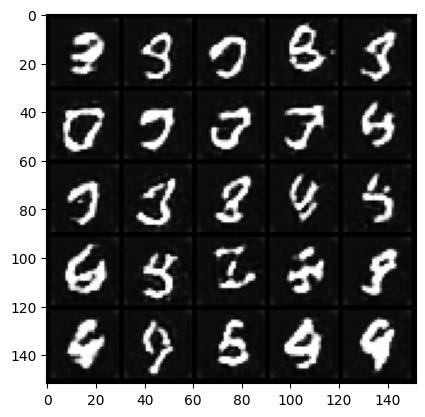

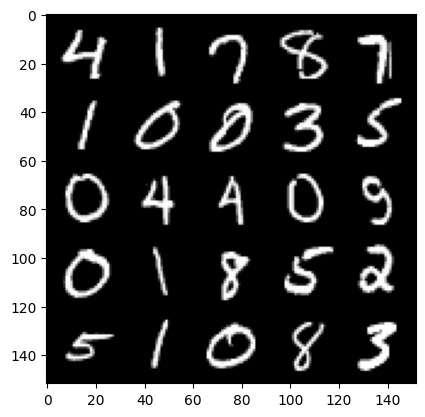

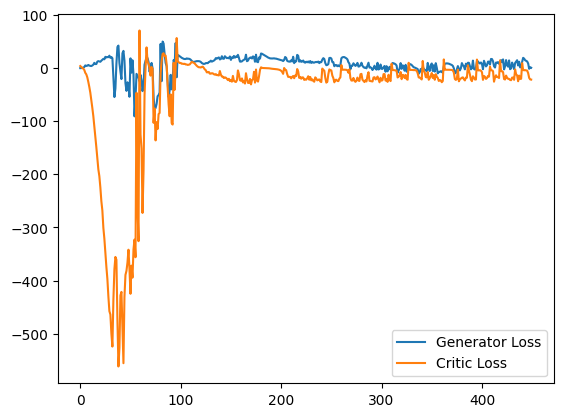

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08368802070617676
real: -6.8072099685668945, fake: -0.963703989982605, regularization: 0.8368802070617676
crit_loss: torch.Size([]) 6.680386066436768
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22149869799613953
real: -10.583343505859375, fake: -16.574405670166016, regularization: 2.21498703956604
crit_loss: torch.Size([]) -3.7760751247406006
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16657936573028564
real: -11.615316390991211, fake: -20.528676986694336, regularization: 1.6657936573028564
crit_loss: torch.Size([]) -7.247567176818848
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10720550268888474
real: -11.86373519897461, fake: -20.87681770324707, regularization: 1.0720549821853638
crit_loss: torch.Size([]) -7.941027641296387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09973295778036118
real: -12.049346923828125, fake: -22.461715698242188, regularization: 0.997329592704

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18684884905815125
real: 30.521804809570312, fake: -7.502220153808594, regularization: 1.8684885501861572
crit_loss: torch.Size([]) -36.15553665161133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21269536018371582
real: 33.265602111816406, fake: 1.032657265663147, regularization: 2.126953601837158
crit_loss: torch.Size([]) -30.10599136352539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0907420665025711
real: 4.004195213317871, fake: 6.745844841003418, regularization: 0.9074206352233887
crit_loss: torch.Size([]) 3.6490702629089355
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3044573664665222
real: 3.18145751953125, fake: 1.7651232481002808, regularization: 3.0445737838745117
crit_loss: torch.Size([]) 1.6282395124435425
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2538928985595703
real: 6.217803001403809, fake: -0.20391634106636047, regularization: 2.538928985595703
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1403437852859497
real: 2.4960885047912598, fake: -8.956250190734863, regularization: 1.403437852859497
crit_loss: torch.Size([]) -10.048901557922363
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1724964827299118
real: 4.151376724243164, fake: -8.366144180297852, regularization: 1.7249648571014404
crit_loss: torch.Size([]) -10.792555809020996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1658378690481186
real: 7.654086112976074, fake: -6.945667266845703, regularization: 1.6583787202835083
crit_loss: torch.Size([]) -12.941374778747559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17363965511322021
real: 13.567768096923828, fake: -5.354438781738281, regularization: 1.7363965511322021
crit_loss: torch.Size([]) -17.185810089111328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1884283721446991
real: 11.282247543334961, fake: -2.905794382095337, regularization: 1.8842837810516357
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2844257950782776
real: -1.2896703481674194, fake: -24.110740661621094, regularization: 2.8442578315734863
crit_loss: torch.Size([]) -19.9768123626709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19589394330978394
real: 2.041929244995117, fake: -18.52191925048828, regularization: 1.9589394330978394
crit_loss: torch.Size([]) -18.604909896850586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2693330645561218
real: 0.09166686981916428, fake: -20.266780853271484, regularization: 2.693330764770508
crit_loss: torch.Size([]) -17.665117263793945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17762555181980133
real: -2.821998119354248, fake: -27.600440979003906, regularization: 1.776255488395691
crit_loss: torch.Size([]) -23.002187728881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4819391071796417
real: -4.799572467803955, fake: -29.501636505126953, regularization: 4.819391250610352

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20584048330783844
real: 18.296062469482422, fake: -2.068511486053467, regularization: 2.0584049224853516
crit_loss: torch.Size([]) -18.306169509887695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12904565036296844
real: 17.6927490234375, fake: -2.481137275695801, regularization: 1.2904565334320068
crit_loss: torch.Size([]) -18.8834285736084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17868024110794067
real: 17.625186920166016, fake: -2.0172119140625, regularization: 1.7868024110794067
crit_loss: torch.Size([]) -17.8555965423584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2601691484451294
real: 9.609573364257812, fake: -0.9042072296142578, regularization: 2.601691484451294
crit_loss: torch.Size([]) -7.9120893478393555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32835569977760315
real: 24.011680603027344, fake: -5.315007209777832, regularization: 3.2835569381713867
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12514053285121918
real: -7.218385696411133, fake: -9.246883392333984, regularization: 1.2514053583145142
crit_loss: torch.Size([]) -0.7770923376083374
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2527660131454468
real: -9.777755737304688, fake: -18.460702896118164, regularization: 2.5276601314544678
crit_loss: torch.Size([]) -6.15528678894043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08288855105638504
real: -9.819189071655273, fake: -20.450302124023438, regularization: 0.8288854956626892
crit_loss: torch.Size([]) -9.802227973937988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07727421820163727
real: -10.205796241760254, fake: -20.927661895751953, regularization: 0.7727421522140503
crit_loss: torch.Size([]) -9.94912338256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13177740573883057
real: -10.766175270080566, fake: -23.185611724853516, regularization: 1.3177740573883

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15656548738479614
real: 15.026519775390625, fake: -9.982961654663086, regularization: 1.5656548738479614
crit_loss: torch.Size([]) -23.44382667541504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08791428804397583
real: 16.855972290039062, fake: -7.866831302642822, regularization: 0.8791428804397583
crit_loss: torch.Size([]) -23.843660354614258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18005764484405518
real: 12.168723106384277, fake: -9.268882751464844, regularization: 1.8005764484405518
crit_loss: torch.Size([]) -19.63702964782715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11271317303180695
real: 19.657878875732422, fake: -3.999051094055176, regularization: 1.127131700515747
crit_loss: torch.Size([]) -22.529796600341797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19789919257164001
real: 22.545495986938477, fake: -0.6082720160484314, regularization: 1.978991985321045

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4291989505290985
real: -16.25379753112793, fake: -22.609416961669922, regularization: 4.291989326477051
crit_loss: torch.Size([]) -2.0636301040649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5281522870063782
real: -17.17381477355957, fake: -27.58344841003418, regularization: 5.281522750854492
crit_loss: torch.Size([]) -5.128110885620117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.49841028451919556
real: -17.04640769958496, fake: -29.04190444946289, regularization: 4.984102725982666
crit_loss: torch.Size([]) -7.011394023895264
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5206626653671265
real: -15.53853702545166, fake: -25.872119903564453, regularization: 5.206626892089844
crit_loss: torch.Size([]) -5.126955986022949
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5964785814285278
real: -19.248430252075195, fake: -27.681556701660156, regularization: 5.964785575866699
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21702052652835846
real: 14.567564964294434, fake: -12.994314193725586, regularization: 2.1702053546905518
crit_loss: torch.Size([]) -25.391672134399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18962037563323975
real: 7.6600141525268555, fake: -11.53493881225586, regularization: 1.8962037563323975
crit_loss: torch.Size([]) -17.298749923706055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3691340982913971
real: 17.390365600585938, fake: -9.055961608886719, regularization: 3.691340923309326
crit_loss: torch.Size([]) -22.754985809326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16088977456092834
real: 12.794208526611328, fake: -17.26701545715332, regularization: 1.6088976860046387
crit_loss: torch.Size([]) -28.45232582092285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17977166175842285
real: 15.382604598999023, fake: -13.855960845947266, regularization: 1.79771661758422

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2037358283996582
real: -1.3741703033447266, fake: -0.9864243268966675, regularization: 2.037358283996582
crit_loss: torch.Size([]) 2.4251041412353516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18511125445365906
real: 12.411504745483398, fake: -1.0429176092147827, regularization: 1.8511126041412354
crit_loss: torch.Size([]) -11.603309631347656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15629801154136658
real: 28.127521514892578, fake: 11.276065826416016, regularization: 1.5629801750183105
crit_loss: torch.Size([]) -15.288475036621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10614320635795593
real: 18.039505004882812, fake: 4.237547874450684, regularization: 1.061432123184204
crit_loss: torch.Size([]) -12.740525245666504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13886228203773499
real: 17.692476272583008, fake: 6.080348968505859, regularization: 1.388622760772705


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1347840577363968
real: -2.846689224243164, fake: -14.129215240478516, regularization: 1.3478405475616455
crit_loss: torch.Size([]) -9.934685707092285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1343325525522232
real: 4.498980522155762, fake: -9.185918807983398, regularization: 1.3433254957199097
crit_loss: torch.Size([]) -12.341573715209961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12371721863746643
real: 13.458433151245117, fake: -4.49069881439209, regularization: 1.2371721267700195
crit_loss: torch.Size([]) -16.711959838867188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23815038800239563
real: 21.122901916503906, fake: 1.365966796875, regularization: 2.3815038204193115
crit_loss: torch.Size([]) -17.375431060791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17648613452911377
real: 22.20721435546875, fake: 2.311715602874756, regularization: 1.7648613452911377
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09775576740503311
real: -8.454510688781738, fake: -16.2092227935791, regularization: 0.9775576591491699
crit_loss: torch.Size([]) -6.777154445648193
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08091507852077484
real: -9.58598518371582, fake: -16.968017578125, regularization: 0.8091508150100708
crit_loss: torch.Size([]) -6.572881698608398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08161458373069763
real: -13.46453857421875, fake: -18.39865493774414, regularization: 0.8161458373069763
crit_loss: torch.Size([]) -4.1179704666137695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12896481156349182
real: -13.511584281921387, fake: -21.125024795532227, regularization: 1.2896480560302734
crit_loss: torch.Size([]) -6.323792457580566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14277245104312897
real: -11.71308422088623, fake: -20.333290100097656, regularization: 1.4277244806289673


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21718737483024597
real: 0.6928126811981201, fake: -10.270732879638672, regularization: 2.1718738079071045
crit_loss: torch.Size([]) -8.791671752929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2526032328605652
real: 7.527200698852539, fake: -6.013574600219727, regularization: 2.5260324478149414
crit_loss: torch.Size([]) -11.014742851257324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22705931961536407
real: 8.058570861816406, fake: -6.174139976501465, regularization: 2.2705931663513184
crit_loss: torch.Size([]) -11.962118148803711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08150774985551834
real: 7.4509968757629395, fake: -6.806703567504883, regularization: 0.8150774836540222
crit_loss: torch.Size([]) -13.442622184753418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11060048639774323
real: 4.006270408630371, fake: -7.087213516235352, regularization: 1.1060048341751099


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2966986298561096
real: -8.808709144592285, fake: -25.645679473876953, regularization: 2.9669861793518066
crit_loss: torch.Size([]) -13.869985580444336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5384463667869568
real: -22.128381729125977, fake: -25.309513092041016, regularization: 5.384463787078857
crit_loss: torch.Size([]) 2.2033324241638184
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5105118155479431
real: -14.393233299255371, fake: -22.13015365600586, regularization: 5.105118274688721
crit_loss: torch.Size([]) -2.6318020820617676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2830107510089874
real: -14.726810455322266, fake: -25.642385482788086, regularization: 2.8301074504852295
crit_loss: torch.Size([]) -8.085467338562012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1810937076807022
real: -7.919651985168457, fake: -29.198719024658203, regularization: 1.810937047004699

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08068987727165222
real: 14.169183731079102, fake: -3.10499906539917, regularization: 0.8068987727165222
crit_loss: torch.Size([]) -16.46728515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10012227296829224
real: 14.9934663772583, fake: -4.446690082550049, regularization: 1.0012227296829224
crit_loss: torch.Size([]) -18.438934326171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10996374487876892
real: 15.235072135925293, fake: -2.6062846183776855, regularization: 1.099637508392334
crit_loss: torch.Size([]) -16.741718292236328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11579350382089615
real: -3.758946657180786, fake: -0.4130490720272064, regularization: 1.1579350233078003
crit_loss: torch.Size([]) 4.503832817077637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41823405027389526
real: 18.300817489624023, fake: -6.100125312805176, regularization: 4.182340621948242
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1789596974849701
real: 2.73342227935791, fake: -16.87458038330078, regularization: 1.7895970344543457
crit_loss: torch.Size([]) -17.818405151367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22473904490470886
real: 9.579395294189453, fake: -15.094172477722168, regularization: 2.2473905086517334
crit_loss: torch.Size([]) -22.426177978515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18371666967868805
real: 13.340215682983398, fake: -9.137053489685059, regularization: 1.837166666984558
crit_loss: torch.Size([]) -20.64010238647461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16531464457511902
real: 13.845780372619629, fake: -7.441519737243652, regularization: 1.653146505355835
crit_loss: torch.Size([]) -19.634153366088867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12713228166103363
real: 12.267940521240234, fake: -14.3966064453125, regularization: 1.2713228464126587
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3529510796070099
real: 19.386974334716797, fake: -8.029900550842285, regularization: 3.529510736465454
crit_loss: torch.Size([]) -23.88736343383789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18405279517173767
real: 25.352481842041016, fake: -6.626845836639404, regularization: 1.8405280113220215
crit_loss: torch.Size([]) -30.1387996673584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2948712408542633
real: 17.935649871826172, fake: 3.4031801223754883, regularization: 2.9487123489379883
crit_loss: torch.Size([]) -11.583757400512695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19448012113571167
real: 23.23427963256836, fake: 8.564360618591309, regularization: 1.9448012113571167
crit_loss: torch.Size([]) -12.725117683410645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1864927113056183
real: 27.742298126220703, fake: 11.171808242797852, regularization: 1.864927053451538
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11304768919944763
real: 30.215648651123047, fake: 16.13127899169922, regularization: 1.130476951599121
crit_loss: torch.Size([]) -12.953892707824707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3381526470184326
real: 12.215559005737305, fake: -12.762489318847656, regularization: 3.381526470184326
crit_loss: torch.Size([]) -21.596521377563477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1747608184814453
real: 14.8291654586792, fake: -10.733667373657227, regularization: 1.7476081848144531
crit_loss: torch.Size([]) -23.815223693847656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3824669122695923
real: 38.203224182128906, fake: 4.624773979187012, regularization: 3.824669122695923
crit_loss: torch.Size([]) -29.753780364990234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2917349934577942
real: 28.000232696533203, fake: 1.5776396989822388, regularization: 2.9173498153686523
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09028920531272888
real: -9.728155136108398, fake: -16.371315002441406, regularization: 0.9028920531272888
crit_loss: torch.Size([]) -5.740267753601074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11974169313907623
real: -8.91829776763916, fake: -17.39058494567871, regularization: 1.19741690158844
crit_loss: torch.Size([]) -7.2748703956604
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07245054095983505
real: -9.205986022949219, fake: -18.217674255371094, regularization: 0.7245054244995117
crit_loss: torch.Size([]) -8.287182807922363
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1185164675116539
real: -9.337640762329102, fake: -18.470550537109375, regularization: 1.1851646900177002
crit_loss: torch.Size([]) -7.947745323181152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12773403525352478
real: -9.279586791992188, fake: -17.960874557495117, regularization: 1.2773404121398926
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1417642831802368
real: -2.154679775238037, fake: -48.240753173828125, regularization: 11.417642593383789
crit_loss: torch.Size([]) -34.668434143066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8817334771156311
real: 4.602535247802734, fake: -29.614238739013672, regularization: 8.81733512878418
crit_loss: torch.Size([]) -25.399438858032227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2632206678390503
real: 1.6637494564056396, fake: -46.951019287109375, regularization: 12.632206916809082
crit_loss: torch.Size([]) -35.98256301879883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5868839621543884
real: -22.459911346435547, fake: -37.11674499511719, regularization: 5.868839740753174
crit_loss: torch.Size([]) -8.787994384765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6977412700653076
real: 4.111711025238037, fake: -14.9213228225708, regularization: 6.977412700653076
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24174046516418457
real: 20.545265197753906, fake: -3.2242236137390137, regularization: 2.4174046516418457
crit_loss: torch.Size([]) -21.35208511352539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14184829592704773
real: 22.337059020996094, fake: -4.270140171051025, regularization: 1.418483018875122
crit_loss: torch.Size([]) -25.1887149810791
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13268965482711792
real: 27.17379379272461, fake: -4.683163166046143, regularization: 1.3268965482711792
crit_loss: torch.Size([]) -30.530059814453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35725122690200806
real: 31.902667999267578, fake: -1.6521000862121582, regularization: 3.572512149810791
crit_loss: torch.Size([]) -29.982255935668945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2545102834701538
real: 30.446792602539062, fake: -3.2314746379852295, regularization: 2.545102834701538
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3392029404640198
real: -17.386131286621094, fake: -23.240325927734375, regularization: 3.392029285430908
crit_loss: torch.Size([]) -2.462165355682373
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22026394307613373
real: -16.903867721557617, fake: -22.605178833007812, regularization: 2.20263934135437
crit_loss: torch.Size([]) -3.498671770095825
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32861191034317017
real: -16.69956398010254, fake: -22.23712921142578, regularization: 3.286118984222412
crit_loss: torch.Size([]) -2.25144624710083
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4134480357170105
real: -14.719393730163574, fake: -20.216114044189453, regularization: 4.1344804763793945
crit_loss: torch.Size([]) -1.3622398376464844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7500138282775879
real: -17.01401138305664, fake: -25.042884826660156, regularization: 7.500138282775879
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07849112898111343
real: 3.7796950340270996, fake: -4.122281074523926, regularization: 0.7849112749099731
crit_loss: torch.Size([]) -7.117064952850342
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06160581111907959
real: 4.771768569946289, fake: -4.687494277954102, regularization: 0.6160581111907959
crit_loss: torch.Size([]) -8.843204498291016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12792342901229858
real: 5.5965166091918945, fake: -0.49781474471092224, regularization: 1.2792342901229858
crit_loss: torch.Size([]) -4.815096855163574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09112589806318283
real: 5.55108642578125, fake: -4.9865403175354, regularization: 0.9112589955329895
crit_loss: torch.Size([]) -9.626367568969727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0614406056702137
real: 5.680358409881592, fake: -3.598119020462036, regularization: 0.6144060492515564
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11427760869264603
real: -8.095999717712402, fake: -15.370877265930176, regularization: 1.1427761316299438
crit_loss: torch.Size([]) -6.132101535797119
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14227722585201263
real: -8.280998229980469, fake: -15.866588592529297, regularization: 1.4227722883224487
crit_loss: torch.Size([]) -6.16281795501709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17632009088993073
real: -8.4146146774292, fake: -16.336795806884766, regularization: 1.7632008790969849
crit_loss: torch.Size([]) -6.158980369567871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18609195947647095
real: -8.267084121704102, fake: -16.006999969482422, regularization: 1.8609195947647095
crit_loss: torch.Size([]) -5.8789963722229
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11721478402614594
real: -7.782014846801758, fake: -15.275997161865234, regularization: 1.1721478700637817


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12144052982330322
real: -8.162215232849121, fake: -17.84477996826172, regularization: 1.2144052982330322
crit_loss: torch.Size([]) -8.468159675598145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0828615128993988
real: -7.914738655090332, fake: -17.726106643676758, regularization: 0.828615128993988
crit_loss: torch.Size([]) -8.982752799987793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11357668042182922
real: -7.865752220153809, fake: -18.290769577026367, regularization: 1.1357667446136475
crit_loss: torch.Size([]) -9.289250373840332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08594212681055069
real: -7.750749588012695, fake: -18.14691162109375, regularization: 0.8594212532043457
crit_loss: torch.Size([]) -9.536741256713867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28775691986083984
real: -8.191372871398926, fake: -17.25759506225586, regularization: 2.8775691986083984


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24941155314445496
real: 8.572698593139648, fake: -13.081670761108398, regularization: 2.4941155910491943
crit_loss: torch.Size([]) -19.160253524780273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17604191601276398
real: -1.1342926025390625, fake: -12.013625144958496, regularization: 1.7604191303253174
crit_loss: torch.Size([]) -9.118913650512695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15757572650909424
real: 4.932966232299805, fake: -10.610554695129395, regularization: 1.5757572650909424
crit_loss: torch.Size([]) -13.967763900756836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13429979979991913
real: 13.149907112121582, fake: -5.848232269287109, regularization: 1.3429980278015137
crit_loss: torch.Size([]) -17.655139923095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34385043382644653
real: 14.379969596862793, fake: -2.982715129852295, regularization: 3.438504219055

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07672721892595291
real: 10.975997924804688, fake: 2.0601418018341064, regularization: 0.7672721743583679
crit_loss: torch.Size([]) -8.148584365844727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07919187843799591
real: 18.851852416992188, fake: 5.175603866577148, regularization: 0.7919187545776367
crit_loss: torch.Size([]) -12.884329795837402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10648450255393982
real: 24.995498657226562, fake: 6.795530319213867, regularization: 1.064845085144043
crit_loss: torch.Size([]) -17.13512420654297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14277802407741547
real: -2.087103843688965, fake: 5.724708080291748, regularization: 1.427780270576477
crit_loss: torch.Size([]) 9.239592552185059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1736387461423874
real: 8.066665649414062, fake: 8.881534576416016, regularization: 1.7363874912261963
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15438775718212128
real: 27.53879165649414, fake: -12.303394317626953, regularization: 1.5438776016235352
crit_loss: torch.Size([]) -38.298309326171875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3394381105899811
real: -21.800891876220703, fake: -5.356563568115234, regularization: 3.394381046295166
crit_loss: torch.Size([]) 19.838708877563477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42944586277008057
real: -23.670326232910156, fake: -22.172353744506836, regularization: 4.294458389282227
crit_loss: torch.Size([]) 5.792430877685547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6380875110626221
real: -19.613183975219727, fake: -30.286102294921875, regularization: 6.380875110626221
crit_loss: torch.Size([]) -4.292043209075928
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.4960906505584717
real: -15.563495635986328, fake: -29.696094512939453, regularization: 14.960906982421875

real: 26.68649673461914, fake: -9.525171279907227, regularization: 0.872875452041626
crit_loss: torch.Size([]) -35.33879470825195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10724691301584244
real: 23.518381118774414, fake: -11.948751449584961, regularization: 1.0724691152572632
crit_loss: torch.Size([]) -34.3946647644043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13708779215812683
real: 28.73733901977539, fake: -9.16461181640625, regularization: 1.370877981185913
crit_loss: torch.Size([]) -36.53107452392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1520136445760727
real: 31.166168212890625, fake: -5.9175286293029785, regularization: 1.5201364755630493
crit_loss: torch.Size([]) -35.563560485839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10160684585571289
real: 21.784460067749023, fake: -8.669445037841797, regularization: 1.016068458557129
crit_loss: torch.Size([]) -29.437835693359375
gradient_norm: torch.Size([128])
pen

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12670789659023285
real: 23.14096450805664, fake: 2.365905523300171, regularization: 1.2670789957046509
crit_loss: torch.Size([]) -19.507980346679688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.140525683760643
real: 21.884260177612305, fake: -19.426668167114258, regularization: 1.4052568674087524
crit_loss: torch.Size([]) -39.905670166015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25218209624290466
real: 9.75092601776123, fake: -28.31046485900879, regularization: 2.5218210220336914
crit_loss: torch.Size([]) -35.53956985473633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22806259989738464
real: 19.914175033569336, fake: -21.026268005371094, regularization: 2.280626058578491
crit_loss: torch.Size([]) -38.659820556640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09360495954751968
real: 23.330148696899414, fake: -19.87664794921875, regularization: 0.9360495805740356
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27022045850753784
real: 17.38102912902832, fake: -4.446181774139404, regularization: 2.702204704284668
crit_loss: torch.Size([]) -19.12500762939453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14280426502227783
real: -0.5093309879302979, fake: 4.429417133331299, regularization: 1.4280426502227783
crit_loss: torch.Size([]) 6.366790771484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17190155386924744
real: 10.424196243286133, fake: 9.497626304626465, regularization: 1.7190155982971191
crit_loss: torch.Size([]) 0.7924456596374512
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10342220216989517
real: 27.087909698486328, fake: 1.8961493968963623, regularization: 1.0342220067977905
crit_loss: torch.Size([]) -24.15753936767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2698941230773926
real: 11.746521949768066, fake: -13.414064407348633, regularization: 2.698941230773926
crit_

real: 2.6611812114715576, fake: -20.177417755126953, regularization: 2.5131070613861084
crit_loss: torch.Size([]) -20.325490951538086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16706757247447968
real: 5.669013500213623, fake: -17.338333129882812, regularization: 1.6706757545471191
crit_loss: torch.Size([]) -21.336671829223633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23320426046848297
real: 8.471960067749023, fake: -16.268524169921875, regularization: 2.332042694091797
crit_loss: torch.Size([]) -22.4084415435791
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19200342893600464
real: -17.930891036987305, fake: -9.947261810302734, regularization: 1.9200342893600464
crit_loss: torch.Size([]) 9.903663635253906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17798301577568054
real: -17.453147888183594, fake: -12.539742469787598, regularization: 1.7798302173614502
crit_loss: torch.Size([]) 6.693235397338867
gradient_norm: torch.Size([128

penalty: torch.Size([]) 0.15294618904590607
real: 8.740867614746094, fake: -10.933490753173828, regularization: 1.5294618606567383
crit_loss: torch.Size([]) -18.1448974609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19955024123191833
real: 11.254624366760254, fake: -10.970272064208984, regularization: 1.9955024719238281
crit_loss: torch.Size([]) -20.229393005371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1810620129108429
real: 14.395773887634277, fake: -9.774476051330566, regularization: 1.8106200695037842
crit_loss: torch.Size([]) -22.359630584716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2218388020992279
real: 17.002304077148438, fake: -7.253199577331543, regularization: 2.218388080596924
crit_loss: torch.Size([]) -22.03711700439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18727663159370422
real: 16.46306610107422, fake: -5.264355659484863, regularization: 1.8727662563323975
crit_loss: torch.Size([]) -19.85465

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10125656425952911
real: 8.616253852844238, fake: 2.9584388732910156, regularization: 1.0125656127929688
crit_loss: torch.Size([]) -4.645249366760254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13015878200531006
real: 15.78579330444336, fake: -0.3870365023612976, regularization: 1.3015878200531006
crit_loss: torch.Size([]) -14.87124252319336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.256570041179657
real: 15.195951461791992, fake: -4.930344581604004, regularization: 2.5657005310058594
crit_loss: torch.Size([]) -17.560596466064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17659348249435425
real: 13.077533721923828, fake: -4.879593849182129, regularization: 1.7659348249435425
crit_loss: torch.Size([]) -16.191192626953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13826103508472443
real: 17.67951202392578, fake: -3.4899649620056152, regularization: 1.3826103210449219
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19379016757011414
real: 24.773826599121094, fake: 2.7007675170898438, regularization: 1.9379017353057861
crit_loss: torch.Size([]) -20.135156631469727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11505982279777527
real: 25.482118606567383, fake: 5.812379837036133, regularization: 1.1505982875823975
crit_loss: torch.Size([]) -18.519140243530273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12493833154439926
real: 25.539091110229492, fake: 3.4395933151245117, regularization: 1.2493833303451538
crit_loss: torch.Size([]) -20.850114822387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16002440452575684
real: 25.04623031616211, fake: 3.682554244995117, regularization: 1.6002440452575684
crit_loss: torch.Size([]) -19.763431549072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13369698822498322
real: 24.47216796875, fake: 4.057413101196289, regularization: 1.3369698524475098
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2621065080165863
real: -18.099384307861328, fake: 6.548258304595947, regularization: 2.621065139770508
crit_loss: torch.Size([]) 27.268707275390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2108791172504425
real: -13.687838554382324, fake: 9.554988861083984, regularization: 2.1087911128997803
crit_loss: torch.Size([]) 25.351619720458984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5308164358139038
real: 2.433682441711426, fake: -8.160379409790039, regularization: 5.308164596557617
crit_loss: torch.Size([]) -5.285897254943848
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30874037742614746
real: 12.06256103515625, fake: -18.64606285095215, regularization: 3.0874037742614746
crit_loss: torch.Size([]) -27.621219635009766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4293288290500641
real: 20.945987701416016, fake: -14.948312759399414, regularization: 4.293288230895996
crit_lo

real: 29.92083168029785, fake: 0.7158058881759644, regularization: 1.2644681930541992
crit_loss: torch.Size([]) -27.94055938720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12301550805568695
real: -0.637535810470581, fake: 11.160676956176758, regularization: 1.230155110359192
crit_loss: torch.Size([]) 13.02836799621582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23577967286109924
real: 18.308048248291016, fake: 9.811807632446289, regularization: 2.3577966690063477
crit_loss: torch.Size([]) -6.138443946838379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24400505423545837
real: 10.453763961791992, fake: -18.51209259033203, regularization: 2.4400506019592285
crit_loss: torch.Size([]) -26.525806427001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16947785019874573
real: 11.967977523803711, fake: -17.720787048339844, regularization: 1.6947784423828125
crit_loss: torch.Size([]) -27.993986129760742
gradient_norm: torch.Size([128])


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0948914885520935
real: -9.461161613464355, fake: -24.056129455566406, regularization: 0.9489148855209351
crit_loss: torch.Size([]) -13.646053314208984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12085412442684174
real: -9.47079849243164, fake: -25.1114501953125, regularization: 1.2085412740707397
crit_loss: torch.Size([]) -14.432110786437988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1713446080684662
real: -9.60185718536377, fake: -24.317195892333984, regularization: 1.7134461402893066
crit_loss: torch.Size([]) -13.00189208984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37077945470809937
real: -12.534786224365234, fake: -26.134305953979492, regularization: 3.707794666290283
crit_loss: torch.Size([]) -9.891725540161133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1542419046163559
real: -10.588247299194336, fake: -24.03261375427246, regularization: 1.5424190759658813


penalty: torch.Size([]) 0.15358951687812805
real: 13.461515426635742, fake: -7.829395294189453, regularization: 1.5358951091766357
crit_loss: torch.Size([]) -19.755016326904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22017168998718262
real: 14.356306076049805, fake: -8.747198104858398, regularization: 2.201716899871826
crit_loss: torch.Size([]) -20.90178680419922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.187686026096344
real: 17.78188705444336, fake: -4.359204292297363, regularization: 1.87686026096344
crit_loss: torch.Size([]) -20.264230728149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21866106986999512
real: 19.095783233642578, fake: -5.210331916809082, regularization: 2.186610698699951
crit_loss: torch.Size([]) -22.119503021240234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17509254813194275
real: 17.860397338867188, fake: -1.828698992729187, regularization: 1.7509255409240723
crit_loss: torch.Size([]) -17.9381713

real: 34.27520751953125, fake: 15.21311092376709, regularization: 1.262986421585083
crit_loss: torch.Size([]) -17.799108505249023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18376004695892334
real: 34.78666687011719, fake: 15.238122940063477, regularization: 1.8376004695892334
crit_loss: torch.Size([]) -17.7109432220459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14210663735866547
real: 31.99442481994629, fake: 11.871686935424805, regularization: 1.421066403388977
crit_loss: torch.Size([]) -18.701671600341797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13301172852516174
real: 31.557750701904297, fake: 11.26769733428955, regularization: 1.3301172256469727
crit_loss: torch.Size([]) -18.959938049316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1335536539554596
real: 26.25383758544922, fake: 9.78321647644043, regularization: 1.3355364799499512
crit_loss: torch.Size([]) -15.13508415222168
gradient_norm: torch.Size([128])
penalty:

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29369962215423584
real: 9.90953540802002, fake: -5.203945159912109, regularization: 2.9369962215423584
crit_loss: torch.Size([]) -12.176484107971191
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09097098559141159
real: 16.59085464477539, fake: -3.6178088188171387, regularization: 0.9097098708152771
crit_loss: torch.Size([]) -19.298954010009766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2370506227016449
real: 30.012298583984375, fake: 11.454044342041016, regularization: 2.3705062866210938
crit_loss: torch.Size([]) -16.187747955322266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24685969948768616
real: 34.5450439453125, fake: 13.638236999511719, regularization: 2.468596935272217
crit_loss: torch.Size([]) -18.438209533691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17676882445812225
real: 35.315006256103516, fake: 11.775761604309082, regularization: 1.767688274383545
cri

real: -8.839245796203613, fake: -27.956993103027344, regularization: 4.51705265045166
crit_loss: torch.Size([]) -14.600695610046387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2451566755771637
real: -6.500667572021484, fake: -25.14308738708496, regularization: 2.451566696166992
crit_loss: torch.Size([]) -16.190853118896484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2615688741207123
real: -4.895059108734131, fake: -21.19507598876953, regularization: 2.6156888008117676
crit_loss: torch.Size([]) -13.684328079223633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1313757300376892
real: -4.261382102966309, fake: -23.835466384887695, regularization: 1.313757300376892
crit_loss: torch.Size([]) -18.26032829284668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3532581329345703
real: -6.062640190124512, fake: -28.75579833984375, regularization: 3.532581329345703
crit_loss: torch.Size([]) -19.16057586669922
gradient_norm: torch.Size([128])
pen

penalty: torch.Size([]) 0.20348890125751495
real: 28.04043960571289, fake: 2.1393496990203857, regularization: 2.034888982772827
crit_loss: torch.Size([]) -23.866201400756836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13051435351371765
real: 27.454666137695312, fake: 3.7252635955810547, regularization: 1.3051435947418213
crit_loss: torch.Size([]) -22.424259185791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1455928534269333
real: 23.036792755126953, fake: 1.2666672468185425, regularization: 1.4559285640716553
crit_loss: torch.Size([]) -20.314197540283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16068629920482635
real: 23.872875213623047, fake: -0.1032627522945404, regularization: 1.606863021850586
crit_loss: torch.Size([]) -22.369274139404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2368076741695404
real: 26.876972198486328, fake: 1.7598645687103271, regularization: 2.368076801300049
crit_loss: torch.Size([]) -22.7490

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1543746292591095
real: 29.764484405517578, fake: -1.953687310218811, regularization: 1.5437462329864502
crit_loss: torch.Size([]) -30.17442512512207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10541427135467529
real: 30.18246841430664, fake: -0.5381573438644409, regularization: 1.054142713546753
crit_loss: torch.Size([]) -29.66648292541504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13652020692825317
real: 35.208839416503906, fake: 1.780096173286438, regularization: 1.3652020692825317
crit_loss: torch.Size([]) -32.06353759765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15760953724384308
real: 20.815584182739258, fake: -9.633670806884766, regularization: 1.5760953426361084
crit_loss: torch.Size([]) -28.873159408569336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1653890311717987
real: 33.51874923706055, fake: 0.05317598581314087, regularization: 1.6538903713226318
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21565140783786774
real: 29.400270462036133, fake: -9.556459426879883, regularization: 2.1565141677856445
crit_loss: torch.Size([]) -36.80021667480469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1279706507921219
real: 30.471851348876953, fake: -10.467628479003906, regularization: 1.2797064781188965
crit_loss: torch.Size([]) -39.65977478027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20400938391685486
real: -7.713449954986572, fake: 1.5109821557998657, regularization: 2.0400938987731934
crit_loss: torch.Size([]) 11.2645263671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1162211075425148
real: -7.700737476348877, fake: 4.04368782043457, regularization: 1.1622110605239868
crit_loss: torch.Size([]) 12.906636238098145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43029797077178955
real: -3.1735641956329346, fake: 7.527290344238281, regularization: 4.302979469299316
crit_l

crit_loss: torch.Size([]) -8.481181144714355
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16681969165802002
real: 34.0628662109375, fake: 7.248088359832764, regularization: 1.6681969165802002
crit_loss: torch.Size([]) -25.14657974243164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4403260350227356
real: -17.282562255859375, fake: -10.285877227783203, regularization: 4.403260231018066
crit_loss: torch.Size([]) 11.399945259094238
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5435532331466675
real: -23.135311126708984, fake: -24.448625564575195, regularization: 5.435532569885254
crit_loss: torch.Size([]) 4.122218132019043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.616249680519104
real: -22.155982971191406, fake: -25.472705841064453, regularization: 6.162496566772461
crit_loss: torch.Size([]) 2.845773696899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4580053985118866
real: -20.3713321685791, fake: -25.01748275756836

real: 23.903972625732422, fake: 1.1003391742706299, regularization: 1.183303713798523
crit_loss: torch.Size([]) -21.620328903198242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14772260189056396
real: 22.05586814880371, fake: -4.139476299285889, regularization: 1.4772260189056396
crit_loss: torch.Size([]) -24.71811866760254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0709695890545845
real: 16.180618286132812, fake: 0.46947941184043884, regularization: 0.7096958756446838
crit_loss: torch.Size([]) -15.001442909240723
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12798860669136047
real: 24.00062370300293, fake: 7.720915794372559, regularization: 1.27988600730896
crit_loss: torch.Size([]) -14.999822616577148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20141029357910156
real: 32.243797302246094, fake: 7.499534606933594, regularization: 2.0141029357910156
crit_loss: torch.Size([]) -22.730159759521484
gradient_norm: torch.Size([128])
pe

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16586187481880188
real: 32.38909149169922, fake: 2.6819441318511963, regularization: 1.658618688583374
crit_loss: torch.Size([]) -28.04852867126465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1301327347755432
real: 5.09278678894043, fake: 11.833054542541504, regularization: 1.3013273477554321
crit_loss: torch.Size([]) 8.041595458984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16512338817119598
real: 6.744152069091797, fake: 5.891103267669678, regularization: 1.6512339115142822
crit_loss: torch.Size([]) 0.7981851100921631
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18631108105182648
real: 10.832935333251953, fake: 4.0152411460876465, regularization: 1.8631107807159424
crit_loss: torch.Size([]) -4.954583168029785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4742334485054016
real: 20.892715454101562, fake: -18.69711685180664, regularization: 4.742334365844727
crit_loss:

real: 0.2820095121860504, fake: -23.82099151611328, regularization: 3.7230749130249023
crit_loss: torch.Size([]) -20.379924774169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22148269414901733
real: -2.74600887298584, fake: -31.109617233276367, regularization: 2.214827060699463
crit_loss: torch.Size([]) -26.14878273010254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42137497663497925
real: -5.950526237487793, fake: -29.91510581970215, regularization: 4.213749885559082
crit_loss: torch.Size([]) -19.750831604003906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1590573787689209
real: -1.9120476245880127, fake: -25.494781494140625, regularization: 1.590573787689209
crit_loss: torch.Size([]) -21.992158889770508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20767547190189362
real: -4.600460052490234, fake: -30.363136291503906, regularization: 2.0767548084259033
crit_loss: torch.Size([]) -23.68592071533203
gradient_norm: torch.Size([128

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09866143763065338
real: -15.4346342086792, fake: -18.055084228515625, regularization: 0.9866143465042114
crit_loss: torch.Size([]) -1.6338356733322144
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1113952249288559
real: -15.194375991821289, fake: -17.380935668945312, regularization: 1.1139522790908813
crit_loss: torch.Size([]) -1.072607398033142
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14889170229434967
real: -15.067336082458496, fake: -17.79755210876465, regularization: 1.4889169931411743
crit_loss: torch.Size([]) -1.241299033164978
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11229018121957779
real: -15.014718055725098, fake: -17.556385040283203, regularization: 1.1229017972946167
crit_loss: torch.Size([]) -1.4187651872634888
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09662111848592758
real: -14.97736644744873, fake: -17.43109893798828, regularization: 0.96621119976

crit_loss: torch.Size([]) -1.7391879558563232
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0769987404346466
real: -13.785518646240234, fake: -16.127674102783203, regularization: 0.7699874043464661
crit_loss: torch.Size([]) -1.5721681118011475
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1321488618850708
real: -11.97259521484375, fake: -15.69660472869873, regularization: 1.321488618850708
crit_loss: torch.Size([]) -2.4025208950042725
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10801927745342255
real: -12.140373229980469, fake: -16.25579833984375, regularization: 1.0801928043365479
crit_loss: torch.Size([]) -3.0352323055267334
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11307068914175034
real: -12.276854515075684, fake: -16.133501052856445, regularization: 1.1307069063186646
crit_loss: torch.Size([]) -2.7259397506713867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06370095908641815
real: -12.4144287109375, fake: -16.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0687103271484375
real: -12.468559265136719, fake: -15.46636962890625, regularization: 0.687103271484375
crit_loss: torch.Size([]) -2.3107070922851562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06331603229045868
real: -12.556476593017578, fake: -15.893836975097656, regularization: 0.6331603527069092
crit_loss: torch.Size([]) -2.704200029373169
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04851701855659485
real: -12.899208068847656, fake: -15.688180923461914, regularization: 0.4851701855659485
crit_loss: torch.Size([]) -2.303802728652954
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04333749786019325
real: -12.915823936462402, fake: -15.800175666809082, regularization: 0.43337497115135193
crit_loss: torch.Size([]) -2.450976848602295
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.042660973966121674
real: -12.828609466552734, fake: -15.61347770690918, regularization: 0.42660975

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04738517105579376
real: -12.051643371582031, fake: -15.245805740356445, regularization: 0.4738517105579376
crit_loss: torch.Size([]) -2.720310688018799
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04350997507572174
real: -11.843720436096191, fake: -15.004414558410645, regularization: 0.4350997507572174
crit_loss: torch.Size([]) -2.7255942821502686
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06625417619943619
real: -11.929157257080078, fake: -14.92928695678711, regularization: 0.6625417470932007
crit_loss: torch.Size([]) -2.337587833404541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05348760634660721
real: -11.808199882507324, fake: -15.03001594543457, regularization: 0.5348760485649109
crit_loss: torch.Size([]) -2.6869399547576904
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06108739227056503
real: -11.673924446105957, fake: -14.745783805847168, regularization: 0.6108739

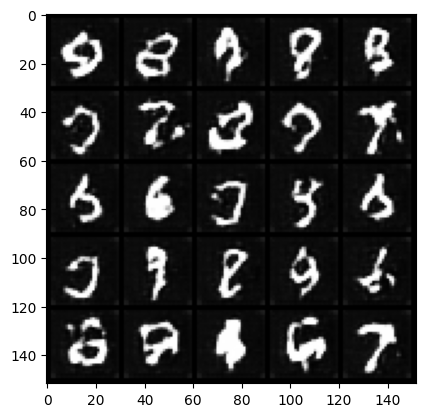

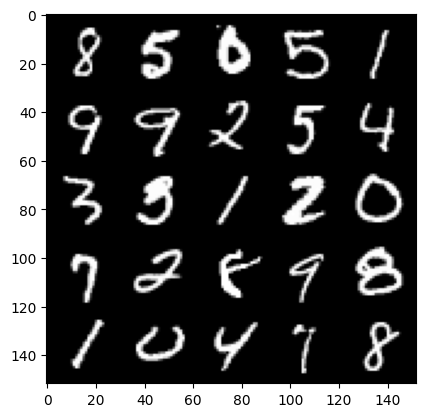

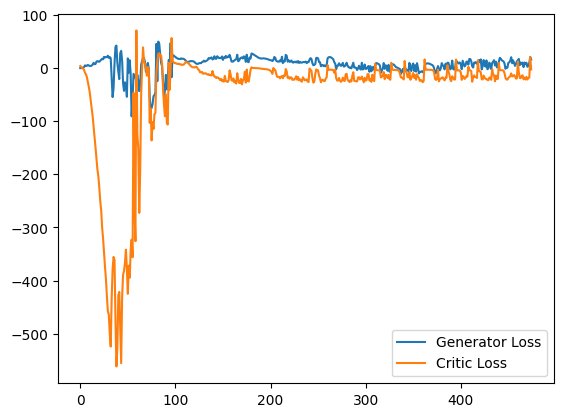

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04409725219011307
real: -11.049047470092773, fake: -14.55575942993164, regularization: 0.4409725069999695
crit_loss: torch.Size([]) -3.065739393234253
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05873419716954231
real: -10.99993896484375, fake: -14.409708023071289, regularization: 0.5873419642448425
crit_loss: torch.Size([]) -2.8224270343780518
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05370594188570976
real: -10.912084579467773, fake: -14.232562065124512, regularization: 0.5370594263076782
crit_loss: torch.Size([]) -2.7834181785583496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.051333170384168625
real: -10.931199073791504, fake: -14.373884201049805, regularization: 0.5133317112922668
crit_loss: torch.Size([]) -2.9293534755706787
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.035433828830718994
real: -10.961065292358398, fake: -14.426088333129883, regularization: 0.3543

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.038826022297143936
real: -11.559282302856445, fake: -15.617902755737305, regularization: 0.38826021552085876
crit_loss: torch.Size([]) -3.6703603267669678
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.029320914298295975
real: -12.562426567077637, fake: -15.442754745483398, regularization: 0.29320913553237915
crit_loss: torch.Size([]) -2.5871191024780273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03278098255395889
real: -12.452960968017578, fake: -15.405376434326172, regularization: 0.32780981063842773
crit_loss: torch.Size([]) -2.624605655670166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04477454349398613
real: -12.291375160217285, fake: -15.489316940307617, regularization: 0.4477454423904419
crit_loss: torch.Size([]) -2.7501964569091797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04625371843576431
real: -12.052318572998047, fake: -15.036842346191406, regularization: 0

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06937389075756073
real: -8.841785430908203, fake: -13.096792221069336, regularization: 0.6937389373779297
crit_loss: torch.Size([]) -3.561267852783203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0682515949010849
real: -8.789155960083008, fake: -13.077916145324707, regularization: 0.6825159788131714
crit_loss: torch.Size([]) -3.6062440872192383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06061932444572449
real: -9.385477066040039, fake: -13.232048988342285, regularization: 0.6061932444572449
crit_loss: torch.Size([]) -3.2403786182403564
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05895008519291878
real: -9.418905258178711, fake: -13.082199096679688, regularization: 0.5895008444786072
crit_loss: torch.Size([]) -3.0737929344177246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04567158222198486
real: -9.437657356262207, fake: -13.426733016967773, regularization: 0.4567158222

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04302026703953743
real: -8.860767364501953, fake: -13.63797378540039, regularization: 0.4302026629447937
crit_loss: torch.Size([]) -4.347003936767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.056340232491493225
real: -8.832382202148438, fake: -13.632818222045898, regularization: 0.5634022951126099
crit_loss: torch.Size([]) -4.237033843994141
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039399318397045135
real: -8.733704566955566, fake: -13.60110092163086, regularization: 0.39399319887161255
crit_loss: torch.Size([]) -4.473402976989746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06660531461238861
real: -8.715438842773438, fake: -13.636344909667969, regularization: 0.6660531759262085
crit_loss: torch.Size([]) -4.254852771759033
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06278277933597565
real: -8.705617904663086, fake: -13.623432159423828, regularization: 0.62782776355

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16610009968280792
real: -5.255109786987305, fake: -12.403472900390625, regularization: 1.6610009670257568
crit_loss: torch.Size([]) -5.487361907958984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11754225939512253
real: -5.169300079345703, fake: -12.486249923706055, regularization: 1.1754225492477417
crit_loss: torch.Size([]) -6.14152717590332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07831724733114243
real: -5.072175979614258, fake: -12.416910171508789, regularization: 0.7831724882125854
crit_loss: torch.Size([]) -6.561561584472656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0698261708021164
real: -6.472805023193359, fake: -12.433387756347656, regularization: 0.6982617378234863
crit_loss: torch.Size([]) -5.2623209953308105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08544149249792099
real: -6.42060661315918, fake: -12.455850601196289, regularization: 0.85441493988037

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15929432213306427
real: 3.409486770629883, fake: -9.097835540771484, regularization: 1.5929431915283203
crit_loss: torch.Size([]) -10.914379119873047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17546388506889343
real: 4.099940776824951, fake: -8.538841247558594, regularization: 1.754638910293579
crit_loss: torch.Size([]) -10.884143829345703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16566845774650574
real: 4.333735466003418, fake: -8.282325744628906, regularization: 1.6566846370697021
crit_loss: torch.Size([]) -10.959376335144043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22889253497123718
real: 3.660027503967285, fake: -8.363722801208496, regularization: 2.2889254093170166
crit_loss: torch.Size([]) -9.734825134277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13658922910690308
real: 4.016855716705322, fake: -8.476852416992188, regularization: 1.3658922910690308
cri

crit_loss: torch.Size([]) -3.8506999015808105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45324933528900146
real: -1.5949705839157104, fake: -8.454587936401367, regularization: 4.532493591308594
crit_loss: torch.Size([]) -2.3271236419677734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3717177212238312
real: -0.8296997547149658, fake: -9.403057098388672, regularization: 3.717177152633667
crit_loss: torch.Size([]) -4.856180191040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35736292600631714
real: 0.4084031581878662, fake: -9.866575241088867, regularization: 3.573629379272461
crit_loss: torch.Size([]) -6.701349258422852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3504536747932434
real: 4.2127909660339355, fake: -9.819028854370117, regularization: 3.5045366287231445
crit_loss: torch.Size([]) -10.527283668518066
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27706313133239746
real: 4.968061447143555, fake: -10.2322807

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.123723104596138
real: 1.6850063800811768, fake: -7.649571418762207, regularization: 1.2372310161590576
crit_loss: torch.Size([]) -8.097346305847168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1321485936641693
real: 1.8370916843414307, fake: -7.478135108947754, regularization: 1.321485996246338
crit_loss: torch.Size([]) -7.993740558624268
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13871066272258759
real: 2.4365739822387695, fake: -7.5068440437316895, regularization: 1.3871066570281982
crit_loss: torch.Size([]) -8.55631160736084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09282050281763077
real: 3.324418067932129, fake: -6.9007568359375, regularization: 0.9282050132751465
crit_loss: torch.Size([]) -9.29697036743164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08823533356189728
real: 4.170936584472656, fake: -6.910605430603027, regularization: 0.8823533058166504
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25087881088256836
real: 1.5139155387878418, fake: -13.596298217773438, regularization: 2.5087881088256836
crit_loss: torch.Size([]) -12.601426124572754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12308695912361145
real: 3.1939444541931152, fake: -13.774330139160156, regularization: 1.2308695316314697
crit_loss: torch.Size([]) -15.737405776977539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2144412100315094
real: 8.37030029296875, fake: -9.580097198486328, regularization: 2.144412040710449
crit_loss: torch.Size([]) -15.805985450744629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12697762250900269
real: 10.999153137207031, fake: -8.8697509765625, regularization: 1.2697762250900269
crit_loss: torch.Size([]) -18.59912872314453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17150837182998657
real: 10.717602729797363, fake: -8.178916931152344, regularization: 1.7150837182998657
c

penalty: torch.Size([]) 0.38486969470977783
real: 24.077091217041016, fake: 0.549267053604126, regularization: 3.8486969470977783
crit_loss: torch.Size([]) -19.679126739501953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25375616550445557
real: 24.0269775390625, fake: 4.159191131591797, regularization: 2.5375616550445557
crit_loss: torch.Size([]) -17.330224990844727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24252869188785553
real: 22.95252227783203, fake: 0.20958638191223145, regularization: 2.4252870082855225
crit_loss: torch.Size([]) -20.31764793395996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25764575600624084
real: 22.149639129638672, fake: -0.4528138339519501, regularization: 2.5764575004577637
crit_loss: torch.Size([]) -20.0259952545166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23313464224338531
real: 22.468734741210938, fake: -3.6469218730926514, regularization: 2.3313465118408203
crit_loss: torch.Size([]) -23.7843

real: 31.251604080200195, fake: 10.193610191345215, regularization: 1.5203299522399902
crit_loss: torch.Size([]) -19.53766441345215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22747012972831726
real: 30.968469619750977, fake: 9.793167114257812, regularization: 2.2747013568878174
crit_loss: torch.Size([]) -18.90060043334961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24704691767692566
real: 22.13142967224121, fake: 5.906339645385742, regularization: 2.4704692363739014
crit_loss: torch.Size([]) -13.754620552062988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18717631697654724
real: 21.030168533325195, fake: -0.3751322329044342, regularization: 1.8717632293701172
crit_loss: torch.Size([]) -19.533536911010742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20096218585968018
real: 18.19293975830078, fake: -1.169516921043396, regularization: 2.0096218585968018
crit_loss: torch.Size([]) -17.352834701538086
gradient_norm: torch.Size([128])

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13783445954322815
real: 7.340331077575684, fake: -9.020849227905273, regularization: 1.3783445358276367
crit_loss: torch.Size([]) -14.982834815979004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11303840577602386
real: 7.779749870300293, fake: -8.869941711425781, regularization: 1.130384087562561
crit_loss: torch.Size([]) -15.519308090209961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16796435415744781
real: -4.985800743103027, fake: -7.1643218994140625, regularization: 1.6796435117721558
crit_loss: torch.Size([]) -0.4988776445388794
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5374913215637207
real: 7.0410566329956055, fake: -6.863069534301758, regularization: 5.374913215637207
crit_loss: torch.Size([]) -8.529212951660156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5545464158058167
real: 14.503751754760742, fake: -8.911394119262695, regularization: 5.545464038848877
cri

real: 28.195327758789062, fake: 12.168327331542969, regularization: 1.545555830001831
crit_loss: torch.Size([]) -14.481444358825684
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.118607297539711
real: 31.896915435791016, fake: 13.814495086669922, regularization: 1.1860729455947876
crit_loss: torch.Size([]) -16.896347045898438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24107883870601654
real: 29.847171783447266, fake: 7.878047466278076, regularization: 2.4107882976531982
crit_loss: torch.Size([]) -19.55833625793457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1860804259777069
real: 27.620967864990234, fake: 7.340513229370117, regularization: 1.8608043193817139
crit_loss: torch.Size([]) -18.41965103149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16695846617221832
real: 31.378055572509766, fake: 5.068206787109375, regularization: 1.6695846319198608
crit_loss: torch.Size([]) -24.6402645111084
gradient_norm: torch.Size([128])
penal

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08420021831989288
real: 33.354190826416016, fake: -3.885606288909912, regularization: 0.8420021533966064
crit_loss: torch.Size([]) -36.39779281616211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09438233822584152
real: 11.277766227722168, fake: -2.4325122833251953, regularization: 0.9438233971595764
crit_loss: torch.Size([]) -12.766454696655273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07367407530546188
real: 17.717636108398438, fake: -1.8242030143737793, regularization: 0.73674076795578
crit_loss: torch.Size([]) -18.805099487304688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10679414123296738
real: 30.231243133544922, fake: 13.83900260925293, regularization: 1.067941427230835
crit_loss: torch.Size([]) -15.324298858642578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22236686944961548
real: 35.645721435546875, fake: 16.565956115722656, regularization: 2.2236685752868652

penalty: torch.Size([]) 0.18716096878051758
real: -1.4893778562545776, fake: -16.51772689819336, regularization: 1.8716096878051758
crit_loss: torch.Size([]) -13.156739234924316
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18956610560417175
real: 1.2340917587280273, fake: -14.562564849853516, regularization: 1.8956611156463623
crit_loss: torch.Size([]) -13.900995254516602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17527557909488678
real: 2.616807460784912, fake: -12.537230491638184, regularization: 1.7527557611465454
crit_loss: torch.Size([]) -13.401281356811523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11010239273309708
real: 1.3822994232177734, fake: -15.282180786132812, regularization: 1.1010239124298096
crit_loss: torch.Size([]) -15.563456535339355
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12083841860294342
real: -0.20599478483200073, fake: -15.93651008605957, regularization: 1.2083841562271118
crit_loss: torch.Size([]

penalty: torch.Size([]) 0.22643372416496277
real: 22.251901626586914, fake: -2.8314049243927, regularization: 2.2643373012542725
crit_loss: torch.Size([]) -22.8189697265625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11489154398441315
real: 19.458452224731445, fake: -6.600818634033203, regularization: 1.148915410041809
crit_loss: torch.Size([]) -24.910354614257812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10962755233049393
real: 3.089108467102051, fake: -5.593757629394531, regularization: 1.0962755680084229
crit_loss: torch.Size([]) -7.586590766906738
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3396996855735779
real: 3.75919771194458, fake: -11.906553268432617, regularization: 3.3969969749450684
crit_loss: torch.Size([]) -12.268753051757812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3447923958301544
real: 9.995386123657227, fake: -13.189144134521484, regularization: 3.4479238986968994
crit_loss: torch.Size([]) -19.736606597

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19936761260032654
real: 37.06825256347656, fake: 9.56021499633789, regularization: 1.9936761856079102
crit_loss: torch.Size([]) -25.514362335205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1914849877357483
real: 30.741317749023438, fake: -4.458471298217773, regularization: 1.914849877357483
crit_loss: torch.Size([]) -33.284942626953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14705806970596313
real: 22.320232391357422, fake: -12.917875289916992, regularization: 1.4705806970596313
crit_loss: torch.Size([]) -33.76752471923828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19377301633358002
real: 37.02107238769531, fake: 2.918421745300293, regularization: 1.9377301931381226
crit_loss: torch.Size([]) -32.164920806884766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15420258045196533
real: 22.98781967163086, fake: -8.386892318725586, regularization: 1.5420258045196533
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2967156171798706
real: 28.450517654418945, fake: -0.2066878080368042, regularization: 2.967156171798706
crit_loss: torch.Size([]) -25.69005012512207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2715342044830322
real: 14.774810791015625, fake: -15.901237487792969, regularization: 2.7153420448303223
crit_loss: torch.Size([]) -27.96070671081543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25380170345306396
real: 30.826894760131836, fake: 5.817124843597412, regularization: 2.5380170345306396
crit_loss: torch.Size([]) -22.471752166748047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16980086266994476
real: 22.826435089111328, fake: -23.530336380004883, regularization: 1.69800865650177
crit_loss: torch.Size([]) -44.65876388549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25781506299972534
real: 21.704578399658203, fake: -20.968441009521484, regularization: 2.578150749206543
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5956825017929077
real: -12.133637428283691, fake: -21.187454223632812, regularization: 5.956825256347656
crit_loss: torch.Size([]) -3.096991539001465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4238688349723816
real: -14.467575073242188, fake: -21.417457580566406, regularization: 4.2386884689331055
crit_loss: torch.Size([]) -2.7111940383911133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.277824342250824
real: -14.246326446533203, fake: -20.851173400878906, regularization: 2.7782435417175293
crit_loss: torch.Size([]) -3.826603412628174
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39748865365982056
real: -14.276078224182129, fake: -20.60232162475586, regularization: 3.974886417388916
crit_loss: torch.Size([]) -2.3513569831848145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36780595779418945
real: -13.829750061035156, fake: -21.551223754882812, regularization: 3.678059577941

real: 11.93147087097168, fake: -9.22619915008545, regularization: 2.659252882003784
crit_loss: torch.Size([]) -18.498416900634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30131813883781433
real: 14.943492889404297, fake: -7.815945625305176, regularization: 3.013181447982788
crit_loss: torch.Size([]) -19.74625587463379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15614476799964905
real: -5.490899085998535, fake: -5.139861583709717, regularization: 1.5614476203918457
crit_loss: torch.Size([]) 1.912485122680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2406838834285736
real: -6.9689130783081055, fake: -10.295419692993164, regularization: 2.406838893890381
crit_loss: torch.Size([]) -0.9196677207946777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3573174476623535
real: -7.197876930236816, fake: -14.386226654052734, regularization: 3.573174476623535
crit_loss: torch.Size([]) -3.615175247192383
gradient_norm: torch.Size([128])
pen

crit_loss: torch.Size([]) -19.282501220703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10645300149917603
real: 15.502945899963379, fake: -8.158758163452148, regularization: 1.0645300149917603
crit_loss: torch.Size([]) -22.59717559814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10096850991249084
real: 14.258118629455566, fake: -7.099316596984863, regularization: 1.0096850395202637
crit_loss: torch.Size([]) -20.347749710083008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21291661262512207
real: 18.185352325439453, fake: -6.158350944519043, regularization: 2.1291661262512207
crit_loss: torch.Size([]) -22.21453857421875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2074834406375885
real: 21.673851013183594, fake: -1.931828260421753, regularization: 2.0748343467712402
crit_loss: torch.Size([]) -21.53084373474121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12419524788856506
real: 21.949520111083984, fake: -2.758660

penalty: torch.Size([]) 0.38422691822052
real: 9.52054214477539, fake: -21.002782821655273, regularization: 3.8422691822052
crit_loss: torch.Size([]) -26.681055068969727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09382303059101105
real: 33.78527069091797, fake: -0.3158310651779175, regularization: 0.9382302761077881
crit_loss: torch.Size([]) -33.162872314453125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15326249599456787
real: 7.547975063323975, fake: -2.861849308013916, regularization: 1.5326249599456787
crit_loss: torch.Size([]) -8.877199172973633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1959114670753479
real: 13.503713607788086, fake: 7.652174949645996, regularization: 1.959114670753479
crit_loss: torch.Size([]) -3.8924241065979004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25579574704170227
real: 24.140186309814453, fake: -4.224385738372803, regularization: 2.557957410812378
crit_loss: torch.Size([]) -25.806615829467

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23966418206691742
real: 12.20051383972168, fake: -9.301209449768066, regularization: 2.396641731262207
crit_loss: torch.Size([]) -19.105083465576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11289064586162567
real: 7.183419704437256, fake: -13.602386474609375, regularization: 1.128906488418579
crit_loss: torch.Size([]) -19.65690040588379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23117756843566895
real: 12.125249862670898, fake: -10.142065048217773, regularization: 2.3117756843566895
crit_loss: torch.Size([]) -19.95553970336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23765945434570312
real: 16.87197494506836, fake: -8.989202499389648, regularization: 2.3765945434570312
crit_loss: torch.Size([]) -23.484582901000977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13115820288658142
real: 14.44288158416748, fake: -11.555207252502441, regularization: 1.311582088470459
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13832101225852966
real: 19.621061325073242, fake: -2.8257999420166016, regularization: 1.3832101821899414
crit_loss: torch.Size([]) -21.06365203857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11434787511825562
real: 23.507911682128906, fake: -3.66640043258667, regularization: 1.1434787511825562
crit_loss: torch.Size([]) -26.030834197998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08840525150299072
real: 29.40703582763672, fake: 3.7972984313964844, regularization: 0.8840525150299072
crit_loss: torch.Size([]) -24.725685119628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24792557954788208
real: 21.367218017578125, fake: 5.466582298278809, regularization: 2.4792556762695312
crit_loss: torch.Size([]) -13.421380043029785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08386270701885223
real: 31.430221557617188, fake: 9.906274795532227, regularization: 0.8386270999908447


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32368141412734985
real: 19.036659240722656, fake: -11.634727478027344, regularization: 3.236814022064209
crit_loss: torch.Size([]) -27.434572219848633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19966109097003937
real: 29.282474517822266, fake: -8.226740837097168, regularization: 1.9966108798980713
crit_loss: torch.Size([]) -35.512603759765625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08802111446857452
real: 31.568649291992188, fake: -7.992308616638184, regularization: 0.8802111148834229
crit_loss: torch.Size([]) -38.680747985839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10309955477714539
real: 29.436960220336914, fake: -5.90955924987793, regularization: 1.0309956073760986
crit_loss: torch.Size([]) -34.31552505493164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09147989004850388
real: 10.94446086883545, fake: -10.660655975341797, regularization: 0.9147989153862
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13002309203147888
real: -8.810711860656738, fake: -21.869991302490234, regularization: 1.3002309799194336
crit_loss: torch.Size([]) -11.759048461914062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2209431678056717
real: -4.2151594161987305, fake: -19.6822509765625, regularization: 2.2094316482543945
crit_loss: torch.Size([]) -13.257659912109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2956101894378662
real: 4.4707183837890625, fake: -16.992923736572266, regularization: 2.956101894378662
crit_loss: torch.Size([]) -18.507539749145508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26185667514801025
real: 20.424564361572266, fake: -10.309701919555664, regularization: 2.6185667514801025
crit_loss: torch.Size([]) -28.115699768066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.186038538813591
real: 28.57882308959961, fake: -0.24051356315612793, regularization: 1.86038541793823

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15851451456546783
real: -13.392523765563965, fake: -16.11168670654297, regularization: 1.585145115852356
crit_loss: torch.Size([]) -1.134017825126648
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13625271618366241
real: -13.649988174438477, fake: -16.354106903076172, regularization: 1.3625271320343018
crit_loss: torch.Size([]) -1.3415915966033936
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1269340068101883
real: -13.897336959838867, fake: -16.464420318603516, regularization: 1.2693400382995605
crit_loss: torch.Size([]) -1.297743320465088
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10738387703895569
real: -14.133522033691406, fake: -17.041234970092773, regularization: 1.073838710784912
crit_loss: torch.Size([]) -1.833874225616455
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10388826578855515
real: -14.335886001586914, fake: -17.19510269165039, regularization: 1.03888261318

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0446757934987545
real: -15.570882797241211, fake: -19.031383514404297, regularization: 0.4467579424381256
crit_loss: torch.Size([]) -3.013742685317993
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04135968163609505
real: -15.624895095825195, fake: -18.978384017944336, regularization: 0.4135968089103699
crit_loss: torch.Size([]) -2.939892053604126
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04062700644135475
real: -16.26068878173828, fake: -19.012149810791016, regularization: 0.4062700569629669
crit_loss: torch.Size([]) -2.34519100189209
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040356557816267014
real: -16.269351959228516, fake: -19.1944580078125, regularization: 0.40356558561325073
crit_loss: torch.Size([]) -2.521540403366089
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03485001623630524
real: -16.256988525390625, fake: -19.130666732788086, regularization: 0.3485001623

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0298481248319149
real: -16.275922775268555, fake: -19.123592376708984, regularization: 0.2984812557697296
crit_loss: torch.Size([]) -2.5491883754730225
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.025305699557065964
real: -16.235530853271484, fake: -19.3215389251709, regularization: 0.25305700302124023
crit_loss: torch.Size([]) -2.832951068878174
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.019219212234020233
real: -16.198463439941406, fake: -19.351276397705078, regularization: 0.19219212234020233
crit_loss: torch.Size([]) -2.960620880126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.033510416746139526
real: -16.171079635620117, fake: -19.1483211517334, regularization: 0.33510416746139526
crit_loss: torch.Size([]) -2.642137289047241
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03678751364350319
real: -16.055999755859375, fake: -19.158641815185547, regularization: 0.36787

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02445289120078087
real: -16.30394744873047, fake: -19.61782455444336, regularization: 0.24452891945838928
crit_loss: torch.Size([]) -3.069348096847534
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02461138926446438
real: -16.56481170654297, fake: -19.299158096313477, regularization: 0.24611389636993408
crit_loss: torch.Size([]) -2.4882326126098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03239590674638748
real: -16.512699127197266, fake: -19.51586151123047, regularization: 0.3239590525627136
crit_loss: torch.Size([]) -2.6792032718658447
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04305276274681091
real: -16.452354431152344, fake: -19.238901138305664, regularization: 0.43052762746810913
crit_loss: torch.Size([]) -2.3560190200805664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03033546730875969
real: -16.3580322265625, fake: -19.420394897460938, regularization: 0.3033546

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02334441803395748
real: -15.836112022399902, fake: -18.669086456298828, regularization: 0.2334441840648651
crit_loss: torch.Size([]) -2.5995302200317383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.047315679490566254
real: -15.748739242553711, fake: -18.720176696777344, regularization: 0.47315680980682373
crit_loss: torch.Size([]) -2.4982805252075195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.033008918166160583
real: -15.606230735778809, fake: -18.643600463867188, regularization: 0.33008918166160583
crit_loss: torch.Size([]) -2.7072806358337402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03244286775588989
real: -15.346330642700195, fake: -18.53170394897461, regularization: 0.3244286775588989
crit_loss: torch.Size([]) -2.8609447479248047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.01915924623608589
real: -15.267975807189941, fake: -18.468942642211914, regularization: 0.

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.022789105772972107
real: -14.546996116638184, fake: -17.49512481689453, regularization: 0.22789105772972107
crit_loss: torch.Size([]) -2.7202377319335938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09732899069786072
real: -14.539684295654297, fake: -17.79802894592285, regularization: 0.9732899069786072
crit_loss: torch.Size([]) -2.2850546836853027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03472134470939636
real: -14.553267478942871, fake: -17.897249221801758, regularization: 0.3472134470939636
crit_loss: torch.Size([]) -2.9967682361602783
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.027984973043203354
real: -14.556316375732422, fake: -17.595996856689453, regularization: 0.27984973788261414
crit_loss: torch.Size([]) -2.7598307132720947
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04733055830001831
real: -14.551006317138672, fake: -17.614501953125, regularization: 0.4733

penalty: torch.Size([]) 0.041095808148384094
real: -14.398041725158691, fake: -17.520971298217773, regularization: 0.41095808148384094
crit_loss: torch.Size([]) -2.7119715213775635
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06920503824949265
real: -14.330007553100586, fake: -17.474151611328125, regularization: 0.6920503973960876
crit_loss: torch.Size([]) -2.4520936012268066
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05458417534828186
real: -14.161865234375, fake: -17.519418716430664, regularization: 0.5458417534828186
crit_loss: torch.Size([]) -2.8117117881774902
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04082482308149338
real: -14.20609188079834, fake: -17.65371322631836, regularization: 0.40824824571609497
crit_loss: torch.Size([]) -3.0393731594085693
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09283381700515747
real: -14.255769729614258, fake: -17.774070739746094, regularization: 0.9283381700515747
crit_loss: torch.Size

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05520749092102051
real: -15.03056526184082, fake: -17.745742797851562, regularization: 0.5520749092102051
crit_loss: torch.Size([]) -2.163102626800537
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.042928680777549744
real: -14.947277069091797, fake: -17.687335968017578, regularization: 0.42928680777549744
crit_loss: torch.Size([]) -2.310772180557251
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.026403972879052162
real: -14.867555618286133, fake: -17.849910736083984, regularization: 0.2640397250652313
crit_loss: torch.Size([]) -2.718315362930298
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02394895814359188
real: -14.597147941589355, fake: -17.57305335998535, regularization: 0.2394895851612091
crit_loss: torch.Size([]) -2.7364158630371094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04125133901834488
real: -14.547125816345215, fake: -17.77899742126465, regularization: 0.412513

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.034800175577402115
real: -14.441396713256836, fake: -17.525615692138672, regularization: 0.34800174832344055
crit_loss: torch.Size([]) -2.7362172603607178
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.029805898666381836
real: -14.324310302734375, fake: -17.49093246459961, regularization: 0.29805898666381836
crit_loss: torch.Size([]) -2.868563175201416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04882790148258209
real: -14.179218292236328, fake: -17.385494232177734, regularization: 0.4882790148258209
crit_loss: torch.Size([]) -2.717996835708618
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06481169164180756
real: -14.204122543334961, fake: -17.476837158203125, regularization: 0.648116946220398
crit_loss: torch.Size([]) -2.6245975494384766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02851676754653454
real: -14.176704406738281, fake: -17.312625885009766, regularization: 0.285

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04325924813747406
real: -13.148836135864258, fake: -16.610984802246094, regularization: 0.4325924813747406
crit_loss: torch.Size([]) -3.0295562744140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05216628313064575
real: -13.122085571289062, fake: -16.826189041137695, regularization: 0.5216628313064575
crit_loss: torch.Size([]) -3.182440757751465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.034799735993146896
real: -13.143823623657227, fake: -16.589738845825195, regularization: 0.34799736738204956
crit_loss: torch.Size([]) -3.0979177951812744
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04351365566253662
real: -13.163080215454102, fake: -16.840927124023438, regularization: 0.4351365566253662
crit_loss: torch.Size([]) -3.2427103519439697
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03284859657287598
real: -13.18110466003418, fake: -16.66391372680664, regularization: 0.3284

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07066714763641357
real: -13.679206848144531, fake: -16.948963165283203, regularization: 0.7066714763641357
crit_loss: torch.Size([]) -2.563084840774536
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.034418750554323196
real: -13.675421714782715, fake: -17.047706604003906, regularization: 0.34418749809265137
crit_loss: torch.Size([]) -3.02809739112854
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.027155522257089615
real: -13.635095596313477, fake: -16.96126937866211, regularization: 0.27155521512031555
crit_loss: torch.Size([]) -3.0546185970306396
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06101403385400772
real: -13.532596588134766, fake: -16.93077850341797, regularization: 0.610140323638916
crit_loss: torch.Size([]) -2.788041591644287
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02884562686085701
real: -13.491622924804688, fake: -16.920625686645508, regularization: 0.288456

crit_loss: torch.Size([]) -1.8486965894699097
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08779037743806839
real: -13.507369995117188, fake: -16.888795852661133, regularization: 0.8779037594795227
crit_loss: torch.Size([]) -2.5035221576690674
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.030634138733148575
real: -13.41299819946289, fake: -16.941070556640625, regularization: 0.30634137988090515
crit_loss: torch.Size([]) -3.221730947494507
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03047952800989151
real: -13.349079132080078, fake: -16.715469360351562, regularization: 0.3047952651977539
crit_loss: torch.Size([]) -3.0615949630737305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02808729186654091
real: -13.286200523376465, fake: -16.94230842590332, regularization: 0.2808729112148285
crit_loss: torch.Size([]) -3.375235080718994
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04873690381646156
real: -13.237566947937012, fake

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05160772055387497
real: -11.952713966369629, fake: -15.620424270629883, regularization: 0.5160772204399109
crit_loss: torch.Size([]) -3.1516330242156982
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04848122224211693
real: -11.927879333496094, fake: -15.78862190246582, regularization: 0.4848122298717499
crit_loss: torch.Size([]) -3.3759303092956543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08730275928974152
real: -12.070146560668945, fake: -15.645101547241211, regularization: 0.8730275630950928
crit_loss: torch.Size([]) -2.701927423477173
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03671194985508919
real: -11.992803573608398, fake: -15.722432136535645, regularization: 0.3671194911003113
crit_loss: torch.Size([]) -3.36250901222229
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04496656730771065
real: -11.89273452758789, fake: -15.461718559265137, regularization: 0.44966566

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08310715109109879
real: -11.916255950927734, fake: -15.634750366210938, regularization: 0.8310714960098267
crit_loss: torch.Size([]) -2.887423038482666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13721591234207153
real: -11.90910530090332, fake: -15.56082820892334, regularization: 1.3721591234207153
crit_loss: torch.Size([]) -2.2795639038085938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.059894002974033356
real: -12.195634841918945, fake: -15.635756492614746, regularization: 0.5989400148391724
crit_loss: torch.Size([]) -2.841181755065918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06374523043632507
real: -12.235363006591797, fake: -15.498435020446777, regularization: 0.6374523043632507
crit_loss: torch.Size([]) -2.625619649887085
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.061776719987392426
real: -12.274113655090332, fake: -15.588300704956055, regularization: 0.617767

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05230974033474922
real: -11.928183555603027, fake: -15.429792404174805, regularization: 0.5230973958969116
crit_loss: torch.Size([]) -2.978511333465576
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039298348128795624
real: -11.942779541015625, fake: -15.501567840576172, regularization: 0.39298349618911743
crit_loss: torch.Size([]) -3.165804862976074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05694108083844185
real: -11.924919128417969, fake: -15.61827278137207, regularization: 0.5694108009338379
crit_loss: torch.Size([]) -3.1239428520202637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06491811573505402
real: -11.920995712280273, fake: -15.53103256225586, regularization: 0.6491811275482178
crit_loss: torch.Size([]) -2.960855722427368
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04675456881523132
real: -11.766735076904297, fake: -15.679760932922363, regularization: 0.467545

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03927288204431534
real: -10.194382667541504, fake: -14.366191864013672, regularization: 0.3927288055419922
crit_loss: torch.Size([]) -3.779080390930176
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.049364738166332245
real: -10.161261558532715, fake: -14.211423873901367, regularization: 0.49364739656448364
crit_loss: torch.Size([]) -3.5565149784088135
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0458744578063488
real: -10.137468338012695, fake: -14.056865692138672, regularization: 0.4587445855140686
crit_loss: torch.Size([]) -3.4606528282165527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039537325501441956
real: -10.152490615844727, fake: -14.187631607055664, regularization: 0.39537325501441956
crit_loss: torch.Size([]) -3.639767646789551
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.047076839953660965
real: -10.13770866394043, fake: -14.309152603149414, regularization: 0.47

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.041074227541685104
real: -9.973090171813965, fake: -14.378353118896484, regularization: 0.41074228286743164
crit_loss: torch.Size([]) -3.994520664215088
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03391868621110916
real: -10.40138053894043, fake: -14.302026748657227, regularization: 0.3391868472099304
crit_loss: torch.Size([]) -3.5614593029022217
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04188228026032448
real: -10.358217239379883, fake: -14.438695907592773, regularization: 0.4188227951526642
crit_loss: torch.Size([]) -3.661655902862549
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.038247957825660706
real: -10.328866958618164, fake: -14.430191040039062, regularization: 0.38247957825660706
crit_loss: torch.Size([]) -3.718844413757324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03815411031246185
real: -10.232524871826172, fake: -14.553411483764648, regularization: 0.3815

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08406578004360199
real: -7.646587371826172, fake: -13.501943588256836, regularization: 0.8406578302383423
crit_loss: torch.Size([]) -5.014698505401611
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07831120491027832
real: -7.433121681213379, fake: -13.218366622924805, regularization: 0.7831120491027832
crit_loss: torch.Size([]) -5.002132892608643
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08871834725141525
real: -7.1876068115234375, fake: -13.345361709594727, regularization: 0.8871834874153137
crit_loss: torch.Size([]) -5.270571231842041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06399931013584137
real: -7.519510269165039, fake: -13.447431564331055, regularization: 0.6399930715560913
crit_loss: torch.Size([]) -5.287928104400635
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06527246534824371
real: -7.372385025024414, fake: -13.035200119018555, regularization: 0.65272462368

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07274052500724792
real: -5.535685062408447, fake: -12.402142524719238, regularization: 0.7274052500724792
crit_loss: torch.Size([]) -6.139052391052246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10253702104091644
real: -5.327787399291992, fake: -12.669733047485352, regularization: 1.0253702402114868
crit_loss: torch.Size([]) -6.316575527191162
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08794115483760834
real: -4.965210914611816, fake: -12.255945205688477, regularization: 0.8794115781784058
crit_loss: torch.Size([]) -6.411322593688965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09607164561748505
real: -4.048170566558838, fake: -11.544767379760742, regularization: 0.9607164859771729
crit_loss: torch.Size([]) -6.535880088806152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08518218994140625
real: -3.8691720962524414, fake: -12.06912612915039, regularization: 0.851821899414

crit_loss: torch.Size([]) -10.47120475769043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29531022906303406
real: 10.466556549072266, fake: -9.744224548339844, regularization: 2.9531023502349854
crit_loss: torch.Size([]) -17.257678985595703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39894580841064453
real: 9.906606674194336, fake: -12.357748031616211, regularization: 3.9894580841064453
crit_loss: torch.Size([]) -18.2748966217041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2651270031929016
real: 10.257997512817383, fake: -12.759354591369629, regularization: 2.6512699127197266
crit_loss: torch.Size([]) -20.3660831451416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4545082151889801
real: -4.759693145751953, fake: -13.545756340026855, regularization: 4.545082092285156
crit_loss: torch.Size([]) -4.240981101989746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40769773721694946
real: -1.4130263328552246, fake: -10.4475870

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4866480231285095
real: 37.419761657714844, fake: 10.263296127319336, regularization: 4.866480350494385
crit_loss: torch.Size([]) -22.28998565673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5049930810928345
real: 12.871129989624023, fake: 2.3657002449035645, regularization: 5.049930572509766
crit_loss: torch.Size([]) -5.455499649047852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3628055155277252
real: 18.224689483642578, fake: 0.3672647774219513, regularization: 3.6280550956726074
crit_loss: torch.Size([]) -14.229368209838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5168470740318298
real: 19.447195053100586, fake: 2.5399186611175537, regularization: 5.168470859527588
crit_loss: torch.Size([]) -11.738805770874023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2062339186668396
real: 20.744232177734375, fake: 1.3892300128936768, regularization: 2.0623393058776855
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31451690196990967
real: 26.67839813232422, fake: -3.3126049041748047, regularization: 3.1451690196990967
crit_loss: torch.Size([]) -26.845834732055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40057462453842163
real: 39.80475997924805, fake: 9.557777404785156, regularization: 4.005746364593506
crit_loss: torch.Size([]) -26.241235733032227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5220227241516113
real: 25.274518966674805, fake: -5.650406837463379, regularization: 5.220227241516113
crit_loss: torch.Size([]) -25.704700469970703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20100539922714233
real: 26.65872573852539, fake: 14.796977043151855, regularization: 2.010054111480713
crit_loss: torch.Size([]) -9.851694107055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2763234078884125
real: 33.45703125, fake: 16.465782165527344, regularization: 2.7632341384887695
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47561031579971313
real: 23.898746490478516, fake: -3.0297200679779053, regularization: 4.756103038787842
crit_loss: torch.Size([]) -22.17236328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2708786725997925
real: 9.314913749694824, fake: -13.988344192504883, regularization: 2.708786725997925
crit_loss: torch.Size([]) -20.594470977783203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25641506910324097
real: 26.66962432861328, fake: -3.688690662384033, regularization: 2.564150810241699
crit_loss: torch.Size([]) -27.79416275024414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16496355831623077
real: 37.74258804321289, fake: 5.793884754180908, regularization: 1.6496355533599854
crit_loss: torch.Size([]) -30.299068450927734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10735417902469635
real: 7.870805740356445, fake: -4.8960371017456055, regularization: 1.0735417604446411
crit_lo

real: 36.84021759033203, fake: 3.6744890213012695, regularization: 1.6158721446990967
crit_loss: torch.Size([]) -31.54985809326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17233651876449585
real: 32.3292236328125, fake: -3.3015716075897217, regularization: 1.7233651876449585
crit_loss: torch.Size([]) -33.90742874145508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15035408735275269
real: 10.953143119812012, fake: -17.690898895263672, regularization: 1.5035408735275269
crit_loss: torch.Size([]) -27.1405029296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3059164881706238
real: 29.292884826660156, fake: -11.585500717163086, regularization: 3.0591650009155273
crit_loss: torch.Size([]) -37.81922149658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46737682819366455
real: 39.95205307006836, fake: 5.675694465637207, regularization: 4.673768043518066
crit_loss: torch.Size([]) -29.60259246826172
gradient_norm: torch.Size([128])
pena

real: -15.72146224975586, fake: -20.444557189941406, regularization: 0.24437397718429565
crit_loss: torch.Size([]) -4.4787211418151855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03748992085456848
real: -15.52837085723877, fake: -20.407238006591797, regularization: 0.3748992085456848
crit_loss: torch.Size([]) -4.503967761993408
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.021011505275964737
real: -15.346779823303223, fake: -20.082073211669922, regularization: 0.21011504530906677
crit_loss: torch.Size([]) -4.5251784324646
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.024709191173315048
real: -15.577507019042969, fake: -19.909332275390625, regularization: 0.24709191918373108
crit_loss: torch.Size([]) -4.084733486175537
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.020398546010255814
real: -15.630687713623047, fake: -20.22537612915039, regularization: 0.20398545265197754
crit_loss: torch.Size([]) -4.390703201293945
gradient_norm: torc

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05310911685228348
real: -14.41666030883789, fake: -21.505918502807617, regularization: 0.5310911536216736
crit_loss: torch.Size([]) -6.558166980743408
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08513332903385162
real: -13.837945938110352, fake: -20.880260467529297, regularization: 0.8513332605361938
crit_loss: torch.Size([]) -6.190981388092041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.050113264471292496
real: -13.088497161865234, fake: -20.53983497619629, regularization: 0.5011326670646667
crit_loss: torch.Size([]) -6.950205326080322
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06518189609050751
real: -12.319598197937012, fake: -20.18338394165039, regularization: 0.6518189907073975
crit_loss: torch.Size([]) -7.211966514587402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05020958185195923
real: -13.854456901550293, fake: -19.677352905273438, regularization: 0.502095818

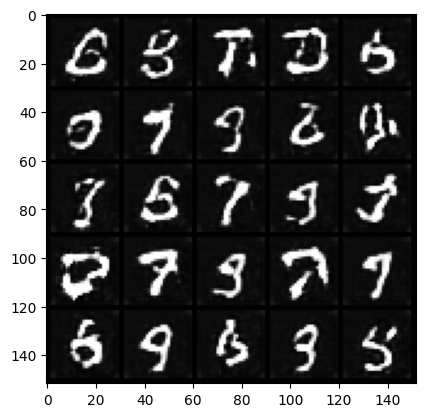

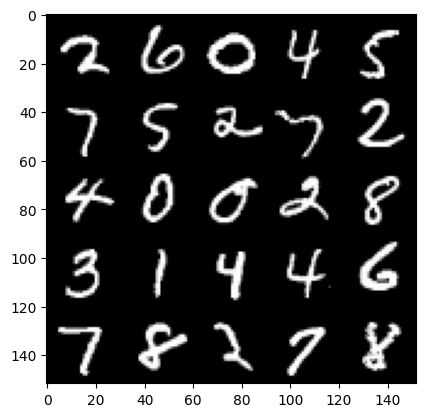

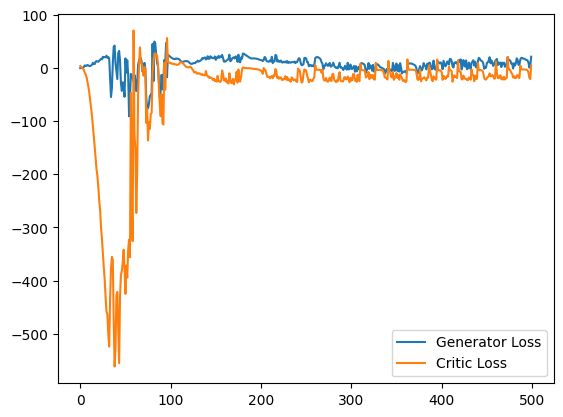

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.049821969121694565
real: -16.356334686279297, fake: -23.216814041137695, regularization: 0.49821969866752625
crit_loss: torch.Size([]) -6.362259864807129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05736792832612991
real: -16.43593406677246, fake: -23.499670028686523, regularization: 0.5736792683601379
crit_loss: torch.Size([]) -6.49005651473999
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06823448836803436
real: -16.469356536865234, fake: -23.380794525146484, regularization: 0.682344913482666
crit_loss: torch.Size([]) -6.229093074798584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06281930953264236
real: -16.444263458251953, fake: -23.71424102783203, regularization: 0.6281930804252625
crit_loss: torch.Size([]) -6.64178466796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05971326306462288
real: -16.303123474121094, fake: -23.741024017333984, regularization: 0.5971326231

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07207726687192917
real: -16.40283203125, fake: -22.967552185058594, regularization: 0.7207726836204529
crit_loss: torch.Size([]) -5.843947410583496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0636848509311676
real: -16.245676040649414, fake: -22.53156280517578, regularization: 0.636848509311676
crit_loss: torch.Size([]) -5.649038314819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03357852250337601
real: -15.234342575073242, fake: -22.368635177612305, regularization: 0.3357852101325989
crit_loss: torch.Size([]) -6.798507213592529
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02909736894071102
real: -15.480916976928711, fake: -22.871578216552734, regularization: 0.2909736931324005
crit_loss: torch.Size([]) -7.099687576293945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06366218626499176
real: -15.905920028686523, fake: -23.538923263549805, regularization: 0.63662183284759

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19952578842639923
real: 28.881793975830078, fake: 4.143653869628906, regularization: 1.99525785446167
crit_loss: torch.Size([]) -22.742881774902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14504212141036987
real: 25.43885612487793, fake: 3.7344021797180176, regularization: 1.4504212141036987
crit_loss: torch.Size([]) -20.2540340423584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11984385550022125
real: 28.534835815429688, fake: 3.975492000579834, regularization: 1.1984385251998901
crit_loss: torch.Size([]) -23.360904693603516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18210424482822418
real: 30.72807502746582, fake: 3.5678606033325195, regularization: 1.8210424184799194
crit_loss: torch.Size([]) -25.339170455932617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18247908353805542
real: 30.109752655029297, fake: 2.554076671600342, regularization: 1.8247908353805542
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14897382259368896
real: -11.640819549560547, fake: -20.588211059570312, regularization: 1.4897382259368896
crit_loss: torch.Size([]) -7.457653045654297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16082315146923065
real: -7.786703109741211, fake: -20.875511169433594, regularization: 1.608231544494629
crit_loss: torch.Size([]) -11.480576515197754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12988966703414917
real: -6.125789642333984, fake: -20.110414505004883, regularization: 1.2988966703414917
crit_loss: torch.Size([]) -12.685728073120117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19796006381511688
real: -2.773854970932007, fake: -16.701635360717773, regularization: 1.9796006679534912
crit_loss: torch.Size([]) -11.948179244995117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12393523007631302
real: 2.2049953937530518, fake: -14.871784210205078, regularization: 1.239352345

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24936543405056
real: 24.452373504638672, fake: 6.2589006423950195, regularization: 2.493654251098633
crit_loss: torch.Size([]) -15.699819564819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18723903596401215
real: 17.546764373779297, fake: -1.907712697982788, regularization: 1.8723903894424438
crit_loss: torch.Size([]) -17.58208656311035
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10485177487134933
real: 15.948633193969727, fake: -4.9957780838012695, regularization: 1.0485177040100098
crit_loss: torch.Size([]) -19.89589500427246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1344195306301117
real: 30.705833435058594, fake: 2.042909860610962, regularization: 1.3441953659057617
crit_loss: torch.Size([]) -27.318729400634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19303832948207855
real: 30.37643051147461, fake: 6.41160774230957, regularization: 1.930383324623108
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1450382024049759
real: 21.786846160888672, fake: 4.790821075439453, regularization: 1.4503819942474365
crit_loss: torch.Size([]) -15.545642852783203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12659408152103424
real: 25.625839233398438, fake: 4.872490882873535, regularization: 1.26594078540802
crit_loss: torch.Size([]) -19.487407684326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1559329479932785
real: 28.03517723083496, fake: 7.518628120422363, regularization: 1.5593295097351074
crit_loss: torch.Size([]) -18.957218170166016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21023161709308624
real: 28.170818328857422, fake: 6.241096019744873, regularization: 2.10231614112854
crit_loss: torch.Size([]) -19.82740592956543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28708308935165405
real: 28.152835845947266, fake: 8.373923301696777, regularization: 2.87083101272583
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2332005500793457
real: 19.160608291625977, fake: -10.201885223388672, regularization: 2.332005500793457
crit_loss: torch.Size([]) -27.030487060546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1864687204360962
real: 33.08365249633789, fake: 8.179887771606445, regularization: 1.864687204360962
crit_loss: torch.Size([]) -23.039077758789062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09644992649555206
real: 25.891904830932617, fake: -5.116352558135986, regularization: 0.9644992351531982
crit_loss: torch.Size([]) -30.043758392333984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26712971925735474
real: 16.167438507080078, fake: -10.587860107421875, regularization: 2.671297073364258
crit_loss: torch.Size([]) -24.084001541137695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11380872130393982
real: 26.93722915649414, fake: -4.0929155349731445, regularization: 1.138087272644043
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1382070779800415
real: 17.114185333251953, fake: 6.512259483337402, regularization: 1.382070779800415
crit_loss: torch.Size([]) -9.219855308532715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17897948622703552
real: 26.70794105529785, fake: 1.7449909448623657, regularization: 1.789794921875
crit_loss: torch.Size([]) -23.173154830932617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14264032244682312
real: 11.559457778930664, fake: -13.997642517089844, regularization: 1.426403284072876
crit_loss: torch.Size([]) -24.13069725036621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1087004691362381
real: 21.87583351135254, fake: -3.504894971847534, regularization: 1.0870046615600586
crit_loss: torch.Size([]) -24.293724060058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24519601464271545
real: 29.24665069580078, fake: 3.530543804168701, regularization: 2.4519600868225098
crit_loss:

real: 16.07540512084961, fake: -9.850473403930664, regularization: 0.8352656364440918
crit_loss: torch.Size([]) -25.090612411499023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1153455376625061
real: 27.691787719726562, fake: 2.3453502655029297, regularization: 1.153455376625061
crit_loss: torch.Size([]) -24.192981719970703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1215040385723114
real: 18.128917694091797, fake: -6.03499698638916, regularization: 1.2150404453277588
crit_loss: torch.Size([]) -22.94887351989746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2212194800376892
real: 13.119414329528809, fake: -8.545923233032227, regularization: 2.2121949195861816
crit_loss: torch.Size([]) -19.453142166137695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10011894255876541
real: 19.550336837768555, fake: -7.342459201812744, regularization: 1.0011894702911377
crit_loss: torch.Size([]) -25.891605377197266
gradient_norm: torch.Size([128])
p

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1693013310432434
real: 30.769113540649414, fake: 13.242927551269531, regularization: 1.693013310432434
crit_loss: torch.Size([]) -15.833172798156738
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.262001633644104
real: 21.94815444946289, fake: -0.7769471406936646, regularization: 2.62001633644104
crit_loss: torch.Size([]) -20.105085372924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13828662037849426
real: 18.47974395751953, fake: 1.2657564878463745, regularization: 1.3828661441802979
crit_loss: torch.Size([]) -15.831121444702148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1353483498096466
real: 26.33208465576172, fake: 1.4175896644592285, regularization: 1.3534834384918213
crit_loss: torch.Size([]) -23.561012268066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1629762053489685
real: 21.968473434448242, fake: -7.099768161773682, regularization: 1.629762053489685
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24542135000228882
real: -9.943260192871094, fake: -9.263263702392578, regularization: 2.4542136192321777
crit_loss: torch.Size([]) 3.1342101097106934
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17207789421081543
real: -3.6584062576293945, fake: -3.7273404598236084, regularization: 1.7207789421081543
crit_loss: torch.Size([]) 1.6518447399139404
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28782919049263
real: 3.8815560340881348, fake: 12.057910919189453, regularization: 2.8782918453216553
crit_loss: torch.Size([]) 11.054647445678711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2300705462694168
real: 19.389755249023438, fake: 4.230172157287598, regularization: 2.3007054328918457
crit_loss: torch.Size([]) -12.858877182006836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18258064985275269
real: 11.232443809509277, fake: -13.530340194702148, regularization: 1.8258064985275269
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6190741062164307
real: 0.36503130197525024, fake: -15.673542976379395, regularization: 6.190741062164307
crit_loss: torch.Size([]) -9.847833633422852
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8888778686523438
real: -4.472589492797852, fake: -18.05501365661621, regularization: 8.888778686523438
crit_loss: torch.Size([]) -4.693645477294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0694659948348999
real: 8.663704872131348, fake: -17.413286209106445, regularization: 0.694659948348999
crit_loss: torch.Size([]) -25.38233184814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4558832049369812
real: 17.473791122436523, fake: -15.056196212768555, regularization: 4.558832168579102
crit_loss: torch.Size([]) -27.971155166625977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16697685420513153
real: 20.783199310302734, fake: -15.78249454498291, regularization: 1.6697685718536377
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7132226228713989
real: -22.557178497314453, fake: -31.644577026367188, regularization: 7.13222599029541
crit_loss: torch.Size([]) -1.9551725387573242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5422350168228149
real: -22.365264892578125, fake: -30.211448669433594, regularization: 5.42234992980957
crit_loss: torch.Size([]) -2.4238338470458984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31185561418533325
real: -22.160015106201172, fake: -30.805397033691406, regularization: 3.118556022644043
crit_loss: torch.Size([]) -5.526825904846191
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37505146861076355
real: -22.166353225708008, fake: -31.27946662902832, regularization: 3.7505147457122803
crit_loss: torch.Size([]) -5.362598419189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.5022505521774292
real: -18.61873435974121, fake: -30.576969146728516, regularization: 15.02250576019287

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36497193574905396
real: -9.306702613830566, fake: -20.224559783935547, regularization: 3.64971923828125
crit_loss: torch.Size([]) -7.2681379318237305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4726249873638153
real: -5.917085647583008, fake: -18.217281341552734, regularization: 4.726249694824219
crit_loss: torch.Size([]) -7.573945999145508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3572075366973877
real: -5.712470054626465, fake: -19.084728240966797, regularization: 3.572075366973877
crit_loss: torch.Size([]) -9.800182342529297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37900084257125854
real: -5.05031681060791, fake: -19.26877212524414, regularization: 3.790008544921875
crit_loss: torch.Size([]) -10.428446769714355
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6441230773925781
real: -4.478531837463379, fake: -20.103614807128906, regularization: 6.441230773925781
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18203052878379822
real: 14.944341659545898, fake: -9.818902969360352, regularization: 1.820305347442627
crit_loss: torch.Size([]) -22.94293975830078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10036486387252808
real: 19.168323516845703, fake: -7.426337242126465, regularization: 1.0036486387252808
crit_loss: torch.Size([]) -25.591012954711914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19679182767868042
real: 26.967681884765625, fake: -1.8256511688232422, regularization: 1.9679182767868042
crit_loss: torch.Size([]) -26.825414657592773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13820794224739075
real: 20.16512107849121, fake: -0.5124629735946655, regularization: 1.3820793628692627
crit_loss: torch.Size([]) -19.295503616333008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1586373746395111
real: 21.692134857177734, fake: -1.4749815464019775, regularization: 1.58637380599975

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12699170410633087
real: 23.8593692779541, fake: -5.952560901641846, regularization: 1.2699170112609863
crit_loss: torch.Size([]) -28.54201316833496
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12449736893177032
real: 17.77972412109375, fake: -9.147377967834473, regularization: 1.2449736595153809
crit_loss: torch.Size([]) -25.682126998901367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37433022260665894
real: 14.352210998535156, fake: -23.36290168762207, regularization: 3.743302345275879
crit_loss: torch.Size([]) -33.97180938720703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1417175978422165
real: 23.988149642944336, fake: -14.354475975036621, regularization: 1.4171760082244873
crit_loss: torch.Size([]) -36.92544937133789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10898901522159576
real: 26.98208999633789, fake: -6.220248699188232, regularization: 1.0898901224136353
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1730181872844696
real: 39.2100715637207, fake: 11.088573455810547, regularization: 1.7301819324493408
crit_loss: torch.Size([]) -26.391315460205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14255107939243317
real: 38.794227600097656, fake: 11.261590957641602, regularization: 1.4255107641220093
crit_loss: torch.Size([]) -26.107126235961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09348048269748688
real: 37.36870574951172, fake: 14.750471115112305, regularization: 0.9348047971725464
crit_loss: torch.Size([]) -21.683429718017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12067997455596924
real: 34.361717224121094, fake: 11.247318267822266, regularization: 1.2067997455596924
crit_loss: torch.Size([]) -21.9075984954834
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15748371183872223
real: 33.409034729003906, fake: 7.172031402587891, regularization: 1.5748370885849
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09080620110034943
real: -6.280581474304199, fake: -14.899077415466309, regularization: 0.9080619812011719
crit_loss: torch.Size([]) -7.7104339599609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07550743222236633
real: -6.601138114929199, fake: -15.016777038574219, regularization: 0.7550743222236633
crit_loss: torch.Size([]) -7.660564422607422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1023033931851387
real: -5.981430530548096, fake: -12.121135711669922, regularization: 1.0230339765548706
crit_loss: torch.Size([]) -5.116671085357666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08529746532440186
real: -6.1292877197265625, fake: -15.200570106506348, regularization: 0.8529746532440186
crit_loss: torch.Size([]) -8.218307495117188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08274117112159729
real: 19.697288513183594, fake: -9.607433319091797, regularization: 0.827411711215

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1605941653251648
real: 31.702579498291016, fake: 5.142274379730225, regularization: 1.605941653251648
crit_loss: torch.Size([]) -24.954362869262695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1148996502161026
real: 13.559249877929688, fake: 8.995378494262695, regularization: 1.1489964723587036
crit_loss: torch.Size([]) -3.414875030517578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22074124217033386
real: 24.495826721191406, fake: 0.72894686460495, regularization: 2.2074124813079834
crit_loss: torch.Size([]) -21.559467315673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4208372235298157
real: 8.633408546447754, fake: -22.235443115234375, regularization: 4.208372116088867
crit_loss: torch.Size([]) -26.660478591918945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1400110274553299
real: 3.3228096961975098, fake: -29.10631561279297, regularization: 1.4001102447509766
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14601287245750427
real: 32.92254638671875, fake: 0.5481146574020386, regularization: 1.4601287841796875
crit_loss: torch.Size([]) -30.914302825927734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11784949898719788
real: 26.511802673339844, fake: -4.836302757263184, regularization: 1.178494930267334
crit_loss: torch.Size([]) -30.16961097717285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13498084247112274
real: 28.259044647216797, fake: -5.554909706115723, regularization: 1.3498084545135498
crit_loss: torch.Size([]) -32.46414566040039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.179075226187706
real: 6.151507377624512, fake: 12.611322402954102, regularization: 1.7907522916793823
crit_loss: torch.Size([]) 8.250567436218262
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19907146692276
real: 19.18798828125, fake: 16.93305778503418, regularization: 1.9907146692276
crit_loss: torch

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10142888128757477
real: 9.255902290344238, fake: 11.147137641906738, regularization: 1.0142887830734253
crit_loss: torch.Size([]) 2.905524253845215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20171134173870087
real: 22.614091873168945, fake: -5.22158670425415, regularization: 2.017113447189331
crit_loss: torch.Size([]) -25.818565368652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2173493504524231
real: 8.422322273254395, fake: -18.563289642333984, regularization: 2.1734933853149414
crit_loss: torch.Size([]) -24.812118530273438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2995871901512146
real: 12.998730659484863, fake: -16.924938201904297, regularization: 2.9958720207214355
crit_loss: torch.Size([]) -26.92779541015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1775805503129959
real: 27.10208511352539, fake: -9.14280891418457, regularization: 1.7758054733276367
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06933480501174927
real: 26.096567153930664, fake: 1.1167101860046387, regularization: 0.6933480501174927
crit_loss: torch.Size([]) -24.286508560180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21436956524848938
real: 23.94314956665039, fake: -2.5918285846710205, regularization: 2.143695592880249
crit_loss: torch.Size([]) -24.39128303527832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13995590806007385
real: 14.785412788391113, fake: -2.6389853954315186, regularization: 1.3995590209960938
crit_loss: torch.Size([]) -16.024839401245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19343169033527374
real: 25.662357330322266, fake: -10.512614250183105, regularization: 1.934316873550415
crit_loss: torch.Size([]) -34.24065399169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3745361566543579
real: 13.999404907226562, fake: -18.041725158691406, regularization: 3.745361566543579

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35115373134613037
real: -20.363391876220703, fake: -30.452709197998047, regularization: 3.5115373134613037
crit_loss: torch.Size([]) -6.577779769897461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43018147349357605
real: -19.76195526123047, fake: -29.984535217285156, regularization: 4.301814556121826
crit_loss: torch.Size([]) -5.920765399932861
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8792287707328796
real: -19.05322265625, fake: -29.14778709411621, regularization: 8.792287826538086
crit_loss: torch.Size([]) -1.302276611328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5326496362686157
real: -18.71783447265625, fake: -29.321958541870117, regularization: 5.326496124267578
crit_loss: torch.Size([]) -5.277627944946289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4099084734916687
real: -23.24432373046875, fake: -27.425857543945312, regularization: 4.099084854125977
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2339228242635727
real: 8.026057243347168, fake: -13.379839897155762, regularization: 2.3392281532287598
crit_loss: torch.Size([]) -19.066669464111328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17870046198368073
real: 6.729295253753662, fake: -6.652152061462402, regularization: 1.7870045900344849
crit_loss: torch.Size([]) -11.594442367553711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19478367269039154
real: 6.117128372192383, fake: -9.750051498413086, regularization: 1.9478367567062378
crit_loss: torch.Size([]) -13.919342994689941
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20016223192214966
real: 7.211012840270996, fake: -10.572871208190918, regularization: 2.001622200012207
crit_loss: torch.Size([]) -15.782261848449707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32654479146003723
real: 7.893523216247559, fake: -8.870453834533691, regularization: 3.2654478549957275
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2979963421821594
real: -28.61957550048828, fake: -35.85200500488281, regularization: 2.9799633026123047
crit_loss: torch.Size([]) -4.252466201782227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18856480717658997
real: -28.973310470581055, fake: -36.28520965576172, regularization: 1.8856480121612549
crit_loss: torch.Size([]) -5.426251411437988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.279258131980896
real: -28.743980407714844, fake: -36.379638671875, regularization: 2.79258131980896
crit_loss: torch.Size([]) -4.843076705932617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21311861276626587
real: -23.307334899902344, fake: -34.13325119018555, regularization: 2.131186008453369
crit_loss: torch.Size([]) -8.694730758666992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36153048276901245
real: -24.36619758605957, fake: -35.33856201171875, regularization: 3.615304946899414
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11840851604938507
real: -0.024354971945285797, fake: -2.0550899505615234, regularization: 1.1840851306915283
crit_loss: torch.Size([]) -0.8466498851776123
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13486647605895996
real: 0.22893989086151123, fake: -4.095558166503906, regularization: 1.3486647605895996
crit_loss: torch.Size([]) -2.9758334159851074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09553023427724838
real: 3.607362747192383, fake: -2.481165885925293, regularization: 0.955302357673645
crit_loss: torch.Size([]) -5.13322639465332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07434913516044617
real: 10.00722599029541, fake: 4.91909122467041, regularization: 0.7434913516044617
crit_loss: torch.Size([]) -4.344643592834473
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12645500898361206
real: 21.342514038085938, fake: 12.785196304321289, regularization: 1.2645500898361206

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08932803571224213
real: 24.94669532775879, fake: 1.139896035194397, regularization: 0.8932803869247437
crit_loss: torch.Size([]) -22.91351890563965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1314600706100464
real: 25.131685256958008, fake: 2.83209228515625, regularization: 1.3146007061004639
crit_loss: torch.Size([]) -20.98499298095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11568227410316467
real: 35.982147216796875, fake: 10.544672012329102, regularization: 1.156822681427002
crit_loss: torch.Size([]) -24.28065299987793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11016841232776642
real: 36.02739715576172, fake: 7.188861846923828, regularization: 1.1016840934753418
crit_loss: torch.Size([]) -27.73685073852539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1922120749950409
real: 33.731964111328125, fake: 3.5720221996307373, regularization: 1.9221208095550537
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.142551451921463
real: 1.3522908687591553, fake: -5.590376853942871, regularization: 1.4255144596099854
crit_loss: torch.Size([]) -5.517153739929199
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1621309518814087
real: 4.090332984924316, fake: -2.4692068099975586, regularization: 1.621309518814087
crit_loss: torch.Size([]) -4.938230514526367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08042483031749725
real: 8.054227828979492, fake: -2.761535167694092, regularization: 0.8042483329772949
crit_loss: torch.Size([]) -10.011514663696289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15031060576438904
real: 15.01324462890625, fake: 2.6575965881347656, regularization: 1.5031061172485352
crit_loss: torch.Size([]) -10.85254192352295
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14830899238586426
real: 23.243053436279297, fake: 11.048199653625488, regularization: 1.4830899238586426
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15800482034683228
real: 12.06806755065918, fake: -14.545866012573242, regularization: 1.5800482034683228
crit_loss: torch.Size([]) -25.033885955810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10812066495418549
real: -9.675752639770508, fake: -18.331928253173828, regularization: 1.0812066793441772
crit_loss: torch.Size([]) -7.5749688148498535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11681952327489853
real: -12.831659317016602, fake: -24.354190826416016, regularization: 1.1681952476501465
crit_loss: torch.Size([]) -10.35433578491211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21167753636837006
real: -13.674720764160156, fake: -26.941692352294922, regularization: 2.1167752742767334
crit_loss: torch.Size([]) -11.150196075439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10534181445837021
real: -11.725503921508789, fake: -24.53894805908203, regularization: 1.05341815

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16926847398281097
real: 13.05046272277832, fake: -19.154340744018555, regularization: 1.6926847696304321
crit_loss: torch.Size([]) -30.51211929321289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29218366742134094
real: 23.520828247070312, fake: -12.341390609741211, regularization: 2.9218366146087646
crit_loss: torch.Size([]) -32.94038391113281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18438047170639038
real: 22.297115325927734, fake: -4.097133636474609, regularization: 1.8438047170639038
crit_loss: torch.Size([]) -24.550443649291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3080344796180725
real: -2.4476537704467773, fake: -17.761991500854492, regularization: 3.0803446769714355
crit_loss: torch.Size([]) -12.233993530273438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20302870869636536
real: 6.995587348937988, fake: -8.947529792785645, regularization: 2.03028702735900

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26312804222106934
real: -13.279213905334473, fake: -25.393795013427734, regularization: 2.6312804222106934
crit_loss: torch.Size([]) -9.483301162719727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19525137543678284
real: -6.416821479797363, fake: -20.01880645751953, regularization: 1.9525136947631836
crit_loss: torch.Size([]) -11.649471282958984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17072631418704987
real: 1.2269847393035889, fake: -16.74493980407715, regularization: 1.7072631120681763
crit_loss: torch.Size([]) -16.264659881591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21620309352874756
real: 10.658964157104492, fake: -12.768796920776367, regularization: 2.1620309352874756
crit_loss: torch.Size([]) -21.265729904174805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17727692425251007
real: 22.296138763427734, fake: -3.381234645843506, regularization: 1.77276921272

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1779618114233017
real: 23.648223876953125, fake: 1.1351335048675537, regularization: 1.7796181440353394
crit_loss: torch.Size([]) -20.73347282409668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1761733889579773
real: 21.155658721923828, fake: -3.875363826751709, regularization: 1.761733889579773
crit_loss: torch.Size([]) -23.269289016723633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09235815703868866
real: 18.750356674194336, fake: 7.011713981628418, regularization: 0.923581600189209
crit_loss: torch.Size([]) -10.815061569213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17295557260513306
real: 28.759788513183594, fake: 7.147349834442139, regularization: 1.7295557260513306
crit_loss: torch.Size([]) -19.882883071899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20609435439109802
real: 23.04306983947754, fake: -3.6510989665985107, regularization: 2.060943603515625
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09306849539279938
real: 25.488759994506836, fake: 1.3181226253509521, regularization: 0.9306849241256714
crit_loss: torch.Size([]) -23.239952087402344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15214800834655762
real: 23.17979621887207, fake: -3.775653839111328, regularization: 1.5214800834655762
crit_loss: torch.Size([]) -25.433969497680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2830051779747009
real: 23.704124450683594, fake: -1.1039526462554932, regularization: 2.830051898956299
crit_loss: torch.Size([]) -21.978025436401367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16085003316402435
real: 26.174997329711914, fake: 1.161989688873291, regularization: 1.608500361442566
crit_loss: torch.Size([]) -23.404508590698242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2993822991847992
real: 15.503421783447266, fake: -4.987363338470459, regularization: 2.9938230514526367
c

gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.31638938188552856
real: 8.083162307739258, fake: -18.218923568725586, regularization: 3.163893699645996
crit_loss: torch.Size([]) -23.13819122314453
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.14663317799568176
real: 11.191097259521484, fake: -14.899068832397461, regularization: 1.4663317203521729
crit_loss: torch.Size([]) -24.62383460998535


  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15914759039878845
real: 3.097492218017578, fake: -10.354606628417969, regularization: 1.5914759635925293
crit_loss: torch.Size([]) -11.86062240600586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22813037037849426
real: 16.128692626953125, fake: 3.338778257369995, regularization: 2.281303644180298
crit_loss: torch.Size([]) -10.508610725402832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07342791557312012
real: 23.751426696777344, fake: 5.027463912963867, regularization: 0.7342791557312012
crit_loss: torch.Size([]) -17.989683151245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20575585961341858
real: 31.286453247070312, fake: 13.363458633422852, regularization: 2.057558536529541
crit_loss: torch.Size([]) -15.865436553955078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14003923535346985
real: 34.11479949951172, fake: 13.258939743041992, regularization: 1.4003922939300537
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.342593789100647
real: 8.161681175231934, fake: -26.727609634399414, regularization: 3.4259378910064697
crit_loss: torch.Size([]) -31.46335220336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07784849405288696
real: 20.228900909423828, fake: -11.821538925170898, regularization: 0.7784849405288696
crit_loss: torch.Size([]) -31.271953582763672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1477738469839096
real: 26.937715530395508, fake: -5.101634502410889, regularization: 1.4777384996414185
crit_loss: torch.Size([]) -30.561609268188477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13601605594158173
real: -12.765787124633789, fake: 8.173477172851562, regularization: 1.3601605892181396
crit_loss: torch.Size([]) 22.29942512512207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08879339694976807
real: -1.6509733200073242, fake: 8.122444152832031, regularization: 0.8879339694976807
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2548123598098755
real: -29.38926124572754, fake: -36.20822525024414, regularization: 2.548123598098755
crit_loss: torch.Size([]) -4.270840644836426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22649092972278595
real: -29.352710723876953, fake: -36.663787841796875, regularization: 2.264909267425537
crit_loss: torch.Size([]) -5.046167850494385
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24266867339611053
real: -29.01796531677246, fake: -36.81656265258789, regularization: 2.4266867637634277
crit_loss: torch.Size([]) -5.371910572052002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2309851348400116
real: -28.783079147338867, fake: -37.031951904296875, regularization: 2.3098514080047607
crit_loss: torch.Size([]) -5.939021110534668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6947194337844849
real: -28.65675926208496, fake: -35.708106994628906, regularization: 6.9471940994262695


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9222568273544312
real: 32.59165954589844, fake: -4.76738977432251, regularization: 9.22256851196289
crit_loss: torch.Size([]) -28.13648223876953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4576351046562195
real: 16.45870590209961, fake: -17.977859497070312, regularization: 4.576351165771484
crit_loss: torch.Size([]) -29.860214233398438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12923210859298706
real: 16.980571746826172, fake: -9.038122177124023, regularization: 1.2923210859298706
crit_loss: torch.Size([]) -24.72637367248535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29412364959716797
real: 33.87651062011719, fake: 7.628116607666016, regularization: 2.9412364959716797
crit_loss: torch.Size([]) -23.307157516479492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07091836631298065
real: 29.3062801361084, fake: -1.1334209442138672, regularization: 0.7091836929321289
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1601470410823822
real: -9.99227237701416, fake: -21.61026382446289, regularization: 1.6014704704284668
crit_loss: torch.Size([]) -10.016521453857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15459150075912476
real: -9.543676376342773, fake: -23.333553314208984, regularization: 1.5459150075912476
crit_loss: torch.Size([]) -12.243962287902832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09581117331981659
real: -9.478328704833984, fake: -25.346052169799805, regularization: 0.9581117630004883
crit_loss: torch.Size([]) -14.909611701965332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3291964530944824
real: -10.384300231933594, fake: -31.095062255859375, regularization: 3.291964530944824
crit_loss: torch.Size([]) -17.41879653930664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8151829242706299
real: -24.892070770263672, fake: -30.13599395751953, regularization: 8.15182876586914

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17813080549240112
real: 3.711986541748047, fake: -14.376628875732422, regularization: 1.7813080549240112
crit_loss: torch.Size([]) -16.307308197021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2344294786453247
real: 7.875655174255371, fake: -14.67266845703125, regularization: 2.344294786453247
crit_loss: torch.Size([]) -20.204029083251953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33640894293785095
real: 11.969978332519531, fake: -13.363659858703613, regularization: 3.3640894889831543
crit_loss: torch.Size([]) -21.969547271728516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24402594566345215
real: 14.946560859680176, fake: -12.388373374938965, regularization: 2.4402594566345215
crit_loss: torch.Size([]) -24.89467430114746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42715635895729065
real: 18.462966918945312, fake: -12.237100601196289, regularization: 4.27156352996826

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16226792335510254
real: -16.244766235351562, fake: -24.89765167236328, regularization: 1.6226792335510254
crit_loss: torch.Size([]) -7.030206203460693
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05950305238366127
real: -16.336219787597656, fake: -25.003253936767578, regularization: 0.5950305461883545
crit_loss: torch.Size([]) -8.072003364562988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06123225390911102
real: -16.382801055908203, fake: -25.639049530029297, regularization: 0.6123225688934326
crit_loss: torch.Size([]) -8.643925666809082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18072250485420227
real: -18.556663513183594, fake: -25.139324188232422, regularization: 1.807224988937378
crit_loss: torch.Size([]) -4.775435447692871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1429181843996048
real: -17.698453903198242, fake: -23.709707260131836, regularization: 1.4291818141

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10076363384723663
real: -12.997464179992676, fake: -27.215648651123047, regularization: 1.007636308670044
crit_loss: torch.Size([]) -13.210548400878906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1884830892086029
real: -13.249752044677734, fake: -29.827796936035156, regularization: 1.8848309516906738
crit_loss: torch.Size([]) -14.693214416503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17722870409488678
real: -13.496749877929688, fake: -30.822704315185547, regularization: 1.7722870111465454
crit_loss: torch.Size([]) -15.553667068481445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21387776732444763
real: -13.959156036376953, fake: -32.145877838134766, regularization: 2.138777732849121
crit_loss: torch.Size([]) -16.047943115234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2181592583656311
real: -13.755465507507324, fake: -31.021757125854492, regularization: 2.1815924

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29555389285087585
real: 25.90750503540039, fake: -7.753365993499756, regularization: 2.9555389881134033
crit_loss: torch.Size([]) -30.70532989501953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17094585299491882
real: 18.402183532714844, fake: -15.225862503051758, regularization: 1.709458589553833
crit_loss: torch.Size([]) -31.9185848236084
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26216936111450195
real: -15.715500831604004, fake: -10.291119575500488, regularization: 2.6216936111450195
crit_loss: torch.Size([]) 8.046074867248535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24747219681739807
real: -15.256914138793945, fake: -10.752683639526367, regularization: 2.474721908569336
crit_loss: torch.Size([]) 6.978952407836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3326713740825653
real: -17.558666229248047, fake: -12.855438232421875, regularization: 3.326713800430298
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08358334004878998
real: 14.614246368408203, fake: -8.591747283935547, regularization: 0.8358334302902222
crit_loss: torch.Size([]) -22.370161056518555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15624579787254333
real: 14.696572303771973, fake: -9.779753684997559, regularization: 1.5624580383300781
crit_loss: torch.Size([]) -22.913867950439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13918545842170715
real: 22.78469467163086, fake: -6.511456489562988, regularization: 1.3918545246124268
crit_loss: torch.Size([]) -27.904294967651367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15584692358970642
real: 26.789241790771484, fake: -2.805335521697998, regularization: 1.558469295501709
crit_loss: torch.Size([]) -28.036108016967773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12066231667995453
real: 3.893181562423706, fake: -5.5860819816589355, regularization: 1.206623196601867

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24774861335754395
real: 25.90566635131836, fake: -4.947628974914551, regularization: 2.4774861335754395
crit_loss: torch.Size([]) -28.375808715820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15167304873466492
real: 34.000770568847656, fake: 15.74199104309082, regularization: 1.516730546951294
crit_loss: torch.Size([]) -16.742048263549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1624738574028015
real: 33.128456115722656, fake: 2.0380008220672607, regularization: 1.6247385740280151
crit_loss: torch.Size([]) -29.465717315673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15551555156707764
real: 20.783763885498047, fake: -9.271749496459961, regularization: 1.5551555156707764
crit_loss: torch.Size([]) -28.50035858154297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15630021691322327
real: 16.896297454833984, fake: -7.185408592224121, regularization: 1.563002109527588
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12688356637954712
real: -12.585533142089844, fake: -23.76703643798828, regularization: 1.2688356637954712
crit_loss: torch.Size([]) -9.912667274475098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18619178235530853
real: -12.19294261932373, fake: -23.299205780029297, regularization: 1.8619178533554077
crit_loss: torch.Size([]) -9.244345664978027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15507951378822327
real: -11.193602561950684, fake: -22.26592254638672, regularization: 1.550795078277588
crit_loss: torch.Size([]) -9.521524429321289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1196395754814148
real: -11.206048965454102, fake: -21.405780792236328, regularization: 1.196395754814148
crit_loss: torch.Size([]) -9.003335952758789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0945143848657608
real: -10.980731964111328, fake: -22.014341354370117, regularization: 0.94514381885528

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1557222604751587
real: 15.968006134033203, fake: -18.663978576660156, regularization: 1.557222604751587
crit_loss: torch.Size([]) -33.07476043701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20174869894981384
real: 41.402374267578125, fake: 2.4312703609466553, regularization: 2.017487049102783
crit_loss: torch.Size([]) -36.953617095947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21496495604515076
real: 38.59168243408203, fake: -10.528528213500977, regularization: 2.1496496200561523
crit_loss: torch.Size([]) -46.970558166503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27585941553115845
real: 32.56703567504883, fake: -10.038015365600586, regularization: 2.758594036102295
crit_loss: torch.Size([]) -39.84645462036133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1382291615009308
real: 37.11725997924805, fake: -6.801759719848633, regularization: 1.382291555404663
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15838435292243958
real: 26.672027587890625, fake: 3.2334766387939453, regularization: 1.583843469619751
crit_loss: torch.Size([]) -21.854707717895508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11744905263185501
real: 25.5767822265625, fake: 1.6833364963531494, regularization: 1.1744905710220337
crit_loss: torch.Size([]) -22.718955993652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21907678246498108
real: 24.50748062133789, fake: 13.081796646118164, regularization: 2.190767765045166
crit_loss: torch.Size([]) -9.234916687011719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1550045758485794
real: 28.603342056274414, fake: -7.791674613952637, regularization: 1.5500457286834717
crit_loss: torch.Size([]) -34.844970703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10211242735385895
real: 20.94548988342285, fake: -8.35036849975586, regularization: 1.021124243736267
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24716247618198395
real: 20.51544189453125, fake: -17.592674255371094, regularization: 2.4716248512268066
crit_loss: torch.Size([]) -35.63648986816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13732028007507324
real: 14.136504173278809, fake: -30.227121353149414, regularization: 1.3732028007507324
crit_loss: torch.Size([]) -42.990421295166016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5476354360580444
real: 31.98797607421875, fake: -5.986066818237305, regularization: 5.476354598999023
crit_loss: torch.Size([]) -32.49768829345703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6114434003829956
real: 18.851825714111328, fake: -24.831310272216797, regularization: 6.114434242248535
crit_loss: torch.Size([]) -37.568702697753906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18466760218143463
real: 21.573020935058594, fake: 2.89994478225708, regularization: 1.846675992012024
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09470425546169281
real: 30.599369049072266, fake: 2.065903663635254, regularization: 0.9470425844192505
crit_loss: torch.Size([]) -27.586423873901367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24067524075508118
real: 24.463096618652344, fake: 5.385597229003906, regularization: 2.406752347946167
crit_loss: torch.Size([]) -16.670747756958008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13843794167041779
real: 18.65467643737793, fake: -9.901603698730469, regularization: 1.3843793869018555
crit_loss: torch.Size([]) -27.17190170288086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2295730859041214
real: 25.06239891052246, fake: -6.366730213165283, regularization: 2.2957308292388916
crit_loss: torch.Size([]) -29.133398056030273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12104147672653198
real: 32.188133239746094, fake: 6.7041239738464355, regularization: 1.2104147672653198
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 11.932352066040039
real: -17.80718421936035, fake: -23.761728286743164, regularization: 119.32351684570312
crit_loss: torch.Size([]) 113.36897277832031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8294624090194702
real: -17.24808692932129, fake: -22.542057037353516, regularization: 8.294624328613281
crit_loss: torch.Size([]) 3.0006542205810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5619605779647827
real: -17.289844512939453, fake: -21.841678619384766, regularization: 5.619606018066406
crit_loss: torch.Size([]) 1.0677719116210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9881283044815063
real: -17.765846252441406, fake: -22.160995483398438, regularization: 9.881282806396484
crit_loss: torch.Size([]) 5.486133575439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6615232825279236
real: -18.116710662841797, fake: -22.573617935180664, regularization: 6.615232944488525
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0751865804195404
real: -17.685760498046875, fake: -22.698530197143555, regularization: 0.751865804195404
crit_loss: torch.Size([]) -4.260903835296631
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046804383397102356
real: -17.802993774414062, fake: -22.813514709472656, regularization: 0.46804383397102356
crit_loss: torch.Size([]) -4.542477130889893
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.032101403921842575
real: -17.90157699584961, fake: -23.165300369262695, regularization: 0.32101404666900635
crit_loss: torch.Size([]) -4.942709445953369
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05214034765958786
real: -18.01312828063965, fake: -23.24726104736328, regularization: 0.5214034914970398
crit_loss: torch.Size([]) -4.712729454040527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03913605958223343
real: -18.059101104736328, fake: -23.46511459350586, regularization: 0.391360580

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0719384104013443
real: -17.902681350708008, fake: -22.636302947998047, regularization: 0.7193840742111206
crit_loss: torch.Size([]) -4.014237403869629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03355289250612259
real: -17.922054290771484, fake: -22.672252655029297, regularization: 0.3355289101600647
crit_loss: torch.Size([]) -4.414669513702393
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03155757114291191
real: -17.873455047607422, fake: -22.76718521118164, regularization: 0.3155757188796997
crit_loss: torch.Size([]) -4.578154563903809
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02593638002872467
real: -17.927804946899414, fake: -22.463623046875, regularization: 0.2593638002872467
crit_loss: torch.Size([]) -4.276454448699951
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.037440843880176544
real: -17.92229461669922, fake: -22.699478149414062, regularization: 0.374408423900

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.030355513095855713
real: -17.619888305664062, fake: -21.82025146484375, regularization: 0.30355513095855713
crit_loss: torch.Size([]) -3.89680814743042
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.038469236344099045
real: -17.447412490844727, fake: -21.665802001953125, regularization: 0.38469237089157104
crit_loss: torch.Size([]) -3.8336970806121826
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04256627708673477
real: -17.250980377197266, fake: -21.906858444213867, regularization: 0.4256627559661865
crit_loss: torch.Size([]) -4.230215072631836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09956225007772446
real: -17.11060905456543, fake: -21.5504207611084, regularization: 0.9956225156784058
crit_loss: torch.Size([]) -3.4441890716552734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039950042963027954
real: -17.037553787231445, fake: -21.665023803710938, regularization: 0.39950

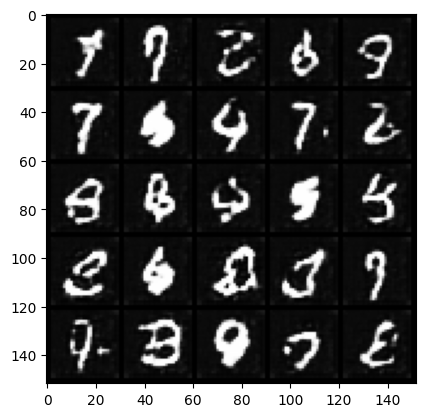

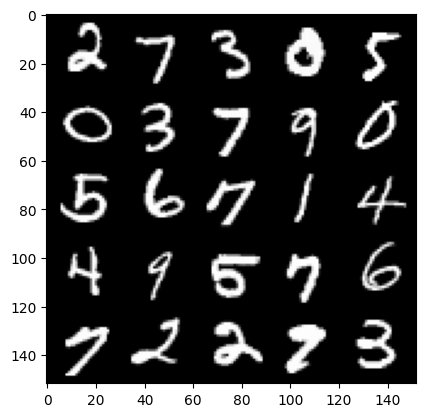

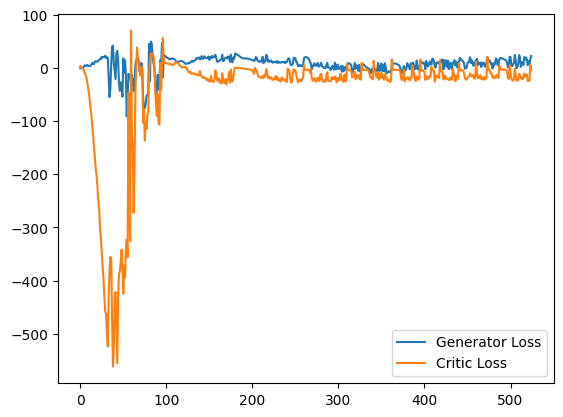

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09770635515451431
real: -17.599613189697266, fake: -21.72708511352539, regularization: 0.9770635366439819
crit_loss: torch.Size([]) -3.1504082679748535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06596076488494873
real: -17.469894409179688, fake: -21.454097747802734, regularization: 0.6596076488494873
crit_loss: torch.Size([]) -3.3245956897735596
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04945217818021774
real: -17.305519104003906, fake: -21.516586303710938, regularization: 0.4945217967033386
crit_loss: torch.Size([]) -3.716545343399048
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.040366269648075104
real: -17.20293617248535, fake: -21.420612335205078, regularization: 0.40366268157958984
crit_loss: torch.Size([]) -3.8140134811401367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03571980446577072
real: -17.112895965576172, fake: -21.38562774658203, regularization: 0.35719

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04634171724319458
real: -16.720401763916016, fake: -21.379249572753906, regularization: 0.4634171724319458
crit_loss: torch.Size([]) -4.195430755615234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.047315772622823715
real: -16.836273193359375, fake: -21.576995849609375, regularization: 0.47315773367881775
crit_loss: torch.Size([]) -4.26756477355957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07530657947063446
real: -16.855937957763672, fake: -21.821819305419922, regularization: 0.753065824508667
crit_loss: torch.Size([]) -4.212815284729004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03864048048853874
real: -16.90765380859375, fake: -21.640850067138672, regularization: 0.386404812335968
crit_loss: torch.Size([]) -4.3467912673950195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06089412420988083
real: -16.840354919433594, fake: -21.381155014038086, regularization: 0.60894125

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07900631427764893
real: -13.468015670776367, fake: -20.34520149230957, regularization: 0.7900631427764893
crit_loss: torch.Size([]) -6.087122917175293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05798343941569328
real: -13.453561782836914, fake: -19.861896514892578, regularization: 0.5798344016075134
crit_loss: torch.Size([]) -5.828500270843506
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08720627427101135
real: -13.431011199951172, fake: -20.231239318847656, regularization: 0.8720627427101135
crit_loss: torch.Size([]) -5.928165435791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0893658772110939
real: -13.265653610229492, fake: -19.982152938842773, regularization: 0.8936587572097778
crit_loss: torch.Size([]) -5.822840690612793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.058013949543237686
real: -14.651461601257324, fake: -19.96369171142578, regularization: 0.580139517

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15955424308776855
real: -1.6552283763885498, fake: -15.092559814453125, regularization: 1.5955424308776855
crit_loss: torch.Size([]) -11.841789245605469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27090513706207275
real: 0.9727275371551514, fake: -15.272274017333984, regularization: 2.7090513706207275
crit_loss: torch.Size([]) -13.53594970703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16077964007854462
real: 3.9839961528778076, fake: -14.713554382324219, regularization: 1.6077964305877686
crit_loss: torch.Size([]) -17.089754104614258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21222053468227386
real: 8.817865371704102, fake: -13.406509399414062, regularization: 2.1222052574157715
crit_loss: torch.Size([]) -20.102169036865234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5100452899932861
real: 12.948165893554688, fake: -11.613005638122559, regularization: 5.1004528999

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1615021526813507
real: 30.310688018798828, fake: -8.82103157043457, regularization: 1.6150214672088623
crit_loss: torch.Size([]) -37.516700744628906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10995076596736908
real: 37.67568588256836, fake: -11.44133186340332, regularization: 1.0995076894760132
crit_loss: torch.Size([]) -48.017513275146484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1559276580810547
real: 40.378204345703125, fake: -6.338799476623535, regularization: 1.5592765808105469
crit_loss: torch.Size([]) -45.1577262878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15335986018180847
real: 12.227421760559082, fake: -9.13796329498291, regularization: 1.5335986614227295
crit_loss: torch.Size([]) -19.831787109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10189500451087952
real: 27.79328727722168, fake: -7.21661376953125, regularization: 1.0189499855041504
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11901802569627762
real: -6.64086389541626, fake: 5.983519554138184, regularization: 1.1901803016662598
crit_loss: torch.Size([]) 13.814563751220703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17067915201187134
real: 4.378574371337891, fake: 10.629703521728516, regularization: 1.7067915201187134
crit_loss: torch.Size([]) 7.957920551300049
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17095617949962616
real: 27.120849609375, fake: -3.9640023708343506, regularization: 1.709561824798584
crit_loss: torch.Size([]) -29.375289916992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27985304594039917
real: 7.736423492431641, fake: -17.687976837158203, regularization: 2.7985305786132812
crit_loss: torch.Size([]) -22.625869750976562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19987110793590546
real: 13.925838470458984, fake: -12.173755645751953, regularization: 1.998711109161377
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3272853493690491
real: 10.81826400756836, fake: 0.5814311504364014, regularization: 3.272853374481201
crit_loss: torch.Size([]) -6.963979244232178
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2138320803642273
real: 27.056407928466797, fake: 10.164770126342773, regularization: 2.1383209228515625
crit_loss: torch.Size([]) -14.753316879272461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11017033457756042
real: 29.761947631835938, fake: 3.088550090789795, regularization: 1.101703405380249
crit_loss: torch.Size([]) -25.571693420410156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23966947197914124
real: 15.829166412353516, fake: -9.263020515441895, regularization: 2.3966946601867676
crit_loss: torch.Size([]) -22.695491790771484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1181238442659378
real: 21.009483337402344, fake: -8.035649299621582, regularization: 1.1812384128570557
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.180332750082016
real: 23.727909088134766, fake: -6.3035078048706055, regularization: 1.8033275604248047
crit_loss: torch.Size([]) -28.228090286254883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11864861845970154
real: 25.19780731201172, fake: -5.356795310974121, regularization: 1.1864862442016602
crit_loss: torch.Size([]) -29.368118286132812
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20801439881324768
real: 30.950435638427734, fake: 0.28075018525123596, regularization: 2.080143928527832
crit_loss: torch.Size([]) -28.589542388916016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09218611568212509
real: 27.95109748840332, fake: -5.262209892272949, regularization: 0.9218611717224121
crit_loss: torch.Size([]) -32.291446685791016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16659782826900482
real: 23.655717849731445, fake: -2.930645227432251, regularization: 1.6659783124923706

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2584884762763977
real: 8.289336204528809, fake: -22.189359664916992, regularization: 2.5848846435546875
crit_loss: torch.Size([]) -27.893810272216797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15384653210639954
real: 14.158882141113281, fake: -1.1605947017669678, regularization: 1.5384652614593506
crit_loss: torch.Size([]) -13.781011581420898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19568279385566711
real: 21.182079315185547, fake: -1.5460634231567383, regularization: 1.9568278789520264
crit_loss: torch.Size([]) -20.77131462097168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1309821605682373
real: 10.537281036376953, fake: -10.808282852172852, regularization: 1.309821605682373
crit_loss: torch.Size([]) -20.035741806030273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09759226441383362
real: 11.61809253692627, fake: -6.787829399108887, regularization: 0.975922644138336

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09044148027896881
real: -14.26229476928711, fake: -23.515182495117188, regularization: 0.9044147729873657
crit_loss: torch.Size([]) -8.348472595214844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07077331095933914
real: -13.666168212890625, fake: -23.63707733154297, regularization: 0.7077330946922302
crit_loss: torch.Size([]) -9.263175964355469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12576547265052795
real: -13.07049560546875, fake: -23.478065490722656, regularization: 1.2576546669006348
crit_loss: torch.Size([]) -9.14991569519043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05040237307548523
real: -14.699578285217285, fake: -22.936756134033203, regularization: 0.5040237307548523
crit_loss: torch.Size([]) -7.733154296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07297417521476746
real: -15.216426849365234, fake: -24.235992431640625, regularization: 0.72974175214767

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1458437144756317
real: 29.680011749267578, fake: -9.897127151489258, regularization: 1.458437204360962
crit_loss: torch.Size([]) -38.11870193481445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1856328248977661
real: 25.680171966552734, fake: -13.313257217407227, regularization: 1.8563282489776611
crit_loss: torch.Size([]) -37.13710403442383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2689228653907776
real: 22.62529754638672, fake: -16.638010025024414, regularization: 2.6892285346984863
crit_loss: torch.Size([]) -36.57407760620117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2627487778663635
real: 30.144634246826172, fake: -16.104244232177734, regularization: 2.6274876594543457
crit_loss: torch.Size([]) -43.62139129638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1676725447177887
real: 28.529008865356445, fake: -13.782416343688965, regularization: 1.6767253875732422
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2886398434638977
real: 40.462764739990234, fake: 5.877753257751465, regularization: 2.8863983154296875
crit_loss: torch.Size([]) -31.698612213134766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13039961457252502
real: 35.15452194213867, fake: -0.13580842316150665, regularization: 1.3039960861206055
crit_loss: torch.Size([]) -33.986331939697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.237359419465065
real: 25.333213806152344, fake: -4.195466995239258, regularization: 2.373594284057617
crit_loss: torch.Size([]) -27.155086517333984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09993515908718109
real: 27.627540588378906, fake: -10.591972351074219, regularization: 0.9993516206741333
crit_loss: torch.Size([]) -37.22016143798828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17531566321849823
real: 34.06017303466797, fake: -2.2735884189605713, regularization: 1.7531566619873047


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18879172205924988
real: 17.453271865844727, fake: -8.171918869018555, regularization: 1.8879172801971436
crit_loss: torch.Size([]) -23.737274169921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.159714937210083
real: 16.104698181152344, fake: -11.642424583435059, regularization: 1.59714937210083
crit_loss: torch.Size([]) -26.149974822998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19564655423164368
real: 18.008275985717773, fake: -13.970466613769531, regularization: 1.956465482711792
crit_loss: torch.Size([]) -30.02227783203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17157214879989624
real: 23.771703720092773, fake: -5.442133903503418, regularization: 1.7157214879989624
crit_loss: torch.Size([]) -27.49811553955078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10788684338331223
real: -7.194876194000244, fake: -5.544492244720459, regularization: 1.0788683891296387
c

penalty: torch.Size([]) 0.09166284650564194
real: -7.484889507293701, fake: -18.218738555908203, regularization: 0.9166284799575806
crit_loss: torch.Size([]) -9.817219734191895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08563078939914703
real: -10.200897216796875, fake: -18.32149887084961, regularization: 0.856307864189148
crit_loss: torch.Size([]) -7.264293670654297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09804093092679977
real: -10.560924530029297, fake: -20.967819213867188, regularization: 0.9804093241691589
crit_loss: torch.Size([]) -9.426485061645508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07208368182182312
real: -10.925521850585938, fake: -21.085174560546875, regularization: 0.7208368182182312
crit_loss: torch.Size([]) -9.43881607055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09690265357494354
real: -11.21306037902832, fake: -23.08539581298828, regularization: 0.9690265655517578
crit_loss: torch.Size([]) -10

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21795645356178284
real: 7.427164554595947, fake: -22.58949089050293, regularization: 2.1795644760131836
crit_loss: torch.Size([]) -27.83708953857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4529712200164795
real: 15.477291107177734, fake: -8.937877655029297, regularization: 4.529712200164795
crit_loss: torch.Size([]) -19.885456085205078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22943927347660065
real: 13.991056442260742, fake: -17.74657440185547, regularization: 2.2943928241729736
crit_loss: torch.Size([]) -29.4432373046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24859179556369781
real: -6.476630210876465, fake: -7.400277614593506, regularization: 2.4859180450439453
crit_loss: torch.Size([]) 1.5622706413269043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5838744640350342
real: 10.396546363830566, fake: -1.1963467597961426, regularization: 5.838744640350342
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1520669013261795
real: -6.876702308654785, fake: -17.441682815551758, regularization: 1.5206689834594727
crit_loss: torch.Size([]) -9.0443115234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.123345285654068
real: -7.113372325897217, fake: -17.764022827148438, regularization: 1.2334527969360352
crit_loss: torch.Size([]) -9.417197227478027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09466604143381119
real: -7.269711017608643, fake: -18.528850555419922, regularization: 0.9466603994369507
crit_loss: torch.Size([]) -10.312479972839355
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08188114315271378
real: -7.207302570343018, fake: -18.832542419433594, regularization: 0.8188114166259766
crit_loss: torch.Size([]) -10.806428909301758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1051691472530365
real: -6.920886993408203, fake: -19.1174259185791, regularization: 1.0516915321350098
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19887356460094452
real: 11.208953857421875, fake: -24.037349700927734, regularization: 1.9887356758117676
crit_loss: torch.Size([]) -33.257568359375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2557358145713806
real: 15.505167007446289, fake: -20.850807189941406, regularization: 2.5573582649230957
crit_loss: torch.Size([]) -33.798614501953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29914844036102295
real: 17.667129516601562, fake: -16.2962703704834, regularization: 2.9914844036102295
crit_loss: torch.Size([]) -30.9719181060791
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2253497689962387
real: 12.466632843017578, fake: -19.173418045043945, regularization: 2.25349760055542
crit_loss: torch.Size([]) -29.386552810668945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14318564534187317
real: 14.332625389099121, fake: -18.23318862915039, regularization: 1.431856393814087
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22479692101478577
real: 16.294147491455078, fake: -1.6560571193695068, regularization: 2.247969150543213
crit_loss: torch.Size([]) -15.70223617553711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22685840725898743
real: 16.88543701171875, fake: -1.614428997039795, regularization: 2.2685840129852295
crit_loss: torch.Size([]) -16.23128318786621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14771942794322968
real: 17.552459716796875, fake: 1.2259521484375, regularization: 1.4771943092346191
crit_loss: torch.Size([]) -14.849313735961914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21372568607330322
real: 4.886780738830566, fake: -2.0983431339263916, regularization: 2.1372568607330322
crit_loss: torch.Size([]) -4.847867012023926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23582816123962402
real: 11.559572219848633, fake: -0.5736421942710876, regularization: 2.3582816123962402
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20424328744411469
real: -15.381794929504395, fake: -27.812744140625, regularization: 2.0424327850341797
crit_loss: torch.Size([]) -10.388516426086426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23296299576759338
real: -12.904008865356445, fake: -25.86207389831543, regularization: 2.329629898071289
crit_loss: torch.Size([]) -10.628435134887695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07488836348056793
real: -10.45578670501709, fake: -23.697975158691406, regularization: 0.7488836050033569
crit_loss: torch.Size([]) -12.493305206298828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09457176923751831
real: -9.257694244384766, fake: -21.734302520751953, regularization: 0.9457176923751831
crit_loss: torch.Size([]) -11.530890464782715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10167399793863297
real: -8.579444885253906, fake: -21.866336822509766, regularization: 1.01673996448

penalty: torch.Size([]) 0.17340394854545593
real: -9.216944694519043, fake: -29.02743148803711, regularization: 1.734039545059204
crit_loss: torch.Size([]) -18.076446533203125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1584150493144989
real: -9.519060134887695, fake: -31.57876968383789, regularization: 1.5841505527496338
crit_loss: torch.Size([]) -20.47555923461914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1260959357023239
real: -14.77381706237793, fake: -28.8049259185791, regularization: 1.2609593868255615
crit_loss: torch.Size([]) -12.770149230957031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12523673474788666
real: -11.606061935424805, fake: -22.931896209716797, regularization: 1.252367377281189
crit_loss: torch.Size([]) -10.073467254638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2430686205625534
real: -7.30106782913208, fake: -18.28554344177246, regularization: 2.4306862354278564
crit_loss: torch.Size([]) -8.553790

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14796140789985657
real: 35.20726776123047, fake: 11.41604995727539, regularization: 1.479614019393921
crit_loss: torch.Size([]) -22.311603546142578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17761673033237457
real: 33.150367736816406, fake: 7.415632247924805, regularization: 1.7761672735214233
crit_loss: torch.Size([]) -23.958568572998047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21565836668014526
real: 26.84241485595703, fake: 7.803011894226074, regularization: 2.156583786010742
crit_loss: torch.Size([]) -16.8828182220459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25021886825561523
real: 30.814414978027344, fake: 3.4212944507598877, regularization: 2.5021886825561523
crit_loss: torch.Size([]) -24.89093017578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11495505273342133
real: 17.31365394592285, fake: 10.521459579467773, regularization: 1.1495505571365356
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11299698054790497
real: 24.84101104736328, fake: -3.6978981494903564, regularization: 1.129969835281372
crit_loss: torch.Size([]) -27.408939361572266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14696836471557617
real: 32.20030975341797, fake: 0.16038286685943604, regularization: 1.4696836471557617
crit_loss: torch.Size([]) -30.57024383544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.079856738448143
real: 18.336341857910156, fake: -13.067913055419922, regularization: 0.7985674142837524
crit_loss: torch.Size([]) -30.605688095092773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21192795038223267
real: 29.90432357788086, fake: -5.574575424194336, regularization: 2.119279384613037
crit_loss: torch.Size([]) -33.359619140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1683962345123291
real: 39.72249984741211, fake: -1.1054296493530273, regularization: 1.683962345123291
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1849662810564041
real: 8.005415916442871, fake: -18.46884536743164, regularization: 1.8496627807617188
crit_loss: torch.Size([]) -24.62459945678711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28115302324295044
real: 6.161655426025391, fake: -18.580209732055664, regularization: 2.811530113220215
crit_loss: torch.Size([]) -21.930335998535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26425182819366455
real: 23.480377197265625, fake: -12.857637405395508, regularization: 2.6425182819366455
crit_loss: torch.Size([]) -33.69549560546875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4267577528953552
real: 42.41734313964844, fake: 16.118566513061523, regularization: 4.267577648162842
crit_loss: torch.Size([]) -22.031198501586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1730547696352005
real: 36.64080810546875, fake: 2.0722124576568604, regularization: 1.7305476665496826
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09965644031763077
real: 19.511890411376953, fake: -12.373861312866211, regularization: 0.9965643882751465
crit_loss: torch.Size([]) -30.88918685913086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2367742657661438
real: -29.672653198242188, fake: 7.113343715667725, regularization: 2.3677425384521484
crit_loss: torch.Size([]) 39.15373992919922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2728339731693268
real: -32.8362922668457, fake: -5.675150394439697, regularization: 2.728339672088623
crit_loss: torch.Size([]) 29.889482498168945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7722625732421875
real: -33.4052734375, fake: -22.04364776611328, regularization: 7.722625732421875
crit_loss: torch.Size([]) 19.084251403808594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5401965379714966
real: -27.626466751098633, fake: -32.84553527832031, regularization: 5.401965141296387
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6442780494689941
real: -16.451618194580078, fake: -28.11703109741211, regularization: 16.442779541015625
crit_loss: torch.Size([]) 4.777366638183594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7310481667518616
real: -16.946186065673828, fake: -29.901809692382812, regularization: 7.310481548309326
crit_loss: torch.Size([]) -5.645142078399658
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5804392099380493
real: -15.926243782043457, fake: -30.455577850341797, regularization: 5.804391860961914
crit_loss: torch.Size([]) -8.724942207336426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3002818822860718
real: -15.855178833007812, fake: -28.354888916015625, regularization: 13.002819061279297
crit_loss: torch.Size([]) 0.5031089782714844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5535326600074768
real: -15.30907154083252, fake: -27.54323959350586, regularization: 5.5353264808654785
c

crit_loss: torch.Size([]) -17.110336303710938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3666154146194458
real: -1.0891656875610352, fake: -18.507291793823242, regularization: 3.666154146194458
crit_loss: torch.Size([]) -13.751971244812012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42361098527908325
real: 1.824049949645996, fake: -16.49065399169922, regularization: 4.236109733581543
crit_loss: torch.Size([]) -14.078595161437988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5191556215286255
real: 4.864433288574219, fake: -13.657575607299805, regularization: 5.191555976867676
crit_loss: torch.Size([]) -13.330452919006348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5057371258735657
real: 5.702402114868164, fake: -13.677288055419922, regularization: 5.057371139526367
crit_loss: torch.Size([]) -14.322319030761719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43839243054389954
real: 6.4790239334106445, fake: -15.9129285

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27799612283706665
real: 16.62662124633789, fake: -7.899312973022461, regularization: 2.779961109161377
crit_loss: torch.Size([]) -21.745973587036133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21056511998176575
real: 16.78866195678711, fake: -10.674861907958984, regularization: 2.1056511402130127
crit_loss: torch.Size([]) -25.357872009277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30451279878616333
real: 22.886615753173828, fake: -3.340742588043213, regularization: 3.0451278686523438
crit_loss: torch.Size([]) -23.18222999572754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10402926802635193
real: 27.318681716918945, fake: -2.7528207302093506, regularization: 1.040292739868164
crit_loss: torch.Size([]) -29.03120994567871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17449401319026947
real: 21.653175354003906, fake: -10.375833511352539, regularization: 1.744940161705017


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06097355857491493
real: 16.866058349609375, fake: -11.272436141967773, regularization: 0.6097356081008911
crit_loss: torch.Size([]) -27.528759002685547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10917706787586212
real: 19.162826538085938, fake: 4.350796699523926, regularization: 1.0917706489562988
crit_loss: torch.Size([]) -13.720258712768555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2474837303161621
real: 34.03251647949219, fake: 18.251955032348633, regularization: 2.474837303161621
crit_loss: torch.Size([]) -13.305724143981934
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22583481669425964
real: 34.2266731262207, fake: 12.663980484008789, regularization: 2.258348226547241
crit_loss: torch.Size([]) -19.304344177246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2132132202386856
real: 29.879804611206055, fake: -1.6837232112884521, regularization: 2.1321322917938232
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15247318148612976
real: 23.28306770324707, fake: 6.550100326538086, regularization: 1.5247318744659424
crit_loss: torch.Size([]) -15.208235740661621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.052576564252376556
real: 24.331050872802734, fake: 4.992245197296143, regularization: 0.5257656574249268
crit_loss: torch.Size([]) -18.813039779663086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16655433177947998
real: 17.29035758972168, fake: -0.693536639213562, regularization: 1.6655433177947998
crit_loss: torch.Size([]) -16.31835174560547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10660388320684433
real: 16.96395492553711, fake: -2.120943069458008, regularization: 1.0660388469696045
crit_loss: torch.Size([]) -18.01885986328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14939098060131073
real: 9.871316909790039, fake: -17.819719314575195, regularization: 1.4939098358154297
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2175411880016327
real: -21.48287582397461, fake: -31.307241439819336, regularization: 2.1754119396209717
crit_loss: torch.Size([]) -7.648953437805176
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2970917820930481
real: -21.806230545043945, fake: -29.931194305419922, regularization: 2.9709177017211914
crit_loss: torch.Size([]) -5.154046058654785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13649778068065643
real: -22.38592529296875, fake: -30.43712043762207, regularization: 1.3649778366088867
crit_loss: torch.Size([]) -6.686217308044434
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6291625499725342
real: -22.648784637451172, fake: -33.191646575927734, regularization: 6.291625499725342
crit_loss: torch.Size([]) -4.251236438751221
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5098214745521545
real: -19.95541000366211, fake: -30.424772262573242, regularization: 5.098214626312256


  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2084333300590515
real: -21.34663200378418, fake: -26.298175811767578, regularization: 2.0843334197998047
crit_loss: torch.Size([]) -2.8672103881835938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26546335220336914
real: -18.24205780029297, fake: -24.412654876708984, regularization: 2.6546335220336914
crit_loss: torch.Size([]) -3.515963554382324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15948434174060822
real: -13.872856140136719, fake: -22.364086151123047, regularization: 1.5948433876037598
crit_loss: torch.Size([]) -6.896386623382568
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11131910234689713
real: -10.105903625488281, fake: -21.96251106262207, regularization: 1.11319100856781
crit_loss: torch.Size([]) -10.743416786193848
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09354467689990997
real: -6.254945755004883, fake: -20.971174240112305, regularization: 0.935446739196

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1739642322063446
real: -1.3437767028808594, fake: -17.96230697631836, regularization: 1.7396423816680908
crit_loss: torch.Size([]) -14.878888130187988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20429766178131104
real: 15.222567558288574, fake: -2.3001763820648193, regularization: 2.0429766178131104
crit_loss: torch.Size([]) -15.479766845703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1044585257768631
real: 25.675304412841797, fake: 3.410203456878662, regularization: 1.0445852279663086
crit_loss: torch.Size([]) -21.220516204833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1474049687385559
real: 23.870887756347656, fake: -10.386043548583984, regularization: 1.474049687385559
crit_loss: torch.Size([]) -32.78288269042969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18730846047401428
real: 18.431941986083984, fake: -13.646102905273438, regularization: 1.873084545135498

crit_loss: torch.Size([]) -6.699522018432617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06425082683563232
real: 31.617795944213867, fake: 16.773221969604492, regularization: 0.6425082683563232
crit_loss: torch.Size([]) -14.202065467834473
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14505839347839355
real: 32.91591262817383, fake: 10.106393814086914, regularization: 1.4505839347839355
crit_loss: torch.Size([]) -21.35893440246582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13162952661514282
real: 18.82618522644043, fake: -2.6473228931427, regularization: 1.3162952661514282
crit_loss: torch.Size([]) -20.15721321105957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14709331095218658
real: 15.016291618347168, fake: -10.553401947021484, regularization: 1.4709330797195435
crit_loss: torch.Size([]) -24.0987606048584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23433400690555573
real: -23.30621337890625, fake: -1.8156094551

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47471171617507935
real: -17.416271209716797, fake: -30.55155372619629, regularization: 4.747117042541504
crit_loss: torch.Size([]) -8.388165473937988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7913750410079956
real: -17.18685531616211, fake: -28.834083557128906, regularization: 7.913750648498535
crit_loss: torch.Size([]) -3.7334775924682617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20649659633636475
real: -17.813934326171875, fake: -31.506771087646484, regularization: 2.0649659633636475
crit_loss: torch.Size([]) -11.627870559692383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1608679294586182
real: -16.419246673583984, fake: -31.82012176513672, regularization: 11.608678817749023
crit_loss: torch.Size([]) -3.792196273803711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7122681140899658
real: -15.04780387878418, fake: -28.6376953125, regularization: 17.1226806640625
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05547318607568741
real: -3.001984119415283, fake: -11.436578750610352, regularization: 0.5547318458557129
crit_loss: torch.Size([]) -7.879863262176514
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10220299661159515
real: 3.6776649951934814, fake: -3.7049331665039062, regularization: 1.022029995918274
crit_loss: torch.Size([]) -6.360568046569824
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26941847801208496
real: 22.783519744873047, fake: -2.5435068607330322, regularization: 2.6941847801208496
crit_loss: torch.Size([]) -22.632841110229492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26307374238967896
real: 23.60066795349121, fake: -4.188689231872559, regularization: 2.6307373046875
crit_loss: torch.Size([]) -25.158618927001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40719708800315857
real: 17.517383575439453, fake: -11.38204574584961, regularization: 4.0719709396362305


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3562987148761749
real: -12.41648006439209, fake: -3.8995018005371094, regularization: 3.5629870891571045
crit_loss: torch.Size([]) 12.079965591430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20995403826236725
real: -2.4147329330444336, fake: -1.6000404357910156, regularization: 2.0995404720306396
crit_loss: torch.Size([]) 2.9142329692840576
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1476462036371231
real: 14.155324935913086, fake: -8.923982620239258, regularization: 1.4764620065689087
crit_loss: torch.Size([]) -21.602846145629883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10772383213043213
real: 13.61037826538086, fake: -8.555252075195312, regularization: 1.0772383213043213
crit_loss: torch.Size([]) -21.08839225769043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19791865348815918
real: 22.148147583007812, fake: -7.803176403045654, regularization: 1.9791865348815918

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18446749448776245
real: 20.357084274291992, fake: 4.16063117980957, regularization: 1.8446749448776245
crit_loss: torch.Size([]) -14.351778030395508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1352977603673935
real: 25.008926391601562, fake: 0.626002848148346, regularization: 1.3529776334762573
crit_loss: torch.Size([]) -23.029945373535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1678861677646637
real: 17.360939025878906, fake: -6.718966960906982, regularization: 1.6788616180419922
crit_loss: torch.Size([]) -22.401044845581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10400339961051941
real: 25.051998138427734, fake: 4.398083686828613, regularization: 1.0400340557098389
crit_loss: torch.Size([]) -19.613882064819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12097372114658356
real: 26.036100387573242, fake: 4.408202171325684, regularization: 1.2097371816635132
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1349099725484848
real: -15.986801147460938, fake: -25.451934814453125, regularization: 1.3490997552871704
crit_loss: torch.Size([]) -8.116033554077148
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0716758668422699
real: -15.418046951293945, fake: -24.31989288330078, regularization: 0.716758668422699
crit_loss: torch.Size([]) -8.185087203979492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07048016786575317
real: -15.224114418029785, fake: -24.444305419921875, regularization: 0.7048016786575317
crit_loss: torch.Size([]) -8.515389442443848
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06822416931390762
real: -15.14699935913086, fake: -24.789836883544922, regularization: 0.682241678237915
crit_loss: torch.Size([]) -8.960596084594727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08871300518512726
real: -15.331390380859375, fake: -24.716670989990234, regularization: 0.8871300220489

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18389728665351868
real: -7.397194862365723, fake: -13.076374053955078, regularization: 1.838972806930542
crit_loss: torch.Size([]) -3.8402063846588135
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7271947860717773
real: 2.0764336585998535, fake: -11.112946510314941, regularization: 7.271947860717773
crit_loss: torch.Size([]) -5.91743278503418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.195964515209198
real: 0.19093848764896393, fake: -13.420354843139648, regularization: 1.95964515209198
crit_loss: torch.Size([]) -11.65164852142334
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1472737193107605
real: 0.5525453090667725, fake: -13.55566120147705, regularization: 1.472737193107605
crit_loss: torch.Size([]) -12.635469436645508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19985294342041016
real: 1.1590135097503662, fake: -13.791914939880371, regularization: 1.9985294342041016
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3095478415489197
real: 29.15357208251953, fake: -18.25380516052246, regularization: 3.0954785346984863
crit_loss: torch.Size([]) -44.3119010925293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30502593517303467
real: -17.73505210876465, fake: -11.905473709106445, regularization: 3.0502593517303467
crit_loss: torch.Size([]) 8.879837989807129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18861109018325806
real: -20.256389617919922, fake: -5.389593124389648, regularization: 1.8861109018325806
crit_loss: torch.Size([]) 16.752906799316406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47420912981033325
real: -21.92987060546875, fake: -17.76967430114746, regularization: 4.742091178894043
crit_loss: torch.Size([]) 8.902287483215332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32375913858413696
real: -21.402860641479492, fake: -17.463241577148438, regularization: 3.23759126663208
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5342660546302795
real: -19.76259994506836, fake: -28.130685806274414, regularization: 5.342660427093506
crit_loss: torch.Size([]) -3.025425434112549
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25616762042045593
real: -18.991350173950195, fake: -28.882152557373047, regularization: 2.561676263809204
crit_loss: torch.Size([]) -7.329126358032227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6017751693725586
real: -18.05167007446289, fake: -30.439083099365234, regularization: 6.017751693725586
crit_loss: torch.Size([]) -6.369661331176758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4303508698940277
real: -23.69515037536621, fake: -27.31031036376953, regularization: 4.303508758544922
crit_loss: torch.Size([]) 0.6883487701416016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33228617906570435
real: -22.9812068939209, fake: -25.61499786376953, regularization: 3.322861671447754
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.352668821811676
real: 5.23950719833374, fake: -9.635032653808594, regularization: 3.5266880989074707
crit_loss: torch.Size([]) -11.34785270690918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24624919891357422
real: 8.281780242919922, fake: -9.036392211914062, regularization: 2.462491989135742
crit_loss: torch.Size([]) -14.855680465698242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16030505299568176
real: 11.343428611755371, fake: -11.106051445007324, regularization: 1.6030504703521729
crit_loss: torch.Size([]) -20.8464298248291
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23272958397865295
real: 13.308757781982422, fake: -8.973518371582031, regularization: 2.3272957801818848
crit_loss: torch.Size([]) -19.954980850219727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3454354405403137
real: 16.159252166748047, fake: -7.8007917404174805, regularization: 3.4543542861938477
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17012819647789001
real: 26.965713500976562, fake: -8.642638206481934, regularization: 1.701282024383545
crit_loss: torch.Size([]) -33.90707015991211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12180658429861069
real: 32.146453857421875, fake: -2.8840184211730957, regularization: 1.218065857887268
crit_loss: torch.Size([]) -33.81240463256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10212784260511398
real: 35.938873291015625, fake: -1.4505902528762817, regularization: 1.0212783813476562
crit_loss: torch.Size([]) -36.368186950683594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16053736209869385
real: 19.291400909423828, fake: -14.325210571289062, regularization: 1.6053736209869385
crit_loss: torch.Size([]) -32.01123809814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13718032836914062
real: 34.002708435058594, fake: -3.8352487087249756, regularization: 1.37180328369140

crit_loss: torch.Size([]) -19.68696403503418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21993078291416168
real: 15.235157012939453, fake: 9.261369705200195, regularization: 2.199307918548584
crit_loss: torch.Size([]) -3.774479389190674
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2490157186985016
real: 23.330686569213867, fake: 10.706289291381836, regularization: 2.490157127380371
crit_loss: torch.Size([]) -10.13424015045166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08671333640813828
real: 26.344758987426758, fake: -2.696202278137207, regularization: 0.867133378982544
crit_loss: torch.Size([]) -28.173828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3069596290588379
real: 11.28912353515625, fake: -8.293882369995117, regularization: 3.069596290588379
crit_loss: torch.Size([]) -16.513408660888672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11788564920425415
real: 14.512025833129883, fake: -9.964847564697266, re

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18210846185684204
real: -6.98499059677124, fake: -24.157329559326172, regularization: 1.8210846185684204
crit_loss: torch.Size([]) -15.351253509521484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10765346139669418
real: -6.581686973571777, fake: -24.743465423583984, regularization: 1.076534628868103
crit_loss: torch.Size([]) -17.085243225097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21230502426624298
real: -6.13193416595459, fake: -25.80133819580078, regularization: 2.1230502128601074
crit_loss: torch.Size([]) -17.54635238647461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2598666548728943
real: -7.085299015045166, fake: -21.072757720947266, regularization: 2.5986666679382324
crit_loss: torch.Size([]) -11.388792037963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1836567223072052
real: -0.13397923111915588, fake: -18.539146423339844, regularization: 1.8365671634674

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15078365802764893
real: 23.92449188232422, fake: 5.159726142883301, regularization: 1.5078365802764893
crit_loss: torch.Size([]) -17.256929397583008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17683279514312744
real: 29.981590270996094, fake: 8.23266315460205, regularization: 1.7683279514312744
crit_loss: torch.Size([]) -19.980600357055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16666871309280396
real: 28.01905632019043, fake: 3.081382989883423, regularization: 1.6666871309280396
crit_loss: torch.Size([]) -23.270986557006836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15962889790534973
real: 22.92791175842285, fake: 3.040036201477051, regularization: 1.5962889194488525
crit_loss: torch.Size([]) -18.29158592224121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11725771427154541
real: 23.305646896362305, fake: 0.1815965324640274, regularization: 1.172577142715454
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11202357709407806
real: -14.224037170410156, fake: -21.322242736816406, regularization: 1.120235800743103
crit_loss: torch.Size([]) -5.977969646453857
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09800297766923904
real: -13.862789154052734, fake: -21.37908172607422, regularization: 0.9800297617912292
crit_loss: torch.Size([]) -6.5362629890441895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08923613280057907
real: -14.042827606201172, fake: -21.400310516357422, regularization: 0.8923613429069519
crit_loss: torch.Size([]) -6.465121746063232
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04944729059934616
real: -14.079488754272461, fake: -22.069429397583008, regularization: 0.4944729208946228
crit_loss: torch.Size([]) -7.495467662811279
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09589633345603943
real: -14.284109115600586, fake: -22.877464294433594, regularization: 0.95896333

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10871406644582748
real: -11.660818099975586, fake: -25.236141204833984, regularization: 1.087140679359436
crit_loss: torch.Size([]) -12.488182067871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09474141895771027
real: -12.373188018798828, fake: -31.53711700439453, regularization: 0.9474141597747803
crit_loss: torch.Size([]) -18.216514587402344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18492792546749115
real: -14.771341323852539, fake: -36.6110725402832, regularization: 1.8492792844772339
crit_loss: torch.Size([]) -19.99045181274414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42266300320625305
real: -17.53017807006836, fake: -38.865509033203125, regularization: 4.226630210876465
crit_loss: torch.Size([]) -17.108699798583984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24320130050182343
real: -15.462650299072266, fake: -38.93499755859375, regularization: 2.43201303482

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16575145721435547
real: 24.280658721923828, fake: -10.600261688232422, regularization: 1.6575145721435547
crit_loss: torch.Size([]) -33.22340393066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2213956117630005
real: 36.906837463378906, fake: 0.07878726720809937, regularization: 2.213956117630005
crit_loss: torch.Size([]) -34.61409378051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21730822324752808
real: 17.295516967773438, fake: 6.503974914550781, regularization: 2.1730823516845703
crit_loss: torch.Size([]) -8.618459701538086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1531272828578949
real: 29.965620040893555, fake: 8.855058670043945, regularization: 1.5312728881835938
crit_loss: torch.Size([]) -19.579288482666016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12912321090698242
real: 23.49338150024414, fake: -0.5035929679870605, regularization: 1.2912321090698242
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6974303722381592
real: -26.29815101623535, fake: -36.33222961425781, regularization: 6.974303722381592
crit_loss: torch.Size([]) -3.059774875640869
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34341174364089966
real: -24.81254768371582, fake: -35.319618225097656, regularization: 3.434117317199707
crit_loss: torch.Size([]) -7.072953224182129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4171907305717468
real: -24.336767196655273, fake: -36.2293815612793, regularization: 4.171907424926758
crit_loss: torch.Size([]) -7.720706939697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8157567977905273
real: -26.063159942626953, fake: -38.96553039550781, regularization: 8.157567977905273
crit_loss: torch.Size([]) -4.744802474975586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4331599175930023
real: -25.155651092529297, fake: -36.829097747802734, regularization: 4.331599235534668
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21729691326618195
real: 31.366436004638672, fake: -22.270915985107422, regularization: 2.172969102859497
crit_loss: torch.Size([]) -51.46438217163086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16536611318588257
real: 28.378498077392578, fake: -30.112197875976562, regularization: 1.6536611318588257
crit_loss: torch.Size([]) -56.8370361328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.280081570148468
real: -30.598543167114258, fake: -21.09029769897461, regularization: 2.8008155822753906
crit_loss: torch.Size([]) 12.309061050415039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4790801703929901
real: -34.84221267700195, fake: -37.83375549316406, regularization: 4.790801525115967
crit_loss: torch.Size([]) 1.7992587089538574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8305125832557678
real: -33.496089935302734, fake: -36.82051467895508, regularization: 8.305126190185547
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1345263123512268
real: 27.027372360229492, fake: 11.218599319458008, regularization: 1.345263123512268
crit_loss: torch.Size([]) -14.463509559631348
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1598776876926422
real: 26.363298416137695, fake: 4.159390449523926, regularization: 1.5987768173217773
crit_loss: torch.Size([]) -20.60512924194336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10479766130447388
real: 20.873279571533203, fake: -0.5305408239364624, regularization: 1.0479766130447388
crit_loss: torch.Size([]) -20.35584259033203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14312903583049774
real: 21.150218963623047, fake: -2.253488302230835, regularization: 1.4312903881072998
crit_loss: torch.Size([]) -21.9724178314209
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11846203356981277
real: -14.798935890197754, fake: 17.915266036987305, regularization: 1.1846203804016113
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18152207136154175
real: 8.433799743652344, fake: -0.47343501448631287, regularization: 1.8152207136154175
crit_loss: torch.Size([]) -7.092014312744141
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1478562206029892
real: 20.65293312072754, fake: 12.957932472229004, regularization: 1.4785622358322144
crit_loss: torch.Size([]) -6.216438293457031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3169475793838501
real: 33.17422866821289, fake: 18.64607048034668, regularization: 3.169475793838501
crit_loss: torch.Size([]) -11.358682632446289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26821982860565186
real: 40.600563049316406, fake: 12.543007850646973, regularization: 2.6821982860565186
crit_loss: torch.Size([]) -25.37535858154297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21114011108875275
real: 27.53949737548828, fake: -0.7447869181632996, regularization: 2.111401081085205
crit_

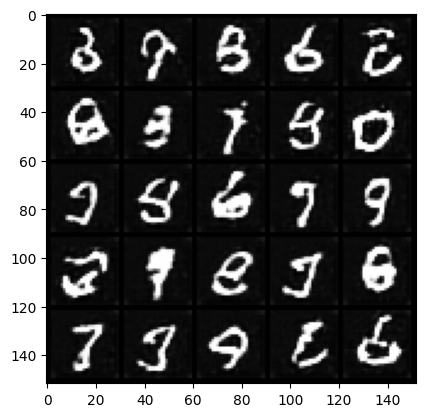

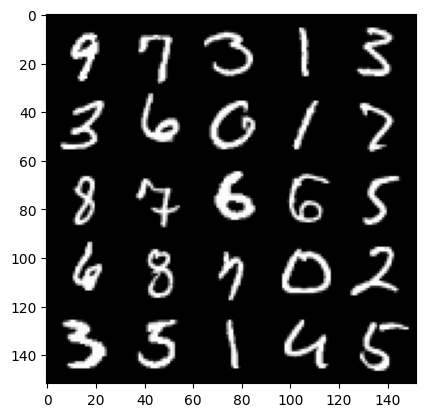

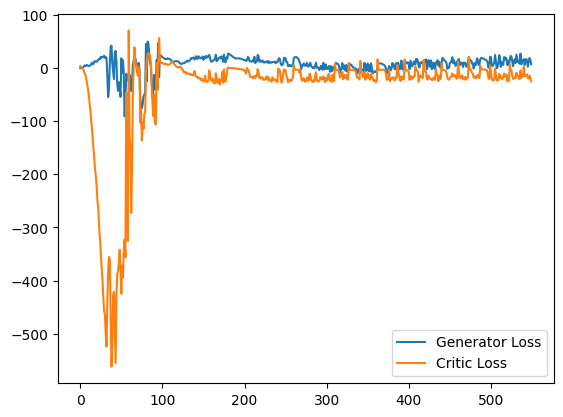

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12414329499006271
real: -15.237908363342285, fake: -22.892555236816406, regularization: 1.2414329051971436
crit_loss: torch.Size([]) -6.413213729858398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11980215460062027
real: -15.197221755981445, fake: -22.855022430419922, regularization: 1.1980215311050415
crit_loss: torch.Size([]) -6.459779262542725
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.088018998503685
real: -15.227609634399414, fake: -23.6196346282959, regularization: 0.8801900148391724
crit_loss: torch.Size([]) -7.511835098266602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1142425686120987
real: -15.125645637512207, fake: -22.6693058013916, regularization: 1.1424256563186646
crit_loss: torch.Size([]) -6.4012346267700195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10549242049455643
real: -14.682616233825684, fake: -23.20487403869629, regularization: 1.05492424964904

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3459586501121521
real: -16.291847229003906, fake: 2.1782145500183105, regularization: 3.4595866203308105
crit_loss: torch.Size([]) 21.929649353027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4246005415916443
real: -10.57828140258789, fake: -1.049947738647461, regularization: 4.246005535125732
crit_loss: torch.Size([]) 13.77433967590332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5429428815841675
real: 7.187177658081055, fake: -12.146156311035156, regularization: 5.429429054260254
crit_loss: torch.Size([]) -13.903904914855957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4350886344909668
real: 14.648022651672363, fake: -13.891864776611328, regularization: 4.350886344909668
crit_loss: torch.Size([]) -24.18899917602539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6443966627120972
real: 22.345787048339844, fake: -9.754926681518555, regularization: 6.443966865539551
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19040045142173767
real: 37.3256721496582, fake: -7.5467915534973145, regularization: 1.9040045738220215
crit_loss: torch.Size([]) -42.96846008300781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10567554831504822
real: 35.21026611328125, fake: -14.340744018554688, regularization: 1.056755542755127
crit_loss: torch.Size([]) -48.49425506591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21152231097221375
real: 31.957996368408203, fake: -18.27104949951172, regularization: 2.1152231693267822
crit_loss: torch.Size([]) -48.11382293701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12732619047164917
real: 36.609092712402344, fake: -16.556758880615234, regularization: 1.2732619047164917
crit_loss: torch.Size([]) -51.8925895690918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11147592216730118
real: 0.0922243595123291, fake: -7.107207298278809, regularization: 1.1147592067718506
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09474258124828339
real: 36.95701217651367, fake: -8.554878234863281, regularization: 0.9474258422851562
crit_loss: torch.Size([]) -44.5644645690918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08577662706375122
real: 17.56064224243164, fake: -14.475953102111816, regularization: 0.8577662706375122
crit_loss: torch.Size([]) -31.1788272857666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24923357367515564
real: 30.58139991760254, fake: -9.368486404418945, regularization: 2.492335796356201
crit_loss: torch.Size([]) -37.457550048828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15915237367153168
real: 35.264034271240234, fake: -7.5988616943359375, regularization: 1.5915237665176392
crit_loss: torch.Size([]) -41.2713737487793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09908333420753479
real: 31.671642303466797, fake: -8.588167190551758, regularization: 0.9908333420753479
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24690760672092438
real: 13.99417495727539, fake: -5.265793800354004, regularization: 2.469076156616211
crit_loss: torch.Size([]) -16.790891647338867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22966094315052032
real: 6.91552734375, fake: -10.98394775390625, regularization: 2.296609401702881
crit_loss: torch.Size([]) -15.602865219116211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2798756957054138
real: 3.26957106590271, fake: -20.284568786621094, regularization: 2.7987570762634277
crit_loss: torch.Size([]) -20.755382537841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16329756379127502
real: -4.367461204528809, fake: -1.8254661560058594, regularization: 1.6329755783081055
crit_loss: torch.Size([]) 4.174970626831055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20067936182022095
real: 9.867734909057617, fake: 6.790890693664551, regularization: 2.00679349899292
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1502118855714798
real: 26.560211181640625, fake: 5.906956672668457, regularization: 1.5021188259124756
crit_loss: torch.Size([]) -19.15113639831543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18447870016098022
real: 9.822969436645508, fake: -18.611440658569336, regularization: 1.8447870016098022
crit_loss: torch.Size([]) -26.589622497558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29501938819885254
real: 19.89727783203125, fake: -7.338874816894531, regularization: 2.9501938819885254
crit_loss: torch.Size([]) -24.285959243774414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20801696181297302
real: 36.816123962402344, fake: -3.6225650310516357, regularization: 2.080169677734375
crit_loss: torch.Size([]) -38.3585205078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10230620205402374
real: 39.39360427856445, fake: -0.037653349339962006, regularization: 1.023061990737915
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4564017653465271
real: -3.163743257522583, fake: 2.6063992977142334, regularization: 4.5640177726745605
crit_loss: torch.Size([]) 10.334159851074219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40993067622184753
real: 8.336156845092773, fake: -4.323347091674805, regularization: 4.099306583404541
crit_loss: torch.Size([]) -8.560197830200195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1799508035182953
real: 17.804977416992188, fake: -14.72744369506836, regularization: 1.7995080947875977
crit_loss: torch.Size([]) -30.732913970947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36409759521484375
real: 4.385868072509766, fake: -13.383289337158203, regularization: 3.6409759521484375
crit_loss: torch.Size([]) -14.128181457519531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1224547028541565
real: 3.343780040740967, fake: -14.241876602172852, regularization: 1.224547028541565
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14597856998443604
real: 7.426033973693848, fake: -15.688935279846191, regularization: 1.4597856998443604
crit_loss: torch.Size([]) -21.655183792114258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.145609512925148
real: -29.503517150878906, fake: 9.906396865844727, regularization: 1.4560950994491577
crit_loss: torch.Size([]) 40.86600875854492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2708115875720978
real: -25.752765655517578, fake: 3.312559127807617, regularization: 2.708115816116333
crit_loss: torch.Size([]) 31.773441314697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16679176688194275
real: -16.294113159179688, fake: 9.010078430175781, regularization: 1.6679177284240723
crit_loss: torch.Size([]) 26.972108840942383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.376459002494812
real: 4.704873561859131, fake: 11.876946449279785, regularization: 3.76459002494812
crit_loss

crit_loss: torch.Size([]) -14.260747909545898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2426014244556427
real: 25.38357925415039, fake: 8.842272758483887, regularization: 2.4260141849517822
crit_loss: torch.Size([]) -14.115291595458984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20475339889526367
real: 30.73947525024414, fake: 8.674681663513184, regularization: 2.0475339889526367
crit_loss: torch.Size([]) -20.017257690429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30970728397369385
real: 31.142995834350586, fake: 7.007126808166504, regularization: 3.0970728397369385
crit_loss: torch.Size([]) -21.038795471191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2786056399345398
real: 32.9755859375, fake: 10.140504837036133, regularization: 2.7860565185546875
crit_loss: torch.Size([]) -20.04902458190918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08025366067886353
real: 28.80795669555664, fake: -6.447301387786865,

penalty: torch.Size([]) 0.3523293435573578
real: 18.17504119873047, fake: -13.025455474853516, regularization: 3.5232934951782227
crit_loss: torch.Size([]) -27.677204132080078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23692993819713593
real: 12.836923599243164, fake: -11.356689453125, regularization: 2.3692994117736816
crit_loss: torch.Size([]) -21.82431411743164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3122636675834656
real: 16.78061294555664, fake: -8.953561782836914, regularization: 3.1226367950439453
crit_loss: torch.Size([]) -22.61153793334961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14314784109592438
real: 11.163376808166504, fake: -6.376071453094482, regularization: 1.4314783811569214
crit_loss: torch.Size([]) -16.107969284057617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09516678005456924
real: 19.334213256835938, fake: 1.8260045051574707, regularization: 0.9516677856445312
crit_loss: torch.Size([]) -16.556541

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3109077215194702
real: 28.779399871826172, fake: -14.232821464538574, regularization: 3.109077215194702
crit_loss: torch.Size([]) -39.90314483642578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17413705587387085
real: 21.955909729003906, fake: 3.446132183074951, regularization: 1.7413705587387085
crit_loss: torch.Size([]) -16.76840591430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07374757528305054
real: 24.12006950378418, fake: 4.8979949951171875, regularization: 0.7374757528305054
crit_loss: torch.Size([]) -18.48459815979004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13796311616897583
real: 27.343673706054688, fake: -0.25124675035476685, regularization: 1.3796311616897583
crit_loss: torch.Size([]) -26.215290069580078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1306530088186264
real: 24.97799301147461, fake: 1.0139081478118896, regularization: 1.3065301179885864
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19374370574951172
real: 22.58888053894043, fake: 3.7937722206115723, regularization: 1.9374370574951172
crit_loss: torch.Size([]) -16.8576717376709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10518456995487213
real: 24.926002502441406, fake: 2.756833791732788, regularization: 1.051845669746399
crit_loss: torch.Size([]) -21.11732292175293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14146563410758972
real: 25.46141815185547, fake: 1.4868175983428955, regularization: 1.414656400680542
crit_loss: torch.Size([]) -22.55994415283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16322243213653564
real: 24.896827697753906, fake: 0.896403968334198, regularization: 1.6322243213653564
crit_loss: torch.Size([]) -22.36819839477539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18918710947036743
real: 30.21810531616211, fake: 8.644210815429688, regularization: 1.8918710947036743
crit_loss

penalty: torch.Size([]) 0.4072492718696594
real: -0.920966386795044, fake: -23.26954460144043, regularization: 4.072492599487305
crit_loss: torch.Size([]) -18.276084899902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3824024796485901
real: 7.444481372833252, fake: -17.847457885742188, regularization: 3.8240246772766113
crit_loss: torch.Size([]) -21.467914581298828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21441011130809784
real: 1.3136259317398071, fake: -24.330322265625, regularization: 2.144101142883301
crit_loss: torch.Size([]) -23.499847412109375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35105258226394653
real: 8.665034294128418, fake: -22.577926635742188, regularization: 3.510525703430176
crit_loss: torch.Size([]) -27.732437133789062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24264393746852875
real: -0.006948590278625488, fake: -12.37508773803711, regularization: 2.4264392852783203
crit_loss: torch.Size([]) -9.9416

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21294865012168884
real: -12.439082145690918, fake: -34.305389404296875, regularization: 2.129486560821533
crit_loss: torch.Size([]) -19.736820220947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11858558654785156
real: -13.375490188598633, fake: -30.785335540771484, regularization: 1.1858558654785156
crit_loss: torch.Size([]) -16.223989486694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44941526651382446
real: -32.45283508300781, fake: -24.137142181396484, regularization: 4.494152545928955
crit_loss: torch.Size([]) 12.809844970703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9568177461624146
real: -13.677858352661133, fake: -16.674510955810547, regularization: 9.568177223205566
crit_loss: torch.Size([]) 6.571524620056152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2931578457355499
real: -11.874670028686523, fake: -19.243019104003906, regularization: 2.931578397750

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6485918760299683
real: -0.516034722328186, fake: -18.512357711791992, regularization: 6.485918998718262
crit_loss: torch.Size([]) -11.510403633117676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1422424018383026
real: -5.765979766845703, fake: -24.606563568115234, regularization: 1.422424077987671
crit_loss: torch.Size([]) -17.41815948486328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22704645991325378
real: -6.922162055969238, fake: -26.321741104125977, regularization: 2.2704646587371826
crit_loss: torch.Size([]) -17.129114151000977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17013150453567505
real: -2.8279757499694824, fake: -25.34371566772461, regularization: 1.7013150453567505
crit_loss: torch.Size([]) -20.814424514770508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13069990277290344
real: -1.4016613960266113, fake: -21.624942779541016, regularization: 1.306998968124

crit_loss: torch.Size([]) -53.64802551269531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.982757568359375
real: 37.83949661254883, fake: -24.723167419433594, regularization: 9.82757568359375
crit_loss: torch.Size([]) -52.73508834838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7641198635101318
real: 29.031352996826172, fake: -38.74840545654297, regularization: 7.641198635101318
crit_loss: torch.Size([]) -60.13855743408203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14271771907806396
real: 36.2094612121582, fake: -28.308128356933594, regularization: 1.4271771907806396
crit_loss: torch.Size([]) -63.090415954589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7243403196334839
real: -13.959901809692383, fake: -26.94661521911621, regularization: 7.243403434753418
crit_loss: torch.Size([]) -5.74330997467041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3019190728664398
real: -5.294304370880127, fake: -25.358858108520508

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.886847734451294
real: -26.327991485595703, fake: -41.16651916503906, regularization: 8.868476867675781
crit_loss: torch.Size([]) -5.970050811767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5782548785209656
real: -24.47513198852539, fake: -36.81426239013672, regularization: 5.782548904418945
crit_loss: torch.Size([]) -6.556581497192383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5360311269760132
real: -26.227787017822266, fake: -42.74366760253906, regularization: 5.360311508178711
crit_loss: torch.Size([]) -11.155569076538086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.759225606918335
real: -27.487157821655273, fake: -41.394874572753906, regularization: 7.59225606918335
crit_loss: torch.Size([]) -6.315460681915283
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5736778378486633
real: -27.255470275878906, fake: -42.76783752441406, regularization: 5.736778259277344
crit_lo

crit_loss: torch.Size([]) -23.04178237915039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1719285249710083
real: 18.11809730529785, fake: -6.538301944732666, regularization: 1.719285249710083
crit_loss: torch.Size([]) -22.93711280822754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1827913075685501
real: 19.953014373779297, fake: -7.0380706787109375, regularization: 1.8279130458831787
crit_loss: torch.Size([]) -25.163171768188477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1831302046775818
real: 10.1849365234375, fake: -3.1726138591766357, regularization: 1.8313020467758179
crit_loss: torch.Size([]) -11.526248931884766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11124442517757416
real: 18.10149383544922, fake: -2.3194406032562256, regularization: 1.112444281578064
crit_loss: torch.Size([]) -19.308490753173828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09242398291826248
real: 22.92367935180664, fake: 0.213181480765

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15623489022254944
real: 18.505189895629883, fake: -8.0585355758667, regularization: 1.5623488426208496
crit_loss: torch.Size([]) -25.001375198364258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19501157104969025
real: 6.008948802947998, fake: 7.166545867919922, regularization: 1.95011568069458
crit_loss: torch.Size([]) 3.107712745666504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10895293205976486
real: 22.58199691772461, fake: 11.299885749816895, regularization: 1.089529275894165
crit_loss: torch.Size([]) -10.192582130432129
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14103281497955322
real: 35.91971969604492, fake: 8.115571975708008, regularization: 1.4103281497955322
crit_loss: torch.Size([]) -26.39381980895996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11187741160392761
real: 16.73616600036621, fake: -10.41974925994873, regularization: 1.118774175643921
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5245099067687988
real: -30.924739837646484, fake: -41.65454864501953, regularization: 5.245099067687988
crit_loss: torch.Size([]) -5.484709739685059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4854319989681244
real: -28.973247528076172, fake: -40.90274429321289, regularization: 4.854320049285889
crit_loss: torch.Size([]) -7.07517671585083
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5509755611419678
real: -27.367843627929688, fake: -39.68840026855469, regularization: 5.509755611419678
crit_loss: torch.Size([]) -6.810801029205322
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42241746187210083
real: -26.58299446105957, fake: -39.396507263183594, regularization: 4.224174499511719
crit_loss: torch.Size([]) -8.589338302612305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6169390678405762
real: -28.287818908691406, fake: -38.13825988769531, regularization: 6.169390678405762
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21160852909088135
real: 23.725189208984375, fake: -9.142419815063477, regularization: 2.1160852909088135
crit_loss: torch.Size([]) -30.751522064208984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19213998317718506
real: 23.645124435424805, fake: -7.4834747314453125, regularization: 1.9213998317718506
crit_loss: torch.Size([]) -29.207199096679688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19923631846904755
real: 30.86007308959961, fake: -5.161682605743408, regularization: 1.9923632144927979
crit_loss: torch.Size([]) -34.02939224243164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1663610339164734
real: 31.677776336669922, fake: -3.81435489654541, regularization: 1.6636103391647339
crit_loss: torch.Size([]) -33.828521728515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15066811442375183
real: 24.293930053710938, fake: -1.0088651180267334, regularization: 1.506681203842163

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12161877006292343
real: 29.639720916748047, fake: 6.147355079650879, regularization: 1.2161877155303955
crit_loss: torch.Size([]) -22.27617835998535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10750962793827057
real: 30.222793579101562, fake: 7.029256820678711, regularization: 1.0750962495803833
crit_loss: torch.Size([]) -22.118440628051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.129458487033844
real: 32.242034912109375, fake: 9.203582763671875, regularization: 1.29458487033844
crit_loss: torch.Size([]) -21.743867874145508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12227273732423782
real: 28.505247116088867, fake: 0.07984609156847, regularization: 1.2227274179458618
crit_loss: torch.Size([]) -27.202674865722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10313738137483597
real: 27.039560317993164, fake: -1.0473990440368652, regularization: 1.0313738584518433
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1219073235988617
real: 31.853994369506836, fake: 8.845451354980469, regularization: 1.2190732955932617
crit_loss: torch.Size([]) -21.789470672607422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13679060339927673
real: 29.878036499023438, fake: 7.7107954025268555, regularization: 1.367906093597412
crit_loss: torch.Size([]) -20.799333572387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15217062830924988
real: 28.564687728881836, fake: 7.087350845336914, regularization: 1.5217063426971436
crit_loss: torch.Size([]) -19.955631256103516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1702699512243271
real: 33.948631286621094, fake: 14.830833435058594, regularization: 1.7026995420455933
crit_loss: torch.Size([]) -17.415098190307617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09011784195899963
real: 30.306663513183594, fake: 9.708441734313965, regularization: 0.9011784195899963
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.106427863240242
real: 3.6473493576049805, fake: -17.870819091796875, regularization: 1.0642786026000977
crit_loss: torch.Size([]) -20.45389175415039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2287077009677887
real: 8.906441688537598, fake: -4.256925582885742, regularization: 2.287076950073242
crit_loss: torch.Size([]) -10.876290321350098
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3454359471797943
real: 9.706482887268066, fake: -9.09904670715332, regularization: 3.454359531402588
crit_loss: torch.Size([]) -15.351171493530273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12973624467849731
real: 7.744177341461182, fake: -15.230711936950684, regularization: 1.2973624467849731
crit_loss: torch.Size([]) -21.677526473999023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2559477388858795
real: 5.559235572814941, fake: -18.156164169311523, regularization: 2.5594773292541504
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14872778952121735
real: 21.524715423583984, fake: -4.1255998611450195, regularization: 1.487277865409851
crit_loss: torch.Size([]) -24.163036346435547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22199268639087677
real: 21.879348754882812, fake: -3.071183204650879, regularization: 2.2199268341064453
crit_loss: torch.Size([]) -22.73060417175293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14698922634124756
real: 21.554981231689453, fake: -3.1537513732910156, regularization: 1.4698922634124756
crit_loss: torch.Size([]) -23.238840103149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20499716699123383
real: 9.777727127075195, fake: -0.8912345170974731, regularization: 2.049971580505371
crit_loss: torch.Size([]) -8.618989944458008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14377829432487488
real: 14.883710861206055, fake: -8.105764389038086, regularization: 1.437783002853393

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2590833604335785
real: 4.017775535583496, fake: -4.118283748626709, regularization: 2.5908336639404297
crit_loss: torch.Size([]) -5.545225143432617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2181706428527832
real: 30.43331527709961, fake: -38.518577575683594, regularization: 2.181706428527832
crit_loss: torch.Size([]) -66.77017974853516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.859031081199646
real: 12.738048553466797, fake: -46.78477478027344, regularization: 8.590311050415039
crit_loss: torch.Size([]) -50.93251037597656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24397209286689758
real: 32.66045379638672, fake: -38.56719207763672, regularization: 2.439720869064331
crit_loss: torch.Size([]) -68.78792572021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3004281520843506
real: 33.40064239501953, fake: -36.334510803222656, regularization: 3.004281520843506
crit_loss: 

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 12.274774551391602
real: 31.28289222717285, fake: -2.326079845428467, regularization: 122.74774169921875
crit_loss: torch.Size([]) 89.1387710571289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 33.48748779296875
real: -49.16472625732422, fake: -61.38716506958008, regularization: 334.8748779296875
crit_loss: torch.Size([]) 322.6524353027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 14.500553131103516
real: -1.347102165222168, fake: -20.48798370361328, regularization: 145.00552368164062
crit_loss: torch.Size([]) 125.86463928222656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6332485675811768
real: -32.042236328125, fake: -49.93834686279297, regularization: 16.33248519897461
crit_loss: torch.Size([]) -1.5636253356933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.3501482009887695
real: -15.177465438842773, fake: -48.13130187988281, regularization: 23.501482009887695
crit_loss: t

gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.49497777223587036
real: 16.669679641723633, fake: -1.0334854125976562, regularization: 4.949777603149414
crit_loss: torch.Size([]) -12.753387451171875
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.4036383032798767
real: 16.187143325805664, fake: -0.6653904318809509, regularization: 4.036383152008057
crit_loss: torch.Size([]) -12.816150665283203
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.557806670665741
real: 16.57490348815918, fake: -1.2758854627609253, regularization: 5.578066825866699
crit_loss: torch.Size([]) -12.272721290588379
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 1.4054803848266602
real: 17.118980407714844, fake: -2.4635210037231445, regularization: 14.054803848266602
crit_loss: torch.Size([]) -5.52769660949707


  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8858906626701355
real: 11.880268096923828, fake: -6.212438583374023, regularization: 8.858906745910645
crit_loss: torch.Size([]) -9.233799934387207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6274303197860718
real: 14.382476806640625, fake: -2.6678194999694824, regularization: 6.274303436279297
crit_loss: torch.Size([]) -10.775993347167969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6066641807556152
real: 17.86382484436035, fake: 0.5925722122192383, regularization: 6.066641807556152
crit_loss: torch.Size([]) -11.204609870910645
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5536924600601196
real: 16.872140884399414, fake: -0.7492146492004395, regularization: 5.536924362182617
crit_loss: torch.Size([]) -12.084430694580078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6570129990577698
real: 12.786314010620117, fake: -4.218198776245117, regularization: 6.570129871368408
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19852054119110107
real: -11.188199043273926, fake: -50.291259765625, regularization: 1.9852054119110107
crit_loss: torch.Size([]) -37.117855072021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4087309241294861
real: -14.040792465209961, fake: -53.92430114746094, regularization: 4.08730936050415
crit_loss: torch.Size([]) -35.79619598388672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23024515807628632
real: -7.078413009643555, fake: -44.250633239746094, regularization: 2.3024516105651855
crit_loss: torch.Size([]) -34.86976623535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25761035084724426
real: -10.30965805053711, fake: -40.07334518432617, regularization: 2.576103448867798
crit_loss: torch.Size([]) -27.187583923339844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1689469814300537
real: -7.888886451721191, fake: -41.179527282714844, regularization: 1.689469814300537
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09003418684005737
real: -7.225658416748047, fake: -17.047565460205078, regularization: 0.9003418684005737
crit_loss: torch.Size([]) -8.921565055847168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07003091275691986
real: -4.634060859680176, fake: -15.86376953125, regularization: 0.700309157371521
crit_loss: torch.Size([]) -10.529399871826172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1405642181634903
real: -2.690734386444092, fake: -15.591894149780273, regularization: 1.4056421518325806
crit_loss: torch.Size([]) -11.495516777038574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19470864534378052
real: -2.3887248039245605, fake: -15.398384094238281, regularization: 1.9470864534378052
crit_loss: torch.Size([]) -11.062572479248047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06744283437728882
real: -2.6791999340057373, fake: -15.617140769958496, regularization: 0.6744283437728

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35708168148994446
real: 6.1825175285339355, fake: -27.714271545410156, regularization: 3.5708167552948
crit_loss: torch.Size([]) -30.325973510742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7749069929122925
real: 7.436001300811768, fake: -33.773597717285156, regularization: 7.749070167541504
crit_loss: torch.Size([]) -33.46052932739258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43075087666511536
real: 7.462578296661377, fake: -30.208728790283203, regularization: 4.307508945465088
crit_loss: torch.Size([]) -33.36379623413086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6325109601020813
real: 15.56460952758789, fake: -23.989200592041016, regularization: 6.325109481811523
crit_loss: torch.Size([]) -33.22869873046875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.153415247797966
real: 15.894652366638184, fake: -25.08083724975586, regularization: 1.5341525077819824
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1892121285200119
real: -21.880868911743164, fake: -32.37706756591797, regularization: 1.8921213150024414
crit_loss: torch.Size([]) -8.604077339172363
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16899067163467407
real: -15.4091157913208, fake: -29.667678833007812, regularization: 1.6899067163467407
crit_loss: torch.Size([]) -12.568655967712402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24637505412101746
real: -10.67136001586914, fake: -24.93904685974121, regularization: 2.4637506008148193
crit_loss: torch.Size([]) -11.803936004638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17877396941184998
real: -9.734938621520996, fake: -23.749805450439453, regularization: 1.7877397537231445
crit_loss: torch.Size([]) -12.227127075195312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11079290509223938
real: -6.580303192138672, fake: -21.822032928466797, regularization: 1.107928991317

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23862633109092712
real: -5.352446556091309, fake: -27.276458740234375, regularization: 2.386263370513916
crit_loss: torch.Size([]) -19.537748336791992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13737627863883972
real: -15.520429611206055, fake: -22.324600219726562, regularization: 1.373762845993042
crit_loss: torch.Size([]) -5.430407524108887
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1930726170539856
real: -11.271743774414062, fake: -20.613601684570312, regularization: 1.930726170539856
crit_loss: torch.Size([]) -7.411131858825684
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10773353278636932
real: -5.132465362548828, fake: -15.891146659851074, regularization: 1.0773353576660156
crit_loss: torch.Size([]) -9.68134593963623
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15942566096782684
real: -2.1843299865722656, fake: -15.051471710205078, regularization: 1.5942566394805

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2093566507101059
real: 14.454340934753418, fake: -6.547924518585205, regularization: 2.093566417694092
crit_loss: torch.Size([]) -18.90869903564453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2536987364292145
real: 16.4859619140625, fake: -3.9824628829956055, regularization: 2.5369873046875
crit_loss: torch.Size([]) -17.931438446044922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1636289358139038
real: 16.689449310302734, fake: -3.5507845878601074, regularization: 1.636289358139038
crit_loss: torch.Size([]) -18.603944778442383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19901365041732788
real: 16.720340728759766, fake: -5.184309959411621, regularization: 1.9901365041732788
crit_loss: torch.Size([]) -19.914514541625977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11511838436126709
real: 17.355632781982422, fake: -3.317439556121826, regularization: 1.151183843612671
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08259203284978867
real: 34.183719635009766, fake: 6.43782901763916, regularization: 0.8259203433990479
crit_loss: torch.Size([]) -26.919971466064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17754429578781128
real: 38.374244689941406, fake: 5.349754333496094, regularization: 1.7754429578781128
crit_loss: torch.Size([]) -31.249048233032227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15922531485557556
real: 35.64185333251953, fake: 12.924837112426758, regularization: 1.5922532081604004
crit_loss: torch.Size([]) -21.12476348876953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15537406504154205
real: 34.098018646240234, fake: -1.6720929145812988, regularization: 1.5537406206130981
crit_loss: torch.Size([]) -34.21636962890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1209169328212738
real: 31.465904235839844, fake: 0.7331457138061523, regularization: 1.2091693878173828
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1179737076163292
real: 28.851058959960938, fake: 4.050689697265625, regularization: 1.1797370910644531
crit_loss: torch.Size([]) -23.62063217163086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15318119525909424
real: 30.921306610107422, fake: 5.379754066467285, regularization: 1.5318119525909424
crit_loss: torch.Size([]) -24.009740829467773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24105343222618103
real: 29.81133460998535, fake: 3.394794225692749, regularization: 2.410534381866455
crit_loss: torch.Size([]) -24.006006240844727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20206156373023987
real: 31.991817474365234, fake: 6.192251682281494, regularization: 2.020615577697754
crit_loss: torch.Size([]) -23.778949737548828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14052969217300415
real: 17.488540649414062, fake: 3.0281481742858887, regularization: 1.4052969217300415
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14993977546691895
real: 30.549789428710938, fake: 5.85129451751709, regularization: 1.4993977546691895
crit_loss: torch.Size([]) -23.1990966796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1301482766866684
real: 24.757068634033203, fake: 5.404553413391113, regularization: 1.3014827966690063
crit_loss: torch.Size([]) -18.05103302001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18775197863578796
real: 18.682941436767578, fake: -5.763250350952148, regularization: 1.8775198459625244
crit_loss: torch.Size([]) -22.56867218017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08047899603843689
real: 16.861541748046875, fake: -8.567907333374023, regularization: 0.8047899603843689
crit_loss: torch.Size([]) -24.624658584594727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2360692322254181
real: 29.16628074645996, fake: -0.22541630268096924, regularization: 2.360692262649536
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13753148913383484
real: -17.328201293945312, fake: -27.24538803100586, regularization: 1.3753149509429932
crit_loss: torch.Size([]) -8.541872024536133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13760793209075928
real: -17.040327072143555, fake: -27.373153686523438, regularization: 1.3760793209075928
crit_loss: torch.Size([]) -8.956747055053711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14790380001068115
real: -16.884586334228516, fake: -26.842185974121094, regularization: 1.4790380001068115
crit_loss: torch.Size([]) -8.478561401367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09775029122829437
real: -17.47262954711914, fake: -27.32317352294922, regularization: 0.9775029420852661
crit_loss: torch.Size([]) -8.873041152954102
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0787392109632492
real: -17.7116756439209, fake: -27.054466247558594, regularization: 0.7873921394348

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19528798758983612
real: 4.625014305114746, fake: -9.295260429382324, regularization: 1.9528799057006836
crit_loss: torch.Size([]) -11.967394828796387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23841725289821625
real: 13.68415641784668, fake: -6.9451985359191895, regularization: 2.3841724395751953
crit_loss: torch.Size([]) -18.245182037353516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20740678906440735
real: 19.709774017333984, fake: -7.841124534606934, regularization: 2.0740678310394287
crit_loss: torch.Size([]) -25.476831436157227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4766349494457245
real: 17.704421997070312, fake: -9.240066528320312, regularization: 4.7663493156433105
crit_loss: torch.Size([]) -22.178138732910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2641330361366272
real: 17.898866653442383, fake: -11.41077995300293, regularization: 2.6413302421569824

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17604999244213104
real: 35.499847412109375, fake: 1.4448784589767456, regularization: 1.7604999542236328
crit_loss: torch.Size([]) -32.294471740722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.189271479845047
real: 31.54743194580078, fake: -1.4227783679962158, regularization: 1.8927147388458252
crit_loss: torch.Size([]) -31.077495574951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2112523913383484
real: 6.855950832366943, fake: 8.998825073242188, regularization: 2.1125240325927734
crit_loss: torch.Size([]) 4.255398273468018
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15283668041229248
real: 28.38493537902832, fake: 15.539743423461914, regularization: 1.5283668041229248
crit_loss: torch.Size([]) -11.316824913024902
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4835454523563385
real: 26.370399475097656, fake: -6.462407112121582, regularization: 4.83545446395874
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06364002823829651
real: 27.051109313964844, fake: 4.012481689453125, regularization: 0.6364002823829651
crit_loss: torch.Size([]) -22.4022274017334
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1188630610704422
real: 27.705089569091797, fake: 5.985762596130371, regularization: 1.1886305809020996
crit_loss: torch.Size([]) -20.53069496154785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07915228605270386
real: 22.62574005126953, fake: -1.6099956035614014, regularization: 0.7915228605270386
crit_loss: torch.Size([]) -23.444211959838867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.112434022128582
real: 19.8936767578125, fake: -2.849546194076538, regularization: 1.1243401765823364
crit_loss: torch.Size([]) -21.61888313293457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2285047471523285
real: 26.867019653320312, fake: 8.407503128051758, regularization: 2.2850475311279297
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18193145096302032
real: -16.364980697631836, fake: -33.77922821044922, regularization: 1.8193144798278809
crit_loss: torch.Size([]) -15.594932556152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3416515588760376
real: -16.864030838012695, fake: -31.607078552246094, regularization: 3.416515588760376
crit_loss: torch.Size([]) -11.326532363891602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10994358360767365
real: -15.535892486572266, fake: -32.30940628051758, regularization: 1.099435806274414
crit_loss: torch.Size([]) -15.674077987670898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20701587200164795
real: -16.2242374420166, fake: -35.76940155029297, regularization: 2.0701587200164795
crit_loss: torch.Size([]) -17.475006103515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3405117094516754
real: -17.148229598999023, fake: -36.38189697265625, regularization: 3.4051170349121

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5648181438446045
real: 35.376243591308594, fake: -1.2205044031143188, regularization: 5.648181438446045
crit_loss: torch.Size([]) -30.948566436767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6756008267402649
real: 25.656082153320312, fake: -9.094261169433594, regularization: 6.756008148193359
crit_loss: torch.Size([]) -27.994335174560547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27112632989883423
real: 26.437999725341797, fake: -4.272152900695801, regularization: 2.7112631797790527
crit_loss: torch.Size([]) -27.99888801574707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15914900600910187
real: -7.826669216156006, fake: -6.698244094848633, regularization: 1.5914900302886963
crit_loss: torch.Size([]) 2.7199151515960693
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1492624133825302
real: -8.947660446166992, fake: -4.432130813598633, regularization: 1.4926241636276245
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1106388121843338
real: 24.65771484375, fake: 2.2769126892089844, regularization: 1.1063880920410156
crit_loss: torch.Size([]) -21.2744140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1510995328426361
real: 35.700286865234375, fake: 8.047285079956055, regularization: 1.5109953880310059
crit_loss: torch.Size([]) -26.142005920410156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14841952919960022
real: 32.93206024169922, fake: 7.19285774230957, regularization: 1.4841952323913574
crit_loss: torch.Size([]) -24.255006790161133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20663246512413025
real: 30.578187942504883, fake: 5.252286911010742, regularization: 2.0663247108459473
crit_loss: torch.Size([]) -23.25957679748535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12080691754817963
real: 33.353397369384766, fake: 6.505382061004639, regularization: 1.2080692052841187
crit_loss: tor

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14810137450695038
real: 29.436878204345703, fake: -2.9173755645751953, regularization: 1.4810137748718262
crit_loss: torch.Size([]) -30.873241424560547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17592068016529083
real: 23.138011932373047, fake: -2.8176422119140625, regularization: 1.759206771850586
crit_loss: torch.Size([]) -24.196447372436523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19044378399848938
real: 14.54409408569336, fake: 3.986987829208374, regularization: 1.904437780380249
crit_loss: torch.Size([]) -8.652667999267578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2041250467300415
real: 26.95885467529297, fake: 4.377248764038086, regularization: 2.041250467300415
crit_loss: torch.Size([]) -20.540355682373047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2161058783531189
real: 25.608774185180664, fake: -2.0996203422546387, regularization: 2.1610589027404785
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1569724977016449
real: 21.546733856201172, fake: 1.2374110221862793, regularization: 1.5697250366210938
crit_loss: torch.Size([]) -18.73959732055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13883140683174133
real: 21.58256721496582, fake: -0.38972342014312744, regularization: 1.3883140087127686
crit_loss: torch.Size([]) -20.58397674560547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1912238895893097
real: 18.883567810058594, fake: -1.6105276346206665, regularization: 1.9122388362884521
crit_loss: torch.Size([]) -18.58185577392578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10058345645666122
real: 21.640291213989258, fake: -1.6842303276062012, regularization: 1.0058345794677734
crit_loss: torch.Size([]) -22.318687438964844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21758413314819336
real: 12.609586715698242, fake: -1.6657278537750244, regularization: 2.17584133148193

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25968697667121887
real: 19.88336944580078, fake: -17.182369232177734, regularization: 2.596869707107544
crit_loss: torch.Size([]) -34.468868255615234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16807821393013
real: 2.733323574066162, fake: 9.332450866699219, regularization: 1.6807820796966553
crit_loss: torch.Size([]) 8.279909133911133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23631779849529266
real: 23.471418380737305, fake: 8.163860321044922, regularization: 2.363178014755249
crit_loss: torch.Size([]) -12.944379806518555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22959285974502563
real: 3.3063201904296875, fake: -19.30241584777832, regularization: 2.295928478240967
crit_loss: torch.Size([]) -20.312807083129883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17569980025291443
real: 1.8893948793411255, fake: -21.192092895507812, regularization: 1.756998062133789
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20176135003566742
real: 19.496536254882812, fake: -9.972959518432617, regularization: 2.017613410949707
crit_loss: torch.Size([]) -27.451881408691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2526431083679199
real: 30.515033721923828, fake: -4.356893539428711, regularization: 2.526431083679199
crit_loss: torch.Size([]) -32.34549331665039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2094631940126419
real: 34.685508728027344, fake: 7.147617816925049, regularization: 2.0946319103240967
crit_loss: torch.Size([]) -25.443260192871094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21023869514465332
real: 6.924382209777832, fake: -2.3755035400390625, regularization: 2.102386951446533
crit_loss: torch.Size([]) -7.197498798370361
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16867074370384216
real: 22.33347511291504, fake: 5.436098098754883, regularization: 1.6867074966430664
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15759101510047913
real: -17.998905181884766, fake: -22.110694885253906, regularization: 1.5759100914001465
crit_loss: torch.Size([]) -2.535879611968994
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1601577252149582
real: -18.2352294921875, fake: -21.87969207763672, regularization: 1.6015772819519043
crit_loss: torch.Size([]) -2.0428853034973145
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15245792269706726
real: -18.65771484375, fake: -22.67395782470703, regularization: 1.5245792865753174
crit_loss: torch.Size([]) -2.491663694381714
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10414359718561172
real: -19.078609466552734, fake: -23.303421020507812, regularization: 1.041435956954956
crit_loss: torch.Size([]) -3.183375597000122
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.061007555574178696
real: -19.400005340576172, fake: -23.57825469970703, regularization: 0.6100755333900452

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.028402376919984818
real: -21.192626953125, fake: -26.232458114624023, regularization: 0.2840237617492676
crit_loss: torch.Size([]) -4.755807399749756
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04506269842386246
real: -21.272968292236328, fake: -26.485347747802734, regularization: 0.4506269693374634
crit_loss: torch.Size([]) -4.761752605438232
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06413597613573074
real: -22.249629974365234, fake: -26.764301300048828, regularization: 0.6413597464561462
crit_loss: torch.Size([]) -3.8733115196228027
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10918699204921722
real: -22.138614654541016, fake: -26.4587459564209, regularization: 1.0918699502944946
crit_loss: torch.Size([]) -3.2282614707946777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06778044253587723
real: -21.791751861572266, fake: -26.47254180908203, regularization: 0.6778044104

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046063315123319626
real: -21.344999313354492, fake: -26.94683074951172, regularization: 0.46063315868377686
crit_loss: torch.Size([]) -5.14119815826416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04536163806915283
real: -21.467262268066406, fake: -27.09246063232422, regularization: 0.4536163806915283
crit_loss: torch.Size([]) -5.171582221984863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.028444506227970123
real: -21.5183162689209, fake: -27.720125198364258, regularization: 0.28444504737854004
crit_loss: torch.Size([]) -5.917364120483398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04423794522881508
real: -21.589054107666016, fake: -27.859874725341797, regularization: 0.4423794448375702
crit_loss: torch.Size([]) -5.828441143035889
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06288306415081024
real: -22.79936981201172, fake: -27.798580169677734, regularization: 0.628830671

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04482770711183548
real: -20.5268497467041, fake: -25.99933624267578, regularization: 0.4482770562171936
crit_loss: torch.Size([]) -5.024209499359131
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.044154129922389984
real: -20.519132614135742, fake: -25.714710235595703, regularization: 0.44154131412506104
crit_loss: torch.Size([]) -4.7540364265441895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05054963752627373
real: -20.56117820739746, fake: -25.68160629272461, regularization: 0.5054963827133179
crit_loss: torch.Size([]) -4.614931583404541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.039852093905210495
real: -20.597410202026367, fake: -25.928375244140625, regularization: 0.39852094650268555
crit_loss: torch.Size([]) -4.932444095611572
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04759948328137398
real: -20.67575454711914, fake: -25.93531036376953, regularization: 0.475994825

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.050156719982624054
real: -19.326753616333008, fake: -24.686914443969727, regularization: 0.5015671849250793
crit_loss: torch.Size([]) -4.858593463897705
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0469900481402874
real: -19.446149826049805, fake: -24.885753631591797, regularization: 0.4699004888534546
crit_loss: torch.Size([]) -4.969703197479248
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03990904241800308
real: -19.5299015045166, fake: -25.179330825805664, regularization: 0.39909040927886963
crit_loss: torch.Size([]) -5.250339031219482
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.041224755346775055
real: -20.726688385009766, fake: -25.096176147460938, regularization: 0.41224753856658936
crit_loss: torch.Size([]) -3.957240104675293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06904146075248718
real: -20.750656127929688, fake: -25.46913719177246, regularization: 0.6904146

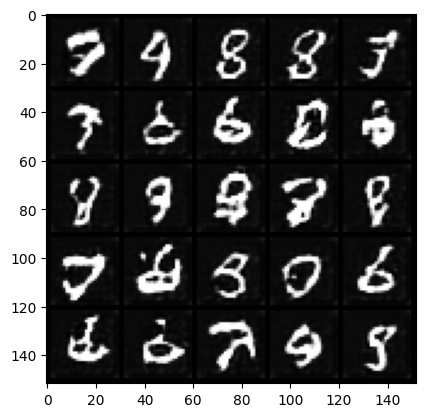

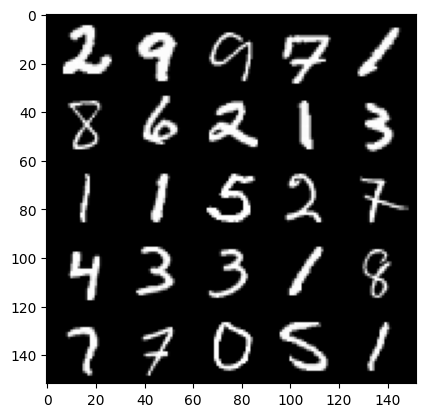

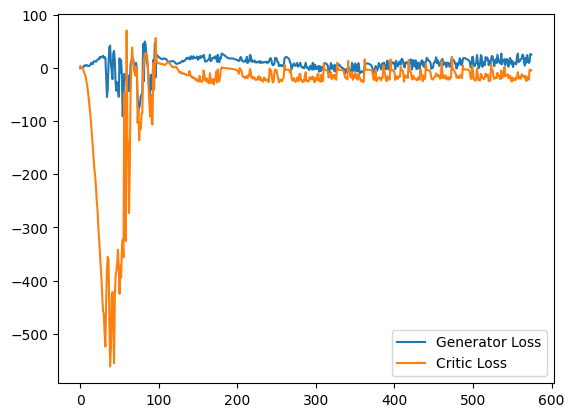

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06158597022294998
real: -19.85223960876465, fake: -25.4106502532959, regularization: 0.6158596873283386
crit_loss: torch.Size([]) -4.942551136016846
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06222333386540413
real: -19.83698272705078, fake: -25.453086853027344, regularization: 0.6222333312034607
crit_loss: torch.Size([]) -4.993870735168457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06452888250350952
real: -19.837100982666016, fake: -25.80893325805664, regularization: 0.6452888250350952
crit_loss: torch.Size([]) -5.32654333114624
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04591146856546402
real: -19.780643463134766, fake: -25.66613006591797, regularization: 0.459114670753479
crit_loss: torch.Size([]) -5.426372051239014
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0382084883749485
real: -19.78135108947754, fake: -25.14617919921875, regularization: 0.3820848762989044
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11037540435791016
real: -16.271249771118164, fake: -22.84830093383789, regularization: 1.1037540435791016
crit_loss: torch.Size([]) -5.473297119140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09392387419939041
real: -16.16950225830078, fake: -22.719749450683594, regularization: 0.9392387270927429
crit_loss: torch.Size([]) -5.611008644104004
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08448100090026855
real: -16.060596466064453, fake: -22.569198608398438, regularization: 0.8448100090026855
crit_loss: torch.Size([]) -5.663792133331299
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0717848613858223
real: -16.642169952392578, fake: -22.441246032714844, regularization: 0.7178485989570618
crit_loss: torch.Size([]) -5.0812273025512695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05686841532588005
real: -16.471729278564453, fake: -22.584007263183594, regularization: 0.568684160

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2558595538139343
real: 24.487396240234375, fake: 0.6526126861572266, regularization: 2.558595657348633
crit_loss: torch.Size([]) -21.276187896728516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29595112800598145
real: 21.354101181030273, fake: 5.302785873413086, regularization: 2.9595112800598145
crit_loss: torch.Size([]) -13.091804504394531
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31546956300735474
real: 25.86655044555664, fake: 9.19642448425293, regularization: 3.154695510864258
crit_loss: torch.Size([]) -13.515430450439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3552873134613037
real: 26.15199851989746, fake: 4.5130181312561035, regularization: 3.552873134613037
crit_loss: torch.Size([]) -18.08610725402832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46469318866729736
real: 25.973270416259766, fake: 2.846433162689209, regularization: 4.6469316482543945
crit_los

penalty: torch.Size([]) 0.6721645593643188
real: 29.009326934814453, fake: -2.09713077545166, regularization: 6.721645355224609
crit_loss: torch.Size([]) -24.384811401367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4456750750541687
real: -0.5027938485145569, fake: 7.298956871032715, regularization: 4.456750869750977
crit_loss: torch.Size([]) 12.258501052856445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24860119819641113
real: 12.067462921142578, fake: 10.351806640625, regularization: 2.4860119819641113
crit_loss: torch.Size([]) 0.7703557014465332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4336506128311157
real: 30.89659881591797, fake: -5.503567218780518, regularization: 4.336505889892578
crit_loss: torch.Size([]) -32.06365966796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28648191690444946
real: 11.526561737060547, fake: -13.89921760559082, regularization: 2.864819049835205
crit_loss: torch.Size([]) -22.56096076965332

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23175300657749176
real: -15.40751838684082, fake: -22.49413299560547, regularization: 2.3175301551818848
crit_loss: torch.Size([]) -4.769084453582764
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18440362811088562
real: -16.204795837402344, fake: -21.840831756591797, regularization: 1.844036340713501
crit_loss: torch.Size([]) -3.791999578475952
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2581646740436554
real: -16.726917266845703, fake: -25.248146057128906, regularization: 2.581646680831909
crit_loss: torch.Size([]) -5.939581871032715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21648412942886353
real: -17.688152313232422, fake: -23.21474838256836, regularization: 2.1648411750793457
crit_loss: torch.Size([]) -3.361754894256592
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1215181052684784
real: -17.63751220703125, fake: -25.874181747436523, regularization: 1.215181112289428

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13140711188316345
real: -12.283699035644531, fake: -19.50516128540039, regularization: 1.3140711784362793
crit_loss: torch.Size([]) -5.90739107131958
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4019370675086975
real: -2.2276432514190674, fake: -19.44674301147461, regularization: 4.0193705558776855
crit_loss: torch.Size([]) -13.199728012084961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25554513931274414
real: -2.046511650085449, fake: -20.30854034423828, regularization: 2.5554513931274414
crit_loss: torch.Size([]) -15.706576347351074
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17796188592910767
real: -2.3154845237731934, fake: -20.18976593017578, regularization: 1.7796188592910767
crit_loss: torch.Size([]) -16.094661712646484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29883143305778503
real: -1.3690227270126343, fake: -19.846805572509766, regularization: 2.98831439018

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12143450975418091
real: -1.0777485370635986, fake: -21.062599182128906, regularization: 1.214345097541809
crit_loss: torch.Size([]) -18.770503997802734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21619728207588196
real: 0.8863562941551208, fake: -15.516077041625977, regularization: 2.161972761154175
crit_loss: torch.Size([]) -14.240460395812988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21309736371040344
real: -11.398994445800781, fake: -16.21959686279297, regularization: 2.1309735774993896
crit_loss: torch.Size([]) -2.689628839492798
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.676561713218689
real: 1.8893465995788574, fake: -11.473402976989746, regularization: 6.765617370605469
crit_loss: torch.Size([]) -6.597131729125977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34400731325149536
real: 6.139105796813965, fake: -12.009479522705078, regularization: 3.440073013305664

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8155021667480469
real: 48.113555908203125, fake: 19.497703552246094, regularization: 8.155021667480469
crit_loss: torch.Size([]) -20.460830688476562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6513873934745789
real: 38.09351348876953, fake: -4.77596378326416, regularization: 6.513874053955078
crit_loss: torch.Size([]) -36.3556022644043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25351351499557495
real: 24.358840942382812, fake: -14.195550918579102, regularization: 2.535135269165039
crit_loss: torch.Size([]) -36.019256591796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.348565012216568
real: 44.3065299987793, fake: 1.9597415924072266, regularization: 3.485650062561035
crit_loss: torch.Size([]) -38.86113739013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17936740815639496
real: 11.230389595031738, fake: 7.423688888549805, regularization: 1.793674111366272
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4017481207847595
real: 28.043212890625, fake: -0.6763569116592407, regularization: 4.017481327056885
crit_loss: torch.Size([]) -24.702089309692383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14467909932136536
real: 5.424519062042236, fake: -1.1093933582305908, regularization: 1.4467909336090088
crit_loss: torch.Size([]) -5.087121963500977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3554479777812958
real: 16.29056739807129, fake: 3.618971824645996, regularization: 3.5544798374176025
crit_loss: torch.Size([]) -9.11711597442627
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18062034249305725
real: 37.17131423950195, fake: 11.291860580444336, regularization: 1.8062033653259277
crit_loss: torch.Size([]) -24.07324981689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35353583097457886
real: 22.866554260253906, fake: -8.193742752075195, regularization: 3.535358428955078
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4129948914051056
real: 6.509957313537598, fake: -34.928314208984375, regularization: 4.12994909286499
crit_loss: torch.Size([]) -37.30832290649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24511152505874634
real: 21.961074829101562, fake: -13.59788703918457, regularization: 2.451115131378174
crit_loss: torch.Size([]) -33.107845306396484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.307706356048584
real: 21.299821853637695, fake: -19.99505043029785, regularization: 3.07706356048584
crit_loss: torch.Size([]) -38.21780776977539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3033131957054138
real: -16.671533584594727, fake: -3.9731035232543945, regularization: 3.0331320762634277
crit_loss: torch.Size([]) 15.731561660766602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19138555228710175
real: -1.3139150142669678, fake: 5.658091068267822, regularization: 1.9138555526733398
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2109258770942688
real: 32.61549377441406, fake: 14.12722110748291, regularization: 2.1092586517333984
crit_loss: torch.Size([]) -16.37901496887207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10561324656009674
real: 33.452415466308594, fake: 17.01814079284668, regularization: 1.056132435798645
crit_loss: torch.Size([]) -15.378142356872559
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13550475239753723
real: 33.37635803222656, fake: 10.827345848083496, regularization: 1.3550474643707275
crit_loss: torch.Size([]) -21.1939640045166
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1618858277797699
real: 32.790096282958984, fake: 11.151318550109863, regularization: 1.6188583374023438
crit_loss: torch.Size([]) -20.019920349121094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1397019624710083
real: 31.40542984008789, fake: 8.888043403625488, regularization: 1.397019624710083
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4991999864578247
real: -30.351734161376953, fake: -34.93049621582031, regularization: 4.991999626159668
crit_loss: torch.Size([]) 0.4132375717163086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3739599585533142
real: -29.571165084838867, fake: -35.124755859375, regularization: 3.7395997047424316
crit_loss: torch.Size([]) -1.8139910697937012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8879685401916504
real: -25.920429229736328, fake: -37.17008972167969, regularization: 8.879685401916504
crit_loss: torch.Size([]) -2.3699750900268555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38430795073509216
real: -24.622364044189453, fake: -33.603275299072266, regularization: 3.8430795669555664
crit_loss: torch.Size([]) -5.137831687927246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44672876596450806
real: -24.40582847595215, fake: -34.158729553222656, regularization: 4.467287540435791


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09387898445129395
real: 29.95286750793457, fake: 3.601409912109375, regularization: 0.9387898445129395
crit_loss: torch.Size([]) -25.412668228149414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12212848663330078
real: 16.821805953979492, fake: -6.6893310546875, regularization: 1.2212848663330078
crit_loss: torch.Size([]) -22.289852142333984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21288342773914337
real: 19.243242263793945, fake: -9.825333595275879, regularization: 2.1288342475891113
crit_loss: torch.Size([]) -26.939743041992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1580885946750641
real: 28.314603805541992, fake: 1.2036807537078857, regularization: 1.580885887145996
crit_loss: torch.Size([]) -25.53003692626953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0849061906337738
real: 26.953022003173828, fake: 9.408568382263184, regularization: 0.849061906337738
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16647040843963623
real: 27.448806762695312, fake: -20.525245666503906, regularization: 1.6647040843963623
crit_loss: torch.Size([]) -46.309349060058594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05774620920419693
real: 21.794841766357422, fake: -14.333641052246094, regularization: 0.5774620771408081
crit_loss: torch.Size([]) -35.551021575927734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30606579780578613
real: 42.19585037231445, fake: 11.594934463500977, regularization: 3.0606579780578613
crit_loss: torch.Size([]) -27.540258407592773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17948248982429504
real: 28.791595458984375, fake: -8.736488342285156, regularization: 1.7948248386383057
crit_loss: torch.Size([]) -35.73325729370117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16368408501148224
real: 25.63258934020996, fake: -15.311897277832031, regularization: 1.6368408203125

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20052240788936615
real: -28.881107330322266, fake: -33.984683990478516, regularization: 2.0052239894866943
crit_loss: torch.Size([]) -3.0983526706695557
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28069090843200684
real: -29.699522018432617, fake: -35.08147430419922, regularization: 2.8069090843200684
crit_loss: torch.Size([]) -2.575043201446533
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3345051407814026
real: -30.4400634765625, fake: -34.10826110839844, regularization: 3.3450512886047363
crit_loss: torch.Size([]) -0.32314634323120117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5565605163574219
real: -22.292644500732422, fake: -41.047367095947266, regularization: 5.565605163574219
crit_loss: torch.Size([]) -13.189117431640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46728312969207764
real: -2.3241708278656006, fake: -27.989334106445312, regularization: 4.6728315353

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0682559460401535
real: -16.89766502380371, fake: -23.89456558227539, regularization: 0.6825594902038574
crit_loss: torch.Size([]) -6.314341068267822
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.047551825642585754
real: -16.568077087402344, fake: -23.02353286743164, regularization: 0.47551825642585754
crit_loss: torch.Size([]) -5.979937553405762
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06502128392457962
real: -16.415372848510742, fake: -22.977985382080078, regularization: 0.650212824344635
crit_loss: torch.Size([]) -5.912399768829346
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06049763783812523
real: -16.320587158203125, fake: -22.55963897705078, regularization: 0.6049763560295105
crit_loss: torch.Size([]) -5.63407564163208
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06230218708515167
real: -16.35308074951172, fake: -23.91278076171875, regularization: 0.62302184104919

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11328775435686111
real: -1.9104893207550049, fake: -17.232135772705078, regularization: 1.1328775882720947
crit_loss: torch.Size([]) -14.188769340515137
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13983801007270813
real: 0.10253486037254333, fake: -17.68810272216797, regularization: 1.3983800411224365
crit_loss: torch.Size([]) -16.392257690429688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08805203437805176
real: -7.050634384155273, fake: -13.72643756866455, regularization: 0.8805203437805176
crit_loss: torch.Size([]) -5.79528284072876
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14596062898635864
real: -6.763082504272461, fake: -15.257347106933594, regularization: 1.4596062898635864
crit_loss: torch.Size([]) -7.034658432006836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15707489848136902
real: -6.814558029174805, fake: -14.795350074768066, regularization: 1.57074904441

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08726745843887329
real: 29.64702033996582, fake: -15.180152893066406, regularization: 0.8726745843887329
crit_loss: torch.Size([]) -43.954498291015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15897710621356964
real: 28.646949768066406, fake: -12.273982048034668, regularization: 1.589771032333374
crit_loss: torch.Size([]) -39.33116149902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1782325655221939
real: 25.67230987548828, fake: -18.89691162109375, regularization: 1.7823256254196167
crit_loss: torch.Size([]) -42.786895751953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19589470326900482
real: 30.77250099182129, fake: -10.963393211364746, regularization: 1.9589470624923706
crit_loss: torch.Size([]) -39.776947021484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1264609545469284
real: 26.35940170288086, fake: -11.707426071166992, regularization: 1.2646095752716064


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1761353313922882
real: 32.07831573486328, fake: 9.523809432983398, regularization: 1.7613532543182373
crit_loss: torch.Size([]) -20.793153762817383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12029044330120087
real: 31.301071166992188, fake: 10.417672157287598, regularization: 1.202904462814331
crit_loss: torch.Size([]) -19.680496215820312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12588052451610565
real: 29.833576202392578, fake: 8.053747177124023, regularization: 1.258805274963379
crit_loss: torch.Size([]) -20.52102279663086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13669534027576447
real: 25.96997833251953, fake: 4.6889801025390625, regularization: 1.3669533729553223
crit_loss: torch.Size([]) -19.914045333862305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09849858283996582
real: 29.971202850341797, fake: 6.114794731140137, regularization: 0.9849858283996582
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43194493651390076
real: -12.220222473144531, fake: -32.05492401123047, regularization: 4.319449424743652
crit_loss: torch.Size([]) -15.515252113342285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14254096150398254
real: -12.970958709716797, fake: -36.33167266845703, regularization: 1.4254095554351807
crit_loss: torch.Size([]) -21.935304641723633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25416263937950134
real: -17.067771911621094, fake: -42.95970916748047, regularization: 2.541626453399658
crit_loss: torch.Size([]) -23.350311279296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2978167235851288
real: -25.571826934814453, fake: -40.83147430419922, regularization: 2.9781672954559326
crit_loss: torch.Size([]) -12.281479835510254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16068825125694275
real: -20.790264129638672, fake: -36.652008056640625, regularization: 1.6068825721

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3250749111175537
real: -0.1613457202911377, fake: -9.00374984741211, regularization: 3.250749111175537
crit_loss: torch.Size([]) -5.591655254364014
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4846361577510834
real: 2.1456995010375977, fake: -13.088448524475098, regularization: 4.8463616371154785
crit_loss: torch.Size([]) -10.387786865234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2903739809989929
real: 5.862736701965332, fake: -7.875711441040039, regularization: 2.9037399291992188
crit_loss: torch.Size([]) -10.834708213806152
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33916327357292175
real: 9.707693099975586, fake: -8.503225326538086, regularization: 3.3916327953338623
crit_loss: torch.Size([]) -14.81928539276123
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19038084149360657
real: 8.620290756225586, fake: -10.404348373413086, regularization: 1.903808355331421
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1092185452580452
real: 7.611374378204346, fake: -21.75334358215332, regularization: 1.0921854972839355
crit_loss: torch.Size([]) -28.272531509399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21372535824775696
real: 13.979761123657227, fake: -15.305103302001953, regularization: 2.137253522872925
crit_loss: torch.Size([]) -27.147611618041992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1265885829925537
real: -12.228772163391113, fake: -6.219348907470703, regularization: 1.265885829925537
crit_loss: torch.Size([]) 7.275309085845947
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1215813010931015
real: -4.6764044761657715, fake: -2.9550750255584717, regularization: 1.2158130407333374
crit_loss: torch.Size([]) 2.9371423721313477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17824172973632812
real: 15.283899307250977, fake: -5.805113792419434, regularization: 1.7824172973632812
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1371382474899292
real: 19.55501365661621, fake: -1.9787477254867554, regularization: 1.371382474899292
crit_loss: torch.Size([]) -20.16238021850586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13414785265922546
real: 23.417442321777344, fake: 0.03695964813232422, regularization: 1.3414785861968994
crit_loss: torch.Size([]) -22.039003372192383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17307433485984802
real: 18.87122917175293, fake: -9.466529846191406, regularization: 1.730743408203125
crit_loss: torch.Size([]) -26.60701560974121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29128873348236084
real: 15.938690185546875, fake: -7.1696882247924805, regularization: 2.9128873348236084
crit_loss: torch.Size([]) -20.195491790771484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18859776854515076
real: -6.882323741912842, fake: -6.618021011352539, regularization: 1.8859777450561523


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11788539588451385
real: -17.29730796813965, fake: -31.769500732421875, regularization: 1.178853988647461
crit_loss: torch.Size([]) -13.293338775634766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1879439502954483
real: -15.525415420532227, fake: -32.465476989746094, regularization: 1.8794394731521606
crit_loss: torch.Size([]) -15.060622215270996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19732922315597534
real: -16.085134506225586, fake: -37.513893127441406, regularization: 1.9732922315597534
crit_loss: torch.Size([]) -19.455467224121094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18396224081516266
real: -16.941341400146484, fake: -40.44776153564453, regularization: 1.8396223783493042
crit_loss: torch.Size([]) -21.666797637939453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4764357805252075
real: -18.18910026550293, fake: -45.8577995300293, regularization: 4.76435756683

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12066176533699036
real: -10.476383209228516, fake: -24.791946411132812, regularization: 1.2066175937652588
crit_loss: torch.Size([]) -13.108945846557617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14708924293518066
real: -11.459939002990723, fake: -25.893434524536133, regularization: 1.4708924293518066
crit_loss: torch.Size([]) -12.962602615356445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11459678411483765
real: -13.2901611328125, fake: -29.159523010253906, regularization: 1.1459678411483765
crit_loss: torch.Size([]) -14.723394393920898
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15903806686401367
real: -15.482452392578125, fake: -33.98112869262695, regularization: 1.5903806686401367
crit_loss: torch.Size([]) -16.908294677734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2635500431060791
real: -17.33724021911621, fake: -36.127506256103516, regularization: 2.63550043

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18374507129192352
real: 23.644760131835938, fake: -6.6720871925354, regularization: 1.8374507427215576
crit_loss: torch.Size([]) -28.47939682006836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.307426393032074
real: 11.984777450561523, fake: -9.970977783203125, regularization: 3.0742640495300293
crit_loss: torch.Size([]) -18.88149070739746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17772723734378815
real: -8.016032218933105, fake: -9.237401962280273, regularization: 1.777272343635559
crit_loss: torch.Size([]) 0.5559026002883911
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3831489682197571
real: -6.430421829223633, fake: -12.561439514160156, regularization: 3.8314895629882812
crit_loss: torch.Size([]) -2.299528121948242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2251666784286499
real: 1.5658941268920898, fake: -4.729720592498779, regularization: 2.251666784286499
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2685076892375946
real: 16.38184356689453, fake: -20.736589431762695, regularization: 2.685076951980591
crit_loss: torch.Size([]) -34.433353424072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15265953540802002
real: 20.173141479492188, fake: -15.162996292114258, regularization: 1.5265953540802002
crit_loss: torch.Size([]) -33.809539794921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3227511942386627
real: 16.867721557617188, fake: -11.113312721252441, regularization: 3.2275118827819824
crit_loss: torch.Size([]) -24.753520965576172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22147144377231598
real: 13.998400688171387, fake: -26.116985321044922, regularization: 2.214714527130127
crit_loss: torch.Size([]) -37.900672912597656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22280195355415344
real: 4.825150012969971, fake: -11.92767333984375, regularization: 2.228019475936889

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15393489599227905
real: 17.12436294555664, fake: -26.475278854370117, regularization: 1.5393489599227905
crit_loss: torch.Size([]) -42.0602912902832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21342943608760834
real: 18.073123931884766, fake: -20.378864288330078, regularization: 2.134294271469116
crit_loss: torch.Size([]) -36.31769561767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1140444427728653
real: 10.084781646728516, fake: -31.07301902770996, regularization: 1.1404443979263306
crit_loss: torch.Size([]) -40.01735305786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33560192584991455
real: 17.815200805664062, fake: -26.750329971313477, regularization: 3.3560192584991455
crit_loss: torch.Size([]) -41.209510803222656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1095290556550026
real: 20.213224411010742, fake: -27.492538452148438, regularization: 1.0952905416488647


crit_loss: torch.Size([]) -16.97011947631836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14005909860134125
real: 22.096525192260742, fake: 6.119466304779053, regularization: 1.4005910158157349
crit_loss: torch.Size([]) -14.576467514038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08954599499702454
real: 24.520660400390625, fake: 6.5620198249816895, regularization: 0.8954599499702454
crit_loss: torch.Size([]) -17.063180923461914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18034696578979492
real: 22.916534423828125, fake: 3.7655744552612305, regularization: 1.8034696578979492
crit_loss: torch.Size([]) -17.347488403320312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1800510734319687
real: 21.32738494873047, fake: 0.05375698208808899, regularization: 1.8005107641220093
crit_loss: torch.Size([]) -19.47311782836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20047543942928314
real: 11.216044425964355, fake: 4.1956219

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0537494421005249
real: -21.39545440673828, fake: -33.11011505126953, regularization: 0.537494421005249
crit_loss: torch.Size([]) -11.177165985107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11405704915523529
real: -20.810949325561523, fake: -33.94499969482422, regularization: 1.1405705213546753
crit_loss: torch.Size([]) -11.99347972869873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0798691064119339
real: -20.191726684570312, fake: -30.335796356201172, regularization: 0.7986910343170166
crit_loss: torch.Size([]) -9.345378875732422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09840111434459686
real: -27.698562622070312, fake: -29.972135543823242, regularization: 0.984011173248291
crit_loss: torch.Size([]) -1.2895617485046387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11375061422586441
real: -26.106990814208984, fake: -29.27251625061035, regularization: 1.1375061273574

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09882248938083649
real: 26.687602996826172, fake: 3.203413963317871, regularization: 0.9882248640060425
crit_loss: torch.Size([]) -22.49596405029297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17250967025756836
real: 34.08660125732422, fake: 10.703958511352539, regularization: 1.7250967025756836
crit_loss: torch.Size([]) -21.657546997070312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12815111875534058
real: 30.372478485107422, fake: 4.30111026763916, regularization: 1.2815111875534058
crit_loss: torch.Size([]) -24.789857864379883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10676886141300201
real: 19.740215301513672, fake: -10.224430084228516, regularization: 1.0676885843276978
crit_loss: torch.Size([]) -28.896957397460938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15351995825767517
real: 29.75773048400879, fake: 1.6093356609344482, regularization: 1.5351996421813965
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23302343487739563
real: 18.847698211669922, fake: 3.699152946472168, regularization: 2.3302342891693115
crit_loss: torch.Size([]) -12.818310737609863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17559358477592468
real: 8.316904067993164, fake: -19.231163024902344, regularization: 1.7559359073638916
crit_loss: torch.Size([]) -25.792131423950195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24276454746723175
real: 3.070709228515625, fake: -20.97072982788086, regularization: 2.427645444869995
crit_loss: torch.Size([]) -21.613794326782227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12588877975940704
real: -20.141712188720703, fake: -0.20881861448287964, regularization: 1.258887767791748
crit_loss: torch.Size([]) 21.191781997680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20375415682792664
real: -23.32372283935547, fake: -12.174171447753906, regularization: 2.03754162788391

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8818647265434265
real: -25.731290817260742, fake: -40.428375244140625, regularization: 8.818647384643555
crit_loss: torch.Size([]) -5.878437042236328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.7660913467407227
real: -26.255523681640625, fake: -46.16780471801758, regularization: 17.660913467407227
crit_loss: torch.Size([]) -2.2513675689697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.742569088935852
real: -25.20366668701172, fake: -39.765174865722656, regularization: 7.425690650939941
crit_loss: torch.Size([]) -7.135817527770996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8340590000152588
real: -22.343971252441406, fake: -38.578582763671875, regularization: 8.34058952331543
crit_loss: torch.Size([]) -7.894021987915039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.6789371967315674
real: -22.504745483398438, fake: -41.67010498046875, regularization: 16.789371490478516
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7222270369529724
real: -8.626838684082031, fake: -19.133445739746094, regularization: 7.222270488739014
crit_loss: torch.Size([]) -3.284336566925049
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6987249851226807
real: -6.470601558685303, fake: -19.709442138671875, regularization: 6.987249851226807
crit_loss: torch.Size([]) -6.251590251922607
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.0856494903564453
real: -4.174459457397461, fake: -18.751232147216797, regularization: 10.856494903564453
crit_loss: torch.Size([]) -3.720277786254883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9945548176765442
real: -5.26025915145874, fake: -16.526165008544922, regularization: 9.945548057556152
crit_loss: torch.Size([]) -1.320357322692871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.2350763082504272
real: -6.070887565612793, fake: -16.84231185913086, regularization: 12.350763320922852
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48911821842193604
real: -3.237057685852051, fake: -5.496833801269531, regularization: 4.891181945800781
crit_loss: torch.Size([]) 2.631405830383301
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.1816812753677368
real: -3.172229290008545, fake: -4.915125370025635, regularization: 11.816812515258789
crit_loss: torch.Size([]) 10.0739164352417
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47435131669044495
real: -1.6466795206069946, fake: -5.34995174407959, regularization: 4.743513107299805
crit_loss: torch.Size([]) 1.04024076461792
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5323920249938965
real: 1.6121002435684204, fake: -5.04583215713501, regularization: 5.323920249938965
crit_loss: torch.Size([]) -1.3340120315551758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3638363480567932
real: 0.6049740314483643, fake: -7.0522847175598145, regularization: 3.6383633613586426
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7170836329460144
real: 6.714507102966309, fake: -1.4560697078704834, regularization: 7.170836448669434
crit_loss: torch.Size([]) -0.9997406005859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2970465421676636
real: 3.248483419418335, fake: -5.057916164398193, regularization: 2.9704654216766357
crit_loss: torch.Size([]) -5.335933685302734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5839600563049316
real: 4.077396869659424, fake: -5.30522346496582, regularization: 5.839600563049316
crit_loss: torch.Size([]) -3.5430192947387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41878199577331543
real: 1.4059696197509766, fake: -2.979079008102417, regularization: 4.187819957733154
crit_loss: torch.Size([]) -0.19722890853881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37219905853271484
real: 0.7768345475196838, fake: -3.86276912689209, regularization: 3.7219905853271484
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19491399824619293
real: 2.8553316593170166, fake: -26.3557071685791, regularization: 1.949139952659607
crit_loss: torch.Size([]) -27.261898040771484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3628133535385132
real: 8.644669532775879, fake: -17.8839168548584, regularization: 3.628133535385132
crit_loss: torch.Size([]) -22.900453567504883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3077276349067688
real: 6.719490051269531, fake: -26.929344177246094, regularization: 3.0772762298583984
crit_loss: torch.Size([]) -30.571557998657227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2593466639518738
real: 4.066107749938965, fake: -13.984582901000977, regularization: 2.5934667587280273
crit_loss: torch.Size([]) -15.457222938537598
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.616091787815094
real: 8.839377403259277, fake: -9.742525100708008, regularization: 6.16091775894165
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31064969301223755
real: 20.53121566772461, fake: 2.5797247886657715, regularization: 3.106496810913086
crit_loss: torch.Size([]) -14.844993591308594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30131447315216064
real: 16.801166534423828, fake: 1.0122811794281006, regularization: 3.0131447315216064
crit_loss: torch.Size([]) -12.775740623474121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23116829991340637
real: 19.17404556274414, fake: 0.8259539008140564, regularization: 2.311682939529419
crit_loss: torch.Size([]) -16.036407470703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19481080770492554
real: 26.527528762817383, fake: -1.3308748006820679, regularization: 1.9481080770492554
crit_loss: torch.Size([]) -25.910295486450195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17478179931640625
real: 24.375202178955078, fake: -0.0025781095027923584, regularization: 1.747817993164

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23145008087158203
real: -28.928218841552734, fake: -34.157318115234375, regularization: 2.3145008087158203
crit_loss: torch.Size([]) -2.9145984649658203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19906911253929138
real: -29.31534767150879, fake: -34.65863800048828, regularization: 1.9906911849975586
crit_loss: torch.Size([]) -3.3525991439819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41915667057037354
real: -29.718109130859375, fake: -33.92463684082031, regularization: 4.191566467285156
crit_loss: torch.Size([]) -0.01496124267578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43151262402534485
real: -30.382415771484375, fake: -32.839725494384766, regularization: 4.315126419067383
crit_loss: torch.Size([]) 1.8578166961669922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3650771975517273
real: -29.582561492919922, fake: -32.783485412597656, regularization: 3.650772094

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21229365468025208
real: 20.454875946044922, fake: -5.814302921295166, regularization: 2.122936487197876
crit_loss: torch.Size([]) -24.146242141723633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18937087059020996
real: 19.457454681396484, fake: -8.872998237609863, regularization: 1.8937087059020996
crit_loss: torch.Size([]) -26.436742782592773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31926459074020386
real: 23.313711166381836, fake: -4.754167079925537, regularization: 3.192646026611328
crit_loss: torch.Size([]) -24.875232696533203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18089209496974945
real: 26.83274269104004, fake: -5.495452880859375, regularization: 1.808920979499817
crit_loss: torch.Size([]) -30.519271850585938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17356513440608978
real: 18.590347290039062, fake: -10.019734382629395, regularization: 1.7356513738632202

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12398044764995575
real: 38.91670227050781, fake: 11.91584587097168, regularization: 1.2398045063018799
crit_loss: torch.Size([]) -25.761051177978516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14815303683280945
real: 38.292694091796875, fake: 18.34988021850586, regularization: 1.4815304279327393
crit_loss: torch.Size([]) -18.46128273010254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1726776361465454
real: 36.853668212890625, fake: 10.519807815551758, regularization: 1.726776361465454
crit_loss: torch.Size([]) -24.607084274291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2567846179008484
real: 25.638694763183594, fake: 7.409499645233154, regularization: 2.5678462982177734
crit_loss: torch.Size([]) -15.661348342895508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45722419023513794
real: 27.47503089904785, fake: 8.633394241333008, regularization: 4.57224178314209
crit_los

penalty: torch.Size([]) 0.1689164787530899
real: 22.366966247558594, fake: -7.417351245880127, regularization: 1.6891647577285767
crit_loss: torch.Size([]) -28.095151901245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09082835167646408
real: 19.4587345123291, fake: -3.1322665214538574, regularization: 0.908283531665802
crit_loss: torch.Size([]) -21.68271827697754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1815418303012848
real: 24.249053955078125, fake: -8.246438026428223, regularization: 1.8154182434082031
crit_loss: torch.Size([]) -30.680072784423828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14237746596336365
real: -3.4437713623046875, fake: 6.426288604736328, regularization: 1.4237747192382812
crit_loss: torch.Size([]) 11.293834686279297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18451626598834991
real: 16.20147705078125, fake: -0.2824079990386963, regularization: 1.8451626300811768
crit_loss: torch.Size([]) -14.63872

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09762795269489288
real: -19.711700439453125, fake: -30.64901351928711, regularization: 0.9762794971466064
crit_loss: torch.Size([]) -9.961033821105957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09383774548768997
real: -20.508113861083984, fake: -31.692981719970703, regularization: 0.9383774399757385
crit_loss: torch.Size([]) -10.246490478515625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19868314266204834
real: -21.1011905670166, fake: -32.9254035949707, regularization: 1.9868314266204834
crit_loss: torch.Size([]) -9.837381362915039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2954453229904175
real: -20.694337844848633, fake: -34.242759704589844, regularization: 2.954453229904175
crit_loss: torch.Size([]) -10.593968391418457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08380953967571259
real: -19.43470001220703, fake: -31.505416870117188, regularization: 0.8380954265594

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5638105273246765
real: -32.625343322753906, fake: -40.79256057739258, regularization: 5.638105392456055
crit_loss: torch.Size([]) -2.529111862182617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5969455242156982
real: -31.151962280273438, fake: -38.995670318603516, regularization: 5.969455242156982
crit_loss: torch.Size([]) -1.8742527961730957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9369555711746216
real: -31.639062881469727, fake: -38.62254333496094, regularization: 9.369555473327637
crit_loss: torch.Size([]) 2.386075019836426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.35596972703933716
real: -31.08993148803711, fake: -40.421539306640625, regularization: 3.559697151184082
crit_loss: torch.Size([]) -5.771910667419434
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5036741495132446
real: -30.706010818481445, fake: -39.21809387207031, regularization: 5.036741256713867
cri

crit_loss: torch.Size([]) -3.0422778129577637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5986534357070923
real: -10.125490188598633, fake: -16.11922836303711, regularization: 5.986534118652344
crit_loss: torch.Size([]) -0.0072040557861328125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3909968137741089
real: -8.386497497558594, fake: -14.83084487915039, regularization: 3.909968137741089
crit_loss: torch.Size([]) -2.534379243850708
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.38309958577156067
real: -8.72284984588623, fake: -15.470756530761719, regularization: 3.830995798110962
crit_loss: torch.Size([]) -2.9169108867645264
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44555404782295227
real: -8.241870880126953, fake: -15.569623947143555, regularization: 4.455540657043457
crit_loss: torch.Size([]) -2.8722124099731445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4020271599292755
real: -6.179862976074219, fake: -15.7558

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12174640595912933
real: 13.516486167907715, fake: -18.53293800354004, regularization: 1.2174640893936157
crit_loss: torch.Size([]) -30.831958770751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1872982531785965
real: 17.07630729675293, fake: -15.725109100341797, regularization: 1.8729825019836426
crit_loss: torch.Size([]) -30.92843246459961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17314159870147705
real: 20.24112319946289, fake: -16.826677322387695, regularization: 1.7314159870147705
crit_loss: torch.Size([]) -35.336387634277344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24438562989234924
real: 11.041898727416992, fake: -8.685184478759766, regularization: 2.4438562393188477
crit_loss: torch.Size([]) -17.283226013183594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12386269867420197
real: 23.99172019958496, fake: -0.20423264801502228, regularization: 1.23862695693969

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.3861372470855713
real: -9.337930679321289, fake: -27.946063995361328, regularization: 13.861371994018555
crit_loss: torch.Size([]) -4.746761322021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15408262610435486
real: -12.815388679504395, fake: -39.03509521484375, regularization: 1.5408263206481934
crit_loss: torch.Size([]) -24.67888069152832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17856107652187347
real: -13.341751098632812, fake: -35.481834411621094, regularization: 1.7856107950210571
crit_loss: torch.Size([]) -20.354473114013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5872237682342529
real: -11.170028686523438, fake: -32.06901550292969, regularization: 5.872237682342529
crit_loss: torch.Size([]) -15.026748657226562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26506075263023376
real: -4.5213727951049805, fake: -27.247859954833984, regularization: 2.65060758590

penalty: torch.Size([]) 0.13484029471874237
real: 6.633235454559326, fake: -20.71230697631836, regularization: 1.348402976989746
crit_loss: torch.Size([]) -25.99713897705078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4630448818206787
real: 12.294227600097656, fake: -21.75344467163086, regularization: 4.630448818206787
crit_loss: torch.Size([]) -29.41722297668457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14152035117149353
real: -13.757078170776367, fake: -25.35112190246582, regularization: 1.41520357131958
crit_loss: torch.Size([]) -10.178840637207031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12373252958059311
real: -14.824066162109375, fake: -26.362119674682617, regularization: 1.2373253107070923
crit_loss: torch.Size([]) -10.300727844238281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21663829684257507
real: -14.537927627563477, fake: -25.915021896362305, regularization: 2.1663830280303955
crit_loss: torch.Size([]) -9.210

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20932932198047638
real: 40.10191345214844, fake: 15.864346504211426, regularization: 2.0932931900024414
crit_loss: torch.Size([]) -22.144275665283203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20651507377624512
real: 33.963706970214844, fake: 2.1652607917785645, regularization: 2.065150737762451
crit_loss: torch.Size([]) -29.733295440673828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3675779402256012
real: 23.094417572021484, fake: -14.19833755493164, regularization: 3.675779342651367
crit_loss: torch.Size([]) -33.616973876953125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.184105783700943
real: 37.51545715332031, fake: 1.4287419319152832, regularization: 1.8410577774047852
crit_loss: torch.Size([]) -34.24565887451172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14233100414276123
real: 30.995197296142578, fake: 2.6403095722198486, regularization: 1.4233100414276123
crit

crit_loss: torch.Size([]) -21.673683166503906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11052082479000092
real: -3.055147409439087, fake: 3.185067653656006, regularization: 1.1052082777023315
crit_loss: torch.Size([]) 7.345423698425293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1461770087480545
real: 20.092966079711914, fake: -6.922107696533203, regularization: 1.4617700576782227
crit_loss: torch.Size([]) -25.553302764892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20674191415309906
real: -13.044220924377441, fake: -32.82237243652344, regularization: 2.0674190521240234
crit_loss: torch.Size([]) -17.71073341369629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1370944082736969
real: -9.933661460876465, fake: -30.028833389282227, regularization: 1.3709440231323242
crit_loss: torch.Size([]) -18.724227905273438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28949403762817383
real: 14.274203300476074, fake: -21.86021

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12215384095907211
real: -19.309040069580078, fake: -31.484722137451172, regularization: 1.2215384244918823
crit_loss: torch.Size([]) -10.954143524169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12681575119495392
real: -19.17768669128418, fake: -32.25699996948242, regularization: 1.2681574821472168
crit_loss: torch.Size([]) -11.811155319213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15093302726745605
real: -19.00079345703125, fake: -32.00336456298828, regularization: 1.5093302726745605
crit_loss: torch.Size([]) -11.493240356445312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09832852333784103
real: -17.8158016204834, fake: -28.619335174560547, regularization: 0.9832852482795715
crit_loss: torch.Size([]) -9.8202486038208
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12612588703632355
real: -18.340892791748047, fake: -29.690696716308594, regularization: 1.261258840560

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15036329627037048
real: 30.530872344970703, fake: 5.0290021896362305, regularization: 1.5036330223083496
crit_loss: torch.Size([]) -23.99823570251465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17167872190475464
real: 27.0885066986084, fake: 0.166517436504364, regularization: 1.7167872190475464
crit_loss: torch.Size([]) -25.205202102661133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24189493060112
real: 29.617691040039062, fake: -0.2637535035610199, regularization: 2.4189493656158447
crit_loss: torch.Size([]) -27.462495803833008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2007954716682434
real: 31.996442794799805, fake: 4.015523433685303, regularization: 2.0079545974731445
crit_loss: torch.Size([]) -25.972965240478516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4723159372806549
real: 30.29190444946289, fake: -0.43573683500289917, regularization: 4.723159313201904
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2572973966598511
real: -10.577973365783691, fake: -24.4354248046875, regularization: 2.5729739665985107
crit_loss: torch.Size([]) -11.284477233886719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12568113207817078
real: -8.97562313079834, fake: -22.96746826171875, regularization: 1.2568113803863525
crit_loss: torch.Size([]) -12.735033988952637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21155771613121033
real: -8.197775840759277, fake: -22.20201301574707, regularization: 2.115577220916748
crit_loss: torch.Size([]) -11.888660430908203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16860300302505493
real: -30.989063262939453, fake: -22.80945587158203, regularization: 1.6860300302505493
crit_loss: torch.Size([]) 9.86563777923584
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.590024471282959
real: -10.47563362121582, fake: -16.39134979248047, regularization: 5.90024471282959
crit_

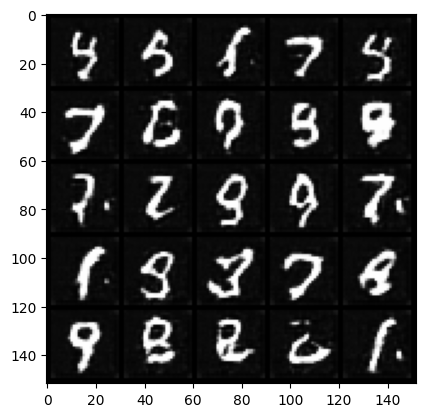

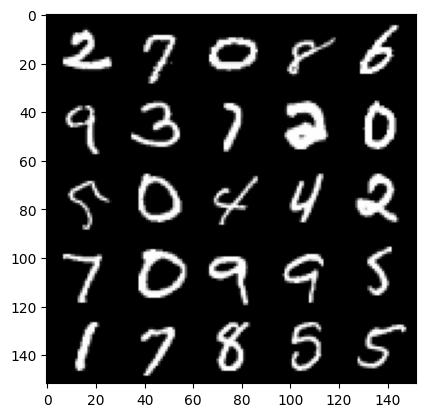

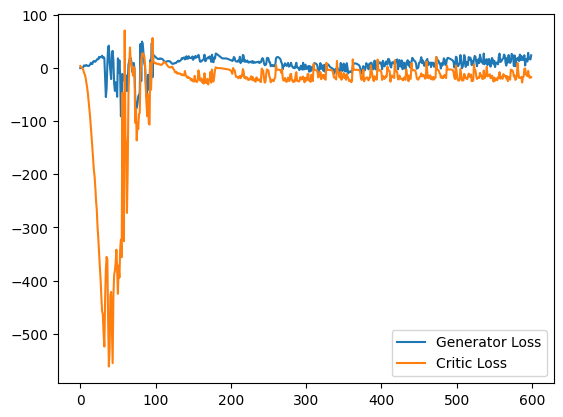

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14757294952869415
real: 1.5885087251663208, fake: -12.87536334991455, regularization: 1.4757294654846191
crit_loss: torch.Size([]) -12.988142013549805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12639403343200684
real: 7.400949954986572, fake: -13.729133605957031, regularization: 1.2639403343200684
crit_loss: torch.Size([]) -19.86614227294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2663772702217102
real: 29.588119506835938, fake: 4.456264495849609, regularization: 2.6637725830078125
crit_loss: torch.Size([]) -22.468082427978516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2571243345737457
real: 36.16931915283203, fake: 6.313803195953369, regularization: 2.5712432861328125
crit_loss: torch.Size([]) -27.284273147583008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1786814033985138
real: 31.070411682128906, fake: 1.9786334037780762, regularization: 1.7868139743804932
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09028946608304977
real: 11.49361801147461, fake: -8.662233352661133, regularization: 0.9028946757316589
crit_loss: torch.Size([]) -19.25295639038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09442391991615295
real: 11.325581550598145, fake: -12.776095390319824, regularization: 0.9442391991615295
crit_loss: torch.Size([]) -23.157438278198242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1769472360610962
real: 23.658061981201172, fake: 5.065576076507568, regularization: 1.769472360610962
crit_loss: torch.Size([]) -16.823013305664062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10795953869819641
real: 32.636756896972656, fake: 11.346016883850098, regularization: 1.0795953273773193
crit_loss: torch.Size([]) -20.211145401000977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14662307500839233
real: 29.704160690307617, fake: 2.675626754760742, regularization: 1.4662307500839233
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16324101388454437
real: 0.20532280206680298, fake: -13.57845687866211, regularization: 1.6324101686477661
crit_loss: torch.Size([]) -12.15137004852295
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18029093742370605
real: 3.792233943939209, fake: -11.841328620910645, regularization: 1.8029093742370605
crit_loss: torch.Size([]) -13.830652236938477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18907131254673004
real: 2.212498426437378, fake: -15.102058410644531, regularization: 1.890713095664978
crit_loss: torch.Size([]) -15.423843383789062
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23036499321460724
real: 1.419844388961792, fake: -16.98748207092285, regularization: 2.30364990234375
crit_loss: torch.Size([]) -16.103675842285156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14579179883003235
real: 4.417269706726074, fake: -14.611790657043457, regularization: 1.4579179286956787


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09313102811574936
real: -17.694637298583984, fake: -24.91659164428711, regularization: 0.9313102960586548
crit_loss: torch.Size([]) -6.29064416885376
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14616483449935913
real: -17.68795394897461, fake: -25.649370193481445, regularization: 1.4616483449935913
crit_loss: torch.Size([]) -6.499767780303955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23719319701194763
real: -16.523900985717773, fake: -26.53631591796875, regularization: 2.371932029724121
crit_loss: torch.Size([]) -7.6404829025268555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13188126683235168
real: -16.200742721557617, fake: -26.678096771240234, regularization: 1.318812608718872
crit_loss: torch.Size([]) -9.158541679382324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1348395049571991
real: -15.833532333374023, fake: -26.302263259887695, regularization: 1.3483951091766

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17531827092170715
real: 1.9695779085159302, fake: -12.804282188415527, regularization: 1.7531826496124268
crit_loss: torch.Size([]) -13.02067756652832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11052766442298889
real: 7.231808662414551, fake: -11.580877304077148, regularization: 1.1052765846252441
crit_loss: torch.Size([]) -17.70741081237793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25153830647468567
real: 15.872756958007812, fake: -6.4614105224609375, regularization: 2.515383005142212
crit_loss: torch.Size([]) -19.818784713745117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13609960675239563
real: 20.019132614135742, fake: -3.3708276748657227, regularization: 1.3609960079193115
crit_loss: torch.Size([]) -22.02896499633789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41229528188705444
real: 9.329587936401367, fake: -1.903523564338684, regularization: 4.122952938079834

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15885470807552338
real: 29.14502716064453, fake: 9.335351943969727, regularization: 1.5885471105575562
crit_loss: torch.Size([]) -18.221128463745117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14443829655647278
real: -1.846812129020691, fake: 5.023765563964844, regularization: 1.444382905960083
crit_loss: torch.Size([]) 8.314960479736328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2035323977470398
real: 5.467620372772217, fake: 2.317269802093506, regularization: 2.0353240966796875
crit_loss: torch.Size([]) -1.1150264739990234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2569736838340759
real: 25.41105842590332, fake: -16.14076042175293, regularization: 2.569736957550049
crit_loss: torch.Size([]) -38.98208236694336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8091229796409607
real: 7.789939880371094, fake: -29.58283042907715, regularization: 8.091229438781738
crit_loss: t

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32940980792045593
real: -7.713714599609375, fake: -6.263020992279053, regularization: 3.294098138809204
crit_loss: torch.Size([]) 4.7447919845581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20780937373638153
real: -6.705079078674316, fake: -13.16983413696289, regularization: 2.0780937671661377
crit_loss: torch.Size([]) -4.386661529541016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.47084301710128784
real: -9.105548858642578, fake: -24.7211856842041, regularization: 4.708430290222168
crit_loss: torch.Size([]) -10.907206535339355
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.578684389591217
real: -9.35456657409668, fake: -25.985855102539062, regularization: 5.786843776702881
crit_loss: torch.Size([]) -10.844444274902344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5300637483596802
real: 9.374824523925781, fake: -13.939083099365234, regularization: 5.300637245178223
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8130965232849121
real: -32.987640380859375, fake: -36.455162048339844, regularization: 8.130965232849121
crit_loss: torch.Size([]) 4.663443565368652
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.035593867301941
real: -27.81350326538086, fake: -29.182029724121094, regularization: 10.355938911437988
crit_loss: torch.Size([]) 8.987412452697754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.4239516258239746
real: -33.90162658691406, fake: -40.851287841796875, regularization: 24.239517211914062
crit_loss: torch.Size([]) 17.28985595703125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 5.158234119415283
real: -19.729450225830078, fake: -22.561702728271484, regularization: 51.582340240478516
crit_loss: torch.Size([]) 48.75008773803711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 18.97748565673828
real: -42.22696304321289, fake: -53.26908874511719, regularization: 189.7748565673828
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3921355605125427
real: 24.412395477294922, fake: -21.46987533569336, regularization: 3.921355724334717
crit_loss: torch.Size([]) -41.960914611816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4199884235858917
real: 13.207626342773438, fake: -30.113815307617188, regularization: 4.199884414672852
crit_loss: torch.Size([]) -39.121559143066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25765466690063477
real: -2.3214845657348633, fake: -2.1652040481567383, regularization: 2.5765466690063477
crit_loss: torch.Size([]) 2.7328271865844727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4129154086112976
real: 15.567667007446289, fake: 13.324143409729004, regularization: 4.129154205322266
crit_loss: torch.Size([]) 1.8856306076049805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27264049649238586
real: 30.969074249267578, fake: 6.1611809730529785, regularization: 2.726404905319214
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1310897171497345
real: -19.39171600341797, fake: -23.96942901611328, regularization: 1.3108971118927002
crit_loss: torch.Size([]) -3.2668159008026123
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17118681967258453
real: -19.781963348388672, fake: -24.160186767578125, regularization: 1.711868166923523
crit_loss: torch.Size([]) -2.6663551330566406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09254327416419983
real: -19.625402450561523, fake: -26.227840423583984, regularization: 0.9254327416419983
crit_loss: torch.Size([]) -5.677005290985107
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.050992175936698914
real: -19.331523895263672, fake: -26.764686584472656, regularization: 0.5099217891693115
crit_loss: torch.Size([]) -6.923240661621094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07279703766107559
real: -20.084747314453125, fake: -27.157127380371094, regularization: 0.72797036

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.083195760846138
real: -20.593061447143555, fake: -29.845077514648438, regularization: 0.8319575786590576
crit_loss: torch.Size([]) -8.420058250427246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10374616831541061
real: -20.867080688476562, fake: -30.02428436279297, regularization: 1.0374616384506226
crit_loss: torch.Size([]) -8.119742393493652
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06466624140739441
real: -21.00128173828125, fake: -30.27836036682129, regularization: 0.6466624140739441
crit_loss: torch.Size([]) -8.630415916442871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06268444657325745
real: -21.419836044311523, fake: -30.715776443481445, regularization: 0.6268444657325745
crit_loss: torch.Size([]) -8.669095993041992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11672985553741455
real: -21.7449951171875, fake: -31.800233840942383, regularization: 1.16729855537414

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08940781652927399
real: -16.866079330444336, fake: -28.198890686035156, regularization: 0.8940781354904175
crit_loss: torch.Size([]) -10.438733100891113
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19985397160053253
real: -14.825804710388184, fake: -28.249374389648438, regularization: 1.998539686203003
crit_loss: torch.Size([]) -11.425029754638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11665378510951996
real: -11.097341537475586, fake: -25.339221954345703, regularization: 1.166537880897522
crit_loss: torch.Size([]) -13.075342178344727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1058238297700882
real: -8.274906158447266, fake: -20.96193504333496, regularization: 1.0582382678985596
crit_loss: torch.Size([]) -11.628790855407715
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18041959404945374
real: -3.9496755599975586, fake: -18.58517837524414, regularization: 1.804195880

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13397346436977386
real: -15.865142822265625, fake: -33.461708068847656, regularization: 1.339734673500061
crit_loss: torch.Size([]) -16.2568302154541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29879164695739746
real: -16.92334747314453, fake: -41.65568161010742, regularization: 2.9879164695739746
crit_loss: torch.Size([]) -21.744417190551758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15884549915790558
real: -18.071786880493164, fake: -40.368553161621094, regularization: 1.5884549617767334
crit_loss: torch.Size([]) -20.708311080932617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22506150603294373
real: -19.93792724609375, fake: -45.57029342651367, regularization: 2.250615119934082
crit_loss: torch.Size([]) -23.381752014160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7220588326454163
real: -21.25360107421875, fake: -53.665584564208984, regularization: 7.2205882072448

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17524945735931396
real: 0.5684258341789246, fake: -23.361953735351562, regularization: 1.7524945735931396
crit_loss: torch.Size([]) -22.177885055541992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3317599296569824
real: 1.9424142837524414, fake: -23.421875, regularization: 3.317599296569824
crit_loss: torch.Size([]) -22.046688079833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22440920770168304
real: 19.174156188964844, fake: -15.478822708129883, regularization: 2.2440919876098633
crit_loss: torch.Size([]) -32.40888595581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6335190534591675
real: 40.883174896240234, fake: 4.458930492401123, regularization: 6.335190773010254
crit_loss: torch.Size([]) -30.089054107666016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2857033908367157
real: 32.34360885620117, fake: -7.546606063842773, regularization: 2.8570339679718018
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20914316177368164
real: -9.549310684204102, fake: -31.508708953857422, regularization: 2.0914316177368164
crit_loss: torch.Size([]) -19.867965698242188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3083172142505646
real: 12.75766658782959, fake: -23.99703598022461, regularization: 3.083172082901001
crit_loss: torch.Size([]) -33.671531677246094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13943657279014587
real: 27.807464599609375, fake: -11.587098121643066, regularization: 1.3943657875061035
crit_loss: torch.Size([]) -38.00019454956055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23478731513023376
real: 23.520658493041992, fake: -25.96378517150879, regularization: 2.3478732109069824
crit_loss: torch.Size([]) -47.13656997680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33279862999916077
real: -21.028730392456055, fake: -19.73925018310547, regularization: 3.327986240386963

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43216589093208313
real: -32.06513977050781, fake: -34.82340621948242, regularization: 4.321659088134766
crit_loss: torch.Size([]) 1.5633926391601562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44665688276290894
real: -21.707929611206055, fake: -33.752296447753906, regularization: 4.466568946838379
crit_loss: torch.Size([]) -7.577797889709473
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3123616874217987
real: -22.24953269958496, fake: -35.04889678955078, regularization: 3.123616933822632
crit_loss: torch.Size([]) -9.67574691772461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4500855803489685
real: -22.652111053466797, fake: -35.83540344238281, regularization: 4.500855922698975
crit_loss: torch.Size([]) -8.682435989379883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7227152585983276
real: -21.918363571166992, fake: -34.11757278442383, regularization: 7.2271528244018555
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3182048797607422
real: -1.8705942630767822, fake: -13.73607063293457, regularization: 3.182048797607422
crit_loss: torch.Size([]) -8.683427810668945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41254687309265137
real: -4.413331508636475, fake: -17.169954299926758, regularization: 4.125468730926514
crit_loss: torch.Size([]) -8.631153106689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2549763321876526
real: -2.512749671936035, fake: -18.25021743774414, regularization: 2.5497632026672363
crit_loss: torch.Size([]) -13.187704086303711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.289729505777359
real: -3.616703510284424, fake: -14.132421493530273, regularization: 2.8972949981689453
crit_loss: torch.Size([]) -7.6184234619140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3638840913772583
real: -1.6109561920166016, fake: -11.270116806030273, regularization: 3.638840913772583
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1380266398191452
real: 18.991025924682617, fake: -14.618156433105469, regularization: 1.3802664279937744
crit_loss: torch.Size([]) -32.22891616821289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22784924507141113
real: 21.703502655029297, fake: -20.932241439819336, regularization: 2.2784924507141113
crit_loss: torch.Size([]) -40.35725021362305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13920900225639343
real: 24.590484619140625, fake: -20.507144927978516, regularization: 1.392090082168579
crit_loss: torch.Size([]) -43.70553970336914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24087072908878326
real: 25.962221145629883, fake: -20.433074951171875, regularization: 2.4087073802948
crit_loss: torch.Size([]) -43.98658752441406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15689270198345184
real: 27.171735763549805, fake: -18.482824325561523, regularization: 1.5689270496368408


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14771154522895813
real: -17.11585235595703, fake: -35.53997039794922, regularization: 1.4771153926849365
crit_loss: torch.Size([]) -16.947002410888672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3461737036705017
real: -17.53873062133789, fake: -36.82913589477539, regularization: 3.4617371559143066
crit_loss: torch.Size([]) -15.828668594360352
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13301202654838562
real: -17.204944610595703, fake: -34.45651626586914, regularization: 1.330120325088501
crit_loss: torch.Size([]) -15.921451568603516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18222302198410034
real: -18.131919860839844, fake: -41.0817756652832, regularization: 1.8222302198410034
crit_loss: torch.Size([]) -21.127626419067383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25845301151275635
real: -20.14240264892578, fake: -46.68207931518555, regularization: 2.58453011512756

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09217925369739532
real: 5.389636993408203, fake: -4.477362632751465, regularization: 0.9217925071716309
crit_loss: torch.Size([]) -8.945207595825195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.39252620935440063
real: 9.705439567565918, fake: -5.701653480529785, regularization: 3.925261974334717
crit_loss: torch.Size([]) -11.481830596923828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1295192688703537
real: 16.70448112487793, fake: -1.6314222812652588, regularization: 1.2951927185058594
crit_loss: torch.Size([]) -17.04071044921875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1549021154642105
real: 16.512496948242188, fake: -8.1248197555542, regularization: 1.5490211248397827
crit_loss: torch.Size([]) -23.08829689025879
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11589787155389786
real: -2.7119674682617188, fake: -2.0591464042663574, regularization: 1.1589787006378174
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31260624527931213
real: -25.057376861572266, fake: -34.37567901611328, regularization: 3.1260623931884766
crit_loss: torch.Size([]) -6.192239761352539
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.669913649559021
real: -25.571056365966797, fake: -36.68913269042969, regularization: 6.699136734008789
crit_loss: torch.Size([]) -4.418939590454102
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.4398347735404968
real: -25.539302825927734, fake: -37.335079193115234, regularization: 4.398347854614258
crit_loss: torch.Size([]) -7.397428512573242
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.6056027412414551
real: -25.10434341430664, fake: -37.174617767333984, regularization: 6.056027412414551
crit_loss: torch.Size([]) -6.014246940612793
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.5572408437728882
real: -24.241981506347656, fake: -37.15232849121094, regularization: 5.572408676147461
crit_lo

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3975304067134857
real: -33.035552978515625, fake: -43.274169921875, regularization: 3.975304126739502
crit_loss: torch.Size([]) -6.263312816619873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3046124577522278
real: -34.00627136230469, fake: -42.008785247802734, regularization: 3.0461244583129883
crit_loss: torch.Size([]) -4.956389427185059
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4556279182434082
real: -35.247684478759766, fake: -45.30004119873047, regularization: 4.556279182434082
crit_loss: torch.Size([]) -5.496077537536621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2620651125907898
real: -33.31936264038086, fake: -42.680484771728516, regularization: 2.6206512451171875
crit_loss: torch.Size([]) -6.740470886230469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36473703384399414
real: -32.52729034423828, fake: -41.58507537841797, regularization: 3.6473703384399414
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5966901779174805
real: -0.05692945420742035, fake: -31.193485260009766, regularization: 5.966901779174805
crit_loss: torch.Size([]) -25.169654846191406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30322563648223877
real: 6.604126453399658, fake: -22.806522369384766, regularization: 3.0322563648223877
crit_loss: torch.Size([]) -26.37839126586914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13515712320804596
real: 12.770256042480469, fake: -18.709611892700195, regularization: 1.3515712022781372
crit_loss: torch.Size([]) -30.1282958984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33264172077178955
real: 2.2816781997680664, fake: -29.459409713745117, regularization: 3.3264172077178955
crit_loss: torch.Size([]) -28.414670944213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18765661120414734
real: 10.125314712524414, fake: -19.990285873413086, regularization: 1.876566171646

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17245683073997498
real: -21.649215698242188, fake: -25.146289825439453, regularization: 1.7245683670043945
crit_loss: torch.Size([]) -1.772505760192871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3248041272163391
real: -21.56841468811035, fake: -31.36806297302246, regularization: 3.2480411529541016
crit_loss: torch.Size([]) -6.551607131958008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13217823207378387
real: -18.448471069335938, fake: -30.491239547729492, regularization: 1.3217823505401611
crit_loss: torch.Size([]) -10.720986366271973
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18141606450080872
real: -20.582489013671875, fake: -32.75637435913086, regularization: 1.8141605854034424
crit_loss: torch.Size([]) -10.359724998474121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24335713684558868
real: -21.10846710205078, fake: -32.591365814208984, regularization: 2.4335713386

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1400999128818512
real: 6.742629528045654, fake: -25.396406173706055, regularization: 1.4009990692138672
crit_loss: torch.Size([]) -30.738035202026367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.684617817401886
real: 21.511106491088867, fake: -2.608384132385254, regularization: 6.84617805480957
crit_loss: torch.Size([]) -17.273313522338867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32812827825546265
real: 6.233782768249512, fake: -29.82010269165039, regularization: 3.281282901763916
crit_loss: torch.Size([]) -32.77260208129883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20997920632362366
real: 14.93035888671875, fake: -17.24105453491211, regularization: 2.099792003631592
crit_loss: torch.Size([]) -30.07162094116211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17284128069877625
real: 19.81252670288086, fake: -13.424561500549316, regularization: 1.7284128665924072
crit_lo

penalty: torch.Size([]) 0.07319055497646332
real: -17.211891174316406, fake: -39.088905334472656, regularization: 0.7319055795669556
crit_loss: torch.Size([]) -21.145109176635742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12037436664104462
real: -17.783424377441406, fake: -36.96084213256836, regularization: 1.2037436962127686
crit_loss: torch.Size([]) -17.973674774169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16629812121391296
real: -17.84785270690918, fake: -40.17802047729492, regularization: 1.6629812717437744
crit_loss: torch.Size([]) -20.667186737060547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06957224011421204
real: -18.8680419921875, fake: -37.54423904418945, regularization: 0.6957224011421204
crit_loss: torch.Size([]) -17.9804744720459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0867471843957901
real: -17.5932559967041, fake: -37.03093719482422, regularization: 0.8674718141555786
crit_loss: torch.Size([]) -18.5

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04484349116683006
real: -14.483064651489258, fake: -22.25067901611328, regularization: 0.4484349191188812
crit_loss: torch.Size([]) -7.319179534912109
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06050094962120056
real: -14.530668258666992, fake: -22.942054748535156, regularization: 0.6050094962120056
crit_loss: torch.Size([]) -7.806376934051514
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07499265670776367
real: -14.545398712158203, fake: -23.53005027770996, regularization: 0.7499265670776367
crit_loss: torch.Size([]) -8.234724998474121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.052243754267692566
real: -14.340593338012695, fake: -23.789752960205078, regularization: 0.522437572479248
crit_loss: torch.Size([]) -8.926721572875977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15539321303367615
real: -14.458056449890137, fake: -25.853652954101562, regularization: 1.553932189

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31162601709365845
real: 29.650129318237305, fake: 2.5723512172698975, regularization: 3.116260051727295
crit_loss: torch.Size([]) -23.961517333984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2804906368255615
real: 23.73246192932129, fake: -6.430081844329834, regularization: 2.8049063682556152
crit_loss: torch.Size([]) -27.357637405395508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20373794436454773
real: 13.062146186828613, fake: -2.507272720336914, regularization: 2.037379503250122
crit_loss: torch.Size([]) -13.532039642333984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19844353199005127
real: 23.583511352539062, fake: 1.41109299659729, regularization: 1.9844353199005127
crit_loss: torch.Size([]) -20.1879825592041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2850757837295532
real: 29.70970916748047, fake: 7.507569313049316, regularization: 2.8507578372955322
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30120787024497986
real: 18.408714294433594, fake: -3.733879566192627, regularization: 3.0120787620544434
crit_loss: torch.Size([]) -19.13051414489746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14415600895881653
real: 11.249885559082031, fake: -2.065225124359131, regularization: 1.4415600299835205
crit_loss: torch.Size([]) -11.873551368713379
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13630539178848267
real: 17.093948364257812, fake: -15.608316421508789, regularization: 1.3630539178848267
crit_loss: torch.Size([]) -31.339208602905273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5556783080101013
real: 20.724227905273438, fake: -14.512886047363281, regularization: 5.556783199310303
crit_loss: torch.Size([]) -29.680330276489258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16874447464942932
real: 31.730865478515625, fake: -11.54903507232666, regularization: 1.68744468688964

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27961719036102295
real: 27.166656494140625, fake: 4.643628120422363, regularization: 2.7961719036102295
crit_loss: torch.Size([]) -19.726858139038086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28207582235336304
real: 19.46510887145996, fake: -3.01143479347229, regularization: 2.82075834274292
crit_loss: torch.Size([]) -19.655784606933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19100967049598694
real: 11.693519592285156, fake: -11.314537048339844, regularization: 1.9100966453552246
crit_loss: torch.Size([]) -21.097959518432617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28460025787353516
real: 28.034427642822266, fake: 1.0715291500091553, regularization: 2.8460025787353516
crit_loss: torch.Size([]) -24.11689567565918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19518417119979858
real: 23.286272048950195, fake: -7.47940731048584, regularization: 1.9518417119979858
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0804077759385109
real: -21.397777557373047, fake: -29.65728759765625, regularization: 0.8040777444839478
crit_loss: torch.Size([]) -7.455432415008545
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20031961798667908
real: -22.02619171142578, fake: -30.203102111816406, regularization: 2.0031962394714355
crit_loss: torch.Size([]) -6.1737141609191895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1515960693359375
real: -21.351062774658203, fake: -29.785903930664062, regularization: 1.515960693359375
crit_loss: torch.Size([]) -6.918880462646484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06807392835617065
real: -20.675617218017578, fake: -28.66672134399414, regularization: 0.6807392835617065
crit_loss: torch.Size([]) -7.310364723205566
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07109969854354858
real: -20.49524688720703, fake: -28.658687591552734, regularization: 0.7109969854354

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12105976790189743
real: -16.142704010009766, fake: -28.070676803588867, regularization: 1.2105976343154907
crit_loss: torch.Size([]) -10.717374801635742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2449437975883484
real: -13.789102554321289, fake: -27.920963287353516, regularization: 2.4494380950927734
crit_loss: torch.Size([]) -11.682422637939453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16055916249752045
real: -13.845480918884277, fake: -30.321369171142578, regularization: 1.6055916547775269
crit_loss: torch.Size([]) -14.870295524597168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1446031630039215
real: -14.90709114074707, fake: -29.73052215576172, regularization: 1.4460315704345703
crit_loss: torch.Size([]) -13.377399444580078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16313853859901428
real: -20.84798812866211, fake: -28.09346580505371, regularization: 1.631385326

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4999854266643524
real: -21.7930908203125, fake: -19.3432559967041, regularization: 4.99985408782959
crit_loss: torch.Size([]) 7.449688911437988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3508450984954834
real: -19.398605346679688, fake: -16.071693420410156, regularization: 3.508450984954834
crit_loss: torch.Size([]) 6.835362911224365
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.331198513507843
real: -21.07668685913086, fake: -22.10437774658203, regularization: 3.3119850158691406
crit_loss: torch.Size([]) 2.2842941284179688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25902774930000305
real: -21.232929229736328, fake: -23.48373031616211, regularization: 2.5902774333953857
crit_loss: torch.Size([]) 0.3394763469696045
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2962045669555664
real: -21.61031723022461, fake: -25.313505172729492, regularization: 2.962045669555664
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2542954683303833
real: 17.799646377563477, fake: -10.800015449523926, regularization: 2.542954683303833
crit_loss: torch.Size([]) -26.05670738220215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12692052125930786
real: 10.627669334411621, fake: -23.692623138427734, regularization: 1.2692052125930786
crit_loss: torch.Size([]) -33.05108642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4281703233718872
real: 22.867874145507812, fake: -19.004180908203125, regularization: 4.281702995300293
crit_loss: torch.Size([]) -37.59035110473633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09468495845794678
real: -1.9014860391616821, fake: -13.515748977661133, regularization: 0.9468495845794678
crit_loss: torch.Size([]) -10.667412757873535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12067956477403641
real: 9.119443893432617, fake: -5.557015419006348, regularization: 1.2067956924438477

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.032159630209207535
real: -19.459930419921875, fake: -24.528961181640625, regularization: 0.32159629464149475
crit_loss: torch.Size([]) -4.747434616088867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.02765057235956192
real: -19.33187484741211, fake: -24.689773559570312, regularization: 0.276505708694458
crit_loss: torch.Size([]) -5.081393241882324
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.034709859639406204
real: -19.359073638916016, fake: -24.64539337158203, regularization: 0.34709858894348145
crit_loss: torch.Size([]) -4.939221382141113
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.032546266913414
real: -19.420055389404297, fake: -24.808246612548828, regularization: 0.32546266913414
crit_loss: torch.Size([]) -5.062728404998779
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.035358674824237823
real: -19.525388717651367, fake: -24.978721618652344, regularization: 0.353586733

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08255626261234283
real: -13.08739185333252, fake: -21.335506439208984, regularization: 0.825562596321106
crit_loss: torch.Size([]) -7.422552108764648
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05848170071840286
real: -12.271774291992188, fake: -21.626140594482422, regularization: 0.5848169922828674
crit_loss: torch.Size([]) -8.769549369812012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.059806305915117264
real: -12.522994995117188, fake: -20.973392486572266, regularization: 0.598063051700592
crit_loss: torch.Size([]) -7.852334499359131
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.058472178876399994
real: -11.520008087158203, fake: -20.35883140563965, regularization: 0.5847218036651611
crit_loss: torch.Size([]) -8.254101753234863
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08889178931713104
real: -10.654415130615234, fake: -19.600444793701172, regularization: 0.888917922

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.688289999961853
real: 40.02827072143555, fake: 4.705761909484863, regularization: 6.882900238037109
crit_loss: torch.Size([]) -28.43960952758789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27375850081443787
real: 23.536880493164062, fake: -11.367037773132324, regularization: 2.7375850677490234
crit_loss: torch.Size([]) -32.16633605957031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17646226286888123
real: 27.496248245239258, fake: -10.347228050231934, regularization: 1.764622688293457
crit_loss: torch.Size([]) -36.078853607177734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06542368233203888
real: 33.40613555908203, fake: -5.716493129730225, regularization: 0.6542367935180664
crit_loss: torch.Size([]) -38.46839141845703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23813754320144653
real: 35.51799011230469, fake: 1.1440848112106323, regularization: 2.381375312805176
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1992073804140091
real: 10.80389404296875, fake: -20.714622497558594, regularization: 1.9920737743377686
crit_loss: torch.Size([]) -29.526443481445312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4568483233451843
real: -31.55997085571289, fake: -5.816644668579102, regularization: 4.568483352661133
crit_loss: torch.Size([]) 30.311809539794922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3603607714176178
real: -37.9767951965332, fake: -23.885448455810547, regularization: 3.603607654571533
crit_loss: torch.Size([]) 17.69495391845703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33491766452789307
real: -40.682159423828125, fake: -33.6988525390625, regularization: 3.3491766452789307
crit_loss: torch.Size([]) 10.332483291625977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.708120584487915
real: -37.630985260009766, fake: -46.82627487182617, regularization: 7.08120584487915
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2614361643791199
real: -21.261417388916016, fake: -32.440589904785156, regularization: 2.6143617630004883
crit_loss: torch.Size([]) -8.564810752868652
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.41842782497406006
real: -19.976470947265625, fake: -31.354679107666016, regularization: 4.18427848815918
crit_loss: torch.Size([]) -7.193929672241211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8095064759254456
real: -18.81790542602539, fake: -27.887645721435547, regularization: 8.095065116882324
crit_loss: torch.Size([]) -0.974675178527832
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5875942707061768
real: -13.81684684753418, fake: -28.341123580932617, regularization: 5.875942707061768
crit_loss: torch.Size([]) -8.648334503173828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7557538747787476
real: -14.290740966796875, fake: -29.34943389892578, regularization: 7.557538986206055
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.37274640798568726
real: -7.0544281005859375, fake: -16.073684692382812, regularization: 3.727464199066162
crit_loss: torch.Size([]) -5.291792392730713
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21740171313285828
real: -6.536500453948975, fake: -16.549108505249023, regularization: 2.1740171909332275
crit_loss: torch.Size([]) -7.838590621948242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2821212112903595
real: -5.716471195220947, fake: -17.245708465576172, regularization: 2.82121205329895
crit_loss: torch.Size([]) -8.708025932312012
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27974408864974976
real: -3.615290880203247, fake: -16.435583114624023, regularization: 2.797441005706787
crit_loss: torch.Size([]) -10.022851943969727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24190585315227509
real: -2.4786620140075684, fake: -15.155006408691406, regularization: 2.41905856132507

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1967225968837738
real: -26.166946411132812, fake: -21.052978515625, regularization: 1.9672260284423828
crit_loss: torch.Size([]) 7.081193923950195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.36431679129600525
real: -27.25707244873047, fake: -20.792476654052734, regularization: 3.6431679725646973
crit_loss: torch.Size([]) 10.107763290405273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14878293871879578
real: -27.83911895751953, fake: -24.045696258544922, regularization: 1.4878294467926025
crit_loss: torch.Size([]) 5.281251907348633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1333359181880951
real: -32.01906204223633, fake: -24.002967834472656, regularization: 1.3333592414855957
crit_loss: torch.Size([]) 9.34945297241211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3878263533115387
real: -33.39210510253906, fake: -30.878948211669922, regularization: 3.878263473510742
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3694072365760803
real: -26.94011116027832, fake: -32.99348449707031, regularization: 3.6940722465515137
crit_loss: torch.Size([]) -2.3593010902404785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.52495938539505
real: -26.429838180541992, fake: -31.672386169433594, regularization: 5.249593734741211
crit_loss: torch.Size([]) 0.007045745849609375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6155650615692139
real: -24.532249450683594, fake: -31.04926109313965, regularization: 6.155650615692139
crit_loss: torch.Size([]) -0.361361026763916
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5160650014877319
real: -24.262065887451172, fake: -30.291210174560547, regularization: 5.160650253295898
crit_loss: torch.Size([]) -0.8684940338134766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.48209190368652344
real: -24.545351028442383, fake: -30.2574462890625, regularization: 4.820919036865234
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4437981843948364
real: 39.04436111450195, fake: 2.494448184967041, regularization: 4.437981605529785
crit_loss: torch.Size([]) -32.11193084716797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09641934931278229
real: 34.79916000366211, fake: -7.363340854644775, regularization: 0.9641934633255005
crit_loss: torch.Size([]) -41.198307037353516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17848359048366547
real: 6.387588024139404, fake: -2.3721699714660645, regularization: 1.784835934638977
crit_loss: torch.Size([]) -6.974922180175781
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20323577523231506
real: 26.49653434753418, fake: -21.64259147644043, regularization: 2.032357692718506
crit_loss: torch.Size([]) -46.10676956176758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20341423153877258
real: 26.87408447265625, fake: -23.089439392089844, regularization: 2.034142255783081
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08669228851795197
real: 28.265155792236328, fake: 16.13214874267578, regularization: 0.8669228553771973
crit_loss: torch.Size([]) -11.266084671020508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10957512259483337
real: 26.46753692626953, fake: 12.450923919677734, regularization: 1.0957512855529785
crit_loss: torch.Size([]) -12.920862197875977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21228621900081635
real: 23.693767547607422, fake: 7.056564807891846, regularization: 2.1228621006011963
crit_loss: torch.Size([]) -14.514341354370117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12514710426330566
real: 22.907306671142578, fake: 6.956015586853027, regularization: 1.2514710426330566
crit_loss: torch.Size([]) -14.699819564819336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10675129294395447
real: 16.095651626586914, fake: 1.5667407512664795, regularization: 1.0675129890441895


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1577400267124176
real: 23.699848175048828, fake: 5.643955707550049, regularization: 1.5774002075195312
crit_loss: torch.Size([]) -16.478492736816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1311027705669403
real: 21.07402801513672, fake: -0.8191097378730774, regularization: 1.3110277652740479
crit_loss: torch.Size([]) -20.582109451293945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08764083683490753
real: 24.313587188720703, fake: 6.968647003173828, regularization: 0.8764083385467529
crit_loss: torch.Size([]) -16.46853256225586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06748415529727936
real: 29.839067459106445, fake: 6.750360488891602, regularization: 0.6748415231704712
crit_loss: torch.Size([]) -22.41386604309082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1223677545785904
real: 33.69881057739258, fake: 9.71651840209961, regularization: 1.2236775159835815
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5985314249992371
real: -1.7317191362380981, fake: -18.902700424194336, regularization: 5.98531436920166
crit_loss: torch.Size([]) -11.18566608428955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25135111808776855
real: -5.579903602600098, fake: -21.961772918701172, regularization: 2.5135111808776855
crit_loss: torch.Size([]) -13.868358612060547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.278779536485672
real: -16.67254638671875, fake: -29.70911407470703, regularization: 2.787795305252075
crit_loss: torch.Size([]) -10.248772621154785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12030483782291412
real: -9.764623641967773, fake: -26.84693145751953, regularization: 1.2030483484268188
crit_loss: torch.Size([]) -15.87925910949707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14980141818523407
real: -2.1270649433135986, fake: -22.00528335571289, regularization: 1.498014211654663
c

penalty: torch.Size([]) 0.09443778544664383
real: 11.983123779296875, fake: -26.677810668945312, regularization: 0.9443778395652771
crit_loss: torch.Size([]) -37.716556549072266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15122783184051514
real: 3.8349151611328125, fake: -11.242995262145996, regularization: 1.5122783184051514
crit_loss: torch.Size([]) -13.565631866455078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10259617865085602
real: 17.900432586669922, fake: -5.19063663482666, regularization: 1.0259617567062378
crit_loss: torch.Size([]) -22.065107345581055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08957386761903763
real: 19.571292877197266, fake: -5.798001289367676, regularization: 0.8957386612892151
crit_loss: torch.Size([]) -24.473554611206055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16276344656944275
real: 14.030145645141602, fake: -14.306825637817383, regularization: 1.6276345252990723
crit_loss: torch.Size([]) -

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19175541400909424
real: 18.398548126220703, fake: -20.872156143188477, regularization: 1.9175541400909424
crit_loss: torch.Size([]) -37.353153228759766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22930645942687988
real: 14.834127426147461, fake: -27.81621742248535, regularization: 2.293064594268799
crit_loss: torch.Size([]) -40.35728073120117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11259309947490692
real: 26.738208770751953, fake: -12.698020935058594, regularization: 1.1259310245513916
crit_loss: torch.Size([]) -38.310298919677734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22308722138404846
real: 20.450302124023438, fake: -25.74892807006836, regularization: 2.23087215423584
crit_loss: torch.Size([]) -43.96835708618164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09522894024848938
real: 24.072965621948242, fake: 3.3785624504089355, regularization: 0.9522894024848938

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12675203382968903
real: 25.91680145263672, fake: -5.9124298095703125, regularization: 1.2675203084945679
crit_loss: torch.Size([]) -30.561710357666016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16550305485725403
real: 30.80402374267578, fake: 7.009211540222168, regularization: 1.6550304889678955
crit_loss: torch.Size([]) -22.139780044555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09059220552444458
real: 24.488182067871094, fake: -11.006165504455566, regularization: 0.9059220552444458
crit_loss: torch.Size([]) -34.58842468261719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07419182360172272
real: 12.856955528259277, fake: -25.853029251098633, regularization: 0.7419182062149048
crit_loss: torch.Size([]) -37.96806716918945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10040508210659027
real: 24.87108612060547, fake: -15.707326889038086, regularization: 1.004050850868225

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07177652418613434
real: -21.819047927856445, fake: -28.758419036865234, regularization: 0.717765212059021
crit_loss: torch.Size([]) -6.2216057777404785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06519465893507004
real: -21.812231063842773, fake: -29.06875991821289, regularization: 0.6519466042518616
crit_loss: torch.Size([]) -6.6045823097229
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06149978190660477
real: -21.793031692504883, fake: -28.760696411132812, regularization: 0.6149978041648865
crit_loss: torch.Size([]) -6.352666854858398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09277550876140594
real: -23.867958068847656, fake: -29.045862197875977, regularization: 0.9277551174163818
crit_loss: torch.Size([]) -4.250148773193359
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09202916920185089
real: -23.615211486816406, fake: -29.023672103881836, regularization: 0.9202916622

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.054379984736442566
real: -19.124645233154297, fake: -26.75731086730957, regularization: 0.543799877166748
crit_loss: torch.Size([]) -7.088865756988525
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06392394751310349
real: -18.86854362487793, fake: -26.85478973388672, regularization: 0.639239490032196
crit_loss: torch.Size([]) -7.347006797790527
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07404481619596481
real: -18.86522102355957, fake: -27.780399322509766, regularization: 0.7404481768608093
crit_loss: torch.Size([]) -8.17473030090332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05937078222632408
real: -18.984210968017578, fake: -28.511497497558594, regularization: 0.593707799911499
crit_loss: torch.Size([]) -8.933578491210938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08183789998292923
real: -19.181396484375, fake: -28.736370086669922, regularization: 0.8183789849281311


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05907570570707321
real: -19.32630157470703, fake: -27.519121170043945, regularization: 0.5907570719718933
crit_loss: torch.Size([]) -7.602062702178955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09257557988166809
real: -19.020767211914062, fake: -27.934993743896484, regularization: 0.9257557988166809
crit_loss: torch.Size([]) -7.988470554351807
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10514044761657715
real: -22.018875122070312, fake: -27.54793930053711, regularization: 1.0514044761657715
crit_loss: torch.Size([]) -4.477659702301025
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15702462196350098
real: -21.42674446105957, fake: -27.075645446777344, regularization: 1.5702462196350098
crit_loss: torch.Size([]) -4.078654766082764
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0957220047712326
real: -20.6077880859375, fake: -26.83429718017578, regularization: 0.95722007751464

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1943141371011734
real: 21.144264221191406, fake: -7.499715805053711, regularization: 1.9431413412094116
crit_loss: torch.Size([]) -26.700838088989258
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2552858293056488
real: 20.423276901245117, fake: -13.72569465637207, regularization: 2.552858352661133
crit_loss: torch.Size([]) -31.596113204956055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24811437726020813
real: 29.38585090637207, fake: 0.7607458233833313, regularization: 2.4811437129974365
crit_loss: torch.Size([]) -26.14396095275879
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17623570561408997
real: 30.805145263671875, fake: -3.118649482727051, regularization: 1.7623569965362549
crit_loss: torch.Size([]) -32.16143798828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10458027571439743
real: -6.0985870361328125, fake: -3.779085159301758, regularization: 1.0458027124404907
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0893210619688034
real: 21.767372131347656, fake: 0.0459398478269577, regularization: 0.8932106494903564
crit_loss: torch.Size([]) -20.82822036743164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09297783672809601
real: 17.74553108215332, fake: 2.733860492706299, regularization: 0.9297783374786377
crit_loss: torch.Size([]) -14.081892967224121
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09041962027549744
real: 18.376529693603516, fake: 4.212913990020752, regularization: 0.9041962027549744
crit_loss: torch.Size([]) -13.259420394897461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1838451325893402
real: 17.58003807067871, fake: 1.8471273183822632, regularization: 1.8384513854980469
crit_loss: torch.Size([]) -13.89445972442627
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1885865330696106
real: 17.327266693115234, fake: 1.3547598123550415, regularization: 1.885865330696106
crit_l

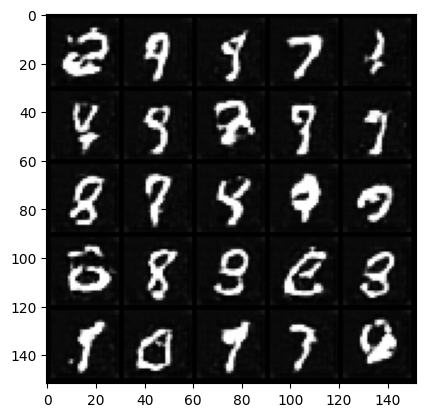

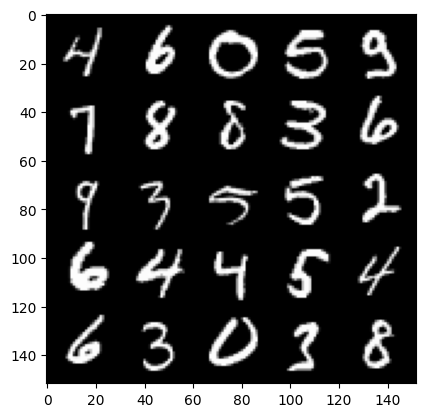

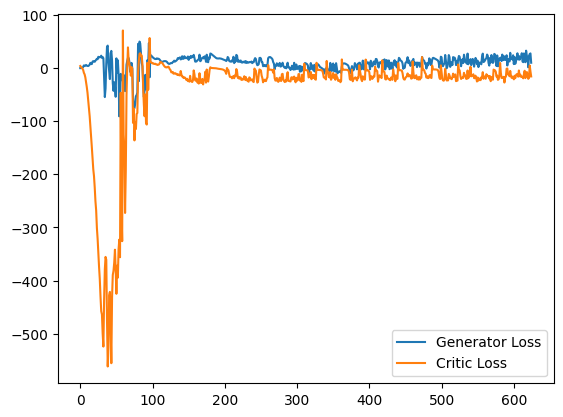

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1965857297182083
real: 3.026052951812744, fake: 2.569056987762451, regularization: 1.9658572673797607
crit_loss: torch.Size([]) 1.5088613033294678
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09705337882041931
real: 24.961254119873047, fake: 6.342384338378906, regularization: 0.9705337882041931
crit_loss: torch.Size([]) -17.64833641052246
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14683803915977478
real: 12.51656723022461, fake: -12.49372673034668, regularization: 1.4683804512023926
crit_loss: torch.Size([]) -23.541913986206055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11280475556850433
real: 8.962346076965332, fake: -17.065357208251953, regularization: 1.1280475854873657
crit_loss: torch.Size([]) -24.899654388427734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16681993007659912
real: 27.97740936279297, fake: -8.442169189453125, regularization: 1.6681993007659912
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1536513864994049
real: 4.43392276763916, fake: -14.583717346191406, regularization: 1.5365138053894043
crit_loss: torch.Size([]) -17.481124877929688
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1489393413066864
real: 6.916651725769043, fake: -13.817793846130371, regularization: 1.4893934726715088
crit_loss: torch.Size([]) -19.245052337646484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22326168417930603
real: -0.4428764879703522, fake: -13.747720718383789, regularization: 2.232616901397705
crit_loss: torch.Size([]) -11.072227478027344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17084503173828125
real: -0.3786812126636505, fake: -14.591934204101562, regularization: 1.7084503173828125
crit_loss: torch.Size([]) -12.504802703857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0821915790438652
real: -0.1658625602722168, fake: -13.833478927612305, regularization: 0.821915805339

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3743845522403717
real: -32.660369873046875, fake: -39.26467514038086, regularization: 3.7438454627990723
crit_loss: torch.Size([]) -2.860459804534912
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30926233530044556
real: -32.243385314941406, fake: -40.690731048583984, regularization: 3.092623233795166
crit_loss: torch.Size([]) -5.354722499847412
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33080077171325684
real: -32.60080337524414, fake: -40.75606155395508, regularization: 3.3080077171325684
crit_loss: torch.Size([]) -4.847250461578369
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.43535757064819336
real: -32.86286163330078, fake: -42.78988265991211, regularization: 4.353575706481934
crit_loss: torch.Size([]) -5.5734453201293945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6515783667564392
real: -25.92585563659668, fake: -40.481468200683594, regularization: 6.515783786773682


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4243614673614502
real: 25.206581115722656, fake: -25.660720825195312, regularization: 4.243614673614502
crit_loss: torch.Size([]) -46.623687744140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2607187032699585
real: 2.682487964630127, fake: -22.042556762695312, regularization: 2.607187032699585
crit_loss: torch.Size([]) -22.117856979370117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12399477511644363
real: 15.727341651916504, fake: -18.208898544311523, regularization: 1.23994779586792
crit_loss: torch.Size([]) -32.696292877197266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13569551706314087
real: 19.246479034423828, fake: -12.862788200378418, regularization: 1.3569551706314087
crit_loss: torch.Size([]) -30.7523136138916
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13940417766571045
real: 21.79935073852539, fake: -8.471034049987793, regularization: 1.3940417766571045
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18340802192687988
real: 16.358823776245117, fake: -9.248467445373535, regularization: 1.8340802192687988
crit_loss: torch.Size([]) -23.773212432861328
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09208019077777863
real: 14.177556991577148, fake: -12.742940902709961, regularization: 0.9208018779754639
crit_loss: torch.Size([]) -25.999696731567383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09994366765022278
real: 26.96102523803711, fake: -1.793140172958374, regularization: 0.9994366765022278
crit_loss: torch.Size([]) -27.754728317260742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20141391456127167
real: 28.314926147460938, fake: 2.283740520477295, regularization: 2.014139175415039
crit_loss: torch.Size([]) -24.017045974731445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14885468780994415
real: 8.981520652770996, fake: -8.62047004699707, regularization: 1.4885468482971191


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08997075259685516
real: 36.917240142822266, fake: 0.7541837692260742, regularization: 0.899707555770874
crit_loss: torch.Size([]) -35.26334762573242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09490305930376053
real: -0.025508567690849304, fake: -9.917619705200195, regularization: 0.9490305781364441
crit_loss: torch.Size([]) -8.943079948425293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22458775341510773
real: -7.019693374633789, fake: -20.968425750732422, regularization: 2.245877504348755
crit_loss: torch.Size([]) -11.702855110168457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10018675029277802
real: -4.493752956390381, fake: -19.584667205810547, regularization: 1.0018675327301025
crit_loss: torch.Size([]) -14.089046478271484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09349729120731354
real: 2.3147411346435547, fake: -12.678892135620117, regularization: 0.93497288227

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3387407660484314
real: -35.15329360961914, fake: -43.47587585449219, regularization: 3.3874077796936035
crit_loss: torch.Size([]) -4.935174465179443
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25904110074043274
real: -34.48191833496094, fake: -44.28831481933594, regularization: 2.5904109477996826
crit_loss: torch.Size([]) -7.215985298156738
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4285474717617035
real: -34.14966583251953, fake: -43.29872131347656, regularization: 4.28547477722168
crit_loss: torch.Size([]) -4.863580703735352
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29370903968811035
real: -34.087257385253906, fake: -41.69506072998047, regularization: 2.9370903968811035
crit_loss: torch.Size([]) -4.670712947845459
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31948965787887573
real: -34.80470275878906, fake: -44.35200500488281, regularization: 3.194896697998047
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1506512463092804
real: -19.54629898071289, fake: -23.472009658813477, regularization: 1.5065124034881592
crit_loss: torch.Size([]) -2.4191982746124268
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1454114466905594
real: -20.12175750732422, fake: -26.813983917236328, regularization: 1.4541144371032715
crit_loss: torch.Size([]) -5.238111972808838
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08675359189510345
real: -19.947729110717773, fake: -26.83106231689453, regularization: 0.8675359487533569
crit_loss: torch.Size([]) -6.015797138214111
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09342971444129944
real: -21.739307403564453, fake: -27.077007293701172, regularization: 0.9342971444129944
crit_loss: torch.Size([]) -4.403402805328369
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.061411045491695404
real: -21.499019622802734, fake: -28.01263427734375, regularization: 0.61411046981

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1557806432247162
real: -24.417537689208984, fake: -29.18750762939453, regularization: 1.5578064918518066
crit_loss: torch.Size([]) -3.2121634483337402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18610815703868866
real: -17.79446029663086, fake: -26.657974243164062, regularization: 1.861081600189209
crit_loss: torch.Size([]) -7.002432346343994
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30853787064552307
real: -2.1133508682250977, fake: -21.839645385742188, regularization: 3.085378646850586
crit_loss: torch.Size([]) -16.64091682434082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1538522094488144
real: 1.5743794441223145, fake: -18.91024398803711, regularization: 1.5385221242904663
crit_loss: torch.Size([]) -18.94610023498535
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10284571349620819
real: 1.4708282947540283, fake: -23.09769058227539, regularization: 1.0284571647644043

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20666702091693878
real: -33.44114685058594, fake: -40.588523864746094, regularization: 2.0666701793670654
crit_loss: torch.Size([]) -5.080706596374512
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19484546780586243
real: -29.6971378326416, fake: -38.64796829223633, regularization: 1.9484546184539795
crit_loss: torch.Size([]) -7.002375602722168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21449771523475647
real: -32.37213134765625, fake: -32.953697204589844, regularization: 2.14497709274292
crit_loss: torch.Size([]) 1.5634112358093262
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21661901473999023
real: -32.412193298339844, fake: -36.29936981201172, regularization: 2.1661901473999023
crit_loss: torch.Size([]) -1.7209863662719727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21198958158493042
real: -32.41975402832031, fake: -35.833396911621094, regularization: 2.119895935058593

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10152004659175873
real: 1.1725810766220093, fake: -16.489864349365234, regularization: 1.0152004957199097
crit_loss: torch.Size([]) -16.647245407104492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08270964026451111
real: 18.158050537109375, fake: -4.370887756347656, regularization: 0.8270964026451111
crit_loss: torch.Size([]) -21.701841354370117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12454135715961456
real: 31.72293472290039, fake: 1.0513155460357666, regularization: 1.2454135417938232
crit_loss: torch.Size([]) -29.426206588745117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0977001041173935
real: 31.548507690429688, fake: 3.0339810848236084, regularization: 0.9770010709762573
crit_loss: torch.Size([]) -27.537525177001953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12448281049728394
real: 27.14244270324707, fake: 2.975497245788574, regularization: 1.2448281049728394

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.483670175075531
real: -29.856487274169922, fake: -44.311744689941406, regularization: 4.8367018699646
crit_loss: torch.Size([]) -9.618555068969727
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.46185529232025146
real: -36.74043655395508, fake: -44.348907470703125, regularization: 4.618553161621094
crit_loss: torch.Size([]) -2.989917755126953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2933070957660675
real: -38.00634765625, fake: -46.48695755004883, regularization: 2.9330708980560303
crit_loss: torch.Size([]) -5.547538757324219
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24566106498241425
real: -38.172027587890625, fake: -46.99485397338867, regularization: 2.456610679626465
crit_loss: torch.Size([]) -6.366215705871582
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3258115351200104
real: -35.433135986328125, fake: -46.570098876953125, regularization: 3.258115291595459
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3349471092224121
real: -20.100175857543945, fake: -42.12444305419922, regularization: 3.349471092224121
crit_loss: torch.Size([]) -18.67479705810547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13888990879058838
real: 8.082863807678223, fake: -28.471435546875, regularization: 1.3888990879058838
crit_loss: torch.Size([]) -35.16539764404297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20430037379264832
real: 17.5837459564209, fake: -23.8133602142334, regularization: 2.043003797531128
crit_loss: torch.Size([]) -39.354103088378906
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1564621925354004
real: 3.071903705596924, fake: -25.218036651611328, regularization: 1.564621925354004
crit_loss: torch.Size([]) -26.725318908691406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1929914951324463
real: 18.59674835205078, fake: -12.735546112060547, regularization: 1.929914951324463
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21681255102157593
real: 22.415803909301758, fake: -14.69013786315918, regularization: 2.168125629425049
crit_loss: torch.Size([]) -34.93781661987305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4893307685852051
real: 12.640632629394531, fake: -46.05476760864258, regularization: 4.893307685852051
crit_loss: torch.Size([]) -53.802093505859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10573089867830276
real: 19.108413696289062, fake: -41.688323974609375, regularization: 1.0573090314865112
crit_loss: torch.Size([]) -59.73942947387695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06660091876983643
real: 31.732322692871094, fake: -24.45213508605957, regularization: 0.6660091876983643
crit_loss: torch.Size([]) -55.51844787597656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08374703675508499
real: 26.63610076904297, fake: -31.523887634277344, regularization: 0.8374703526496887
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08834724128246307
real: -22.0814208984375, fake: -32.39897918701172, regularization: 0.8834724426269531
crit_loss: torch.Size([]) -9.434085845947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09260474890470505
real: -22.115140914916992, fake: -32.524513244628906, regularization: 0.9260475039482117
crit_loss: torch.Size([]) -9.483325004577637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12983009219169617
real: -24.433101654052734, fake: -32.573387145996094, regularization: 1.2983009815216064
crit_loss: torch.Size([]) -6.841984748840332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11197526752948761
real: -24.001541137695312, fake: -32.06714630126953, regularization: 1.1197526454925537
crit_loss: torch.Size([]) -6.945852279663086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11242334544658661
real: -23.409305572509766, fake: -31.10544204711914, regularization: 1.124233484268

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12181493639945984
real: -16.63279914855957, fake: -27.49029541015625, regularization: 1.2181494235992432
crit_loss: torch.Size([]) -9.639347076416016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12737667560577393
real: -17.299654006958008, fake: -30.191062927246094, regularization: 1.2737667560577393
crit_loss: torch.Size([]) -11.617642402648926
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1678793728351593
real: -17.858985900878906, fake: -36.450340270996094, regularization: 1.6787936687469482
crit_loss: torch.Size([]) -16.912561416625977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23787721991539001
real: -17.82402229309082, fake: -37.019893646240234, regularization: 2.378772258758545
crit_loss: torch.Size([]) -16.81709861755371
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3805680274963379
real: -32.50722122192383, fake: -37.70859909057617, regularization: 3.8056802749633

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1255428045988083
real: -11.683501243591309, fake: -31.278297424316406, regularization: 1.2554280757904053
crit_loss: torch.Size([]) -18.339366912841797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1390613317489624
real: -12.938163757324219, fake: -33.07029724121094, regularization: 1.390613317489624
crit_loss: torch.Size([]) -18.741519927978516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.363442063331604
real: -19.305803298950195, fake: -30.239410400390625, regularization: 3.63442063331604
crit_loss: torch.Size([]) -7.299186706542969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4622108042240143
real: -9.797826766967773, fake: -22.80082130432129, regularization: 4.622107982635498
crit_loss: torch.Size([]) -8.38088607788086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26443928480148315
real: -8.063603401184082, fake: -23.42023468017578, regularization: 2.644392967224121
crit

crit_loss: torch.Size([]) -40.17653274536133
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.07187779247760773
real: 29.16609764099121, fake: -18.561376571655273, regularization: 0.7187778949737549
crit_loss: torch.Size([]) -47.008697509765625
gradient_norm: torch.Size([96])
penalty: torch.Size([]) 0.2009754627943039
real: 36.30988693237305, fake: -14.61157512664795, regularization: 2.0097546577453613
crit_loss: torch.Size([]) -48.91170883178711


  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12701107561588287
real: 16.49306297302246, fake: -4.810246467590332, regularization: 1.2701107263565063
crit_loss: torch.Size([]) -20.033199310302734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12335167080163956
real: 24.360116958618164, fake: 0.5941261649131775, regularization: 1.2335166931152344
crit_loss: torch.Size([]) -22.532474517822266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08958473056554794
real: 30.20413589477539, fake: -0.961532711982727, regularization: 0.8958473205566406
crit_loss: torch.Size([]) -30.269821166992188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0906028002500534
real: 27.705429077148438, fake: -1.296529769897461, regularization: 0.9060280323028564
crit_loss: torch.Size([]) -28.095930099487305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07452784478664398
real: 29.47056770324707, fake: -1.0457475185394287, regularization: 0.7452784776687622

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34925758838653564
real: -37.013587951660156, fake: -46.24956130981445, regularization: 3.4925758838653564
crit_loss: torch.Size([]) -5.7433977127075195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3390182852745056
real: -33.28980255126953, fake: -40.420841217041016, regularization: 3.3901829719543457
crit_loss: torch.Size([]) -3.7408556938171387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21949487924575806
real: -34.71490478515625, fake: -45.56064987182617, regularization: 2.194948673248291
crit_loss: torch.Size([]) -8.650796890258789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15169036388397217
real: -34.074981689453125, fake: -46.619056701660156, regularization: 1.5169036388397217
crit_loss: torch.Size([]) -11.02717113494873
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26760348677635193
real: -32.07532501220703, fake: -38.23152160644531, regularization: 2.6760349273681

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27066826820373535
real: 25.219633102416992, fake: 1.3753423690795898, regularization: 2.7066826820373535
crit_loss: torch.Size([]) -21.137609481811523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13789720833301544
real: 33.53569030761719, fake: 4.0005621910095215, regularization: 1.378972053527832
crit_loss: torch.Size([]) -28.15615463256836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15917226672172546
real: 25.96324920654297, fake: -11.793061256408691, regularization: 1.5917227268218994
crit_loss: torch.Size([]) -36.16458511352539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07579339295625687
real: 29.108783721923828, fake: -1.0630626678466797, regularization: 0.7579339146614075
crit_loss: torch.Size([]) -29.413911819458008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07423824071884155
real: 34.95368194580078, fake: 4.469040393829346, regularization: 0.7423824071884155
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3034248948097229
real: -3.5255472660064697, fake: -29.520906448364258, regularization: 3.0342488288879395
crit_loss: torch.Size([]) -22.961111068725586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11275853216648102
real: -3.4410839080810547, fake: -37.151611328125, regularization: 1.1275852918624878
crit_loss: torch.Size([]) -32.58293914794922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12962022423744202
real: 20.907981872558594, fake: -17.40007781982422, regularization: 1.2962021827697754
crit_loss: torch.Size([]) -37.01185607910156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1392088383436203
real: 26.203664779663086, fake: -17.79019546508789, regularization: 1.3920884132385254
crit_loss: torch.Size([]) -42.601768493652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17736193537712097
real: 19.060829162597656, fake: -29.313365936279297, regularization: 1.773619413375854

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6101807355880737
real: -28.909908294677734, fake: -42.036865234375, regularization: 6.101807594299316
crit_loss: torch.Size([]) -7.025149345397949
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.519837498664856
real: -26.706697463989258, fake: -39.85444641113281, regularization: 5.1983747482299805
crit_loss: torch.Size([]) -7.949374198913574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8854145407676697
real: -26.90406036376953, fake: -41.32013702392578, regularization: 8.854145050048828
crit_loss: torch.Size([]) -5.561931610107422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6220196485519409
real: -26.698760986328125, fake: -41.75431823730469, regularization: 6.220196723937988
crit_loss: torch.Size([]) -8.835360527038574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4802546501159668
real: -28.04558563232422, fake: -42.80961608886719, regularization: 4.802546501159668
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14710938930511475
real: -28.830650329589844, fake: -18.85346794128418, regularization: 1.4710938930511475
crit_loss: torch.Size([]) 11.44827651977539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11529512703418732
real: -26.463611602783203, fake: -17.44228172302246, regularization: 1.1529512405395508
crit_loss: torch.Size([]) 10.174281120300293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22218330204486847
real: -20.74700355529785, fake: -13.740849494934082, regularization: 2.2218329906463623
crit_loss: torch.Size([]) 9.227987289428711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08581049740314484
real: -4.631810665130615, fake: -20.40288543701172, regularization: 0.858104944229126
crit_loss: torch.Size([]) -14.912969589233398
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18279984593391418
real: -6.194210052490234, fake: -27.551002502441406, regularization: 1.827998399734497

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08692361414432526
real: -21.22154426574707, fake: -31.318378448486328, regularization: 0.8692361116409302
crit_loss: torch.Size([]) -9.227598190307617
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11955931782722473
real: -21.391162872314453, fake: -31.47472381591797, regularization: 1.1955931186676025
crit_loss: torch.Size([]) -8.887968063354492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11074846982955933
real: -21.701740264892578, fake: -33.516998291015625, regularization: 1.1074846982955933
crit_loss: torch.Size([]) -10.707773208618164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08260782063007355
real: -21.960424423217773, fake: -33.85594177246094, regularization: 0.8260781764984131
crit_loss: torch.Size([]) -11.069438934326172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09429934620857239
real: -22.14153480529785, fake: -33.507598876953125, regularization: 0.942993462

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.34154459834098816
real: -1.5824544429779053, fake: 7.410494327545166, regularization: 3.4154460430145264
crit_loss: torch.Size([]) 12.408394813537598
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.27987682819366455
real: 5.734259605407715, fake: 0.3451855778694153, regularization: 2.7987682819366455
crit_loss: torch.Size([]) -2.5903055667877197
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19338950514793396
real: 22.699777603149414, fake: -22.427635192871094, regularization: 1.9338951110839844
crit_loss: torch.Size([]) -43.19351577758789
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2135658860206604
real: 1.7348430156707764, fake: -24.739849090576172, regularization: 2.1356587409973145
crit_loss: torch.Size([]) -24.339033126831055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.32796263694763184
real: 4.576906204223633, fake: -30.133882522583008, regularization: 3.279626369476318

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.44363975524902344
real: -9.449697494506836, fake: -23.24224090576172, regularization: 4.436397552490234
crit_loss: torch.Size([]) -9.356145858764648
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26918280124664307
real: 7.05601692199707, fake: -8.588349342346191, regularization: 2.6918280124664307
crit_loss: torch.Size([]) -12.95253849029541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5012239217758179
real: 25.408248901367188, fake: 12.465517044067383, regularization: 5.012239456176758
crit_loss: torch.Size([]) -7.930492401123047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3862873613834381
real: 32.157047271728516, fake: 9.889991760253906, regularization: 3.8628735542297363
crit_loss: torch.Size([]) -18.40418243408203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23221442103385925
real: 26.937862396240234, fake: 1.2240923643112183, regularization: 2.3221442699432373
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16390417516231537
real: -16.747947692871094, fake: -30.201004028320312, regularization: 1.639041781425476
crit_loss: torch.Size([]) -11.814014434814453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5143553018569946
real: -18.334003448486328, fake: -37.19033432006836, regularization: 5.143552780151367
crit_loss: torch.Size([]) -13.712778091430664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07535409182310104
real: -18.20450782775879, fake: -37.39457321166992, regularization: 0.7535409331321716
crit_loss: torch.Size([]) -18.436525344848633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31199079751968384
real: -19.785255432128906, fake: -47.54563903808594, regularization: 3.119907855987549
crit_loss: torch.Size([]) -24.64047622680664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6211678981781006
real: -19.610483169555664, fake: -56.283714294433594, regularization: 6.2116789817810

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25808244943618774
real: 24.742631912231445, fake: -11.162090301513672, regularization: 2.580824375152588
crit_loss: torch.Size([]) -33.32389831542969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17352411150932312
real: 23.675935745239258, fake: -15.584246635437012, regularization: 1.735241174697876
crit_loss: torch.Size([]) -37.524940490722656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24990832805633545
real: 27.696495056152344, fake: -10.037736892700195, regularization: 2.4990832805633545
crit_loss: torch.Size([]) -35.235145568847656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10982474684715271
real: 24.960330963134766, fake: -9.804344177246094, regularization: 1.0982475280761719
crit_loss: torch.Size([]) -33.66642761230469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08579577505588531
real: 24.858821868896484, fake: -13.067401885986328, regularization: 0.8579577207565

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14836522936820984
real: -20.551067352294922, fake: -36.059173583984375, regularization: 1.4836523532867432
crit_loss: torch.Size([]) -14.024454116821289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24296142160892487
real: -9.352283477783203, fake: -32.591304779052734, regularization: 2.429614305496216
crit_loss: torch.Size([]) -20.809406280517578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.297728031873703
real: 9.721519470214844, fake: -25.11172103881836, regularization: 2.977280378341675
crit_loss: torch.Size([]) -31.855960845947266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12223825603723526
real: 12.464603424072266, fake: -28.401416778564453, regularization: 1.2223825454711914
crit_loss: torch.Size([]) -39.643638610839844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11372403055429459
real: 15.958444595336914, fake: -19.265216827392578, regularization: 1.1372402906417

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6468305587768555
real: -18.233177185058594, fake: -37.69239044189453, regularization: 6.468305587768555
crit_loss: torch.Size([]) -12.990907669067383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8674426078796387
real: -21.430099487304688, fake: -43.86363983154297, regularization: 8.674426078796387
crit_loss: torch.Size([]) -13.759114265441895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3924511671066284
real: -20.245101928710938, fake: -41.293601989746094, regularization: 3.924511671066284
crit_loss: torch.Size([]) -17.12398910522461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45893535017967224
real: -19.178136825561523, fake: -38.742027282714844, regularization: 4.589353561401367
crit_loss: torch.Size([]) -14.974536895751953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8255758285522461
real: -20.067230224609375, fake: -42.854679107666016, regularization: 8.25575828552246

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.426065444946289
real: -21.36626434326172, fake: -30.34758758544922, regularization: 14.26065444946289
crit_loss: torch.Size([]) 5.279331207275391
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2378673553466797
real: -18.032581329345703, fake: -26.729005813598633, regularization: 2.378673553466797
crit_loss: torch.Size([]) -6.317750930786133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.279464989900589
real: -15.044333457946777, fake: -24.94976043701172, regularization: 2.794649839401245
crit_loss: torch.Size([]) -7.110776901245117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2176821231842041
real: -12.556514739990234, fake: -23.429901123046875, regularization: 2.176821231842041
crit_loss: torch.Size([]) -8.696565628051758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13427875936031342
real: -11.14175796508789, fake: -23.506786346435547, regularization: 1.3427876234054565
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09917707741260529
real: 24.82554054260254, fake: -13.603185653686523, regularization: 0.9917707443237305
crit_loss: torch.Size([]) -37.436954498291016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15308716893196106
real: 23.165634155273438, fake: -14.367879867553711, regularization: 1.5308716297149658
crit_loss: torch.Size([]) -36.00264358520508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08803029358386993
real: 21.909534454345703, fake: -17.747997283935547, regularization: 0.880302906036377
crit_loss: torch.Size([]) -38.77722930908203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09794479608535767
real: 26.438692092895508, fake: -16.820005416870117, regularization: 0.9794479608535767
crit_loss: torch.Size([]) -42.27925109863281
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1379023641347885
real: 28.849214553833008, fake: -11.46016788482666, regularization: 1.379023671150207

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08039364218711853
real: 22.962299346923828, fake: -0.7502987384796143, regularization: 0.8039364218711853
crit_loss: torch.Size([]) -22.908662796020508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.046667300164699554
real: 22.787799835205078, fake: 3.910416603088379, regularization: 0.46667301654815674
crit_loss: torch.Size([]) -18.41071128845215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0948881208896637
real: 25.935901641845703, fake: 6.378139972686768, regularization: 0.948881208896637
crit_loss: torch.Size([]) -18.6088809967041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03700005263090134
real: 26.979446411132812, fake: 7.371677875518799, regularization: 0.37000054121017456
crit_loss: torch.Size([]) -19.237768173217773
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11132245510816574
real: 26.57196044921875, fake: 5.5615234375, regularization: 1.1132245063781738
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08251562714576721
real: -5.998655319213867, fake: 5.061071872711182, regularization: 0.8251562714576721
crit_loss: torch.Size([]) 11.884882926940918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09327119588851929
real: 11.838680267333984, fake: 7.234442710876465, regularization: 0.9327119588851929
crit_loss: torch.Size([]) -3.671525478363037
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11441463232040405
real: 21.412925720214844, fake: -1.1862623691558838, regularization: 1.1441463232040405
crit_loss: torch.Size([]) -21.455041885375977
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11351167410612106
real: 1.0803735256195068, fake: -22.63236427307129, regularization: 1.135116696357727
crit_loss: torch.Size([]) -22.577621459960938
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1364974081516266
real: -0.13999393582344055, fake: -21.620161056518555, regularization: 1.364974021911621

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13830643892288208
real: -27.989505767822266, fake: -22.611125946044922, regularization: 1.3830643892288208
crit_loss: torch.Size([]) 6.761444091796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23086225986480713
real: -24.118221282958984, fake: -19.209728240966797, regularization: 2.3086225986480713
crit_loss: torch.Size([]) 7.21711540222168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20112371444702148
real: -23.374794006347656, fake: -14.541269302368164, regularization: 2.011237144470215
crit_loss: torch.Size([]) 10.844761848449707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15028223395347595
real: -20.157882690429688, fake: -15.919242858886719, regularization: 1.5028223991394043
crit_loss: torch.Size([]) 5.741462230682373
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12186016142368317
real: -15.98126220703125, fake: -15.948646545410156, regularization: 1.2186015844345

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14297521114349365
real: -11.644545555114746, fake: -9.546916961669922, regularization: 1.4297521114349365
crit_loss: torch.Size([]) 3.5273807048797607
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07000690698623657
real: -12.476957321166992, fake: -9.8438081741333, regularization: 0.7000690698623657
crit_loss: torch.Size([]) 3.3332180976867676
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10907110571861267
real: -16.753610610961914, fake: -19.987661361694336, regularization: 1.0907111167907715
crit_loss: torch.Size([]) -2.1433396339416504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2024717479944229
real: -19.94687271118164, fake: -23.44548988342285, regularization: 2.0247175693511963
crit_loss: torch.Size([]) -1.4738996028900146
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11867287755012512
real: -22.151540756225586, fake: -26.80975341796875, regularization: 1.1867287158966

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12875980138778687
real: 12.067813873291016, fake: -13.812636375427246, regularization: 1.2875980138778687
crit_loss: torch.Size([]) -24.592853546142578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12626780569553375
real: 28.64483642578125, fake: 0.04507926106452942, regularization: 1.2626780271530151
crit_loss: torch.Size([]) -27.337078094482422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09527137875556946
real: 28.246524810791016, fake: -1.058634638786316, regularization: 0.9527137875556946
crit_loss: torch.Size([]) -28.352445602416992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1432631015777588
real: 26.633480072021484, fake: -1.9614105224609375, regularization: 1.432631015777588
crit_loss: torch.Size([]) -27.162260055541992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08856506645679474
real: 27.048908233642578, fake: -0.0018629133701324463, regularization: 0.885650634

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05878668278455734
real: 16.656917572021484, fake: -21.470947265625, regularization: 0.5878668427467346
crit_loss: torch.Size([]) -37.53999710083008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28155431151390076
real: 5.170979976654053, fake: -47.18392562866211, regularization: 2.8155431747436523
crit_loss: torch.Size([]) -49.53936004638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2495986372232437
real: 6.756556034088135, fake: -52.33360290527344, regularization: 2.4959864616394043
crit_loss: torch.Size([]) -56.594173431396484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10952523350715637
real: 24.140174865722656, fake: -33.006324768066406, regularization: 1.095252275466919
crit_loss: torch.Size([]) -56.051246643066406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1507645845413208
real: 18.870176315307617, fake: -40.83182144165039, regularization: 1.507645845413208
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33909931778907776
real: -33.881919860839844, fake: -48.306190490722656, regularization: 3.390993118286133
crit_loss: torch.Size([]) -11.03327751159668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3922790288925171
real: -34.28022384643555, fake: -50.85829162597656, regularization: 3.922790288925171
crit_loss: torch.Size([]) -12.655277252197266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3425094485282898
real: -32.748199462890625, fake: -47.92820739746094, regularization: 3.4250946044921875
crit_loss: torch.Size([]) -11.754913330078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3456628918647766
real: -31.184701919555664, fake: -47.87840270996094, regularization: 3.4566287994384766
crit_loss: torch.Size([]) -13.237071990966797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3472886085510254
real: -31.17920684814453, fake: -48.47949981689453, regularization: 3.472886085510254


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6970515251159668
real: -10.017740249633789, fake: -19.968284606933594, regularization: 6.970515251159668
crit_loss: torch.Size([]) -2.9800291061401367
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.690361738204956
real: -9.926712036132812, fake: -18.983074188232422, regularization: 6.9036173820495605
crit_loss: torch.Size([]) -2.152744770050049
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5573720932006836
real: -9.627729415893555, fake: -20.06433868408203, regularization: 5.573720932006836
crit_loss: torch.Size([]) -4.862888336181641
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3427380919456482
real: -8.813911437988281, fake: -19.710514068603516, regularization: 3.4273810386657715
crit_loss: torch.Size([]) -7.469221591949463
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8196572065353394
real: -7.820985317230225, fake: -18.302940368652344, regularization: 8.196572303771973
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4969988465309143
real: -4.731019973754883, fake: -11.25897216796875, regularization: 4.9699883460998535
crit_loss: torch.Size([]) -1.5579638481140137
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28008362650871277
real: -0.9447858333587646, fake: -10.82463550567627, regularization: 2.8008363246917725
crit_loss: torch.Size([]) -7.079012870788574
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31267666816711426
real: -0.7108773589134216, fake: -11.391740798950195, regularization: 3.1267666816711426
crit_loss: torch.Size([]) -7.554096698760986
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24232667684555054
real: -1.8449289798736572, fake: -13.582688331604004, regularization: 2.423266887664795
crit_loss: torch.Size([]) -9.314493179321289
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17520251870155334
real: -2.170654535293579, fake: -14.50851821899414, regularization: 1.7520251274108

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1700253039598465
real: -7.075722694396973, fake: -4.283836364746094, regularization: 1.7002530097961426
crit_loss: torch.Size([]) 4.4921393394470215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20390495657920837
real: -8.10539722442627, fake: -6.909185409545898, regularization: 2.0390496253967285
crit_loss: torch.Size([]) 3.2352614402770996
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6496092677116394
real: -8.449773788452148, fake: -9.91633129119873, regularization: 6.496092796325684
crit_loss: torch.Size([]) 5.029535293579102
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12253813445568085
real: -4.607427597045898, fake: -8.094977378845215, regularization: 1.2253813743591309
crit_loss: torch.Size([]) -2.2621684074401855
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14005428552627563
real: -2.1134033203125, fake: -9.926080703735352, regularization: 1.4005428552627563
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1149250715970993
real: -35.77486038208008, fake: -40.48375701904297, regularization: 1.1492507457733154
crit_loss: torch.Size([]) -3.559645891189575
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15340009331703186
real: -35.22004318237305, fake: -37.95945739746094, regularization: 1.5340008735656738
crit_loss: torch.Size([]) -1.2054133415222168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09570227563381195
real: -32.98823928833008, fake: -39.42695236206055, regularization: 0.9570227861404419
crit_loss: torch.Size([]) -5.481690406799316
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0805211216211319
real: -32.001609802246094, fake: -38.104042053222656, regularization: 0.8052111864089966
crit_loss: torch.Size([]) -5.2972211837768555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13296228647232056
real: -30.597972869873047, fake: -39.30642318725586, regularization: 1.32962286472320

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10450080037117004
real: -15.702821731567383, fake: -24.495906829833984, regularization: 1.0450079441070557
crit_loss: torch.Size([]) -7.748077392578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22216999530792236
real: -10.539748191833496, fake: -24.918792724609375, regularization: 2.2216999530792236
crit_loss: torch.Size([]) -12.157344818115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3229125738143921
real: -7.464109897613525, fake: -24.13080596923828, regularization: 3.229125738143921
crit_loss: torch.Size([]) -13.437570571899414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21754732728004456
real: -6.575292587280273, fake: -24.428905487060547, regularization: 2.175473213195801
crit_loss: torch.Size([]) -15.678139686584473
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18631726503372192
real: -5.589237213134766, fake: -24.112323760986328, regularization: 1.86317265033

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13102494180202484
real: 5.916702747344971, fake: -12.553559303283691, regularization: 1.3102494478225708
crit_loss: torch.Size([]) -17.16001319885254
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13544857501983643
real: 11.11844253540039, fake: -9.668668746948242, regularization: 1.3544857501983643
crit_loss: torch.Size([]) -19.43262481689453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17539571225643158
real: 14.948095321655273, fake: -4.227350234985352, regularization: 1.7539571523666382
crit_loss: torch.Size([]) -17.42148780822754
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11213254928588867
real: 15.657974243164062, fake: -5.956002235412598, regularization: 1.1213254928588867
crit_loss: torch.Size([]) -20.49264907836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08738413453102112
real: 16.19599723815918, fake: -8.583869934082031, regularization: 0.8738413453102112
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12061654031276703
real: 23.392181396484375, fake: -20.03363037109375, regularization: 1.2061654329299927
crit_loss: torch.Size([]) -42.21964645385742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19167865812778473
real: 26.47164535522461, fake: -9.542728424072266, regularization: 1.916786551475525
crit_loss: torch.Size([]) -34.09758758544922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14103463292121887
real: 21.00218391418457, fake: -14.551751136779785, regularization: 1.410346269607544
crit_loss: torch.Size([]) -34.14358901977539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11025950312614441
real: -5.710312366485596, fake: -8.562379837036133, regularization: 1.1025950908660889
crit_loss: torch.Size([]) -1.7494723796844482
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1718013882637024
real: 7.1684064865112305, fake: 3.5179214477539062, regularization: 1.718013882637024
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.724861741065979
real: 6.390699863433838, fake: -36.87982177734375, regularization: 7.248617172241211
crit_loss: torch.Size([]) -36.02190399169922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16190427541732788
real: 25.55745506286621, fake: -10.120709419250488, regularization: 1.6190427541732788
crit_loss: torch.Size([]) -34.05912399291992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1864173263311386
real: 19.963970184326172, fake: -20.674274444580078, regularization: 1.8641732931137085
crit_loss: torch.Size([]) -38.774070739746094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28793758153915405
real: -34.4998664855957, fake: -10.854966163635254, regularization: 2.87937593460083
crit_loss: torch.Size([]) 26.524276733398438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7732046246528625
real: -39.34510040283203, fake: -42.91785430908203, regularization: 7.732046127319336
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3587769865989685
real: -32.644195556640625, fake: -48.3038330078125, regularization: 3.5877699851989746
crit_loss: torch.Size([]) -12.071866989135742
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.375003844499588
real: -31.902435302734375, fake: -47.755340576171875, regularization: 3.7500383853912354
crit_loss: torch.Size([]) -12.102867126464844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.347747266292572
real: -33.05152893066406, fake: -49.432918548583984, regularization: 3.4774727821350098
crit_loss: torch.Size([]) -12.90391731262207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29120782017707825
real: -42.600040435791016, fake: -48.54520034790039, regularization: 2.9120781421661377
crit_loss: torch.Size([]) -3.0330817699432373
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2337500900030136
real: -43.0041618347168, fake: -46.90866470336914, regularization: 2.337500810623169
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1293385773897171
real: 18.259807586669922, fake: -13.208993911743164, regularization: 1.2933857440948486
crit_loss: torch.Size([]) -30.1754150390625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20432186126708984
real: 20.27825164794922, fake: -13.70207405090332, regularization: 2.0432186126708984
crit_loss: torch.Size([]) -31.937105178833008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12004850804805756
real: 18.929508209228516, fake: -6.0368170738220215, regularization: 1.200485110282898
crit_loss: torch.Size([]) -23.765840530395508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1258283406496048
real: 21.5732421875, fake: -7.078107833862305, regularization: 1.2582833766937256
crit_loss: torch.Size([]) -27.39306640625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12016759812831879
real: 22.258432388305664, fake: -4.954122543334961, regularization: 1.2016760110855103
crit_loss

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14271187782287598
real: 28.805875778198242, fake: -28.180400848388672, regularization: 1.4271187782287598
crit_loss: torch.Size([]) -55.55915451049805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10459517687559128
real: 31.097320556640625, fake: -22.36797332763672, regularization: 1.0459517240524292
crit_loss: torch.Size([]) -52.419342041015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4211254119873047
real: -43.02362823486328, fake: -21.71111488342285, regularization: 4.211254119873047
crit_loss: torch.Size([]) 25.523767471313477
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9762686491012573
real: -38.93394470214844, fake: -46.209625244140625, regularization: 9.762686729431152
crit_loss: torch.Size([]) 2.487006187438965
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6471467018127441
real: -26.08989143371582, fake: -49.86521911621094, regularization: 6.471467018127441
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7023009061813354
real: -40.116851806640625, fake: -31.567506790161133, regularization: 7.023009300231934
crit_loss: torch.Size([]) 15.572354316711426
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5961294770240784
real: -37.560211181640625, fake: -34.702369689941406, regularization: 5.961294651031494
crit_loss: torch.Size([]) 8.819135665893555
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31204110383987427
real: -38.535369873046875, fake: -36.399940490722656, regularization: 3.120410919189453
crit_loss: torch.Size([]) 5.255840301513672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28291428089141846
real: -36.68228530883789, fake: -37.291282653808594, regularization: 2.8291428089141846
crit_loss: torch.Size([]) 2.2201454639434814
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3297712802886963
real: -35.39485168457031, fake: -37.359397888183594, regularization: 3.297712802886963
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1324869990348816
real: -6.072454452514648, fake: -34.93368148803711, regularization: 1.324869990348816
crit_loss: torch.Size([]) -27.536357879638672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12688922882080078
real: 14.251078605651855, fake: -26.973472595214844, regularization: 1.2688922882080078
crit_loss: torch.Size([]) -39.955657958984375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17349720001220703
real: 26.517793655395508, fake: -13.386846542358398, regularization: 1.7349720001220703
crit_loss: torch.Size([]) -38.16967010498047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09443248063325882
real: -8.790702819824219, fake: 6.7301836013793945, regularization: 0.944324791431427
crit_loss: torch.Size([]) 16.465211868286133
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12906190752983093
real: 0.6463925838470459, fake: 5.649847507476807, regularization: 1.290619134902954
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12602218985557556
real: 22.863527297973633, fake: -28.69526481628418, regularization: 1.2602219581604004
crit_loss: torch.Size([]) -50.29856872558594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2438475340604782
real: 45.23677062988281, fake: -6.018349647521973, regularization: 2.4384753704071045
crit_loss: torch.Size([]) -48.81664276123047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23470701277256012
real: 39.17416763305664, fake: -26.80309295654297, regularization: 2.3470702171325684
crit_loss: torch.Size([]) -63.63019561767578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16862748563289642
real: 39.25714874267578, fake: -24.2561092376709, regularization: 1.6862748861312866
crit_loss: torch.Size([]) -61.82698440551758
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22473430633544922
real: 44.19683837890625, fake: -21.502689361572266, regularization: 2.247343063354492
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.45137348771095276
real: -35.72985076904297, fake: -47.21831512451172, regularization: 4.513734817504883
crit_loss: torch.Size([]) -6.974729537963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31442829966545105
real: -36.21904754638672, fake: -46.898277282714844, regularization: 3.1442830562591553
crit_loss: torch.Size([]) -7.534946441650391
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8660304546356201
real: -34.30338668823242, fake: -47.221893310546875, regularization: 8.66030502319336
crit_loss: torch.Size([]) -4.258201599121094
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5052899122238159
real: -33.07420349121094, fake: -44.188133239746094, regularization: 5.052899360656738
crit_loss: torch.Size([]) -6.061030387878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42914289236068726
real: -34.16054153442383, fake: -45.76415252685547, regularization: 4.291429042816162
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2740393877029419
real: 18.191879272460938, fake: -10.266651153564453, regularization: 2.740393877029419
crit_loss: torch.Size([]) -25.718135833740234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08805935829877853
real: 15.964847564697266, fake: -9.783754348754883, regularization: 0.8805935978889465
crit_loss: torch.Size([]) -24.86800765991211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10012121498584747
real: 10.887436866760254, fake: -17.34485626220703, regularization: 1.0012121200561523
crit_loss: torch.Size([]) -27.2310791015625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.154979407787323
real: 18.11896514892578, fake: -15.379983901977539, regularization: 1.54979407787323
crit_loss: torch.Size([]) -31.949153900146484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08846711367368698
real: 14.811182975769043, fake: -6.941288948059082, regularization: 0.884671151638031
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2616395354270935
real: -30.769819259643555, fake: -42.58393859863281, regularization: 2.6163954734802246
crit_loss: torch.Size([]) -9.197723388671875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.553301215171814
real: -28.322898864746094, fake: -43.366825103759766, regularization: 5.533012390136719
crit_loss: torch.Size([]) -9.510913848876953
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5678321123123169
real: -27.529767990112305, fake: -42.3807487487793, regularization: 5.67832088470459
crit_loss: torch.Size([]) -9.172659873962402
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8651984930038452
real: -28.496051788330078, fake: -42.60862731933594, regularization: 8.651985168457031
crit_loss: torch.Size([]) -5.460590362548828
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24112726747989655
real: -27.58041763305664, fake: -43.503395080566406, regularization: 2.4112727642059326
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11034101247787476
real: -36.55512237548828, fake: -38.81501388549805, regularization: 1.1034101247787476
crit_loss: torch.Size([]) -1.156481385231018
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10536402463912964
real: -37.02044677734375, fake: -38.918800354003906, regularization: 1.0536402463912964
crit_loss: torch.Size([]) -0.8447133302688599
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14766640961170197
real: -35.380340576171875, fake: -39.10956573486328, regularization: 1.4766640663146973
crit_loss: torch.Size([]) -2.252561092376709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23023660480976105
real: -34.01557922363281, fake: -38.01582336425781, regularization: 2.302366018295288
crit_loss: torch.Size([]) -1.697878122329712
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09950198233127594
real: -33.99424362182617, fake: -38.315452575683594, regularization: 0.99501979351043

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10663226246833801
real: 30.076400756835938, fake: 10.054391860961914, regularization: 1.0663225650787354
crit_loss: torch.Size([]) -18.955686569213867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07624343782663345
real: 27.13254165649414, fake: 7.183162689208984, regularization: 0.7624343633651733
crit_loss: torch.Size([]) -19.18694496154785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0361260250210762
real: 24.68157196044922, fake: 3.9646565914154053, regularization: 0.36126023530960083
crit_loss: torch.Size([]) -20.355655670166016
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0714491605758667
real: 30.844295501708984, fake: 6.423930644989014, regularization: 0.714491605758667
crit_loss: torch.Size([]) -23.705873489379883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0789208859205246
real: 30.591184616088867, fake: 5.846031188964844, regularization: 0.7892088890075684
crit_

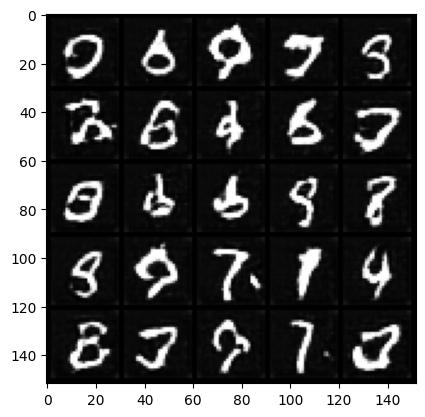

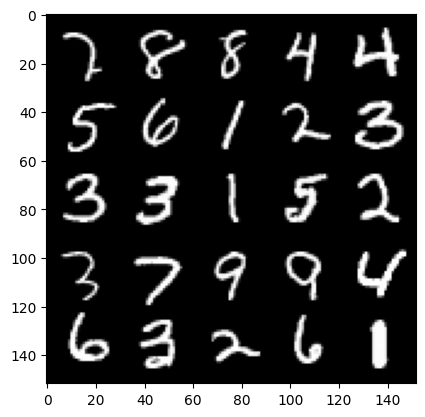

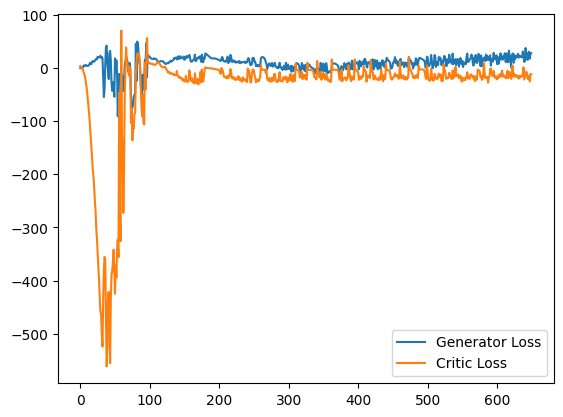

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12653888761997223
real: 26.157167434692383, fake: -8.319252014160156, regularization: 1.2653888463974
crit_loss: torch.Size([]) -33.211029052734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19368557631969452
real: 45.923118591308594, fake: 14.932771682739258, regularization: 1.9368557929992676
crit_loss: torch.Size([]) -29.053491592407227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12885653972625732
real: 35.244136810302734, fake: -9.481578826904297, regularization: 1.2885653972625732
crit_loss: torch.Size([]) -43.43714904785156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1190757006406784
real: 34.41503143310547, fake: -6.308287143707275, regularization: 1.1907570362091064
crit_loss: torch.Size([]) -39.532562255859375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04747874289751053
real: 42.531517028808594, fake: -1.9037833213806152, regularization: 0.4747874140739441
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18829616904258728
real: 37.13427734375, fake: -12.043115615844727, regularization: 1.8829617500305176
crit_loss: torch.Size([]) -47.294429779052734
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07562710344791412
real: 40.53819274902344, fake: -10.079938888549805, regularization: 0.7562710046768188
crit_loss: torch.Size([]) -49.86186218261719
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1762535721063614
real: 2.835052967071533, fake: -8.719610214233398, regularization: 1.7625356912612915
crit_loss: torch.Size([]) -9.792126655578613
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07268942892551422
real: 9.1467866897583, fake: -6.745330810546875, regularization: 0.7268942594528198
crit_loss: torch.Size([]) -15.165223121643066
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1236911416053772
real: 27.611042022705078, fake: 15.686729431152344, regularization: 1.236911416053772
crit_los

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15164360404014587
real: 17.68893051147461, fake: -10.842041015625, regularization: 1.5164361000061035
crit_loss: torch.Size([]) -27.014535903930664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12622320652008057
real: 13.964363098144531, fake: -12.85689926147461, regularization: 1.2622320652008057
crit_loss: torch.Size([]) -25.559030532836914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09846354275941849
real: 27.711753845214844, fake: -2.2393484115600586, regularization: 0.9846354126930237
crit_loss: torch.Size([]) -28.966466903686523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0967029556632042
real: 33.67871856689453, fake: 3.184251070022583, regularization: 0.9670295715332031
crit_loss: torch.Size([]) -29.527437210083008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09660445898771286
real: -0.4466874301433563, fake: -0.2263539731502533, regularization: 0.9660446047782898

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0979832336306572
real: -26.207923889160156, fake: -37.46475601196289, regularization: 0.9798323512077332
crit_loss: torch.Size([]) -10.276999473571777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19251933693885803
real: -27.273887634277344, fake: -37.740699768066406, regularization: 1.9251933097839355
crit_loss: torch.Size([]) -8.541618347167969
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15376412868499756
real: -26.815244674682617, fake: -37.687522888183594, regularization: 1.5376412868499756
crit_loss: torch.Size([]) -9.334636688232422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08575673401355743
real: -26.237398147583008, fake: -36.70442199707031, regularization: 0.857567310333252
crit_loss: torch.Size([]) -9.609457015991211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06780179589986801
real: -26.061660766601562, fake: -36.606475830078125, regularization: 0.6780179738

penalty: torch.Size([]) 0.2216309905052185
real: -21.44074249267578, fake: -48.194190979003906, regularization: 2.2163100242614746
crit_loss: torch.Size([]) -24.537137985229492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4628477990627289
real: -26.260944366455078, fake: -54.33137130737305, regularization: 4.628478050231934
crit_loss: torch.Size([]) -23.44194793701172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14314481616020203
real: -20.6193904876709, fake: -47.519752502441406, regularization: 1.431448221206665
crit_loss: torch.Size([]) -25.468914031982422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20571155846118927
real: -30.428443908691406, fake: -41.01996612548828, regularization: 2.0571155548095703
crit_loss: torch.Size([]) -8.534406661987305
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16842028498649597
real: -25.02320098876953, fake: -35.66065979003906, regularization: 1.6842029094696045
crit_loss: torch.Size([]) -8.953

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07111737132072449
real: -25.792051315307617, fake: -34.70451354980469, regularization: 0.7111737132072449
crit_loss: torch.Size([]) -8.201288223266602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0656743198633194
real: -25.567245483398438, fake: -34.66423034667969, regularization: 0.6567431688308716
crit_loss: torch.Size([]) -8.440241813659668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09602728486061096
real: -24.66571044921875, fake: -34.8102912902832, regularization: 0.9602728486061096
crit_loss: torch.Size([]) -9.184308052062988
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07559198141098022
real: -23.177337646484375, fake: -34.79877471923828, regularization: 0.7559198141098022
crit_loss: torch.Size([]) -10.865517616271973
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05104410648345947
real: -20.292152404785156, fake: -31.75182342529297, regularization: 0.51044106483459

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0962904542684555
real: 29.18866729736328, fake: -4.5752739906311035, regularization: 0.9629045724868774
crit_loss: torch.Size([]) -32.8010368347168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11833727359771729
real: 24.5342960357666, fake: -14.000560760498047, regularization: 1.1833727359771729
crit_loss: torch.Size([]) -37.35148620605469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13968682289123535
real: 29.461360931396484, fake: 5.526864528656006, regularization: 1.3968682289123535
crit_loss: torch.Size([]) -22.537628173828125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07009997963905334
real: 37.59873962402344, fake: 9.112537384033203, regularization: 0.7009997963905334
crit_loss: torch.Size([]) -27.785202026367188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15158022940158844
real: 32.445919036865234, fake: 1.5674412250518799, regularization: 1.515802264213562
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 13.079174995422363
real: -21.21195411682129, fake: -26.469684600830078, regularization: 130.791748046875
crit_loss: torch.Size([]) 125.53401947021484
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7488551139831543
real: -24.995615005493164, fake: -29.812021255493164, regularization: 7.488551139831543
crit_loss: torch.Size([]) 2.672144889831543
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.42904961109161377
real: -26.486812591552734, fake: -31.259342193603516, regularization: 4.290495872497559
crit_loss: torch.Size([]) -0.48203372955322266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 1.128638744354248
real: -26.479591369628906, fake: -31.3466796875, regularization: 11.28638744354248
crit_loss: torch.Size([]) 6.419299125671387
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23456215858459473
real: -25.00668716430664, fake: -29.98442840576172, regularization: 2.3456215858459473
crit_lo

penalty: torch.Size([]) 0.03647197037935257
real: -25.14006996154785, fake: -30.384912490844727, regularization: 0.3647196888923645
crit_loss: torch.Size([]) -4.880122661590576
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09874649345874786
real: -27.220264434814453, fake: -30.561946868896484, regularization: 0.9874649047851562
crit_loss: torch.Size([]) -2.354217529296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.081983283162117
real: -26.759628295898438, fake: -30.17473602294922, regularization: 0.8198328018188477
crit_loss: torch.Size([]) -2.5952749252319336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.071312315762043
real: -25.924354553222656, fake: -30.03972625732422, regularization: 0.7131231427192688
crit_loss: torch.Size([]) -3.4022486209869385
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.057798195630311966
real: -25.1832332611084, fake: -29.46469497680664, regularization: 0.5779819488525391
crit_loss: torch.Size([]) -3.7

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.057002559304237366
real: -21.656749725341797, fake: -26.916614532470703, regularization: 0.5700255632400513
crit_loss: torch.Size([]) -4.6898393630981445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06391403824090958
real: -21.574838638305664, fake: -26.88983726501465, regularization: 0.6391403675079346
crit_loss: torch.Size([]) -4.675858497619629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04305511713027954
real: -21.540523529052734, fake: -26.648067474365234, regularization: 0.4305511713027954
crit_loss: torch.Size([]) -4.676992893218994
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05909258499741554
real: -21.27054214477539, fake: -26.714460372924805, regularization: 0.5909258723258972
crit_loss: torch.Size([]) -4.852992534637451
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06854046136140823
real: -20.998085021972656, fake: -26.794748306274414, regularization: 0.6854045

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.03720597177743912
real: -17.053125381469727, fake: -23.719593048095703, regularization: 0.37205970287323
crit_loss: torch.Size([]) -6.294407844543457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.058527372777462006
real: -16.910812377929688, fake: -24.42811393737793, regularization: 0.5852737426757812
crit_loss: torch.Size([]) -6.932027816772461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.058592721819877625
real: -16.738372802734375, fake: -24.080791473388672, regularization: 0.5859272480010986
crit_loss: torch.Size([]) -6.756491661071777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07864534854888916
real: -16.444313049316406, fake: -23.559057235717773, regularization: 0.7864534854888916
crit_loss: torch.Size([]) -6.328290939331055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0697559118270874
real: -16.248882293701172, fake: -23.813323974609375, regularization: 0.697559118

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11276519298553467
real: 13.58646011352539, fake: -6.320839881896973, regularization: 1.1276519298553467
crit_loss: torch.Size([]) -18.779647827148438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25457605719566345
real: 15.627860069274902, fake: -7.814957618713379, regularization: 2.5457606315612793
crit_loss: torch.Size([]) -20.897056579589844
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11288215965032578
real: 0.10575896501541138, fake: -9.129932403564453, regularization: 1.128821611404419
crit_loss: torch.Size([]) -8.1068696975708
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07800758630037308
real: 5.787132263183594, fake: -2.575364589691162, regularization: 0.7800758481025696
crit_loss: torch.Size([]) -7.58242130279541
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13858875632286072
real: 15.120582580566406, fake: -1.9008395671844482, regularization: 1.385887622833252
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2206166535615921
real: -1.510572075843811, fake: -20.11490249633789, regularization: 2.2061665058135986
crit_loss: torch.Size([]) -16.398162841796875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3722582459449768
real: 3.4726977348327637, fake: -19.518577575683594, regularization: 3.7225823402404785
crit_loss: torch.Size([]) -19.268693923950195
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2615169882774353
real: 5.002779960632324, fake: -21.87017822265625, regularization: 2.6151700019836426
crit_loss: torch.Size([]) -24.257789611816406
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2057396024465561
real: 9.106422424316406, fake: -19.3106689453125, regularization: 2.0573959350585938
crit_loss: torch.Size([]) -26.359695434570312
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2700008749961853
real: 21.7696475982666, fake: -17.64448356628418, regularization: 2.7000088691711426
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1471250057220459
real: 19.355342864990234, fake: -6.795210838317871, regularization: 1.471250057220459
crit_loss: torch.Size([]) -24.679304122924805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2647784948348999
real: 15.932429313659668, fake: 4.839295387268066, regularization: 2.647784948348999
crit_loss: torch.Size([]) -8.445348739624023
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09796401113271713
real: 32.176612854003906, fake: 8.84969711303711, regularization: 0.9796401262283325
crit_loss: torch.Size([]) -22.347274780273438
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1975475251674652
real: 20.993696212768555, fake: -0.4765612483024597, regularization: 1.9754753112792969
crit_loss: torch.Size([]) -19.494781494140625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.15496774017810822
real: 20.512479782104492, fake: -4.791978359222412, regularization: 1.5496773719787598
crit

  0%|          | 0/469 [00:00<?, ?it/s]

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14913493394851685
real: -20.696287155151367, fake: -11.839405059814453, regularization: 1.4913493394851685
crit_loss: torch.Size([]) 10.348231315612793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5034447908401489
real: -25.752403259277344, fake: -29.703472137451172, regularization: 5.03444766998291
crit_loss: torch.Size([]) 1.083378791809082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23154418170452118
real: -25.904104232788086, fake: -32.80556869506836, regularization: 2.315441846847534
crit_loss: torch.Size([]) -4.58602237701416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05605199560523033
real: -24.881710052490234, fake: -32.10259246826172, regularization: 0.5605199337005615
crit_loss: torch.Size([]) -6.660362243652344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08100274950265884
real: -24.492778778076172, fake: -32.381507873535156, regularization: 0.810027480125427

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8428628444671631
real: -3.3797473907470703, fake: -27.1561279296875, regularization: 8.428628921508789
crit_loss: torch.Size([]) -15.34775161743164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2680523693561554
real: 4.2580437660217285, fake: -25.745840072631836, regularization: 2.680523633956909
crit_loss: torch.Size([]) -27.323360443115234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24656715989112854
real: 18.129016876220703, fake: -13.32444953918457, regularization: 2.4656715393066406
crit_loss: torch.Size([]) -28.987794876098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14686179161071777
real: -21.688114166259766, fake: -7.612440586090088, regularization: 1.4686179161071777
crit_loss: torch.Size([]) 15.544292449951172
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13411475718021393
real: -22.697893142700195, fake: -30.640003204345703, regularization: 1.341147541999817

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1701531708240509
real: -31.319120407104492, fake: -40.86664581298828, regularization: 1.7015316486358643
crit_loss: torch.Size([]) -7.845993995666504
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3405112028121948
real: -27.279483795166016, fake: -39.045188903808594, regularization: 3.4051120281219482
crit_loss: torch.Size([]) -8.36059284210205
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17836734652519226
real: -24.030364990234375, fake: -37.346309661865234, regularization: 1.7836735248565674
crit_loss: torch.Size([]) -11.532271385192871
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2057548612356186
real: -19.41539764404297, fake: -32.97590637207031, regularization: 2.0575485229492188
crit_loss: torch.Size([]) -11.502960205078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26602232456207275
real: -14.077079772949219, fake: -32.04937744140625, regularization: 2.6602232456207

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.339408814907074
real: 35.59983825683594, fake: -15.053552627563477, regularization: 3.3940882682800293
crit_loss: torch.Size([]) -47.259300231933594
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17063482105731964
real: 31.92530059814453, fake: -19.76593017578125, regularization: 1.706348180770874
crit_loss: torch.Size([]) -49.98488235473633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16148817539215088
real: -4.950589656829834, fake: -9.637872695922852, regularization: 1.6148817539215088
crit_loss: torch.Size([]) -3.072401285171509
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13502947986125946
real: -2.0078344345092773, fake: -7.765074253082275, regularization: 1.350294828414917
crit_loss: torch.Size([]) -4.40694522857666
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1346805840730667
real: 6.013455390930176, fake: 0.625909149646759, regularization: 1.3468058109283447
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26939111948013306
real: -26.202009201049805, fake: -24.237316131591797, regularization: 2.693911075592041
crit_loss: torch.Size([]) 4.658604145050049
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21888956427574158
real: -27.001964569091797, fake: -26.668886184692383, regularization: 2.1888957023620605
crit_loss: torch.Size([]) 2.5219740867614746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06346398591995239
real: -26.016521453857422, fake: -33.066932678222656, regularization: 0.6346398591995239
crit_loss: torch.Size([]) -6.415771484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06583239883184433
real: -24.970670700073242, fake: -32.88203811645508, regularization: 0.6583240032196045
crit_loss: torch.Size([]) -7.253043174743652
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08834324777126312
real: -23.737777709960938, fake: -33.427085876464844, regularization: 0.8834325075149

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07764017581939697
real: -22.237232208251953, fake: -34.366310119628906, regularization: 0.7764017581939697
crit_loss: torch.Size([]) -11.352676391601562
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1737639158964157
real: -23.203571319580078, fake: -35.82128143310547, regularization: 1.7376391887664795
crit_loss: torch.Size([]) -10.880070686340332
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22617629170417786
real: -22.910062789916992, fake: -35.81053161621094, regularization: 2.261762857437134
crit_loss: torch.Size([]) -10.63870620727539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1384684443473816
real: -21.729751586914062, fake: -35.36650848388672, regularization: 1.384684443473816
crit_loss: torch.Size([]) -12.25207233428955
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08864104747772217
real: -20.477052688598633, fake: -36.361595153808594, regularization: 0.886410474777

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13187509775161743
real: -23.561155319213867, fake: -29.62293243408203, regularization: 1.3187509775161743
crit_loss: torch.Size([]) -4.743026256561279
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07312627136707306
real: -22.8271541595459, fake: -31.340389251708984, regularization: 0.7312626838684082
crit_loss: torch.Size([]) -7.781972408294678
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13060420751571655
real: -22.679824829101562, fake: -31.881122589111328, regularization: 1.3060420751571655
crit_loss: torch.Size([]) -7.8952555656433105
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09004424512386322
real: -23.114791870117188, fake: -32.4505615234375, regularization: 0.9004424810409546
crit_loss: torch.Size([]) -8.435327529907227
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08096455037593842
real: -23.04635238647461, fake: -33.12285232543945, regularization: 0.8096455335617

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08115246891975403
real: -42.201255798339844, fake: -25.179475784301758, regularization: 0.8115246891975403
crit_loss: torch.Size([]) 17.83330535888672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4291384220123291
real: -22.271560668945312, fake: -23.6146183013916, regularization: 4.291384220123291
crit_loss: torch.Size([]) 2.948326587677002
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8424651622772217
real: -12.703730583190918, fake: -23.20193099975586, regularization: 8.424652099609375
crit_loss: torch.Size([]) -2.0735483169555664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16677594184875488
real: -14.55172061920166, fake: -25.079975128173828, regularization: 1.6677594184875488
crit_loss: torch.Size([]) -8.860494613647461
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14162763953208923
real: -14.254229545593262, fake: -25.309322357177734, regularization: 1.416276454925537


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16833379864692688
real: 32.47180938720703, fake: -18.428977966308594, regularization: 1.683337926864624
crit_loss: torch.Size([]) -49.21744918823242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21561484038829803
real: 30.764719009399414, fake: -22.502002716064453, regularization: 2.1561484336853027
crit_loss: torch.Size([]) -51.11057662963867
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7925181984901428
real: -35.450218200683594, fake: -34.724361419677734, regularization: 7.925181865692139
crit_loss: torch.Size([]) 8.651039123535156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.9699762463569641
real: -38.617435455322266, fake: -40.19724655151367, regularization: 9.699762344360352
crit_loss: torch.Size([]) 8.119951248168945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3570452332496643
real: -34.58845901489258, fake: -29.915489196777344, regularization: 3.5704522132873535
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12306096404790878
real: -20.92708969116211, fake: -28.155574798583984, regularization: 1.230609655380249
crit_loss: torch.Size([]) -5.997875213623047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08982045203447342
real: -20.350358963012695, fake: -28.388385772705078, regularization: 0.898204505443573
crit_loss: torch.Size([]) -7.139822483062744
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07957957684993744
real: -19.917369842529297, fake: -27.999980926513672, regularization: 0.7957957983016968
crit_loss: torch.Size([]) -7.286815166473389
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0765385702252388
real: -19.747177124023438, fake: -28.172073364257812, regularization: 0.7653856873512268
crit_loss: torch.Size([]) -7.659510612487793
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13269931077957153
real: -20.013893127441406, fake: -29.689577102661133, regularization: 1.32699310779

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19770397245883942
real: -9.945526123046875, fake: -37.01911163330078, regularization: 1.9770396947860718
crit_loss: torch.Size([]) -25.096546173095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09979280829429626
real: -28.38191795349121, fake: -23.9704532623291, regularization: 0.9979280829429626
crit_loss: torch.Size([]) 5.409392833709717
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2592986226081848
real: -12.03804874420166, fake: -21.893646240234375, regularization: 2.5929861068725586
crit_loss: torch.Size([]) -7.262611389160156
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3187587857246399
real: -8.084036827087402, fake: -21.49064064025879, regularization: 3.1875877380371094
crit_loss: torch.Size([]) -10.219016075134277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.161260187625885
real: -9.44912338256836, fake: -23.595890045166016, regularization: 1.61260187625885
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2152767777442932
real: -6.423946857452393, fake: -19.537494659423828, regularization: 2.1527676582336426
crit_loss: torch.Size([]) -10.96078109741211
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25585663318634033
real: -6.131466865539551, fake: -24.238449096679688, regularization: 2.5585663318634033
crit_loss: torch.Size([]) -15.548417091369629
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2819855213165283
real: -0.265115350484848, fake: -25.665422439575195, regularization: 2.819855213165283
crit_loss: torch.Size([]) -22.58045196533203
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10892875492572784
real: -11.888723373413086, fake: -25.183063507080078, regularization: 1.089287519454956
crit_loss: torch.Size([]) -12.205052375793457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30024808645248413
real: 7.169209003448486, fake: -19.842693328857422, regularization: 3.00248098373413

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5562165379524231
real: -41.50019454956055, fake: -46.01557159423828, regularization: 5.562165260314941
crit_loss: torch.Size([]) 1.046788215637207
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21596570312976837
real: -34.535499572753906, fake: -40.18797302246094, regularization: 2.1596570014953613
crit_loss: torch.Size([]) -3.49281644821167
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2068883180618286
real: -26.570476531982422, fake: -38.222267150878906, regularization: 2.068883180618286
crit_loss: torch.Size([]) -9.582907676696777
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.33831456303596497
real: -5.8909592628479, fake: -34.06786346435547, regularization: 3.383145570755005
crit_loss: torch.Size([]) -24.793758392333984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4910047948360443
real: 16.10905647277832, fake: -12.966459274291992, regularization: 4.910048007965088
crit_lo

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2305014282464981
real: 11.760736465454102, fake: -7.005044937133789, regularization: 2.3050143718719482
crit_loss: torch.Size([]) -16.46076774597168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6340906023979187
real: 6.076218605041504, fake: -21.4945068359375, regularization: 6.340906143188477
crit_loss: torch.Size([]) -21.22981834411621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2047390341758728
real: 17.36762809753418, fake: -26.0284423828125, regularization: 2.0473904609680176
crit_loss: torch.Size([]) -41.34868240356445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17083773016929626
real: 21.35003662109375, fake: -26.197509765625, regularization: 1.7083773612976074
crit_loss: torch.Size([]) -45.839168548583984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3043121099472046
real: 26.04942512512207, fake: -25.17456817626953, regularization: 3.043121099472046
crit_loss: to

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.253760427236557
real: 38.39501190185547, fake: 11.957412719726562, regularization: 2.537604331970215
crit_loss: torch.Size([]) -23.899993896484375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26540690660476685
real: 28.657459259033203, fake: -4.686178207397461, regularization: 2.654068946838379
crit_loss: torch.Size([]) -30.68956756591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2569923996925354
real: 27.098541259765625, fake: -6.5868635177612305, regularization: 2.5699238777160645
crit_loss: torch.Size([]) -31.115482330322266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1291734278202057
real: 29.993698120117188, fake: -1.2751212120056152, regularization: 1.291734218597412
crit_loss: torch.Size([]) -29.97708511352539
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09635180234909058
real: 26.69603729248047, fake: 7.985850811004639, regularization: 0.9635180234909058
crit_l

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 10.731355667114258
real: -48.706634521484375, fake: -49.73615264892578, regularization: 107.31355285644531
crit_loss: torch.Size([]) 106.2840347290039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 3.442416191101074
real: 3.51155686378479, fake: -8.605735778808594, regularization: 34.424163818359375
crit_loss: torch.Size([]) 22.30687141418457
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 2.1115481853485107
real: 7.100056171417236, fake: -7.684210300445557, regularization: 21.115482330322266
crit_loss: torch.Size([]) 6.331215858459473
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3244241774082184
real: -2.877396583557129, fake: -16.772525787353516, regularization: 3.244241714477539
crit_loss: torch.Size([]) -10.650887489318848
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.6489289999008179
real: -5.411789894104004, fake: -19.051647186279297, regularization: 6.489290237426758
crit_loss:

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13694961369037628
real: 23.300167083740234, fake: 3.1607024669647217, regularization: 1.3694961071014404
crit_loss: torch.Size([]) -18.769969940185547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13872504234313965
real: 23.307039260864258, fake: 2.076676845550537, regularization: 1.3872504234313965
crit_loss: torch.Size([]) -19.843111038208008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16593243181705475
real: 20.7600040435791, fake: -5.043903827667236, regularization: 1.659324288368225
crit_loss: torch.Size([]) -24.144582748413086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.095694899559021
real: 12.370018005371094, fake: -0.7253353595733643, regularization: 0.95694899559021
crit_loss: torch.Size([]) -12.13840389251709
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10976757109165192
real: 23.318618774414062, fake: 1.2538784742355347, regularization: 1.0976756811141968
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13710688054561615
real: -27.505718231201172, fake: -35.06538009643555, regularization: 1.3710688352584839
crit_loss: torch.Size([]) -6.188592910766602
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2631606459617615
real: -27.267026901245117, fake: -34.977516174316406, regularization: 2.6316065788269043
crit_loss: torch.Size([]) -5.078882694244385
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09136928617954254
real: -26.28337860107422, fake: -33.90235137939453, regularization: 0.913692831993103
crit_loss: torch.Size([]) -6.70527982711792
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06337347626686096
real: -25.327465057373047, fake: -33.81041717529297, regularization: 0.6337347626686096
crit_loss: torch.Size([]) -7.849217414855957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09416405856609344
real: -24.66459846496582, fake: -33.45258712768555, regularization: 0.9416406154632568

penalty: torch.Size([]) 0.10788209736347198
real: -21.579612731933594, fake: -38.05220031738281, regularization: 1.0788209438323975
crit_loss: torch.Size([]) -15.393766403198242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07691437005996704
real: -22.284862518310547, fake: -40.84333038330078, regularization: 0.7691437005996704
crit_loss: torch.Size([]) -17.789323806762695
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21934622526168823
real: -32.838077545166016, fake: -43.512001037597656, regularization: 2.193462371826172
crit_loss: torch.Size([]) -8.480461120605469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2160898745059967
real: -31.60896873474121, fake: -40.01298522949219, regularization: 2.1608986854553223
crit_loss: torch.Size([]) -6.243117809295654
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10998986661434174
real: -29.260440826416016, fake: -38.30042266845703, regularization: 1.0998986959457397
crit_loss: torch.Size([]) -7

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07861819863319397
real: 21.657207489013672, fake: 1.9039018154144287, regularization: 0.7861819863319397
crit_loss: torch.Size([]) -18.96712303161621
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10235683619976044
real: 14.922107696533203, fake: -9.103527069091797, regularization: 1.0235683917999268
crit_loss: torch.Size([]) -23.002065658569336
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11976732313632965
real: 9.450570106506348, fake: -10.030132293701172, regularization: 1.1976732015609741
crit_loss: torch.Size([]) -18.28302764892578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12797345221042633
real: 15.799531936645508, fake: -7.166362762451172, regularization: 1.279734492301941
crit_loss: torch.Size([]) -21.686161041259766
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05108337104320526
real: -16.211708068847656, fake: -0.8823716640472412, regularization: 0.51083374023437

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4278043210506439
real: -13.798622131347656, fake: -37.24405288696289, regularization: 4.278043270111084
crit_loss: torch.Size([]) -19.167387008666992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19208630919456482
real: -46.24025344848633, fake: -31.749691009521484, regularization: 1.920863151550293
crit_loss: torch.Size([]) 16.411426544189453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4413069784641266
real: -24.36761474609375, fake: -45.59737777709961, regularization: 4.413069725036621
crit_loss: torch.Size([]) -16.816692352294922
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7476765513420105
real: -6.071531772613525, fake: -46.297340393066406, regularization: 7.4767656326293945
crit_loss: torch.Size([]) -32.74904251098633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4734971523284912
real: -9.23058032989502, fake: -45.23358917236328, regularization: 4.734971523284912
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11636066436767578
real: -9.509339332580566, fake: -20.342994689941406, regularization: 1.1636066436767578
crit_loss: torch.Size([]) -9.670048713684082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1690528392791748
real: -9.296268463134766, fake: -19.982667922973633, regularization: 1.690528392791748
crit_loss: torch.Size([]) -8.995870590209961
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12218645960092545
real: -9.255289077758789, fake: -20.432235717773438, regularization: 1.2218645811080933
crit_loss: torch.Size([]) -9.955081939697266
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07891090959310532
real: -12.14472770690918, fake: -20.724708557128906, regularization: 0.7891091108322144
crit_loss: torch.Size([]) -7.790871620178223
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09876956790685654
real: -11.771721839904785, fake: -20.51845932006836, regularization: 0.98769569396972

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13602778315544128
real: -2.8535001277923584, fake: -17.586637496948242, regularization: 1.3602778911590576
crit_loss: torch.Size([]) -13.372859001159668
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16088689863681793
real: -2.892061471939087, fake: -18.404823303222656, regularization: 1.608868956565857
crit_loss: torch.Size([]) -13.90389347076416
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14923681318759918
real: -7.700523376464844, fake: -19.809844970703125, regularization: 1.4923681020736694
crit_loss: torch.Size([]) -10.61695384979248
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14486247301101685
real: -7.405055046081543, fake: -18.347505569458008, regularization: 1.4486247301101685
crit_loss: torch.Size([]) -9.493825912475586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09010471403598785
real: -6.883696556091309, fake: -17.498733520507812, regularization: 0.90104711055

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.447596937417984
real: -14.554201126098633, fake: -47.086238861083984, regularization: 4.475969314575195
crit_loss: torch.Size([]) -28.056066513061523
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24278095364570618
real: 1.4046201705932617, fake: -38.53887939453125, regularization: 2.427809476852417
crit_loss: torch.Size([]) -37.515689849853516
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.23788750171661377
real: -25.48400115966797, fake: -25.169958114624023, regularization: 2.3788750171661377
crit_loss: torch.Size([]) 2.692918062210083
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18967893719673157
real: -14.961814880371094, fake: -24.719005584716797, regularization: 1.896789312362671
crit_loss: torch.Size([]) -7.860401153564453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.25476574897766113
real: -1.1527202129364014, fake: -13.61259651184082, regularization: 2.547657489776611

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19973699748516083
real: 9.652660369873047, fake: -10.92877197265625, regularization: 1.9973700046539307
crit_loss: torch.Size([]) -18.584062576293945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20726844668388367
real: 9.629745483398438, fake: -14.369025230407715, regularization: 2.0726845264434814
crit_loss: torch.Size([]) -21.92608642578125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10922226309776306
real: 11.50811767578125, fake: -12.39410400390625, regularization: 1.0922226905822754
crit_loss: torch.Size([]) -22.809999465942383
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.24603547155857086
real: 1.9557899236679077, fake: -7.854010581970215, regularization: 2.460354804992676
crit_loss: torch.Size([]) -7.349445343017578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13585953414440155
real: 4.192316055297852, fake: -9.096284866333008, regularization: 1.358595371246338
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11430928111076355
real: -25.45917320251465, fake: -32.772647857666016, regularization: 1.1430928707122803
crit_loss: torch.Size([]) -6.170381546020508
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04209693521261215
real: -24.72689437866211, fake: -33.38945007324219, regularization: 0.4209693670272827
crit_loss: torch.Size([]) -8.241586685180664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.0880935788154602
real: -24.238079071044922, fake: -32.452571868896484, regularization: 0.880935788154602
crit_loss: torch.Size([]) -7.33355712890625
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.05301655828952789
real: -23.82227897644043, fake: -32.79692840576172, regularization: 0.5301655530929565
crit_loss: torch.Size([]) -8.444483757019043
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.04997551441192627
real: -22.21742057800293, fake: -32.686134338378906, regularization: 0.4997551441192627

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11454468220472336
real: -12.927650451660156, fake: -32.15068435668945, regularization: 1.14544677734375
crit_loss: torch.Size([]) -18.077587127685547
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.328937292098999
real: -13.886846542358398, fake: -40.135780334472656, regularization: 3.2893729209899902
crit_loss: torch.Size([]) -22.95956039428711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2462282031774521
real: -15.40245246887207, fake: -47.70991516113281, regularization: 2.4622819423675537
crit_loss: torch.Size([]) -29.845182418823242
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.146254301071167
real: -17.45392608642578, fake: -51.14809036254883, regularization: 1.46254301071167
crit_loss: torch.Size([]) -32.23162078857422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20023499429225922
real: -17.240097045898438, fake: -56.1658935546875, regularization: 2.002349853515625
crit_

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.186020627617836
real: -10.748674392700195, fake: -19.431873321533203, regularization: 1.8602062463760376
crit_loss: torch.Size([]) -6.82299280166626
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1660398542881012
real: -11.533647537231445, fake: -27.647157669067383, regularization: 1.6603984832763672
crit_loss: torch.Size([]) -14.45311164855957
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.8064450621604919
real: -11.339113235473633, fake: -30.626989364624023, regularization: 8.06445026397705
crit_loss: torch.Size([]) -11.22342586517334
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20220640301704407
real: -17.222862243652344, fake: -28.92949867248535, regularization: 2.022063970565796
crit_loss: torch.Size([]) -9.684572219848633
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.3114422559738159
real: -11.237905502319336, fake: -24.707305908203125, regularization: 3.114422559738159
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10181324928998947
real: 19.811037063598633, fake: -3.1265993118286133, regularization: 1.0181324481964111
crit_loss: torch.Size([]) -21.919504165649414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07220050692558289
real: 17.089855194091797, fake: -9.472600936889648, regularization: 0.7220050692558289
crit_loss: torch.Size([]) -25.840450286865234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11089665442705154
real: 13.178058624267578, fake: -13.839958190917969, regularization: 1.108966588973999
crit_loss: torch.Size([]) -25.90904998779297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16532239317893982
real: 15.686781883239746, fake: -11.420184135437012, regularization: 1.653223991394043
crit_loss: torch.Size([]) -25.45374298095703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14659790694713593
real: 16.92230796813965, fake: -12.133630752563477, regularization: 1.46597909927368

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10379914939403534
real: 11.860878944396973, fake: 11.047709465026855, regularization: 1.0379915237426758
crit_loss: torch.Size([]) 0.2248220443725586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2684023380279541
real: 28.267772674560547, fake: 3.2114062309265137, regularization: 2.684023380279541
crit_loss: torch.Size([]) -22.372343063354492
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08764643967151642
real: 4.115122318267822, fake: -22.884782791137695, regularization: 0.8764643669128418
crit_loss: torch.Size([]) -26.12343978881836
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06927797943353653
real: 5.2903218269348145, fake: -12.28561019897461, regularization: 0.6927797794342041
crit_loss: torch.Size([]) -16.88315200805664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09411145746707916
real: 13.023662567138672, fake: -9.703052520751953, regularization: 0.9411145448684692
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09083452820777893
real: 14.853315353393555, fake: -12.078908920288086, regularization: 0.9083452820777893
crit_loss: torch.Size([]) -26.02387809753418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.21780580282211304
real: -14.97956371307373, fake: -9.857725143432617, regularization: 2.17805814743042
crit_loss: torch.Size([]) 7.299896717071533
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18803805112838745
real: -17.92283821105957, fake: -16.49091339111328, regularization: 1.8803805112838745
crit_loss: torch.Size([]) 3.312305450439453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40336596965789795
real: -21.4002685546875, fake: -30.999860763549805, regularization: 4.033659934997559
crit_loss: torch.Size([]) -5.565932273864746
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08831429481506348
real: -20.501026153564453, fake: -34.19641876220703, regularization: 0.8831429481506348
cri

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11003120243549347
real: 0.6571327447891235, fake: -6.6795878410339355, regularization: 1.1003119945526123
crit_loss: torch.Size([]) -6.236408233642578
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10647974163293839
real: 7.205470085144043, fake: -28.296043395996094, regularization: 1.0647974014282227
crit_loss: torch.Size([]) -34.43671798706055
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.333107590675354
real: 11.094006538391113, fake: -26.378324508666992, regularization: 3.33107590675354
crit_loss: torch.Size([]) -34.14125442504883
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22002142667770386
real: 23.764007568359375, fake: -15.173600196838379, regularization: 2.200214385986328
crit_loss: torch.Size([]) -36.73739242553711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06233162805438042
real: 17.16680145263672, fake: -26.634445190429688, regularization: 0.6233162879943848
cr

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.26255345344543457
real: 22.652103424072266, fake: 0.5046441555023193, regularization: 2.6255345344543457
crit_loss: torch.Size([]) -19.52192497253418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12199332565069199
real: 23.916080474853516, fake: 3.252119302749634, regularization: 1.219933271408081
crit_loss: torch.Size([]) -19.444028854370117
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08042208850383759
real: 20.510822296142578, fake: -2.9771838188171387, regularization: 0.8042209148406982
crit_loss: torch.Size([]) -22.683786392211914
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12052404880523682
real: 18.649267196655273, fake: -3.5762834548950195, regularization: 1.2052404880523682
crit_loss: torch.Size([]) -21.02031135559082
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1185712069272995
real: 19.190574645996094, fake: -4.722724437713623, regularization: 1.1857120990753174

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1252788007259369
real: 7.139443397521973, fake: -4.124322891235352, regularization: 1.2527880668640137
crit_loss: torch.Size([]) -10.010978698730469
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08531210571527481
real: 7.615190505981445, fake: -23.868179321289062, regularization: 0.8531210422515869
crit_loss: torch.Size([]) -30.6302490234375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16866451501846313
real: -2.7607717514038086, fake: -30.255123138427734, regularization: 1.6866451501846313
crit_loss: torch.Size([]) -25.80770492553711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.28631043434143066
real: 15.86324691772461, fake: -13.397523880004883, regularization: 2.8631043434143066
crit_loss: torch.Size([]) -26.397666931152344
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.11515749990940094
real: 21.190509796142578, fake: -5.353848457336426, regularization: 1.151574969291687


gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16967517137527466
real: -21.315608978271484, fake: -37.64565658569336, regularization: 1.6967517137527466
crit_loss: torch.Size([]) -14.633296012878418
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1940176784992218
real: -21.86380958557129, fake: -44.14093017578125, regularization: 1.9401767253875732
crit_loss: torch.Size([]) -20.336944580078125
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.7968481779098511
real: -22.840309143066406, fake: -49.47294616699219, regularization: 7.96848201751709
crit_loss: torch.Size([]) -18.664154052734375
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17664441466331482
real: -19.80657196044922, fake: -42.252010345458984, regularization: 1.766444206237793
crit_loss: torch.Size([]) -20.678993225097656
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30514758825302124
real: -22.27275276184082, fake: -49.98406219482422, regularization: 3.051476001739502

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1919107884168625
real: -13.553442001342773, fake: -45.987060546875, regularization: 1.9191079139709473
crit_loss: torch.Size([]) -30.514509201049805
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17251475155353546
real: -12.498701095581055, fake: -46.442962646484375, regularization: 1.7251474857330322
crit_loss: torch.Size([]) -32.219112396240234
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1686590164899826
real: -13.12631893157959, fake: -46.83946228027344, regularization: 1.6865901947021484
crit_loss: torch.Size([]) -32.02655029296875
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30373138189315796
real: -15.453195571899414, fake: -45.67781066894531, regularization: 3.037313938140869
crit_loss: torch.Size([]) -27.187301635742188
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30087459087371826
real: -18.285186767578125, fake: -53.52898406982422, regularization: 3.00874590873718

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.072268545627594
real: -8.14321517944336, fake: -18.24819564819336, regularization: 0.7226854562759399
crit_loss: torch.Size([]) -9.382294654846191
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07160286605358124
real: -6.298518180847168, fake: -17.616558074951172, regularization: 0.7160286903381348
crit_loss: torch.Size([]) -10.602010726928711
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.12404850125312805
real: -5.057033538818359, fake: -18.11574935913086, regularization: 1.2404849529266357
crit_loss: torch.Size([]) -11.818230628967285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1379057765007019
real: -4.807863235473633, fake: -18.987953186035156, regularization: 1.379057765007019
crit_loss: torch.Size([]) -12.801032066345215
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14060483872890472
real: -4.789035797119141, fake: -18.995464324951172, regularization: 1.4060484170913696

penalty: torch.Size([]) 0.09967544674873352
real: 2.60770583152771, fake: -12.60631275177002, regularization: 0.9967544674873352
crit_loss: torch.Size([]) -14.217264175415039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17444762587547302
real: 4.978898048400879, fake: -12.004817962646484, regularization: 1.744476318359375
crit_loss: torch.Size([]) -15.239238739013672
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10865417867898941
real: 6.179562568664551, fake: -11.828682899475098, regularization: 1.086541771888733
crit_loss: torch.Size([]) -16.921703338623047
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17853601276874542
real: 7.375016212463379, fake: -11.437820434570312, regularization: 1.7853600978851318
crit_loss: torch.Size([]) -17.027475357055664
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.18705496191978455
real: 7.994781017303467, fake: -12.105240821838379, regularization: 1.8705496788024902
crit_loss: torch.Size([]) -18.229

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4501551687717438
real: -30.091331481933594, fake: -41.25025177001953, regularization: 4.501551628112793
crit_loss: torch.Size([]) -6.6573686599731445
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.31048330664634705
real: -29.14136505126953, fake: -41.32415771484375, regularization: 3.1048331260681152
crit_loss: torch.Size([]) -9.077959060668945
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4522847533226013
real: -28.44361114501953, fake: -41.03235626220703, regularization: 4.522847652435303
crit_loss: torch.Size([]) -8.065896987915039
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.40479257702827454
real: -29.975772857666016, fake: -42.6292610168457, regularization: 4.04792594909668
crit_loss: torch.Size([]) -8.605562210083008
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.20142324268817902
real: -28.94051170349121, fake: -43.34291076660156, regularization: 2.0142323970794678
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.290225088596344
real: -18.83603286743164, fake: -26.32965850830078, regularization: 2.9022507667541504
crit_loss: torch.Size([]) -4.59137487411499
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.17197176814079285
real: -19.563209533691406, fake: -28.741933822631836, regularization: 1.7197177410125732
crit_loss: torch.Size([]) -7.459006309509277
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.4429391324520111
real: -19.28322982788086, fake: -28.335187911987305, regularization: 4.429391384124756
crit_loss: torch.Size([]) -4.6225666999816895
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.30629006028175354
real: -15.043659210205078, fake: -25.562623977661133, regularization: 3.0629005432128906
crit_loss: torch.Size([]) -7.456064224243164
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2996307611465454
real: -14.462411880493164, fake: -24.355274200439453, regularization: 2.996307611465454

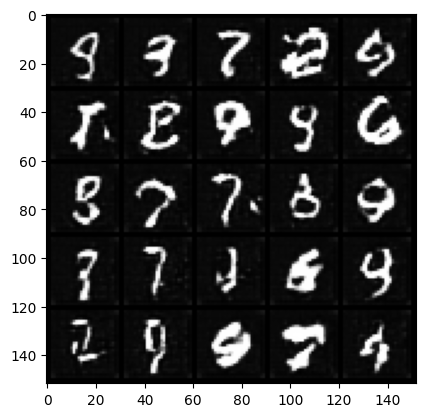

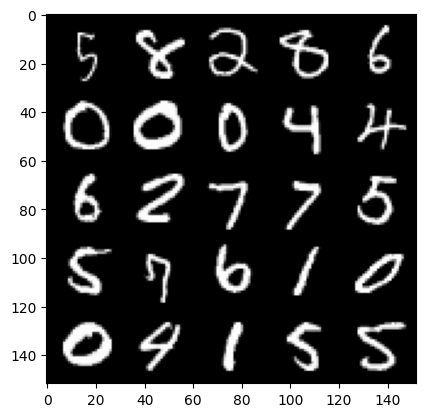

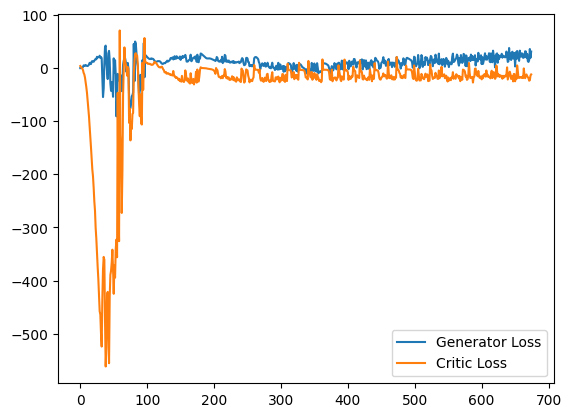

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.2484903484582901
real: -11.04046630859375, fake: -28.716629028320312, regularization: 2.484903573989868
crit_loss: torch.Size([]) -15.191259384155273
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14531782269477844
real: -10.259353637695312, fake: -25.949459075927734, regularization: 1.4531781673431396
crit_loss: torch.Size([]) -14.236927032470703
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10863067954778671
real: -10.829347610473633, fake: -28.854915618896484, regularization: 1.0863068103790283
crit_loss: torch.Size([]) -16.939260482788086
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1620796024799347
real: -12.812780380249023, fake: -29.314083099365234, regularization: 1.6207959651947021
crit_loss: torch.Size([]) -14.88050651550293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16068591177463531
real: -12.400447845458984, fake: -31.65736198425293, regularization: 1.606859087

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.5795854926109314
real: 30.598098754882812, fake: -2.394948959350586, regularization: 5.7958550453186035
crit_loss: torch.Size([]) -27.197195053100586
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22811564803123474
real: 22.712764739990234, fake: -10.767118453979492, regularization: 2.281156539916992
crit_loss: torch.Size([]) -31.1987247467041
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1502496898174286
real: -4.34562873840332, fake: -2.6227059364318848, regularization: 1.5024969577789307
crit_loss: torch.Size([]) 3.225419759750366
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10441938787698746
real: 0.7309078574180603, fake: 3.7245430946350098, regularization: 1.0441938638687134
crit_loss: torch.Size([]) 4.0378289222717285
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09612622857093811
real: 11.305861473083496, fake: 8.761320114135742, regularization: 0.9612622857093811
crit

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08844826370477676
real: 18.32062530517578, fake: 2.7643418312072754, regularization: 0.8844826221466064
crit_loss: torch.Size([]) -14.671801567077637
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.08804861456155777
real: 19.305530548095703, fake: 3.339601993560791, regularization: 0.8804861307144165
crit_loss: torch.Size([]) -15.085442543029785
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.09971266984939575
real: 11.38912582397461, fake: -8.628828048706055, regularization: 0.9971266984939575
crit_loss: torch.Size([]) -19.02082633972168
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.06262317299842834
real: 14.20306396484375, fake: -6.893547058105469, regularization: 0.6262317299842834
crit_loss: torch.Size([]) -20.470378875732422
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10378879308700562
real: 12.947754859924316, fake: 1.3310155868530273, regularization: 1.0378879308700562
c

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1715335249900818
real: 27.068397521972656, fake: -2.3276143074035645, regularization: 1.7153352499008179
crit_loss: torch.Size([]) -27.680675506591797
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.19411718845367432
real: 23.74364471435547, fake: 2.8916397094726562, regularization: 1.9411718845367432
crit_loss: torch.Size([]) -18.91083335876465
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13108311593532562
real: 26.83692169189453, fake: 0.6958611607551575, regularization: 1.3108311891555786
crit_loss: torch.Size([]) -24.830228805541992
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.29382550716400146
real: 11.59437084197998, fake: -13.806824684143066, regularization: 2.9382550716400146
crit_loss: torch.Size([]) -22.462940216064453
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14626261591911316
real: 8.854867935180664, fake: -17.018657684326172, regularization: 1.4626262187957764

gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22070032358169556
real: 6.359743118286133, fake: -17.516651153564453, regularization: 2.207003116607666
crit_loss: torch.Size([]) -21.669391632080078
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.16425099968910217
real: 9.839218139648438, fake: -20.16643714904785, regularization: 1.642509937286377
crit_loss: torch.Size([]) -28.36314582824707
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.22668881714344025
real: 20.770761489868164, fake: -5.561752796173096, regularization: 2.26688814163208
crit_loss: torch.Size([]) -24.06562614440918
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.13090945780277252
real: 21.092987060546875, fake: -10.639093399047852, regularization: 1.3090945482254028
crit_loss: torch.Size([]) -30.422985076904297
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14518946409225464
real: 7.330460548400879, fake: -23.589107513427734, regularization: 1.4518946409225464
cr

real: 9.372747421264648, fake: -20.47933578491211, regularization: 1.5609314441680908
crit_loss: torch.Size([]) -28.29115104675293
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.10743635892868042
real: 27.125642776489258, fake: -3.47091007232666, regularization: 1.0743635892868042
crit_loss: torch.Size([]) -29.52219009399414
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.07291188091039658
real: 18.74634552001953, fake: -23.383481979370117, regularization: 0.729118824005127
crit_loss: torch.Size([]) -41.40071105957031
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.14944720268249512
real: 28.366743087768555, fake: -10.475198745727539, regularization: 1.4944720268249512
crit_loss: torch.Size([]) -37.347469329833984
gradient_norm: torch.Size([128])
penalty: torch.Size([]) 0.1557258665561676
real: 27.39185905456543, fake: -19.839256286621094, regularization: 1.5572586059570312
crit_loss: torch.Size([]) -45.673858642578125
gradient_norm: torch.Size([128])


In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
